## SBMOO  approach for Dealing with Deep Uncertainty in Environmental Problems:


- Solve scenario-based MOOP (i.e. simultaneously consider the selected scenarios and generate the solutions for an SBMOOP)
    [For the time being, we use the previous scenario selected methods in the literature (Particularly use one proposed in Eker & Kwakkel (2018).]
- Use ASF as a posteriori decision-making approach [a more smart way of generating reference point should be considered; e.g. surrogate ASF]  

- Finally, we need to analyze the performances and the robustness(regarding their definition(s)) of the final solution(s) in a wide range of scenarios (say 1000 random scenarios)
- The classical lake problem has been used to test the idea.

##### Objectives in Lake problem(4 objectives):
- Max expected economic benefits(Utility)
- Min worst-case average P concentration(Pollution)
- Max average Inertia of control policy(Inertia)
- Max reliability of policy in staying below the lake's critical P threshold(Reliability)

##### Constraints:
- P emissions range between 0.0001 and 0.1(decision variables bounds)

##### Observations:
- Utility and reliability are the most conflicting objectives
- There is no feasible solution with the reliability of higher than 85% (or even 10%) for all scenarios. 

In [1]:
import numpy as np
from scipy.optimize import brentq
import math
from scipy.optimize import minimize
import random

import pandas as pd
import seaborn as sns
import matplotlib.pyplot as plt
from mpl_toolkits.mplot3d import Axes3D # <--- This is important for 3d plotting 

import csv
import plotly.express as px
import plotly.graph_objects as go

In [22]:
# Use the same natural inflows in different function evaluations in s1
natural_inflows = np.random.lognormal(
                math.log(0.017430754**2 / math.sqrt(0.002061759**2 + 0.017430754**2)),
                math.sqrt(math.log(1.0 + 0.002061759**2 / 0.017430754**2)),
                size = 100)

In [34]:
#natural_inflows

In [2]:
def lake_problem(decisions,
                 b, #= 0.42,          # decay rate for P in lake (0.42 = irreversible)
                 q, #= 2.0,           # recycling exponent
                 mean, #= 0.02,       # mean of natural inflows
                 stdev, #= 0.0017,     # future utility discount rate
                 delta, #= 0.98,      # standard deviation of natural inflows
                 alpha, #= 0.4,       # utility from pollution
                 nsamples = 100    # Monte Carlo sampling of natural inflows
                 ): #**kwargs):   
    #decisions = [kwargs[str(i)] for i in range(100)]
    
    Pcrit = brentq(lambda x: x**q/(1+x**q) - b*x, 0.01, 1.5)
    nvars = len(decisions)
    X = np.zeros((nvars,))
    average_daily_P = np.zeros((nvars,))
    decisions = np.array(decisions)
    reliability = 0.0

    for _ in range(nsamples):
        X[0] = 0.0
        
        natural_inflows = np.random.lognormal(
                math.log(mean**2 / math.sqrt(stdev**2 + mean**2)),
                math.sqrt(math.log(1.0 + stdev**2 / mean**2)),
                size = nvars)
        
        for t in range(1,nvars):
            X[t] = (1-b)*X[t-1] + X[t-1]**q/(1+X[t-1]**q) + decisions[t-1] +\
                    natural_inflows[t-1]
            average_daily_P[t] += X[t]/float(nsamples)
    
        reliability += np.sum(X < Pcrit)/float(nsamples*nvars)
      
    max_P = np.max(average_daily_P)
    utility = np.sum(alpha*decisions*np.power(delta,np.arange(nvars)))#/100
    inertia = np.sum(np.absolute(np.diff(decisions)) < 0.02)/float(nvars-1)
    
    
    return -utility, max_P, -inertia, -reliability  # Negative signs describe the Maximization objectives

In [3]:
"""
Multi_scenario model initialization
"""
# Number of scenarios
s = 1
#Number of objectives 
k = 4
# Number of meta-criteria
mc = s*k

In [4]:
"""
 Utilizing 4 diverse scenarios + 1 ref scenario from 
 
 Eker, S. and Kwakkel, J.H., 2018. Including robustness considerations in the search phase of Many-Objective 
 Robust Decision Making. Environmental Modelling & Software, 105, pp.201-216.
 
 4 selected scenarios + 1 reference scenario:
              b           delta          mean           q             std
 A(#77)  0.19330981   0.953092397    0.017430754    3.049281843    0.002061759
 B(#96)  0.141181536  0.950441986    0.012044268    2.584491318    0.00243013
 C(#130) 0.111640212  0.956457199    0.010126115    2.968733539    0.003692125
 D(#181) 0.272280522  0.931232823    0.03300274     2.971857894    0.004599415
 Ref     0.42         0.98           0.02           2              0.0017
 
+ 4 scenarios from

Bartholomew, E. & Kwakkel, J. H. (2020), ‘On considering robustness in thesearch phase of robust decision making:  
A comparison of many-objective ro-bust decision making, multi-scenario many-objective robust decision making,
and many objective robust optimization’,Environmental Modelling & Soft-warep. 104699.

Used the same algorithm as Eker 2018, but ended up with the following scenarios:

4 selected scenarios + 1 reference scenario:

    b        q      mean      std     delta
1 0.2760   3.0490   0.0039   0.0039   0.9310
2 0.1350   2.0255   0.0407   0.0030   0.9613
3 0.2704   2.4783   0.0169   0.0039   0.9631
4 0.1009   3.6789   0.0187   0.0037   0.9317

Ref the same as the above
"""

b = [0.19330981,  0.141181536, 0.111640212, 0.272280522, 0.42, 0.2760, 0.1350, 0.2704, 0.1009] # b = [0.42, 0.1, 0.2, 0.3]
q = [3.049281843, 2.584491318, 2.968733539, 2.971857894, 2, 3.0490, 2.0255, 2.4783, 3.6789] # q = [2.0, 3, 4, 4.5]
mean = [0.017430754, 0.012044268, 0.010126115, 0.03300274, 0.02, 0.0039, 0.0407, 0.0169, 0.0187]   # mean = [0.02, 0.01, 0.03, 0.05]
stdev = [0.002061759, 0.00243013, 0.003692125, 0.004599415, 0.0017, 0.0039, 0.0030, 0.0039, 0.0037]   # stdev = [0.001, 0.0006, 0.001, 0.005]
delta = [0.953092397, 0.950441986, 0.956457199, 0.931232823, 0.98, 0.9310, 0.9613, 0.9631, 0.9317]    

## Finding the ideal points (the optimal values for objectives in each scenario) by solving a single-scenario single-objective problem for all objectives and 5 considered scenarios.

In [5]:
# 4 objectives and 9 scenarios
# So the indices must change between 0-8, each demonstrates a scenario

def single_objective_single_scenario(decisions):
    """
    single-objective (obj) single-scenario (scen) model
    """        
    f = []                     
    f = lake_problem(decisions, b = b[scen], q = q[scen], mean = mean[scen], stdev = stdev[scen], delta = delta[scen], alpha = 0.4, nsamples = 100)
                     
    return f[obj]

In [6]:
# Initial solution
x0 = np.zeros((100,))

# setting bounds and constraints
var_bnds = (0.0001, 0.1)  # bounds for a_{it}  0.0001
bnds = []
   
for i in range(100):
    bnds.append(var_bnds)  

In [7]:
# Solving the single-scenario single objective problems to get the ideal points for each objective in each scenario

ideal_Utility = [] 
ideal_Pollution = [] 
ideal_Inertia = [] 
ideal_Reliability = [] 
scen = 0
ind_temp = 0
extreme_dec = []
extreme_refp = np.zeros((mc,k))

for obj in range(k):
    print('k=',obj)
    
    """
    Run the model n times with different goals to generate different Pareto optimal solutions
    """
    
    print('s=', scen)
    ind_temp += 1
        
    sol = minimize(single_objective_single_scenario,
            x0,
            method = "SLSQP",
            bounds = bnds,
            #constraints = cons
            )  
        
    # Decision variables (solutions)
    extreme_dec.append(sol.x)
    
    F = lake_problem(sol.x, b = b[scen], q = q[scen], mean = mean[scen], stdev = stdev[scen], delta = delta[scen], alpha = 0.4, nsamples = 100)
    #print(' Scenario ',scen+1,': b = ', b[scen], ', q = ', q[scen], ', mean = ', mean[scen], ', stdev = ', stdev[scen], ',delta = ', delta[scen])
    #print('f_{obj+1}',scen+1,' =', F[obj])

    # Store Objective values for scenario S_i
    extreme_refp[ind_temp-1] = np.array([-F[0],F[1],-F[2],-F[3]])
        
    if obj == 0:
        ideal_Utility.append(-F[obj])
    elif obj == 1:
        ideal_Pollution.append(F[obj])
    elif obj == 2:
        ideal_Inertia.append(-F[obj])
    else:
        ideal_Reliability.append(-F[obj])
        

#print('Ideal points for Utility in different scenarios =',ideal_Utility)
#print('Ideal points for Plution in different scenarios =',ideal_Pollution)
#print('Ideal points for Inertia in different scenarios =',ideal_Inertia)
#print('Ideal points for Reliability in different scenarios =',ideal_Reliability)

k= 0
s= 0
k= 1
s= 0
k= 2
s= 0
k= 3
s= 0


In [8]:
# Write ideal points

with open('obective_values_4obj_s1(EkerBarth)_ideal points.csv', 'w', newline='') as f:
    objectives = ['ideal_Utility', 'ideal_Pollution', 'ideal_Inertia', 'ideal_Reliability', 'Scenario'
                 ]
    thewriter = csv.DictWriter(f, fieldnames=objectives)
    
    thewriter.writeheader()
    for i in range(s):
        thewriter.writerow({'ideal_Utility' : ideal_Utility[i], 'ideal_Pollution' : ideal_Pollution[i], 'ideal_Inertia' : ideal_Inertia[i], 'ideal_Reliability' : ideal_Reliability[i], 'Scenario' : i
                               })
        
with open('extreme_rf_points(EkerBarth)s1.csv', 'w', newline='') as f:
    objectives = ['extreme_rf_points', 'extreme_rf_points_dec'
                 ]
    thewriter = csv.DictWriter(f, fieldnames=objectives)
    
    thewriter.writeheader()
    for i in range(mc):
        thewriter.writerow({'extreme_rf_points' : extreme_refp[i], 'extreme_rf_points_dec' : extreme_dec[i]
                               })    

In [5]:
Lake45_ideals = pd.read_csv('obective_values_4obj_s1(EkerBarth)_ideal points.csv')
Lake45_ideals

,ideal_Utility,ideal_Pollution,ideal_Inertia,ideal_Reliability,Scenario
0,0.845753,0.095103,1.0,1.0,0


In [6]:
# Extreme points (decision space)
import re
extreme_rf_points = pd.read_csv('extreme_rf_points(EkerBarth)s1.csv')
extreme_rfp_dec = np.zeros((mc,100))
for i in range(mc):
    rfpt = re.findall(r"[-+]?\d*\.\d+|\d+", extreme_rf_points['extreme_rf_points_dec'][i])
    for j in range(100):
        extreme_rfp_dec[i][j] = float(rfpt[j])

#extreme_rfp_dec

In [7]:
# Calculate the extreme points in objective space

extreme_rfp = [s * [None] for i in range(mc)]  #np.zeros((mc,mc))

for j in range(mc):
    f_temp = np.zeros((k,))
    F = lake_problem(extreme_rfp_dec[j], b = b[0], q = q[0], mean = mean[0], stdev = stdev[0], delta = delta[0], alpha = 0.4, nsamples = 100)
    for i in range(k):
        if i==1:
            f_temp[i] = F[i]
        else:
            f_temp[i] = -F[i]
                
    extreme_rfp[j][0] = f_temp
                
extreme_rfp

[[array([0.8457528, 5.7560482, 1.       , 0.051    ])],
 [array([8.45752800e-04, 9.52517787e-02, 1.00000000e+00, 1.00000000e+00])],
 [array([8.45752800e-04, 9.50474494e-02, 1.00000000e+00, 1.00000000e+00])],
 [array([8.45752800e-04, 9.57581132e-02, 1.00000000e+00, 1.00000000e+00])]]

In [6]:
"""
Achievement Scalarizing Function (ASF) approach: transfer the multi-objective problem into a single objective one.
Then the following problem will be solved:

  min_x  max_{i=1,..,k} [w_i(f_i - g_i)] + \epsilon sum_{i=1}^n  w_i(f_i - g_i)
  
   s.t. x \in S(feasible region)
  
  where w_i are the weights and can be set bu the decision maker(DM) (e.g. w_i = 1/(z_i^{ideal} - z_i^{nadir} which is also normalize the objective functions)
  k : number of objective functions
  g_i: aspiration levels to be set by the DM (one for each objective function is needed)

When we have multiple scenarios the above formulation have an additional dimension:

   min_x  max_{i=1,..,k; p=1,...,s} [w_{ip}(f_{ip} - g_{ip})] + \epsilon sum_{i=1}^n [sum_{p=1}^s  w_{ip}(f_{ip} - g_{ip}) ]
  
     s.t. x \in S(feasible region in all scenarios)

"""


def objective(decisions):
    """
    ASF
    """     
    phi = np.zeros((s,k))
    w = np.ones((s,k)) # weight vectors
    eps = 0.0001
    f = [[None] for i in range(s)] 
    
    # Setting weights, the same weight for each objective in all scenarios
    for p in range(s):
        for i in range(k): 
            if i==0:
                w[p,i] = 1/(Lake45_ideals.loc[0,'ideal_Utility'])  #2
            elif i==1:
                w[p,i] = 1/(15-(Lake45_ideals.loc[0,'ideal_Pollution']))
            elif i==2:
                w[p,i] = 1/Lake45_ideals.loc[0,'ideal_Inertia']                
            else:
                w[p,i] = 1/Lake45_ideals.loc[0,'ideal_Reliability']
                       
    for p in range(s):
        f[p] = lake_problem(decisions, b = b[0], q = q[0], mean = mean[0], stdev = stdev[0], delta = delta[0], alpha = 0.4, nsamples = 100)
        phi[p] = w[p]*(f[p] - g[p])
        aug = eps * (phi[p]).sum()  
    
    return phi.max() + aug


In [7]:
# Initial solution
x0 = np.zeros((100,))

# setting bounds and constraints
var_bnds = (0.0001, 0.1)  # bounds for a_{it}  0.0001
bnds = []
   
for i in range(100):
    bnds.append(var_bnds)  

In [10]:
"""
  Setting the goals/ reference points - selected
"""
# number of solution to be generated 
n = 50

ig=[s * [None] for i in range(n)] 

"""
Selected weights for more diverse solutions
"""      
#extremes
for i in range(mc):
    for p in range(s):
        ig[i][p] = np.array([extreme_rfp[i][0][0]*-1, extreme_rfp[i][0][1], extreme_rfp[i][0][2]*-1, extreme_rfp[i][0][3]*-1])

# generating some evenly distributed weights
cc = 0
W = []
for i1 in range(5):#s*k+1):
    for i2 in range(i1+1):
        for i3 in range(i2+1):
            w1 = (4-i1)/4
            w2 = (i1-i2)/4
            w3 = (i2-i3)/4
            w4 = 1 - (w1 + w2 + w3)
            W.append(np.array([w1,w2,w3,w4]))
            #print(w1, w2, w3, w4)
            cc += 1

# generate evenly distributed reference points
ig[4][0] = np.array([ig[0][0][0], ig[3][0][1], ig[0][0][2], ig[1][0][3]])

for i in range(np.shape(W)[0]):
    ig[5+i][0] = ig[4][0]*W[i]

# Using Latin Hypercube Sampling (LHS)
from pyDOE import *
from smt.sampling_methods import LHS
                     
xlimits4 = np.array([[-Lake45_ideals.loc[0,'ideal_Utility']*10,-0.0005], # Utility 
                    [-5,15], # Pollution 
                    [-1, -0.4], #Inertia
                    [-1*5, -0.04]  # Reliability 
                   ])

sampling4 = LHS(xlimits=xlimits4)

num = n#-40

x4 = sampling4(num)
                     
for i in range(num):
    ig[i][0] = x4[i]#ig[i+40][0] = x4[i]
                           
                     
def selected_goals(ig, n, s, k):
    g = np.zeros((s,k))
    for i in range(s):
        g[i] = ig[n][0] 
    return g

In [44]:
#ig

In [8]:
Lake45_ideals = pd.read_csv(r'C:\Users\babshava\pyDMDU\robust_optimization_comparison\src\exp2(Eker2018_scenarios)\obective_values_4obj_9scen(EkerBarth)_ideal points.csv')
Lake45_ideals

,ideal_Utility,ideal_Pollution,ideal_Inertia,ideal_Reliability,Scenario
0,0.845753,0.096717,1.0,1.0000,0
1,0.802129,0.110756,1.0,1.0000,1
2,0.907929,0.102940,1.0,1.0000,2
3,0.581198,0.131598,1.0,1.0000,3
4,1.734761,0.057112,1.0,1.0000,4
5,0.579248,0.017281,1.0,1.0000,5
6,1.013628,7.592178,1.0,0.0416,6
7,1.058766,0.069357,1.0,1.0000,7
8,0.585153,0.231929,1.0,1.0000,8


# Use ASF as a posteriori decision-making approach

In [12]:
"""
Solving the problem
 
""" 
n = 50 # number of solutions to be generated

import time
start_time = time.time()

ait = [[None] for i in range(n)] 
goals = [[None] for i in range(n) ] 
nfe = [] 

Utility = [[None] for i in range (n)] 
Pollution = [[None] for i in range (n)] 
Inertia = [[None] for i in range (n)] 
Reliability = [[None] for i in range (n)] 

# Initial solution
x0 = np.zeros((100,))

# setting bounds and constraints
var_bnds = (0.0001, 0.1)  # bounds for a_{it}  0.0001
bnds = []
   
for i in range(100):
    bnds.append(var_bnds) 

for j in range(n):
    """
    Run the model n times with different goals to generate different Pareto optimal solutions
    
    """
    #tait = [[None] for i in range (5)] 
    
    print(j)
    g = selected_goals(ig, j, s, k)
    
    #print('1.ASF')
    sol = minimize(objective,
               x0,
               method = "SLSQP",
               bounds = bnds,
               #constraints = cons
                options={'disp': True}
               )

    print(sol.message)
    print('iterations', sol.nit)
    print('NFE', sol.nfev)

    # Decision variables (solutions)
    ait[j] = sol.x
    goals[j] = g
    nfe.append(sol.nfev)
                    
    
    # Store Objective values for scenario S_i
    temp_Utility = []
    temp_Pollution = []
    temp_Inertia = []
    temp_Reliability = []
    
    p = 0
    F = lake_problem(sol.x, b = b[p], q = q[p], mean = mean[p], stdev = stdev[p], delta = delta[p], alpha = 0.4, nsamples = 100)
    print(' Scenario ',p+1,': b = ', b[p], ', q = ', q[p], ', mean = ', mean[p], ', stdev = ', stdev[p], ',delta = ', delta[p])
    print('f_1',p+1,' (Utility) =', -F[0])
    print('f_2',p+1,' (max_P) =', F[1])
    print('f_3',p+1,' (inertia) =', -F[2])
    print('f_4',p+1,' (reliability) =', -F[3])
       
    # Store Objective values for scenario S_i
    temp_Utility.append(-F[0])
    temp_Pollution.append(F[1])
    temp_Inertia.append(-F[2])
    temp_Reliability.append(-F[3])

    # Store Objective values for scenario S_i
    Utility[j] = temp_Utility
    Pollution[j] = temp_Pollution
    Inertia[j] = temp_Inertia
    Reliability[j] = temp_Reliability
         
                    
print("--- %s seconds ---" % (time.time() - start_time))   
print('nfe =', np.sum(nfe))

0
Optimization terminated successfully.    (Exit mode 0)
            Current function value: 2.717605866070284
            Iterations: 2
            Function evaluations: 215
            Gradient evaluations: 2
Optimization terminated successfully.
iterations 2
NFE 215
 Scenario  1 : b =  0.19330981 , q =  3.049281843 , mean =  0.017430754 , stdev =  0.002061759 ,delta =  0.953092397
f_1 1  (Utility) = 0.7713013109252952
f_2 1  (max_P) = 5.722307989807035
f_3 1  (inertia) = 0.5151515151515151
f_4 1  (reliability) = 0.050800000000000047
1
Iteration limit exceeded    (Exit mode 9)
            Current function value: 5.670682448836559
            Iterations: 101
            Function evaluations: 11068
            Gradient evaluations: 99
Iteration limit exceeded
iterations 101
NFE 11068
 Scenario  1 : b =  0.19330981 , q =  3.049281843 , mean =  0.017430754 , stdev =  0.002061759 ,delta =  0.953092397
f_1 1  (Utility) = 0.7022094453402701
f_2 1  (max_P) = 5.704147897115806
f_3 1  (inertia

Iteration limit exceeded    (Exit mode 9)
            Current function value: 4.838770228651567
            Iterations: 101
            Function evaluations: 11068
            Gradient evaluations: 99
Iteration limit exceeded
iterations 101
NFE 11068
 Scenario  1 : b =  0.19330981 , q =  3.049281843 , mean =  0.017430754 , stdev =  0.002061759 ,delta =  0.953092397
f_1 1  (Utility) = 0.7293569451962558
f_2 1  (max_P) = 5.709064179062308
f_3 1  (inertia) = 0.5151515151515151
f_4 1  (reliability) = 0.0557000000000001
17
Optimization terminated successfully.    (Exit mode 0)
            Current function value: 0.8752185721885541
            Iterations: 1
            Function evaluations: 113
            Gradient evaluations: 1
Optimization terminated successfully.
iterations 1
NFE 113
 Scenario  1 : b =  0.19330981 , q =  3.049281843 , mean =  0.017430754 , stdev =  0.002061759 ,delta =  0.953092397
f_1 1  (Utility) = 0.0009531724199321545
f_2 1  (max_P) = 0.09542363470551692
f_3 1  (iner

Iteration limit exceeded    (Exit mode 9)
            Current function value: 6.03976002002289
            Iterations: 101
            Function evaluations: 11068
            Gradient evaluations: 99
Iteration limit exceeded
iterations 101
NFE 11068
 Scenario  1 : b =  0.19330981 , q =  3.049281843 , mean =  0.017430754 , stdev =  0.002061759 ,delta =  0.953092397
f_1 1  (Utility) = 0.7283523538824984
f_2 1  (max_P) = 5.705804329137361
f_3 1  (inertia) = 0.494949494949495
f_4 1  (reliability) = 0.052200000000000066
33
Optimization terminated successfully.    (Exit mode 0)
            Current function value: 2.5619240547501745
            Iterations: 1
            Function evaluations: 113
            Gradient evaluations: 1
Optimization terminated successfully.
iterations 1
NFE 113
 Scenario  1 : b =  0.19330981 , q =  3.049281843 , mean =  0.017430754 , stdev =  0.002061759 ,delta =  0.953092397
f_1 1  (Utility) = 0.0009928265595142715
f_2 1  (max_P) = 0.09507342945936512
f_3 1  (iner

Optimization terminated successfully.    (Exit mode 0)
            Current function value: 2.896421150125583
            Iterations: 39
            Function evaluations: 4129
            Gradient evaluations: 37
Optimization terminated successfully.
iterations 39
NFE 4129
 Scenario  1 : b =  0.19330981 , q =  3.049281843 , mean =  0.017430754 , stdev =  0.002061759 ,delta =  0.953092397
f_1 1  (Utility) = 0.1729667651678089
f_2 1  (max_P) = 2.156193198637265
f_3 1  (inertia) = 0.8585858585858586
f_4 1  (reliability) = 0.8051000000000005
49
Optimization terminated successfully.    (Exit mode 0)
            Current function value: 7.188376760680206
            Iterations: 65
            Function evaluations: 7159
            Gradient evaluations: 64
Optimization terminated successfully.
iterations 65
NFE 7159
 Scenario  1 : b =  0.19330981 , q =  3.049281843 , mean =  0.017430754 , stdev =  0.002061759 ,delta =  0.953092397
f_1 1  (Utility) = 0.6026238488307936
f_2 1  (max_P) = 5.5087201

In [13]:
"""
Writing the results into a csv file
"""


# Write meta-objectives (objective-scenario combinations)

with open('meta_obective_values_4obj_1scen_50sol_random_rfps(3.11.2020)s1.csv', 'w', newline='') as f:
    meta_objectives = ['U in s1', 
                  'Po  in s1', 
                  'In  in s1', 
                  'Re  in s1' 
                       , 'group', 'decisions', 'goals'
                  ]
    thewriter = csv.DictWriter(f, fieldnames=meta_objectives)
    
    thewriter.writeheader()
    
    for j in range(n):
        thewriter.writerow({'U in s1' : Utility[j][0], 
                  'Po  in s1' : Pollution[j][0], 
                  'In  in s1' : Inertia[j][0], 
                  'Re  in s1' : Reliability[j][0], 
                   'group' : j, 'decisions' : ait[j], 'goals' : goals[j],
                   })

In [21]:
Lake4550_meta_data = pd.read_csv('meta_obective_values_4obj_1scen_50sol_random_rfps(3.11.2020)s1.csv')
Lake4550_meta_data.describe()

,U in s1,Po in s1,In in s1,Re in s1,group
count,50.000000,50.000000,50.000000,50.000000,50.00000
mean,0.290748,2.381532,0.831919,0.621726,24.50000
std,0.302140,2.654373,0.201770,0.457030,14.57738
min,0.000846,0.095331,0.393939,0.050300,0.00000
25%,0.008151,0.101061,0.666667,0.057000,12.25000
50%,0.169084,0.325284,0.954545,0.990950,24.50000
75%,0.618973,5.524130,1.000000,1.000000,36.75000
max,0.816956,5.745827,1.000000,1.000000,49.00000


In [14]:
Lake4550_meta_data

,U in s1,Po in s1,In in s1,Re in s1,group,decisions,goals
0,0.771301,5.722308,0.515152,0.0508,0,[0.1 0.1 0.1 0.1 0...,[[-2.79131924 13.2 -0.97 -2.768 ...
1,0.702209,5.704148,0.525253,0.0562,1,[0.09856324 0.09889142 0.09757435 0.09925438 0...,[[-5.4975682 2. -0.814 -1.3792 ]]
2,0.736141,5.682098,0.555556,0.0522,2,[0.09884537 0.09901848 0.0996717 0.09922752 0...,[[-3.63702204 11.2 -0.49 -1.9744 ...
3,0.600568,5.563847,0.505051,0.0546,3,[0.09953026 0.098955 0.09872778 0.09957927 0...,[[-5.66670876 -3.2 -0.694 -3.8592 ...
4,0.640553,5.563174,0.555556,0.0557,4,[0.09922656 0.09887943 0.09866949 0.09892908 0...,[[-2.114757 2.4 -0.802 -1.6768 ]]
5,0.742680,5.648718,0.474747,0.0512,5,[0.09987549 0.09991544 0.09971555 0.1 0...,[[-6.00498988 1.2 -0.562 -2.9664 ...
6,0.796691,5.714647,0.646465,0.0522,6,[0.09978834 0.09918391 0.09935211 0.09969836 0...,[[-6.51241156 10.8 -0.946 -4.8512 ...
7,0.659552,5.569326,0.595960,0.0600,7,[0.0996073 0.09948677 0.09958557 0.08577422 0...,[[-6.343271 6. -0.61 -3.0656 ]]
8,0.641568,5.560851,0.474747,0.0564,8,[0.09869977 0.09768503 0.0986437 0.09832683 0...,[[-2.28389756 5.2 -0.742 -1.5776 ...
9,0.718643,5.679973,0.444444,0.0534,9,[0.09912872 0.09909172 0.09967914 0.09976141 0...,[[-7.1889738 -2.8 -0.67 -4.752 ]]


In [22]:
# needs new assignment for different # of scenarios
Signed_sol = np.array([Lake4550_meta_data['U in s1']*(-1), Lake4550_meta_data['Po  in s1'], Lake4550_meta_data['In  in s1']*(-1), Lake4550_meta_data['Re  in s1']*(-1)])
#Signed_sol.T

In [23]:
n=50
solutions = np.zeros((n,s*k))
for j in range(n):
    solutions[j] = Signed_sol.T[0] #Lake4550_meta_data.values[j][0:s*k]

#solutions 

In [24]:
# Faster than is_pareto_efficient_simple, but less readable.
def is_pareto_efficient(costs, return_mask = True):
    """
    Find the pareto-efficient points
    :param costs: An (n_points, n_costs) array
    :param return_mask: True to return a mask
    :return: An array of indices of pareto-efficient points.
        If return_mask is True, this will be an (n_points, ) boolean array
        Otherwise it will be a (n_efficient_points, ) integer array of indices.
    """
    is_efficient = np.arange(costs.shape[0])
    n_points = costs.shape[0]
    next_point_index = 0  # Next index in the is_efficient array to search for
    while next_point_index<len(costs):
        nondominated_point_mask = np.any(costs<costs[next_point_index], axis=1)
        nondominated_point_mask[next_point_index] = True
        is_efficient = is_efficient[nondominated_point_mask]  # Remove dominated points
        costs = costs[nondominated_point_mask]
        next_point_index = np.sum(nondominated_point_mask[:next_point_index])+1
    if return_mask:
        is_efficient_mask = np.zeros(n_points, dtype = bool)
        is_efficient_mask[is_efficient] = True
        return is_efficient_mask
    else:
        return is_efficient

In [25]:
is_pareto_efficient(Signed_sol.T)

array([ True,  True,  True, False,  True,  True,  True,  True,  True,
        True,  True,  True,  True,  True,  True, False,  True, False,
       False, False, False,  True, False, False,  True,  True,  True,
        True,  True,  True,  True,  True,  True,  True,  True, False,
       False,  True,  True,  True,  True,  True,  True,  True,  True,
        True,  True,  True, False,  True])

In [26]:
# Identifyling dominated points
num_dominated_sol = 0
dominated_sol = []

for j in range(n):
    if is_pareto_efficient(Signed_sol.T)[j] == False:
        num_dominated_sol += 1
        dominated_sol.append(j)
           
print('Number of dominated solutions =', num_dominated_sol)  
print('dominated solutions =', dominated_sol)     

Number of dominated solutions = 11
dominated solutions = [3, 15, 17, 18, 19, 20, 22, 23, 35, 36, 48]


In [27]:
# Removing dominated points
temp_non_dominated = Lake4550_meta_data
for j in dominated_sol:
    temp_non_dominated = temp_non_dominated.drop([j], axis=0)
    
non_dominated_sol = temp_non_dominated
#for i in reliable_scenarios.Scenario_num:
#    print(reliable_scenarios.Scenario_num[i-1])
non_dominated_sol

,U in s1,Po in s1,In in s1,Re in s1,group,decisions,goals
0,0.719853,5.667271,0.535354,0.0507,0,[0.1 0.1 0.1 0.1 0...,[[-0.8457528 5.75708485 -1. -0.0507 ...
1,0.006846,0.098994,1.000000,1.0000,1,[0.00077489 0.00091909 0.00133481 0.0007749 0...,[[-8.45752800e-04 9.53342272e-02 -1.00000000e...
2,0.000846,0.095331,1.000000,1.0000,2,[0.00010002 0.0001 0.0001 0.0001 0...,[[-8.45752800e-04 9.50529294e-02 -1.00000000e...
4,0.374644,5.451611,0.616162,0.1092,4,[0.05287085 0.05287085 0.05287085 0.05287085 0...,[[-0.8457528 0.09512565 -1. -1. ...
5,0.608118,5.485032,0.626263,0.0563,5,[0.09853696 0.09809643 0.09783241 0.09830676 0...,[[-0.8457528 0. -0. -0. ]]
6,0.668952,5.623872,0.474747,0.0560,6,[0.09903919 0.09856573 0.09775975 0.09797926 0...,[[-0.6343146 0.02378141 -0. -0. ...
7,0.650389,5.576248,0.535354,0.0591,7,[0.09831747 0.09746217 0.09813189 0.09636069 0...,[[-0.6343146 0. -0.25 -0. ]]
8,0.816956,5.744219,0.787879,0.0570,8,[0.09835963 0.09779487 0.09788595 0.09786569 0...,[[-0.6343146 0. -0. -0.25 ]]
9,0.729747,5.671326,0.585859,0.0549,9,[0.09923332 0.09877451 0.09873928 0.09885036 0...,[[-0.4228764 0.04756282 -0. -0. ...
10,0.422316,5.334593,0.747475,0.0746,10,[0.09754659 0.09805075 0.02397114 0.09758004 0...,[[-0.4228764 0.02378141 -0.25 -0. ...


In [28]:
# Describing all meta-objectives (4 objectives in 4+1 scenarios)
#Each line shows one solution
import plotly.graph_objects as go

df = non_dominated_sol #Lake4550_meta_data

fig = go.Figure(data=
    go.Parcoords(
        line = dict(color =  df['U in s1'],
                   colorscale = [[0.2,'black'],[0.4,'purple'],[0.6,'red'],[.8,'gold']]),
        dimensions = list([
            dict(range = [0,1.75],
                #constraintrange = [4],
                label = 'U_s1', values = df['U in s1']),
        
            dict(range = [0,10],
                label = 'Pol_s1', values = df['Po  in s1']),
            
            dict(range = [0,1],
                label = 'In_s1', values = df['In  in s1']),
                        
            dict(range = [0,1],
                label = 'Re_s1', values = df['Re  in s1']),
            
            #dict(range = [0,40],
                #constraintrange = [0.8,1],
            #    label = 'Solution', values = df['group'])
     
        ])
    )
)

fig.update_layout(
    plot_bgcolor = 'white',
    paper_bgcolor = 'white'
)

fig.show()

# Analyze the performances and the robustness(regarding their definition(s)) of the final solution(s) in a wide range of scenarios (say 1000 random scenarios)

## Randomly generate 995 more scenarios to re-evaluate the solutions in them

In [29]:
gen_scenarios = pd.read_csv(r'C:\Users\babshava\pyDMDU\robust_optimization_comparison\src\exp2(Eker2018_scenarios)\scenarios_991_9(EkerBart)10.10.2020.csv')
b = gen_scenarios.b
q = gen_scenarios.q
mean = gen_scenarios['meann'] #  reliable_scenarios.mean can not be used as 'mean' is a reserved term 
stdev = gen_scenarios['stdev']
delta = gen_scenarios.delta

### Analyze the performances in other 4 scenarios (s1,s2,s3 and s4)

In [31]:
"""
Re-evaluate the solutions in other 4 scenarios s1, s2, s3 and s4
"""
import time
start_time = time.time()

nn = 50 - num_dominated_sol
ss = [1, 2, 3, 4, 5, 6, 7, 8] # number of scenarios for re-evaluation
c = 0

nUtility = [[None] for i in range (100)] 
nPollution = [[None] for i in range (100)] 
nInertia = [[None] for i in range (100)] 
nReliability = [[None] for i in range (100)] 

for j in non_dominated_sol.index:
    
    print(j)
        
    # Store Objective values for scenario S_i
    temp_Utility = []
    temp_Pollution = []
    temp_Inertia = []
    temp_Reliability = []
    
    for  p in ss:
        F = lake_problem(ait[j], b = b[p], q = q[p], mean = mean[p], stdev = stdev[p], delta = delta[p], alpha = 0.4, nsamples = 100)
        print(' Scenario ',p+1,': b = ', b[p], ', q = ', q[p], ', mean = ', mean[p], ', stdev = ', stdev[p], ',delta = ', delta[p])
        print('f_1',p+1,' (Utility) =', -F[0])
        print('f_2',p+1,' (max_P) =', F[1])
        print('f_3',p+1,' (inertia) =', -F[2])
        print('f_4',p+1,' (reliability) =', -F[3])
       
        # Store Objective values for scenario S_i
        temp_Utility.append(-F[0])
        temp_Pollution.append(F[1])
        temp_Inertia.append(-F[2])
        temp_Reliability.append(-F[3])

    # Store Objective values for scenario S_i
    nUtility[j] = temp_Utility
    nPollution[j] = temp_Pollution
    nInertia[j] = temp_Inertia
    nReliability[j] = temp_Reliability
    c += 1
    
print("--- %s seconds ---" % (time.time() - start_time)) 

0


NameError: name 'ait' is not defined

In [2]:
nn

NameError: name 'nn' is not defined

In [25]:

"""
Writing the results into a csv file
"""
import csv

# Write meta-objectives (objective-scenario combinations)

with open('meta_obective_1scen_re-evaluate_5(20.11.2020)s1.csv', 'w', newline='') as f:
    meta_objectives = ['U in s1', 'U in s2', 'U in s3','U in s4', 'U in s5',
                  'Po  in s1', 'Po  in s2', 'Po  in s3','Po  in s4', 'Po  in s5',
                  'In  in s1', 'In  in s2', 'In  in s3', 'In  in s4', 'In  in s5',
                  'Re  in s1', 'Re  in s2', 'Re  in s3', 'Re  in s4', 'Re  in s5', 
                  ]
    thewriter = csv.DictWriter(f, fieldnames=meta_objectives)
    
    thewriter.writeheader()
    
    for j in non_dominated_sol.index:
        thewriter.writerow({'U in s1' : Utility[j][0], 'U in s2' : nUtility[j][0], 'U in s3' : nUtility[j][1],'U in s4' : nUtility[j][2], 'U in s5' : nUtility[j][3],
                  'Po  in s1' : Pollution[j][0], 'Po  in s2' : nPollution[j][0], 'Po  in s3' : nPollution[j][1],'Po  in s4' : nPollution[j][2],'Po  in s5' : nPollution[j][3],
                  'In  in s1' : Inertia[j][0], 'In  in s2' : nInertia[j][0], 'In  in s3' : nInertia[j][1], 'In  in s4' : nInertia[j][2], 'In  in s5' : nInertia[j][3],
                  'Re  in s1' : Reliability[j][0], 'Re  in s2' : nReliability[j][0], 'Re  in s3' : nReliability[j][1], 'Re  in s4' : nReliability[j][2], 'Re  in s5' : nReliability[j][3],
                   
                   })

In [26]:
"""
Re-evaluate the solutions in a wide range of randomly generated scenarios
"""
start_time = time.time()

#nn = non_dominated_sol.shape[0]
ss = 1000 # number of scenarios for re-evaluation

nUtility = [[None] for i in range (nn)] 
nPollution = [[None] for i in range (nn)] 
nInertia = [[None] for i in range (nn)] 
nReliability = [[None] for i in range (nn)] 

for j in range(nn):
    
    print(j)
        
    # Store Objective values for scenario S_i
    temp_Utility = []
    temp_Pollution = []
    temp_Inertia = []
    temp_Reliability = []
    
    for  p in range(ss):
        F = lake_problem(ait[j], b = b[p], q = q[p], mean = mean[p], stdev = stdev[p], delta = delta[p], alpha = 0.4, nsamples = 100)
        print(' Scenario ',p+1,': b = ', b[p], ', q = ', q[p], ', mean = ', mean[p], ', stdev = ', stdev[p], ',delta = ', delta[p])
        print('f_1',p+1,' (Utility) =', -F[0])
        print('f_2',p+1,' (max_P) =', F[1])
        print('f_3',p+1,' (inertia) =', -F[2])
        print('f_4',p+1,' (reliability) =', -F[3])
       
        # Store Objective values for scenario S_i
        temp_Utility.append(-F[0])
        temp_Pollution.append(F[1])
        temp_Inertia.append(-F[2])
        temp_Reliability.append(-F[3])

    # Store Objective values for scenario S_i
    nUtility[j] = temp_Utility
    nPollution[j] = temp_Pollution
    nInertia[j] = temp_Inertia
    nReliability[j] = temp_Reliability
    
print("--- %s seconds ---" % (time.time() - start_time)) 

0
 Scenario  1 : b =  0.19330981 , q =  3.049281843 , mean =  0.017430754 , stdev =  0.002061759 ,delta =  0.953092397
f_1 1  (Utility) = 0.7713013109252952
f_2 1  (max_P) = 5.722833898637401
f_3 1  (inertia) = 0.5151515151515151
f_4 1  (reliability) = 0.050800000000000047
 Scenario  2 : b =  0.141181536 , q =  2.584491318 , mean =  0.012044268 , stdev =  0.00243013 ,delta =  0.950441986
f_1 2  (Utility) = 0.7369699224865427
f_2 2  (max_P) = 7.71318865124606
f_3 2  (inertia) = 0.5151515151515151
f_4 2  (reliability) = 0.030000000000000075
 Scenario  3 : b =  0.111640212 , q =  2.968733539 , mean =  0.010126115 , stdev =  0.003692125 ,delta =  0.956457199
f_1 3  (Utility) = 0.8194377643443933
f_2 3  (max_P) = 9.662794164379187
f_3 3  (inertia) = 0.5151515151515151
f_4 3  (reliability) = 0.03999999999999998
 Scenario  4 : b =  0.272280522 , q =  2.971857894 , mean =  0.03300274 , stdev =  0.004599415 ,delta =  0.931232823
f_1 4  (Utility) = 0.5546939750392722
f_2 4  (max_P) = 4.096375929

 Scenario  30 : b =  0.3014883955600404 , q =  3.8428355196770942 , mean =  0.020474268415741674 , stdev =  0.004792129162462159 ,delta =  0.9604994954591322
f_1 30  (Utility) = 0.8851697541225285
f_2 30  (max_P) = 3.684212239917438
f_3 30  (inertia) = 0.5151515151515151
f_4 30  (reliability) = 0.14590000000000006
 Scenario  31 : b =  0.1001765893037336 , q =  2.273713420787084 , mean =  0.03875882946518668 , stdev =  0.0023138244197780018 ,delta =  0.966856710393542
f_1 31  (Utility) = 1.0105344427418552
f_2 31  (max_P) = 10.98942944014249
f_3 31  (inertia) = 0.5151515151515151
f_4 31  (reliability) = 0.01999999999999999
 Scenario  32 : b =  0.3968466195761856 , q =  2.374621594349142 , mean =  0.01615539858728557 , stdev =  0.0019424823410696265 ,delta =  0.9780070635721492
f_1 32  (Utility) = 1.3267936670838942
f_2 32  (max_P) = 2.5648628859174765
f_3 32  (inertia) = 0.5151515151515151
f_4 32  (reliability) = 0.09329999999999998
 Scenario  33 : b =  0.11289101917255298 , q =  2.7656

 Scenario  59 : b =  0.4134460141271443 , q =  3.8276992936427847 , mean =  0.018698284561049446 , stdev =  0.0044530776992936436 ,delta =  0.973920282542886
f_1 59  (Utility) = 1.1928354443630511
f_2 59  (max_P) = 0.31609113622941337
f_3 59  (inertia) = 0.5151515151515151
f_4 59  (reliability) = 1.0000000000000007
 Scenario  60 : b =  0.4498234106962664 , q =  2.039101917255297 , mean =  0.049455095862764885 , stdev =  0.001167507568113017 ,delta =  0.9407214934409688
f_1 60  (Utility) = 0.6325248556691947
f_2 60  (max_P) = 2.1721509521992113
f_3 60  (inertia) = 0.5151515151515151
f_4 60  (reliability) = 0.06000000000000015
 Scenario  61 : b =  0.2541624621594349 , q =  4.039606458123108 , mean =  0.04368314833501514 , stdev =  0.004045408678102928 ,delta =  0.9641321897073662
f_1 61  (Utility) = 0.9530683345896291
f_2 61  (max_P) = 4.479411395427308
f_3 61  (inertia) = 0.5151515151515151
f_4 61  (reliability) = 0.07999999999999996
 Scenario  62 : b =  0.2651109989909183 , q =  2.7732

f_2 87  (max_P) = 5.230973613988185
f_3 87  (inertia) = 0.5151515151515151
f_4 87  (reliability) = 0.06000000000000015
 Scenario  88 : b =  0.3534056508577195 , q =  2.2787588294651866 , mean =  0.02539858728557013 , stdev =  0.002939455095862765 ,delta =  0.974223007063572
f_1 88  (Utility) = 1.201940075586419
f_2 88  (max_P) = 2.9584026814613775
f_3 88  (inertia) = 0.5151515151515151
f_4 88  (reliability) = 0.06000000000000015
 Scenario  89 : b =  0.30607971745711404 , q =  2.682391523713421 , mean =  0.0498183652875883 , stdev =  0.0020676084762865795 ,delta =  0.9735166498486376
f_1 89  (Utility) = 1.1808823620206386
f_2 89  (max_P) = 3.651568467563281
f_3 89  (inertia) = 0.5151515151515151
f_4 89  (reliability) = 0.05000000000000004
 Scenario  90 : b =  0.19659434914228047 , q =  3.159182643794148 , mean =  0.03359233097880929 , stdev =  0.003940464177598385 ,delta =  0.9488446014127144
f_1 90  (Utility) = 0.717635258958959
f_2 90  (max_P) = 5.717621804540212
f_3 90  (inertia) = 0

 Scenario  114 : b =  0.35658425832492435 , q =  2.1803733602421795 , mean =  0.040211907164480316 , stdev =  0.0035005045408678104 ,delta =  0.9456155398587286
f_1 114  (Utility) = 0.6813394896364539
f_2 114  (max_P) = 2.9495277842335086
f_3 114  (inertia) = 0.5151515151515151
f_4 114  (reliability) = 0.05000000000000004
 Scenario  115 : b =  0.16657416750756812 , q =  3.2222502522704337 , mean =  0.023380423814328963 , stdev =  0.0037346115035317854 ,delta =  0.9404187689202824
f_1 115  (Utility) = 0.6297231066605226
f_2 115  (max_P) = 6.670908914818632
f_3 115  (inertia) = 0.5151515151515151
f_4 115  (reliability) = 0.05000000000000004
 Scenario  116 : b =  0.27005549949545915 , q =  2.11226034308779 , mean =  0.039202825428859736 , stdev =  0.004578203834510596 ,delta =  0.9502573158425832
f_1 116  (Utility) = 0.7346847375309125
f_2 116  (max_P) = 4.022410010179932
f_3 116  (inertia) = 0.5151515151515151
f_4 116  (reliability) = 0.030000000000000075
 Scenario  117 : b =  0.25274974

 Scenario  140 : b =  0.42156912209889 , q =  2.9270938446014125 , mean =  0.012563067608476287 , stdev =  0.001926337033299697 ,delta =  0.9547477295660948
f_1 140  (Utility) = 0.7943025814667325
f_2 140  (max_P) = 0.4484293218829908
f_3 140  (inertia) = 0.5151515151515151
f_4 140  (reliability) = 1.0000000000000007
 Scenario  141 : b =  0.4448789101917256 , q =  2.6193239152371346 , mean =  0.04162462159434915 , stdev =  0.002822401614530777 ,delta =  0.9468264379414733
f_1 141  (Utility) = 0.6945358529594147
f_2 141  (max_P) = 2.344772934610075
f_3 141  (inertia) = 0.5151515151515151
f_4 141  (reliability) = 0.11590000000000021
 Scenario  142 : b =  0.3993188698284561 , q =  2.3872351160443994 , mean =  0.04364278506559032 , stdev =  0.0022976791120080725 ,delta =  0.9658476286579212
f_1 142  (Utility) = 0.9885341588234242
f_2 142  (max_P) = 2.6337516516628177
f_3 142  (inertia) = 0.5151515151515151
f_4 142  (reliability) = 0.07
 Scenario  143 : b =  0.2555751765893037 , q =  4.0925

 Scenario  167 : b =  0.23473763874873865 , q =  4.407921291624621 , mean =  0.04780020181634713 , stdev =  0.002725529767911201 ,delta =  0.9382996972754792
f_1 167  (Utility) = 0.6107534230610958
f_2 167  (max_P) = 4.870548254375601
f_3 167  (inertia) = 0.5151515151515151
f_4 167  (reliability) = 0.07999999999999996
 Scenario  168 : b =  0.32585771947527753 , q =  2.884207870837538 , mean =  0.04804238143289607 , stdev =  0.0032623612512613525 ,delta =  0.9489455095862764
f_1 168  (Utility) = 0.7188282952427009
f_2 168  (max_P) = 3.4320493781539483
f_3 168  (inertia) = 0.5151515151515151
f_4 168  (reliability) = 0.06920000000000001
 Scenario  169 : b =  0.2361503531786075 , q =  2.3140766902119068 , mean =  0.024833501513622604 , stdev =  0.002705348133198789 ,delta =  0.953133198789102
f_1 169  (Utility) = 0.7718532484982351
f_2 169  (max_P) = 4.629491925780029
f_3 169  (inertia) = 0.5151515151515151
f_4 169  (reliability) = 0.03999999999999998
 Scenario  170 : b =  0.28029767911200

 Scenario  196 : b =  0.33927850655903125 , q =  2.8514127144298684 , mean =  0.03129162462159435 , stdev =  0.0020837537840565088 ,delta =  0.9525277497477296
f_1 196  (Utility) = 0.7637384285642503
f_2 196  (max_P) = 3.227635994861142
f_3 196  (inertia) = 0.5151515151515151
f_4 196  (reliability) = 0.07999999999999996
 Scenario  197 : b =  0.2266145307769929 , q =  4.206104944500504 , mean =  0.03540867810292633 , stdev =  0.00141372351160444 ,delta =  0.9365338042381434
f_1 197  (Utility) = 0.5957583289253372
f_2 197  (max_P) = 4.986955413788265
f_3 197  (inertia) = 0.5151515151515151
f_4 197  (reliability) = 0.07999999999999996
 Scenario  198 : b =  0.4145055499495459 , q =  2.2510090817356208 , mean =  0.023218970736629662 , stdev =  0.0011917255297679114 ,delta =  0.9339101917255298
f_1 198  (Utility) = 0.5747343830133939
f_2 198  (max_P) = 2.4134227127559145
f_3 198  (inertia) = 0.5151515151515151
f_4 198  (reliability) = 0.07999999999999996
 Scenario  199 : b =  0.2481584258324

 Scenario  223 : b =  0.23403128153380426 , q =  2.722754793138244 , mean =  0.016357214934409687 , stdev =  0.0028950554994954594 ,delta =  0.965343087790111
f_1 223  (Utility) = 0.977856883336031
f_2 223  (max_P) = 4.691081965800167
f_3 223  (inertia) = 0.5151515151515151
f_4 223  (reliability) = 0.05300000000000007
 Scenario  224 : b =  0.3120837537840565 , q =  3.8630171543895058 , mean =  0.02196770938446014 , stdev =  0.004901109989909183 ,delta =  0.9646367305751766
f_1 224  (Utility) = 0.9632563476514114
f_2 224  (max_P) = 3.559855163217633
f_3 224  (inertia) = 0.5151515151515151
f_4 224  (reliability) = 0.15919999999999998
 Scenario  225 : b =  0.30713925327951563 , q =  4.067356205852674 , mean =  0.031009081735620583 , stdev =  0.001752774974772957 ,delta =  0.9356256306760848
f_1 225  (Utility) = 0.5883168717416771
f_2 225  (max_P) = 3.657269870312391
f_3 225  (inertia) = 0.5151515151515151
f_4 225  (reliability) = 0.14
 Scenario  226 : b =  0.3360998990918265 , q =  3.4568

 Scenario  250 : b =  0.21955095862764884 , q =  3.590565085771948 , mean =  0.013410696266397579 , stdev =  0.004824419778002019 ,delta =  0.9744752774974772
f_1 250  (Utility) = 1.209620515495521
f_2 250  (max_P) = 5.035285051373099
f_3 250  (inertia) = 0.5151515151515151
f_4 250  (reliability) = 0.08019999999999997
 Scenario  251 : b =  0.27040867810292635 , q =  3.0103430877901114 , mean =  0.013733602421796163 , stdev =  0.001010090817356206 ,delta =  0.9665035317860746
f_1 251  (Utility) = 1.0027343717579138
f_2 251  (max_P) = 4.054138501536884
f_3 251  (inertia) = 0.5151515151515151
f_4 251  (reliability) = 0.07999999999999996
 Scenario  252 : b =  0.4293390514631685 , q =  3.7898587285570136 , mean =  0.019142280524722503 , stdev =  0.0018657921291624624 ,delta =  0.975686175580222
f_1 252  (Utility) = 1.2477076940779095
f_2 252  (max_P) = 0.30198536556439887
f_3 252  (inertia) = 0.5151515151515151
f_4 252  (reliability) = 1.0000000000000007
 Scenario  253 : b =  0.144677093844

f_1 276  (Utility) = 0.6142823005625127
f_2 276  (max_P) = 0.3296534939855722
f_3 276  (inertia) = 0.5151515151515151
f_4 276  (reliability) = 1.0000000000000007
 Scenario  277 : b =  0.2958375378405651 , q =  3.5653380423814327 , mean =  0.01211907164480323 , stdev =  0.0024147325933400604 ,delta =  0.9606004036326944
f_1 277  (Utility) = 0.8869351360952861
f_2 277  (max_P) = 3.7172407514142574
f_3 277  (inertia) = 0.5151515151515151
f_4 277  (reliability) = 0.13929999999999998
 Scenario  278 : b =  0.3989656912209889 , q =  2.7959132189707363 , mean =  0.021200807265388498 , stdev =  0.004093844601412714 ,delta =  0.9336074672048436
f_1 278  (Utility) = 0.5723994271079196
f_2 278  (max_P) = 2.650804765116726
f_3 278  (inertia) = 0.5151515151515151
f_4 278  (reliability) = 0.1395
 Scenario  279 : b =  0.4247477295660949 , q =  2.1374873864783046 , mean =  0.036014127144298684 , stdev =  0.00362159434914228 ,delta =  0.9465237134207872
f_1 279  (Utility) = 0.6911916790777423
f_2 279  (

 Scenario  303 : b =  0.28524217961654896 , q =  4.127901109989909 , mean =  0.018254288597376392 , stdev =  0.003415741675075681 ,delta =  0.9413269424823412
f_1 303  (Utility) = 0.6382000315915068
f_2 303  (max_P) = 3.891785782934775
f_3 303  (inertia) = 0.5151515151515151
f_4 303  (reliability) = 0.15709999999999993
 Scenario  304 : b =  0.3512865792129163 , q =  3.8655398587285568 , mean =  0.036215943491422806 , stdev =  0.0030565085771947532 ,delta =  0.9375428859737641
f_1 304  (Utility) = 0.6042398330337291
f_2 304  (max_P) = 3.19635363531605
f_3 304  (inertia) = 0.5151515151515151
f_4 304  (reliability) = 0.1734999999999999
 Scenario  305 : b =  0.3244450050454087 , q =  2.5814833501513625 , mean =  0.03561049445005045 , stdev =  0.0049132189707366295 ,delta =  0.9330524722502525
f_1 305  (Utility) = 0.568165413653862
f_2 305  (max_P) = 3.365132728538836
f_3 305  (inertia) = 0.5151515151515151
f_4 305  (reliability) = 0.06010000000000015
 Scenario  306 : b =  0.370005045408678

 Scenario  333 : b =  0.1591574167507568 , q =  3.633451059535824 , mean =  0.011231079717457114 , stdev =  0.0033269424823410697 ,delta =  0.9586831483350152
f_1 333  (Utility) = 0.8544678730040529
f_2 333  (max_P) = 6.889879575567824
f_3 333  (inertia) = 0.5151515151515151
f_4 333  (reliability) = 0.06030000000000015
 Scenario  334 : b =  0.12454591321897075 , q =  4.140514631685166 , mean =  0.03290615539858729 , stdev =  0.001651866801210898 ,delta =  0.9649394550958628
f_1 334  (Utility) = 0.9694648471840995
f_2 334  (max_P) = 8.882118688168337
f_3 334  (inertia) = 0.5151515151515151
f_4 334  (reliability) = 0.05000000000000004
 Scenario  335 : b =  0.4102674066599393 , q =  3.451816347124117 , mean =  0.04634712411705349 , stdev =  0.002749747729566095 ,delta =  0.9787638748738648
f_1 335  (Utility) = 1.354463610973246
f_2 335  (max_P) = 2.713754642673529
f_3 335  (inertia) = 0.5151515151515151
f_4 335  (reliability) = 0.18009999999999987
 Scenario  336 : b =  0.4201564076690212 

 Scenario  362 : b =  0.23650353178607464 , q =  2.6647325933400605 , mean =  0.046306760847628664 , stdev =  0.002390514631685167 ,delta =  0.9646871846619576
f_1 362  (Utility) = 0.964286065101302
f_2 362  (max_P) = 4.767188545304681
f_3 362  (inertia) = 0.5151515151515151
f_4 362  (reliability) = 0.03999999999999998
 Scenario  363 : b =  0.2237891019172553 , q =  2.0819878910191725 , mean =  0.03686175580221998 , stdev =  0.002737638748738648 ,delta =  0.9396115035317859
f_1 363  (Utility) = 0.622365925176229
f_2 363  (max_P) = 4.905339876533982
f_3 363  (inertia) = 0.5151515151515151
f_4 363  (reliability) = 0.029700000000000074
 Scenario  364 : b =  0.10194248234106963 , q =  4.304490413723512 , mean =  0.04545913218970737 , stdev =  0.0028183652875882945 ,delta =  0.960297679112008
f_1 364  (Utility) = 0.8816583604667045
f_2 364  (max_P) = 10.907917732054374
f_3 364  (inertia) = 0.5151515151515151
f_4 364  (reliability) = 0.04039999999999998
 Scenario  365 : b =  0.44346619576185

f_1 393  (Utility) = 0.5751253117702786
f_2 393  (max_P) = 2.7351938916485863
f_3 393  (inertia) = 0.5151515151515151
f_4 393  (reliability) = 0.10040000000000007
 Scenario  394 : b =  0.37389001009081735 , q =  3.555247225025227 , mean =  0.04045408678102926 , stdev =  0.0020151362260343087 ,delta =  0.9307315842583248
f_1 394  (Utility) = 0.5510898445750629
f_2 394  (max_P) = 2.99274906125548
f_3 394  (inertia) = 0.5151515151515151
f_4 394  (reliability) = 0.1516000000000001
 Scenario  395 : b =  0.20471745711402625 , q =  2.672300706357216 , mean =  0.020353178607467208 , stdev =  0.001070635721493441 ,delta =  0.9621644803229059
f_1 395  (Utility) = 0.915150758743335
f_2 395  (max_P) = 5.393964711012185
f_3 395  (inertia) = 0.5151515151515151
f_4 395  (reliability) = 0.041099999999999984
 Scenario  396 : b =  0.4251009081735621 , q =  3.6183148335015134 , mean =  0.01829465186680121 , stdev =  0.0046145307769929365 ,delta =  0.9794197780020182
f_1 396  (Utility) = 1.379249663025884

 Scenario  424 : b =  0.14397073662966695 , q =  4.354944500504541 , mean =  0.02463168516649849 , stdev =  0.004505549949545914 ,delta =  0.9707921291624622
f_1 424  (Utility) = 1.105423450643371
f_2 424  (max_P) = 7.679603204314997
f_3 424  (inertia) = 0.5151515151515151
f_4 424  (reliability) = 0.060500000000000144
 Scenario  425 : b =  0.4109737638748738 , q =  3.83526740665994 , mean =  0.0237840565085772 , stdev =  0.0039243188698284545 ,delta =  0.9630221997981836
f_1 425  (Utility) = 0.9313334439054509
f_2 425  (max_P) = 0.33820459463472513
f_3 425  (inertia) = 0.5151515151515151
f_4 425  (reliability) = 1.0000000000000007
 Scenario  426 : b =  0.17469727547931382 , q =  2.6748234106962663 , mean =  0.011957618567103936 , stdev =  0.003044399596367306 ,delta =  0.9703884964682141
f_1 426  (Utility) = 1.094968449781106
f_2 426  (max_P) = 6.272914916685688
f_3 426  (inertia) = 0.5151515151515151
f_4 426  (reliability) = 0.03999999999999998
 Scenario  427 : b =  0.2605196770938446

 Scenario  451 : b =  0.20259838546922296 , q =  3.4190211907164483 , mean =  0.04848637739656912 , stdev =  0.003972754793138245 ,delta =  0.9506104944500504
f_1 451  (Utility) = 0.7390668131729571
f_2 451  (max_P) = 5.630863304713515
f_3 451  (inertia) = 0.5151515151515151
f_4 451  (reliability) = 0.05000000000000004
 Scenario  452 : b =  0.3498738647830474 , q =  2.8816851664984866 , mean =  0.03565085771947528 , stdev =  0.0012078708375378405 ,delta =  0.9740716448032288
f_1 452  (Utility) = 1.197372619464774
f_2 452  (max_P) = 3.1382927205660636
f_3 452  (inertia) = 0.5151515151515151
f_4 452  (reliability) = 0.08759999999999993
 Scenario  453 : b =  0.3428102926337033 , q =  3.3408173562058527 , mean =  0.013814328960645814 , stdev =  0.002087790110998991 ,delta =  0.9395610494450052
f_1 453  (Utility) = 0.6219115292972963
f_2 453  (max_P) = 3.1786309125197802
f_3 453  (inertia) = 0.5151515151515151
f_4 453  (reliability) = 0.17669999999999986
 Scenario  454 : b =  0.104767911200

 Scenario  483 : b =  0.3668264379414733 , q =  2.720232088799193 , mean =  0.015630676084762866 , stdev =  0.0025600403632694245 ,delta =  0.9357265388496468
f_1 483  (Utility) = 0.589134930101889
f_2 483  (max_P) = 2.892459172190866
f_3 483  (inertia) = 0.5151515151515151
f_4 483  (reliability) = 0.11000000000000008
 Scenario  484 : b =  0.2467457114026236 , q =  3.752018163471241 , mean =  0.04941473259334006 , stdev =  0.003230070635721494 ,delta =  0.9759384460141272
f_1 484  (Utility) = 1.2559055086925386
f_2 484  (max_P) = 4.632876994979749
f_3 484  (inertia) = 0.5151515151515151
f_4 484  (reliability) = 0.0695
 Scenario  485 : b =  0.39225529767911205 , q =  3.7242684157416734 , mean =  0.041503531786074674 , stdev =  0.0013733602421796163 ,delta =  0.9455650857719476
f_1 485  (Utility) = 0.680799935029851
f_2 485  (max_P) = 2.8351476455877114
f_3 485  (inertia) = 0.5151515151515151
f_4 485  (reliability) = 0.23750000000000032
 Scenario  486 : b =  0.13302219979818367 , q =  3.

 Scenario  509 : b =  0.24851160443995965 , q =  2.7530272452068623 , mean =  0.01651866801210898 , stdev =  0.0035449041372351163 ,delta =  0.9699848637739656
f_1 509  (Utility) = 1.0846882478502837
f_2 509  (max_P) = 4.413350642589401
f_3 509  (inertia) = 0.5151515151515151
f_4 509  (reliability) = 0.06000000000000015
 Scenario  510 : b =  0.3933148335015136 , q =  4.019424823410697 , mean =  0.010504540867810292 , stdev =  0.004340060544904136 ,delta =  0.9379969727547932
f_1 510  (Utility) = 0.6081320054023016
f_2 510  (max_P) = 0.3009987550298624
f_3 510  (inertia) = 0.5151515151515151
f_4 510  (reliability) = 1.0000000000000007
 Scenario  511 : b =  0.3841321897073663 , q =  4.307013118062563 , mean =  0.04388496468213925 , stdev =  0.0028990918264379427 ,delta =  0.9302270433905148
f_1 511  (Utility) = 0.5475069393537114
f_2 511  (max_P) = 0.45717849616944745
f_3 511  (inertia) = 0.5151515151515151
f_4 511  (reliability) = 1.0000000000000007
 Scenario  512 : b =  0.1732845610494

 Scenario  537 : b =  0.16092330978809286 , q =  2.4074167507568114 , mean =  0.01559031281533804 , stdev =  0.0034197780020181635 ,delta =  0.9316902119071644
f_1 537  (Utility) = 0.55802235393939
f_2 537  (max_P) = 6.802080229633833
f_3 537  (inertia) = 0.5151515151515151
f_4 537  (reliability) = 0.030000000000000075
 Scenario  538 : b =  0.4205095862764884 , q =  3.2903632694248235 , mean =  0.010988900100908174 , stdev =  0.00467103935418769 ,delta =  0.9585822401614532
f_1 538  (Utility) = 0.8528199648611614
f_2 538  (max_P) = 0.3148886700236423
f_3 538  (inertia) = 0.5151515151515151
f_4 538  (reliability) = 1.0000000000000007
 Scenario  539 : b =  0.37353683148335015 , q =  2.1021695257315844 , mean =  0.02899091826437942 , stdev =  0.0026407669021190714 ,delta =  0.9789152371342078
f_1 539  (Utility) = 1.3601158781142777
f_2 539  (max_P) = 2.727012606052742
f_3 539  (inertia) = 0.5151515151515151
f_4 539  (reliability) = 0.05000000000000004
 Scenario  540 : b =  0.2499243188698

 Scenario  564 : b =  0.3332744702320888 , q =  2.4452573158425834 , mean =  0.01833501513622604 , stdev =  0.0022008072653884967 ,delta =  0.9668062563067608
f_1 564  (Utility) = 1.009413441888724
f_2 564  (max_P) = 3.1821094707709645
f_3 564  (inertia) = 0.5151515151515151
f_4 564  (reliability) = 0.07
 Scenario  565 : b =  0.4190968718466196 , q =  2.480575176589304 , mean =  0.03439959636730575 , stdev =  0.0019384460141271445 ,delta =  0.9603481331987892
f_1 565  (Utility) = 0.88253379782334
f_2 565  (max_P) = 2.4745191292354227
f_3 565  (inertia) = 0.5151515151515151
f_4 565  (reliability) = 0.0907999999999999
 Scenario  566 : b =  0.10441473259334008 , q =  2.742936427850656 , mean =  0.024349142280524733 , stdev =  0.002144298688193744 ,delta =  0.9746266397578204
f_1 566  (Utility) = 1.2142700255291614
f_2 566  (max_P) = 10.44466887498622
f_3 566  (inertia) = 0.5151515151515151
f_4 566  (reliability) = 0.030000000000000075
 Scenario  567 : b =  0.13973259334006055 , q =  2.192

 Scenario  591 : b =  0.304313824419778 , q =  3.7293138244197785 , mean =  0.015065590312815338 , stdev =  0.0018698284561049449 ,delta =  0.9455146316851664
f_1 591  (Utility) = 0.680261188595443
f_2 591  (max_P) = 3.6250588631454
f_3 591  (inertia) = 0.5151515151515151
f_4 591  (reliability) = 0.15939999999999993
 Scenario  592 : b =  0.14043895055499495 , q =  2.886730575176589 , mean =  0.019505549949545908 , stdev =  0.0010181634712411703 ,delta =  0.9400655903128152
f_1 592  (Utility) = 0.6264840886835766
f_2 592  (max_P) = 7.824331031645933
f_3 592  (inertia) = 0.5151515151515151
f_4 592  (reliability) = 0.03999999999999998
 Scenario  593 : b =  0.14432391523713425 , q =  4.110242179616549 , mean =  0.044167507568113024 , stdev =  0.002870837537840565 ,delta =  0.9766448032290616
f_1 593  (Utility) = 1.2793626056336687
f_2 593  (max_P) = 7.816330627063065
f_3 593  (inertia) = 0.5151515151515151
f_4 593  (reliability) = 0.05000000000000004
 Scenario  594 : b =  0.121720484359233

 Scenario  618 : b =  0.1510343087790111 , q =  2.9220484359233097 , mean =  0.04667003027245208 , stdev =  0.0026488395560040363 ,delta =  0.9651917255297678
f_1 618  (Utility) = 0.9746944474275411
f_2 618  (max_P) = 7.490589691172189
f_3 618  (inertia) = 0.5151515151515151
f_4 618  (reliability) = 0.030000000000000075
 Scenario  619 : b =  0.216372351160444 , q =  3.053229061553986 , mean =  0.0243087790110999 , stdev =  0.0047759838546922295 ,delta =  0.9647376387487386
f_1 619  (Utility) = 0.9653177884139749
f_2 619  (max_P) = 5.1440363074616915
f_3 619  (inertia) = 0.5151515151515151
f_4 619  (reliability) = 0.058200000000000134
 Scenario  620 : b =  0.15562563067608476 , q =  2.2964177598385467 , mean =  0.02786074672048436 , stdev =  0.004876892028254289 ,delta =  0.9386024217961656
f_1 620  (Utility) = 0.6133964466932373
f_2 620  (max_P) = 7.101417021001117
f_3 620  (inertia) = 0.5151515151515151
f_4 620  (reliability) = 0.025400000000000037
 Scenario  621 : b =  0.375655903128

f_1 645  (Utility) = 0.7935825980850081
f_2 645  (max_P) = 3.8343584136318496
f_3 645  (inertia) = 0.5151515151515151
f_4 645  (reliability) = 0.03999999999999998
 Scenario  646 : b =  0.13125630676084765 , q =  4.251513622603431 , mean =  0.04501513622603432 , stdev =  0.001688193743693239 ,delta =  0.9648385469223008
f_1 646  (Utility) = 0.9673872739720384
f_2 646  (max_P) = 8.552060288977266
f_3 646  (inertia) = 0.5151515151515151
f_4 646  (reliability) = 0.05000000000000004
 Scenario  647 : b =  0.40496972754793137 , q =  3.1440464177598386 , mean =  0.04327951564076691 , stdev =  0.004352169525731585 ,delta =  0.9398133198789104
f_1 647  (Utility) = 0.6241898430102296
f_2 647  (max_P) = 2.7173359751623773
f_3 647  (inertia) = 0.5151515151515151
f_4 647  (reliability) = 0.13319999999999985
 Scenario  648 : b =  0.3039606458123108 , q =  4.001765893037336 , mean =  0.037346115035317866 , stdev =  0.0021160443995963674 ,delta =  0.9480877901109992
f_1 648  (Utility) = 0.7088051763180

 Scenario  672 : b =  0.43710898082744704 , q =  4.349899091826438 , mean =  0.012684157416750757 , stdev =  0.00458627648839556 ,delta =  0.9580272452068618
f_1 672  (Utility) = 0.8438607674469294
f_2 672  (max_P) = 0.26462888518621297
f_3 672  (inertia) = 0.5151515151515151
f_4 672  (reliability) = 1.0000000000000007
 Scenario  673 : b =  0.2548688193743693 , q =  2.692482341069627 , mean =  0.0167204843592331 , stdev =  0.002858728557013118 ,delta =  0.9687739656912208
f_1 673  (Utility) = 1.0548581765157952
f_2 673  (max_P) = 4.293178193793615
f_3 673  (inertia) = 0.5151515151515151
f_4 673  (reliability) = 0.06000000000000015
 Scenario  674 : b =  0.10158930373360242 , q =  3.1062058526740666 , mean =  0.037144298688193744 , stdev =  0.00363773965691221 ,delta =  0.9791675075681128
f_1 674  (Utility) = 1.3696259879715245
f_2 674  (max_P) = 10.859960750469929
f_3 674  (inertia) = 0.5151515151515151
f_4 674  (reliability) = 0.030000000000000075
 Scenario  675 : b =  0.31384964682139

 Scenario  698 : b =  0.21142785065590314 , q =  4.168264379414733 , mean =  0.04824419778002018 , stdev =  0.004808274470232089 ,delta =  0.95989404641776
f_1 698  (Utility) = 0.8747121441026463
f_2 698  (max_P) = 5.405598073862175
f_3 698  (inertia) = 0.5151515151515151
f_4 698  (reliability) = 0.06630000000000003
 Scenario  699 : b =  0.27853178607467205 , q =  3.4820887991927343 , mean =  0.039969727547931384 , stdev =  0.004408678102926337 ,delta =  0.9421342078708376
f_1 699  (Utility) = 0.6459190948191471
f_2 699  (max_P) = 4.057678567801363
f_3 699  (inertia) = 0.5151515151515151
f_4 699  (reliability) = 0.07949999999999997
 Scenario  700 : b =  0.2428607467204844 , q =  4.339808274470232 , mean =  0.035005045408678104 , stdev =  0.00217255297679112 ,delta =  0.9609031281533804
f_1 700  (Utility) = 0.8922704187265221
f_2 700  (max_P) = 4.653371970400204
f_3 700  (inertia) = 0.5151515151515151
f_4 700  (reliability) = 0.0899999999999999
 Scenario  701 : b =  0.18705852674066606 

 Scenario  729 : b =  0.11536326942482344 , q =  3.5527245206861755 , mean =  0.018900100908173564 , stdev =  0.0040898082744702325 ,delta =  0.9626690211907164
f_1 729  (Utility) = 0.9246069425522964
f_2 729  (max_P) = 9.443834513176325
f_3 729  (inertia) = 0.5151515151515151
f_4 729  (reliability) = 0.049900000000000035
 Scenario  730 : b =  0.19553481331987893 , q =  2.6092330978809284 , mean =  0.03972754793138244 , stdev =  0.004077699293642785 ,delta =  0.9737689202825428
f_1 730  (Utility) = 1.1883282876079542
f_2 730  (max_P) = 5.748030702341143
f_3 730  (inertia) = 0.5151515151515151
f_4 730  (reliability) = 0.03780000000000002
 Scenario  731 : b =  0.2933652875882946 , q =  3.903380423814329 , mean =  0.03847628657921292 , stdev =  0.0017648839556004036 ,delta =  0.939712411705348
f_1 731  (Utility) = 0.6232766146767664
f_2 731  (max_P) = 3.8553818763123684
f_3 731  (inertia) = 0.5151515151515151
f_4 731  (reliability) = 0.10000000000000007
 Scenario  732 : b =  0.18811806256

 Scenario  755 : b =  0.10264883955600404 , q =  3.118819374369324 , mean =  0.0460242179616549 , stdev =  0.0010262361251261352 ,delta =  0.9351210898082744
f_1 755  (Utility) = 0.5842588812327323
f_2 755  (max_P) = 10.84277499400377
f_3 755  (inertia) = 0.5151515151515151
f_4 755  (reliability) = 0.030000000000000075
 Scenario  756 : b =  0.1068869828456105 , q =  3.777245206861757 , mean =  0.036619576185671035 , stdev =  0.003968718466195762 ,delta =  0.9466246215943492
f_1 756  (Utility) = 0.692303015687604
f_2 756  (max_P) = 10.339964939255575
f_3 756  (inertia) = 0.5151515151515151
f_4 756  (reliability) = 0.03999999999999998
 Scenario  757 : b =  0.16939959636730575 , q =  3.575428859737639 , mean =  0.020998990918264376 , stdev =  0.004428859737638749 ,delta =  0.9350706357214936
f_1 757  (Utility) = 0.5838560185973753
f_2 757  (max_P) = 6.5514299199364245
f_3 757  (inertia) = 0.5151515151515151
f_4 757  (reliability) = 0.05990000000000015
 Scenario  758 : b =  0.2071897073662

f_4 781  (reliability) = 0.08959999999999992
 Scenario  782 : b =  0.3760090817356205 , q =  2.649596367305752 , mean =  0.030645812310797174 , stdev =  0.001211907164480323 ,delta =  0.9453632694248234
f_1 782  (Utility) = 0.6786497809769465
f_2 782  (max_P) = 2.8456866866203168
f_3 782  (inertia) = 0.5151515151515151
f_4 782  (reliability) = 0.0899999999999999
 Scenario  783 : b =  0.1376135216952573 , q =  3.6233602421796167 , mean =  0.0441271442986882 , stdev =  0.003657921291624621 ,delta =  0.977401614530777
f_1 783  (Utility) = 1.3053463538551877
f_2 783  (max_P) = 8.17809653677663
f_3 783  (inertia) = 0.5151515151515151
f_4 783  (reliability) = 0.03999999999999998
 Scenario  784 : b =  0.2131937436932392 , q =  4.011856710393542 , mean =  0.02737638748738648 , stdev =  0.0018213925327951565 ,delta =  0.9516195761856712
f_1 784  (Utility) = 0.7518620741359341
f_2 784  (max_P) = 5.258652861906416
f_3 784  (inertia) = 0.5151515151515151
f_4 784  (reliability) = 0.0799999999999999

f_3 808  (inertia) = 0.5151515151515151
f_4 808  (reliability) = 0.0899999999999999
 Scenario  809 : b =  0.361175580221998 , q =  3.4013622603430878 , mean =  0.013773965691220993 , stdev =  0.002374369323915237 ,delta =  0.9579263370332995
f_1 809  (Utility) = 0.8422505518356692
f_2 809  (max_P) = 2.9725352611042304
f_3 809  (inertia) = 0.5151515151515151
f_4 809  (reliability) = 0.28060000000000007
 Scenario  810 : b =  0.37141775983854697 , q =  4.465943491422805 , mean =  0.011553985872855702 , stdev =  0.003710393541876892 ,delta =  0.9747275479313824
f_1 810  (Utility) = 1.2173870525911354
f_2 810  (max_P) = 0.31584941265271316
f_3 810  (inertia) = 0.5151515151515151
f_4 810  (reliability) = 1.0000000000000007
 Scenario  811 : b =  0.3650605449041372 , q =  3.5300201816347125 , mean =  0.048163471241170534 , stdev =  0.004105953582240161 ,delta =  0.9369878910191726
f_1 811  (Utility) = 0.5995467424682718
f_2 811  (max_P) = 3.09113498693185
f_3 811  (inertia) = 0.515151515151515

 Scenario  840 : b =  0.3901362260343088 , q =  4.362512613521695 , mean =  0.013168516649848638 , stdev =  0.0033592330978809287 ,delta =  0.9521745711402624
f_1 840  (Utility) = 0.7590782757418326
f_2 840  (max_P) = 0.30482428247451915
f_3 840  (inertia) = 0.5151515151515151
f_4 840  (reliability) = 1.0000000000000007
 Scenario  841 : b =  0.4187436932391524 , q =  4.183400605449041 , mean =  0.02846619576185672 , stdev =  0.0016074672048435922 ,delta =  0.9684207870837538
f_1 841  (Utility) = 1.0464331252881582
f_2 841  (max_P) = 0.3292715806523326
f_3 841  (inertia) = 0.5151515151515151
f_4 841  (reliability) = 1.0000000000000007
 Scenario  842 : b =  0.2389757820383451 , q =  3.6662462159434916 , mean =  0.01813319878910192 , stdev =  0.004081735620585268 ,delta =  0.9448587285570132
f_1 842  (Utility) = 0.6733302445901855
f_2 842  (max_P) = 4.647299708684859
f_3 842  (inertia) = 0.5151515151515151
f_4 842  (reliability) = 0.08969999999999989
 Scenario  843 : b =  0.24780524722502

 Scenario  867 : b =  0.2926589303733602 , q =  4.1203329969727545 , mean =  0.04618567103935418 , stdev =  0.004646821392532795 ,delta =  0.970438950554995
f_1 867  (Utility) = 1.0962656849729695
f_2 867  (max_P) = 3.8972017457645007
f_3 867  (inertia) = 0.5151515151515151
f_4 867  (reliability) = 0.09980000000000007
 Scenario  868 : b =  0.10900605449041373 , q =  3.315590312815338 , mean =  0.049656912209889006 , stdev =  0.0029556004036326946 ,delta =  0.9435973763874874
f_1 868  (Utility) = 0.6603709379952124
f_2 868  (max_P) = 10.268607693157195
f_3 868  (inertia) = 0.5151515151515151
f_4 868  (reliability) = 0.030000000000000075
 Scenario  869 : b =  0.3357467204843592 , q =  2.238395560040364 , mean =  0.0396468213925328 , stdev =  0.0036821392532795155 ,delta =  0.9624167507568112
f_1 869  (Utility) = 0.9198565685963008
f_2 869  (max_P) = 3.1806566055056127
f_3 869  (inertia) = 0.5151515151515151
f_4 869  (reliability) = 0.05000000000000004
 Scenario  870 : b =  0.137260343087

 Scenario  896 : b =  0.2350908173562059 , q =  3.4997477295660957 , mean =  0.010262361251261351 , stdev =  0.0047679112008072655 ,delta =  0.975837537840565
f_1 896  (Utility) = 1.2526152104616342
f_2 896  (max_P) = 4.684595762781489
f_3 896  (inertia) = 0.5151515151515151
f_4 896  (reliability) = 0.0898999999999999
 Scenario  897 : b =  0.15385973763874874 , q =  2.3241675075681134 , mean =  0.018577194752774976 , stdev =  0.003339051463168517 ,delta =  0.9734661957618568
f_1 897  (Utility) = 1.179402991586173
f_2 897  (max_P) = 7.119661985504543
f_3 897  (inertia) = 0.5151515151515151
f_4 897  (reliability) = 0.030000000000000075
 Scenario  898 : b =  0.10406155398587286 , q =  3.651109989909184 , mean =  0.034318869828456104 , stdev =  0.004521695257315843 ,delta =  0.951367305751766
f_1 898  (Utility) = 0.7486244134484281
f_2 898  (max_P) = 10.584899827740127
f_3 898  (inertia) = 0.5151515151515151
f_4 898  (reliability) = 0.03999999999999998
 Scenario  899 : b =  0.2615792129162

 Scenario  926 : b =  0.21919778002018164 , q =  3.855449041372351 , mean =  0.03472250252270434 , stdev =  0.0032865792129162467 ,delta =  0.9684712411705348
f_1 926  (Utility) = 1.0476292987730496
f_2 926  (max_P) = 5.149224323048083
f_3 926  (inertia) = 0.5151515151515151
f_4 926  (reliability) = 0.07
 Scenario  927 : b =  0.3159687184661958 , q =  2.7076185671039354 , mean =  0.03266397578203835 , stdev =  0.0036781029263370335 ,delta =  0.9730625630676084
f_1 927  (Utility) = 1.1676842277776722
f_2 927  (max_P) = 3.4732364987507336
f_3 927  (inertia) = 0.5151515151515151
f_4 927  (reliability) = 0.0692
 Scenario  928 : b =  0.3597628657921291 , q =  4.064833501513623 , mean =  0.04594349142280525 , stdev =  0.0033551967709384463 ,delta =  0.939106962663976
f_1 928  (Utility) = 0.6178502048349785
f_2 928  (max_P) = 3.152964553003893
f_3 928  (inertia) = 0.5151515151515151
f_4 928  (reliability) = 0.1736999999999999
 Scenario  929 : b =  0.12666498486377398 , q =  3.5855196770938447

 Scenario  956 : b =  0.10829969727547932 , q =  3.466952573158426 , mean =  0.04097880928355197 , stdev =  0.0025075681130171546 ,delta =  0.9505095862764884
f_1 956  (Utility) = 0.737809783071242
f_2 956  (max_P) = 10.251812515258404
f_3 956  (inertia) = 0.5151515151515151
f_4 956  (reliability) = 0.03999999999999998
 Scenario  957 : b =  0.16798688193743694 , q =  2.331735620585268 , mean =  0.017164480322906156 , stdev =  0.004993945509586277 ,delta =  0.9314883955600404
f_1 957  (Utility) = 0.5565490590563575
f_2 957  (max_P) = 6.519072237915339
f_3 957  (inertia) = 0.5151515151515151
f_4 957  (reliability) = 0.030000000000000075
 Scenario  958 : b =  0.3495206861755802 , q =  3.1844096871846617 , mean =  0.03859737638748738 , stdev =  0.0029031281533804234 ,delta =  0.9320433905146316
f_1 958  (Utility) = 0.5606186393181868
f_2 958  (max_P) = 3.1824308420005365
f_3 958  (inertia) = 0.5151515151515151
f_4 958  (reliability) = 0.09990000000000007
 Scenario  959 : b =  0.15527245206

 Scenario  988 : b =  0.245686175580222 , q =  4.322149344096872 , mean =  0.033027245206861754 , stdev =  0.0017931382441977802 ,delta =  0.95010595358224
f_1 988  (Utility) = 0.7328216398906099
f_2 988  (max_P) = 4.591843207948904
f_3 988  (inertia) = 0.5151515151515151
f_4 988  (reliability) = 0.097
 Scenario  989 : b =  0.24921796165489404 , q =  3.2121594349142284 , mean =  0.04699293642785066 , stdev =  0.0018456104944500505 ,delta =  0.9627699293642784
f_1 989  (Utility) = 0.9265197001746228
f_2 989  (max_P) = 4.560300921590681
f_3 989  (inertia) = 0.5151515151515151
f_4 989  (reliability) = 0.06000000000000015
 Scenario  990 : b =  0.15244702320887993 , q =  4.478557013118063 , mean =  0.040575176589303735 , stdev =  0.0040978809283551965 ,delta =  0.9509132189707368
f_1 990  (Utility) = 0.7428621827234743
f_2 990  (max_P) = 7.390002391779454
f_3 990  (inertia) = 0.5151515151515151
f_4 990  (reliability) = 0.06000000000000015
 Scenario  991 : b =  0.3399848637739657 , q =  3.71

 Scenario  19 : b =  0.4406407669021191 , q =  4.085015136226033 , mean =  0.015469223007063573 , stdev =  0.004683148335015136 ,delta =  0.9522754793138244
f_1 19  (Utility) = 0.6929818453688281
f_2 19  (max_P) = 0.27059302073736985
f_3 19  (inertia) = 0.5252525252525253
f_4 19  (reliability) = 1.0000000000000007
 Scenario  20 : b =  0.2608728557013118 , q =  2.478052472250252 , mean =  0.022694248234106963 , stdev =  0.0028143289606458125 ,delta =  0.9553027245206862
f_1 20  (Utility) = 0.7284157025593063
f_2 20  (max_P) = 4.1713200887201385
f_3 20  (inertia) = 0.5252525252525253
f_4 20  (reliability) = 0.05000000000000004
 Scenario  21 : b =  0.2587537840565086 , q =  4.433148335015137 , mean =  0.04901109989909183 , stdev =  0.004537840565085772 ,delta =  0.9536377396569122
f_1 21  (Utility) = 0.7085035138708663
f_2 21  (max_P) = 4.411353467498556
f_3 21  (inertia) = 0.5252525252525253
f_4 21  (reliability) = 0.08969999999999989
 Scenario  22 : b =  0.11077194752774976 , q =  4.180

 Scenario  50 : b =  0.2753531786074672 , q =  3.931130171543895 , mean =  0.03904137235116045 , stdev =  0.004481331987891019 ,delta =  0.96529263370333
f_1 50  (Utility) = 0.8748108111821752
f_2 50  (max_P) = 4.102926698358782
f_3 50  (inertia) = 0.5252525252525253
f_4 50  (reliability) = 0.09279999999999995
 Scenario  51 : b =  0.3247981836528759 , q =  4.40539858728557 , mean =  0.014096871846619575 , stdev =  0.0038153380423814327 ,delta =  0.9495509586276488
f_1 51  (Utility) = 0.6638450529110219
f_2 51  (max_P) = 0.39249489916964686
f_3 51  (inertia) = 0.5252525252525253
f_4 51  (reliability) = 1.0000000000000007
 Scenario  52 : b =  0.157744702320888 , q =  3.7419273461150353 , mean =  0.026205852674066603 , stdev =  0.004549949545913218 ,delta =  0.9361806256306762
f_1 52  (Utility) = 0.5498258396338442
f_2 52  (max_P) = 7.039710842671136
f_3 52  (inertia) = 0.5252525252525253
f_4 52  (reliability) = 0.05990000000000015
 Scenario  53 : b =  0.4183905146316852 , q =  2.74798183

 Scenario  81 : b =  0.14750252270433906 , q =  2.934661957618568 , mean =  0.021079717457114025 , stdev =  0.0038799192734611508 ,delta =  0.97412209889001
f_1 81  (Utility) = 1.059070372349153
f_2 81  (max_P) = 7.467564835804025
f_3 81  (inertia) = 0.5252525252525253
f_4 81  (reliability) = 0.03999999999999998
 Scenario  82 : b =  0.4452320887991928 , q =  3.764631685166498 , mean =  0.02971745711402624 , stdev =  0.001106962663975782 ,delta =  0.9644349142280524
f_1 82  (Utility) = 0.8600840055776195
f_2 82  (max_P) = 0.31815022600542703
f_3 82  (inertia) = 0.5252525252525253
f_4 82  (reliability) = 1.0000000000000007
 Scenario  83 : b =  0.35870332996972754 , q =  4.21619576185671 , mean =  0.02624621594349142 , stdev =  0.004457114026236125 ,delta =  0.9496014127144301
f_1 83  (Utility) = 0.6643628764531107
f_2 83  (max_P) = 0.40737240689152526
f_3 83  (inertia) = 0.5252525252525253
f_4 83  (reliability) = 1.0000000000000007
 Scenario  84 : b =  0.3117305751765893 , q =  2.0618062

 Scenario  108 : b =  0.3894298688193744 , q =  2.341826437941473 , mean =  0.0332694248234107 , stdev =  0.004412714429868818 ,delta =  0.9565136226034308
f_1 108  (Utility) = 0.7435915780416082
f_2 108  (max_P) = 2.6625456221755175
f_3 108  (inertia) = 0.5252525252525253
f_4 108  (reliability) = 0.07010000000000001
 Scenario  109 : b =  0.19023713420787086 , q =  4.332240161453076 , mean =  0.02087790110998991 , stdev =  0.0041705348133198785 ,delta =  0.9418314833501514
f_1 109  (Utility) = 0.5929567497192401
f_2 109  (max_P) = 5.832837183874184
f_3 109  (inertia) = 0.5252525252525253
f_4 109  (reliability) = 0.08189999999999993
 Scenario  110 : b =  0.15986377396569126 , q =  4.486125126135217 , mean =  0.024873864783047428 , stdev =  0.004836528758829466 ,delta =  0.9499545913218972
f_1 110  (Utility) = 0.6680098374251757
f_2 110  (max_P) = 6.938993343503433
f_3 110  (inertia) = 0.5252525252525253
f_4 110  (reliability) = 0.07
 Scenario  111 : b =  0.1496215943491423 , q =  2.8312

 Scenario  135 : b =  0.14926841574167507 , q =  3.0456609485368316 , mean =  0.029636730575176594 , stdev =  0.0027295660948536827 ,delta =  0.9685721493440969
f_1 135  (Utility) = 0.9357814915875756
f_2 135  (max_P) = 7.444877594517672
f_3 135  (inertia) = 0.5252525252525253
f_4 135  (reliability) = 0.03999999999999998
 Scenario  136 : b =  0.40673562058526735 , q =  3.459384460141272 , mean =  0.016236125126135214 , stdev =  0.003944500504540868 ,delta =  0.9611049445005044
f_1 136  (Utility) = 0.8071196495354425
f_2 136  (max_P) = 0.3365182810356119
f_3 136  (inertia) = 0.5252525252525253
f_4 136  (reliability) = 1.0000000000000007
 Scenario  137 : b =  0.18282038345105955 , q =  3.658678102926337 , mean =  0.02939455095862765 , stdev =  0.0037628657921291615 ,delta =  0.9628708375378404
f_1 137  (Utility) = 0.8344070068310643
f_2 137  (max_P) = 6.111396166802218
f_3 137  (inertia) = 0.5252525252525253
f_4 137  (reliability) = 0.06000000000000015
 Scenario  138 : b =  0.28559535822

 Scenario  163 : b =  0.4296922300706357 , q =  2.1248738647830474 , mean =  0.04598385469223008 , stdev =  0.003145307769929365 ,delta =  0.9475832492431888
f_1 163  (Utility) = 0.6442474154464816
f_2 163  (max_P) = 2.3231304208354104
f_3 163  (inertia) = 0.5252525252525253
f_4 163  (reliability) = 0.060100000000000146
 Scenario  164 : b =  0.17610998990918264 , q =  2.604187689202825 , mean =  0.017487386478304744 , stdev =  0.004985872855701313 ,delta =  0.9342633703329972
f_1 164  (Utility) = 0.5365618080133956
f_2 164  (max_P) = 6.231038036503497
f_3 164  (inertia) = 0.5252525252525253
f_4 164  (reliability) = 0.03999999999999998
 Scenario  165 : b =  0.33044904137235115 , q =  3.5502018163471245 , mean =  0.0275782038345106 , stdev =  0.002305751765893037 ,delta =  0.9514177598385468
f_1 165  (Utility) = 0.6835440524097133
f_2 165  (max_P) = 3.357426782192209
f_3 165  (inertia) = 0.5252525252525253
f_4 165  (reliability) = 0.13940000000000002
 Scenario  166 : b =  0.2015388496468

 Scenario  190 : b =  0.2898335015136226 , q =  2.8413218970736627 , mean =  0.037628657921291615 , stdev =  0.0031574167507568114 ,delta =  0.9390060544904136
f_1 190  (Utility) = 0.5705913508745316
f_2 190  (max_P) = 3.832346641372287
f_3 190  (inertia) = 0.5252525252525253
f_4 190  (reliability) = 0.06000000000000015
 Scenario  191 : b =  0.12560544904137236 , q =  3.5729061553985875 , mean =  0.037305751765893035 , stdev =  0.00344803229061554 ,delta =  0.9655953582240162
f_1 191  (Utility) = 0.8801229661608982
f_2 191  (max_P) = 8.853126021952122
f_3 191  (inertia) = 0.5252525252525253
f_4 191  (reliability) = 0.03999999999999998
 Scenario  192 : b =  0.25169021190716445 , q =  2.6319374369323922 , mean =  0.02854692230070636 , stdev =  0.002519677093844602 ,delta =  0.9766952573158426
f_1 192  (Utility) = 1.1268155153524089
f_2 192  (max_P) = 4.377241070021503
f_3 192  (inertia) = 0.5252525252525253
f_4 192  (reliability) = 0.05000000000000004
 Scenario  193 : b =  0.362235116044

 Scenario  216 : b =  0.2771190716448032 , q =  2.980070635721493 , mean =  0.03883955600403633 , stdev =  0.003036326942482341 ,delta =  0.9793693239152372
f_1 216  (Utility) = 1.2059295077914156
f_2 216  (max_P) = 4.034776866623167
f_3 216  (inertia) = 0.5252525252525253
f_4 216  (reliability) = 0.06000000000000015
 Scenario  217 : b =  0.4229818365287588 , q =  2.7631180625630685 , mean =  0.029071644803229064 , stdev =  0.0049656912209889 ,delta =  0.963425832492432
f_1 217  (Utility) = 0.8433495912556405
f_2 217  (max_P) = 2.48191722043922
f_3 217  (inertia) = 0.5252525252525253
f_4 217  (reliability) = 0.1458000000000001
 Scenario  218 : b =  0.2400353178607467 , q =  2.7858224016145305 , mean =  0.01437941473259334 , stdev =  0.0015105953582240162 ,delta =  0.9596417759838548
f_1 218  (Utility) = 0.7857723696773166
f_2 218  (max_P) = 4.5528882365331205
f_3 218  (inertia) = 0.5252525252525253
f_4 218  (reliability) = 0.06000000000000015
 Scenario  219 : b =  0.30678607467204844 ,

f_1 243  (Utility) = 0.7234895431618018
f_2 243  (max_P) = 8.30828717694646
f_3 243  (inertia) = 0.5252525252525253
f_4 243  (reliability) = 0.05000000000000004
 Scenario  244 : b =  0.27182139253279514 , q =  2.435166498486377 , mean =  0.031089808274470238 , stdev =  0.0042351160443995966 ,delta =  0.9366347124117054
f_1 244  (Utility) = 0.5530623076435262
f_2 244  (max_P) = 4.01883034645131
f_3 244  (inertia) = 0.5252525252525253
f_4 244  (reliability) = 0.04910000000000002
 Scenario  245 : b =  0.16869323915237133 , q =  3.754540867810293 , mean =  0.04307769929364279 , stdev =  0.0010343087790110998 ,delta =  0.9529818365287588
f_1 245  (Utility) = 0.7009466408021116
f_2 245  (max_P) = 6.698457256241696
f_3 245  (inertia) = 0.5252525252525253
f_4 245  (reliability) = 0.05000000000000004
 Scenario  246 : b =  0.17681634712411706 , q =  3.837790110998991 , mean =  0.04759838546922302 , stdev =  0.0031331987891019173 ,delta =  0.9752825428859736
f_1 246  (Utility) = 1.088683312770792

 Scenario  273 : b =  0.32232593340060545 , q =  4.173309788092835 , mean =  0.018496468213925327 , stdev =  0.00391220988900101 ,delta =  0.9685216952573158
f_1 273  (Utility) = 0.9347833261645835
f_2 273  (max_P) = 0.4759406564841034
f_3 273  (inertia) = 0.5252525252525253
f_4 273  (reliability) = 1.0000000000000007
 Scenario  274 : b =  0.3375126135216953 , q =  3.5401109989909183 , mean =  0.016115035317860748 , stdev =  0.0043158425832492435 ,delta =  0.9713975782038344
f_1 274  (Utility) = 0.9950265593729013
f_2 274  (max_P) = 3.2407687885001284
f_3 274  (inertia) = 0.5252525252525253
f_4 274  (reliability) = 0.20539999999999992
 Scenario  275 : b =  0.33362764883955603 , q =  2.3695761856710402 , mean =  0.01744702320887992 , stdev =  0.002350151362260343 ,delta =  0.9517204843592332
f_1 275  (Utility) = 0.6868463167194253
f_2 275  (max_P) = 3.1486092082504884
f_3 275  (inertia) = 0.5252525252525253
f_4 275  (reliability) = 0.06970000000000001
 Scenario  276 : b =  0.38095358224

 Scenario  305 : b =  0.3244450050454087 , q =  2.5814833501513625 , mean =  0.03561049445005045 , stdev =  0.0049132189707366295 ,delta =  0.9330524722502525
f_1 305  (Utility) = 0.5285041843083806
f_2 305  (max_P) = 3.3547184314755936
f_3 305  (inertia) = 0.5252525252525253
f_4 305  (reliability) = 0.06010000000000015
 Scenario  306 : b =  0.3700050454086781 , q =  3.610746720484359 , mean =  0.014944500504540869 , stdev =  0.001841574167507568 ,delta =  0.9343642785065592
f_1 306  (Utility) = 0.537244197972748
f_2 306  (max_P) = 0.38581282374432746
f_3 306  (inertia) = 0.5252525252525253
f_4 306  (reliability) = 1.0000000000000007
 Scenario  307 : b =  0.27111503531786074 , q =  2.235872855701312 , mean =  0.02495459132189708 , stdev =  0.0025035317860746717 ,delta =  0.977250252270434
f_1 307  (Utility) = 1.1424602716224366
f_2 307  (max_P) = 3.964231200855859
f_3 307  (inertia) = 0.5252525252525253
f_4 307  (reliability) = 0.03999999999999998
 Scenario  308 : b =  0.25098385469223

 Scenario  333 : b =  0.1591574167507568 , q =  3.633451059535824 , mean =  0.011231079717457114 , stdev =  0.0033269424823410697 ,delta =  0.9586831483350152
f_1 333  (Utility) = 0.7723648273380416
f_2 333  (max_P) = 6.88001425904974
f_3 333  (inertia) = 0.5252525252525253
f_4 333  (reliability) = 0.06310000000000007
 Scenario  334 : b =  0.12454591321897075 , q =  4.140514631685166 , mean =  0.03290615539858729 , stdev =  0.001651866801210898 ,delta =  0.9649394550958628
f_1 334  (Utility) = 0.8686894330382186
f_2 334  (max_P) = 8.882625600081193
f_3 334  (inertia) = 0.5252525252525253
f_4 334  (reliability) = 0.05000000000000004
 Scenario  335 : b =  0.4102674066599393 , q =  3.451816347124117 , mean =  0.04634712411705349 , stdev =  0.002749747729566095 ,delta =  0.9787638748738648
f_1 335  (Utility) = 1.1871664374201973
f_2 335  (max_P) = 2.708859204480779
f_3 335  (inertia) = 0.5252525252525253
f_4 335  (reliability) = 0.18870000000000017
 Scenario  336 : b =  0.4201564076690212 

 Scenario  360 : b =  0.10229566094853684 , q =  2.964934409687185 , mean =  0.02366296670030273 , stdev =  0.002632694248234107 ,delta =  0.9736680121089808
f_1 360  (Utility) = 1.04787875231718
f_2 360  (max_P) = 10.558198931542707
f_3 360  (inertia) = 0.5252525252525253
f_4 360  (reliability) = 0.030000000000000075
 Scenario  361 : b =  0.25804742684157417 , q =  2.50832492431887 , mean =  0.026649848637739657 , stdev =  0.003976791120080727 ,delta =  0.9756357214934408
f_1 361  (Utility) = 1.0979958035370387
f_2 361  (max_P) = 4.240977547316782
f_3 361  (inertia) = 0.5252525252525253
f_4 361  (reliability) = 0.05000000000000004
 Scenario  362 : b =  0.23650353178607464 , q =  2.6647325933400605 , mean =  0.046306760847628664 , stdev =  0.002390514631685167 ,delta =  0.9646871846619576
f_1 362  (Utility) = 0.8643664338704504
f_2 362  (max_P) = 4.751934910949579
f_3 362  (inertia) = 0.5252525252525253
f_4 362  (reliability) = 0.03999999999999998
 Scenario  363 : b =  0.22378910191725

f_2 391  (max_P) = 0.4408356639948298
f_3 391  (inertia) = 0.5252525252525253
f_4 391  (reliability) = 1.0000000000000007
 Scenario  392 : b =  0.3823662966700302 , q =  2.5108476286579213 , mean =  0.013975782038345107 , stdev =  0.002866801210898083 ,delta =  0.9469778002018164
f_1 392  (Utility) = 0.6384430837281811
f_2 392  (max_P) = 2.7027294391402417
f_3 392  (inertia) = 0.5252525252525253
f_4 392  (reliability) = 0.10680000000000009
 Scenario  393 : b =  0.3851917255297679 , q =  2.6117558022199803 , mean =  0.022653884964682142 , stdev =  0.0032825428859737642 ,delta =  0.9339606458123108
f_1 393  (Utility) = 0.5345248314893485
f_2 393  (max_P) = 2.726907773009354
f_3 393  (inertia) = 0.5252525252525253
f_4 393  (reliability) = 0.10290000000000007
 Scenario  394 : b =  0.37389001009081735 , q =  3.555247225025227 , mean =  0.04045408678102926 , stdev =  0.0020151362260343087 ,delta =  0.9307315842583248
f_1 394  (Utility) = 0.5137077158213034
f_2 394  (max_P) = 2.98559379035214

 Scenario  420 : b =  0.15668516649848638 , q =  2.520938446014126 , mean =  0.0465489404641776 , stdev =  0.002346115035317861 ,delta =  0.9445055499495458
f_1 420  (Utility) = 0.6157682622627749
f_2 420  (max_P) = 7.183764565861271
f_3 420  (inertia) = 0.5252525252525253
f_4 420  (reliability) = 0.030000000000000075
 Scenario  421 : b =  0.11183148335015136 , q =  2.3720988900100908 , mean =  0.04743693239152372 , stdev =  0.001978809283551968 ,delta =  0.9427901109989908
f_1 421  (Utility) = 0.6009411736955768
f_2 421  (max_P) = 9.934098445799943
f_3 421  (inertia) = 0.5252525252525253
f_4 421  (reliability) = 0.01999999999999999
 Scenario  422 : b =  0.1934157416750757 , q =  2.283804238143289 , mean =  0.014783047426841571 , stdev =  0.004909182643794147 ,delta =  0.9673612512613522
f_1 422  (Utility) = 0.9123634259066603
f_2 422  (max_P) = 5.614638942369989
f_3 422  (inertia) = 0.5252525252525253
f_4 422  (reliability) = 0.030000000000000075
 Scenario  423 : b =  0.18140766902119

 Scenario  446 : b =  0.1072401614530777 , q =  3.0557517658930373 , mean =  0.02782038345105953 , stdev =  0.002499495459132189 ,delta =  0.9762916246215944
f_1 446  (Utility) = 1.1156774684439197
f_2 446  (max_P) = 10.15381260896802
f_3 446  (inertia) = 0.5252525252525253
f_4 446  (reliability) = 0.030000000000000075
 Scenario  447 : b =  0.3371594349142281 , q =  4.14556004036327 , mean =  0.040898082744702316 , stdev =  0.0013128153380423814 ,delta =  0.977452068617558
f_1 447  (Utility) = 1.1482461628909284
f_2 447  (max_P) = 3.3506851465580607
f_3 447  (inertia) = 0.5252525252525253
f_4 447  (reliability) = 0.16949999999999993
 Scenario  448 : b =  0.2930121089808274 , q =  2.725277497477296 , mean =  0.031937436932391525 , stdev =  0.001849646821392533 ,delta =  0.9719525731584259
f_1 448  (Utility) = 1.0074871274298327
f_2 448  (max_P) = 3.7537358779156436
f_3 448  (inertia) = 0.5252525252525253
f_4 448  (reliability) = 0.06000000000000015
 Scenario  449 : b =  0.35940968718466

 Scenario  472 : b =  0.4000252270433905 , q =  4.483602421796165 , mean =  0.02426841574167508 , stdev =  0.003169525731584259 ,delta =  0.9378456104944499
f_1 472  (Utility) = 0.5618789037073055
f_2 472  (max_P) = 0.323751057274056
f_3 472  (inertia) = 0.5252525252525253
f_4 472  (reliability) = 1.0000000000000007
 Scenario  473 : b =  0.1280776992936428 , q =  3.7621089808274473 , mean =  0.01619576185671039 , stdev =  0.00396468213925328 ,delta =  0.9706912209889
f_1 473  (Utility) = 0.9795738027041068
f_2 473  (max_P) = 8.509885794779954
f_3 473  (inertia) = 0.5252525252525253
f_4 473  (reliability) = 0.0557000000000001
 Scenario  474 : b =  0.2601664984863774 , q =  3.580474268415742 , mean =  0.031775983854692234 , stdev =  0.0032018163471241173 ,delta =  0.9729112008072652
f_1 474  (Utility) = 1.0296992657690274
f_2 474  (max_P) = 4.307374209988912
f_3 474  (inertia) = 0.5252525252525253
f_4 474  (reliability) = 0.08009999999999995
 Scenario  475 : b =  0.29371846619576186 , q 

 Scenario  503 : b =  0.4176841574167508 , q =  4.493693239152371 , mean =  0.028627648839556007 , stdev =  0.002285570131180626 ,delta =  0.9721039354187688
f_1 503  (Utility) = 1.010935492652676
f_2 503  (max_P) = 0.31904295829882523
f_3 503  (inertia) = 0.5252525252525253
f_4 503  (reliability) = 1.0000000000000007
 Scenario  504 : b =  0.18458627648839554 , q =  2.6168012108980827 , mean =  0.032986881937436936 , stdev =  0.003799192734611504 ,delta =  0.9581281533804238
f_1 504  (Utility) = 0.7648019653431152
f_2 504  (max_P) = 6.032710597136012
f_3 504  (inertia) = 0.5252525252525253
f_4 504  (reliability) = 0.03989999999999998
 Scenario  505 : b =  0.23720988900100906 , q =  4.150605449041372 , mean =  0.01781029263370333 , stdev =  0.0027699293642785066 ,delta =  0.963627648839556
f_1 505  (Utility) = 0.8466467897155419
f_2 505  (max_P) = 4.674618974778279
f_3 505  (inertia) = 0.5252525252525253
f_4 505  (reliability) = 0.11000000000000008
 Scenario  506 : b =  0.13796670030272

 Scenario  530 : b =  0.1718718466195762 , q =  3.343340060544904 , mean =  0.022936427850655902 , stdev =  0.001272452068617558 ,delta =  0.9439001009081736
f_1 530  (Utility) = 0.6104539405106577
f_2 530  (max_P) = 6.451323256531456
f_3 530  (inertia) = 0.5252525252525253
f_4 530  (reliability) = 0.05000000000000004
 Scenario  531 : b =  0.3050201816347124 , q =  2.089556004036327 , mean =  0.03710393541876892 , stdev =  0.0038193743693239147 ,delta =  0.9429919273461148
f_1 531  (Utility) = 0.6026490674963224
f_2 531  (max_P) = 3.4844362829058992
f_3 531  (inertia) = 0.5252525252525253
f_4 531  (reliability) = 0.03999999999999998
 Scenario  532 : b =  0.2534561049445005 , q =  2.182896064581231 , mean =  0.04642785065590313 , stdev =  0.0017568113017154394 ,delta =  0.9465741675075682
f_1 532  (Utility) = 0.6346300662417744
f_2 532  (max_P) = 4.343073433674456
f_3 532  (inertia) = 0.5252525252525253
f_4 532  (reliability) = 0.030000000000000075
 Scenario  533 : b =  0.28771442986881

 Scenario  556 : b =  0.2961907164480323 , q =  2.6218466195761856 , mean =  0.04929364278506559 , stdev =  0.003080726538849647 ,delta =  0.9763925327951564
f_1 556  (Utility) = 1.1184433510503171
f_2 556  (max_P) = 3.7606803432887803
f_3 556  (inertia) = 0.5252525252525253
f_4 556  (reliability) = 0.05000000000000004
 Scenario  557 : b =  0.2742936427850656 , q =  4.3196266397578205 , mean =  0.04695257315842583 , stdev =  0.003024217961654895 ,delta =  0.9591372351160444
f_1 557  (Utility) = 0.7786604926562543
f_2 557  (max_P) = 4.153346892717824
f_3 557  (inertia) = 0.5252525252525253
f_4 557  (reliability) = 0.09830000000000004
 Scenario  558 : b =  0.1210141271442987 , q =  2.281281533804238 , mean =  0.014056508577194751 , stdev =  0.003702320887991928 ,delta =  0.9470787083753784
f_1 558  (Utility) = 0.6394033545891963
f_2 558  (max_P) = 8.91914651863817
f_3 558  (inertia) = 0.5252525252525253
f_4 558  (reliability) = 0.01999999999999999
 Scenario  559 : b =  0.1655146316851665

f_1 584  (Utility) = 1.185626223126402
f_2 584  (max_P) = 4.523934510027937
f_3 584  (inertia) = 0.5252525252525253
f_4 584  (reliability) = 0.10000000000000007
 Scenario  585 : b =  0.2566347124117053 , q =  3.9386982845610494 , mean =  0.03403632694248234 , stdev =  0.0012401614530776993 ,delta =  0.9678657921291624
f_1 585  (Utility) = 0.9219861248820282
f_2 585  (max_P) = 4.3832936926198265
f_3 585  (inertia) = 0.5252525252525253
f_4 585  (reliability) = 0.0899999999999999
 Scenario  586 : b =  0.21990413723511604 , q =  4.148082744702322 , mean =  0.016680121089808275 , stdev =  0.0023985872855701307 ,delta =  0.9303784056508576
f_1 586  (Utility) = 0.5115272543852651
f_2 586  (max_P) = 5.034920839950174
f_3 586  (inertia) = 0.5252525252525253
f_4 586  (reliability) = 0.10000000000000007
 Scenario  587 : b =  0.3293895055499495 , q =  4.448284561049444 , mean =  0.019061553985872857 , stdev =  0.003004036326942482 ,delta =  0.9512663975782041
f_1 587  (Utility) = 0.681904493594259

 Scenario  611 : b =  0.13408173562058529 , q =  2.9321392532795163 , mean =  0.04130171543895056 , stdev =  0.003984863773965692 ,delta =  0.9430928355196772
f_1 611  (Utility) = 0.6035065914830321
f_2 611  (max_P) = 8.34382316947413
f_3 611  (inertia) = 0.5252525252525253
f_4 611  (reliability) = 0.030000000000000075
 Scenario  612 : b =  0.21036831483350152 , q =  2.046670030272452 , mean =  0.013087790110998991 , stdev =  0.0020030272452068623 ,delta =  0.975988900100908
f_1 612  (Utility) = 1.1074533216912175
f_2 612  (max_P) = 5.0850084992271505
f_3 612  (inertia) = 0.5252525252525253
f_4 612  (reliability) = 0.030000000000000075
 Scenario  613 : b =  0.18776488395560045 , q =  3.9967204843592334 , mean =  0.02313824419778002 , stdev =  0.003718466195761857 ,delta =  0.9786125126135216
f_1 613  (Utility) = 1.1825564214997908
f_2 613  (max_P) = 5.922293976374183
f_3 613  (inertia) = 0.5252525252525253
f_4 613  (reliability) = 0.07050000000000002
 Scenario  614 : b =  0.17964177598

 Scenario  637 : b =  0.13937941473259335 , q =  2.919525731584258 , mean =  0.02511604439959637 , stdev =  0.001732593340060545 ,delta =  0.9372906155398588
f_1 637  (Utility) = 0.5578039038465724
f_2 637  (max_P) = 7.916764322846006
f_3 637  (inertia) = 0.5252525252525253
f_4 637  (reliability) = 0.03999999999999998
 Scenario  638 : b =  0.3975529767911201 , q =  3.4921796165489405 , mean =  0.01554994954591322 , stdev =  0.004969727547931383 ,delta =  0.9437991927346115
f_1 638  (Utility) = 0.6095769546291341
f_2 638  (max_P) = 0.34650434411525716
f_3 638  (inertia) = 0.5252525252525253
f_4 638  (reliability) = 1.0000000000000007
 Scenario  639 : b =  0.1905903128153381 , q =  4.390262361251262 , mean =  0.025317860746720485 , stdev =  0.0049051463168516655 ,delta =  0.9374419778002021
f_1 639  (Utility) = 0.5589094923222062
f_2 639  (max_P) = 5.8469661798971115
f_3 639  (inertia) = 0.5252525252525253
f_4 639  (reliability) = 0.07999999999999996
 Scenario  640 : b =  0.3124369323915

 Scenario  668 : b =  0.3149091826437941 , q =  2.160191725529768 , mean =  0.04949545913218971 , stdev =  0.0019223007063572147 ,delta =  0.9426387487386478
f_1 668  (Utility) = 0.5996664748935301
f_2 668  (max_P) = 3.425188019174079
f_3 668  (inertia) = 0.5252525252525253
f_4 668  (reliability) = 0.03999999999999998
 Scenario  669 : b =  0.2188446014127144 , q =  2.018920282542886 , mean =  0.03900100908173562 , stdev =  0.003290615539858729 ,delta =  0.9386528758829464
f_1 669  (Utility) = 0.5679117550585385
f_2 669  (max_P) = 4.99609686384618
f_3 669  (inertia) = 0.5252525252525253
f_4 669  (reliability) = 0.01999999999999999
 Scenario  670 : b =  0.10582744702320887 , q =  2.573915237134208 , mean =  0.04477295660948537 , stdev =  0.002882946518668012 ,delta =  0.9484914228052472
f_1 670  (Utility) = 0.6531500213956872
f_2 670  (max_P) = 10.440689557319924
f_3 670  (inertia) = 0.5252525252525253
f_4 670  (reliability) = 0.01999999999999999
 Scenario  671 : b =  0.19447527749747728

 Scenario  698 : b =  0.21142785065590314 , q =  4.168264379414733 , mean =  0.04824419778002018 , stdev =  0.004808274470232089 ,delta =  0.95989404641776
f_1 698  (Utility) = 0.7893752894125036
f_2 698  (max_P) = 5.388526512325666
f_3 698  (inertia) = 0.5252525252525253
f_4 698  (reliability) = 0.06900000000000002
 Scenario  699 : b =  0.27853178607467205 , q =  3.4820887991927343 , mean =  0.039969727547931384 , stdev =  0.004408678102926337 ,delta =  0.9421342078708376
f_1 699  (Utility) = 0.5954555503084463
f_2 699  (max_P) = 4.044868028426544
f_3 699  (inertia) = 0.5252525252525253
f_4 699  (reliability) = 0.07969999999999995
 Scenario  700 : b =  0.2428607467204844 , q =  4.339808274470232 , mean =  0.035005045408678104 , stdev =  0.00217255297679112 ,delta =  0.9609031281533804
f_1 700  (Utility) = 0.8041094057815131
f_2 700  (max_P) = 4.640993145648249
f_3 700  (inertia) = 0.5252525252525253
f_4 700  (reliability) = 0.09259999999999995
 Scenario  701 : b =  0.18705852674066606

 Scenario  724 : b =  0.40920787083753785 , q =  4.1152875882946525 , mean =  0.022250252270433903 , stdev =  0.004214934409687185 ,delta =  0.939207870837538
f_1 724  (Utility) = 0.5721337358322293
f_2 724  (max_P) = 0.3170629053497252
f_3 724  (inertia) = 0.5252525252525253
f_4 724  (reliability) = 1.0000000000000007
 Scenario  725 : b =  0.26299192734611504 , q =  3.391271442986881 , mean =  0.035933400605449035 , stdev =  0.004291624621594349 ,delta =  0.970287588294652
f_1 725  (Utility) = 0.9709417023996998
f_2 725  (max_P) = 4.269003293687781
f_3 725  (inertia) = 0.5252525252525253
f_4 725  (reliability) = 0.07080000000000002
 Scenario  726 : b =  0.28948032290615544 , q =  3.8831987891019173 , mean =  0.015751765893037336 , stdev =  0.00122401614530777 ,delta =  0.9434964682139254
f_1 726  (Utility) = 0.6069607644986552
f_2 726  (max_P) = 3.8152159937579952
f_3 726  (inertia) = 0.5252525252525253
f_4 726  (reliability) = 0.15719999999999998
 Scenario  727 : b =  0.3205600403632

 Scenario  756 : b =  0.1068869828456105 , q =  3.777245206861757 , mean =  0.036619576185671035 , stdev =  0.003968718466195762 ,delta =  0.9466246215943492
f_1 756  (Utility) = 0.6351042534008868
f_2 756  (max_P) = 10.26981335797941
f_3 756  (inertia) = 0.5252525252525253
f_4 756  (reliability) = 0.03999999999999998
 Scenario  757 : b =  0.16939959636730575 , q =  3.575428859737639 , mean =  0.020998990918264376 , stdev =  0.004428859737638749 ,delta =  0.9350706357214936
f_1 757  (Utility) = 0.542069151893085
f_2 757  (max_P) = 6.5345164564660285
f_3 757  (inertia) = 0.5252525252525253
f_4 757  (reliability) = 0.06000000000000015
 Scenario  758 : b =  0.20718970736629666 , q =  4.375126135216951 , mean =  0.04893037336024218 , stdev =  0.002983854692230071 ,delta =  0.955201816347124
f_1 758  (Utility) = 0.7271780800776283
f_2 758  (max_P) = 5.501917516098047
f_3 758  (inertia) = 0.5252525252525253
f_4 758  (reliability) = 0.07
 Scenario  759 : b =  0.3406912209889001 , q =  4.10015

 Scenario  786 : b =  0.3781281533804238 , q =  3.2197275479313823 , mean =  0.022048435923309788 , stdev =  0.003060544904137236 ,delta =  0.9405196770938448
f_1 786  (Utility) = 0.5823624488693117
f_2 786  (max_P) = 2.868764294499677
f_3 786  (inertia) = 0.5252525252525253
f_4 786  (reliability) = 0.19380000000000025
 Scenario  787 : b =  0.29477800201816345 , q =  2.1677598385469223 , mean =  0.03427850655903128 , stdev =  0.003367305751765893 ,delta =  0.9487941473259336
f_1 787  (Utility) = 0.6561712311632282
f_2 787  (max_P) = 3.633342890575711
f_3 787  (inertia) = 0.5252525252525253
f_4 787  (reliability) = 0.03999999999999998
 Scenario  788 : b =  0.3004288597376388 , q =  4.392785065590313 , mean =  0.03670030272452069 , stdev =  0.002717457114026236 ,delta =  0.9533854692230072
f_1 788  (Utility) = 0.7055783665216765
f_2 788  (max_P) = 3.757400801875317
f_3 788  (inertia) = 0.5252525252525253
f_4 788  (reliability) = 0.14480000000000007
 Scenario  789 : b =  0.139026236125126

 Scenario  812 : b =  0.2658173562058527 , q =  3.149091826437941 , mean =  0.03665993945509586 , stdev =  0.0018254288597376388 ,delta =  0.9316397578203836
f_1 812  (Utility) = 0.5193994911922984
f_2 812  (max_P) = 4.213446592371574
f_3 812  (inertia) = 0.5252525252525253
f_4 812  (reliability) = 0.06970000000000003
 Scenario  813 : b =  0.2241422805247225 , q =  3.517406659939456 , mean =  0.035327951564076684 , stdev =  0.0032663975782038345 ,delta =  0.9477346115035318
f_1 813  (Utility) = 0.6457146637798139
f_2 813  (max_P) = 5.017733237299063
f_3 813  (inertia) = 0.5252525252525253
f_4 813  (reliability) = 0.06420000000000006
 Scenario  814 : b =  0.4392280524722503 , q =  3.66372351160444 , mean =  0.03145307769929365 , stdev =  0.0011594349142280526 ,delta =  0.9522250252270434
f_1 814  (Utility) = 0.6924196653448645
f_2 814  (max_P) = 0.33775444837612334
f_3 814  (inertia) = 0.5252525252525253
f_4 814  (reliability) = 1.0000000000000007
 Scenario  815 : b =  0.436049445005045

 Scenario  839 : b =  0.28912714429868824 , q =  2.054238143289606 , mean =  0.04497477295660949 , stdev =  0.003738647830474268 ,delta =  0.9353229061553986
f_1 839  (Utility) = 0.5438130715839038
f_2 839  (max_P) = 3.720529595830431
f_3 839  (inertia) = 0.5252525252525253
f_4 839  (reliability) = 0.030000000000000075
 Scenario  840 : b =  0.3901362260343088 , q =  4.362512613521695 , mean =  0.013168516649848638 , stdev =  0.0033592330978809287 ,delta =  0.9521745711402624
f_1 840  (Utility) = 0.6918583722809785
f_2 840  (max_P) = 0.30052055442989006
f_3 840  (inertia) = 0.5252525252525253
f_4 840  (reliability) = 1.0000000000000007
 Scenario  841 : b =  0.4187436932391524 , q =  4.183400605449041 , mean =  0.02846619576185672 , stdev =  0.0016074672048435922 ,delta =  0.9684207870837538
f_1 841  (Utility) = 0.9327929536309799
f_2 841  (max_P) = 0.3248506226432179
f_3 841  (inertia) = 0.5252525252525253
f_4 841  (reliability) = 1.0000000000000007
 Scenario  842 : b =  0.2389757820383

 Scenario  865 : b =  0.37318365287588295 , q =  4.248990918264379 , mean =  0.02608476286579213 , stdev =  0.003726538849646821 ,delta =  0.9590363269424824
f_1 865  (Utility) = 0.777252942051139
f_2 865  (max_P) = 0.37255181060680115
f_3 865  (inertia) = 0.5252525252525253
f_4 865  (reliability) = 1.0000000000000007
 Scenario  866 : b =  0.16233602421796167 , q =  3.0305247225025225 , mean =  0.0165590312815338 , stdev =  0.001647830474268416 ,delta =  0.9474823410696268
f_1 866  (Utility) = 0.6432728680610059
f_2 866  (max_P) = 6.774346853929507
f_3 866  (inertia) = 0.5252525252525253
f_4 866  (reliability) = 0.05000000000000004
 Scenario  867 : b =  0.2926589303733602 , q =  4.1203329969727545 , mean =  0.04618567103935418 , stdev =  0.004646821392532795 ,delta =  0.970438950554995
f_1 867  (Utility) = 0.9741621572748188
f_2 867  (max_P) = 3.8863283446765853
f_3 867  (inertia) = 0.5252525252525253
f_4 867  (reliability) = 0.10100000000000006
 Scenario  868 : b =  0.1090060544904137

 Scenario  897 : b =  0.15385973763874874 , q =  2.3241675075681134 , mean =  0.018577194752774976 , stdev =  0.003339051463168517 ,delta =  0.9734661957618568
f_1 897  (Utility) = 1.0429737685972542
f_2 897  (max_P) = 7.101065010621627
f_3 897  (inertia) = 0.5252525252525253
f_4 897  (reliability) = 0.030000000000000075
 Scenario  898 : b =  0.10406155398587286 , q =  3.651109989909184 , mean =  0.034318869828456104 , stdev =  0.004521695257315843 ,delta =  0.951367305751766
f_1 898  (Utility) = 0.6829966800337895
f_2 898  (max_P) = 10.498120261072202
f_3 898  (inertia) = 0.5252525252525253
f_4 898  (reliability) = 0.03999999999999998
 Scenario  899 : b =  0.2615792129162462 , q =  3.2626135216952568 , mean =  0.030322906155398587 , stdev =  0.002547931382441978 ,delta =  0.9492482341069628
f_1 899  (Utility) = 0.6607545878183039
f_2 899  (max_P) = 4.264515930272867
f_3 899  (inertia) = 0.5252525252525253
f_4 899  (reliability) = 0.07
 Scenario  900 : b =  0.11006559031281536 , q =  3

 Scenario  929 : b =  0.12666498486377398 , q =  3.5855196770938447 , mean =  0.0217255297679112 , stdev =  0.0012038345105953585 ,delta =  0.9543945509586276
f_1 929  (Utility) = 0.7174219493587219
f_2 929  (max_P) = 8.649673903831898
f_3 929  (inertia) = 0.5252525252525253
f_4 929  (reliability) = 0.05000000000000004
 Scenario  930 : b =  0.15491927346115034 , q =  3.4038849646821387 , mean =  0.048365287588294656 , stdev =  0.004360242179616549 ,delta =  0.9793188698284558
f_1 930  (Utility) = 1.2043459001421895
f_2 930  (max_P) = 7.312218277933028
f_3 930  (inertia) = 0.5252525252525253
f_4 930  (reliability) = 0.03999999999999998
 Scenario  931 : b =  0.35905650857719473 , q =  2.2762361251261347 , mean =  0.04763874873864783 , stdev =  0.002943491422805247 ,delta =  0.9642330978809284
f_1 931  (Utility) = 0.856686919807239
f_2 931  (max_P) = 2.966788157569042
f_3 931  (inertia) = 0.5252525252525253
f_4 931  (reliability) = 0.05000000000000004
 Scenario  932 : b =  0.1630423814328

 Scenario  959 : b =  0.15527245206861756 , q =  3.8781533804238144 , mean =  0.012199798183652877 , stdev =  0.002543895055499496 ,delta =  0.9580776992936428
f_1 959  (Utility) = 0.7641215014238759
f_2 959  (max_P) = 7.05447487546297
f_3 959  (inertia) = 0.5252525252525253
f_4 959  (reliability) = 0.07
 Scenario  960 : b =  0.3413975782038345 , q =  4.102674066599397 , mean =  0.04376387487386478 , stdev =  0.003185671039354188 ,delta =  0.9472300706357216
f_1 960  (Utility) = 0.6408490723806445
f_2 960  (max_P) = 3.3154910821599217
f_3 960  (inertia) = 0.5252525252525253
f_4 960  (reliability) = 0.15949999999999992
 Scenario  961 : b =  0.20012613521695252 , q =  2.9674571140262365 , mean =  0.03185671039354188 , stdev =  0.0015630676084762867 ,delta =  0.9718516649848638
f_1 961  (Utility) = 1.0052002294895015
f_2 961  (max_P) = 5.580582396684352
f_3 961  (inertia) = 0.5252525252525253
f_4 961  (reliability) = 0.05000000000000004
 Scenario  962 : b =  0.142204843592331 , q =  3.784

 Scenario  987 : b =  0.3421039354187689 , q =  2.6697780020181634 , mean =  0.03936427850655903 , stdev =  0.002140262361251261 ,delta =  0.9525782038345106
f_1 987  (Utility) = 0.6963736654479328
f_2 987  (max_P) = 3.1903080425041654
f_3 987  (inertia) = 0.5252525252525253
f_4 987  (reliability) = 0.07
 Scenario  988 : b =  0.245686175580222 , q =  4.322149344096872 , mean =  0.033027245206861754 , stdev =  0.0017931382441977802 ,delta =  0.95010595358224
f_1 988  (Utility) = 0.6695848086069162
f_2 988  (max_P) = 4.579352007689959
f_3 988  (inertia) = 0.5252525252525253
f_4 988  (reliability) = 0.10000000000000007
 Scenario  989 : b =  0.24921796165489404 , q =  3.2121594349142284 , mean =  0.04699293642785066 , stdev =  0.0018456104944500505 ,delta =  0.9627699293642784
f_1 989  (Utility) = 0.8328004491455859
f_2 989  (max_P) = 4.545844548449618
f_3 989  (inertia) = 0.5252525252525253
f_4 989  (reliability) = 0.06000000000000015
 Scenario  990 : b =  0.15244702320887993 , q =  4.478

 Scenario  15 : b =  0.3286831483350152 , q =  2.972502522704339 , mean =  0.03924318869828456 , stdev =  0.0019707366296670037 ,delta =  0.9743239152371342
f_1 15  (Utility) = 1.1198667495817258
f_2 15  (max_P) = 3.363405787502773
f_3 15  (inertia) = 0.5555555555555556
f_4 15  (reliability) = 0.07999999999999996
 Scenario  16 : b =  0.16268920282542887 , q =  3.815085771947528 , mean =  0.0206760847628658 , stdev =  0.0022694248234106963 ,delta =  0.9456659939455097
f_1 16  (Utility) = 0.6544704237241558
f_2 16  (max_P) = 6.783991891510457
f_3 16  (inertia) = 0.5555555555555556
f_4 16  (reliability) = 0.06000000000000015
 Scenario  17 : b =  0.40885469223007065 , q =  4.135469223007064 , mean =  0.01732593340060545 , stdev =  0.004392532795156407 ,delta =  0.9434460141271444
f_1 17  (Utility) = 0.6332900267312458
f_2 17  (max_P) = 0.3019773272727157
f_3 17  (inertia) = 0.5555555555555556
f_4 17  (reliability) = 1.0000000000000007
 Scenario  18 : b =  0.3982593340060545 , q =  3.847880

 Scenario  47 : b =  0.14679616548940466 , q =  4.0749243188698285 , mean =  0.04323915237134208 , stdev =  0.002386478304742684 ,delta =  0.9519223007063572
f_1 47  (Utility) = 0.7220312506315316
f_2 47  (max_P) = 7.664737869221678
f_3 47  (inertia) = 0.5555555555555556
f_4 47  (reliability) = 0.05000000000000004
 Scenario  48 : b =  0.40567608476286576 , q =  4.4356710393541885 , mean =  0.033551967709384456 , stdev =  0.003992936427850656 ,delta =  0.9486427850655904
f_1 48  (Utility) = 0.6850623568831384
f_2 48  (max_P) = 0.35003602449988797
f_3 48  (inertia) = 0.5555555555555556
f_4 48  (reliability) = 1.0000000000000007
 Scenario  49 : b =  0.2873612512613521 , q =  2.2661453077699294 , mean =  0.019101917255297682 , stdev =  0.0048284561049445 ,delta =  0.9332038345105954
f_1 49  (Utility) = 0.5504047561661424
f_2 49  (max_P) = 3.6922657030274206
f_3 49  (inertia) = 0.5555555555555556
f_4 49  (reliability) = 0.04980000000000004
 Scenario  50 : b =  0.2753531786074672 , q =  3.93

f_1 73  (Utility) = 1.0439135268774289
f_2 73  (max_P) = 5.7968987844032105
f_3 73  (inertia) = 0.5555555555555556
f_4 73  (reliability) = 0.07120000000000003
 Scenario  74 : b =  0.4095610494450049 , q =  3.7040867810292637 , mean =  0.01530776992936428 , stdev =  0.0014096871846619578 ,delta =  0.9613067608476288
f_1 74  (Utility) = 0.8516372567887661
f_2 74  (max_P) = 0.31110141852246237
f_3 74  (inertia) = 0.5555555555555556
f_4 74  (reliability) = 1.0000000000000007
 Scenario  75 : b =  0.10370837537840566 , q =  2.1147830474268416 , mean =  0.0444904137235116 , stdev =  0.004025227043390514 ,delta =  0.9315388496468214
f_1 75  (Utility) = 0.5388596244717234
f_2 75  (max_P) = 10.72967379590293
f_3 75  (inertia) = 0.5555555555555556
f_4 75  (reliability) = 0.009999999999999995
 Scenario  76 : b =  0.24144803229061554 , q =  3.7494954591321896 , mean =  0.022209889001009085 , stdev =  0.0037467204843592335 ,delta =  0.9610544904137236
f_1 76  (Utility) = 0.8475987844759226
f_2 76  (

 Scenario  102 : b =  0.42333501513622607 , q =  3.615792129162462 , mean =  0.02648839556004037 , stdev =  0.0023622603430877905 ,delta =  0.9751816347124116
f_1 102  (Utility) = 1.1427769553075013
f_2 102  (max_P) = 0.34549731677168577
f_3 102  (inertia) = 0.5555555555555556
f_4 102  (reliability) = 1.0000000000000007
 Scenario  103 : b =  0.29795660948536834 , q =  3.774722502522704 , mean =  0.02095862764883956 , stdev =  0.003472250252270434 ,delta =  0.9724571140262359
f_1 103  (Utility) = 1.0726851937180353
f_2 103  (max_P) = 3.70989915753724
f_3 103  (inertia) = 0.5555555555555556
f_4 103  (reliability) = 0.13659999999999992
 Scenario  104 : b =  0.3632946518668012 , q =  2.8640262361251265 , mean =  0.030201816347124117 , stdev =  0.0013491422805247224 ,delta =  0.956564076690212
f_1 104  (Utility) = 0.7811950880919563
f_2 104  (max_P) = 2.9762010645977037
f_3 104  (inertia) = 0.5555555555555556
f_4 104  (reliability) = 0.10000000000000007
 Scenario  105 : b =  0.3919021190716

 Scenario  132 : b =  0.4356962663975782 , q =  2.7832996972754795 , mean =  0.011755802219979818 , stdev =  0.003641775983854693 ,delta =  0.9770988900100908
f_1 132  (Utility) = 1.1970380227383108
f_2 132  (max_P) = 0.46824839651298145
f_3 132  (inertia) = 0.5555555555555556
f_4 132  (reliability) = 1.0000000000000007
 Scenario  133 : b =  0.1584510595358224 , q =  2.83627648839556 , mean =  0.01643794147325934 , stdev =  0.0018012108980827446 ,delta =  0.95843087790111
f_1 133  (Utility) = 0.8075959133141418
f_2 133  (max_P) = 6.913793524913304
f_3 133  (inertia) = 0.5555555555555556
f_4 133  (reliability) = 0.03999999999999998
 Scenario  134 : b =  0.32409182643794143 , q =  2.3544399596367307 , mean =  0.011917255297679112 , stdev =  0.004384460141271444 ,delta =  0.9390565085771948
f_1 134  (Utility) = 0.595030088311091
f_2 134  (max_P) = 3.222363248251599
f_3 134  (inertia) = 0.5555555555555556
f_4 134  (reliability) = 0.06730000000000003
 Scenario  135 : b =  0.1492684157416750

f_1 158  (Utility) = 0.6124965696939664
f_2 158  (max_P) = 4.016265349359082
f_3 158  (inertia) = 0.5555555555555556
f_4 158  (reliability) = 0.09910000000000006
 Scenario  159 : b =  0.10547426841574167 , q =  2.8488900100908165 , mean =  0.02152371342078709 , stdev =  0.0014944500504540867 ,delta =  0.9717507568113016
f_1 159  (Utility) = 1.055734321276082
f_2 159  (max_P) = 10.386031047456093
f_3 159  (inertia) = 0.5555555555555556
f_4 159  (reliability) = 0.030000000000000075
 Scenario  160 : b =  0.16374873864783046 , q =  3.6813824419777994 , mean =  0.017527749747729568 , stdev =  0.0036740665993945506 ,delta =  0.955
f_1 160  (Utility) = 0.7602790814547877
f_2 160  (max_P) = 6.719697808804791
f_3 160  (inertia) = 0.5555555555555556
f_4 160  (reliability) = 0.06000000000000015
 Scenario  161 : b =  0.34916750756811304 , q =  3.3685671039354186 , mean =  0.028829465186680118 , stdev =  0.0048405650857719475 ,delta =  0.9731130171543896
f_1 161  (Utility) = 1.0888589867069811
f_2 

 Scenario  190 : b =  0.2898335015136226 , q =  2.8413218970736627 , mean =  0.037628657921291615 , stdev =  0.0031574167507568114 ,delta =  0.9390060544904136
f_1 190  (Utility) = 0.594615937954922
f_2 190  (max_P) = 3.8220293274504047
f_3 190  (inertia) = 0.5555555555555556
f_4 190  (reliability) = 0.06000000000000015
 Scenario  191 : b =  0.12560544904137236 , q =  3.5729061553985875 , mean =  0.037305751765893035 , stdev =  0.00344803229061554 ,delta =  0.9655953582240162
f_1 191  (Utility) = 0.9260702046139798
f_2 191  (max_P) = 8.889096570466004
f_3 191  (inertia) = 0.5555555555555556
f_4 191  (reliability) = 0.03999999999999998
 Scenario  192 : b =  0.25169021190716445 , q =  2.6319374369323922 , mean =  0.02854692230070636 , stdev =  0.002519677093844602 ,delta =  0.9766952573158426
f_1 192  (Utility) = 1.185249052557363
f_2 192  (max_P) = 4.365880652671826
f_3 192  (inertia) = 0.5555555555555556
f_4 192  (reliability) = 0.05000000000000004
 Scenario  193 : b =  0.3622351160443

 Scenario  219 : b =  0.30678607467204844 , q =  2.702573158425833 , mean =  0.04445005045408679 , stdev =  0.002451059535822401 ,delta =  0.9591876892028256
f_1 219  (Utility) = 0.8187734216489152
f_2 219  (max_P) = 3.605970532339498
f_3 219  (inertia) = 0.5555555555555556
f_4 219  (reliability) = 0.06000000000000015
 Scenario  220 : b =  0.3798940464177598 , q =  3.202068617558022 , mean =  0.010181634712411706 , stdev =  0.0027901109989909184 ,delta =  0.9700857719475278
f_1 220  (Utility) = 1.0175965505392266
f_2 220  (max_P) = 0.4645714796975187
f_3 220  (inertia) = 0.5555555555555556
f_4 220  (reliability) = 1.0000000000000007
 Scenario  221 : b =  0.4335771947527749 , q =  2.2182139253279516 , mean =  0.03076690211907165 , stdev =  0.0028869828456104946 ,delta =  0.9313370332996972
f_1 221  (Utility) = 0.5374917219742211
f_2 221  (max_P) = 2.269383032725408
f_3 221  (inertia) = 0.5555555555555556
f_4 221  (reliability) = 0.08029999999999995
 Scenario  222 : b =  0.22061049445005

f_1 248  (Utility) = 0.6021557311985951
f_2 248  (max_P) = 6.549553925993728
f_3 248  (inertia) = 0.5555555555555556
f_4 248  (reliability) = 0.05000000000000004
 Scenario  249 : b =  0.3343340060544904 , q =  2.538597376387488 , mean =  0.03351160443995964 , stdev =  0.0013935418768920285 ,delta =  0.934212916246216
f_1 249  (Utility) = 0.5576352968610117
f_2 249  (max_P) = 3.222268624204774
f_3 249  (inertia) = 0.5555555555555556
f_4 249  (reliability) = 0.06000000000000015
 Scenario  250 : b =  0.21955095862764884 , q =  3.590565085771948 , mean =  0.013410696266397579 , stdev =  0.004824419778002019 ,delta =  0.9744752774974772
f_1 250  (Utility) = 1.1238513027374781
f_2 250  (max_P) = 5.001567750722374
f_3 250  (inertia) = 0.5555555555555556
f_4 250  (reliability) = 0.08139999999999996
 Scenario  251 : b =  0.27040867810292635 , q =  3.0103430877901114 , mean =  0.013733602421796163 , stdev =  0.001010090817356206 ,delta =  0.9665035317860746
f_1 251  (Utility) = 0.943362311733747

 Scenario  277 : b =  0.2958375378405651 , q =  3.5653380423814327 , mean =  0.01211907164480323 , stdev =  0.0024147325933400604 ,delta =  0.9606004036326944
f_1 277  (Utility) = 0.8404173293106315
f_2 277  (max_P) = 3.697493138206866
f_3 277  (inertia) = 0.5555555555555556
f_4 277  (reliability) = 0.14
 Scenario  278 : b =  0.3989656912209889 , q =  2.7959132189707363 , mean =  0.021200807265388498 , stdev =  0.004093844601412714 ,delta =  0.9336074672048436
f_1 278  (Utility) = 0.5532753027374442
f_2 278  (max_P) = 2.637846340477023
f_3 278  (inertia) = 0.5555555555555556
f_4 278  (reliability) = 0.1409
 Scenario  279 : b =  0.4247477295660949 , q =  2.1374873864783046 , mean =  0.036014127144298684 , stdev =  0.00362159434914228 ,delta =  0.9465237134207872
f_1 279  (Utility) = 0.6630168416266021
f_2 279  (max_P) = 2.330202979709797
f_3 279  (inertia) = 0.5555555555555556
f_4 279  (reliability) = 0.07
 Scenario  280 : b =  0.4137991927346115 , q =  2.9750252270433903 , mean =  0.04

 Scenario  303 : b =  0.28524217961654896 , q =  4.127901109989909 , mean =  0.018254288597376392 , stdev =  0.003415741675075681 ,delta =  0.9413269424823412
f_1 303  (Utility) = 0.6142529787004476
f_2 303  (max_P) = 3.8754657320710164
f_3 303  (inertia) = 0.5555555555555556
f_4 303  (reliability) = 0.16009999999999994
 Scenario  304 : b =  0.3512865792129163 , q =  3.8655398587285568 , mean =  0.036215943491422806 , stdev =  0.0030565085771947532 ,delta =  0.9375428859737641
f_1 304  (Utility) = 0.5828403873653399
f_2 304  (max_P) = 3.182405391321919
f_3 304  (inertia) = 0.5555555555555556
f_4 304  (reliability) = 0.17829999999999982
 Scenario  305 : b =  0.3244450050454087 , q =  2.5814833501513625 , mean =  0.03561049445005045 , stdev =  0.0049132189707366295 ,delta =  0.9330524722502525
f_1 305  (Utility) = 0.5493356475104363
f_2 305  (max_P) = 3.347762180002669
f_3 305  (inertia) = 0.5555555555555556
f_4 305  (reliability) = 0.06000000000000015
 Scenario  306 : b =  0.37000504540

 Scenario  333 : b =  0.1591574167507568 , q =  3.633451059535824 , mean =  0.011231079717457114 , stdev =  0.0033269424823410697 ,delta =  0.9586831483350152
f_1 333  (Utility) = 0.8112903409803653
f_2 333  (max_P) = 6.871297466716901
f_3 333  (inertia) = 0.5555555555555556
f_4 333  (reliability) = 0.06080000000000014
 Scenario  334 : b =  0.12454591321897075 , q =  4.140514631685166 , mean =  0.03290615539858729 , stdev =  0.001651866801210898 ,delta =  0.9649394550958628
f_1 334  (Utility) = 0.9139338166183836
f_2 334  (max_P) = 8.929942207139241
f_3 334  (inertia) = 0.5555555555555556
f_4 334  (reliability) = 0.05000000000000004
 Scenario  335 : b =  0.4102674066599393 , q =  3.451816347124117 , mean =  0.04634712411705349 , stdev =  0.002749747729566095 ,delta =  0.9787638748738648
f_1 335  (Utility) = 1.247868879310404
f_2 335  (max_P) = 2.7033182368485793
f_3 335  (inertia) = 0.5555555555555556
f_4 335  (reliability) = 0.18380000000000005
 Scenario  336 : b =  0.4201564076690212

 Scenario  360 : b =  0.10229566094853684 , q =  2.964934409687185 , mean =  0.02366296670030273 , stdev =  0.002632694248234107 ,delta =  0.9736680121089808
f_1 360  (Utility) = 1.1028819352672763
f_2 360  (max_P) = 10.723347526011331
f_3 360  (inertia) = 0.5555555555555556
f_4 360  (reliability) = 0.030000000000000075
 Scenario  361 : b =  0.25804742684157417 , q =  2.50832492431887 , mean =  0.026649848637739657 , stdev =  0.003976791120080727 ,delta =  0.9756357214934408
f_1 361  (Utility) = 1.155238296773571
f_2 361  (max_P) = 4.229388987142072
f_3 361  (inertia) = 0.5555555555555556
f_4 361  (reliability) = 0.05000000000000004
 Scenario  362 : b =  0.23650353178607464 , q =  2.6647325933400605 , mean =  0.046306760847628664 , stdev =  0.002390514631685167 ,delta =  0.9646871846619576
f_1 362  (Utility) = 0.9093423417395016
f_2 362  (max_P) = 4.739081497018227
f_3 362  (inertia) = 0.5555555555555556
f_4 362  (reliability) = 0.03999999999999998
 Scenario  363 : b =  0.2237891019172

 Scenario  390 : b =  0.11253784056508576 , q =  4.4760343087790115 , mean =  0.039889001009081736 , stdev =  0.004642785065590314 ,delta =  0.9440010090817356
f_1 390  (Utility) = 0.6384622668856569
f_2 390  (max_P) = 9.924754120599989
f_3 390  (inertia) = 0.5555555555555556
f_4 390  (reliability) = 0.05000000000000004
 Scenario  391 : b =  0.3703582240161453 , q =  4.079969727547931 , mean =  0.03294651866801211 , stdev =  0.0021079717457114025 ,delta =  0.9660998990918264
f_1 391  (Utility) = 0.9356056369292255
f_2 391  (max_P) = 0.4515100981785071
f_3 391  (inertia) = 0.5555555555555556
f_4 391  (reliability) = 1.0000000000000007
 Scenario  392 : b =  0.3823662966700302 , q =  2.5108476286579213 , mean =  0.013975782038345107 , stdev =  0.002866801210898083 ,delta =  0.9469778002018164
f_1 392  (Utility) = 0.6676273163433128
f_2 392  (max_P) = 2.6940089883849887
f_3 392  (inertia) = 0.5555555555555556
f_4 392  (reliability) = 0.10360000000000008
 Scenario  393 : b =  0.385191725529

 Scenario  417 : b =  0.2255549949545913 , q =  2.9043895055499496 , mean =  0.022008072653884967 , stdev =  0.0013531786074672046 ,delta =  0.93587790110999
f_1 417  (Utility) = 0.569971480764177
f_2 417  (max_P) = 4.882599278913283
f_3 417  (inertia) = 0.5555555555555556
f_4 417  (reliability) = 0.06000000000000015
 Scenario  418 : b =  0.2626387487386478 , q =  3.484611503531786 , mean =  0.031372351160444 , stdev =  0.0014581231079717454 ,delta =  0.9628203834510596
f_1 418  (Utility) = 0.8766259692621877
f_2 418  (max_P) = 4.249413555084495
f_3 418  (inertia) = 0.5555555555555556
f_4 418  (reliability) = 0.07999999999999996
 Scenario  419 : b =  0.3262108980827447 , q =  3.272704339051463 , mean =  0.016801210898082744 , stdev =  0.003173562058526741 ,delta =  0.9570181634712412
f_1 419  (Utility) = 0.787468629183163
f_2 419  (max_P) = 3.341570761205643
f_3 419  (inertia) = 0.5555555555555556
f_4 419  (reliability) = 0.13159999999999986
 Scenario  420 : b =  0.15668516649848638 , 

f_2 443  (max_P) = 6.931708673166764
f_3 443  (inertia) = 0.5555555555555556
f_4 443  (reliability) = 0.06000000000000015
 Scenario  444 : b =  0.2827699293642785 , q =  2.0769424823410696 , mean =  0.024793138244197783 , stdev =  0.0043319878910191715 ,delta =  0.9557568113017154
f_1 444  (Utility) = 0.7702681500213916
f_2 444  (max_P) = 3.7296772144038437
f_3 444  (inertia) = 0.5555555555555556
f_4 444  (reliability) = 0.03879999999999999
 Scenario  445 : b =  0.24745206861755806 , q =  2.7353683148335017 , mean =  0.04828456104944501 , stdev =  0.0012199798183652876 ,delta =  0.9367860746720484
f_1 445  (Utility) = 0.5769227453009187
f_2 445  (max_P) = 4.53857722230424
f_3 445  (inertia) = 0.5555555555555556
f_4 445  (reliability) = 0.03999999999999998
 Scenario  446 : b =  0.1072401614530777 , q =  3.0557517658930373 , mean =  0.02782038345105953 , stdev =  0.002499495459132189 ,delta =  0.9762916246215944
f_1 446  (Utility) = 1.1736590146520651
f_2 446  (max_P) = 10.28383602897000

 Scenario  471 : b =  0.3996720484359233 , q =  3.292885973763875 , mean =  0.03367305751765893 , stdev =  0.003557013118062563 ,delta =  0.9659989909182644
f_1 471  (Utility) = 0.9336844106955641
f_2 471  (max_P) = 2.732891593105055
f_3 471  (inertia) = 0.5555555555555556
f_4 471  (reliability) = 0.19230000000000033
 Scenario  472 : b =  0.4000252270433905 , q =  4.483602421796165 , mean =  0.02426841574167508 , stdev =  0.003169525731584259 ,delta =  0.9378456104944499
f_1 472  (Utility) = 0.5852400238439118
f_2 472  (max_P) = 0.3248801365458163
f_3 472  (inertia) = 0.5555555555555556
f_4 472  (reliability) = 1.0000000000000007
 Scenario  473 : b =  0.1280776992936428 , q =  3.7621089808274473 , mean =  0.01619576185671039 , stdev =  0.00396468213925328 ,delta =  0.9706912209889
f_1 473  (Utility) = 1.0311784689406436
f_2 473  (max_P) = 8.55403868061249
f_3 473  (inertia) = 0.5555555555555556
f_4 473  (reliability) = 0.05350000000000007
 Scenario  474 : b =  0.2601664984863774 , q = 

 Scenario  501 : b =  0.2297931382441977 , q =  3.7469727547931377 , mean =  0.030565085771947526 , stdev =  0.0015993945509586278 ,delta =  0.9727598385469224
f_1 501  (Utility) = 1.080097198752798
f_2 501  (max_P) = 4.861975214037143
f_3 501  (inertia) = 0.5555555555555556
f_4 501  (reliability) = 0.07749999999999999
 Scenario  502 : b =  0.3350403632694248 , q =  2.8539354187689203 , mean =  0.029434914228052483 , stdev =  0.0020353178607467205 ,delta =  0.9737184661957622
f_1 502  (Utility) = 1.1041724329170783
f_2 502  (max_P) = 3.2493486405283325
f_3 502  (inertia) = 0.5555555555555556
f_4 502  (reliability) = 0.08169999999999994
 Scenario  503 : b =  0.4176841574167508 , q =  4.493693239152371 , mean =  0.028627648839556007 , stdev =  0.002285570131180626 ,delta =  0.9721039354187688
f_1 503  (Utility) = 1.0641502835046068
f_2 503  (max_P) = 0.3201963736831546
f_3 503  (inertia) = 0.5555555555555556
f_4 503  (reliability) = 1.0000000000000007
 Scenario  504 : b =  0.184586276488

f_2 558  (max_P) = 8.974585572143997
f_3 558  (inertia) = 0.5555555555555556
f_4 558  (reliability) = 0.01999999999999999
 Scenario  559 : b =  0.1655146316851665 , q =  3.35343087790111 , mean =  0.017729566094853686 , stdev =  0.0016720484359233098 ,delta =  0.9466750756811302
f_1 559  (Utility) = 0.6645469679300792
f_2 559  (max_P) = 6.645161276577616
f_3 559  (inertia) = 0.5555555555555556
f_4 559  (reliability) = 0.056800000000000093
 Scenario  560 : b =  0.3417507568113017 , q =  3.900857719475277 , mean =  0.04073662966700303 , stdev =  0.0022330978809283553 ,delta =  0.9621140262361252
f_1 560  (Utility) = 0.8648001576033548
f_2 560  (max_P) = 3.2893607836346526
f_3 560  (inertia) = 0.5555555555555556
f_4 560  (reliability) = 0.14580000000000007
 Scenario  561 : b =  0.1976538849646821 , q =  2.074419778002018 , mean =  0.03028254288597377 , stdev =  0.004041372351160444 ,delta =  0.9589858728557014
f_1 561  (Utility) = 0.8157649841351275
f_2 561  (max_P) = 5.509950202310922
f_

 Scenario  586 : b =  0.21990413723511604 , q =  4.148082744702322 , mean =  0.016680121089808275 , stdev =  0.0023985872855701307 ,delta =  0.9303784056508576
f_1 586  (Utility) = 0.5310841801707717
f_2 586  (max_P) = 5.01648686772209
f_3 586  (inertia) = 0.5555555555555556
f_4 586  (reliability) = 0.09990000000000007
 Scenario  587 : b =  0.3293895055499495 , q =  4.448284561049444 , mean =  0.019061553985872857 , stdev =  0.003004036326942482 ,delta =  0.9512663975782041
f_1 587  (Utility) = 0.7143415095289884
f_2 587  (max_P) = 0.4170213420683064
f_3 587  (inertia) = 0.5555555555555556
f_4 587  (reliability) = 1.0000000000000007
 Scenario  588 : b =  0.4349899091826438 , q =  4.201059535822401 , mean =  0.021281533804238147 , stdev =  0.003625630676084763 ,delta =  0.9470282542885974
f_1 588  (Utility) = 0.668143330734588
f_2 588  (max_P) = 0.2902144045114396
f_3 588  (inertia) = 0.5555555555555556
f_4 588  (reliability) = 1.0000000000000007
 Scenario  589 : b =  0.1513874873864783

f_1 615  (Utility) = 0.9532223720267808
f_2 615  (max_P) = 9.962677206672181
f_3 615  (inertia) = 0.5555555555555556
f_4 615  (reliability) = 0.05000000000000004
 Scenario  616 : b =  0.31879414732593336 , q =  2.2106458123107973 , mean =  0.020837537840565086 , stdev =  0.0025560040363269425 ,delta =  0.9361301715438952
f_1 616  (Utility) = 0.5718862673704925
f_2 616  (max_P) = 3.278680493581132
f_3 616  (inertia) = 0.5555555555555556
f_4 616  (reliability) = 0.05000000000000004
 Scenario  617 : b =  0.13090312815338045 , q =  2.3922805247225023 , mean =  0.01805247225025227 , stdev =  0.0039001009081735625 ,delta =  0.9709434914228052
f_1 617  (Utility) = 1.0369328371207043
f_2 617  (max_P) = 8.34225563875037
f_3 617  (inertia) = 0.5555555555555556
f_4 617  (reliability) = 0.029900000000000076
 Scenario  618 : b =  0.1510343087790111 , q =  2.9220484359233097 , mean =  0.04667003027245208 , stdev =  0.0026488395560040363 ,delta =  0.9651917255297678
f_1 618  (Utility) = 0.91856743615

 Scenario  644 : b =  0.2259081735620585 , q =  2.7454591321897075 , mean =  0.02701311806256307 , stdev =  0.0011392532795156411 ,delta =  0.972053481331988
f_1 644  (Utility) = 1.0629407722328232
f_2 644  (max_P) = 4.884949001345026
f_3 644  (inertia) = 0.5555555555555556
f_4 644  (reliability) = 0.05000000000000004
 Scenario  645 : b =  0.28877396569122105 , q =  2.3645307769929365 , mean =  0.04969727547931383 , stdev =  0.0010988900100908174 ,delta =  0.9546972754793138
f_1 645  (Utility) = 0.7563506356889896
f_2 645  (max_P) = 3.8129604556359675
f_3 645  (inertia) = 0.5555555555555556
f_4 645  (reliability) = 0.03999999999999998
 Scenario  646 : b =  0.13125630676084765 , q =  4.251513622603431 , mean =  0.04501513622603432 , stdev =  0.001688193743693239 ,delta =  0.9648385469223008
f_1 646  (Utility) = 0.9120921985123299
f_2 646  (max_P) = 8.573467046886467
f_3 646  (inertia) = 0.5555555555555556
f_4 646  (reliability) = 0.05000000000000004
 Scenario  647 : b =  0.4049697275479

 Scenario  674 : b =  0.10158930373360242 , q =  3.1062058526740666 , mean =  0.037144298688193744 , stdev =  0.00363773965691221 ,delta =  0.9791675075681128
f_1 674  (Utility) = 1.2607502098612635
f_2 674  (max_P) = 10.933354443706445
f_3 674  (inertia) = 0.5555555555555556
f_4 674  (reliability) = 0.030000000000000075
 Scenario  675 : b =  0.3138496468213925 , q =  2.924571140262361 , mean =  0.027295660948536832 , stdev =  0.0039889001009081725 ,delta =  0.9752320887991928
f_1 675  (Utility) = 1.1441499974940683
f_2 675  (max_P) = 3.487024629418058
f_3 675  (inertia) = 0.5555555555555556
f_4 675  (reliability) = 0.07999999999999996
 Scenario  676 : b =  0.2280272452068617 , q =  4.029515640766904 , mean =  0.01708375378405651 , stdev =  0.0033188698284561053 ,delta =  0.9309838546922299
f_1 676  (Utility) = 0.535113861684601
f_2 676  (max_P) = 4.839543874178091
f_3 676  (inertia) = 0.5555555555555556
f_4 676  (reliability) = 0.09970000000000007
 Scenario  677 : b =  0.3046670030272

 Scenario  704 : b =  0.23438446014127146 , q =  4.221241170534814 , mean =  0.03879919273461152 , stdev =  0.003722502522704339 ,delta =  0.9535368314833502
f_1 704  (Utility) = 0.7416357668691254
f_2 704  (max_P) = 4.8091380699461865
f_3 704  (inertia) = 0.5555555555555556
f_4 704  (reliability) = 0.07999999999999996
 Scenario  705 : b =  0.40850151362260345 , q =  3.656155398587286 , mean =  0.04077699293642785 , stdev =  0.003213925327951564 ,delta =  0.9345660948536832
f_1 705  (Utility) = 0.5602091424974576
f_2 705  (max_P) = 0.5178137120563269
f_3 705  (inertia) = 0.5555555555555556
f_4 705  (reliability) = 1.0000000000000007
 Scenario  706 : b =  0.261226034308779 , q =  2.8160948536831483 , mean =  0.04719475277497478 , stdev =  0.004174571140262361 ,delta =  0.97901614530777
f_1 706  (Utility) = 1.2558932388225734
f_2 706  (max_P) = 4.295813494585279
f_3 706  (inertia) = 0.5555555555555556
f_4 706  (reliability) = 0.05000000000000004
 Scenario  707 : b =  0.2792381432896065 ,

 Scenario  730 : b =  0.19553481331987893 , q =  2.6092330978809284 , mean =  0.03972754793138244 , stdev =  0.004077699293642785 ,delta =  0.9737689202825428
f_1 730  (Utility) = 1.105465575230378
f_2 730  (max_P) = 5.709587884834312
f_3 730  (inertia) = 0.5555555555555556
f_4 730  (reliability) = 0.03800000000000001
 Scenario  731 : b =  0.2933652875882946 , q =  3.903380423814329 , mean =  0.03847628657921292 , stdev =  0.0017648839556004036 ,delta =  0.939712411705348
f_1 731  (Utility) = 0.6004645203614248
f_2 731  (max_P) = 3.835715408230978
f_3 731  (inertia) = 0.5555555555555556
f_4 731  (reliability) = 0.10010000000000008
 Scenario  732 : b =  0.1881180625630676 , q =  3.8958123107971754 , mean =  0.03976791120080727 , stdev =  0.0033955600403632697 ,delta =  0.9461705348133199
f_1 732  (Utility) = 0.6594723125268828
f_2 732  (max_P) = 5.978129741544407
f_3 732  (inertia) = 0.5555555555555556
f_4 732  (reliability) = 0.06000000000000015
 Scenario  733 : b =  0.2506306760847629

f_4 762  (reliability) = 0.07
 Scenario  763 : b =  0.3272704339051463 , q =  4.286831483350151 , mean =  0.02564076690211907 , stdev =  0.004122098890010091 ,delta =  0.966957618567104
f_1 763  (Utility) = 0.9522280372631519
f_2 763  (max_P) = 0.5616991925297262
f_3 763  (inertia) = 0.5555555555555556
f_4 763  (reliability) = 1.0000000000000007
 Scenario  764 : b =  0.3943743693239152 , q =  3.1667507568113016 , mean =  0.01332996972754793 , stdev =  0.0049414732593340074 ,delta =  0.9747780020181634
f_1 764  (Utility) = 1.1318949795530813
f_2 764  (max_P) = 0.45421290574958567
f_3 764  (inertia) = 0.5555555555555556
f_4 764  (reliability) = 1.0000000000000007
 Scenario  765 : b =  0.27076185671039354 , q =  3.376135216952573 , mean =  0.03674066599394552 , stdev =  0.0019747729566094853 ,delta =  0.9782088799192734
f_1 765  (Utility) = 1.2305203888699097
f_2 765  (max_P) = 4.13570217973693
f_3 765  (inertia) = 0.5555555555555556
f_4 765  (reliability) = 0.07050000000000002
 Scenario 

f_1 793  (Utility) = 0.603004744445929
f_2 793  (max_P) = 6.194592713996622
f_3 793  (inertia) = 0.5555555555555556
f_4 793  (reliability) = 0.06000000000000015
 Scenario  794 : b =  0.17575681130171544 , q =  2.531029263370333 , mean =  0.02568113017154389 , stdev =  0.0046226034308779005 ,delta =  0.9376942482341072
f_1 794  (Utility) = 0.5840378521714303
f_2 794  (max_P) = 6.26236103284136
f_3 794  (inertia) = 0.5555555555555556
f_4 794  (reliability) = 0.03140000000000007
 Scenario  795 : b =  0.1799949545913219 , q =  3.641019172552977 , mean =  0.03908173562058526 , stdev =  0.0038435923309788093 ,delta =  0.9639808274470232
f_1 795  (Utility) = 0.896706038137205
f_2 795  (max_P) = 6.2380110123649715
f_3 795  (inertia) = 0.5555555555555556
f_4 795  (reliability) = 0.051000000000000045
 Scenario  796 : b =  0.3000756811301715 , q =  2.5587790110998987 , mean =  0.0325832492431887 , stdev =  0.0032744702320888 ,delta =  0.9496518668012108
f_1 796  (Utility) = 0.6960522711772371
f_2

 Scenario  825 : b =  0.12030776992936427 , q =  3.7217457114026233 , mean =  0.03653884964682138 , stdev =  0.003952573158425832 ,delta =  0.9549495459132192
f_1 825  (Utility) = 0.759621706404636
f_2 825  (max_P) = 9.26978655417426
f_3 825  (inertia) = 0.5555555555555556
f_4 825  (reliability) = 0.04059999999999997
 Scenario  826 : b =  0.2375630676084763 , q =  3.923562058526741 , mean =  0.03435923309788093 , stdev =  0.003730575176589304 ,delta =  0.9692280524722504
f_1 826  (Utility) = 0.9988918028497078
f_2 826  (max_P) = 4.72317308828989
f_3 826  (inertia) = 0.5555555555555556
f_4 826  (reliability) = 0.07999999999999996
 Scenario  827 : b =  0.11147830474268416 , q =  3.8756306760847634 , mean =  0.03343087790110999 , stdev =  0.003980827447023209 ,delta =  0.9614581231079716
f_1 827  (Utility) = 0.8540772903448112
f_2 827  (max_P) = 9.95705716185451
f_3 827  (inertia) = 0.5555555555555556
f_4 827  (reliability) = 0.04680000000000001
 Scenario  828 : b =  0.3643541876892028 , 

 Scenario  856 : b =  0.2167255297679112 , q =  2.9624117053481336 , mean =  0.022492431886982845 , stdev =  0.0030928355196770947 ,delta =  0.9318415741675076
f_1 856  (Utility) = 0.5409240471397262
f_2 856  (max_P) = 5.0891865387447845
f_3 856  (inertia) = 0.5555555555555556
f_4 856  (reliability) = 0.05540000000000011
 Scenario  857 : b =  0.4279263370332997 , q =  3.706609485368315 , mean =  0.03504540867810293 , stdev =  0.003008072653884965 ,delta =  0.9593390514631686
f_1 857  (Utility) = 0.821043189690632
f_2 857  (max_P) = 0.37011062519466187
f_3 857  (inertia) = 0.5555555555555556
f_4 857  (reliability) = 1.0000000000000007
 Scenario  858 : b =  0.2149596367305752 , q =  3.4265893037336026 , mean =  0.0420686175580222 , stdev =  0.0019909182643794146 ,delta =  0.9346165489404642
f_1 858  (Utility) = 0.5605786926403676
f_2 858  (max_P) = 5.244465862189032
f_3 858  (inertia) = 0.5555555555555556
f_4 858  (reliability) = 0.06000000000000015
 Scenario  859 : b =  0.18988395560040

 Scenario  886 : b =  0.14714934409687186 , q =  2.2232593340060545 , mean =  0.043562058526740666 , stdev =  0.004917255297679112 ,delta =  0.955100908173562
f_1 886  (Utility) = 0.7615970114007659
f_2 886  (max_P) = 7.5732967463823995
f_3 886  (inertia) = 0.5555555555555556
f_4 886  (reliability) = 0.01999999999999999
 Scenario  887 : b =  0.2954843592330979 , q =  3.981584258324925 , mean =  0.010020181634712412 , stdev =  0.0022371342078708373 ,delta =  0.9464732593340061
f_1 887  (Utility) = 0.6625082779034692
f_2 887  (max_P) = 3.708553072157958
f_3 887  (inertia) = 0.5555555555555556
f_4 887  (reliability) = 0.21349999999999986
 Scenario  888 : b =  0.3470484359233097 , q =  2.488143289606458 , mean =  0.03165489404641776 , stdev =  0.002265388496468214 ,delta =  0.9367356205852676
f_1 888  (Utility) = 0.5765323163914193
f_2 888  (max_P) = 3.0739941291223136
f_3 888  (inertia) = 0.5555555555555556
f_4 888  (reliability) = 0.06970000000000001
 Scenario  889 : b =  0.3911957618567

 Scenario  916 : b =  0.2870080726538849 , q =  3.620837537840565 , mean =  0.027416750756811305 , stdev =  0.00153481331987891 ,delta =  0.9375933400605452
f_1 916  (Utility) = 0.583239020955428
f_2 916  (max_P) = 3.873710491699041
f_3 916  (inertia) = 0.5555555555555556
f_4 916  (reliability) = 0.10000000000000007
 Scenario  917 : b =  0.325151362260343 , q =  2.5613017154389506 , mean =  0.017850655903128156 , stdev =  0.0027336024217961656 ,delta =  0.94813824419778
f_1 917  (Utility) = 0.6796890993640439
f_2 917  (max_P) = 3.272985969966139
f_3 917  (inertia) = 0.5555555555555556
f_4 917  (reliability) = 0.07300000000000002
 Scenario  918 : b =  0.2647578203834511 , q =  2.9397073662966697 , mean =  0.04558022199798184 , stdev =  0.00401715438950555 ,delta =  0.9500050454086779
f_1 918  (Utility) = 0.6999774349645277
f_2 918  (max_P) = 4.241044320522041
f_3 918  (inertia) = 0.5555555555555556
f_4 918  (reliability) = 0.05150000000000004
 Scenario  919 : b =  0.33080221997981835 , 

 Scenario  945 : b =  0.12772452068617554 , q =  2.717709384460141 , mean =  0.027214934409687183 , stdev =  0.001615539858728557 ,delta =  0.9695307769929364
f_1 945  (Utility) = 1.0054231047105824
f_2 945  (max_P) = 8.645873577337431
f_3 945  (inertia) = 0.5555555555555556
f_4 945  (reliability) = 0.030000000000000075
 Scenario  946 : b =  0.10088294651866801 , q =  2.614278506559032 , mean =  0.014540867810292634 , stdev =  0.004727547931382442 ,delta =  0.9572199798183652
f_1 946  (Utility) = 0.790286906177454
f_2 946  (max_P) = 10.766614841531776
f_3 946  (inertia) = 0.5555555555555556
f_4 946  (reliability) = 0.029900000000000072
 Scenario  947 : b =  0.3947275479313824 , q =  2.134964682139253 , mean =  0.044611503531786084 , stdev =  0.004513622603430878 ,delta =  0.9436478304742684
f_1 947  (Utility) = 0.635161616773968
f_2 947  (max_P) = 2.5972413862374473
f_3 947  (inertia) = 0.5555555555555556
f_4 947  (reliability) = 0.05170000000000005
 Scenario  948 : b =  0.374596367305

 Scenario  971 : b =  0.35693743693239155 , q =  4.296922300706357 , mean =  0.011796165489404644 , stdev =  0.004691220988900101 ,delta =  0.9426892028254288
f_1 971  (Utility) = 0.6263638494033815
f_2 971  (max_P) = 0.33689293373095625
f_3 971  (inertia) = 0.5555555555555556
f_4 971  (reliability) = 1.0000000000000007
 Scenario  972 : b =  0.34492936427850657 , q =  3.9159939455095865 , mean =  0.04069626639757822 , stdev =  0.0024954591321897073 ,delta =  0.934112008072654
f_1 972  (Utility) = 0.5569040673699271
f_2 972  (max_P) = 3.258209812840353
f_3 972  (inertia) = 0.5555555555555556
f_4 972  (reliability) = 0.1516000000000001
 Scenario  973 : b =  0.32974268415741675 , q =  2.107214934409688 , mean =  0.033834510595358226 , stdev =  0.0011231079717457114 ,delta =  0.9369374369323916
f_1 973  (Utility) = 0.5780970695680662
f_2 973  (max_P) = 3.1742099032750315
f_3 973  (inertia) = 0.5555555555555556
f_4 973  (reliability) = 0.03999999999999998
 Scenario  974 : b =  0.28241675075

 Scenario  1 : b =  0.19330981 , q =  3.049281843 , mean =  0.017430754 , stdev =  0.002061759 ,delta =  0.953092397
f_1 1  (Utility) = 0.6005675006520378
f_2 1  (max_P) = 5.564350848017151
f_3 1  (inertia) = 0.5050505050505051
f_4 1  (reliability) = 0.05460000000000008
 Scenario  2 : b =  0.141181536 , q =  2.584491318 , mean =  0.012044268 , stdev =  0.00243013 ,delta =  0.950441986
f_1 2  (Utility) = 0.5784868861974669
f_2 2  (max_P) = 7.501051064746712
f_3 2  (inertia) = 0.5050505050505051
f_4 2  (reliability) = 0.030000000000000075
 Scenario  3 : b =  0.111640212 , q =  2.968733539 , mean =  0.010126115 , stdev =  0.003692125 ,delta =  0.956457199
f_1 3  (Utility) = 0.6311432181056257
f_2 3  (max_P) = 9.446117697676712
f_3 3  (inertia) = 0.5050505050505051
f_4 3  (reliability) = 0.03999999999999998
 Scenario  4 : b =  0.272280522 , q =  2.971857894 , mean =  0.03300274 , stdev =  0.004599415 ,delta =  0.931232823
f_1 4  (Utility) = 0.4569344979888365
f_2 4  (max_P) = 3.98607370223

 Scenario  32 : b =  0.3968466195761856 , q =  2.374621594349142 , mean =  0.01615539858728557 , stdev =  0.0019424823410696265 ,delta =  0.9780070635721492
f_1 32  (Utility) = 0.9321752324728946
f_2 32  (max_P) = 2.4767991993571905
f_3 32  (inertia) = 0.5050505050505051
f_4 32  (reliability) = 0.10000000000000007
 Scenario  33 : b =  0.11289101917255298 , q =  2.765640766902119 , mean =  0.04614530776992937 , stdev =  0.004194752774974772 ,delta =  0.9403683148335016
f_1 33  (Utility) = 0.5075972918478943
f_2 33  (max_P) = 9.657959303549083
f_3 33  (inertia) = 0.5050505050505051
f_4 33  (reliability) = 0.030000000000000075
 Scenario  34 : b =  0.33009586276488395 , q =  2.9851160443995965 , mean =  0.02180625630676085 , stdev =  0.0032421796165489412 ,delta =  0.9534863773965692
f_1 34  (Utility) = 0.6039942490167266
f_2 34  (max_P) = 3.220913911465438
f_3 34  (inertia) = 0.5050505050505051
f_4 34  (reliability) = 0.10790000000000005
 Scenario  35 : b =  0.17505045408678105 , q =  2.0

 Scenario  60 : b =  0.4498234106962664 , q =  2.039101917255297 , mean =  0.049455095862764885 , stdev =  0.001167507568113017 ,delta =  0.9407214934409688
f_1 60  (Utility) = 0.5097854245471823
f_2 60  (max_P) = 2.0896077441320657
f_3 60  (inertia) = 0.5050505050505051
f_4 60  (reliability) = 0.06000000000000015
 Scenario  61 : b =  0.2541624621594349 , q =  4.039606458123108 , mean =  0.04368314833501514 , stdev =  0.004045408678102928 ,delta =  0.9641321897073662
f_1 61  (Utility) = 0.7138907059440416
f_2 61  (max_P) = 4.365769366232141
f_3 61  (inertia) = 0.5050505050505051
f_4 61  (reliability) = 0.08349999999999995
 Scenario  62 : b =  0.2651109989909183 , q =  2.773208879919274 , mean =  0.02184661957618568 , stdev =  0.002055499495459132 ,delta =  0.9417305751765892
f_1 62  (Utility) = 0.5161435623798746
f_2 62  (max_P) = 4.0344766700871055
f_3 62  (inertia) = 0.5050505050505051
f_4 62  (reliability) = 0.06000000000000015
 Scenario  63 : b =  0.3315085771947528 , q =  2.788345

 Scenario  87 : b =  0.2107214934409687 , q =  3.088546922300706 , mean =  0.013531786074672049 , stdev =  0.003581231079717457 ,delta =  0.9529313824419778
f_1 87  (Utility) = 0.5991781707069204
f_2 87  (max_P) = 5.086977992480361
f_3 87  (inertia) = 0.5050505050505051
f_4 87  (reliability) = 0.06010000000000015
 Scenario  88 : b =  0.3534056508577195 , q =  2.2787588294651866 , mean =  0.02539858728557013 , stdev =  0.002939455095862765 ,delta =  0.974223007063572
f_1 88  (Utility) = 0.8610669433699872
f_2 88  (max_P) = 2.865298555569901
f_3 88  (inertia) = 0.5050505050505051
f_4 88  (reliability) = 0.06000000000000015
 Scenario  89 : b =  0.30607971745711404 , q =  2.682391523713421 , mean =  0.0498183652875883 , stdev =  0.0020676084762865795 ,delta =  0.9735166498486376
f_1 89  (Utility) = 0.8489114354721391
f_2 89  (max_P) = 3.554270260799215
f_3 89  (inertia) = 0.5050505050505051
f_4 89  (reliability) = 0.05000000000000004
 Scenario  90 : b =  0.19659434914228047 , q =  3.159182

 Scenario  114 : b =  0.35658425832492435 , q =  2.1803733602421795 , mean =  0.040211907164480316 , stdev =  0.0035005045408678104 ,delta =  0.9456155398587286
f_1 114  (Utility) = 0.542192464626997
f_2 114  (max_P) = 2.8600279254464884
f_3 114  (inertia) = 0.5050505050505051
f_4 114  (reliability) = 0.05000000000000004
 Scenario  115 : b =  0.16657416750756812 , q =  3.2222502522704337 , mean =  0.023380423814328963 , stdev =  0.0037346115035317854 ,delta =  0.9404187689202824
f_1 115  (Utility) = 0.5079087195352326
f_2 115  (max_P) = 6.487019476931218
f_3 115  (inertia) = 0.5050505050505051
f_4 115  (reliability) = 0.05000000000000004
 Scenario  116 : b =  0.27005549949545915 , q =  2.11226034308779 , mean =  0.039202825428859736 , stdev =  0.004578203834510596 ,delta =  0.9502573158425832
f_1 116  (Utility) = 0.5770087405545946
f_2 116  (max_P) = 3.903437410983843
f_3 116  (inertia) = 0.5050505050505051
f_4 116  (reliability) = 0.030000000000000075
 Scenario  117 : b =  0.252749747

 Scenario  141 : b =  0.4448789101917256 , q =  2.6193239152371346 , mean =  0.04162462159434915 , stdev =  0.002822401614530777 ,delta =  0.9468264379414733
f_1 141  (Utility) = 0.5508617174187936
f_2 141  (max_P) = 2.267829182862767
f_3 141  (inertia) = 0.5050505050505051
f_4 141  (reliability) = 0.12360000000000015
 Scenario  142 : b =  0.3993188698284561 , q =  2.3872351160443994 , mean =  0.04364278506559032 , stdev =  0.0022976791120080725 ,delta =  0.9658476286579212
f_1 142  (Utility) = 0.7353742641662683
f_2 142  (max_P) = 2.5530963983584947
f_3 142  (inertia) = 0.5050505050505051
f_4 142  (reliability) = 0.07
 Scenario  143 : b =  0.2555751765893037 , q =  4.092583249243189 , mean =  0.04711402623612513 , stdev =  0.004368314833501514 ,delta =  0.946271442986882
f_1 143  (Utility) = 0.5468539543126353
f_2 143  (max_P) = 4.3550869820517475
f_3 143  (inertia) = 0.5050505050505051
f_4 143  (reliability) = 0.08119999999999995
 Scenario  144 : b =  0.3339808274470232 , q =  3.2600

 Scenario  171 : b =  0.4120332996972754 , q =  4.00933400605449 , mean =  0.04210898082744703 , stdev =  0.004109989909182644 ,delta =  0.94273965691221
f_1 171  (Utility) = 0.5226638707752863
f_2 171  (max_P) = 0.3746074877410606
f_3 171  (inertia) = 0.5050505050505051
f_4 171  (reliability) = 1.0000000000000007
 Scenario  172 : b =  0.2252018163471241 , q =  3.373612512613522 , mean =  0.02003027245206862 , stdev =  0.004743693239152372 ,delta =  0.9762411705348132
f_1 172  (Utility) = 0.897674120038566
f_2 172  (max_P) = 4.801047847454301
f_3 172  (inertia) = 0.5050505050505051
f_4 172  (reliability) = 0.07030000000000003
 Scenario  173 : b =  0.4289858728557013 , q =  3.941220988900101 , mean =  0.04897073662966701 , stdev =  0.004053481331987891 ,delta =  0.9695812310797176
f_1 173  (Utility) = 0.7867529655489333
f_2 173  (max_P) = 0.38358072142254285
f_3 173  (inertia) = 0.5050505050505051
f_4 173  (reliability) = 1.0000000000000007
 Scenario  174 : b =  0.23155903128153385 , q 

 Scenario  222 : b =  0.2206104944500505 , q =  2.911957618567104 , mean =  0.0344803229061554 , stdev =  0.001058526740665994 ,delta =  0.9733652875882948
f_1 222  (Utility) = 0.8463488250105646
f_2 222  (max_P) = 4.946136419980688
f_3 222  (inertia) = 0.5050505050505051
f_4 222  (reliability) = 0.05000000000000004
 Scenario  223 : b =  0.23403128153380426 , q =  2.722754793138244 , mean =  0.016357214934409687 , stdev =  0.0028950554994954594 ,delta =  0.965343087790111
f_1 223  (Utility) = 0.7289260903493854
f_2 223  (max_P) = 4.559359354240455
f_3 223  (inertia) = 0.5050505050505051
f_4 223  (reliability) = 0.05640000000000011
 Scenario  224 : b =  0.3120837537840565 , q =  3.8630171543895058 , mean =  0.02196770938446014 , stdev =  0.004901109989909183 ,delta =  0.9646367305751766
f_1 224  (Utility) = 0.7200813546217649
f_2 224  (max_P) = 0.48096216668969494
f_3 224  (inertia) = 0.5050505050505051
f_4 224  (reliability) = 1.0000000000000007
 Scenario  225 : b =  0.3071392532795156

 Scenario  250 : b =  0.21955095862764884 , q =  3.590565085771948 , mean =  0.013410696266397579 , stdev =  0.004824419778002019 ,delta =  0.9744752774974772
f_1 250  (Utility) = 0.8654882190455854
f_2 250  (max_P) = 4.898436778487031
f_3 250  (inertia) = 0.5050505050505051
f_4 250  (reliability) = 0.0884999999999999
 Scenario  251 : b =  0.27040867810292635 , q =  3.0103430877901114 , mean =  0.013733602421796163 , stdev =  0.001010090817356206 ,delta =  0.9665035317860746
f_1 251  (Utility) = 0.7439243699724681
f_2 251  (max_P) = 3.9434262731767418
f_3 251  (inertia) = 0.5050505050505051
f_4 251  (reliability) = 0.0863999999999999
 Scenario  252 : b =  0.4293390514631685 , q =  3.7898587285570136 , mean =  0.019142280524722503 , stdev =  0.0018657921291624624 ,delta =  0.975686175580222
f_1 252  (Utility) = 0.8873192511290908
f_2 252  (max_P) = 0.2876503065160204
f_3 252  (inertia) = 0.5050505050505051
f_4 252  (reliability) = 1.0000000000000007
 Scenario  253 : b =  0.1446770938446

f_2 280  (max_P) = 2.554051634133726
f_3 280  (inertia) = 0.5050505050505051
f_4 280  (reliability) = 0.15170000000000008
 Scenario  281 : b =  0.18317356205852675 , q =  3.4896569122098886 , mean =  0.013895055499495459 , stdev =  0.0047114026236125105 ,delta =  0.9697325933400606
f_1 281  (Utility) = 0.788982017634147
f_2 281  (max_P) = 5.859292719959823
f_3 281  (inertia) = 0.5050505050505051
f_4 281  (reliability) = 0.06750000000000003
 Scenario  282 : b =  0.16162966700302725 , q =  3.494702320887992 , mean =  0.02124117053481332 , stdev =  0.002366296670030272 ,delta =  0.9555549949545914
f_1 282  (Utility) = 0.6226453107234698
f_2 282  (max_P) = 6.669772384708154
f_3 282  (inertia) = 0.5050505050505051
f_4 282  (reliability) = 0.059200000000000134
 Scenario  283 : b =  0.2693491422805247 , q =  2.066851664984864 , mean =  0.04319878910191726 , stdev =  0.001567103935418769 ,delta =  0.9556559031281534
f_1 283  (Utility) = 0.6235844658945688
f_2 283  (max_P) = 3.9173993191370684


 Scenario  309 : b =  0.273234106962664 , q =  2.662209889001009 , mean =  0.011432896064581229 , stdev =  0.0018335015136226038 ,delta =  0.9735671039354188
f_1 309  (Utility) = 0.8497689067563045
f_2 309  (max_P) = 3.8538455891907613
f_3 309  (inertia) = 0.5050505050505051
f_4 309  (reliability) = 0.07
 Scenario  310 : b =  0.214606458123108 , q =  3.7721997981836535 , mean =  0.0324217961654894 , stdev =  0.0028627648839556013 ,delta =  0.9640312815338042
f_1 310  (Utility) = 0.7126650185620034
f_2 310  (max_P) = 5.106269227430857
f_3 310  (inertia) = 0.5050505050505051
f_4 310  (reliability) = 0.07
 Scenario  311 : b =  0.35481836528758826 , q =  2.518415741675076 , mean =  0.03169525731584258 , stdev =  0.002967709384460141 ,delta =  0.9622149344096872
f_1 311  (Utility) = 0.6912857395137488
f_2 311  (max_P) = 2.9320802000425825
f_3 311  (inertia) = 0.5050505050505051
f_4 311  (reliability) = 0.07
 Scenario  312 : b =  0.1884712411705348 , q =  2.1526236125126137 , mean =  0.04380

 Scenario  335 : b =  0.4102674066599393 , q =  3.451816347124117 , mean =  0.04634712411705349 , stdev =  0.002749747729566095 ,delta =  0.9787638748738648
f_1 335  (Utility) = 0.9477262688797206
f_2 335  (max_P) = 0.47441253185841137
f_3 335  (inertia) = 0.5050505050505051
f_4 335  (reliability) = 1.0000000000000007
 Scenario  336 : b =  0.4201564076690212 , q =  3.1087285570131185 , mean =  0.04053481331987891 , stdev =  0.0016801210898082744 ,delta =  0.9697830474268416
f_1 336  (Utility) = 0.7897277317732363
f_2 336  (max_P) = 0.5227916613264908
f_3 336  (inertia) = 0.5050505050505051
f_4 336  (reliability) = 1.0000000000000007
 Scenario  337 : b =  0.4166246215943491 , q =  3.9286074672048437 , mean =  0.014661957618567104 , stdev =  0.004364278506559032 ,delta =  0.9645862764883956
f_1 337  (Utility) = 0.7194575831334609
f_2 337  (max_P) = 0.2797044738233531
f_3 337  (inertia) = 0.5050505050505051
f_4 337  (reliability) = 1.0000000000000007
 Scenario  338 : b =  0.34245711402623

 Scenario  366 : b =  0.17893541876892027 , q =  4.314581231079719 , mean =  0.03795156407669021 , stdev =  0.0017850655903128153 ,delta =  0.9569677093844602
f_1 366  (Utility) = 0.6360544889204877
f_2 366  (max_P) = 6.14263786517713
f_3 366  (inertia) = 0.5050505050505051
f_4 366  (reliability) = 0.06710000000000002
 Scenario  367 : b =  0.2884207870837537 , q =  2.821140262361252 , mean =  0.035852674066599394 , stdev =  0.0016115035317860744 ,delta =  0.9467255297679112
f_1 367  (Utility) = 0.5501286465641664
f_2 367  (max_P) = 3.7505806315069883
f_3 367  (inertia) = 0.5050505050505051
f_4 367  (reliability) = 0.06000000000000015
 Scenario  368 : b =  0.13337537840565086 , q =  3.1768415741675087 , mean =  0.019344096871846617 , stdev =  0.003573158425832492 ,delta =  0.9761907164480322
f_1 368  (Utility) = 0.8967234271899444
f_2 368  (max_P) = 7.996139731157182
f_3 368  (inertia) = 0.5050505050505051
f_4 368  (reliability) = 0.040099999999999976
 Scenario  369 : b =  0.12489909182

 Scenario  396 : b =  0.4251009081735621 , q =  3.6183148335015134 , mean =  0.01829465186680121 , stdev =  0.0046145307769929365 ,delta =  0.9794197780020182
f_1 396  (Utility) = 0.9615968594983239
f_2 396  (max_P) = 0.2944050344243703
f_3 396  (inertia) = 0.5050505050505051
f_4 396  (reliability) = 1.0000000000000007
 Scenario  397 : b =  0.14644298688193744 , q =  2.1097376387487388 , mean =  0.038234106962663966 , stdev =  0.0013087790110998991 ,delta =  0.934313824419778
f_1 397  (Utility) = 0.47283606647704607
f_2 397  (max_P) = 7.3705541064757245
f_3 397  (inertia) = 0.5050505050505051
f_4 397  (reliability) = 0.01999999999999999
 Scenario  398 : b =  0.2880676084762865 , q =  4.211150353178608 , mean =  0.04566094853683149 , stdev =  0.0010908173562058528 ,delta =  0.9450100908173562
f_1 398  (Utility) = 0.5379599653866315
f_2 398  (max_P) = 3.8605123843822193
f_3 398  (inertia) = 0.5050505050505051
f_4 398  (reliability) = 0.11000000000000008
 Scenario  399 : b =  0.3555247225

 Scenario  426 : b =  0.17469727547931382 , q =  2.6748234106962663 , mean =  0.011957618567103936 , stdev =  0.003044399596367306 ,delta =  0.9703884964682141
f_1 426  (Utility) = 0.7987828989706125
f_2 426  (max_P) = 6.096443547246864
f_3 426  (inertia) = 0.5050505050505051
f_4 426  (reliability) = 0.03999999999999998
 Scenario  427 : b =  0.2605196770938446 , q =  3.2424318869828457 , mean =  0.02850655903128153 , stdev =  0.003072653884964682 ,delta =  0.9322956609485368
f_1 427  (Utility) = 0.4622959628325721
f_2 427  (max_P) = 4.1725289370107514
f_3 427  (inertia) = 0.5050505050505051
f_4 427  (reliability) = 0.0702
 Scenario  428 : b =  0.3551715438950556 , q =  3.9084258324924313 , mean =  0.011594349142280523 , stdev =  0.0022734611503531788 ,delta =  0.9662512613521697
f_1 428  (Utility) = 0.7406131364769869
f_2 428  (max_P) = 0.3308052050345005
f_3 428  (inertia) = 0.5050505050505051
f_4 428  (reliability) = 1.0000000000000007
 Scenario  429 : b =  0.18423309788092834 , q = 

 Scenario  455 : b =  0.23297174571140264 , q =  3.948789101917256 , mean =  0.04005045408678103 , stdev =  0.0012805247225025226 ,delta =  0.9324974772956608
f_1 455  (Utility) = 0.4633284793741541
f_2 455  (max_P) = 4.742253302521882
f_3 455  (inertia) = 0.5050505050505051
f_4 455  (reliability) = 0.07
 Scenario  456 : b =  0.14573662966700301 , q =  4.4003531786074666 , mean =  0.0186175580221998 , stdev =  0.0012522704339051464 ,delta =  0.9765943491422804
f_1 456  (Utility) = 0.9043821284110561
f_2 456  (max_P) = 7.338892615388679
f_3 456  (inertia) = 0.5050505050505051
f_4 456  (reliability) = 0.07
 Scenario  457 : b =  0.20613017154389507 , q =  2.9497981836528773 , mean =  0.04489404641775984 , stdev =  0.0019626639757820393 ,delta =  0.975787083753784
f_1 457  (Utility) = 0.8891852601586708
f_2 457  (max_P) = 5.351359622307713
f_3 457  (inertia) = 0.5050505050505051
f_4 457  (reliability) = 0.03999999999999998
 Scenario  458 : b =  0.2951311806256307 , q =  4.261604439959637 ,

 Scenario  481 : b =  0.4141523713420787 , q =  2.3569626639757817 , mean =  0.011997981836528759 , stdev =  0.0038274470232088796 ,delta =  0.9422855701311806
f_1 481  (Utility) = 0.5197092756339377
f_2 481  (max_P) = 2.3216986671224036
f_3 481  (inertia) = 0.5050505050505051
f_4 481  (reliability) = 0.12020000000000029
 Scenario  482 : b =  0.4194500504540868 , q =  2.8387991927346112 , mean =  0.04360242179616549 , stdev =  0.0027416750756811305 ,delta =  0.9622653884964684
f_1 482  (Utility) = 0.6918626294750081
f_2 482  (max_P) = 2.495810000642033
f_3 482  (inertia) = 0.5050505050505051
f_4 482  (reliability) = 0.12180000000000021
 Scenario  483 : b =  0.3668264379414733 , q =  2.720232088799193 , mean =  0.015630676084762866 , stdev =  0.0025600403632694245 ,delta =  0.9357265388496468
f_1 483  (Utility) = 0.48050894345793393
f_2 483  (max_P) = 2.807533495758306
f_3 483  (inertia) = 0.5050505050505051
f_4 483  (reliability) = 0.12020000000000028
 Scenario  484 : b =  0.2467457114

 Scenario  507 : b =  0.16445509586276488 , q =  4.175832492431887 , mean =  0.013612512613521695 , stdev =  0.004800201816347124 ,delta =  0.9333551967709384
f_1 507  (Utility) = 0.4677693862841849
f_2 507  (max_P) = 6.5035217790958955
f_3 507  (inertia) = 0.5050505050505051
f_4 507  (reliability) = 0.07719999999999999
 Scenario  508 : b =  0.3438698284561049 , q =  3.8024722502522703 , mean =  0.02406659939455096 , stdev =  0.0024268415741675077 ,delta =  0.9701866801210898
f_1 508  (Utility) = 0.7957424780232928
f_2 508  (max_P) = 0.42061330907420286
f_3 508  (inertia) = 0.5050505050505051
f_4 508  (reliability) = 1.0000000000000007
 Scenario  509 : b =  0.24851160443995965 , q =  2.7530272452068623 , mean =  0.01651866801210898 , stdev =  0.0035449041372351163 ,delta =  0.9699848637739656
f_1 509  (Utility) = 0.7927241628919219
f_2 509  (max_P) = 4.2892386974202585
f_3 509  (inertia) = 0.5050505050505051
f_4 509  (reliability) = 0.06000000000000015
 Scenario  510 : b =  0.393314833

 Scenario  533 : b =  0.2877144298688194 , q =  2.455348133198789 , mean =  0.02636730575176589 , stdev =  0.003226034308779011 ,delta =  0.9337588294651868
f_1 533  (Utility) = 0.469889243944742
f_2 533  (max_P) = 3.6692679060975304
f_3 533  (inertia) = 0.5050505050505051
f_4 533  (reliability) = 0.05000000000000004
 Scenario  534 : b =  0.30078203834510603 , q =  3.7797679112008082 , mean =  0.043925327951564085 , stdev =  0.002987891019172553 ,delta =  0.961659939455096
f_1 534  (Utility) = 0.6850016820030138
f_2 534  (max_P) = 3.6798434192988774
f_3 534  (inertia) = 0.5050505050505051
f_4 534  (reliability) = 0.10000000000000007
 Scenario  535 : b =  0.11748234106962666 , q =  2.006306760847629 , mean =  0.04505549949545914 , stdev =  0.003932391523713421 ,delta =  0.9382492431886984
f_1 535  (Utility) = 0.4948570887063565
f_2 535  (max_P) = 9.193112631424896
f_3 535  (inertia) = 0.5050505050505051
f_4 535  (reliability) = 0.009999999999999995
 Scenario  536 : b =  0.25310292633703

 Scenario  560 : b =  0.3417507568113017 , q =  3.900857719475277 , mean =  0.04073662966700303 , stdev =  0.0022330978809283553 ,delta =  0.9621140262361252
f_1 560  (Utility) = 0.6901347850926772
f_2 560  (max_P) = 2.3886424079390194
f_3 560  (inertia) = 0.5050505050505051
f_4 560  (reliability) = 0.4811000000000003
 Scenario  561 : b =  0.1976538849646821 , q =  2.074419778002018 , mean =  0.03028254288597377 , stdev =  0.004041372351160444 ,delta =  0.9589858728557014
f_1 561  (Utility) = 0.6562340596426516
f_2 561  (max_P) = 5.386426126188415
f_3 561  (inertia) = 0.5050505050505051
f_4 561  (reliability) = 0.01999999999999999
 Scenario  562 : b =  0.2810040363269425 , q =  4.190968718466196 , mean =  0.031493440968718464 , stdev =  0.002354187689202825 ,delta =  0.9624672048435924
f_1 562  (Utility) = 0.6941796587916106
f_2 562  (max_P) = 3.903939926789617
f_3 562  (inertia) = 0.5050505050505051
f_4 562  (reliability) = 0.14019999999999994
 Scenario  563 : b =  0.3848385469223007 

f_1 587  (Utility) = 0.5851791840724127
f_2 587  (max_P) = 0.37531450210121675
f_3 587  (inertia) = 0.5050505050505051
f_4 587  (reliability) = 1.0000000000000007
 Scenario  588 : b =  0.4349899091826438 , q =  4.201059535822401 , mean =  0.021281533804238147 , stdev =  0.003625630676084763 ,delta =  0.9470282542885974
f_1 588  (Utility) = 0.5523337655165129
f_2 588  (max_P) = 0.2806488286889295
f_3 588  (inertia) = 0.5050505050505051
f_4 588  (reliability) = 1.0000000000000007
 Scenario  589 : b =  0.1513874873864783 , q =  4.382694248234107 , mean =  0.03173562058526741 , stdev =  0.0032341069626639764 ,delta =  0.939409687184662
f_1 589  (Utility) = 0.5017526478496995
f_2 589  (max_P) = 7.177861574421729
f_3 589  (inertia) = 0.5050505050505051
f_4 589  (reliability) = 0.06000000000000015
 Scenario  590 : b =  0.2915993945509586 , q =  4.082492431886983 , mean =  0.01873864783047427 , stdev =  0.002019172552976791 ,delta =  0.9507618567103936
f_1 590  (Utility) = 0.5810652264036749
f

 Scenario  617 : b =  0.13090312815338045 , q =  2.3922805247225023 , mean =  0.01805247225025227 , stdev =  0.0039001009081735625 ,delta =  0.9709434914228052
f_1 617  (Utility) = 0.8072598826039624
f_2 617  (max_P) = 8.096829529974087
f_3 617  (inertia) = 0.5050505050505051
f_4 617  (reliability) = 0.029800000000000073
 Scenario  618 : b =  0.1510343087790111 , q =  2.9220484359233097 , mean =  0.04667003027245208 , stdev =  0.0026488395560040363 ,delta =  0.9651917255297678
f_1 618  (Utility) = 0.727013031422159
f_2 618  (max_P) = 7.289036556883094
f_3 618  (inertia) = 0.5050505050505051
f_4 618  (reliability) = 0.030000000000000075
 Scenario  619 : b =  0.216372351160444 , q =  3.053229061553986 , mean =  0.0243087790110999 , stdev =  0.0047759838546922295 ,delta =  0.9647376387487386
f_1 619  (Utility) = 0.7213320652768085
f_2 619  (max_P) = 5.003838706627288
f_3 619  (inertia) = 0.5050505050505051
f_4 619  (reliability) = 0.05920000000000015
 Scenario  620 : b =  0.15562563067608

 Scenario  648 : b =  0.3039606458123108 , q =  4.001765893037336 , mean =  0.037346115035317866 , stdev =  0.0021160443995963674 ,delta =  0.9480877901109992
f_1 648  (Utility) = 0.5601935368235219
f_2 648  (max_P) = 3.624694644934003
f_3 648  (inertia) = 0.5050505050505051
f_4 648  (reliability) = 0.13109999999999983
 Scenario  649 : b =  0.27146821392532794 , q =  2.879162462159435 , mean =  0.01450050454086781 , stdev =  0.0030686175580222 ,delta =  0.974021190716448
f_1 649  (Utility) = 0.857560512547721
f_2 649  (max_P) = 3.9181481942095067
f_3 649  (inertia) = 0.5050505050505051
f_4 649  (reliability) = 0.07250000000000004
 Scenario  650 : b =  0.3484611503531786 , q =  2.263622603430878 , mean =  0.03645812310797175 , stdev =  0.00248335015136226 ,delta =  0.9362310797174572
f_1 650  (Utility) = 0.4833107828931722
f_2 650  (max_P) = 2.9491729879015134
f_3 650  (inertia) = 0.5050505050505051
f_4 650  (reliability) = 0.05000000000000004
 Scenario  651 : b =  0.2177850655903128 , 

 Scenario  680 : b =  0.13266902119071644 , q =  2.0441473259334004 , mean =  0.011675075681130171 , stdev =  0.003141271442986882 ,delta =  0.9320938446014128
f_1 680  (Utility) = 0.4612681049350709
f_2 680  (max_P) = 7.885877710048149
f_3 680  (inertia) = 0.5050505050505051
f_4 680  (reliability) = 0.01999999999999999
 Scenario  681 : b =  0.2174318869828456 , q =  2.5007568113017156 , mean =  0.012361251261352173 , stdev =  0.0012441977800201815 ,delta =  0.9568668012108981
f_1 681  (Utility) = 0.6350777203073734
f_2 681  (max_P) = 4.870646998891411
f_3 681  (inertia) = 0.5050505050505051
f_4 681  (reliability) = 0.048800000000000024
 Scenario  682 : b =  0.4099142280524721 , q =  3.295408678102926 , mean =  0.01296670030272452 , stdev =  0.004057517658930374 ,delta =  0.9530827447023208
f_1 682  (Utility) = 0.600484033797412
f_2 682  (max_P) = 0.31059699038718636
f_3 682  (inertia) = 0.5050505050505051
f_4 682  (reliability) = 1.0000000000000007
 Scenario  683 : b =  0.361881937436

 Scenario  712 : b =  0.41132694248234103 , q =  2.6975277497477297 , mean =  0.0491321897073663 , stdev =  0.004255297679112008 ,delta =  0.9602472250252272
f_1 712  (Utility) = 0.6695012273515819
f_2 712  (max_P) = 2.5458890881103695
f_3 712  (inertia) = 0.5050505050505051
f_4 712  (reliability) = 0.09369999999999995
 Scenario  713 : b =  0.2100151362260343 , q =  2.9573662966700303 , mean =  0.031130171543895063 , stdev =  0.001284561049445005 ,delta =  0.9306306760847628
f_1 713  (Utility) = 0.453952612551483
f_2 713  (max_P) = 5.18417033210009
f_3 713  (inertia) = 0.5050505050505051
f_4 713  (reliability) = 0.05000000000000004
 Scenario  714 : b =  0.2520433905146317 , q =  3.1566599394550963 , mean =  0.015025227043390516 , stdev =  0.001627648839556004 ,delta =  0.9643844601412714
f_1 714  (Utility) = 0.7169729976964384
f_2 714  (max_P) = 4.25452449054075
f_3 714  (inertia) = 0.5050505050505051
f_4 714  (reliability) = 0.07999999999999996
 Scenario  715 : b =  0.1743440968718466

 Scenario  743 : b =  0.4173309788092835 , q =  3.509838546922301 , mean =  0.04957618567103937 , stdev =  0.0017447023208879918 ,delta =  0.9776034308779012
f_1 743  (Utility) = 0.92407357962559
f_2 743  (max_P) = 0.4654245326775521
f_3 743  (inertia) = 0.5050505050505051
f_4 743  (reliability) = 1.0000000000000007
 Scenario  744 : b =  0.4374621594349142 , q =  2.44021190716448 , mean =  0.024914228052472245 , stdev =  0.0017971745711402626 ,delta =  0.9374924318869828
f_1 744  (Utility) = 0.490462352495149
f_2 744  (max_P) = 2.219205420371046
f_3 744  (inertia) = 0.5050505050505051
f_4 744  (reliability) = 0.12999999999999984
 Scenario  745 : b =  0.1651614530776993 , q =  2.5512108980827453 , mean =  0.03048435923309788 , stdev =  0.004182643794147326 ,delta =  0.9371897073662968
f_1 745  (Utility) = 0.4887264993862681
f_2 745  (max_P) = 6.551326527671773
f_3 745  (inertia) = 0.5050505050505051
f_4 745  (reliability) = 0.030000000000000075
 Scenario  746 : b =  0.16728052472250254 

 Scenario  774 : b =  0.3908425832492432 , q =  3.8302219979818366 , mean =  0.013007063572149345 , stdev =  0.004719475277497477 ,delta =  0.9560595358224016
f_1 774  (Utility) = 0.6273693954431331
f_2 774  (max_P) = 0.3007204142211966
f_3 774  (inertia) = 0.5050505050505051
f_4 774  (reliability) = 1.0000000000000007
 Scenario  775 : b =  0.32161957618567105 , q =  3.8680625630676087 , mean =  0.04578203834510596 , stdev =  0.00262058526740666 ,delta =  0.9302774974772956
f_1 775  (Utility) = 0.4522219508343492
f_2 775  (max_P) = 3.4469165403083757
f_3 775  (inertia) = 0.5050505050505051
f_4 775  (reliability) = 0.1199000000000003
 Scenario  776 : b =  0.4328708375378406 , q =  3.9336528758829465 , mean =  0.03968718466195762 , stdev =  0.0038113017154389507 ,delta =  0.9370887991927348
f_1 776  (Utility) = 0.4881506426322635
f_2 776  (max_P) = 0.3447375003930007
f_3 776  (inertia) = 0.5050505050505051
f_4 776  (reliability) = 1.0000000000000007
 Scenario  777 : b =  0.29760343087790

 Scenario  806 : b =  0.1213673057517659 , q =  2.230827447023209 , mean =  0.04707366296670031 , stdev =  0.002842583249243189 ,delta =  0.9478859737638752
f_1 806  (Utility) = 0.5586791659425949
f_2 806  (max_P) = 8.95264956006626
f_3 806  (inertia) = 0.5050505050505051
f_4 806  (reliability) = 0.01999999999999999
 Scenario  807 : b =  0.4039101917255298 , q =  2.9296165489404635 , mean =  0.01942482341069627 , stdev =  0.003452068617558022 ,delta =  0.9368365287588296
f_1 807  (Utility) = 0.4867169941433823
f_2 807  (max_P) = 0.41884212450182307
f_3 807  (inertia) = 0.5050505050505051
f_4 807  (reliability) = 1.0000000000000007
 Scenario  808 : b =  0.37671543895055504 , q =  2.8186175580222006 , mean =  0.041261352169525735 , stdev =  0.00325832492431887 ,delta =  0.9577749747729566
f_1 808  (Utility) = 0.6439771194259655
f_2 808  (max_P) = 2.8196774632407373
f_3 808  (inertia) = 0.5050505050505051
f_4 808  (reliability) = 0.09229999999999995
 Scenario  809 : b =  0.361175580221998

 Scenario  833 : b =  0.159510595358224 , q =  2.4957114026236127 , mean =  0.03609485368314834 , stdev =  0.0019101917255297679 ,delta =  0.944404641775984
f_1 833  (Utility) = 0.5337934736632698
f_2 833  (max_P) = 6.813875837650677
f_3 833  (inertia) = 0.5050505050505051
f_4 833  (reliability) = 0.030000000000000075
 Scenario  834 : b =  0.2304994954591321 , q =  2.503279515640767 , mean =  0.03314833501513624 , stdev =  0.004190716448032291 ,delta =  0.9608526740665994
f_1 834  (Utility) = 0.6760589761295626
f_2 834  (max_P) = 4.6808797925824654
f_3 834  (inertia) = 0.5050505050505051
f_4 834  (reliability) = 0.03999999999999998
 Scenario  835 : b =  0.20401109989909186 , q =  2.493188698284561 , mean =  0.04251261352169526 , stdev =  0.0035368314833501514 ,delta =  0.9732643794147324
f_1 835  (Utility) = 0.8446485450148726
f_2 835  (max_P) = 5.3544880305797316
f_3 835  (inertia) = 0.5050505050505051
f_4 835  (reliability) = 0.030000000000000075
 Scenario  836 : b =  0.4484106962663

 Scenario  863 : b =  0.20542381432896065 , q =  3.2777497477295663 , mean =  0.020433905146316853 , stdev =  0.0023017154389505553 ,delta =  0.9689757820383452
f_1 863  (Utility) = 0.7779565045717113
f_2 863  (max_P) = 5.26126746135578
f_3 863  (inertia) = 0.5050505050505051
f_4 863  (reliability) = 0.06000000000000015
 Scenario  864 : b =  0.22943995963673056 , q =  3.2651362260343086 , mean =  0.0205146316851665 , stdev =  0.0014056508577194751 ,delta =  0.9406710393541876
f_1 864  (Utility) = 0.5094716679027758
f_2 864  (max_P) = 4.709749147281794
f_3 864  (inertia) = 0.5050505050505051
f_4 864  (reliability) = 0.07
 Scenario  865 : b =  0.37318365287588295 , q =  4.248990918264379 , mean =  0.02608476286579213 , stdev =  0.003726538849646821 ,delta =  0.9590363269424824
f_1 865  (Utility) = 0.6567547771448207
f_2 865  (max_P) = 0.35328397495252517
f_3 865  (inertia) = 0.5050505050505051
f_4 865  (reliability) = 1.0000000000000007
 Scenario  866 : b =  0.16233602421796167 , q =  3.

 Scenario  893 : b =  0.11218466195761856 , q =  4.4432391523713415 , mean =  0.017285570131180625 , stdev =  0.001885973763874874 ,delta =  0.9657971745711402
f_1 893  (Utility) = 0.734724462245344
f_2 893  (max_P) = 9.473383085265045
f_3 893  (inertia) = 0.5050505050505051
f_4 893  (reliability) = 0.06000000000000015
 Scenario  894 : b =  0.23685671039354186 , q =  4.344853683148335 , mean =  0.017366296670030267 , stdev =  0.004590312815338043 ,delta =  0.940973763874874
f_1 894  (Utility) = 0.5113600820684332
f_2 894  (max_P) = 4.560941630156817
f_3 894  (inertia) = 0.5050505050505051
f_4 894  (reliability) = 0.13269999999999998
 Scenario  895 : b =  0.19164984863773965 , q =  3.608224016145308 , mean =  0.025479313824419786 , stdev =  0.003032290615539859 ,delta =  0.958531786074672
f_1 895  (Utility) = 0.6515840453996009
f_2 895  (max_P) = 5.670550074940743
f_3 895  (inertia) = 0.5050505050505051
f_4 895  (reliability) = 0.060100000000000146
 Scenario  896 : b =  0.23509081735620

f_1 921  (Utility) = 0.5742027732741101
f_2 921  (max_P) = 4.974341035941119
f_3 921  (inertia) = 0.5050505050505051
f_4 921  (reliability) = 0.030000000000000075
 Scenario  922 : b =  0.3269172552976791 , q =  3.812563067608477 , mean =  0.04691220988900102 , stdev =  0.0031291624621594357 ,delta =  0.9457164480322906
f_1 922  (Utility) = 0.5429044064649953
f_2 922  (max_P) = 3.391660538048462
f_3 922  (inertia) = 0.5050505050505051
f_4 922  (reliability) = 0.11850000000000027
 Scenario  923 : b =  0.3276236125126135 , q =  3.348385469223007 , mean =  0.01881937436932392 , stdev =  0.004146316851664985 ,delta =  0.9676639757820384
f_1 923  (Utility) = 0.7595328768784334
f_2 923  (max_P) = 3.2532378604525234
f_3 923  (inertia) = 0.5050505050505051
f_4 923  (reliability) = 0.18959999999999996
 Scenario  924 : b =  0.12419273461150356 , q =  4.2363773965691225 , mean =  0.04436932391523714 , stdev =  0.002979818365287589 ,delta =  0.9731634712411704
f_1 924  (Utility) = 0.842954727169494

 Scenario  950 : b =  0.3678859737638749 , q =  2.9523208879919274 , mean =  0.03548940464177599 , stdev =  0.003104944500504541 ,delta =  0.9352724520686176
f_1 950  (Utility) = 0.4780152793461885
f_2 950  (max_P) = 2.8970374429612873
f_3 950  (inertia) = 0.5050505050505051
f_4 950  (reliability) = 0.10920000000000007
 Scenario  951 : b =  0.2986629667003027 , q =  4.428102926337034 , mean =  0.04800201816347125 , stdev =  0.0022250252270433904 ,delta =  0.9643340060544904
f_1 951  (Utility) = 0.7163544640222514
f_2 951  (max_P) = 3.7334939345002867
f_3 951  (inertia) = 0.5050505050505051
f_4 951  (reliability) = 0.12240000000000015
 Scenario  952 : b =  0.3103178607467205 , q =  2.013874873864783 , mean =  0.03488395560040363 , stdev =  0.0021321897073662967 ,delta =  0.9705398587285572
f_1 952  (Utility) = 0.8010778565853756
f_2 952  (max_P) = 3.290151580313515
f_3 952  (inertia) = 0.5050505050505051
f_4 952  (reliability) = 0.03200000000000007
 Scenario  953 : b =  0.30819878910191

 Scenario  977 : b =  0.17716952573158426 , q =  3.0179112008072657 , mean =  0.033390514631685166 , stdev =  0.004271442986881938 ,delta =  0.9761402623612512
f_1 977  (Utility) = 0.8957746176036512
f_2 977  (max_P) = 6.158687505895519
f_3 977  (inertia) = 0.5050505050505051
f_4 977  (reliability) = 0.040099999999999976
 Scenario  978 : b =  0.17928859737638747 , q =  3.0734106962663974 , mean =  0.04771947527749748 , stdev =  0.003540867810292633 ,delta =  0.9539404641775984
f_1 978  (Utility) = 0.6079924594377735
f_2 978  (max_P) = 6.171711571662685
f_3 978  (inertia) = 0.5050505050505051
f_4 978  (reliability) = 0.03999999999999998
 Scenario  979 : b =  0.4469979818365287 , q =  2.3468718466195764 , mean =  0.0331079717457114 , stdev =  0.0044692230070635715 ,delta =  0.9780575176589305
f_1 979  (Utility) = 0.9331972219631884
f_2 979  (max_P) = 2.1524597467764135
f_3 979  (inertia) = 0.5050505050505051
f_4 979  (reliability) = 0.10830000000000008
 Scenario  980 : b =  0.21284056508

f_2 10  (max_P) = 2.788559547768618
f_3 10  (inertia) = 0.5555555555555556
f_4 10  (reliability) = 0.15769999999999998
 Scenario  11 : b =  0.4307517658930373 , q =  2.0340565085771947 , mean =  0.012078708375378406 , stdev =  0.0029313824419778005 ,delta =  0.9540413723511604
f_1 11  (Utility) = 0.6490709288801939
f_2 11  (max_P) = 2.122863316377459
f_3 11  (inertia) = 0.5555555555555556
f_4 11  (reliability) = 0.08039999999999994
 Scenario  12 : b =  0.2788849646821393 , q =  2.9901614530776994 , mean =  0.0422300706357215 , stdev =  0.001768920282542886 ,delta =  0.9526791120080726
f_1 12  (Utility) = 0.6369089618840704
f_2 12  (max_P) = 3.9625215730101457
f_3 12  (inertia) = 0.5555555555555556
f_4 12  (reliability) = 0.06000000000000015
 Scenario  13 : b =  0.3692986881937437 , q =  4.453329969727548 , mean =  0.01046417759838547 , stdev =  0.0016760847628657922 ,delta =  0.9439505549949546
f_1 13  (Utility) = 0.5682426699817346
f_2 13  (max_P) = 0.3085206313373041
f_3 13  (inertia

 Scenario  42 : b =  0.3410443995963673 , q =  3.477043390514632 , mean =  0.03157416750756811 , stdev =  0.0022613521695257315 ,delta =  0.9569172552976792
f_1 42  (Utility) = 0.6762512361287746
f_2 42  (max_P) = 3.2058002351782684
f_3 42  (inertia) = 0.5555555555555556
f_4 42  (reliability) = 0.13199999999999984
 Scenario  43 : b =  0.44558526740665994 , q =  3.5602926337033303 , mean =  0.021765893037336025 , stdev =  0.0011634712411705348 ,delta =  0.9773007063572148
f_1 43  (Utility) = 0.953223348743588
f_2 43  (max_P) = 0.299265757468416
f_3 43  (inertia) = 0.5555555555555556
f_4 43  (reliability) = 1.0000000000000007
 Scenario  44 : b =  0.3813067608476286 , q =  3.19702320887992 , mean =  0.048768920282542885 , stdev =  0.0016437941473259336 ,delta =  0.9611553985872856
f_1 44  (Utility) = 0.7204747863058107
f_2 44  (max_P) = 2.8779423314125334
f_3 44  (inertia) = 0.5555555555555556
f_4 44  (reliability) = 0.11000000000000008
 Scenario  45 : b =  0.4325176589303733 , q =  3.562

 Scenario  71 : b =  0.4409939455095863 , q =  2.576437941473259 , mean =  0.01458123107971746 , stdev =  0.0047235116044399604 ,delta =  0.9380978809283552
f_1 71  (Utility) = 0.5296251970806589
f_2 71  (max_P) = 2.1813397409482254
f_3 71  (inertia) = 0.5555555555555556
f_4 71  (reliability) = 0.20540000000000003
 Scenario  72 : b =  0.33821897073662965 , q =  3.5577699293642784 , mean =  0.02257315842583249 , stdev =  0.001696266397578204 ,delta =  0.9552522704339051
f_1 72  (Utility) = 0.6602579349988613
f_2 72  (max_P) = 3.1915038763435204
f_3 72  (inertia) = 0.5555555555555556
f_4 72  (reliability) = 0.18009999999999982
 Scenario  73 : b =  0.19129667003027245 , q =  4.049697275479314 , mean =  0.023985872855701317 , stdev =  0.0028264379414732594 ,delta =  0.9712462159434914
f_1 73  (Utility) = 0.8513165639135607
f_2 73  (max_P) = 5.670570023811689
f_3 73  (inertia) = 0.5555555555555556
f_4 73  (reliability) = 0.07370000000000002
 Scenario  74 : b =  0.4095610494450049 , q =  3.7

 Scenario  97 : b =  0.3834258324924319 , q =  4.004288597376386 , mean =  0.02091826437941473 , stdev =  0.003791120080726538 ,delta =  0.9725580221997979
f_1 97  (Utility) = 0.871638306060291
f_2 97  (max_P) = 0.3464030158892541
f_3 97  (inertia) = 0.5555555555555556
f_4 97  (reliability) = 1.0000000000000007
 Scenario  98 : b =  0.10123612512613522 , q =  4.445761856710393 , mean =  0.015227043390514632 , stdev =  0.004420787083753784 ,delta =  0.9304288597376388
f_1 98  (Utility) = 0.48602457546107913
f_2 98  (max_P) = 10.480920551954226
f_3 98  (inertia) = 0.5555555555555556
f_4 98  (reliability) = 0.06000000000000015
 Scenario  99 : b =  0.4152119071644803 , q =  3.8579717457114016 , mean =  0.04784056508577195 , stdev =  0.0028304742684157427 ,delta =  0.9328002018163472
f_1 99  (Utility) = 0.4987562252694288
f_2 99  (max_P) = 0.4405184887351511
f_3 99  (inertia) = 0.5555555555555556
f_4 99  (reliability) = 1.0000000000000007
 Scenario  100 : b =  0.11924823410696267 , q =  3.18

 Scenario  127 : b =  0.2799445005045409 , q =  3.961402623612512 , mean =  0.023743693239152368 , stdev =  0.004925327951564078 ,delta =  0.9564631685166498
f_1 127  (Utility) = 0.6718169911909969
f_2 127  (max_P) = 3.902065940190487
f_3 127  (inertia) = 0.5555555555555556
f_4 127  (reliability) = 0.1263
 Scenario  128 : b =  0.3173814328960646 , q =  4.367558022199798 , mean =  0.044248234106962665 , stdev =  0.004239152371342078 ,delta =  0.9596922300706358
f_1 128  (Utility) = 0.7046021423013857
f_2 128  (max_P) = 3.5212773992987882
f_3 128  (inertia) = 0.5555555555555556
f_4 128  (reliability) = 0.14440000000000008
 Scenario  129 : b =  0.2248486377396569 , q =  3.005297679112008 , mean =  0.027093844601412717 , stdev =  0.004336024217961655 ,delta =  0.9473309788092836
f_1 129  (Utility) = 0.5930879492245397
f_2 129  (max_P) = 4.835380179420779
f_3 129  (inertia) = 0.5555555555555556
f_4 129  (reliability) = 0.059500000000000136
 Scenario  130 : b =  0.3113773965691221 , q =  4.2

 Scenario  157 : b =  0.19235620585267404 , q =  3.648587285570132 , mean =  0.024147325933400604 , stdev =  0.004650857719475278 ,delta =  0.9389051463168516
f_1 157  (Utility) = 0.5346509709194921
f_2 157  (max_P) = 5.641496867287927
f_3 157  (inertia) = 0.5555555555555556
f_4 157  (reliability) = 0.06800000000000002
 Scenario  158 : b =  0.2725277497477296 , q =  3.3105449041372355 , mean =  0.013572149344096871 , stdev =  0.0045580221997981825 ,delta =  0.9411251261352171
f_1 158  (Utility) = 0.5489522794419075
f_2 158  (max_P) = 3.9477372868798164
f_3 158  (inertia) = 0.5555555555555556
f_4 158  (reliability) = 0.09970000000000008
 Scenario  159 : b =  0.10547426841574167 , q =  2.8488900100908165 , mean =  0.02152371342078709 , stdev =  0.0014944500504540867 ,delta =  0.9717507568113016
f_1 159  (Utility) = 0.8590273866833468
f_2 159  (max_P) = 10.132972903793704
f_3 159  (inertia) = 0.5555555555555556
f_4 159  (reliability) = 0.030000000000000075
 Scenario  160 : b =  0.16374873

 Scenario  188 : b =  0.30643289606458124 , q =  2.8892532795156414 , mean =  0.030242179616548945 , stdev =  0.0021644803229061557 ,delta =  0.9749293642785064
f_1 188  (Utility) = 0.9107472002159324
f_2 188  (max_P) = 3.5311679665501905
f_3 188  (inertia) = 0.5555555555555556
f_4 188  (reliability) = 0.07139999999999999
 Scenario  189 : b =  0.35835015136226034 , q =  4.49117053481332 , mean =  0.012926337033299698 , stdev =  0.0033229061553985877 ,delta =  0.9610040363269424
f_1 189  (Utility) = 0.7188015173018485
f_2 189  (max_P) = 0.32710273820353236
f_3 189  (inertia) = 0.5555555555555556
f_4 189  (reliability) = 1.0000000000000007
 Scenario  190 : b =  0.2898335015136226 , q =  2.8413218970736627 , mean =  0.037628657921291615 , stdev =  0.0031574167507568114 ,delta =  0.9390060544904136
f_1 190  (Utility) = 0.5352855905160069
f_2 190  (max_P) = 3.7791045783602915
f_3 190  (inertia) = 0.5555555555555556
f_4 190  (reliability) = 0.06000000000000015
 Scenario  191 : b =  0.1256054

 Scenario  217 : b =  0.4229818365287588 , q =  2.7631180625630685 , mean =  0.029071644803229064 , stdev =  0.0049656912209889 ,delta =  0.963425832492432
f_1 217  (Utility) = 0.7464861981136036
f_2 217  (max_P) = 2.435581499947041
f_3 217  (inertia) = 0.5555555555555556
f_4 217  (reliability) = 0.1468000000000001
 Scenario  218 : b =  0.2400353178607467 , q =  2.7858224016145305 , mean =  0.01437941473259334 , stdev =  0.0015105953582240162 ,delta =  0.9596417759838548
f_1 218  (Utility) = 0.7040666134789871
f_2 218  (max_P) = 4.453973520567486
f_3 218  (inertia) = 0.5555555555555556
f_4 218  (reliability) = 0.06000000000000015
 Scenario  219 : b =  0.30678607467204844 , q =  2.702573158425833 , mean =  0.04445005045408679 , stdev =  0.002451059535822401 ,delta =  0.9591876892028256
f_1 219  (Utility) = 0.6992813184132574
f_2 219  (max_P) = 3.5786089724901897
f_3 219  (inertia) = 0.5555555555555556
f_4 219  (reliability) = 0.06000000000000015
 Scenario  220 : b =  0.3798940464177598 

 Scenario  248 : b =  0.17151866801210894 , q =  3.696518668012109 , mean =  0.03992936427850656 , stdev =  0.00281029263370333 ,delta =  0.9399142280524724
f_1 248  (Utility) = 0.5410624435865841
f_2 248  (max_P) = 6.4020009715362045
f_3 248  (inertia) = 0.5555555555555556
f_4 248  (reliability) = 0.05000000000000004
 Scenario  249 : b =  0.3343340060544904 , q =  2.538597376387488 , mean =  0.03351160443995964 , stdev =  0.0013935418768920285 ,delta =  0.934212916246216
f_1 249  (Utility) = 0.5066471541782798
f_2 249  (max_P) = 3.194500021646364
f_3 249  (inertia) = 0.5555555555555556
f_4 249  (reliability) = 0.06080000000000014
 Scenario  250 : b =  0.21955095862764884 , q =  3.590565085771948 , mean =  0.013410696266397579 , stdev =  0.004824419778002019 ,delta =  0.9744752774974772
f_1 250  (Utility) = 0.9030093698820199
f_2 250  (max_P) = 4.902436152152273
f_3 250  (inertia) = 0.5555555555555556
f_4 250  (reliability) = 0.08269999999999993
 Scenario  251 : b =  0.2704086781029263

 Scenario  275 : b =  0.33362764883955603 , q =  2.3695761856710402 , mean =  0.01744702320887992 , stdev =  0.002350151362260343 ,delta =  0.9517204843592332
f_1 275  (Utility) = 0.6286073845118099
f_2 275  (max_P) = 3.0969568485941035
f_3 275  (inertia) = 0.5555555555555556
f_4 275  (reliability) = 0.06950000000000002
 Scenario  276 : b =  0.3809535822401614 , q =  4.423057517658932 , mean =  0.018375378405650858 , stdev =  0.0021604439959636733 ,delta =  0.9387033299697276
f_1 276  (Utility) = 0.5333860254409114
f_2 276  (max_P) = 0.3227247746973268
f_3 276  (inertia) = 0.5555555555555556
f_4 276  (reliability) = 1.0000000000000007
 Scenario  277 : b =  0.2958375378405651 , q =  3.5653380423814327 , mean =  0.01211907164480323 , stdev =  0.0024147325933400604 ,delta =  0.9606004036326944
f_1 277  (Utility) = 0.7143751900691545
f_2 277  (max_P) = 3.631128680785671
f_3 277  (inertia) = 0.5555555555555556
f_4 277  (reliability) = 0.14640000000000014
 Scenario  278 : b =  0.398965691220

 Scenario  306 : b =  0.3700050454086781 , q =  3.610746720484359 , mean =  0.014944500504540869 , stdev =  0.001841574167507568 ,delta =  0.9343642785065592
f_1 306  (Utility) = 0.5075067316991547
f_2 306  (max_P) = 0.3727298153432634
f_3 306  (inertia) = 0.5555555555555556
f_4 306  (reliability) = 1.0000000000000007
 Scenario  307 : b =  0.27111503531786074 , q =  2.235872855701312 , mean =  0.02495459132189708 , stdev =  0.0025035317860746717 ,delta =  0.977250252270434
f_1 307  (Utility) = 0.9522818021573193
f_2 307  (max_P) = 3.899500454669451
f_3 307  (inertia) = 0.5555555555555556
f_4 307  (reliability) = 0.03999999999999998
 Scenario  308 : b =  0.2509838546922301 , q =  3.845358224016145 , mean =  0.02075681130171544 , stdev =  0.0010787083753784057 ,delta =  0.9300252270433904
f_1 308  (Utility) = 0.48391890646472474
f_2 308  (max_P) = 4.334479632715484
f_3 308  (inertia) = 0.5555555555555556
f_4 308  (reliability) = 0.10000000000000007
 Scenario  309 : b =  0.273234106962664

 Scenario  335 : b =  0.4102674066599393 , q =  3.451816347124117 , mean =  0.04634712411705349 , stdev =  0.002749747729566095 ,delta =  0.9787638748738648
f_1 335  (Utility) = 0.9812894677212448
f_2 335  (max_P) = 2.6542169247722303
f_3 335  (inertia) = 0.5555555555555556
f_4 335  (reliability) = 0.20419999999999994
 Scenario  336 : b =  0.4201564076690212 , q =  3.1087285570131185 , mean =  0.04053481331987891 , stdev =  0.0016801210898082744 ,delta =  0.9697830474268416
f_1 336  (Utility) = 0.8296678054404906
f_2 336  (max_P) = 2.545136839327336
f_3 336  (inertia) = 0.5555555555555556
f_4 336  (reliability) = 0.1670999999999999
 Scenario  337 : b =  0.4166246215943491 , q =  3.9286074672048437 , mean =  0.014661957618567104 , stdev =  0.004364278506559032 ,delta =  0.9645862764883956
f_1 337  (Utility) = 0.7604759371061512
f_2 337  (max_P) = 0.2890448036377795
f_3 337  (inertia) = 0.5555555555555556
f_4 337  (reliability) = 1.0000000000000007
 Scenario  338 : b =  0.342457114026236

 Scenario  363 : b =  0.2237891019172553 , q =  2.0819878910191725 , mean =  0.03686175580221998 , stdev =  0.002737638748738648 ,delta =  0.9396115035317859
f_1 363  (Utility) = 0.5391236679405615
f_2 363  (max_P) = 4.773608697726755
f_3 363  (inertia) = 0.5555555555555556
f_4 363  (reliability) = 0.029700000000000074
 Scenario  364 : b =  0.10194248234106963 , q =  4.304490413723512 , mean =  0.04545913218970737 , stdev =  0.0028183652875882945 ,delta =  0.960297679112008
f_1 364  (Utility) = 0.7110891418332679
f_2 364  (max_P) = 10.72016547099444
f_3 364  (inertia) = 0.5555555555555556
f_4 364  (reliability) = 0.04059999999999999
 Scenario  365 : b =  0.44346619576185664 , q =  2.099646821392533 , mean =  0.03956609485368315 , stdev =  0.004852674066599396 ,delta =  0.930782038345106
f_1 365  (Utility) = 0.48788139109029444
f_2 365  (max_P) = 2.1768450703009408
f_3 365  (inertia) = 0.5555555555555556
f_4 365  (reliability) = 0.07
 Scenario  366 : b =  0.17893541876892027 , q =  4.31

 Scenario  390 : b =  0.11253784056508576 , q =  4.4760343087790115 , mean =  0.039889001009081736 , stdev =  0.004642785065590314 ,delta =  0.9440010090817356
f_1 390  (Utility) = 0.5685988812725662
f_2 390  (max_P) = 9.690354402232433
f_3 390  (inertia) = 0.5555555555555556
f_4 390  (reliability) = 0.05000000000000004
 Scenario  391 : b =  0.3703582240161453 , q =  4.079969727547931 , mean =  0.03294651866801211 , stdev =  0.0021079717457114025 ,delta =  0.9660998990918264
f_1 391  (Utility) = 0.7794816554558143
f_2 391  (max_P) = 0.42514314222417743
f_3 391  (inertia) = 0.5555555555555556
f_4 391  (reliability) = 1.0000000000000007
 Scenario  392 : b =  0.3823662966700302 , q =  2.5108476286579213 , mean =  0.013975782038345107 , stdev =  0.002866801210898083 ,delta =  0.9469778002018164
f_1 392  (Utility) = 0.5903958514966711
f_2 392  (max_P) = 2.647159095131322
f_3 392  (inertia) = 0.5555555555555556
f_4 392  (reliability) = 0.1084000000000001
 Scenario  393 : b =  0.3851917255297

 Scenario  420 : b =  0.15668516649848638 , q =  2.520938446014126 , mean =  0.0465489404641776 , stdev =  0.002346115035317861 ,delta =  0.9445055499495458
f_1 420  (Utility) = 0.5721845468374603
f_2 420  (max_P) = 6.993324081659582
f_3 420  (inertia) = 0.5555555555555556
f_4 420  (reliability) = 0.030000000000000075
 Scenario  421 : b =  0.11183148335015136 , q =  2.3720988900100908 , mean =  0.04743693239152372 , stdev =  0.001978809283551968 ,delta =  0.9427901109989908
f_1 421  (Utility) = 0.5601656766582462
f_2 421  (max_P) = 9.781584524516541
f_3 421  (inertia) = 0.5555555555555556
f_4 421  (reliability) = 0.01999999999999999
 Scenario  422 : b =  0.1934157416750757 , q =  2.283804238143289 , mean =  0.014783047426841571 , stdev =  0.004909182643794147 ,delta =  0.9673612512613522
f_1 422  (Utility) = 0.7960141067688283
f_2 422  (max_P) = 5.471742906378064
f_3 422  (inertia) = 0.5555555555555556
f_4 422  (reliability) = 0.030000000000000075
 Scenario  423 : b =  0.18140766902119

 Scenario  451 : b =  0.20259838546922296 , q =  3.4190211907164483 , mean =  0.04848637739656912 , stdev =  0.003972754793138245 ,delta =  0.9506104944500504
f_1 451  (Utility) = 0.619248826788192
f_2 451  (max_P) = 5.488011287675497
f_3 451  (inertia) = 0.5555555555555556
f_4 451  (reliability) = 0.05000000000000004
 Scenario  452 : b =  0.3498738647830474 , q =  2.8816851664984866 , mean =  0.03565085771947528 , stdev =  0.0012078708375378405 ,delta =  0.9740716448032288
f_1 452  (Utility) = 0.8962326630582989
f_2 452  (max_P) = 3.081425339034592
f_3 452  (inertia) = 0.5555555555555556
f_4 452  (reliability) = 0.0899999999999999
 Scenario  453 : b =  0.3428102926337033 , q =  3.3408173562058527 , mean =  0.013814328960645814 , stdev =  0.002087790110998991 ,delta =  0.9395610494450052
f_1 453  (Utility) = 0.538801825806302
f_2 453  (max_P) = 3.08446871529443
f_3 453  (inertia) = 0.5555555555555556
f_4 453  (reliability) = 0.20140000000000013
 Scenario  454 : b =  0.10476791120080726

 Scenario  480 : b =  0.13054994954591326 , q =  4.05978809283552 , mean =  0.03040363269424824 , stdev =  0.002220988900100908 ,delta =  0.9650908173562058
f_1 480  (Utility) = 0.7667134960238915
f_2 480  (max_P) = 8.30383457024267
f_3 480  (inertia) = 0.5555555555555556
f_4 480  (reliability) = 0.05000000000000004
 Scenario  481 : b =  0.4141523713420787 , q =  2.3569626639757817 , mean =  0.011997981836528759 , stdev =  0.0038274470232088796 ,delta =  0.9422855701311806
f_1 481  (Utility) = 0.5567218524538451
f_2 481  (max_P) = 2.3439869039698684
f_3 481  (inertia) = 0.5555555555555556
f_4 481  (reliability) = 0.1153000000000002
 Scenario  482 : b =  0.4194500504540868 , q =  2.8387991927346112 , mean =  0.04360242179616549 , stdev =  0.0027416750756811305 ,delta =  0.9622653884964684
f_1 482  (Utility) = 0.7329739462788665
f_2 482  (max_P) = 2.521308843617198
f_3 482  (inertia) = 0.5555555555555556
f_4 482  (reliability) = 0.11920000000000029
 Scenario  483 : b =  0.366826437941473

 Scenario  509 : b =  0.24851160443995965 , q =  2.7530272452068623 , mean =  0.01651866801210898 , stdev =  0.0035449041372351163 ,delta =  0.9699848637739656
f_1 509  (Utility) = 0.8325925263301203
f_2 509  (max_P) = 4.305030854600423
f_3 509  (inertia) = 0.5555555555555556
f_4 509  (reliability) = 0.06000000000000015
 Scenario  510 : b =  0.3933148335015136 , q =  4.019424823410697 , mean =  0.010504540867810292 , stdev =  0.004340060544904136 ,delta =  0.9379969727547932
f_1 510  (Utility) = 0.5290033025788773
f_2 510  (max_P) = 0.2947732169055684
f_3 510  (inertia) = 0.5555555555555556
f_4 510  (reliability) = 1.0000000000000007
 Scenario  511 : b =  0.3841321897073663 , q =  4.307013118062563 , mean =  0.04388496468213925 , stdev =  0.0028990918264379427 ,delta =  0.9302270433905148
f_1 511  (Utility) = 0.48496956581984846
f_2 511  (max_P) = 0.4314394763125438
f_3 511  (inertia) = 0.5555555555555556
f_4 511  (reliability) = 1.0000000000000007
 Scenario  512 : b =  0.1732845610494

 Scenario  539 : b =  0.37353683148335015 , q =  2.1021695257315844 , mean =  0.02899091826437942 , stdev =  0.0026407669021190714 ,delta =  0.9789152371342078
f_1 539  (Utility) = 0.9842792188602654
f_2 539  (max_P) = 2.69248561892902
f_3 539  (inertia) = 0.5555555555555556
f_4 539  (reliability) = 0.05100000000000005
 Scenario  540 : b =  0.2499243188698285 , q =  2.6950050454086782 , mean =  0.024106962663975787 , stdev =  0.002192734611503532 ,delta =  0.9633753784056508
f_1 540  (Utility) = 0.7458889512298127
f_2 540  (max_P) = 4.306523760430337
f_3 540  (inertia) = 0.5555555555555556
f_4 540  (reliability) = 0.050200000000000036
 Scenario  541 : b =  0.2559283551967709 , q =  2.394803229061554 , mean =  0.020716448032290617 , stdev =  0.002572149344096872 ,delta =  0.9775025227043392
f_1 541  (Utility) = 0.9570066712529097
f_2 541  (max_P) = 4.144734860374494
f_3 541  (inertia) = 0.5555555555555556
f_4 541  (reliability) = 0.04900000000000003
 Scenario  542 : b =  0.1962411705348

 Scenario  569 : b =  0.17540363269424825 , q =  3.7595862764883967 , mean =  0.037830474268415744 , stdev =  0.0012885973763874874 ,delta =  0.9388042381432896
f_1 569  (Utility) = 0.5340177841548145
f_2 569  (max_P) = 6.2530787126803515
f_3 569  (inertia) = 0.5555555555555556
f_4 569  (reliability) = 0.06000000000000015
 Scenario  570 : b =  0.1291372351160444 , q =  4.324672048435923 , mean =  0.03221997981836529 , stdev =  0.0034117053481331986 ,delta =  0.9490464177598386
f_1 570  (Utility) = 0.60650357654644
f_2 570  (max_P) = 8.407331853978278
f_3 570  (inertia) = 0.5555555555555556
f_4 570  (reliability) = 0.05880000000000013
 Scenario  571 : b =  0.18070131180625632 , q =  3.0860242179616546 , mean =  0.02007063572149344 , stdev =  0.0043239152371342075 ,delta =  0.9566145307769928
f_1 571  (Utility) = 0.6732889274748085
f_2 571  (max_P) = 5.958732076855816
f_3 571  (inertia) = 0.5555555555555556
f_4 571  (reliability) = 0.05000000000000004
 Scenario  572 : b =  0.428632694248

 Scenario  595 : b =  0.14079212916246214 , q =  2.4654389505549954 , mean =  0.012643794147325934 , stdev =  0.001554994954591322 ,delta =  0.949752774974773
f_1 595  (Utility) = 0.6121970485087531
f_2 595  (max_P) = 7.53476896738266
f_3 595  (inertia) = 0.5555555555555556
f_4 595  (reliability) = 0.030000000000000075
 Scenario  596 : b =  0.44381937436932384 , q =  3.287840565085772 , mean =  0.04239152371342079 , stdev =  0.002685166498486377 ,delta =  0.9581786074672048
f_1 596  (Utility) = 0.6888649162805361
f_2 596  (max_P) = 0.4521917258575041
f_3 596  (inertia) = 0.5555555555555556
f_4 596  (reliability) = 1.0000000000000007
 Scenario  597 : b =  0.24109485368314834 , q =  3.383703329969728 , mean =  0.023622603430877902 , stdev =  0.003653884964682139 ,delta =  0.9775529767911201
f_1 597  (Utility) = 0.9579568073805661
f_2 597  (max_P) = 4.512462593050654
f_3 597  (inertia) = 0.5555555555555556
f_4 597  (reliability) = 0.0764
 Scenario  598 : b =  0.12701816347124115 , q =  2.

 Scenario  622 : b =  0.21107467204843594 , q =  3.1919778002018164 , mean =  0.01877901109989909 , stdev =  0.0041624621594349145 ,delta =  0.9716498486377396
f_1 622  (Utility) = 0.8574748473948832
f_2 622  (max_P) = 5.113669909145447
f_3 622  (inertia) = 0.5555555555555556
f_4 622  (reliability) = 0.06070000000000014
 Scenario  623 : b =  0.3474016145307769 , q =  2.9018668012108977 , mean =  0.01106962663975782 , stdev =  0.0012320887991927347 ,delta =  0.9452119071644804
f_1 623  (Utility) = 0.5772774907128398
f_2 623  (max_P) = 3.0203579745178715
f_3 623  (inertia) = 0.5555555555555556
f_4 623  (reliability) = 0.12999999999999984
 Scenario  624 : b =  0.32373864783047424 , q =  3.1945005045408674 , mean =  0.03306760847628658 , stdev =  0.00427547931382442 ,delta =  0.9329515640766902
f_1 624  (Utility) = 0.49959046172376426
f_2 624  (max_P) = 3.3686213728253107
f_3 624  (inertia) = 0.5555555555555556
f_4 624  (reliability) = 0.0963
 Scenario  625 : b =  0.18387991927346115 , q =

 Scenario  650 : b =  0.3484611503531786 , q =  2.263622603430878 , mean =  0.03645812310797175 , stdev =  0.00248335015136226 ,delta =  0.9362310797174572
f_1 650  (Utility) = 0.5183412154089522
f_2 650  (max_P) = 3.0053767509519305
f_3 650  (inertia) = 0.5555555555555556
f_4 650  (reliability) = 0.05000000000000004
 Scenario  651 : b =  0.2177850655903128 , q =  3.913471241170535 , mean =  0.04457114026236125 , stdev =  0.004186680121089808 ,delta =  0.9501564076690212
f_1 651  (Utility) = 0.6154963808731502
f_2 651  (max_P) = 5.102093364039944
f_3 651  (inertia) = 0.5555555555555556
f_4 651  (reliability) = 0.06740000000000003
 Scenario  652 : b =  0.386957618567104 , q =  2.225782038345106 , mean =  0.017648839556004037 , stdev =  0.00432795156407669 ,delta =  0.9779566094853684
f_1 652  (Utility) = 0.9656205722584444
f_2 652  (max_P) = 2.556032206230023
f_3 652  (inertia) = 0.5555555555555556
f_4 652  (reliability) = 0.07629999999999997
 Scenario  653 : b =  0.10300201816347124 , 

 Scenario  680 : b =  0.13266902119071644 , q =  2.0441473259334004 , mean =  0.011675075681130171 , stdev =  0.003141271442986882 ,delta =  0.9320938446014128
f_1 680  (Utility) = 0.4948979480153388
f_2 680  (max_P) = 7.9248014470249775
f_3 680  (inertia) = 0.5555555555555556
f_4 680  (reliability) = 0.01999999999999999
 Scenario  681 : b =  0.2174318869828456 , q =  2.5007568113017156 , mean =  0.012361251261352173 , stdev =  0.0012441977800201815 ,delta =  0.9568668012108981
f_1 681  (Utility) = 0.6757558018149563
f_2 681  (max_P) = 4.879550197924446
f_3 681  (inertia) = 0.5555555555555556
f_4 681  (reliability) = 0.04940000000000003
 Scenario  682 : b =  0.4099142280524721 , q =  3.295408678102926 , mean =  0.01296670030272452 , stdev =  0.004057517658930374 ,delta =  0.9530827447023208
f_1 682  (Utility) = 0.6404670618021335
f_2 682  (max_P) = 0.32948508084980954
f_3 682  (inertia) = 0.5555555555555556
f_4 682  (reliability) = 1.0000000000000007
 Scenario  683 : b =  0.36188193743

 Scenario  707 : b =  0.2792381432896065 , q =  3.8226538849646814 , mean =  0.04166498486377397 , stdev =  0.001365287588294652 ,delta =  0.9524268415741676
f_1 707  (Utility) = 0.6347041861634952
f_2 707  (max_P) = 3.9804679863510204
f_3 707  (inertia) = 0.5555555555555556
f_4 707  (reliability) = 0.0899999999999999
 Scenario  708 : b =  0.230146316851665 , q =  3.37108980827447 , mean =  0.011150353178607469 , stdev =  0.003387487386478305 ,delta =  0.9381483350151364
f_1 708  (Utility) = 0.529936667226124
f_2 708  (max_P) = 4.665076610508808
f_3 708  (inertia) = 0.5555555555555556
f_4 708  (reliability) = 0.08099999999999995
 Scenario  709 : b =  0.30572653884964685 , q =  4.1960141271442986 , mean =  0.02652875882946519 , stdev =  0.004529767911200808 ,delta =  0.9575731584258323
f_1 709  (Utility) = 0.6827551551102673
f_2 709  (max_P) = 3.5567700801002124
f_3 709  (inertia) = 0.5555555555555556
f_4 709  (reliability) = 0.1876000000000001
 Scenario  710 : b =  0.18352674066599395 

 Scenario  733 : b =  0.2506306760847629 , q =  2.3821897073662965 , mean =  0.029354187689202824 , stdev =  0.0011513622603430878 ,delta =  0.942840565085772
f_1 733  (Utility) = 0.5605122939454902
f_2 733  (max_P) = 4.279792159030227
f_3 733  (inertia) = 0.5555555555555556
f_4 733  (reliability) = 0.03999999999999998
 Scenario  734 : b =  0.35163975782038337 , q =  3.6006559031281533 , mean =  0.03419778002018164 , stdev =  0.001579212916246216 ,delta =  0.9653935418768922
f_1 734  (Utility) = 0.7705024360104329
f_2 734  (max_P) = 3.118632497690847
f_3 734  (inertia) = 0.5555555555555556
f_4 734  (reliability) = 0.15140000000000012
 Scenario  735 : b =  0.4236881937436933 , q =  2.6546417759838548 , mean =  0.011190716448032292 , stdev =  0.004816347124117054 ,delta =  0.9333047426841574
f_1 735  (Utility) = 0.5015473862013913
f_2 735  (max_P) = 2.292203005979151
f_3 735  (inertia) = 0.5555555555555556
f_4 735  (reliability) = 0.2318000000000001
 Scenario  736 : b =  0.10865287588294

 Scenario  763 : b =  0.3272704339051463 , q =  4.286831483350151 , mean =  0.02564076690211907 , stdev =  0.004122098890010091 ,delta =  0.966957618567104
f_1 763  (Utility) = 0.7906526285393616
f_2 763  (max_P) = 0.467206225414199
f_3 763  (inertia) = 0.5555555555555556
f_4 763  (reliability) = 1.0000000000000007
 Scenario  764 : b =  0.3943743693239152 , q =  3.1667507568113016 , mean =  0.01332996972754793 , stdev =  0.0049414732593340074 ,delta =  0.9747780020181634
f_1 764  (Utility) = 0.9081543551288703
f_2 764  (max_P) = 0.39076492260163886
f_3 764  (inertia) = 0.5555555555555556
f_4 764  (reliability) = 1.0000000000000007
 Scenario  765 : b =  0.27076185671039354 , q =  3.376135216952573 , mean =  0.03674066599394552 , stdev =  0.0019747729566094853 ,delta =  0.9782088799192734
f_1 765  (Utility) = 0.9704676745526156
f_2 765  (max_P) = 4.070010029870536
f_3 765  (inertia) = 0.5555555555555556
f_4 765  (reliability) = 0.0733
 Scenario  766 : b =  0.2689959636730576 , q =  2.064

 Scenario  792 : b =  0.24356710393541875 , q =  2.0163975782038346 , mean =  0.02515640766902119 , stdev =  0.00453380423814329 ,delta =  0.9638294651866801
f_1 792  (Utility) = 0.7512968236286218
f_2 792  (max_P) = 4.30204872394927
f_3 792  (inertia) = 0.5555555555555556
f_4 792  (reliability) = 0.030000000000000075
 Scenario  793 : b =  0.1817608476286579 , q =  4.016902119071645 , mean =  0.04142280524722503 , stdev =  0.004804238143289607 ,delta =  0.9400151362260344
f_1 793  (Utility) = 0.5417116590953003
f_2 793  (max_P) = 6.0641536754066045
f_3 793  (inertia) = 0.5555555555555556
f_4 793  (reliability) = 0.06000000000000015
 Scenario  794 : b =  0.17575681130171544 , q =  2.531029263370333 , mean =  0.02568113017154389 , stdev =  0.0046226034308779005 ,delta =  0.9376942482341072
f_1 794  (Utility) = 0.5271459439333875
f_2 794  (max_P) = 6.1216896712462345
f_3 794  (inertia) = 0.5555555555555556
f_4 794  (reliability) = 0.032500000000000064
 Scenario  795 : b =  0.1799949545913

 Scenario  822 : b =  0.276765893037336 , q =  4.143037336024218 , mean =  0.04009081735620585 , stdev =  0.004231079717457114 ,delta =  0.9535872855701312
f_1 822  (Utility) = 0.6449681902782954
f_2 822  (max_P) = 4.0155316247267425
f_3 822  (inertia) = 0.5555555555555556
f_4 822  (reliability) = 0.10030000000000007
 Scenario  823 : b =  0.10794651866801212 , q =  3.3584762865792133 , mean =  0.01954591321897073 , stdev =  0.0013007063572149345 ,delta =  0.9570686175580222
f_1 823  (Utility) = 0.6777416828825961
f_2 823  (max_P) = 9.895771504254052
f_3 823  (inertia) = 0.5555555555555556
f_4 823  (reliability) = 0.03999999999999998
 Scenario  824 : b =  0.1729313824419778 , q =  3.6359737638748735 , mean =  0.019909182643794147 , stdev =  0.003100908173562059 ,delta =  0.949702320887992
f_1 824  (Utility) = 0.6117869991227874
f_2 824  (max_P) = 6.223702142037795
f_3 824  (inertia) = 0.5555555555555556
f_4 824  (reliability) = 0.06000000000000015
 Scenario  825 : b =  0.120307769929364

 Scenario  850 : b =  0.3950807265388496 , q =  2.4503027245206863 , mean =  0.01591321897073663 , stdev =  0.002721493440968719 ,delta =  0.9691271442986882
f_1 850  (Utility) = 0.8202936398388232
f_2 850  (max_P) = 2.533894343228757
f_3 850  (inertia) = 0.5555555555555556
f_4 850  (reliability) = 0.10570000000000007
 Scenario  851 : b =  0.3029011099899092 , q =  4.132946518668011 , mean =  0.043844601412714436 , stdev =  0.0014339051463168515 ,delta =  0.9663521695257316
f_1 851  (Utility) = 0.7827363353911071
f_2 851  (max_P) = 3.684938599583539
f_3 851  (inertia) = 0.5555555555555556
f_4 851  (reliability) = 0.11280000000000014
 Scenario  852 : b =  0.26758324924318866 , q =  3.217204843592331 , mean =  0.013370332996972756 , stdev =  0.003153380423814329 ,delta =  0.9696821392532796
f_1 852  (Utility) = 0.8282126279462281
f_2 852  (max_P) = 4.016868601056344
f_3 852  (inertia) = 0.5555555555555556
f_4 852  (reliability) = 0.0899999999999999
 Scenario  853 : b =  0.122780020181634

f_3 875  (inertia) = 0.5555555555555556
f_4 875  (reliability) = 0.07999999999999996
 Scenario  876 : b =  0.13549445005045407 , q =  2.256054490413724 , mean =  0.035368314833501516 , stdev =  0.0037669021190716453 ,delta =  0.9540918264379414
f_1 876  (Utility) = 0.6495298528865149
f_2 876  (max_P) = 7.976055789560566
f_3 876  (inertia) = 0.5555555555555556
f_4 876  (reliability) = 0.01999999999999999
 Scenario  877 : b =  0.17752270433905148 , q =  3.613269424823411 , mean =  0.04775983854692231 , stdev =  0.0014177598385469224 ,delta =  0.935928355196771
f_1 877  (Utility) = 0.5165544469279084
f_2 877  (max_P) = 6.2403611440095155
f_3 877  (inertia) = 0.5555555555555556
f_4 877  (reliability) = 0.05000000000000004
 Scenario  878 : b =  0.15633198789101918 , q =  2.9548435923309784 , mean =  0.019223007063572148 , stdev =  0.002596367305751766 ,delta =  0.9433451059535822
f_1 878  (Utility) = 0.5640010891688122
f_2 878  (max_P) = 6.8581141422008445
f_3 878  (inertia) = 0.55555555555

 Scenario  903 : b =  0.18529263370333 , q =  4.271695257315844 , mean =  0.04336024217961655 , stdev =  0.0026730575176589304 ,delta =  0.9304793138244198
f_1 903  (Utility) = 0.48628901074524955
f_2 903  (max_P) = 5.964275541760947
f_3 903  (inertia) = 0.5555555555555556
f_4 903  (reliability) = 0.06010000000000015
 Scenario  904 : b =  0.2686427850655903 , q =  4.425580221997982 , mean =  0.035247225025227036 , stdev =  0.004295660948536832 ,delta =  0.9675126135216952
f_1 904  (Utility) = 0.7980422752533952
f_2 904  (max_P) = 4.118775190222879
f_3 904  (inertia) = 0.5555555555555556
f_4 904  (reliability) = 0.1154000000000002
 Scenario  905 : b =  0.4402875882946519 , q =  2.9472754793138245 , mean =  0.017568113017154392 , stdev =  0.0017285570131180625 ,delta =  0.9575227043390516
f_1 905  (Utility) = 0.682250645164861
f_2 905  (max_P) = 0.36381767426882006
f_3 905  (inertia) = 0.5555555555555556
f_4 905  (reliability) = 1.0000000000000007
 Scenario  906 : b =  0.2089556004036327

 Scenario  931 : b =  0.35905650857719473 , q =  2.2762361251261347 , mean =  0.04763874873864783 , stdev =  0.002943491422805247 ,delta =  0.9642330978809284
f_1 931  (Utility) = 0.7561662111866102
f_2 931  (max_P) = 2.947741426760696
f_3 931  (inertia) = 0.5555555555555556
f_4 931  (reliability) = 0.05000000000000004
 Scenario  932 : b =  0.16304238143289607 , q =  4.281786074672048 , mean =  0.04590312815338043 , stdev =  0.0025317860746720483 ,delta =  0.9720030272452068
f_1 932  (Utility) = 0.8629316981039292
f_2 932  (max_P) = 6.762893776396724
f_3 932  (inertia) = 0.5555555555555556
f_4 932  (reliability) = 0.06000000000000015
 Scenario  933 : b =  0.3880171543895056 , q =  4.155650857719476 , mean =  0.023178607467204848 , stdev =  0.0020998990918264376 ,delta =  0.9783602421796164
f_1 933  (Utility) = 0.9733973591648407
f_2 933  (max_P) = 0.3412392967566632
f_3 933  (inertia) = 0.5555555555555556
f_4 933  (reliability) = 1.0000000000000007
 Scenario  934 : b =  0.4021442986881

 Scenario  961 : b =  0.20012613521695252 , q =  2.9674571140262365 , mean =  0.03185671039354188 , stdev =  0.0015630676084762867 ,delta =  0.9718516649848638
f_1 961  (Utility) = 0.8605851623238367
f_2 961  (max_P) = 5.4514964859524495
f_3 961  (inertia) = 0.5555555555555556
f_4 961  (reliability) = 0.05000000000000004
 Scenario  962 : b =  0.142204843592331 , q =  3.7848133198789102 , mean =  0.010867810292633704 , stdev =  0.004961654894046418 ,delta =  0.9577245206861756
f_1 962  (Utility) = 0.6842729390263534
f_2 962  (max_P) = 7.492780693637341
f_3 962  (inertia) = 0.5555555555555556
f_4 962  (reliability) = 0.060300000000000145
 Scenario  963 : b =  0.2160191725529768 , q =  3.0935923309788094 , mean =  0.04344096871846618 , stdev =  0.0011473259334006055 ,delta =  0.9364833501513624
f_1 963  (Utility) = 0.5198392101230737
f_2 963  (max_P) = 5.116727442200514
f_3 963  (inertia) = 0.5555555555555556
f_4 963  (reliability) = 0.05000000000000004
 Scenario  964 : b =  0.31526236125

f_2 991  (max_P) = 0.41446544712826755
f_3 991  (inertia) = 0.5555555555555556
f_4 991  (reliability) = 1.0000000000000007
 Scenario  992 : b =  0.4364026236125126 , q =  2.3594853683148336 , mean =  0.03072653884964682 , stdev =  0.0041180625630676095 ,delta =  0.9795206861755802
f_1 992  (Utility) = 0.9964062464137947
f_2 992  (max_P) = 2.247529812076972
f_3 992  (inertia) = 0.5555555555555556
f_4 992  (reliability) = 0.10000000000000007
 Scenario  993 : b =  0.16975277497477295 , q =  4.458375378405651 , mean =  0.026851664984863768 , stdev =  0.0023582240161453077 ,delta =  0.9421846619576186
f_1 993  (Utility) = 0.5560379271957324
f_2 993  (max_P) = 6.386287854095877
f_3 993  (inertia) = 0.5555555555555556
f_4 993  (reliability) = 0.07
 Scenario  994 : b =  0.32197275479313825 , q =  4.062310797174572 , mean =  0.0312108980827447 , stdev =  0.0015065590312815338 ,delta =  0.9301261352169526
f_1 994  (Utility) = 0.48444369402616705
f_2 994  (max_P) = 3.406478309257342
f_3 994  (ine

f_2 24  (max_P) = 2.644966008467764
f_3 24  (inertia) = 0.47474747474747475
f_4 24  (reliability) = 0.15230000000000005
 Scenario  25 : b =  0.3837790110998991 , q =  2.0037840565085774 , mean =  0.029515640766902117 , stdev =  0.0013572149344096872 ,delta =  0.9694803229061554
f_1 25  (Utility) = 1.0228823992877865
f_2 25  (max_P) = 2.602469055313193
f_3 25  (inertia) = 0.47474747474747475
f_4 25  (reliability) = 0.05000000000000004
 Scenario  26 : b =  0.2463925327951564 , q =  2.846367305751766 , mean =  0.034439959636730584 , stdev =  0.004868819374369325 ,delta =  0.9420837537840564
f_1 26  (Utility) = 0.6243840496118169
f_2 26  (max_P) = 4.505907628094187
f_3 26  (inertia) = 0.47474747474747475
f_4 26  (reliability) = 0.050200000000000036
 Scenario  27 : b =  0.3873107971745712 , q =  2.6773461150353186 , mean =  0.0339556004036327 , stdev =  0.0011796165489404641 ,delta =  0.9620635721493441
f_1 27  (Utility) = 0.8754178796535872
f_2 27  (max_P) = 2.7538245015329
f_3 27  (inerti

 Scenario  54 : b =  0.4017911200807265 , q =  4.412966700302722 , mean =  0.01946518668012109 , stdev =  0.002334006054490413 ,delta =  0.9795711402623613
f_1 54  (Utility) = 1.3101847661426516
f_2 54  (max_P) = 0.31134606031914935
f_3 54  (inertia) = 0.47474747474747475
f_4 54  (reliability) = 1.0000000000000007
 Scenario  55 : b =  0.20436427850655906 , q =  2.1904641775983853 , mean =  0.025075681130171543 , stdev =  0.001958627648839556 ,delta =  0.9797225025227044
f_1 55  (Utility) = 1.3155310891233727
f_2 55  (max_P) = 5.290223966346411
f_3 55  (inertia) = 0.47474747474747475
f_4 55  (reliability) = 0.030000000000000075
 Scenario  56 : b =  0.17646316851664984 , q =  3.3988395560040363 , mean =  0.0141372351160444 , stdev =  0.0020716448032290615 ,delta =  0.9454137235116044
f_1 56  (Utility) = 0.6561617008562038
f_2 56  (max_P) = 6.180556068555797
f_3 56  (inertia) = 0.47474747474747475
f_4 56  (reliability) = 0.06000000000000015
 Scenario  57 : b =  0.10653380423814328 , q =  

f_2 84  (max_P) = 3.2998483245053234
f_3 84  (inertia) = 0.47474747474747475
f_4 84  (reliability) = 0.040599999999999976
 Scenario  85 : b =  0.4254540867810293 , q =  2.6395055499495457 , mean =  0.018657921291624614 , stdev =  0.002834510595358224 ,delta =  0.9328506559031282
f_1 85  (Utility) = 0.5500483393566101
f_2 85  (max_P) = 2.387257756911553
f_3 85  (inertia) = 0.47474747474747475
f_4 85  (reliability) = 0.16049999999999995
 Scenario  86 : b =  0.11642280524722505 , q =  4.289354187689201 , mean =  0.024752774974772955 , stdev =  0.0018092835519677095 ,delta =  0.9425882946518668
f_1 86  (Utility) = 0.6290070380933747
f_2 86  (max_P) = 9.427214245272463
f_3 86  (inertia) = 0.47474747474747475
f_4 86  (reliability) = 0.056200000000000104
 Scenario  87 : b =  0.2107214934409687 , q =  3.088546922300706 , mean =  0.013531786074672049 , stdev =  0.003581231079717457 ,delta =  0.9529313824419778
f_1 87  (Utility) = 0.7406449268268674
f_2 87  (max_P) = 5.16595862983523
f_3 87  (in

 Scenario  113 : b =  0.3322149344096872 , q =  3.0784561049445003 , mean =  0.03948536831483351 , stdev =  0.0021685166498486377 ,delta =  0.9763420787083754
f_1 113  (Utility) = 1.2043623518161763
f_2 113  (max_P) = 3.3420372540692385
f_3 113  (inertia) = 0.47474747474747475
f_4 113  (reliability) = 0.08649999999999991
 Scenario  114 : b =  0.35658425832492435 , q =  2.1803733602421795 , mean =  0.040211907164480316 , stdev =  0.0035005045408678104 ,delta =  0.9456155398587286
f_1 114  (Utility) = 0.6581876188060048
f_2 114  (max_P) = 2.947977787136171
f_3 114  (inertia) = 0.47474747474747475
f_4 114  (reliability) = 0.05000000000000004
 Scenario  115 : b =  0.16657416750756812 , q =  3.2222502522704337 , mean =  0.023380423814328963 , stdev =  0.0037346115035317854 ,delta =  0.9404187689202824
f_1 115  (Utility) = 0.609582168136079
f_2 115  (max_P) = 6.5984457294262056
f_3 115  (inertia) = 0.47474747474747475
f_4 115  (reliability) = 0.05000000000000004
 Scenario  116 : b =  0.27005

 Scenario  144 : b =  0.3339808274470232 , q =  3.2600908173562058 , mean =  0.02212916246215944 , stdev =  0.001401614530776993 ,delta =  0.9699344096871848
f_1 144  (Utility) = 1.0333677188742383
f_2 144  (max_P) = 3.26296993764139
f_3 144  (inertia) = 0.47474747474747475
f_4 144  (reliability) = 0.12999999999999984
 Scenario  145 : b =  0.2142532795156408 , q =  4.170787083753783 , mean =  0.04638748738647831 , stdev =  0.003803229061553986 ,delta =  0.9418819374369324
f_1 145  (Utility) = 0.6225531241638077
f_2 145  (max_P) = 5.2647148620717665
f_3 145  (inertia) = 0.47474747474747475
f_4 145  (reliability) = 0.07
 Scenario  146 : b =  0.26970232088799195 , q =  4.496215943491423 , mean =  0.02208879919273461 , stdev =  0.003177598385469224 ,delta =  0.9666044399596369
f_1 146  (Utility) = 0.9606822974212519
f_2 146  (max_P) = 4.0937025110226175
f_3 146  (inertia) = 0.47474747474747475
f_4 146  (reliability) = 0.15749999999999997
 Scenario  147 : b =  0.2082492431886983 , q =  2.41

f_2 171  (max_P) = 0.4087870480916387
f_3 171  (inertia) = 0.47474747474747475
f_4 171  (reliability) = 1.0000000000000007
 Scenario  172 : b =  0.2252018163471241 , q =  3.373612512613522 , mean =  0.02003027245206862 , stdev =  0.004743693239152372 ,delta =  0.9762411705348132
f_1 172  (Utility) = 1.2012926972770115
f_2 172  (max_P) = 4.876765800958043
f_3 172  (inertia) = 0.47474747474747475
f_4 172  (reliability) = 0.07
 Scenario  173 : b =  0.4289858728557013 , q =  3.941220988900101 , mean =  0.04897073662966701 , stdev =  0.004053481331987891 ,delta =  0.9695812310797176
f_1 173  (Utility) = 1.0251959876701144
f_2 173  (max_P) = 0.41782913877523065
f_3 173  (inertia) = 0.47474747474747475
f_4 173  (reliability) = 1.0000000000000007
 Scenario  174 : b =  0.23155903128153385 , q =  2.041624621594349 , mean =  0.046710393541876886 , stdev =  0.004784056508577195 ,delta =  0.9545963673057518
f_1 174  (Utility) = 0.7622170463749475
f_2 174  (max_P) = 4.7331237224888385
f_3 174  (iner

 Scenario  202 : b =  0.30537336024217965 , q =  3.683905146316852 , mean =  0.029596367305751763 , stdev =  0.0013047426841574167 ,delta =  0.977351160443996
f_1 202  (Utility) = 1.2358168957623905
f_2 202  (max_P) = 3.62995904575832
f_3 202  (inertia) = 0.47474747474747475
f_4 202  (reliability) = 0.1200000000000003
 Scenario  203 : b =  0.38872351160443996 , q =  2.49066599394551 , mean =  0.028950554994954594 , stdev =  0.004763874873864785 ,delta =  0.9640817356205852
f_1 203  (Utility) = 0.9115313909310955
f_2 203  (max_P) = 2.689828626302285
f_3 203  (inertia) = 0.47474747474747475
f_4 203  (reliability) = 0.08879999999999989
 Scenario  204 : b =  0.3954339051463168 , q =  3.807517658930373 , mean =  0.0458627648839556 , stdev =  0.0016195761856710395 ,delta =  0.9582290615539859
f_1 204  (Utility) = 0.8136417206495451
f_2 204  (max_P) = 2.8209939182581327
f_3 204  (inertia) = 0.47474747474747475
f_4 204  (reliability) = 0.24550000000000038
 Scenario  205 : b =  0.40285065590312

 Scenario  228 : b =  0.19694752774974766 , q =  4.0774470232088795 , mean =  0.03819374369323916 , stdev =  0.0024631685166498487 ,delta =  0.9563622603430878
f_1 228  (Utility) = 0.786428414712866
f_2 228  (max_P) = 5.675275340394087
f_3 228  (inertia) = 0.47474747474747475
f_4 228  (reliability) = 0.06900000000000002
 Scenario  229 : b =  0.3110242179616549 , q =  2.203077699293643 , mean =  0.04214934409687185 , stdev =  0.0015227043390514633 ,delta =  0.9312361251261352
f_1 229  (Utility) = 0.538778578043538
f_2 229  (max_P) = 3.465496347636055
f_3 229  (inertia) = 0.47474747474747475
f_4 229  (reliability) = 0.03999999999999998
 Scenario  230 : b =  0.2619323915237134 , q =  4.342330978809283 , mean =  0.03557013118062563 , stdev =  0.0010141271442986883 ,delta =  0.9587840565085772
f_1 230  (Utility) = 0.8220746493162142
f_2 230  (max_P) = 4.271977744120048
f_3 230  (inertia) = 0.47474747474747475
f_4 230  (reliability) = 0.11000000000000008
 Scenario  231 : b =  0.3544651866801

 Scenario  259 : b =  0.3979061553985873 , q =  2.959889001009082 , mean =  0.02874873864783048 , stdev =  0.003347124117053481 ,delta =  0.9353733602421797
f_1 259  (Utility) = 0.5686004777396364
f_2 259  (max_P) = 2.682073559034282
f_3 259  (inertia) = 0.47474747474747475
f_4 259  (reliability) = 0.14770000000000014
 Scenario  260 : b =  0.2644046417759839 , q =  2.7151866801210898 , mean =  0.01082744702320888 , stdev =  0.004319878910191726 ,delta =  0.9568163471241172
f_1 260  (Utility) = 0.7928894314413675
f_2 260  (max_P) = 4.067575317053592
f_3 260  (inertia) = 0.47474747474747475
f_4 260  (reliability) = 0.06860000000000002
 Scenario  261 : b =  0.19941977800201816 , q =  2.2888496468213924 , mean =  0.04182643794147326 , stdev =  0.0040090817356205856 ,delta =  0.9551513622603433
f_1 261  (Utility) = 0.7696735262950807
f_2 261  (max_P) = 5.5344815423009015
f_3 261  (inertia) = 0.47474747474747475
f_4 261  (reliability) = 0.030000000000000075
 Scenario  262 : b =  0.2838294651

 Scenario  289 : b =  0.20789606458123105 , q =  4.2313319878910205 , mean =  0.04626639757820383 , stdev =  0.002919273461150353 ,delta =  0.9573208879919274
f_1 289  (Utility) = 0.8001860830017781
f_2 289  (max_P) = 5.423394084366277
f_3 289  (inertia) = 0.47474747474747475
f_4 289  (reliability) = 0.06990000000000002
 Scenario  290 : b =  0.14538345105953582 , q =  4.188446014127145 , mean =  0.010665993945509586 , stdev =  0.0021846619576185674 ,delta =  0.949500504540868
f_1 290  (Utility) = 0.6996589325835645
f_2 290  (max_P) = 7.475831197823814
f_3 290  (inertia) = 0.47474747474747475
f_4 290  (reliability) = 0.07
 Scenario  291 : b =  0.19800706357214934 , q =  4.1178102926337035 , mean =  0.0199899091826438 , stdev =  0.0044853683148335 ,delta =  0.9587336024217962
f_1 291  (Utility) = 0.8213012860564091
f_2 291  (max_P) = 5.550585045274202
f_3 291  (inertia) = 0.47474747474747475
f_4 291  (reliability) = 0.08159999999999995
 Scenario  292 : b =  0.3827194752774975 , q =  2.56

 Scenario  320 : b =  0.390489404641776 , q =  3.4644298688193733 , mean =  0.04509586276488396 , stdev =  0.0017003027245206866 ,delta =  0.9574217961654894
f_1 320  (Utility) = 0.8016605355930265
f_2 320  (max_P) = 2.8410120218989787
f_3 320  (inertia) = 0.47474747474747475
f_4 320  (reliability) = 0.15899999999999992
 Scenario  321 : b =  0.2018920282542886 , q =  4.241422805247225 , mean =  0.034157416750756814 , stdev =  0.002600403632694248 ,delta =  0.9423360242179616
f_1 321  (Utility) = 0.6266873373977973
f_2 321  (max_P) = 5.516886313515528
f_3 321  (inertia) = 0.47474747474747475
f_4 321  (reliability) = 0.07010000000000001
 Scenario  322 : b =  0.3654137235116044 , q =  2.8261856710393545 , mean =  0.0427547931382442 , stdev =  0.0016639757820383456 ,delta =  0.9717003027245208
f_1 322  (Utility) = 1.076027051043831
f_2 322  (max_P) = 2.999507146599987
f_3 322  (inertia) = 0.47474747474747475
f_4 322  (reliability) = 0.07999999999999996
 Scenario  323 : b =  0.2923057517658

 Scenario  351 : b =  0.4212159434914228 , q =  3.5325428859737635 , mean =  0.04109989909182644 , stdev =  0.0011715438950554995 ,delta =  0.9680676084762866
f_1 351  (Utility) = 0.9914493170977553
f_2 351  (max_P) = 0.5244831314303877
f_3 351  (inertia) = 0.47474747474747475
f_4 351  (reliability) = 1.0000000000000007
 Scenario  352 : b =  0.10052976791120084 , q =  2.584006054490413 , mean =  0.038032290615539865 , stdev =  0.0010464177598385473 ,delta =  0.9408728557013118
f_1 352  (Utility) = 0.613551520013232
f_2 352  (max_P) = 10.997029877103508
f_3 352  (inertia) = 0.47474747474747475
f_4 352  (reliability) = 0.01999999999999999
 Scenario  353 : b =  0.20577699293642784 , q =  4.43819374369324 , mean =  0.042714429868819376 , stdev =  0.004065590312815339 ,delta =  0.9431432896064582
f_1 353  (Utility) = 0.6341689915788158
f_2 353  (max_P) = 5.459493261988275
f_3 353  (inertia) = 0.47474747474747475
f_4 353  (reliability) = 0.07020000000000001
 Scenario  354 : b =  0.1135973763

 Scenario  379 : b =  0.2665237134207871 , q =  3.9664480322906153 , mean =  0.04227043390514632 , stdev =  0.002802219979818365 ,delta =  0.9629717457114026
f_1 379  (Utility) = 0.8913373195363072
f_2 379  (max_P) = 4.22669787174303
f_3 379  (inertia) = 0.47474747474747475
f_4 379  (reliability) = 0.0895999999999999
 Scenario  380 : b =  0.2312058526740666 , q =  3.519929364278507 , mean =  0.03657921291624621 , stdev =  0.002773965691220989 ,delta =  0.9355751765893038
f_1 380  (Utility) = 0.5701370706259586
f_2 380  (max_P) = 4.8296604301164585
f_3 380  (inertia) = 0.47474747474747475
f_4 380  (reliability) = 0.06630000000000003
 Scenario  381 : b =  0.19094349142280528 , q =  2.8337537840565084 , mean =  0.03484359233097881 , stdev =  0.002418768920282543 ,delta =  0.9574722502522705
f_1 381  (Utility) = 0.8023996717740303
f_2 381  (max_P) = 5.8053358542257065
f_3 381  (inertia) = 0.47474747474747475
f_4 381  (reliability) = 0.03999999999999998
 Scenario  382 : b =  0.1958879919273

 Scenario  408 : b =  0.16904641775983853 , q =  3.3181130171543893 , mean =  0.022613521695257318 , stdev =  0.0017204843592330981 ,delta =  0.9690766902119072
f_1 408  (Utility) = 1.0137208191165183
f_2 408  (max_P) = 6.499779441849845
f_3 408  (inertia) = 0.47474747474747475
f_4 408  (reliability) = 0.05000000000000004
 Scenario  409 : b =  0.2403884964682139 , q =  2.311553985872856 , mean =  0.04731584258324925 , stdev =  0.0049495459132189714 ,delta =  0.9750807265388496
f_1 409  (Utility) = 1.166941224382712
f_2 409  (max_P) = 4.616910381419929
f_3 409  (inertia) = 0.47474747474747475
f_4 409  (reliability) = 0.030000000000000075
 Scenario  410 : b =  0.3463420787083754 , q =  3.2298183652875885 , mean =  0.024994954591321897 , stdev =  0.004473259334006054 ,delta =  0.9682694248234108
f_1 410  (Utility) = 0.9958328579100612
f_2 410  (max_P) = 3.1461256908542703
f_3 410  (inertia) = 0.47474747474747475
f_4 410  (reliability) = 0.13119999999999987
 Scenario  411 : b =  0.37848133

 Scenario  436 : b =  0.2011856710393542 , q =  2.775731584258325 , mean =  0.04985872855701312 , stdev =  0.0021886982845610494 ,delta =  0.9523259334006056
f_1 436  (Utility) = 0.7330845608291179
f_2 436  (max_P) = 5.58322903608666
f_3 436  (inertia) = 0.47474747474747475
f_4 436  (reliability) = 0.03999999999999998
 Scenario  437 : b =  0.1517406659939455 , q =  2.2056004036326944 , mean =  0.012401614530776994 , stdev =  0.0011553985872855704 ,delta =  0.9693289606458124
f_1 437  (Utility) = 1.0194294889259248
f_2 437  (max_P) = 7.091412415821405
f_3 437  (inertia) = 0.47474747474747475
f_4 437  (reliability) = 0.0241
 Scenario  438 : b =  0.16021695257315846 , q =  2.8665489404641766 , mean =  0.026448032290615545 , stdev =  0.002208879919273461 ,delta =  0.9441019172552976
f_1 438  (Utility) = 0.6432795608248073
f_2 438  (max_P) = 6.866104468055188
f_3 438  (inertia) = 0.47474747474747475
f_4 438  (reliability) = 0.03999999999999998
 Scenario  439 : b =  0.1736377396569122 , q = 

f_3 461  (inertia) = 0.47474747474747475
f_4 461  (reliability) = 0.15150000000000005
 Scenario  462 : b =  0.2746468213925328 , q =  3.4543390514631684 , mean =  0.0179313824419778 , stdev =  0.004610494450050454 ,delta =  0.9597426841574168
f_1 462  (Utility) = 0.8370307043767392
f_2 462  (max_P) = 3.987771846781685
f_3 462  (inertia) = 0.47474747474747475
f_4 462  (reliability) = 0.10140000000000007
 Scenario  463 : b =  0.2820635721493441 , q =  2.4528254288597378 , mean =  0.04352169525731585 , stdev =  0.0021483350151362264 ,delta =  0.9677648839556005
f_1 463  (Utility) = 0.9849388390265166
f_2 463  (max_P) = 3.9153583418630142
f_3 463  (inertia) = 0.47474747474747475
f_4 463  (reliability) = 0.03999999999999998
 Scenario  464 : b =  0.4208627648839556 , q =  3.0128657921291637 , mean =  0.015832492431886985 , stdev =  0.0030121089808274482 ,delta =  0.9681685166498486
f_1 464  (Utility) = 0.9936367348703304
f_2 464  (max_P) = 0.453755802448455
f_3 464  (inertia) = 0.47474747474

f_2 495  (max_P) = 3.396406261220297
f_3 495  (inertia) = 0.47474747474747475
f_4 495  (reliability) = 0.24230000000000018
 Scenario  496 : b =  0.22096367305751768 , q =  2.384712411705348 , mean =  0.03702320887991927 , stdev =  0.002854692230070636 ,delta =  0.9503077699293644
f_1 496  (Utility) = 0.7089091490458594
f_2 496  (max_P) = 4.986162087970045
f_3 496  (inertia) = 0.47474747474747475
f_4 496  (reliability) = 0.030000000000000075
 Scenario  497 : b =  0.435343087790111 , q =  2.1501009081735623 , mean =  0.024187689202825432 , stdev =  0.004114026236125126 ,delta =  0.9673107971745712
f_1 497  (Utility) = 0.9753165894089167
f_2 497  (max_P) = 2.222807982482382
f_3 497  (inertia) = 0.47474747474747475
f_4 497  (reliability) = 0.0855999999999999
 Scenario  498 : b =  0.3625882946518668 , q =  3.1793642785065592 , mean =  0.04263370332996973 , stdev =  0.0034762865792129162 ,delta =  0.9768466195761856
f_1 498  (Utility) = 1.2199153953813746
f_2 498  (max_P) = 3.056812041601583

 Scenario  525 : b =  0.3866044399596367 , q =  2.2283047426841573 , mean =  0.04884964682139254 , stdev =  0.0015953582240161453 ,delta =  0.9798738647830474
f_1 525  (Utility) = 1.3209143352770365
f_2 525  (max_P) = 2.714430663555038
f_3 525  (inertia) = 0.47474747474747475
f_4 525  (reliability) = 0.05020000000000004
 Scenario  526 : b =  0.17116548940464174 , q =  2.8917759838546924 , mean =  0.030807265388496468 , stdev =  0.002281533804238143 ,delta =  0.9582795156407672
f_1 526  (Utility) = 0.8144016657263694
f_2 526  (max_P) = 6.4532187800143195
f_3 526  (inertia) = 0.47474747474747475
f_4 526  (reliability) = 0.03999999999999998
 Scenario  527 : b =  0.40744197780020186 , q =  3.5956104944500504 , mean =  0.032179616548940464 , stdev =  0.0025277497477295663 ,delta =  0.9528809283551968
f_1 527  (Utility) = 0.7400092598738259
f_2 527  (max_P) = 0.43441239345998806
f_3 527  (inertia) = 0.47474747474747475
f_4 527  (reliability) = 1.0000000000000007
 Scenario  528 : b =  0.24392

f_3 550  (inertia) = 0.47474747474747475
f_4 550  (reliability) = 0.03999999999999998
 Scenario  551 : b =  0.2661705348133199 , q =  2.5991422805247217 , mean =  0.03682139253279517 , stdev =  0.002874873864783048 ,delta =  0.9751311806256306
f_1 551  (Utility) = 1.16839924361603
f_2 551  (max_P) = 4.153123969473781
f_3 551  (inertia) = 0.47474747474747475
f_4 551  (reliability) = 0.05000000000000004
 Scenario  552 : b =  0.3675327951564077 , q =  3.4215438950555 , mean =  0.02192734611503532 , stdev =  0.0014661957618567105 ,delta =  0.9564127144298687
f_1 552  (Utility) = 0.7871414180415852
f_2 552  (max_P) = 2.952708865011
f_3 552  (inertia) = 0.47474747474747475
f_4 552  (reliability) = 0.22050000000000017
 Scenario  553 : b =  0.1294904137235116 , q =  3.5451564076690216 , mean =  0.03932391523713421 , stdev =  0.0032462159434914232 ,delta =  0.9638799192734612
f_1 553  (Utility) = 0.9077975981508074
f_2 553  (max_P) = 8.601546058245422
f_3 553  (inertia) = 0.47474747474747475
f_

 Scenario  581 : b =  0.27217457114026233 , q =  3.4719979818365285 , mean =  0.04283551967709385 , stdev =  0.002568113017154389 ,delta =  0.9318920282542886
f_1 581  (Utility) = 0.5433025015729884
f_2 581  (max_P) = 4.14098625525037
f_3 581  (inertia) = 0.47474747474747475
f_4 581  (reliability) = 0.07
 Scenario  582 : b =  0.3971997981836529 , q =  2.8236629667003026 , mean =  0.030443995963673063 , stdev =  0.0031614530776992947 ,delta =  0.9683703329969728
f_1 582  (Utility) = 0.9980377322754401
f_2 582  (max_P) = 2.6735058673153653
f_3 582  (inertia) = 0.47474747474747475
f_4 582  (reliability) = 0.12210000000000024
 Scenario  583 : b =  0.11818869828456105 , q =  2.5713925327951563 , mean =  0.02725529767911201 , stdev =  0.0031937436932391525 ,delta =  0.9554036326942482
f_1 583  (Utility) = 0.7731084536286914
f_2 583  (max_P) = 9.285925275109282
f_3 583  (inertia) = 0.47474747474747475
f_4 583  (reliability) = 0.030000000000000075
 Scenario  584 : b =  0.2488647830474268 , q =

 Scenario  612 : b =  0.21036831483350152 , q =  2.046670030272452 , mean =  0.013087790110998991 , stdev =  0.0020030272452068623 ,delta =  0.975988900100908
f_1 612  (Utility) = 1.193677336825664
f_2 612  (max_P) = 5.036044919404351
f_3 612  (inertia) = 0.47474747474747475
f_4 612  (reliability) = 0.030000000000000075
 Scenario  613 : b =  0.18776488395560045 , q =  3.9967204843592334 , mean =  0.02313824419778002 , stdev =  0.003718466195761857 ,delta =  0.9786125126135216
f_1 613  (Utility) = 1.2771618255632502
f_2 613  (max_P) = 5.866702594792412
f_3 613  (inertia) = 0.47474747474747475
f_4 613  (reliability) = 0.07
 Scenario  614 : b =  0.1796417759838547 , q =  3.598133198789102 , mean =  0.021685166498486383 , stdev =  0.001248234106962664 ,delta =  0.9413773965691221
f_1 614  (Utility) = 0.6180207443854238
f_2 614  (max_P) = 6.117666212783261
f_3 614  (inertia) = 0.47474747474747475
f_4 614  (reliability) = 0.06000000000000015
 Scenario  615 : b =  0.10971241170534814 , q =  3

 Scenario  638 : b =  0.3975529767911201 , q =  3.4921796165489405 , mean =  0.01554994954591322 , stdev =  0.004969727547931383 ,delta =  0.9437991927346115
f_1 638  (Utility) = 0.6403754834664157
f_2 638  (max_P) = 0.3542066655270904
f_3 638  (inertia) = 0.47474747474747475
f_4 638  (reliability) = 1.0000000000000007
 Scenario  639 : b =  0.1905903128153381 , q =  4.390262361251262 , mean =  0.025317860746720485 , stdev =  0.0049051463168516655 ,delta =  0.9374419778002021
f_1 639  (Utility) = 0.5847406088062883
f_2 639  (max_P) = 5.794534588062738
f_3 639  (inertia) = 0.47474747474747475
f_4 639  (reliability) = 0.08009999999999996
 Scenario  640 : b =  0.3124369323915237 , q =  3.527497477295661 , mean =  0.027901109989909183 , stdev =  0.0011836528758829466 ,delta =  0.9532845610494448
f_1 640  (Utility) = 0.7451237079499827
f_2 640  (max_P) = 3.5342924856447877
f_3 640  (inertia) = 0.47474747474747475
f_4 640  (reliability) = 0.1200000000000003
 Scenario  641 : b =  0.35764379414

 Scenario  669 : b =  0.2188446014127144 , q =  2.018920282542886 , mean =  0.03900100908173562 , stdev =  0.003290615539858729 ,delta =  0.9386528758829464
f_1 669  (Utility) = 0.594605785274141
f_2 669  (max_P) = 4.9689841087083035
f_3 669  (inertia) = 0.47474747474747475
f_4 669  (reliability) = 0.01999999999999999
 Scenario  670 : b =  0.10582744702320887 , q =  2.573915237134208 , mean =  0.04477295660948537 , stdev =  0.002882946518668012 ,delta =  0.9484914228052472
f_1 670  (Utility) = 0.6884150712948375
f_2 670  (max_P) = 10.521995328222639
f_3 670  (inertia) = 0.47474747474747475
f_4 670  (reliability) = 0.01999999999999999
 Scenario  671 : b =  0.19447527749747728 , q =  3.5829969727547932 , mean =  0.03597376387487387 , stdev =  0.002023208879919273 ,delta =  0.9506609485368316
f_1 671  (Utility) = 0.713029723970163
f_2 671  (max_P) = 5.729543366205815
f_3 671  (inertia) = 0.47474747474747475
f_4 671  (reliability) = 0.06000000000000015
 Scenario  672 : b =  0.4371089808274

 Scenario  700 : b =  0.2428607467204844 , q =  4.339808274470232 , mean =  0.035005045408678104 , stdev =  0.00217255297679112 ,delta =  0.9609031281533804
f_1 700  (Utility) = 0.8558256272351327
f_2 700  (max_P) = 4.602146422996635
f_3 700  (inertia) = 0.47474747474747475
f_4 700  (reliability) = 0.09359999999999996
 Scenario  701 : b =  0.18705852674066606 , q =  3.1818869828456107 , mean =  0.04788092835519678 , stdev =  0.003956609485368315 ,delta =  0.9490968718466196
f_1 701  (Utility) = 0.6951196141508222
f_2 701  (max_P) = 6.01169699511632
f_3 701  (inertia) = 0.47474747474747475
f_4 701  (reliability) = 0.040099999999999976
 Scenario  702 : b =  0.4303985872855701 , q =  4.460898082744702 , mean =  0.02842583249243188 , stdev =  0.002915237134207871 ,delta =  0.9417810292633704
f_1 702  (Utility) = 0.6216415338670307
f_2 702  (max_P) = 0.31065514868621197
f_3 702  (inertia) = 0.47474747474747475
f_4 702  (reliability) = 1.0000000000000007
 Scenario  703 : b =  0.2594601412714

 Scenario  726 : b =  0.28948032290615544 , q =  3.8831987891019173 , mean =  0.015751765893037336 , stdev =  0.00122401614530777 ,delta =  0.9434964682139254
f_1 726  (Utility) = 0.6374965013745555
f_2 726  (max_P) = 3.7819135635604337
f_3 726  (inertia) = 0.47474747474747475
f_4 726  (reliability) = 0.15899999999999992
 Scenario  727 : b =  0.3205600403632694 , q =  2.122351160443996 , mean =  0.031251261352169525 , stdev =  0.002321897073662967 ,delta =  0.9478355196770941
f_1 727  (Utility) = 0.6812898735245912
f_2 727  (max_P) = 3.2862177848998435
f_3 727  (inertia) = 0.47474747474747475
f_4 727  (reliability) = 0.03999999999999998
 Scenario  728 : b =  0.13443491422805248 , q =  3.9891523713420782 , mean =  0.049616548940464175 , stdev =  0.004432896064581231 ,delta =  0.9520232088799192
f_1 728  (Utility) = 0.7293590090674641
f_2 728  (max_P) = 8.368808151790505
f_3 728  (inertia) = 0.47474747474747475
f_4 728  (reliability) = 0.048300000000000023
 Scenario  729 : b =  0.1153632

 Scenario  753 : b =  0.3689455095862765 , q =  3.9563572149344095 , mean =  0.035529767911200806 , stdev =  0.0037507568113017155 ,delta =  0.97215438950555
f_1 753  (Utility) = 1.0875044570281014
f_2 753  (max_P) = 1.0545002193040602
f_3 753  (inertia) = 0.47474747474747475
f_4 753  (reliability) = 0.8232000000000006
 Scenario  754 : b =  0.3505802219979819 , q =  2.798435923309788 , mean =  0.020110998990918262 , stdev =  0.0036054490413723506 ,delta =  0.944556004036327
f_1 754  (Utility) = 0.6476834234500171
f_2 754  (max_P) = 3.0438955348810897
f_3 754  (inertia) = 0.47474747474747475
f_4 754  (reliability) = 0.10130000000000007
 Scenario  755 : b =  0.10264883955600404 , q =  3.118819374369324 , mean =  0.0460242179616549 , stdev =  0.0010262361251261352 ,delta =  0.9351210898082744
f_1 755  (Utility) = 0.5666909699487389
f_2 755  (max_P) = 10.86828744882498
f_3 755  (inertia) = 0.47474747474747475
f_4 755  (reliability) = 0.030000000000000075
 Scenario  756 : b =  0.10688698284

 Scenario  780 : b =  0.21813824419778 , q =  2.7000504540867807 , mean =  0.04122098890010091 , stdev =  0.003298688193743693 ,delta =  0.9794702320887992
f_1 780  (Utility) = 1.3066409058709407
f_2 780  (max_P) = 5.1087644957448894
f_3 780  (inertia) = 0.47474747474747475
f_4 780  (reliability) = 0.03999999999999998
 Scenario  781 : b =  0.2446266397578204 , q =  4.4407164480322905 , mean =  0.04202825428859738 , stdev =  0.0036659939455095866 ,delta =  0.9769979818365288
f_1 781  (Utility) = 1.2246488071322017
f_2 781  (max_P) = 4.60063130207861
f_3 781  (inertia) = 0.47474747474747475
f_4 781  (reliability) = 0.0899999999999999
 Scenario  782 : b =  0.3760090817356205 , q =  2.649596367305752 , mean =  0.030645812310797174 , stdev =  0.001211907164480323 ,delta =  0.9453632694248234
f_1 782  (Utility) = 0.6556570892066993
f_2 782  (max_P) = 2.8350326166917283
f_3 782  (inertia) = 0.47474747474747475
f_4 782  (reliability) = 0.0899999999999999
 Scenario  783 : b =  0.137613521695257

 Scenario  812 : b =  0.2658173562058527 , q =  3.149091826437941 , mean =  0.03665993945509586 , stdev =  0.0018254288597376388 ,delta =  0.9316397578203836
f_1 812  (Utility) = 0.5415538478828791
f_2 812  (max_P) = 4.201214568588936
f_3 812  (inertia) = 0.47474747474747475
f_4 812  (reliability) = 0.06410000000000007
 Scenario  813 : b =  0.2241422805247225 , q =  3.517406659939456 , mean =  0.035327951564076684 , stdev =  0.0032663975782038345 ,delta =  0.9477346115035318
f_1 813  (Utility) = 0.6802061847642961
f_2 813  (max_P) = 4.975399006422655
f_3 813  (inertia) = 0.47474747474747475
f_4 813  (reliability) = 0.060900000000000135
 Scenario  814 : b =  0.4392280524722503 , q =  3.66372351160444 , mean =  0.03145307769929365 , stdev =  0.0011594349142280526 ,delta =  0.9522250252270434
f_1 814  (Utility) = 0.7318387063138679
f_2 814  (max_P) = 0.342781919221844
f_3 814  (inertia) = 0.47474747474747475
f_4 814  (reliability) = 1.0000000000000007
 Scenario  815 : b =  0.4360494450050

 Scenario  838 : b =  0.2965438950554995 , q =  3.9714934409687186 , mean =  0.04832492431886983 , stdev =  0.00415438950554995 ,delta =  0.9666548940464178
f_1 838  (Utility) = 0.9617143897210294
f_2 838  (max_P) = 3.8250331150404024
f_3 838  (inertia) = 0.47474747474747475
f_4 838  (reliability) = 0.09640000000000001
 Scenario  839 : b =  0.28912714429868824 , q =  2.054238143289606 , mean =  0.04497477295660949 , stdev =  0.003738647830474268 ,delta =  0.9353229061553986
f_1 839  (Utility) = 0.5682175808389738
f_2 839  (max_P) = 3.7272241291333406
f_3 839  (inertia) = 0.47474747474747475
f_4 839  (reliability) = 0.030000000000000075
 Scenario  840 : b =  0.3901362260343088 , q =  4.362512613521695 , mean =  0.013168516649848638 , stdev =  0.0033592330978809287 ,delta =  0.9521745711402624
f_1 840  (Utility) = 0.7312172839352339
f_2 840  (max_P) = 0.3036716424822907
f_3 840  (inertia) = 0.47474747474747475
f_4 840  (reliability) = 1.0000000000000007
 Scenario  841 : b =  0.4187436932

f_3 870  (inertia) = 0.47474747474747475
f_4 870  (reliability) = 0.05000000000000004
 Scenario  871 : b =  0.28594853683148336 , q =  2.4856205852674065 , mean =  0.038637739656912216 , stdev =  0.0016559031281533805 ,delta =  0.9384510595358224
f_1 871  (Utility) = 0.5929393297856516
f_2 871  (max_P) = 3.845004339294688
f_3 871  (inertia) = 0.47474747474747475
f_4 871  (reliability) = 0.05000000000000004
 Scenario  872 : b =  0.20507063572149348 , q =  2.7580726538849647 , mean =  0.023420787083753784 , stdev =  0.0016922300706357215 ,delta =  0.9319929364278507
f_1 872  (Utility) = 0.5440050301492021
f_2 872  (max_P) = 5.340543579219304
f_3 872  (inertia) = 0.47474747474747475
f_4 872  (reliability) = 0.05000000000000004
 Scenario  873 : b =  0.16410191725529769 , q =  2.498234106962664 , mean =  0.04061553985872856 , stdev =  0.0030887991927346114 ,delta =  0.9511150353178608
f_1 873  (Utility) = 0.7183950208437127
f_2 873  (max_P) = 6.76432066511289
f_3 873  (inertia) = 0.47474747

f_4 899  (reliability) = 0.07
 Scenario  900 : b =  0.11006559031281536 , q =  3.3862260343087787 , mean =  0.042795156407669024 , stdev =  0.004247225025227043 ,delta =  0.9452623612512614
f_1 900  (Utility) = 0.6546500962582106
f_2 900  (max_P) = 10.124147226683451
f_3 900  (inertia) = 0.47474747474747475
f_4 900  (reliability) = 0.03849999999999999
 Scenario  901 : b =  0.2972502522704339 , q =  3.5703834510595365 , mean =  0.04013118062563068 , stdev =  0.0019061553985872852 ,delta =  0.9424369323915236
f_1 901  (Utility) = 0.6276132386842073
f_2 901  (max_P) = 3.776033417704749
f_3 901  (inertia) = 0.47474747474747475
f_4 901  (reliability) = 0.0899999999999999
 Scenario  902 : b =  0.11712916246215944 , q =  3.469475277497477 , mean =  0.03238143289606458 , stdev =  0.002249243188698284 ,delta =  0.9693794147325934
f_1 902  (Utility) = 1.0205781376920364
f_2 902  (max_P) = 9.43668292026202
f_3 902  (inertia) = 0.47474747474747475
f_4 902  (reliability) = 0.03999999999999998
 Scen

 Scenario  931 : b =  0.35905650857719473 , q =  2.2762361251261347 , mean =  0.04763874873864783 , stdev =  0.002943491422805247 ,delta =  0.9642330978809284
f_1 931  (Utility) = 0.9143502465849879
f_2 931  (max_P) = 2.9744001210709103
f_3 931  (inertia) = 0.47474747474747475
f_4 931  (reliability) = 0.05000000000000004
 Scenario  932 : b =  0.16304238143289607 , q =  4.281786074672048 , mean =  0.04590312815338043 , stdev =  0.0025317860746720483 ,delta =  0.9720030272452068
f_1 932  (Utility) = 1.0836547060651074
f_2 932  (max_P) = 6.890572143988222
f_3 932  (inertia) = 0.47474747474747475
f_4 932  (reliability) = 0.05980000000000015
 Scenario  933 : b =  0.3880171543895056 , q =  4.155650857719476 , mean =  0.023178607467204848 , stdev =  0.0020998990918264376 ,delta =  0.9783602421796164
f_1 933  (Utility) = 1.268705743340586
f_2 933  (max_P) = 0.34789117940702274
f_3 933  (inertia) = 0.47474747474747475
f_4 933  (reliability) = 1.0000000000000007
 Scenario  934 : b =  0.402144298

 Scenario  959 : b =  0.15527245206861756 , q =  3.8781533804238144 , mean =  0.012199798183652877 , stdev =  0.002543895055499496 ,delta =  0.9580776992936428
f_1 959  (Utility) = 0.8113698173495465
f_2 959  (max_P) = 7.012690517451221
f_3 959  (inertia) = 0.47474747474747475
f_4 959  (reliability) = 0.0695
 Scenario  960 : b =  0.3413975782038345 , q =  4.102674066599397 , mean =  0.04376387487386478 , stdev =  0.003185671039354188 ,delta =  0.9472300706357216
f_1 960  (Utility) = 0.6748368263339021
f_2 960  (max_P) = 3.294953297537007
f_3 960  (inertia) = 0.47474747474747475
f_4 960  (reliability) = 0.16029999999999991
 Scenario  961 : b =  0.20012613521695252 , q =  2.9674571140262365 , mean =  0.03185671039354188 , stdev =  0.0015630676084762867 ,delta =  0.9718516649848638
f_1 961  (Utility) = 1.0798289692039
f_2 961  (max_P) = 5.530746889015172
f_3 961  (inertia) = 0.47474747474747475
f_4 961  (reliability) = 0.05000000000000004
 Scenario  962 : b =  0.142204843592331 , q =  3.7

 Scenario  988 : b =  0.245686175580222 , q =  4.322149344096872 , mean =  0.033027245206861754 , stdev =  0.0017931382441977802 ,delta =  0.95010595358224
f_1 988  (Utility) = 0.7065748292687953
f_2 988  (max_P) = 4.541302528811811
f_3 988  (inertia) = 0.47474747474747475
f_4 988  (reliability) = 0.10000000000000007
 Scenario  989 : b =  0.24921796165489404 , q =  3.2121594349142284 , mean =  0.04699293642785066 , stdev =  0.0018456104944500505 ,delta =  0.9627699293642784
f_1 989  (Utility) = 0.8877537872056385
f_2 989  (max_P) = 4.533356694864698
f_3 989  (inertia) = 0.47474747474747475
f_4 989  (reliability) = 0.06000000000000015
 Scenario  990 : b =  0.15244702320887993 , q =  4.478557013118063 , mean =  0.040575176589303735 , stdev =  0.0040978809283551965 ,delta =  0.9509132189707368
f_1 990  (Utility) = 0.7160009973225654
f_2 990  (max_P) = 7.33040592662287
f_3 990  (inertia) = 0.47474747474747475
f_4 990  (reliability) = 0.06000000000000015
 Scenario  991 : b =  0.339984863773

 Scenario  21 : b =  0.2587537840565086 , q =  4.433148335015137 , mean =  0.04901109989909183 , stdev =  0.004537840565085772 ,delta =  0.9536377396569122
f_1 21  (Utility) = 0.804915372124014
f_2 21  (max_P) = 4.423387255028628
f_3 21  (inertia) = 0.6464646464646465
f_4 21  (reliability) = 0.08929999999999991
 Scenario  22 : b =  0.11077194752774976 , q =  4.180877901109991 , mean =  0.04525731584258325 , stdev =  0.0032542885973763872 ,delta =  0.9443541876892028
f_1 22  (Utility) = 0.6837865369201179
f_2 22  (max_P) = 10.18776066339096
f_3 22  (inertia) = 0.6464646464646465
f_4 22  (reliability) = 0.04349999999999998
 Scenario  23 : b =  0.11995459132189708 , q =  3.958879919273462 , mean =  0.030686175580222 , stdev =  0.004416750756811303 ,delta =  0.9393087790110999
f_1 23  (Utility) = 0.6315914743247604
f_2 23  (max_P) = 9.297592812094662
f_3 23  (inertia) = 0.6464646464646465
f_4 23  (reliability) = 0.05000000000000004
 Scenario  24 : b =  0.4148587285570131 , q =  3.237386478

 Scenario  53 : b =  0.4183905146316852 , q =  2.747981836528759 , mean =  0.04767911200807266 , stdev =  0.0015913218970736627 ,delta =  0.9538900100908174
f_1 53  (Utility) = 0.8087742313145733
f_2 53  (max_P) = 2.5743265582901014
f_3 53  (inertia) = 0.6464646464646465
f_4 53  (reliability) = 0.10000000000000007
 Scenario  54 : b =  0.4017911200807265 , q =  4.412966700302722 , mean =  0.01946518668012109 , stdev =  0.002334006054490413 ,delta =  0.9795711402623613
f_1 54  (Utility) = 1.508227667004208
f_2 54  (max_P) = 0.3090727606022587
f_3 54  (inertia) = 0.6464646464646465
f_4 54  (reliability) = 1.0000000000000007
 Scenario  55 : b =  0.20436427850655906 , q =  2.1904641775983853 , mean =  0.025075681130171543 , stdev =  0.001958627648839556 ,delta =  0.9797225025227044
f_1 55  (Utility) = 1.5153008001207828
f_2 55  (max_P) = 5.354756146638967
f_3 55  (inertia) = 0.6464646464646465
f_4 55  (reliability) = 0.030000000000000075
 Scenario  56 : b =  0.17646316851664984 , q =  3.398

 Scenario  81 : b =  0.14750252270433906 , q =  2.934661957618568 , mean =  0.021079717457114025 , stdev =  0.0038799192734611508 ,delta =  0.97412209889001
f_1 81  (Utility) = 1.2861959446167184
f_2 81  (max_P) = 7.502752907840703
f_3 81  (inertia) = 0.6464646464646465
f_4 81  (reliability) = 0.03999999999999998
 Scenario  82 : b =  0.4452320887991928 , q =  3.764631685166498 , mean =  0.02971745711402624 , stdev =  0.001106962663975782 ,delta =  0.9644349142280524
f_1 82  (Utility) = 1.0077618535663135
f_2 82  (max_P) = 0.31958125233064594
f_3 82  (inertia) = 0.6464646464646465
f_4 82  (reliability) = 1.0000000000000007
 Scenario  83 : b =  0.35870332996972754 , q =  4.21619576185671 , mean =  0.02624621594349142 , stdev =  0.004457114026236125 ,delta =  0.9496014127144301
f_1 83  (Utility) = 0.7475949390657983
f_2 83  (max_P) = 0.413373793913117
f_3 83  (inertia) = 0.6464646464646465
f_4 83  (reliability) = 1.0000000000000007
 Scenario  84 : b =  0.3117305751765893 , q =  2.06180625

 Scenario  107 : b =  0.3466952573158426 , q =  2.051715438950555 , mean =  0.021160443995963674 , stdev =  0.002576185671039355 ,delta =  0.9546468213925328
f_1 107  (Utility) = 0.8205625760636321
f_2 107  (max_P) = 2.945370153532513
f_3 107  (inertia) = 0.6464646464646465
f_4 107  (reliability) = 0.05000000000000004
 Scenario  108 : b =  0.3894298688193744 , q =  2.341826437941473 , mean =  0.0332694248234107 , stdev =  0.004412714429868818 ,delta =  0.9565136226034308
f_1 108  (Utility) = 0.8510664247044752
f_2 108  (max_P) = 2.6728997322296073
f_3 108  (inertia) = 0.6464646464646465
f_4 108  (reliability) = 0.07
 Scenario  109 : b =  0.19023713420787086 , q =  4.332240161453076 , mean =  0.02087790110998991 , stdev =  0.0041705348133198785 ,delta =  0.9418314833501514
f_1 109  (Utility) = 0.6566926219201854
f_2 109  (max_P) = 5.841621594415413
f_3 109  (inertia) = 0.6464646464646465
f_4 109  (reliability) = 0.08059999999999996
 Scenario  110 : b =  0.15986377396569126 , q =  4.4861

 Scenario  134 : b =  0.32409182643794143 , q =  2.3544399596367307 , mean =  0.011917255297679112 , stdev =  0.004384460141271444 ,delta =  0.9390565085771948
f_1 134  (Utility) = 0.6291828233198261
f_2 134  (max_P) = 3.242707351587457
f_3 134  (inertia) = 0.6464646464646465
f_4 134  (reliability) = 0.06740000000000004
 Scenario  135 : b =  0.14926841574167507 , q =  3.0456609485368316 , mean =  0.029636730575176594 , stdev =  0.0027295660948536827 ,delta =  0.9685721493440969
f_1 135  (Utility) = 1.1122052646451792
f_2 135  (max_P) = 7.4753106783249645
f_3 135  (inertia) = 0.6464646464646465
f_4 135  (reliability) = 0.03999999999999998
 Scenario  136 : b =  0.40673562058526735 , q =  3.459384460141272 , mean =  0.016236125126135214 , stdev =  0.003944500504540868 ,delta =  0.9611049445005044
f_1 136  (Utility) = 0.935881129549401
f_2 136  (max_P) = 0.3404911756402795
f_3 136  (inertia) = 0.6464646464646465
f_4 136  (reliability) = 1.0000000000000007
 Scenario  137 : b =  0.1828203834

 Scenario  164 : b =  0.17610998990918264 , q =  2.604187689202825 , mean =  0.017487386478304744 , stdev =  0.004985872855701313 ,delta =  0.9342633703329972
f_1 164  (Utility) = 0.5865729425247731
f_2 164  (max_P) = 6.244851723965995
f_3 164  (inertia) = 0.6464646464646465
f_4 164  (reliability) = 0.03999999999999998
 Scenario  165 : b =  0.33044904137235115 , q =  3.5502018163471245 , mean =  0.0275782038345106 , stdev =  0.002305751765893037 ,delta =  0.9514177598385468
f_1 165  (Utility) = 0.7724003886042468
f_2 165  (max_P) = 3.361889110146843
f_3 165  (inertia) = 0.6464646464646465
f_4 165  (reliability) = 0.1354999999999999
 Scenario  166 : b =  0.2015388496468214 , q =  2.155146316851665 , mean =  0.037991927346115034 , stdev =  0.001530776992936428 ,delta =  0.9726084762865792
f_1 166  (Utility) = 1.2342433615732444
f_2 166  (max_P) = 5.493296350597636
f_3 166  (inertia) = 0.6464646464646465
f_4 166  (reliability) = 0.026700000000000033
 Scenario  167 : b =  0.234737638748738

 Scenario  195 : b =  0.4378153380423814 , q =  2.5915741675075683 , mean =  0.030161453077699293 , stdev =  0.0044248234106962665 ,delta =  0.9356760847628658
f_1 195  (Utility) = 0.5985393094658709
f_2 195  (max_P) = 2.352374814459748
f_3 195  (inertia) = 0.6464646464646465
f_4 195  (reliability) = 0.12939999999999988
 Scenario  196 : b =  0.33927850655903125 , q =  2.8514127144298684 , mean =  0.03129162462159435 , stdev =  0.0020837537840565088 ,delta =  0.9525277497477296
f_1 196  (Utility) = 0.7883411834171892
f_2 196  (max_P) = 3.2291736116094745
f_3 196  (inertia) = 0.6464646464646465
f_4 196  (reliability) = 0.08079999999999994
 Scenario  197 : b =  0.2266145307769929 , q =  4.206104944500504 , mean =  0.03540867810292633 , stdev =  0.00141372351160444 ,delta =  0.9365338042381434
f_1 197  (Utility) = 0.6060377990857383
f_2 197  (max_P) = 4.981735349374803
f_3 197  (inertia) = 0.6464646464646465
f_4 197  (reliability) = 0.07999999999999996
 Scenario  198 : b =  0.4145055499495

 Scenario  226 : b =  0.3360998990918265 , q =  3.4568617558022203 , mean =  0.042552976791120085 , stdev =  0.004872855701311806 ,delta =  0.9750302724520686
f_1 226  (Utility) = 1.3192085477439992
f_2 226  (max_P) = 3.348262597904195
f_3 226  (inertia) = 0.6464646464646465
f_4 226  (reliability) = 0.1012000000000001
 Scenario  227 : b =  0.13867305751765893 , q =  2.5133703329969728 , mean =  0.02055499495459133 , stdev =  0.0029354187689202824 ,delta =  0.9655449041372351
f_1 227  (Utility) = 1.0339985587848461
f_2 227  (max_P) = 7.948689185716727
f_3 227  (inertia) = 0.6464646464646465
f_4 227  (reliability) = 0.030000000000000075
 Scenario  228 : b =  0.19694752774974766 , q =  4.0774470232088795 , mean =  0.03819374369323916 , stdev =  0.0024631685166498487 ,delta =  0.9563622603430878
f_1 228  (Utility) = 0.8485143225103329
f_2 228  (max_P) = 5.736942718776941
f_3 228  (inertia) = 0.6464646464646465
f_4 228  (reliability) = 0.06910000000000002
 Scenario  229 : b =  0.31102421796

f_3 257  (inertia) = 0.6464646464646465
f_4 257  (reliability) = 0.14520000000000005
 Scenario  258 : b =  0.2393289606458123 , q =  3.5375882946518664 , mean =  0.04311806256306761 , stdev =  0.0022896064581231076 ,delta =  0.9745257315842584
f_1 258  (Utility) = 1.3006910328143197
f_2 258  (max_P) = 4.745312089064627
f_3 258  (inertia) = 0.6464646464646465
f_4 258  (reliability) = 0.06040000000000015
 Scenario  259 : b =  0.3979061553985873 , q =  2.959889001009082 , mean =  0.02874873864783048 , stdev =  0.003347124117053481 ,delta =  0.9353733602421797
f_1 259  (Utility) = 0.5959354813531571
f_2 259  (max_P) = 2.705681018772958
f_3 259  (inertia) = 0.6464646464646465
f_4 259  (reliability) = 0.14260000000000006
 Scenario  260 : b =  0.2644046417759839 , q =  2.7151866801210898 , mean =  0.01082744702320888 , stdev =  0.004319878910191726 ,delta =  0.9568163471241172
f_1 260  (Utility) = 0.856213921687111
f_2 260  (max_P) = 4.109838472509187
f_3 260  (inertia) = 0.6464646464646465
f

 Scenario  287 : b =  0.4413471241170535 , q =  3.3660443995963667 , mean =  0.04872855701311807 , stdev =  0.0030524722502522704 ,delta =  0.9396619576185672
f_1 287  (Utility) = 0.6349936244755469
f_2 287  (max_P) = 2.4952366065154568
f_3 287  (inertia) = 0.6464646464646465
f_4 287  (reliability) = 0.2474000000000002
 Scenario  288 : b =  0.13231584258324924 , q =  4.090060544904136 , mean =  0.03117053481331988 , stdev =  0.002229061553985873 ,delta =  0.9347679112008072
f_1 288  (Utility) = 0.5907930746880138
f_2 288  (max_P) = 8.441385148507559
f_3 288  (inertia) = 0.6464646464646465
f_4 288  (reliability) = 0.05000000000000004
 Scenario  289 : b =  0.20789606458123105 , q =  4.2313319878910205 , mean =  0.04626639757820383 , stdev =  0.002919273461150353 ,delta =  0.9573208879919274
f_1 289  (Utility) = 0.8649234942110043
f_2 289  (max_P) = 5.480372054300315
f_3 289  (inertia) = 0.6464646464646465
f_4 289  (reliability) = 0.06980000000000001
 Scenario  290 : b =  0.14538345105953

 Scenario  314 : b =  0.3502270433905146 , q =  2.5058022199798184 , mean =  0.02660948536831484 , stdev =  0.004178607467204843 ,delta =  0.9498536831483352
f_1 314  (Utility) = 0.7509491901429712
f_2 314  (max_P) = 3.0475426438516195
f_3 314  (inertia) = 0.6464646464646465
f_4 314  (reliability) = 0.07030000000000002
 Scenario  315 : b =  0.2983097880928355 , q =  2.069374369323916 , mean =  0.022976791120080726 , stdev =  0.0015469223007063574 ,delta =  0.9753329969727548
f_1 315  (Utility) = 1.3305370050023302
f_2 315  (max_P) = 3.527351400926002
f_3 315  (inertia) = 0.6464646464646465
f_4 315  (reliability) = 0.03999999999999998
 Scenario  316 : b =  0.11677598385469225 , q =  2.9094349142280524 , mean =  0.018213925327951564 , stdev =  0.003488395560040363 ,delta =  0.9410242179616548
f_1 316  (Utility) = 0.6484538335544853
f_2 316  (max_P) = 9.427742510914468
f_3 316  (inertia) = 0.6464646464646465
f_4 316  (reliability) = 0.03760000000000001
 Scenario  317 : b =  0.319147325933

 Scenario  342 : b =  0.413092835519677 , q =  2.460393541876892 , mean =  0.04658930373360242 , stdev =  0.003552976791120081 ,delta =  0.9329011099899092
f_1 342  (Utility) = 0.5754650893239787
f_2 342  (max_P) = 2.5530160066254544
f_3 342  (inertia) = 0.6464646464646465
f_4 342  (reliability) = 0.07989999999999996
 Scenario  343 : b =  0.2636982845610495 , q =  2.3393037336024216 , mean =  0.04517658930373361 , stdev =  0.003706357214934409 ,delta =  0.9538395560040364
f_1 343  (Utility) = 0.8079996738750757
f_2 343  (max_P) = 4.206899877564405
f_3 343  (inertia) = 0.6464646464646465
f_4 343  (reliability) = 0.03999999999999998
 Scenario  344 : b =  0.2831231079717457 , q =  2.1702825428859738 , mean =  0.03787083753784057 , stdev =  0.002975782038345106 ,delta =  0.9453128153380423
f_1 344  (Utility) = 0.6946526789143218
f_2 344  (max_P) = 3.8299093901923236
f_3 344  (inertia) = 0.6464646464646465
f_4 344  (reliability) = 0.03989999999999998
 Scenario  345 : b =  0.4462916246215943

 Scenario  370 : b =  0.4420534813319879 , q =  3.9941977800201816 , mean =  0.035812310797174576 , stdev =  0.002911200807265389 ,delta =  0.9715489404641776
f_1 370  (Utility) = 1.2000036658143238
f_2 370  (max_P) = 0.3326244636262214
f_3 370  (inertia) = 0.6464646464646465
f_4 370  (reliability) = 1.0000000000000007
 Scenario  371 : b =  0.130196770938446 , q =  3.4417255297679112 , mean =  0.011634712411705349 , stdev =  0.002693239152371342 ,delta =  0.9614076690211908
f_1 371  (Utility) = 0.9420236269794281
f_2 371  (max_P) = 8.422271870450786
f_3 371  (inertia) = 0.6464646464646465
f_4 371  (reliability) = 0.05000000000000004
 Scenario  372 : b =  0.37742179616548943 , q =  2.8564581231079718 , mean =  0.024389505549949547 , stdev =  0.0044772956609485355 ,delta =  0.9578254288597376
f_1 372  (Utility) = 0.8737998195325646
f_2 372  (max_P) = 2.8466428738918075
f_3 372  (inertia) = 0.6464646464646465
f_4 372  (reliability) = 0.11970000000000028
 Scenario  373 : b =  0.10935923309

 Scenario  403 : b =  0.36470736629667 , q =  3.1137739656912213 , mean =  0.03205852674066599 , stdev =  0.0033350151362260346 ,delta =  0.9402674066599396
f_1 403  (Utility) = 0.640908829845186
f_2 403  (max_P) = 3.0134371698200093
f_3 403  (inertia) = 0.6464646464646465
f_4 403  (reliability) = 0.11880000000000028
 Scenario  404 : b =  0.37777497477295663 , q =  3.6889505549949546 , mean =  0.043158425832492436 , stdev =  0.0010625630676084764 ,delta =  0.961760847628658
f_1 404  (Utility) = 0.949284203001682
f_2 404  (max_P) = 2.9687890845357163
f_3 404  (inertia) = 0.6464646464646465
f_4 404  (reliability) = 0.17019999999999993
 Scenario  405 : b =  0.14820887991927345 , q =  2.586528758829465 , mean =  0.0454994954591322 , stdev =  0.004618567103935419 ,delta =  0.9437487386478304
f_1 405  (Utility) = 0.6770901948654993
f_2 405  (max_P) = 7.6155029177418045
f_3 405  (inertia) = 0.6464646464646465
f_4 405  (reliability) = 0.030000000000000075
 Scenario  406 : b =  0.38766397578203

 Scenario  433 : b =  0.29407164480322906 , q =  3.832744702320888 , mean =  0.036054490413723515 , stdev =  0.0020433905146316853 ,delta =  0.9436982845610494
f_1 433  (Utility) = 0.6765378449595247
f_2 433  (max_P) = 3.834780335515155
f_3 433  (inertia) = 0.6464646464646465
f_4 433  (reliability) = 0.10190000000000009
 Scenario  434 : b =  0.4381685166498487 , q =  2.362008072653885 , mean =  0.03278506559031282 , stdev =  0.004029263370332997 ,delta =  0.9317911200807266
f_1 434  (Utility) = 0.5667114977222177
f_2 434  (max_P) = 2.3025582215202203
f_3 434  (inertia) = 0.6464646464646465
f_4 434  (reliability) = 0.09860000000000005
 Scenario  435 : b =  0.1951816347124117 , q =  3.3509081735620585 , mean =  0.04331987891019173 , stdev =  0.0030403632694248235 ,delta =  0.975887991927346
f_1 435  (Utility) = 1.3517424402180622
f_2 435  (max_P) = 5.807284158551863
f_3 435  (inertia) = 0.6464646464646465
f_4 435  (reliability) = 0.05000000000000004
 Scenario  436 : b =  0.20118567103935

 Scenario  463 : b =  0.2820635721493441 , q =  2.4528254288597378 , mean =  0.04352169525731585 , stdev =  0.0021483350151362264 ,delta =  0.9677648839556005
f_1 463  (Utility) = 1.0903366645272001
f_2 463  (max_P) = 3.9276828260549443
f_3 463  (inertia) = 0.6464646464646465
f_4 463  (reliability) = 0.03999999999999998
 Scenario  464 : b =  0.4208627648839556 , q =  3.0128657921291637 , mean =  0.015832492431886985 , stdev =  0.0030121089808274482 ,delta =  0.9681685166498486
f_1 464  (Utility) = 1.1011741342231123
f_2 464  (max_P) = 0.6103259954574135
f_3 464  (inertia) = 0.6464646464646465
f_4 464  (reliability) = 0.9309000000000007
 Scenario  465 : b =  0.302547931382442 , q =  3.255045408678103 , mean =  0.02632694248234107 , stdev =  0.0021806256306760845 ,delta =  0.9616094853683148
f_1 465  (Utility) = 0.9461599748326336
f_2 465  (max_P) = 3.6678190130302752
f_3 465  (inertia) = 0.6464646464646465
f_4 465  (reliability) = 0.09129999999999992
 Scenario  466 : b =  0.338572149344

 Scenario  493 : b =  0.3664732593340061 , q =  2.329212916246216 , mean =  0.02289606458123108 , stdev =  0.002338042381432896 ,delta =  0.9755348133198788
f_1 493  (Utility) = 1.3381820193529734
f_2 493  (max_P) = 2.838714753199344
f_3 493  (inertia) = 0.6464646464646465
f_4 493  (reliability) = 0.07
 Scenario  494 : b =  0.26687689202825426 , q =  3.1339556004036333 , mean =  0.03678102926337033 , stdev =  0.0013612512613521695 ,delta =  0.9509636730575176
f_1 494  (Utility) = 0.7660538777484065
f_2 494  (max_P) = 4.208993848681317
f_3 494  (inertia) = 0.6464646464646465
f_4 494  (reliability) = 0.06550000000000004
 Scenario  495 : b =  0.32338546922300704 , q =  3.9916750756811297 , mean =  0.01966700302724521 , stdev =  0.004158425832492431 ,delta =  0.9448082744702321
f_1 495  (Utility) = 0.688892734975302
f_2 495  (max_P) = 3.4239858499726
f_3 495  (inertia) = 0.6464646464646465
f_4 495  (reliability) = 0.23910000000000015
 Scenario  496 : b =  0.22096367305751768 , q =  2.38471

 Scenario  523 : b =  0.3986125126135217 , q =  2.286326942482341 , mean =  0.041584258324924316 , stdev =  0.0021967709384460143 ,delta =  0.946321897073663
f_1 523  (Utility) = 0.7064536403988108
f_2 523  (max_P) = 2.608268365053225
f_3 523  (inertia) = 0.6464646464646465
f_4 523  (reliability) = 0.06590000000000006
 Scenario  524 : b =  0.1436175580221998 , q =  2.1627144298688195 , mean =  0.014177598385469226 , stdev =  0.003363269424823411 ,delta =  0.9730121089808276
f_1 524  (Utility) = 1.2477374952962037
f_2 524  (max_P) = 7.586859737949427
f_3 524  (inertia) = 0.6464646464646465
f_4 524  (reliability) = 0.01999999999999999
 Scenario  525 : b =  0.3866044399596367 , q =  2.2283047426841573 , mean =  0.04884964682139254 , stdev =  0.0015953582240161453 ,delta =  0.9798738647830474
f_1 525  (Utility) = 1.522429008127887
f_2 525  (max_P) = 2.7164777750913642
f_3 525  (inertia) = 0.6464646464646465
f_4 525  (reliability) = 0.05190000000000007
 Scenario  526 : b =  0.17116548940464

f_4 553  (reliability) = 0.03999999999999998
 Scenario  554 : b =  0.22308274470232087 , q =  2.601664984863774 , mean =  0.0439656912209889 , stdev =  0.0027860746720484355 ,delta =  0.9491977800201816
f_1 554  (Utility) = 0.7422870255839211
f_2 554  (max_P) = 5.04474951674834
f_3 554  (inertia) = 0.6464646464646465
f_4 554  (reliability) = 0.03999999999999998
 Scenario  555 : b =  0.16834006054490416 , q =  3.1617053481331987 , mean =  0.021321897073662964 , stdev =  0.003565085771947528 ,delta =  0.9702371342078708
f_1 555  (Utility) = 1.159856935661401
f_2 555  (max_P) = 6.584262535330438
f_3 555  (inertia) = 0.6464646464646465
f_4 555  (reliability) = 0.05000000000000004
 Scenario  556 : b =  0.2961907164480323 , q =  2.6218466195761856 , mean =  0.04929364278506559 , stdev =  0.003080726538849647 ,delta =  0.9763925327951564
f_1 556  (Utility) = 1.3715243884589654
f_2 556  (max_P) = 3.773599794457057
f_3 556  (inertia) = 0.6464646464646465
f_4 556  (reliability) = 0.0500000000000

 Scenario  585 : b =  0.2566347124117053 , q =  3.9386982845610494 , mean =  0.03403632694248234 , stdev =  0.0012401614530776993 ,delta =  0.9678657921291624
f_1 585  (Utility) = 1.0930281225767025
f_2 585  (max_P) = 4.393581500192781
f_3 585  (inertia) = 0.6464646464646465
f_4 585  (reliability) = 0.0899999999999999
 Scenario  586 : b =  0.21990413723511604 , q =  4.148082744702322 , mean =  0.016680121089808275 , stdev =  0.0023985872855701307 ,delta =  0.9303784056508576
f_1 586  (Utility) = 0.5559375106071899
f_2 586  (max_P) = 5.03901042017515
f_3 586  (inertia) = 0.6464646464646465
f_4 586  (reliability) = 0.09970000000000007
 Scenario  587 : b =  0.3293895055499495 , q =  4.448284561049444 , mean =  0.019061553985872857 , stdev =  0.003004036326942482 ,delta =  0.9512663975782041
f_1 587  (Utility) = 0.7702738425516578
f_2 587  (max_P) = 0.41572996434227116
f_3 587  (inertia) = 0.6464646464646465
f_4 587  (reliability) = 1.0000000000000007
 Scenario  588 : b =  0.43498990918264

 Scenario  616 : b =  0.31879414732593336 , q =  2.2106458123107973 , mean =  0.020837537840565086 , stdev =  0.0025560040363269425 ,delta =  0.9361301715438952
f_1 616  (Utility) = 0.6024865910948922
f_2 616  (max_P) = 3.300919225807484
f_3 616  (inertia) = 0.6464646464646465
f_4 616  (reliability) = 0.05000000000000004
 Scenario  617 : b =  0.13090312815338045 , q =  2.3922805247225023 , mean =  0.01805247225025227 , stdev =  0.0039001009081735625 ,delta =  0.9709434914228052
f_1 617  (Utility) = 1.1811758592781525
f_2 617  (max_P) = 8.38738882489421
f_3 617  (inertia) = 0.6464646464646465
f_4 617  (reliability) = 0.029400000000000065
 Scenario  618 : b =  0.1510343087790111 , q =  2.9220484359233097 , mean =  0.04667003027245208 , stdev =  0.0026488395560040363 ,delta =  0.9651917255297678
f_1 618  (Utility) = 1.0255174923714625
f_2 618  (max_P) = 7.49940982196719
f_3 618  (inertia) = 0.6464646464646465
f_4 618  (reliability) = 0.030000000000000075
 Scenario  619 : b =  0.2163723511

 Scenario  645 : b =  0.28877396569122105 , q =  2.3645307769929365 , mean =  0.04969727547931383 , stdev =  0.0010988900100908174 ,delta =  0.9546972754793138
f_1 645  (Utility) = 0.8213599618924279
f_2 645  (max_P) = 3.836580214161969
f_3 645  (inertia) = 0.6464646464646465
f_4 645  (reliability) = 0.03999999999999998
 Scenario  646 : b =  0.13125630676084765 , q =  4.251513622603431 , mean =  0.04501513622603432 , stdev =  0.001688193743693239 ,delta =  0.9648385469223008
f_1 646  (Utility) = 1.0171615171922732
f_2 646  (max_P) = 8.615791288769037
f_3 646  (inertia) = 0.6464646464646465
f_4 646  (reliability) = 0.05000000000000004
 Scenario  647 : b =  0.40496972754793137 , q =  3.1440464177598386 , mean =  0.04327951564076691 , stdev =  0.004352169525731585 ,delta =  0.9398133198789104
f_1 647  (Utility) = 0.6364625325353123
f_2 647  (max_P) = 2.717265306075679
f_3 647  (inertia) = 0.6464646464646465
f_4 647  (reliability) = 0.13559999999999994
 Scenario  648 : b =  0.3039606458123

 Scenario  676 : b =  0.2280272452068617 , q =  4.029515640766904 , mean =  0.01708375378405651 , stdev =  0.0033188698284561053 ,delta =  0.9309838546922299
f_1 676  (Utility) = 0.5605058490197116
f_2 676  (max_P) = 4.861628916094044
f_3 676  (inertia) = 0.6464646464646465
f_4 676  (reliability) = 0.09990000000000007
 Scenario  677 : b =  0.30466700302724514 , q =  4.213673057517658 , mean =  0.044086781029263375 , stdev =  0.004570131180625632 ,delta =  0.9524772956609484
f_1 677  (Utility) = 0.7876031226393246
f_2 677  (max_P) = 3.7337196239973145
f_3 677  (inertia) = 0.6464646464646465
f_4 677  (reliability) = 0.11760000000000025
 Scenario  678 : b =  0.4477043390514631 , q =  4.014379414732593 , mean =  0.020151362260343086 , stdev =  0.0025640766902119074 ,delta =  0.9742734611503532
f_1 678  (Utility) = 1.291598892660333
f_2 678  (max_P) = 0.2801574645747039
f_3 678  (inertia) = 0.6464646464646465
f_4 678  (reliability) = 1.0000000000000007
 Scenario  679 : b =  0.31702825428859

f_2 701  (max_P) = 6.079642818928747
f_3 701  (inertia) = 0.6464646464646465
f_4 701  (reliability) = 0.04029999999999998
 Scenario  702 : b =  0.4303985872855701 , q =  4.460898082744702 , mean =  0.02842583249243188 , stdev =  0.002915237134207871 ,delta =  0.9417810292633704
f_1 702  (Utility) = 0.6561718006984617
f_2 702  (max_P) = 0.3091752218647385
f_3 702  (inertia) = 0.6464646464646465
f_4 702  (reliability) = 1.0000000000000007
 Scenario  703 : b =  0.259460141271443 , q =  3.6687689202825426 , mean =  0.03213925327951565 , stdev =  0.002580221997981837 ,delta =  0.936079717457114
f_1 703  (Utility) = 0.6020455189429852
f_2 703  (max_P) = 4.333196005384603
f_3 703  (inertia) = 0.6464646464646465
f_4 703  (reliability) = 0.08069999999999994
 Scenario  704 : b =  0.23438446014127146 , q =  4.221241170534814 , mean =  0.03879919273461152 , stdev =  0.003722502522704339 ,delta =  0.9535368314833502
f_1 704  (Utility) = 0.8033815290676023
f_2 704  (max_P) = 4.833932057860347
f_3 70

f_2 727  (max_P) = 3.293809498992475
f_3 727  (inertia) = 0.6464646464646465
f_4 727  (reliability) = 0.03999999999999998
 Scenario  728 : b =  0.13443491422805248 , q =  3.9891523713420782 , mean =  0.049616548940464175 , stdev =  0.004432896064581231 ,delta =  0.9520232088799192
f_1 728  (Utility) = 0.7810189148198448
f_2 728  (max_P) = 8.449815162581347
f_3 728  (inertia) = 0.6464646464646465
f_4 728  (reliability) = 0.04770000000000001
 Scenario  729 : b =  0.11536326942482344 , q =  3.5527245206861755 , mean =  0.018900100908173564 , stdev =  0.0040898082744702325 ,delta =  0.9626690211907164
f_1 729  (Utility) = 0.9684341696801918
f_2 729  (max_P) = 9.556295618679442
f_3 729  (inertia) = 0.6464646464646465
f_4 729  (reliability) = 0.04980000000000004
 Scenario  730 : b =  0.19553481331987893 , q =  2.6092330978809284 , mean =  0.03972754793138244 , stdev =  0.004077699293642785 ,delta =  0.9737689202825428
f_1 730  (Utility) = 1.2737393789486806
f_2 730  (max_P) = 5.7414105476584

 Scenario  754 : b =  0.3505802219979819 , q =  2.798435923309788 , mean =  0.020110998990918262 , stdev =  0.0036054490413723506 ,delta =  0.944556004036327
f_1 754  (Utility) = 0.6860469678175165
f_2 754  (max_P) = 3.0702734750939515
f_3 754  (inertia) = 0.6464646464646465
f_4 754  (reliability) = 0.10010000000000008
 Scenario  755 : b =  0.10264883955600404 , q =  3.118819374369324 , mean =  0.0460242179616549 , stdev =  0.0010262361251261352 ,delta =  0.9351210898082744
f_1 755  (Utility) = 0.593782318131283
f_2 755  (max_P) = 10.981193910379927
f_3 755  (inertia) = 0.6464646464646465
f_4 755  (reliability) = 0.030000000000000075
 Scenario  756 : b =  0.1068869828456105 , q =  3.777245206861757 , mean =  0.036619576185671035 , stdev =  0.003968718466195762 ,delta =  0.9466246215943492
f_1 756  (Utility) = 0.710069055848435
f_2 756  (max_P) = 10.468343734624197
f_3 756  (inertia) = 0.6464646464646465
f_4 756  (reliability) = 0.03999999999999998
 Scenario  757 : b =  0.16939959636730

 Scenario  781 : b =  0.2446266397578204 , q =  4.4407164480322905 , mean =  0.04202825428859738 , stdev =  0.0036659939455095866 ,delta =  0.9769979818365288
f_1 781  (Utility) = 1.395918920550777
f_2 781  (max_P) = 4.647988322018364
f_3 781  (inertia) = 0.6464646464646465
f_4 781  (reliability) = 0.08979999999999991
 Scenario  782 : b =  0.3760090817356205 , q =  2.649596367305752 , mean =  0.030645812310797174 , stdev =  0.001211907164480323 ,delta =  0.9453632694248234
f_1 782  (Utility) = 0.6952337514773465
f_2 782  (max_P) = 2.8461904665689133
f_3 782  (inertia) = 0.6464646464646465
f_4 782  (reliability) = 0.0899999999999999
 Scenario  783 : b =  0.1376135216952573 , q =  3.6233602421796167 , mean =  0.0441271442986882 , stdev =  0.003657921291624621 ,delta =  0.977401614530777
f_1 783  (Utility) = 1.4125923439902803
f_2 783  (max_P) = 8.215805782655071
f_3 783  (inertia) = 0.6464646464646465
f_4 783  (reliability) = 0.03999999999999998
 Scenario  784 : b =  0.2131937436932392 ,

 Scenario  807 : b =  0.4039101917255298 , q =  2.9296165489404635 , mean =  0.01942482341069627 , stdev =  0.003452068617558022 ,delta =  0.9368365287588296
f_1 807  (Utility) = 0.6087278825729566
f_2 807  (max_P) = 2.6217745892058497
f_3 807  (inertia) = 0.6464646464646465
f_4 807  (reliability) = 0.18650000000000014
 Scenario  808 : b =  0.37671543895055504 , q =  2.8186175580222006 , mean =  0.041261352169525735 , stdev =  0.00325832492431887 ,delta =  0.9577749747729566
f_1 808  (Utility) = 0.8729045577167558
f_2 808  (max_P) = 2.899546490448709
f_3 808  (inertia) = 0.6464646464646465
f_4 808  (reliability) = 0.0899999999999999
 Scenario  809 : b =  0.361175580221998 , q =  3.4013622603430878 , mean =  0.013773965691220993 , stdev =  0.002374369323915237 ,delta =  0.9579263370332995
f_1 809  (Utility) = 0.8755954830808781
f_2 809  (max_P) = 3.0047591784634147
f_3 809  (inertia) = 0.6464646464646465
f_4 809  (reliability) = 0.2762
 Scenario  810 : b =  0.37141775983854697 , q =  4.

 Scenario  839 : b =  0.28912714429868824 , q =  2.054238143289606 , mean =  0.04497477295660949 , stdev =  0.003738647830474268 ,delta =  0.9353229061553986
f_1 839  (Utility) = 0.5955036404250553
f_2 839  (max_P) = 3.7368569780408714
f_3 839  (inertia) = 0.6464646464646465
f_4 839  (reliability) = 0.030000000000000075
 Scenario  840 : b =  0.3901362260343088 , q =  4.362512613521695 , mean =  0.013168516649848638 , stdev =  0.0033592330978809287 ,delta =  0.9521745711402624
f_1 840  (Utility) = 0.7832020503226441
f_2 840  (max_P) = 0.3024466270386397
f_3 840  (inertia) = 0.6464646464646465
f_4 840  (reliability) = 1.0000000000000007
 Scenario  841 : b =  0.4187436932391524 , q =  4.183400605449041 , mean =  0.02846619576185672 , stdev =  0.0016074672048435922 ,delta =  0.9684207870837538
f_1 841  (Utility) = 1.1080456075346177
f_2 841  (max_P) = 0.327047762077656
f_3 841  (inertia) = 0.6464646464646465
f_4 841  (reliability) = 1.0000000000000007
 Scenario  842 : b =  0.23897578203834

 Scenario  869 : b =  0.3357467204843592 , q =  2.238395560040364 , mean =  0.0396468213925328 , stdev =  0.0036821392532795155 ,delta =  0.9624167507568112
f_1 869  (Utility) = 0.9630441331874244
f_2 869  (max_P) = 3.18209754401558
f_3 869  (inertia) = 0.6464646464646465
f_4 869  (reliability) = 0.05000000000000004
 Scenario  870 : b =  0.13726034308779012 , q =  3.873107971745712 , mean =  0.04037336024217962 , stdev =  0.0045660948536831465 ,delta =  0.9683198789101918
f_1 870  (Utility) = 1.1052878697420596
f_2 870  (max_P) = 8.211047814333986
f_3 870  (inertia) = 0.6464646464646465
f_4 870  (reliability) = 0.05000000000000004
 Scenario  871 : b =  0.28594853683148336 , q =  2.4856205852674065 , mean =  0.038637739656912216 , stdev =  0.0016559031281533805 ,delta =  0.9384510595358224
f_1 871  (Utility) = 0.6234737773892024
f_2 871  (max_P) = 3.8566159241885454
f_3 871  (inertia) = 0.6464646464646465
f_4 871  (reliability) = 0.05000000000000004
 Scenario  872 : b =  0.2050706357214

 Scenario  900 : b =  0.11006559031281536 , q =  3.3862260343087787 , mean =  0.042795156407669024 , stdev =  0.004247225025227043 ,delta =  0.9452623612512614
f_1 900  (Utility) = 0.6940725360039657
f_2 900  (max_P) = 10.22844158108175
f_3 900  (inertia) = 0.6464646464646465
f_4 900  (reliability) = 0.0388
 Scenario  901 : b =  0.2972502522704339 , q =  3.5703834510595365 , mean =  0.04013118062563068 , stdev =  0.0019061553985872852 ,delta =  0.9424369323915236
f_1 901  (Utility) = 0.6630050774345928
f_2 901  (max_P) = 3.7999950890093643
f_3 901  (inertia) = 0.6464646464646465
f_4 901  (reliability) = 0.0899999999999999
 Scenario  902 : b =  0.11712916246215944 , q =  3.469475277497477 , mean =  0.03238143289606458 , stdev =  0.002249243188698284 ,delta =  0.9693794147325934
f_1 902  (Utility) = 1.1348669913417193
f_2 902  (max_P) = 9.530074691739957
f_3 902  (inertia) = 0.6464646464646465
f_4 902  (reliability) = 0.03999999999999998
 Scenario  903 : b =  0.18529263370333 , q =  4.27

 Scenario  930 : b =  0.15491927346115034 , q =  3.4038849646821387 , mean =  0.048365287588294656 , stdev =  0.004360242179616549 ,delta =  0.9793188698284558
f_1 930  (Utility) = 1.496560064337897
f_2 930  (max_P) = 7.334436257690326
f_3 930  (inertia) = 0.6464646464646465
f_4 930  (reliability) = 0.03999999999999998
 Scenario  931 : b =  0.35905650857719473 , q =  2.2762361251261347 , mean =  0.04763874873864783 , stdev =  0.002943491422805247 ,delta =  0.9642330978809284
f_1 931  (Utility) = 1.0031209655555116
f_2 931  (max_P) = 2.9779743093571653
f_3 931  (inertia) = 0.6464646464646465
f_4 931  (reliability) = 0.05000000000000004
 Scenario  932 : b =  0.16304238143289607 , q =  4.281786074672048 , mean =  0.04590312815338043 , stdev =  0.0025317860746720483 ,delta =  0.9720030272452068
f_1 932  (Utility) = 1.2144723491314109
f_2 932  (max_P) = 6.962739650177924
f_3 932  (inertia) = 0.6464646464646465
f_4 932  (reliability) = 0.06000000000000015
 Scenario  933 : b =  0.388017154389

 Scenario  959 : b =  0.15527245206861756 , q =  3.8781533804238144 , mean =  0.012199798183652877 , stdev =  0.002543895055499496 ,delta =  0.9580776992936428
f_1 959  (Utility) = 0.8783018961563913
f_2 959  (max_P) = 7.085828143679598
f_3 959  (inertia) = 0.6464646464646465
f_4 959  (reliability) = 0.07
 Scenario  960 : b =  0.3413975782038345 , q =  4.102674066599397 , mean =  0.04376387487386478 , stdev =  0.003185671039354188 ,delta =  0.9472300706357216
f_1 960  (Utility) = 0.7174070072512628
f_2 960  (max_P) = 3.3180280941339597
f_3 960  (inertia) = 0.6464646464646465
f_4 960  (reliability) = 0.1559
 Scenario  961 : b =  0.20012613521695252 , q =  2.9674571140262365 , mean =  0.03185671039354188 , stdev =  0.0015630676084762867 ,delta =  0.9718516649848638
f_1 961  (Utility) = 1.2096157258505176
f_2 961  (max_P) = 5.592410549053429
f_3 961  (inertia) = 0.6464646464646465
f_4 961  (reliability) = 0.05000000000000004
 Scenario  962 : b =  0.142204843592331 , q =  3.784813319878910

 Scenario  990 : b =  0.15244702320887993 , q =  4.478557013118063 , mean =  0.040575176589303735 , stdev =  0.0040978809283551965 ,delta =  0.9509132189707368
f_1 990  (Utility) = 0.765354809634303
f_2 990  (max_P) = 7.406589131653327
f_3 990  (inertia) = 0.6464646464646465
f_4 990  (reliability) = 0.06000000000000015
 Scenario  991 : b =  0.3399848637739657 , q =  3.7141775983854695 , mean =  0.01248234106962664 , stdev =  0.003238143289606458 ,delta =  0.9515186680121088
f_1 991  (Utility) = 0.7738242760415774
f_2 991  (max_P) = 2.6736920736524032
f_3 991  (inertia) = 0.6464646464646465
f_4 991  (reliability) = 0.5089000000000001
 Scenario  992 : b =  0.4364026236125126 , q =  2.3594853683148336 , mean =  0.03072653884964682 , stdev =  0.0041180625630676095 ,delta =  0.9795206861755802
f_1 992  (Utility) = 1.5058821031117067
f_2 992  (max_P) = 2.307884871513099
f_3 992  (inertia) = 0.6464646464646465
f_4 992  (reliability) = 0.09970000000000007
 Scenario  993 : b =  0.16975277497477

 Scenario  22 : b =  0.11077194752774976 , q =  4.180877901109991 , mean =  0.04525731584258325 , stdev =  0.0032542885973763872 ,delta =  0.9443541876892028
f_1 22  (Utility) = 0.585216895948999
f_2 22  (max_P) = 9.91148051942356
f_3 22  (inertia) = 0.5959595959595959
f_4 22  (reliability) = 0.049400000000000034
 Scenario  23 : b =  0.11995459132189708 , q =  3.958879919273462 , mean =  0.030686175580222 , stdev =  0.004416750756811303 ,delta =  0.9393087790110999
f_1 23  (Utility) = 0.5490241664297273
f_2 23  (max_P) = 9.045770090292418
f_3 23  (inertia) = 0.5959595959595959
f_4 23  (reliability) = 0.05000000000000004
 Scenario  24 : b =  0.4148587285570131 , q =  3.2373864783047432 , mean =  0.047477295660948535 , stdev =  0.002612512613521695 ,delta =  0.9447578203834512
f_1 24  (Utility) = 0.5883042444080684
f_2 24  (max_P) = 2.5954410159110184
f_3 24  (inertia) = 0.5959595959595959
f_4 24  (reliability) = 0.15909999999999994
 Scenario  25 : b =  0.3837790110998991 , q =  2.003784

 Scenario  53 : b =  0.4183905146316852 , q =  2.747981836528759 , mean =  0.04767911200807266 , stdev =  0.0015913218970736627 ,delta =  0.9538900100908174
f_1 53  (Utility) = 0.6672146425181897
f_2 53  (max_P) = 2.5386181354544375
f_3 53  (inertia) = 0.5959595959595959
f_4 53  (reliability) = 0.10000000000000007
 Scenario  54 : b =  0.4017911200807265 , q =  4.412966700302722 , mean =  0.01946518668012109 , stdev =  0.002334006054490413 ,delta =  0.9795711402623613
f_1 54  (Utility) = 1.0460143886177276
f_2 54  (max_P) = 0.3049672314645243
f_3 54  (inertia) = 0.5959595959595959
f_4 54  (reliability) = 1.0000000000000007
 Scenario  55 : b =  0.20436427850655906 , q =  2.1904641775983853 , mean =  0.025075681130171543 , stdev =  0.001958627648839556 ,delta =  0.9797225025227044
f_1 55  (Utility) = 1.0493901608429415
f_2 55  (max_P) = 5.216675080985412
f_3 55  (inertia) = 0.5959595959595959
f_4 55  (reliability) = 0.030000000000000075
 Scenario  56 : b =  0.17646316851664984 , q =  3.39

 Scenario  84 : b =  0.3117305751765893 , q =  2.061806256306761 , mean =  0.012805247225025226 , stdev =  0.0017769929364278509 ,delta =  0.9550504540867808
f_1 84  (Utility) = 0.6786618144369996
f_2 84  (max_P) = 3.259016594586667
f_3 84  (inertia) = 0.5959595959595959
f_4 84  (reliability) = 0.04990000000000004
 Scenario  85 : b =  0.4254540867810293 , q =  2.6395055499495457 , mean =  0.018657921291624614 , stdev =  0.002834510595358224 ,delta =  0.9328506559031282
f_1 85  (Utility) = 0.5083823409609177
f_2 85  (max_P) = 2.334250818383245
f_3 85  (inertia) = 0.5959595959595959
f_4 85  (reliability) = 0.16879999999999995
 Scenario  86 : b =  0.11642280524722505 , q =  4.289354187689201 , mean =  0.024752774974772955 , stdev =  0.0018092835519677095 ,delta =  0.9425882946518668
f_1 86  (Utility) = 0.5720566615201411
f_2 86  (max_P) = 9.260854105636371
f_3 86  (inertia) = 0.5959595959595959
f_4 86  (reliability) = 0.06000000000000015
 Scenario  87 : b =  0.2107214934409687 , q =  3.08

f_1 116  (Utility) = 0.6335925637259288
f_2 116  (max_P) = 3.964432249491153
f_3 116  (inertia) = 0.5959595959595959
f_4 116  (reliability) = 0.030000000000000075
 Scenario  117 : b =  0.2527497477295661 , q =  4.402875882946518 , mean =  0.042674066599394565 , stdev =  0.0017810292633703329 ,delta =  0.9488950554994956
f_1 117  (Utility) = 0.6217833995398665
f_2 117  (max_P) = 4.396093118082258
f_3 117  (inertia) = 0.5959595959595959
f_4 117  (reliability) = 0.0899999999999999
 Scenario  118 : b =  0.1824672048435924 , q =  3.9866296670030272 , mean =  0.028345105953582236 , stdev =  0.0013249243188698284 ,delta =  0.9371392532795156
f_1 118  (Utility) = 0.5347146987093245
f_2 118  (max_P) = 5.98042327518863
f_3 118  (inertia) = 0.5959595959595959
f_4 118  (reliability) = 0.07
 Scenario  119 : b =  0.32126639757820386 , q =  4.122855701311806 , mean =  0.01260343087790111 , stdev =  0.003221997981836529 ,delta =  0.9520736629667004
f_1 119  (Utility) = 0.6500003630996669
f_2 119  (max

 Scenario  143 : b =  0.2555751765893037 , q =  4.092583249243189 , mean =  0.04711402623612513 , stdev =  0.004368314833501514 ,delta =  0.946271442986882
f_1 143  (Utility) = 0.6001561780308712
f_2 143  (max_P) = 4.375700542656769
f_3 143  (inertia) = 0.5959595959595959
f_4 143  (reliability) = 0.08019999999999995
 Scenario  144 : b =  0.3339808274470232 , q =  3.2600908173562058 , mean =  0.02212916246215944 , stdev =  0.001401614530776993 ,delta =  0.9699344096871848
f_1 144  (Utility) = 0.8656622456974787
f_2 144  (max_P) = 3.206016397716334
f_3 144  (inertia) = 0.5959595959595959
f_4 144  (reliability) = 0.13009999999999983
 Scenario  145 : b =  0.2142532795156408 , q =  4.170787083753783 , mean =  0.04638748738647831 , stdev =  0.003803229061553986 ,delta =  0.9418819374369324
f_1 145  (Utility) = 0.5669455169771749
f_2 145  (max_P) = 5.18925664404698
f_3 145  (inertia) = 0.5959595959595959
f_4 145  (reliability) = 0.07
 Scenario  146 : b =  0.26970232088799195 , q =  4.49621594

 Scenario  171 : b =  0.4120332996972754 , q =  4.00933400605449 , mean =  0.04210898082744703 , stdev =  0.004109989909182644 ,delta =  0.94273965691221
f_1 171  (Utility) = 0.5731630664326609
f_2 171  (max_P) = 0.38990950990097256
f_3 171  (inertia) = 0.5959595959595959
f_4 171  (reliability) = 1.0000000000000007
 Scenario  172 : b =  0.2252018163471241 , q =  3.373612512613522 , mean =  0.02003027245206862 , stdev =  0.004743693239152372 ,delta =  0.9762411705348132
f_1 172  (Utility) = 0.9764570209012197
f_2 172  (max_P) = 4.801408791866893
f_3 172  (inertia) = 0.5959595959595959
f_4 172  (reliability) = 0.07150000000000001
 Scenario  173 : b =  0.4289858728557013 , q =  3.941220988900101 , mean =  0.04897073662966701 , stdev =  0.004053481331987891 ,delta =  0.9695812310797176
f_1 173  (Utility) = 0.8601418760081394
f_2 173  (max_P) = 0.3990000019409054
f_3 173  (inertia) = 0.5959595959595959
f_4 173  (reliability) = 1.0000000000000007
 Scenario  174 : b =  0.23155903128153385 , q

 Scenario  202 : b =  0.30537336024217965 , q =  3.683905146316852 , mean =  0.029596367305751763 , stdev =  0.0013047426841574167 ,delta =  0.977351160443996
f_1 202  (Utility) = 0.9986829364441799
f_2 202  (max_P) = 3.570201518347109
f_3 202  (inertia) = 0.5959595959595959
f_4 202  (reliability) = 0.1200000000000003
 Scenario  203 : b =  0.38872351160443996 , q =  2.49066599394551 , mean =  0.028950554994954594 , stdev =  0.004763874873864785 ,delta =  0.9640817356205852
f_1 203  (Utility) = 0.781883138905943
f_2 203  (max_P) = 2.6567806740612214
f_3 203  (inertia) = 0.5959595959595959
f_4 203  (reliability) = 0.0891999999999999
 Scenario  204 : b =  0.3954339051463168 , q =  3.807517658930373 , mean =  0.0458627648839556 , stdev =  0.0016195761856710395 ,delta =  0.9582290615539859
f_1 204  (Utility) = 0.7119635539030219
f_2 204  (max_P) = 0.5026582556148604
f_3 204  (inertia) = 0.5959595959595959
f_4 204  (reliability) = 1.0000000000000007
 Scenario  205 : b =  0.4028506559031281 ,

 Scenario  232 : b =  0.3346871846619576 , q =  3.638496468213925 , mean =  0.03088799192734612 , stdev =  0.001094853683148335 ,delta =  0.9647880928355196
f_1 232  (Utility) = 0.7911866840310173
f_2 232  (max_P) = 3.2513462908937605
f_3 232  (inertia) = 0.5959595959595959
f_4 232  (reliability) = 0.1500000000000001
 Scenario  233 : b =  0.4014379414732593 , q =  3.0027749747729566 , mean =  0.01902119071644804 , stdev =  0.0038920282542885968 ,delta =  0.9615085771947528
f_1 233  (Utility) = 0.7496413495458556
f_2 233  (max_P) = 1.4209411361965665
f_3 233  (inertia) = 0.5959595959595959
f_4 233  (reliability) = 0.6330000000000001
 Scenario  234 : b =  0.3481079717457114 , q =  2.6369828456104942 , mean =  0.026044399596367302 , stdev =  0.0026246215943491425 ,delta =  0.9481886982845612
f_1 234  (Utility) = 0.6158197742038173
f_2 234  (max_P) = 3.040640954423986
f_3 234  (inertia) = 0.5959595959595959
f_4 234  (reliability) = 0.07999999999999996
 Scenario  235 : b =  0.21178102926337

 Scenario  260 : b =  0.2644046417759839 , q =  2.7151866801210898 , mean =  0.01082744702320888 , stdev =  0.004319878910191726 ,delta =  0.9568163471241172
f_1 260  (Utility) = 0.6967967139936819
f_2 260  (max_P) = 4.013197878975833
f_3 260  (inertia) = 0.5959595959595959
f_4 260  (reliability) = 0.06990000000000002
 Scenario  261 : b =  0.19941977800201816 , q =  2.2888496468213924 , mean =  0.04182643794147326 , stdev =  0.0040090817356205856 ,delta =  0.9551513622603433
f_1 261  (Utility) = 0.6796744486066755
f_2 261  (max_P) = 5.46203540484159
f_3 261  (inertia) = 0.5959595959595959
f_4 261  (reliability) = 0.030000000000000075
 Scenario  262 : b =  0.2838294651866801 , q =  4.165741675075681 , mean =  0.02358224016145308 , stdev =  0.0033794147325933404 ,delta =  0.9733148335015136
f_1 262  (Utility) = 0.9219915340636268
f_2 262  (max_P) = 3.8360854354042493
f_3 262  (inertia) = 0.5959595959595959
f_4 262  (reliability) = 0.15280000000000002
 Scenario  263 : b =  0.3961402623612

 Scenario  290 : b =  0.14538345105953582 , q =  4.188446014127145 , mean =  0.010665993945509586 , stdev =  0.0021846619576185674 ,delta =  0.949500504540868
f_1 290  (Utility) = 0.6269810377023136
f_2 290  (max_P) = 7.348640131896229
f_3 290  (inertia) = 0.5959595959595959
f_4 290  (reliability) = 0.07010000000000001
 Scenario  291 : b =  0.19800706357214934 , q =  4.1178102926337035 , mean =  0.0199899091826438 , stdev =  0.0044853683148335 ,delta =  0.9587336024217962
f_1 291  (Utility) = 0.717529507917088
f_2 291  (max_P) = 5.473295481951181
f_3 291  (inertia) = 0.5959595959595959
f_4 291  (reliability) = 0.08219999999999994
 Scenario  292 : b =  0.3827194752774975 , q =  2.566347124117053 , mean =  0.032623612512613524 , stdev =  0.004594349142280525 ,delta =  0.9354238143289608
f_1 292  (Utility) = 0.5238832399408736
f_2 292  (max_P) = 2.7383302904458016
f_3 292  (inertia) = 0.5959595959595959
f_4 292  (reliability) = 0.0882999999999999
 Scenario  293 : b =  0.13831987891019173 

 Scenario  317 : b =  0.31914732593340056 , q =  3.893289606458124 , mean =  0.049535822401614533 , stdev =  0.0038960645812310796 ,delta =  0.9571190716448033
f_1 317  (Utility) = 0.6999960540905447
f_2 317  (max_P) = 3.5059979769229948
f_3 317  (inertia) = 0.5959595959595959
f_4 317  (reliability) = 0.10580000000000006
 Scenario  318 : b =  0.2156659939455096 , q =  4.4735116044399605 , mean =  0.011513622603430878 , stdev =  0.0032098890010090818 ,delta =  0.953435923309788
f_1 318  (Utility) = 0.6628323320255556
f_2 318  (max_P) = 4.987845260601377
f_3 318  (inertia) = 0.5959595959595959
f_4 318  (reliability) = 0.12050000000000026
 Scenario  319 : b =  0.14255802219979818 , q =  3.015388496468214 , mean =  0.048809283551967717 , stdev =  0.003375378405650858 ,delta =  0.937643794147326
f_1 319  (Utility) = 0.5379801269091161
f_2 319  (max_P) = 7.759796290906165
f_3 319  (inertia) = 0.5959595959595959
f_4 319  (reliability) = 0.030000000000000075
 Scenario  320 : b =  0.39048940464

 Scenario  343 : b =  0.2636982845610495 , q =  2.3393037336024216 , mean =  0.04517658930373361 , stdev =  0.003706357214934409 ,delta =  0.9538395560040364
f_1 343  (Utility) = 0.6667250668987095
f_2 343  (max_P) = 4.1437579697337235
f_3 343  (inertia) = 0.5959595959595959
f_4 343  (reliability) = 0.03999999999999998
 Scenario  344 : b =  0.2831231079717457 , q =  2.1702825428859738 , mean =  0.03787083753784057 , stdev =  0.002975782038345106 ,delta =  0.9453128153380423
f_1 344  (Utility) = 0.5925990799073758
f_2 344  (max_P) = 3.7770934787602943
f_3 344  (inertia) = 0.5959595959595959
f_4 344  (reliability) = 0.03969999999999998
 Scenario  345 : b =  0.4462916246215943 , q =  4.498738647830474 , mean =  0.039606458123107965 , stdev =  0.004832492431886984 ,delta =  0.9458173562058528
f_1 345  (Utility) = 0.5965543162404204
f_2 345  (max_P) = 0.32287398080813456
f_3 345  (inertia) = 0.5959595959595959
f_4 345  (reliability) = 1.0000000000000007
 Scenario  346 : b =  0.3431634712411

 Scenario  373 : b =  0.10935923309788093 , q =  2.4301210898082743 , mean =  0.028385469223007068 , stdev =  0.003613521695257315 ,delta =  0.9377951564076692
f_1 373  (Utility) = 0.5389670029337178
f_2 373  (max_P) = 9.848621750820906
f_3 373  (inertia) = 0.5959595959595959
f_4 373  (reliability) = 0.01999999999999999
 Scenario  374 : b =  0.4282795156407669 , q =  3.953834510595358 , mean =  0.010221997981836529 , stdev =  0.003807265388496468 ,delta =  0.9667558022199798
f_1 374  (Utility) = 0.8182157617873164
f_2 374  (max_P) = 0.2654720587026872
f_3 374  (inertia) = 0.5959595959595959
f_4 374  (reliability) = 1.0000000000000007
 Scenario  375 : b =  0.3311553985872856 , q =  3.0986377396569122 , mean =  0.02773965691220989 , stdev =  0.0020797174571140268 ,delta =  0.949803229061554
f_1 375  (Utility) = 0.6296102114135075
f_2 375  (max_P) = 3.2571137409872515
f_3 375  (inertia) = 0.5959595959595959
f_4 375  (reliability) = 0.10000000000000007
 Scenario  376 : b =  0.2276740665993

 Scenario  404 : b =  0.37777497477295663 , q =  3.6889505549949546 , mean =  0.043158425832492436 , stdev =  0.0010625630676084764 ,delta =  0.961760847628658
f_1 404  (Utility) = 0.752692836763775
f_2 404  (max_P) = 2.9018920989890176
f_3 404  (inertia) = 0.5959595959595959
f_4 404  (reliability) = 0.19830000000000023
 Scenario  405 : b =  0.14820887991927345 , q =  2.586528758829465 , mean =  0.0454994954591322 , stdev =  0.004618567103935419 ,delta =  0.9437487386478304
f_1 405  (Utility) = 0.5806419421792649
f_2 405  (max_P) = 7.423548319009061
f_3 405  (inertia) = 0.5959595959595959
f_4 405  (reliability) = 0.030000000000000075
 Scenario  406 : b =  0.3876639757820384 , q =  3.151614530776993 , mean =  0.03625630676084763 , stdev =  0.0031816347124117056 ,delta =  0.9354742684157418
f_1 406  (Utility) = 0.5241959724302925
f_2 406  (max_P) = 2.757559877377884
f_3 406  (inertia) = 0.5959595959595959
f_4 406  (reliability) = 0.14290000000000008
 Scenario  407 : b =  0.13372855701311

 Scenario  433 : b =  0.29407164480322906 , q =  3.832744702320888 , mean =  0.036054490413723515 , stdev =  0.0020433905146316853 ,delta =  0.9436982845610494
f_1 433  (Utility) = 0.5802636956865141
f_2 433  (max_P) = 3.746934082422446
f_3 433  (inertia) = 0.5959595959595959
f_4 433  (reliability) = 0.10890000000000008
 Scenario  434 : b =  0.4381685166498487 , q =  2.362008072653885 , mean =  0.03278506559031282 , stdev =  0.004029263370332997 ,delta =  0.9317911200807266
f_1 434  (Utility) = 0.502245644126777
f_2 434  (max_P) = 2.2580210301811454
f_3 434  (inertia) = 0.5959595959595959
f_4 434  (reliability) = 0.10000000000000007
 Scenario  435 : b =  0.1951816347124117 , q =  3.3509081735620585 , mean =  0.04331987891019173 , stdev =  0.0030403632694248235 ,delta =  0.975887991927346
f_1 435  (Utility) = 0.9695738141489955
f_2 435  (max_P) = 5.662657024750757
f_3 435  (inertia) = 0.5959595959595959
f_4 435  (reliability) = 0.05000000000000004
 Scenario  436 : b =  0.201185671039354

 Scenario  465 : b =  0.302547931382442 , q =  3.255045408678103 , mean =  0.02632694248234107 , stdev =  0.0021806256306760845 ,delta =  0.9616094853683148
f_1 465  (Utility) = 0.7508591901778336
f_2 465  (max_P) = 3.5881060296011573
f_3 465  (inertia) = 0.5959595959595959
f_4 465  (reliability) = 0.09900000000000005
 Scenario  466 : b =  0.33857214934409685 , q =  3.381180625630676 , mean =  0.02325933400605449 , stdev =  0.002669021190716448 ,delta =  0.9441523713420789
f_1 466  (Utility) = 0.5836844884027629
f_2 466  (max_P) = 3.1732970721045053
f_3 466  (inertia) = 0.5959595959595959
f_4 466  (reliability) = 0.1497000000000001
 Scenario  467 : b =  0.3011352169525732 , q =  3.716700302724522 , mean =  0.01926337033299697 , stdev =  0.0015590312815338045 ,delta =  0.9629212916246216
f_1 467  (Utility) = 0.7670309900596605
f_2 467  (max_P) = 3.587130995519679
f_3 467  (inertia) = 0.5959595959595959
f_4 467  (reliability) = 0.1499000000000001
 Scenario  468 : b =  0.10512108980827448

 Scenario  496 : b =  0.22096367305751768 , q =  2.384712411705348 , mean =  0.03702320887991927 , stdev =  0.002854692230070636 ,delta =  0.9503077699293644
f_1 496  (Utility) = 0.6340379349262522
f_2 496  (max_P) = 4.9208107585310366
f_3 496  (inertia) = 0.5959595959595959
f_4 496  (reliability) = 0.030100000000000078
 Scenario  497 : b =  0.435343087790111 , q =  2.1501009081735623 , mean =  0.024187689202825432 , stdev =  0.004114026236125126 ,delta =  0.9673107971745712
f_1 497  (Utility) = 0.8261500908774108
f_2 497  (max_P) = 2.1898231712365455
f_3 497  (inertia) = 0.5959595959595959
f_4 497  (reliability) = 0.08809999999999991
 Scenario  498 : b =  0.3625882946518668 , q =  3.1793642785065592 , mean =  0.04263370332996973 , stdev =  0.0034762865792129162 ,delta =  0.9768466195761856
f_1 498  (Utility) = 0.9884668575432579
f_2 498  (max_P) = 3.0169788414813414
f_3 498  (inertia) = 0.5959595959595959
f_4 498  (reliability) = 0.10550000000000008
 Scenario  499 : b =  0.42439455095

 Scenario  523 : b =  0.3986125126135217 , q =  2.286326942482341 , mean =  0.041584258324924316 , stdev =  0.0021967709384460143 ,delta =  0.946321897073663
f_1 523  (Utility) = 0.6005588795555882
f_2 523  (max_P) = 2.582351159341689
f_3 523  (inertia) = 0.5959595959595959
f_4 523  (reliability) = 0.07
 Scenario  524 : b =  0.1436175580221998 , q =  2.1627144298688195 , mean =  0.014177598385469226 , stdev =  0.003363269424823411 ,delta =  0.9730121089808276
f_1 524  (Utility) = 0.9166746237140944
f_2 524  (max_P) = 7.3794766354137895
f_3 524  (inertia) = 0.5959595959595959
f_4 524  (reliability) = 0.01999999999999999
 Scenario  525 : b =  0.3866044399596367 , q =  2.2283047426841573 , mean =  0.04884964682139254 , stdev =  0.0015953582240161453 ,delta =  0.9798738647830474
f_1 525  (Utility) = 1.0527857707373762
f_2 525  (max_P) = 2.6929074620648796
f_3 525  (inertia) = 0.5959595959595959
f_4 525  (reliability) = 0.059900000000000155
 Scenario  526 : b =  0.17116548940464174 , q =  2

 Scenario  553 : b =  0.1294904137235116 , q =  3.5451564076690216 , mean =  0.03932391523713421 , stdev =  0.0032462159434914232 ,delta =  0.9638799192734612
f_1 553  (Utility) = 0.7792620732978605
f_2 553  (max_P) = 8.46148018987068
f_3 553  (inertia) = 0.5959595959595959
f_4 553  (reliability) = 0.03999999999999998
 Scenario  554 : b =  0.22308274470232087 , q =  2.601664984863774 , mean =  0.0439656912209889 , stdev =  0.0027860746720484355 ,delta =  0.9491977800201816
f_1 554  (Utility) = 0.6243721762709394
f_2 554  (max_P) = 4.9379616702156754
f_3 554  (inertia) = 0.5959595959595959
f_4 554  (reliability) = 0.03999999999999998
 Scenario  555 : b =  0.16834006054490416 , q =  3.1617053481331987 , mean =  0.021321897073662964 , stdev =  0.003565085771947528 ,delta =  0.9702371342078708
f_1 555  (Utility) = 0.8704462156465802
f_2 555  (max_P) = 6.420184249347778
f_3 555  (inertia) = 0.5959595959595959
f_4 555  (reliability) = 0.05000000000000004
 Scenario  556 : b =  0.2961907164480

 Scenario  579 : b =  0.1570383451059536 , q =  3.7318365287588295 , mean =  0.03791120080726538 , stdev =  0.0021523713420787084 ,delta =  0.9630726538849648
f_1 579  (Utility) = 0.7689385168243937
f_2 579  (max_P) = 6.995098620333116
f_3 579  (inertia) = 0.5959595959595959
f_4 579  (reliability) = 0.05000000000000004
 Scenario  580 : b =  0.2153128153380424 , q =  2.944752774974773 , mean =  0.014217961654894046 , stdev =  0.003960645812310797 ,delta =  0.9590867810292634
f_1 580  (Utility) = 0.7214738897574049
f_2 580  (max_P) = 4.974463289027971
f_3 580  (inertia) = 0.5959595959595959
f_4 580  (reliability) = 0.06000000000000015
 Scenario  581 : b =  0.27217457114026233 , q =  3.4719979818365285 , mean =  0.04283551967709385 , stdev =  0.002568113017154389 ,delta =  0.9318920282542886
f_1 581  (Utility) = 0.502824132468754
f_2 581  (max_P) = 4.088577186943548
f_3 581  (inertia) = 0.5959595959595959
f_4 581  (reliability) = 0.07309999999999997
 Scenario  582 : b =  0.397199798183652

f_3 609  (inertia) = 0.5959595959595959
f_4 609  (reliability) = 0.10000000000000007
 Scenario  610 : b =  0.20648335015136224 , q =  3.999243188698285 , mean =  0.026125126135216958 , stdev =  0.0034641775983854694 ,delta =  0.9605499495459132
f_1 610  (Utility) = 0.7382518738483038
f_2 610  (max_P) = 5.27887083130556
f_3 610  (inertia) = 0.5959595959595959
f_4 610  (reliability) = 0.07999999999999996
 Scenario  611 : b =  0.13408173562058529 , q =  2.9321392532795163 , mean =  0.04130171543895056 , stdev =  0.003984863773965692 ,delta =  0.9430928355196772
f_1 611  (Utility) = 0.5757602093491428
f_2 611  (max_P) = 8.180530138984622
f_3 611  (inertia) = 0.5959595959595959
f_4 611  (reliability) = 0.030000000000000075
 Scenario  612 : b =  0.21036831483350152 , q =  2.046670030272452 , mean =  0.013087790110998991 , stdev =  0.0020030272452068623 ,delta =  0.975988900100908
f_1 612  (Utility) = 0.9715313673114389
f_2 612  (max_P) = 4.964753930775041
f_3 612  (inertia) = 0.5959595959595

 Scenario  640 : b =  0.3124369323915237 , q =  3.527497477295661 , mean =  0.027901109989909183 , stdev =  0.0011836528758829466 ,delta =  0.9532845610494448
f_1 640  (Utility) = 0.6613834108099509
f_2 640  (max_P) = 3.475286892185868
f_3 640  (inertia) = 0.5959595959595959
f_4 640  (reliability) = 0.1200000000000003
 Scenario  641 : b =  0.35764379414732594 , q =  3.123864783047427 , mean =  0.021564076690211903 , stdev =  0.003314833501513623 ,delta =  0.9461200807265387
f_1 641  (Utility) = 0.5989510778780193
f_2 641  (max_P) = 2.964362351614517
f_3 641  (inertia) = 0.5959595959595959
f_4 641  (reliability) = 0.14670000000000008
 Scenario  642 : b =  0.2845358224016145 , q =  2.3973259334006056 , mean =  0.014621594349142281 , stdev =  0.0012926337033299696 ,delta =  0.9414783047426842
f_1 642  (Utility) = 0.5640628236608644
f_2 642  (max_P) = 3.694841381890412
f_3 642  (inertia) = 0.5959595959595959
f_4 642  (reliability) = 0.06000000000000015
 Scenario  643 : b =  0.1460898082744

 Scenario  671 : b =  0.19447527749747728 , q =  3.5829969727547932 , mean =  0.03597376387487387 , stdev =  0.002023208879919273 ,delta =  0.9506609485368316
f_1 671  (Utility) = 0.6371718787544737
f_2 671  (max_P) = 5.650061688765793
f_3 671  (inertia) = 0.5959595959595959
f_4 671  (reliability) = 0.06000000000000015
 Scenario  672 : b =  0.43710898082744704 , q =  4.349899091826438 , mean =  0.012684157416750757 , stdev =  0.00458627648839556 ,delta =  0.9580272452068618
f_1 672  (Utility) = 0.7097595303096353
f_2 672  (max_P) = 0.26094895794336204
f_3 672  (inertia) = 0.5959595959595959
f_4 672  (reliability) = 1.0000000000000007
 Scenario  673 : b =  0.2548688193743693 , q =  2.692482341069627 , mean =  0.0167204843592331 , stdev =  0.002858728557013118 ,delta =  0.9687739656912208
f_1 673  (Utility) = 0.8477646222766337
f_2 673  (max_P) = 4.196509696861597
f_3 673  (inertia) = 0.5959595959595959
f_4 673  (reliability) = 0.06000000000000015
 Scenario  674 : b =  0.1015893037336024

 Scenario  703 : b =  0.259460141271443 , q =  3.6687689202825426 , mean =  0.03213925327951565 , stdev =  0.002580221997981837 ,delta =  0.936079717457114
f_1 703  (Utility) = 0.5279760553378977
f_2 703  (max_P) = 4.235663818621256
f_3 703  (inertia) = 0.5959595959595959
f_4 703  (reliability) = 0.08619999999999992
 Scenario  704 : b =  0.23438446014127146 , q =  4.221241170534814 , mean =  0.03879919273461152 , stdev =  0.003722502522704339 ,delta =  0.9535368314833502
f_1 704  (Utility) = 0.6638015557177889
f_2 704  (max_P) = 4.7150189944797285
f_3 704  (inertia) = 0.5959595959595959
f_4 704  (reliability) = 0.08179999999999993
 Scenario  705 : b =  0.40850151362260345 , q =  3.656155398587286 , mean =  0.04077699293642785 , stdev =  0.003213925327951564 ,delta =  0.9345660948536832
f_1 705  (Utility) = 0.5186194692939535
f_2 705  (max_P) = 0.44356832700433696
f_3 705  (inertia) = 0.5959595959595959
f_4 705  (reliability) = 1.0000000000000007
 Scenario  706 : b =  0.261226034308779 

 Scenario  732 : b =  0.1881180625630676 , q =  3.8958123107971754 , mean =  0.03976791120080727 , stdev =  0.0033955600403632697 ,delta =  0.9461705348133199
f_1 732  (Utility) = 0.599352278098387
f_2 732  (max_P) = 5.8632902222236165
f_3 732  (inertia) = 0.5959595959595959
f_4 732  (reliability) = 0.06000000000000015
 Scenario  733 : b =  0.2506306760847629 , q =  2.3821897073662965 , mean =  0.029354187689202824 , stdev =  0.0011513622603430878 ,delta =  0.942840565085772
f_1 733  (Utility) = 0.5739028820396014
f_2 733  (max_P) = 4.294112967449289
f_3 733  (inertia) = 0.5959595959595959
f_4 733  (reliability) = 0.03999999999999998
 Scenario  734 : b =  0.35163975782038337 , q =  3.6006559031281533 , mean =  0.03419778002018164 , stdev =  0.001579212916246216 ,delta =  0.9653935418768922
f_1 734  (Utility) = 0.7993255560233629
f_2 734  (max_P) = 3.0966608633492165
f_3 734  (inertia) = 0.5959595959595959
f_4 734  (reliability) = 0.15989999999999993
 Scenario  735 : b =  0.423688193743

 Scenario  761 : b =  0.30784561049445003 , q =  4.26664984863774 , mean =  0.03282542885973764 , stdev =  0.0032785065590312822 ,delta =  0.9476841574167508
f_1 761  (Utility) = 0.6116247037643131
f_2 761  (max_P) = 3.566779355612929
f_3 761  (inertia) = 0.5959595959595959
f_4 761  (reliability) = 0.1685999999999999
 Scenario  762 : b =  0.2806508577194753 , q =  3.0002522704339047 , mean =  0.030928355196770937 , stdev =  0.004311806256306761 ,delta =  0.967108980827447
f_1 762  (Utility) = 0.8232484934148533
f_2 762  (max_P) = 3.892585051950153
f_3 762  (inertia) = 0.5959595959595959
f_4 762  (reliability) = 0.07
 Scenario  763 : b =  0.3272704339051463 , q =  4.286831483350151 , mean =  0.02564076690211907 , stdev =  0.004122098890010091 ,delta =  0.966957618567104
f_1 763  (Utility) = 0.8210846236526433
f_2 763  (max_P) = 0.4636108255204525
f_3 763  (inertia) = 0.5959595959595959
f_4 763  (reliability) = 1.0000000000000007
 Scenario  764 : b =  0.3943743693239152 , q =  3.16675075

 Scenario  792 : b =  0.24356710393541875 , q =  2.0163975782038346 , mean =  0.02515640766902119 , stdev =  0.00453380423814329 ,delta =  0.9638294651866801
f_1 792  (Utility) = 0.7786093460702538
f_2 792  (max_P) = 4.316625341360355
f_3 792  (inertia) = 0.5959595959595959
f_4 792  (reliability) = 0.030000000000000075
 Scenario  793 : b =  0.1817608476286579 , q =  4.016902119071645 , mean =  0.04142280524722503 , stdev =  0.004804238143289607 ,delta =  0.9400151362260344
f_1 793  (Utility) = 0.5538378444847045
f_2 793  (max_P) = 6.077127260572812
f_3 793  (inertia) = 0.5959595959595959
f_4 793  (reliability) = 0.06000000000000015
 Scenario  794 : b =  0.17575681130171544 , q =  2.531029263370333 , mean =  0.02568113017154389 , stdev =  0.0046226034308779005 ,delta =  0.9376942482341072
f_1 794  (Utility) = 0.5383087116662179
f_2 794  (max_P) = 6.1382738905545144
f_3 794  (inertia) = 0.5959595959595959
f_4 794  (reliability) = 0.03140000000000007
 Scenario  795 : b =  0.17999495459132

 Scenario  823 : b =  0.10794651866801212 , q =  3.3584762865792133 , mean =  0.01954591321897073 , stdev =  0.0013007063572149345 ,delta =  0.9570686175580222
f_1 823  (Utility) = 0.699460940729154
f_2 823  (max_P) = 9.913982794295551
f_3 823  (inertia) = 0.5959595959595959
f_4 823  (reliability) = 0.03999999999999998
 Scenario  824 : b =  0.1729313824419778 , q =  3.6359737638748735 , mean =  0.019909182643794147 , stdev =  0.003100908173562059 ,delta =  0.949702320887992
f_1 824  (Utility) = 0.6287315490689658
f_2 824  (max_P) = 6.253533083693153
f_3 824  (inertia) = 0.5959595959595959
f_4 824  (reliability) = 0.06060000000000014
 Scenario  825 : b =  0.12030776992936427 , q =  3.7217457114026233 , mean =  0.03653884964682138 , stdev =  0.003952573158425832 ,delta =  0.9549495459132192
f_1 825  (Utility) = 0.6776519754870531
f_2 825  (max_P) = 9.071232067231401
f_3 825  (inertia) = 0.5959595959595959
f_4 825  (reliability) = 0.044799999999999986
 Scenario  826 : b =  0.2375630676084

 Scenario  854 : b =  0.4342835519677094 , q =  3.5476791120080726 , mean =  0.045539858728557016 , stdev =  0.0033834510595358224 ,delta =  0.9559586276488397
f_1 854  (Utility) = 0.6878775147353596
f_2 854  (max_P) = 0.4271462721922141
f_3 854  (inertia) = 0.5959595959595959
f_4 854  (reliability) = 1.0000000000000007
 Scenario  855 : b =  0.1725782038345106 , q =  2.828708375378405 , mean =  0.04727547931382442 , stdev =  0.003407669021190717 ,delta =  0.9398637739656912
f_1 855  (Utility) = 0.5527997467903828
f_2 855  (max_P) = 6.404961151629328
f_3 855  (inertia) = 0.5959595959595959
f_4 855  (reliability) = 0.03520000000000006
 Scenario  856 : b =  0.2167255297679112 , q =  2.9624117053481336 , mean =  0.022492431886982845 , stdev =  0.0030928355196770947 ,delta =  0.9318415741675076
f_1 856  (Utility) = 0.5025347331071736
f_2 856  (max_P) = 4.986782710230869
f_3 856  (inertia) = 0.5959595959595959
f_4 856  (reliability) = 0.059800000000000145
 Scenario  857 : b =  0.427926337033

 Scenario  882 : b =  0.3640010090817356 , q =  3.3609989909182647 , mean =  0.032098890010090815 , stdev =  0.003492431886982846 ,delta =  0.9677144298688194
f_1 882  (Utility) = 0.8320103075506314
f_2 882  (max_P) = 2.962508715046074
f_3 882  (inertia) = 0.5959595959595959
f_4 882  (reliability) = 0.15250000000000002
 Scenario  883 : b =  0.3671796165489405 , q =  2.7126639757820383 , mean =  0.046226034308779015 , stdev =  0.002628657921291625 ,delta =  0.9739707366296668
f_1 883  (Utility) = 0.933707932258971
f_2 883  (max_P) = 2.9547313433765647
f_3 883  (inertia) = 0.5959595959595959
f_4 883  (reliability) = 0.07919999999999995
 Scenario  884 : b =  0.19200302724520688 , q =  2.6672552976791124 , mean =  0.0389606458123108 , stdev =  0.004263370332996973 ,delta =  0.9475327951564076
f_1 884  (Utility) = 0.6103765163870664
f_2 884  (max_P) = 5.696123773667992
f_3 884  (inertia) = 0.5959595959595959
f_4 884  (reliability) = 0.039699999999999985
 Scenario  885 : b =  0.3820131180625

 Scenario  912 : b =  0.13196266397578205 , q =  3.424066599394552 , mean =  0.03528758829465187 , stdev =  0.004973763874873865 ,delta =  0.9626185671039356
f_1 912  (Utility) = 0.7632421056760536
f_2 912  (max_P) = 8.27337556382549
f_3 912  (inertia) = 0.5959595959595959
f_4 912  (reliability) = 0.03999999999999998
 Scenario  913 : b =  0.31808779011099897 , q =  2.3367810292633706 , mean =  0.01567103935418769 , stdev =  0.001131180625630676 ,delta =  0.9707416750756812
f_1 913  (Utility) = 0.8785286357414703
f_2 913  (max_P) = 3.265918868640588
f_3 913  (inertia) = 0.5959595959595959
f_4 913  (reliability) = 0.06000000000000015
 Scenario  914 : b =  0.4388748738647831 , q =  4.178355196770939 , mean =  0.041180625630676086 , stdev =  0.004893037336024218 ,delta =  0.9384006054490414
f_1 914  (Utility) = 0.5429484206372182
f_2 914  (max_P) = 0.34149479547542033
f_3 914  (inertia) = 0.5959595959595959
f_4 914  (reliability) = 1.0000000000000007
 Scenario  915 : b =  0.336453077699293

 Scenario  942 : b =  0.2453329969727548 , q =  3.2525227043390514 , mean =  0.0224117053481332 , stdev =  0.0029475277497477297 ,delta =  0.9429414732593341
f_1 942  (Utility) = 0.5746444747204745
f_2 942  (max_P) = 4.420759221386251
f_3 942  (inertia) = 0.5959595959595959
f_4 942  (reliability) = 0.07390000000000004
 Scenario  943 : b =  0.4311049445005045 , q =  4.418012108980827 , mean =  0.03887991927346115 , stdev =  0.002745711402623613 ,delta =  0.9454641775983856
f_1 943  (Utility) = 0.5937805241634546
f_2 943  (max_P) = 0.3352247527697751
f_3 943  (inertia) = 0.5959595959595959
f_4 943  (reliability) = 1.0000000000000007
 Scenario  944 : b =  0.3661200807265388 , q =  2.7908678102926334 , mean =  0.03694248234106963 , stdev =  0.004210898082744703 ,delta =  0.9703380423814328
f_1 944  (Utility) = 0.8720517152800015
f_2 944  (max_P) = 2.9350194577880946
f_3 944  (inertia) = 0.5959595959595959
f_4 944  (reliability) = 0.08969999999999989
 Scenario  945 : b =  0.1277245206861755

 Scenario  972 : b =  0.34492936427850657 , q =  3.9159939455095865 , mean =  0.04069626639757822 , stdev =  0.0024954591321897073 ,delta =  0.934112008072654
f_1 972  (Utility) = 0.5158724769956726
f_2 972  (max_P) = 3.194174439755927
f_3 972  (inertia) = 0.5959595959595959
f_4 972  (reliability) = 0.16239999999999985
 Scenario  973 : b =  0.32974268415741675 , q =  2.107214934409688 , mean =  0.033834510595358226 , stdev =  0.0011231079717457114 ,delta =  0.9369374369323916
f_1 973  (Utility) = 0.5334188377094727
f_2 973  (max_P) = 3.154906880612702
f_3 973  (inertia) = 0.5959595959595959
f_4 973  (reliability) = 0.03999999999999998
 Scenario  974 : b =  0.2824167507568113 , q =  3.6284056508577205 , mean =  0.028183652875882943 , stdev =  0.0045418768920282545 ,delta =  0.9314379414732594
f_1 974  (Utility) = 0.5002306715834038
f_2 974  (max_P) = 3.8642902148798135
f_3 974  (inertia) = 0.5959595959595959
f_4 974  (reliability) = 0.10030000000000007
 Scenario  975 : b =  0.3608224016

 Scenario  998 : b =  0.2333249243188698 , q =  3.4291120080726536 , mean =  0.03944500504540868 , stdev =  0.0043884964682139255 ,delta =  0.9669071644803228
f_1 998  (Utility) = 0.8203656674124256
f_2 998  (max_P) = 4.74395804173832
f_3 998  (inertia) = 0.5959595959595959
f_4 998  (reliability) = 0.061300000000000125
 Scenario  999 : b =  0.2735872855701312 , q =  2.379667003027245 , mean =  0.013693239152371342 , stdev =  0.004598385469223008 ,delta =  0.9712966700302724
f_1 999  (Utility) = 0.8875803597141624
f_2 999  (max_P) = 3.843182266810387
f_3 999  (inertia) = 0.5959595959595959
f_4 999  (reliability) = 0.05100000000000004
 Scenario  1000 : b =  0.418037336024218 , q =  4.410443995963673 , mean =  0.029152371342078712 , stdev =  0.003306760847628657 ,delta =  0.9380474268415742
f_1 1000  (Utility) = 0.5406193035530711
f_2 1000  (max_P) = 0.3198492935645274
f_3 1000  (inertia) = 0.5959595959595959
f_4 1000  (reliability) = 1.0000000000000007
8
 Scenario  1 : b =  0.19330981 , 

 Scenario  31 : b =  0.1001765893037336 , q =  2.273713420787084 , mean =  0.03875882946518668 , stdev =  0.0023138244197780018 ,delta =  0.966856710393542
f_1 31  (Utility) = 0.7958813530057429
f_2 31  (max_P) = 10.708136373624376
f_3 31  (inertia) = 0.47474747474747475
f_4 31  (reliability) = 0.01999999999999999
 Scenario  32 : b =  0.3968466195761856 , q =  2.374621594349142 , mean =  0.01615539858728557 , stdev =  0.0019424823410696265 ,delta =  0.9780070635721492
f_1 32  (Utility) = 0.9875342612365348
f_2 32  (max_P) = 2.4841958833400337
f_3 32  (inertia) = 0.47474747474747475
f_4 32  (reliability) = 0.10000000000000007
 Scenario  33 : b =  0.11289101917255298 , q =  2.765640766902119 , mean =  0.04614530776992937 , stdev =  0.004194752774974772 ,delta =  0.9403683148335016
f_1 33  (Utility) = 0.543647987123189
f_2 33  (max_P) = 9.625943960245802
f_3 33  (inertia) = 0.47474747474747475
f_4 33  (reliability) = 0.029900000000000072
 Scenario  34 : b =  0.33009586276488395 , q =  2.9

 Scenario  57 : b =  0.10653380423814328 , q =  3.739404641775984 , mean =  0.01401614530776993 , stdev =  0.0048486377396569115 ,delta =  0.9674117053481333
f_1 57  (Utility) = 0.8036638724146158
f_2 57  (max_P) = 9.88679874307179
f_3 57  (inertia) = 0.47474747474747475
f_4 57  (reliability) = 0.05000000000000004
 Scenario  58 : b =  0.14856205852674068 , q =  3.1415237134207867 , mean =  0.03779011099899092 , stdev =  0.00312108980827447 ,delta =  0.9746770938446014
f_1 58  (Utility) = 0.9214443630176508
f_2 58  (max_P) = 7.331548618799423
f_3 58  (inertia) = 0.47474747474747475
f_4 58  (reliability) = 0.03999999999999998
 Scenario  59 : b =  0.4134460141271443 , q =  3.8276992936427847 , mean =  0.018698284561049446 , stdev =  0.0044530776992936436 ,delta =  0.973920282542886
f_1 59  (Utility) = 0.9076131750234423
f_2 59  (max_P) = 0.30684309195769194
f_3 59  (inertia) = 0.47474747474747475
f_4 59  (reliability) = 1.0000000000000007
 Scenario  60 : b =  0.4498234106962664 , q =  2.0

 Scenario  86 : b =  0.11642280524722505 , q =  4.289354187689201 , mean =  0.024752774974772955 , stdev =  0.0018092835519677095 ,delta =  0.9425882946518668
f_1 86  (Utility) = 0.5585692661006528
f_2 86  (max_P) = 9.165914373142693
f_3 86  (inertia) = 0.47474747474747475
f_4 86  (reliability) = 0.05970000000000015
 Scenario  87 : b =  0.2107214934409687 , q =  3.088546922300706 , mean =  0.013531786074672049 , stdev =  0.003581231079717457 ,delta =  0.9529313824419778
f_1 87  (Utility) = 0.6401137636898171
f_2 87  (max_P) = 5.085848995086444
f_3 87  (inertia) = 0.47474747474747475
f_4 87  (reliability) = 0.06140000000000014
 Scenario  88 : b =  0.3534056508577195 , q =  2.2787588294651866 , mean =  0.02539858728557013 , stdev =  0.002939455095862765 ,delta =  0.974223007063572
f_1 88  (Utility) = 0.913096475951347
f_2 88  (max_P) = 2.9140800045750175
f_3 88  (inertia) = 0.47474747474747475
f_4 88  (reliability) = 0.06000000000000015
 Scenario  89 : b =  0.30607971745711404 , q =  2.6

 Scenario  112 : b =  0.11606962663975785 , q =  3.4164984863773973 , mean =  0.016599394550958633 , stdev =  0.0020474268415741678 ,delta =  0.9355247225025228
f_1 112  (Utility) = 0.5136294028113666
f_2 112  (max_P) = 9.120199444032098
f_3 112  (inertia) = 0.47474747474747475
f_4 112  (reliability) = 0.04980000000000004
 Scenario  113 : b =  0.3322149344096872 , q =  3.0784561049445003 , mean =  0.03948536831483351 , stdev =  0.0021685166498486377 ,delta =  0.9763420787083754
f_1 113  (Utility) = 0.9533741750909935
f_2 113  (max_P) = 3.2935531350934206
f_3 113  (inertia) = 0.47474747474747475
f_4 113  (reliability) = 0.0892999999999999
 Scenario  114 : b =  0.35658425832492435 , q =  2.1803733602421795 , mean =  0.040211907164480316 , stdev =  0.0035005045408678104 ,delta =  0.9456155398587286
f_1 114  (Utility) = 0.5802474554471523
f_2 114  (max_P) = 2.9201036033251233
f_3 114  (inertia) = 0.47474747474747475
f_4 114  (reliability) = 0.05000000000000004
 Scenario  115 : b =  0.16657

 Scenario  142 : b =  0.3993188698284561 , q =  2.3872351160443994 , mean =  0.04364278506559032 , stdev =  0.0022976791120080725 ,delta =  0.9658476286579212
f_1 142  (Utility) = 0.7821083354985189
f_2 142  (max_P) = 2.6045242060822766
f_3 142  (inertia) = 0.47474747474747475
f_4 142  (reliability) = 0.07
 Scenario  143 : b =  0.2555751765893037 , q =  4.092583249243189 , mean =  0.04711402623612513 , stdev =  0.004368314833501514 ,delta =  0.946271442986882
f_1 143  (Utility) = 0.5851623819071876
f_2 143  (max_P) = 4.359229243976502
f_3 143  (inertia) = 0.47474747474747475
f_4 143  (reliability) = 0.07999999999999996
 Scenario  144 : b =  0.3339808274470232 , q =  3.2600908173562058 , mean =  0.02212916246215944 , stdev =  0.001401614530776993 ,delta =  0.9699344096871848
f_1 144  (Utility) = 0.8410294925394671
f_2 144  (max_P) = 3.2141347495897117
f_3 144  (inertia) = 0.47474747474747475
f_4 144  (reliability) = 0.12999999999999984
 Scenario  145 : b =  0.2142532795156408 , q =  4.1

 Scenario  172 : b =  0.2252018163471241 , q =  3.373612512613522 , mean =  0.02003027245206862 , stdev =  0.004743693239152372 ,delta =  0.9762411705348132
f_1 172  (Utility) = 0.951377670536735
f_2 172  (max_P) = 4.803350130410988
f_3 172  (inertia) = 0.47474747474747475
f_4 172  (reliability) = 0.0714
 Scenario  173 : b =  0.4289858728557013 , q =  3.941220988900101 , mean =  0.04897073662966701 , stdev =  0.004053481331987891 ,delta =  0.9695812310797176
f_1 173  (Utility) = 0.8355923795880421
f_2 173  (max_P) = 0.39925596600223506
f_3 173  (inertia) = 0.47474747474747475
f_4 173  (reliability) = 1.0000000000000007
 Scenario  174 : b =  0.23155903128153385 , q =  2.041624621594349 , mean =  0.046710393541876886 , stdev =  0.004784056508577195 ,delta =  0.9545963673057518
f_1 174  (Utility) = 0.6554756940546455
f_2 174  (max_P) = 4.657075257901792
f_3 174  (inertia) = 0.47474747474747475
f_4 174  (reliability) = 0.01999999999999999
 Scenario  175 : b =  0.4159182643794147 , q =  3.1

 Scenario  202 : b =  0.30537336024217965 , q =  3.683905146316852 , mean =  0.029596367305751763 , stdev =  0.0013047426841574167 ,delta =  0.977351160443996
f_1 202  (Utility) = 0.9737972756548998
f_2 202  (max_P) = 3.577556610848436
f_3 202  (inertia) = 0.47474747474747475
f_4 202  (reliability) = 0.1200000000000003
 Scenario  203 : b =  0.38872351160443996 , q =  2.49066599394551 , mean =  0.028950554994954594 , stdev =  0.004763874873864785 ,delta =  0.9640817356205852
f_1 203  (Utility) = 0.7591124605747516
f_2 203  (max_P) = 2.64580759325502
f_3 203  (inertia) = 0.47474747474747475
f_4 203  (reliability) = 0.0895999999999999
 Scenario  204 : b =  0.3954339051463168 , q =  3.807517658930373 , mean =  0.0458627648839556 , stdev =  0.0016195761856710395 ,delta =  0.9582290615539859
f_1 204  (Utility) = 0.6916631560091846
f_2 204  (max_P) = 0.5005570576445753
f_3 204  (inertia) = 0.47474747474747475
f_4 204  (reliability) = 1.0000000000000007
 Scenario  205 : b =  0.4028506559031281

 Scenario  234 : b =  0.3481079717457114 , q =  2.6369828456104942 , mean =  0.026044399596367302 , stdev =  0.0026246215943491425 ,delta =  0.9481886982845612
f_1 234  (Utility) = 0.6000075915958443
f_2 234  (max_P) = 3.026919580421992
f_3 234  (inertia) = 0.47474747474747475
f_4 234  (reliability) = 0.08009999999999996
 Scenario  235 : b =  0.2117810292633704 , q =  2.056760847628658 , mean =  0.02584258324924319 , stdev =  0.0031897073662966696 ,delta =  0.9358274470232092
f_1 235  (Utility) = 0.5154114975291795
f_2 235  (max_P) = 4.985541197264206
f_3 235  (inertia) = 0.47474747474747475
f_4 235  (reliability) = 0.029000000000000064
 Scenario  236 : b =  0.16057013118062566 , q =  2.3771442986881937 , mean =  0.0160343087790111 , stdev =  0.0018819374369323915 ,delta =  0.9741725529767912
f_1 236  (Utility) = 0.9121780818620475
f_2 236  (max_P) = 6.611333857615714
f_3 236  (inertia) = 0.47474747474747475
f_4 236  (reliability) = 0.030000000000000075
 Scenario  237 : b =  0.17787588

f_4 260  (reliability) = 0.0699
 Scenario  261 : b =  0.19941977800201816 , q =  2.2888496468213924 , mean =  0.04182643794147326 , stdev =  0.0040090817356205856 ,delta =  0.9551513622603433
f_1 261  (Utility) = 0.6607595820471621
f_2 261  (max_P) = 5.448628701639376
f_3 261  (inertia) = 0.47474747474747475
f_4 261  (reliability) = 0.030000000000000075
 Scenario  262 : b =  0.2838294651866801 , q =  4.165741675075681 , mean =  0.02358224016145308 , stdev =  0.0033794147325933404 ,delta =  0.9733148335015136
f_1 262  (Utility) = 0.8968383745799868
f_2 262  (max_P) = 3.8327843578855743
f_3 262  (inertia) = 0.47474747474747475
f_4 262  (reliability) = 0.14880000000000004
 Scenario  263 : b =  0.3961402623612512 , q =  2.684914228052472 , mean =  0.02455095862764884 , stdev =  0.0010665993945509586 ,delta =  0.9760393541876892
f_1 263  (Utility) = 0.947409028609665
f_2 263  (max_P) = 2.5922515829717856
f_3 263  (inertia) = 0.47474747474747475
f_4 263  (reliability) = 0.1200000000000003
 S

 Scenario  289 : b =  0.20789606458123105 , q =  4.2313319878910205 , mean =  0.04626639757820383 , stdev =  0.002919273461150353 ,delta =  0.9573208879919274
f_1 289  (Utility) = 0.6822501025068647
f_2 289  (max_P) = 5.342974754931595
f_3 289  (inertia) = 0.47474747474747475
f_4 289  (reliability) = 0.07
 Scenario  290 : b =  0.14538345105953582 , q =  4.188446014127145 , mean =  0.010665993945509586 , stdev =  0.0021846619576185674 ,delta =  0.949500504540868
f_1 290  (Utility) = 0.6105974297851793
f_2 290  (max_P) = 7.27575469404271
f_3 290  (inertia) = 0.47474747474747475
f_4 290  (reliability) = 0.07
 Scenario  291 : b =  0.19800706357214934 , q =  4.1178102926337035 , mean =  0.0199899091826438 , stdev =  0.0044853683148335 ,delta =  0.9587336024217962
f_1 291  (Utility) = 0.6970048556021743
f_2 291  (max_P) = 5.4597600936492094
f_3 291  (inertia) = 0.47474747474747475
f_4 291  (reliability) = 0.08299999999999992
 Scenario  292 : b =  0.3827194752774975 , q =  2.566347124117053 ,

 Scenario  317 : b =  0.31914732593340056 , q =  3.893289606458124 , mean =  0.049535822401614533 , stdev =  0.0038960645812310796 ,delta =  0.9571190716448033
f_1 317  (Utility) = 0.6801927267603545
f_2 317  (max_P) = 3.495133853260179
f_3 317  (inertia) = 0.47474747474747475
f_4 317  (reliability) = 0.10710000000000007
 Scenario  318 : b =  0.2156659939455096 , q =  4.4735116044399605 , mean =  0.011513622603430878 , stdev =  0.0032098890010090818 ,delta =  0.953435923309788
f_1 318  (Utility) = 0.6446932282123999
f_2 318  (max_P) = 4.966062122898494
f_3 318  (inertia) = 0.47474747474747475
f_4 318  (reliability) = 0.12010000000000029
 Scenario  319 : b =  0.14255802219979818 , q =  3.015388496468214 , mean =  0.048809283551967717 , stdev =  0.003375378405650858 ,delta =  0.937643794147326
f_1 319  (Utility) = 0.5263591046330719
f_2 319  (max_P) = 7.705344399096108
f_3 319  (inertia) = 0.47474747474747475
f_4 319  (reliability) = 0.030100000000000078
 Scenario  320 : b =  0.390489404

 Scenario  347 : b =  0.4459384460141271 , q =  3.792381432896065 , mean =  0.014460141271442987 , stdev =  0.002761856710393542 ,delta =  0.9662008072653884
f_1 347  (Utility) = 0.7868746862002531
f_2 347  (max_P) = 0.26605187824891097
f_3 347  (inertia) = 0.47474747474747475
f_4 347  (reliability) = 1.0000000000000007
 Scenario  348 : b =  0.3682391523713421 , q =  4.228809283551969 , mean =  0.0305247225025227 , stdev =  0.004400605449041373 ,delta =  0.9366851664984864
f_1 348  (Utility) = 0.5205259919185139
f_2 348  (max_P) = 0.3950079626331436
f_3 348  (inertia) = 0.47474747474747475
f_4 348  (reliability) = 1.0000000000000007
 Scenario  349 : b =  0.12631180625630678 , q =  3.6435418768920282 , mean =  0.049091826437941466 , stdev =  0.0044894046417759854 ,delta =  0.9555045408678104
f_1 349  (Utility) = 0.6641661693607319
f_2 349  (max_P) = 8.657896714428855
f_3 349  (inertia) = 0.47474747474747475
f_4 349  (reliability) = 0.03999999999999998
 Scenario  350 : b =  0.23791624621

 Scenario  377 : b =  0.3509334006054491 , q =  2.4099394550958637 , mean =  0.012764883955600406 , stdev =  0.0016397578203834512 ,delta =  0.936029263370333
f_1 377  (Utility) = 0.5166061835283671
f_2 377  (max_P) = 2.895099444063222
f_3 377  (inertia) = 0.47474747474747475
f_4 377  (reliability) = 0.07999999999999996
 Scenario  378 : b =  0.23367810292633706 , q =  4.006811301715439 , mean =  0.02761856710393542 , stdev =  0.002515640766902119 ,delta =  0.9394601412714432
f_1 378  (Utility) = 0.5377643632789343
f_2 378  (max_P) = 4.6750317358638975
f_3 378  (inertia) = 0.47474747474747475
f_4 378  (reliability) = 0.0899999999999999
 Scenario  379 : b =  0.2665237134207871 , q =  3.9664480322906153 , mean =  0.04227043390514632 , stdev =  0.002802219979818365 ,delta =  0.9629717457114026
f_1 379  (Utility) = 0.7453338215639839
f_2 379  (max_P) = 4.160389023082134
f_3 379  (inertia) = 0.47474747474747475
f_4 379  (reliability) = 0.0899999999999999
 Scenario  380 : b =  0.2312058526740

f_3 402  (inertia) = 0.47474747474747475
f_4 402  (reliability) = 0.07
 Scenario  403 : b =  0.36470736629667 , q =  3.1137739656912213 , mean =  0.03205852674066599 , stdev =  0.0033350151362260346 ,delta =  0.9402674066599396
f_1 403  (Utility) = 0.542988104369923
f_2 403  (max_P) = 2.9425686277705636
f_3 403  (inertia) = 0.47474747474747475
f_4 403  (reliability) = 0.12090000000000023
 Scenario  404 : b =  0.37777497477295663 , q =  3.6889505549949546 , mean =  0.043158425832492436 , stdev =  0.0010625630676084764 ,delta =  0.961760847628658
f_1 404  (Utility) = 0.7308589923380064
f_2 404  (max_P) = 2.901989065017342
f_3 404  (inertia) = 0.47474747474747475
f_4 404  (reliability) = 0.19630000000000025
 Scenario  405 : b =  0.14820887991927345 , q =  2.586528758829465 , mean =  0.0454994954591322 , stdev =  0.004618567103935419 ,delta =  0.9437487386478304
f_1 405  (Utility) = 0.5666899860251411
f_2 405  (max_P) = 7.383375746601956
f_3 405  (inertia) = 0.47474747474747475
f_4 405  (r

 Scenario  435 : b =  0.1951816347124117 , q =  3.3509081735620585 , mean =  0.04331987891019173 , stdev =  0.0030403632694248235 ,delta =  0.975887991927346
f_1 435  (Utility) = 0.9444536859528446
f_2 435  (max_P) = 5.6580378045882105
f_3 435  (inertia) = 0.47474747474747475
f_4 435  (reliability) = 0.05000000000000004
 Scenario  436 : b =  0.2011856710393542 , q =  2.775731584258325 , mean =  0.04985872855701312 , stdev =  0.0021886982845610494 ,delta =  0.9523259334006056
f_1 436  (Utility) = 0.6347024709958413
f_2 436  (max_P) = 5.499198070135622
f_3 436  (inertia) = 0.47474747474747475
f_4 436  (reliability) = 0.03999999999999998
 Scenario  437 : b =  0.1517406659939455 , q =  2.2056004036326944 , mean =  0.012401614530776994 , stdev =  0.0011553985872855704 ,delta =  0.9693289606458124
f_1 437  (Utility) = 0.8317511593998502
f_2 437  (max_P) = 6.934073593826104
f_3 437  (inertia) = 0.47474747474747475
f_4 437  (reliability) = 0.029600000000000067
 Scenario  438 : b =  0.160216952

 Scenario  465 : b =  0.302547931382442 , q =  3.255045408678103 , mean =  0.02632694248234107 , stdev =  0.0021806256306760845 ,delta =  0.9616094853683148
f_1 465  (Utility) = 0.7290888560827945
f_2 465  (max_P) = 3.5783920238376177
f_3 465  (inertia) = 0.47474747474747475
f_4 465  (reliability) = 0.09940000000000006
 Scenario  466 : b =  0.33857214934409685 , q =  3.381180625630676 , mean =  0.02325933400605449 , stdev =  0.002669021190716448 ,delta =  0.9441523713420789
f_1 466  (Utility) = 0.5695687135143949
f_2 466  (max_P) = 3.1795191597902996
f_3 466  (inertia) = 0.47474747474747475
f_4 466  (reliability) = 0.14650000000000013
 Scenario  467 : b =  0.3011352169525732 , q =  3.716700302724522 , mean =  0.01926337033299697 , stdev =  0.0015590312815338045 ,delta =  0.9629212916246216
f_1 467  (Utility) = 0.7447193301524704
f_2 467  (max_P) = 3.588227299974183
f_3 467  (inertia) = 0.47474747474747475
f_4 467  (reliability) = 0.14710000000000012
 Scenario  468 : b =  0.105121089808

 Scenario  495 : b =  0.32338546922300704 , q =  3.9916750756811297 , mean =  0.01966700302724521 , stdev =  0.004158425832492431 ,delta =  0.9448082744702321
f_1 495  (Utility) = 0.5743079224373634
f_2 495  (max_P) = 0.4806256800241827
f_3 495  (inertia) = 0.47474747474747475
f_4 495  (reliability) = 1.0000000000000007
 Scenario  496 : b =  0.22096367305751768 , q =  2.384712411705348 , mean =  0.03702320887991927 , stdev =  0.002854692230070636 ,delta =  0.9503077699293644
f_1 496  (Utility) = 0.6172986644581372
f_2 496  (max_P) = 4.89365273488287
f_3 496  (inertia) = 0.47474747474747475
f_4 496  (reliability) = 0.03050000000000008
 Scenario  497 : b =  0.435343087790111 , q =  2.1501009081735623 , mean =  0.024187689202825432 , stdev =  0.004114026236125126 ,delta =  0.9673107971745712
f_1 497  (Utility) = 0.8022376480928115
f_2 497  (max_P) = 2.181085574319958
f_3 497  (inertia) = 0.47474747474747475
f_4 497  (reliability) = 0.08829999999999988
 Scenario  498 : b =  0.3625882946518

 Scenario  521 : b =  0.35375882946518666 , q =  3.4619071644803228 , mean =  0.0268920282542886 , stdev =  0.0017366296670030276 ,delta =  0.954798183652876
f_1 521  (Utility) = 0.6573874061340718
f_2 521  (max_P) = 3.046596698441307
f_3 521  (inertia) = 0.47474747474747475
f_4 521  (reliability) = 0.17909999999999984
 Scenario  522 : b =  0.1418516649848638 , q =  3.2701816347124115 , mean =  0.012522704339051465 , stdev =  0.0017487386478304745 ,delta =  0.9700353178607468
f_1 522  (Utility) = 0.8425958424075554
f_2 522  (max_P) = 7.459389158325259
f_3 522  (inertia) = 0.47474747474747475
f_4 522  (reliability) = 0.05000000000000004
 Scenario  523 : b =  0.3986125126135217 , q =  2.286326942482341 , mean =  0.041584258324924316 , stdev =  0.0021967709384460143 ,delta =  0.946321897073663
f_1 523  (Utility) = 0.5855438256102944
f_2 523  (max_P) = 2.57835068392187
f_3 523  (inertia) = 0.47474747474747475
f_4 523  (reliability) = 0.06990000000000002
 Scenario  524 : b =  0.143617558022

 Scenario  547 : b =  0.19730070635721486 , q =  2.9699798183652875 , mean =  0.045297679112008084 , stdev =  0.004251261352169525 ,delta =  0.9548486377396568
f_1 547  (Utility) = 0.6578670589356597
f_2 547  (max_P) = 5.595753920500107
f_3 547  (inertia) = 0.47474747474747475
f_4 547  (reliability) = 0.03999999999999998
 Scenario  548 : b =  0.3717709384460141 , q =  3.325681130171544 , mean =  0.01010090817356206 , stdev =  0.0012563067608476286 ,delta =  0.9745761856710392
f_1 548  (Utility) = 0.9195763721110944
f_2 548  (max_P) = 0.3749285886640736
f_3 548  (inertia) = 0.47474747474747475
f_4 548  (reliability) = 1.0000000000000007
 Scenario  549 : b =  0.2442734611503532 , q =  2.4679616548940464 , mean =  0.010746720484359231 , stdev =  0.003847628657921292 ,delta =  0.9767457114026236
f_1 549  (Utility) = 0.9614425144595355
f_2 549  (max_P) = 4.306714006582871
f_3 549  (inertia) = 0.47474747474747475
f_4 549  (reliability) = 0.05000000000000004
 Scenario  550 : b =  0.2901866801

 Scenario  579 : b =  0.1570383451059536 , q =  3.7318365287588295 , mean =  0.03791120080726538 , stdev =  0.0021523713420787084 ,delta =  0.9630726538849648
f_1 579  (Utility) = 0.7465658348066708
f_2 579  (max_P) = 6.958909205855963
f_3 579  (inertia) = 0.47474747474747475
f_4 579  (reliability) = 0.05000000000000004
 Scenario  580 : b =  0.2153128153380424 , q =  2.944752774974773 , mean =  0.014217961654894046 , stdev =  0.003960645812310797 ,delta =  0.9590867810292634
f_1 580  (Utility) = 0.7007930457778484
f_2 580  (max_P) = 4.9735466145314735
f_3 580  (inertia) = 0.47474747474747475
f_4 580  (reliability) = 0.06000000000000015
 Scenario  581 : b =  0.27217457114026233 , q =  3.4719979818365285 , mean =  0.04283551967709385 , stdev =  0.002568113017154389 ,delta =  0.9318920282542886
f_1 581  (Utility) = 0.4931323123194206
f_2 581  (max_P) = 4.072738607481774
f_3 581  (inertia) = 0.47474747474747475
f_4 581  (reliability) = 0.07130000000000003
 Scenario  582 : b =  0.3971997981

 Scenario  605 : b =  0.3795408678102926 , q =  3.04313824419778 , mean =  0.03226034308779011 , stdev =  0.0023784056508577194 ,delta =  0.9483905146316852
f_1 605  (Utility) = 0.6016132696336959
f_2 605  (max_P) = 2.808165575572568
f_3 605  (inertia) = 0.47474747474747475
f_4 605  (reliability) = 0.12889999999999988
 Scenario  606 : b =  0.11854187689202825 , q =  2.568869828456105 , mean =  0.03726538849646822 , stdev =  0.002511604439959637 ,delta =  0.9362815338042382
f_1 606  (Utility) = 0.5181070561842258
f_2 606  (max_P) = 9.088994266769893
f_3 606  (inertia) = 0.47474747474747475
f_4 606  (reliability) = 0.026300000000000018
 Scenario  607 : b =  0.4385216952573159 , q =  4.054742684157417 , mean =  0.03411705348133199 , stdev =  0.0036094853683148334 ,delta =  0.9586326942482342
f_1 607  (Utility) = 0.6959299733688111
f_2 607  (max_P) = 0.32423689824995683
f_3 607  (inertia) = 0.47474747474747475
f_4 607  (reliability) = 1.0000000000000007
 Scenario  608 : b =  0.235443995963

 Scenario  636 : b =  0.19906659939455096 , q =  3.0229566094853686 , mean =  0.02669021190716448 , stdev =  0.0037426841574167507 ,delta =  0.9336579212916246
f_1 636  (Utility) = 0.5028963176939752
f_2 636  (max_P) = 5.449972137324382
f_3 636  (inertia) = 0.47474747474747475
f_4 636  (reliability) = 0.05000000000000004
 Scenario  637 : b =  0.13937941473259335 , q =  2.919525731584258 , mean =  0.02511604439959637 , stdev =  0.001732593340060545 ,delta =  0.9372906155398588
f_1 637  (Utility) = 0.5241954621255231
f_2 637  (max_P) = 7.682781562028399
f_3 637  (inertia) = 0.47474747474747475
f_4 637  (reliability) = 0.03999999999999998
 Scenario  638 : b =  0.3975529767911201 , q =  3.4921796165489405 , mean =  0.01554994954591322 , stdev =  0.004969727547931383 ,delta =  0.9437991927346115
f_1 638  (Utility) = 0.5670482757754661
f_2 638  (max_P) = 0.33634955265248184
f_3 638  (inertia) = 0.47474747474747475
f_4 638  (reliability) = 1.0000000000000007
 Scenario  639 : b =  0.1905903128

 Scenario  666 : b =  0.1810544904137235 , q =  4.3524217961654905 , mean =  0.026165489404641785 , stdev =  0.0038839556004036328 ,delta =  0.9387537840565088
f_1 666  (Utility) = 0.5332727264727912
f_2 666  (max_P) = 5.993525887384387
f_3 666  (inertia) = 0.47474747474747475
f_4 666  (reliability) = 0.0785
 Scenario  667 : b =  0.3198536831483351 , q =  3.8529263370333 , mean =  0.015146316851664985 , stdev =  0.0025237134207870835 ,delta =  0.9652421796165488
f_1 667  (Utility) = 0.774069608363059
f_2 667  (max_P) = 0.48785967432957034
f_3 667  (inertia) = 0.47474747474747475
f_4 667  (reliability) = 1.0000000000000007
 Scenario  668 : b =  0.3149091826437941 , q =  2.160191725529768 , mean =  0.04949545913218971 , stdev =  0.0019223007063572147 ,delta =  0.9426387487386478
f_1 668  (Utility) = 0.5589176294569976
f_2 668  (max_P) = 3.3998508933001843
f_3 668  (inertia) = 0.47474747474747475
f_4 668  (reliability) = 0.03999999999999998
 Scenario  669 : b =  0.2188446014127144 , q =  

 Scenario  695 : b =  0.4314581231079717 , q =  2.2989404641775986 , mean =  0.014863773965691222 , stdev =  0.0010060544904137237 ,delta =  0.9528304742684156
f_1 695  (Utility) = 0.6392055679373625
f_2 695  (max_P) = 2.192629026181387
f_3 695  (inertia) = 0.47474747474747475
f_4 695  (reliability) = 0.1198000000000003
 Scenario  696 : b =  0.21849142280524725 , q =  2.483097880928355 , mean =  0.029556004036326945 , stdev =  0.0034561049445005045 ,delta =  0.9592885973763876
f_1 696  (Utility) = 0.7029761416344423
f_2 696  (max_P) = 4.930434153849496
f_3 696  (inertia) = 0.47474747474747475
f_4 696  (reliability) = 0.03999999999999998
 Scenario  697 : b =  0.11889505549949547 , q =  3.7444500504540867 , mean =  0.023057517658930368 , stdev =  0.004101917255297679 ,delta =  0.9651412714429868
f_1 697  (Utility) = 0.7727457641929165
f_2 697  (max_P) = 8.96497061554914
f_3 697  (inertia) = 0.47474747474747475
f_4 697  (reliability) = 0.05000000000000004
 Scenario  698 : b =  0.211427850

 Scenario  726 : b =  0.28948032290615544 , q =  3.8831987891019173 , mean =  0.015751765893037336 , stdev =  0.00122401614530777 ,delta =  0.9434964682139254
f_1 726  (Utility) = 0.5649051303939545
f_2 726  (max_P) = 3.715177089768876
f_3 726  (inertia) = 0.47474747474747475
f_4 726  (reliability) = 0.16799999999999995
 Scenario  727 : b =  0.3205600403632694 , q =  2.122351160443996 , mean =  0.031251261352169525 , stdev =  0.002321897073662967 ,delta =  0.9478355196770941
f_1 727  (Utility) = 0.597217785337708
f_2 727  (max_P) = 3.24804664613414
f_3 727  (inertia) = 0.47474747474747475
f_4 727  (reliability) = 0.03999999999999998
 Scenario  728 : b =  0.13443491422805248 , q =  3.9891523713420782 , mean =  0.049616548940464175 , stdev =  0.004432896064581231 ,delta =  0.9520232088799192
f_1 728  (Utility) = 0.6320305307228922
f_2 728  (max_P) = 8.149457177644926
f_3 728  (inertia) = 0.47474747474747475
f_4 728  (reliability) = 0.04900000000000003
 Scenario  729 : b =  0.115363269424

 Scenario  756 : b =  0.1068869828456105 , q =  3.777245206861757 , mean =  0.036619576185671035 , stdev =  0.003968718466195762 ,delta =  0.9466246215943492
f_1 756  (Utility) = 0.5878427389155537
f_2 756  (max_P) = 10.075164616706285
f_3 756  (inertia) = 0.47474747474747475
f_4 756  (reliability) = 0.03999999999999998
 Scenario  757 : b =  0.16939959636730575 , q =  3.575428859737639 , mean =  0.020998990918264376 , stdev =  0.004428859737638749 ,delta =  0.9350706357214936
f_1 757  (Utility) = 0.5109783714202539
f_2 757  (max_P) = 6.3589650445390795
f_3 757  (inertia) = 0.47474747474747475
f_4 757  (reliability) = 0.06000000000000015
 Scenario  758 : b =  0.20718970736629666 , q =  4.375126135216951 , mean =  0.04893037336024218 , stdev =  0.002983854692230071 ,delta =  0.955201816347124
f_1 758  (Utility) = 0.6612441180598981
f_2 758  (max_P) = 5.37409394515368
f_3 758  (inertia) = 0.47474747474747475
f_4 758  (reliability) = 0.07
 Scenario  759 : b =  0.3406912209889001 , q =  4.1

 Scenario  787 : b =  0.29477800201816345 , q =  2.1677598385469223 , mean =  0.03427850655903128 , stdev =  0.003367305751765893 ,delta =  0.9487941473259336
f_1 787  (Utility) = 0.604850047839955
f_2 787  (max_P) = 3.5926797227058898
f_3 787  (inertia) = 0.47474747474747475
f_4 787  (reliability) = 0.03999999999999998
 Scenario  788 : b =  0.3004288597376388 , q =  4.392785065590313 , mean =  0.03670030272452069 , stdev =  0.002717457114026236 ,delta =  0.9533854692230072
f_1 788  (Utility) = 0.6442323723417637
f_2 788  (max_P) = 3.6748697312821785
f_3 788  (inertia) = 0.47474747474747475
f_4 788  (reliability) = 0.14800000000000013
 Scenario  789 : b =  0.13902623612512613 , q =  3.0835015136226027 , mean =  0.02923309788092836 , stdev =  0.004731584258324925 ,delta =  0.9594399596367306
f_1 789  (Utility) = 0.7046223493770777
f_2 789  (max_P) = 7.736650306828112
f_3 789  (inertia) = 0.47474747474747475
f_4 789  (reliability) = 0.03999999999999998
 Scenario  790 : b =  0.13478809283

 Scenario  817 : b =  0.3636478304742684 , q =  3.171796165489405 , mean =  0.028143289606458118 , stdev =  0.0022048435923309787 ,delta =  0.9777043390514631
f_1 817  (Utility) = 0.9811476965950499
f_2 817  (max_P) = 2.94478668786697
f_3 817  (inertia) = 0.47474747474747475
f_4 817  (reliability) = 0.13839999999999994
 Scenario  818 : b =  0.16198284561049445 , q =  2.2131685166498487 , mean =  0.013249243188698284 , stdev =  0.0035852674066599397 ,delta =  0.9321442986881938
f_1 818  (Utility) = 0.49450487136718035
f_2 818  (max_P) = 6.51076750710233
f_3 818  (inertia) = 0.47474747474747475
f_4 818  (reliability) = 0.029900000000000072
 Scenario  819 : b =  0.11783551967709385 , q =  2.30146316851665 , mean =  0.017891019172552976 , stdev =  0.0013451059535822402 ,delta =  0.9531836528758828
f_1 819  (Utility) = 0.6423954375672284
f_2 819  (max_P) = 8.950603067127298
f_3 819  (inertia) = 0.47474747474747475
f_4 819  (reliability) = 0.01999999999999999
 Scenario  820 : b =  0.23226538

 Scenario  847 : b =  0.3763622603430877 , q =  2.1450554994954603 , mean =  0.034238143289606456 , stdev =  0.0014984863773965693 ,delta =  0.9482391523713422
f_1 847  (Utility) = 0.6004082225682311
f_2 847  (max_P) = 2.7014508418863445
f_3 847  (inertia) = 0.47474747474747475
f_4 847  (reliability) = 0.05710000000000011
 Scenario  848 : b =  0.33963168516649844 , q =  3.6914732593340074 , mean =  0.013854692230070636 , stdev =  0.0035893037336024217 ,delta =  0.9416296670030272
f_1 848  (Utility) = 0.5520296249842109
f_2 848  (max_P) = 0.42026143089881307
f_3 848  (inertia) = 0.47474747474747475
f_4 848  (reliability) = 1.0000000000000007
 Scenario  849 : b =  0.3657669021190716 , q =  2.321644803229061 , mean =  0.027699293642785068 , stdev =  0.004929364278506559 ,delta =  0.932648839556004
f_1 849  (Utility) = 0.49727204264846075
f_2 849  (max_P) = 2.8155269011238913
f_3 849  (inertia) = 0.47474747474747475
f_4 849  (reliability) = 0.06920000000000001
 Scenario  850 : b =  0.39508

 Scenario  877 : b =  0.17752270433905148 , q =  3.613269424823411 , mean =  0.04775983854692231 , stdev =  0.0014177598385469224 ,delta =  0.935928355196771
f_1 877  (Utility) = 0.5160081752008243
f_2 877  (max_P) = 6.2410241759708756
f_3 877  (inertia) = 0.47474747474747475
f_4 877  (reliability) = 0.05000000000000004
 Scenario  878 : b =  0.15633198789101918 , q =  2.9548435923309784 , mean =  0.019223007063572148 , stdev =  0.002596367305751766 ,delta =  0.9433451059535822
f_1 878  (Utility) = 0.5638394614621721
f_2 878  (max_P) = 6.847882493697863
f_3 878  (inertia) = 0.47474747474747475
f_4 878  (reliability) = 0.040099999999999976
 Scenario  879 : b =  0.26793642785065586 , q =  3.736881937436933 , mean =  0.017971745711402618 , stdev =  0.004658930373360242 ,delta =  0.9458678102926338
f_1 879  (Utility) = 0.5821282330094815
f_2 879  (max_P) = 4.036049957719222
f_3 879  (inertia) = 0.47474747474747475
f_4 879  (reliability) = 0.11350000000000016
 Scenario  880 : b =  0.32091321

 Scenario  903 : b =  0.18529263370333 , q =  4.271695257315844 , mean =  0.04336024217961655 , stdev =  0.0026730575176589304 ,delta =  0.9304793138244198
f_1 903  (Utility) = 0.4855786898339344
f_2 903  (max_P) = 5.96384268034397
f_3 903  (inertia) = 0.47474747474747475
f_4 903  (reliability) = 0.06040000000000014
 Scenario  904 : b =  0.2686427850655903 , q =  4.425580221997982 , mean =  0.035247225025227036 , stdev =  0.004295660948536832 ,delta =  0.9675126135216952
f_1 904  (Utility) = 0.8050951400232649
f_2 904  (max_P) = 4.105749881860995
f_3 904  (inertia) = 0.47474747474747475
f_4 904  (reliability) = 0.11680000000000024
 Scenario  905 : b =  0.4402875882946519 , q =  2.9472754793138245 , mean =  0.017568113017154392 , stdev =  0.0017285570131180625 ,delta =  0.9575227043390516
f_1 905  (Utility) = 0.6843198584888154
f_2 905  (max_P) = 0.3561783417083071
f_3 905  (inertia) = 0.47474747474747475
f_4 905  (reliability) = 1.0000000000000007
 Scenario  906 : b =  0.20895560040363

 Scenario  930 : b =  0.15491927346115034 , q =  3.4038849646821387 , mean =  0.048365287588294656 , stdev =  0.004360242179616549 ,delta =  0.9793188698284558
f_1 930  (Utility) = 1.0161646908946462
f_2 930  (max_P) = 7.121569752270001
f_3 930  (inertia) = 0.47474747474747475
f_4 930  (reliability) = 0.03999999999999998
 Scenario  931 : b =  0.35905650857719473 , q =  2.2762361251261347 , mean =  0.04763874873864783 , stdev =  0.002943491422805247 ,delta =  0.9642330978809284
f_1 931  (Utility) = 0.7610307141314173
f_2 931  (max_P) = 2.9491726704184296
f_3 931  (inertia) = 0.47474747474747475
f_4 931  (reliability) = 0.05000000000000004
 Scenario  932 : b =  0.16304238143289607 , q =  4.281786074672048 , mean =  0.04590312815338043 , stdev =  0.0025317860746720483 ,delta =  0.9720030272452068
f_1 932  (Utility) = 0.8743353694958828
f_2 932  (max_P) = 6.765151195535317
f_3 932  (inertia) = 0.47474747474747475
f_4 932  (reliability) = 0.06000000000000015
 Scenario  933 : b =  0.38801715

 Scenario  960 : b =  0.3413975782038345 , q =  4.102674066599397 , mean =  0.04376387487386478 , stdev =  0.003185671039354188 ,delta =  0.9472300706357216
f_1 960  (Utility) = 0.592493953012942
f_2 960  (max_P) = 3.248779985832016
f_3 960  (inertia) = 0.47474747474747475
f_4 960  (reliability) = 0.1689999999999999
 Scenario  961 : b =  0.20012613521695252 , q =  2.9674571140262365 , mean =  0.03185671039354188 , stdev =  0.0015630676084762867 ,delta =  0.9718516649848638
f_1 961  (Utility) = 0.871810292335103
f_2 961  (max_P) = 5.445999907807108
f_3 961  (inertia) = 0.47474747474747475
f_4 961  (reliability) = 0.05000000000000004
 Scenario  962 : b =  0.142204843592331 , q =  3.7848133198789102 , mean =  0.010867810292633704 , stdev =  0.004961654894046418 ,delta =  0.9577245206861756
f_1 962  (Utility) = 0.6864021086430369
f_2 962  (max_P) = 7.4346867339411595
f_3 962  (inertia) = 0.47474747474747475
f_4 962  (reliability) = 0.06120000000000012
 Scenario  963 : b =  0.21601917255297

 Scenario  987 : b =  0.3421039354187689 , q =  2.6697780020181634 , mean =  0.03936427850655903 , stdev =  0.002140262361251261 ,delta =  0.9525782038345106
f_1 987  (Utility) = 0.6369461669750404
f_2 987  (max_P) = 3.157373268008148
f_3 987  (inertia) = 0.47474747474747475
f_4 987  (reliability) = 0.07
 Scenario  988 : b =  0.245686175580222 , q =  4.322149344096872 , mean =  0.033027245206861754 , stdev =  0.0017931382441977802 ,delta =  0.95010595358224
f_1 988  (Utility) = 0.6156098367474183
f_2 988  (max_P) = 4.474764463361316
f_3 988  (inertia) = 0.47474747474747475
f_4 988  (reliability) = 0.10000000000000007
 Scenario  989 : b =  0.24921796165489404 , q =  3.2121594349142284 , mean =  0.04699293642785066 , stdev =  0.0018456104944500505 ,delta =  0.9627699293642784
f_1 989  (Utility) = 0.7428818870377442
f_2 989  (max_P) = 4.46189452002462
f_3 989  (inertia) = 0.47474747474747475
f_4 989  (reliability) = 0.06000000000000015
 Scenario  990 : b =  0.15244702320887993 , q =  4.47

f_2 16  (max_P) = 6.76938118885133
f_3 16  (inertia) = 0.4444444444444444
f_4 16  (reliability) = 0.06000000000000015
 Scenario  17 : b =  0.40885469223007065 , q =  4.135469223007064 , mean =  0.01732593340060545 , stdev =  0.004392532795156407 ,delta =  0.9434460141271444
f_1 17  (Utility) = 0.6193862397579535
f_2 17  (max_P) = 0.2991942654929526
f_3 17  (inertia) = 0.4444444444444444
f_4 17  (reliability) = 1.0000000000000007
 Scenario  18 : b =  0.3982593340060545 , q =  3.8478809283551967 , mean =  0.026407669021190718 , stdev =  0.0035045408678102924 ,delta =  0.9709939455095864
f_1 18  (Utility) = 1.015183839345505
f_2 18  (max_P) = 0.3556868832936256
f_3 18  (inertia) = 0.4444444444444444
f_4 18  (reliability) = 1.0000000000000007
 Scenario  19 : b =  0.4406407669021191 , q =  4.085015136226033 , mean =  0.015469223007063573 , stdev =  0.004683148335015136 ,delta =  0.9522754793138244
f_1 19  (Utility) = 0.7090594330562469
f_2 19  (max_P) = 0.2693725161299994
f_3 19  (inertia) 

f_4 44  (reliability) = 0.11000000000000008
 Scenario  45 : b =  0.4325176589303733 , q =  3.5628153380423813 , mean =  0.04243188698284561 , stdev =  0.0015267406659939455 ,delta =  0.9613572149344096
f_1 45  (Utility) = 0.8317687874720242
f_2 45  (max_P) = 0.4090635380730161
f_3 45  (inertia) = 0.4444444444444444
f_4 45  (reliability) = 1.0000000000000007
 Scenario  46 : b =  0.1287840565085772 , q =  3.2853178607467206 , mean =  0.033915237134207875 , stdev =  0.004747729566094854 ,delta =  0.932547931382442
f_1 46  (Utility) = 0.5351701277571688
f_2 46  (max_P) = 8.580281661656306
f_3 46  (inertia) = 0.4444444444444444
f_4 46  (reliability) = 0.03999999999999998
 Scenario  47 : b =  0.14679616548940466 , q =  4.0749243188698285 , mean =  0.04323915237134208 , stdev =  0.002386478304742684 ,delta =  0.9519223007063572
f_1 47  (Utility) = 0.7049925794191871
f_2 47  (max_P) = 7.641947689424663
f_3 47  (inertia) = 0.4444444444444444
f_4 47  (reliability) = 0.05000000000000004
 Scenario

 Scenario  74 : b =  0.4095610494450049 , q =  3.7040867810292637 , mean =  0.01530776992936428 , stdev =  0.0014096871846619578 ,delta =  0.9613067608476288
f_1 74  (Utility) = 0.8309747952904616
f_2 74  (max_P) = 0.3062727846363211
f_3 74  (inertia) = 0.4444444444444444
f_4 74  (reliability) = 1.0000000000000007
 Scenario  75 : b =  0.10370837537840566 , q =  2.1147830474268416 , mean =  0.0444904137235116 , stdev =  0.004025227043390514 ,delta =  0.9315388496468214
f_1 75  (Utility) = 0.5284859689807102
f_2 75  (max_P) = 10.591456535245761
f_3 75  (inertia) = 0.4444444444444444
f_4 75  (reliability) = 0.009999999999999995
 Scenario  76 : b =  0.24144803229061554 , q =  3.7494954591321896 , mean =  0.022209889001009085 , stdev =  0.0037467204843592335 ,delta =  0.9610544904137236
f_1 76  (Utility) = 0.8270264971320151
f_2 76  (max_P) = 4.58553974977907
f_3 76  (inertia) = 0.4444444444444444
f_4 76  (reliability) = 0.0898999999999999
 Scenario  77 : b =  0.20047931382441972 , q =  3.0

 Scenario  100 : b =  0.11924823410696267 , q =  3.1869323915237127 , mean =  0.02713420787083754 , stdev =  0.002382441977800202 ,delta =  0.9502068617558024
f_1 100  (Utility) = 0.6858661023704969
f_2 100  (max_P) = 9.160593699847649
f_3 100  (inertia) = 0.4444444444444444
f_4 100  (reliability) = 0.03999999999999998
 Scenario  101 : b =  0.2764127144298688 , q =  2.780776992936428 , mean =  0.04570131180625631 , stdev =  0.0013693239152371345 ,delta =  0.9527295660948536
f_1 101  (Utility) = 0.7143555338837678
f_2 101  (max_P) = 4.041787320203678
f_3 101  (inertia) = 0.4444444444444444
f_4 101  (reliability) = 0.05000000000000004
 Scenario  102 : b =  0.42333501513622607 , q =  3.615792129162462 , mean =  0.02648839556004037 , stdev =  0.0023622603430877905 ,delta =  0.9751816347124116
f_1 102  (Utility) = 1.1203678567437096
f_2 102  (max_P) = 0.33882850594514413
f_3 102  (inertia) = 0.4444444444444444
f_4 102  (reliability) = 1.0000000000000007
 Scenario  103 : b =  0.2979566094853

f_4 131  (reliability) = 1.0000000000000007
 Scenario  132 : b =  0.4356962663975782 , q =  2.7832996972754795 , mean =  0.011755802219979818 , stdev =  0.003641775983854693 ,delta =  0.9770988900100908
f_1 132  (Utility) = 1.1753937103557008
f_2 132  (max_P) = 0.3744662516334839
f_3 132  (inertia) = 0.4444444444444444
f_4 132  (reliability) = 1.0000000000000007
 Scenario  133 : b =  0.1584510595358224 , q =  2.83627648839556 , mean =  0.01643794147325934 , stdev =  0.0018012108980827446 ,delta =  0.95843087790111
f_1 133  (Utility) = 0.7880019975027516
f_2 133  (max_P) = 6.901214915193199
f_3 133  (inertia) = 0.4444444444444444
f_4 133  (reliability) = 0.03999999999999998
 Scenario  134 : b =  0.32409182643794143 , q =  2.3544399596367307 , mean =  0.011917255297679112 , stdev =  0.004384460141271444 ,delta =  0.9390565085771948
f_1 134  (Utility) = 0.5825563059415723
f_2 134  (max_P) = 3.2214823609035736
f_3 134  (inertia) = 0.4444444444444444
f_4 134  (reliability) = 0.0677000000000

 Scenario  164 : b =  0.17610998990918264 , q =  2.604187689202825 , mean =  0.017487386478304744 , stdev =  0.004985872855701313 ,delta =  0.9342633703329972
f_1 164  (Utility) = 0.5469171692936677
f_2 164  (max_P) = 6.207096663188313
f_3 164  (inertia) = 0.4444444444444444
f_4 164  (reliability) = 0.03999999999999998
 Scenario  165 : b =  0.33044904137235115 , q =  3.5502018163471245 , mean =  0.0275782038345106 , stdev =  0.002305751765893037 ,delta =  0.9514177598385468
f_1 165  (Utility) = 0.6992606408237952
f_2 165  (max_P) = 3.343777345654931
f_3 165  (inertia) = 0.4444444444444444
f_4 165  (reliability) = 0.13749999999999993
 Scenario  166 : b =  0.2015388496468214 , q =  2.155146316851665 , mean =  0.037991927346115034 , stdev =  0.001530776992936428 ,delta =  0.9726084762865792
f_1 166  (Utility) = 1.0535054179550916
f_2 166  (max_P) = 5.4567021070121156
f_3 166  (inertia) = 0.4444444444444444
f_4 166  (reliability) = 0.02810000000000005
 Scenario  167 : b =  0.23473763874873

 Scenario  196 : b =  0.33927850655903125 , q =  2.8514127144298684 , mean =  0.03129162462159435 , stdev =  0.0020837537840565088 ,delta =  0.9525277497477296
f_1 196  (Utility) = 0.7119922780803949
f_2 196  (max_P) = 3.2104875132409045
f_3 196  (inertia) = 0.4444444444444444
f_4 196  (reliability) = 0.08129999999999994
 Scenario  197 : b =  0.2266145307769929 , q =  4.206104944500504 , mean =  0.03540867810292633 , stdev =  0.00141372351160444 ,delta =  0.9365338042381434
f_1 197  (Utility) = 0.5632555144785839
f_2 197  (max_P) = 4.951591314749098
f_3 197  (inertia) = 0.4444444444444444
f_4 197  (reliability) = 0.07999999999999996
 Scenario  198 : b =  0.4145055499495459 , q =  2.2510090817356208 , mean =  0.023218970736629662 , stdev =  0.0011917255297679114 ,delta =  0.9339101917255298
f_1 198  (Utility) = 0.5444579784379596
f_2 198  (max_P) = 2.396314230415618
f_3 198  (inertia) = 0.4444444444444444
f_4 198  (reliability) = 0.08139999999999993
 Scenario  199 : b =  0.2481584258324

 Scenario  228 : b =  0.19694752774974766 , q =  4.0774470232088795 , mean =  0.03819374369323916 , stdev =  0.0024631685166498487 ,delta =  0.9563622603430878
f_1 228  (Utility) = 0.7596477074413688
f_2 228  (max_P) = 5.704694705562407
f_3 228  (inertia) = 0.4444444444444444
f_4 228  (reliability) = 0.06970000000000001
 Scenario  229 : b =  0.3110242179616549 , q =  2.203077699293643 , mean =  0.04214934409687185 , stdev =  0.0015227043390514633 ,delta =  0.9312361251261352
f_1 229  (Utility) = 0.526512167261631
f_2 229  (max_P) = 3.4496200795947263
f_3 229  (inertia) = 0.4444444444444444
f_4 229  (reliability) = 0.03999999999999998
 Scenario  230 : b =  0.2619323915237134 , q =  4.342330978809283 , mean =  0.03557013118062563 , stdev =  0.0010141271442986883 ,delta =  0.9587840565085772
f_1 230  (Utility) = 0.7930477513161267
f_2 230  (max_P) = 4.28901312816335
f_3 230  (inertia) = 0.4444444444444444
f_4 230  (reliability) = 0.10110000000000009
 Scenario  231 : b =  0.354465186680121

 Scenario  256 : b =  0.20083249243188694 , q =  4.337285570131181 , mean =  0.016478304742684156 , stdev =  0.002027245206861756 ,delta =  0.9729616548940464
f_1 256  (Utility) = 1.0622455768481156
f_2 256  (max_P) = 5.482308999582056
f_3 256  (inertia) = 0.4444444444444444
f_4 256  (reliability) = 0.0901999999999999
 Scenario  257 : b =  0.3018415741675076 , q =  4.365035317860746 , mean =  0.0356912209889001 , stdev =  0.004344096871846621 ,delta =  0.9511654894046416
f_1 257  (Utility) = 0.6964284393108862
f_2 257  (max_P) = 3.7184478686959315
f_3 257  (inertia) = 0.4444444444444444
f_4 257  (reliability) = 0.14760000000000006
 Scenario  258 : b =  0.2393289606458123 , q =  3.5375882946518664 , mean =  0.04311806256306761 , stdev =  0.0022896064581231076 ,delta =  0.9745257315842584
f_1 258  (Utility) = 1.102601980465487
f_2 258  (max_P) = 4.7173767774666375
f_3 258  (inertia) = 0.4444444444444444
f_4 258  (reliability) = 0.06070000000000014
 Scenario  259 : b =  0.3979061553985873

 Scenario  285 : b =  0.1927093844601413 , q =  2.876639757820384 , mean =  0.029838546922300712 , stdev =  0.002995963673057518 ,delta =  0.9388546922300708
f_1 285  (Utility) = 0.580965134357755
f_2 285  (max_P) = 5.75652082186773
f_3 285  (inertia) = 0.4444444444444444
f_4 285  (reliability) = 0.04159999999999998
 Scenario  286 : b =  0.3915489404641776 , q =  3.7116548940464176 , mean =  0.036902119071644805 , stdev =  0.0035126135216952572 ,delta =  0.9723057517658932
f_1 286  (Utility) = 1.046118505095408
f_2 286  (max_P) = 0.45100354988710534
f_3 286  (inertia) = 0.4444444444444444
f_4 286  (reliability) = 1.0000000000000007
 Scenario  287 : b =  0.4413471241170535 , q =  3.3660443995963667 , mean =  0.04872855701311807 , stdev =  0.0030524722502522704 ,delta =  0.9396619576185672
f_1 287  (Utility) = 0.587381012362557
f_2 287  (max_P) = 0.5819521561944221
f_3 287  (inertia) = 0.4444444444444444
f_4 287  (reliability) = 0.9395000000000007
 Scenario  288 : b =  0.1323158425832492

f_1 311  (Utility) = 0.8454920615053717
f_2 311  (max_P) = 3.0025111971822995
f_3 311  (inertia) = 0.4444444444444444
f_4 311  (reliability) = 0.07
 Scenario  312 : b =  0.1884712411705348 , q =  2.1526236125126137 , mean =  0.04380423814328961 , stdev =  0.0044974772956609494 ,delta =  0.9796215943491424
f_1 312  (Utility) = 1.2555787831492564
f_2 312  (max_P) = 5.877908768331451
f_3 312  (inertia) = 0.4444444444444444
f_4 312  (reliability) = 0.01999999999999999
 Scenario  313 : b =  0.2576942482341069 , q =  3.282795156407669 , mean =  0.018173562058526743 , stdev =  0.0017245206861755801 ,delta =  0.9778557013118062
f_1 313  (Utility) = 1.198470539103365
f_2 313  (max_P) = 4.266933254487751
f_3 313  (inertia) = 0.4444444444444444
f_4 313  (reliability) = 0.07999999999999996
 Scenario  314 : b =  0.3502270433905146 , q =  2.5058022199798184 , mean =  0.02660948536831484 , stdev =  0.004178607467204843 ,delta =  0.9498536831483352
f_1 314  (Utility) = 0.682052686187773
f_2 314  (max_

 Scenario  338 : b =  0.3424571140262361 , q =  3.0633198789101916 , mean =  0.02144298688193744 , stdev =  0.0023945509586276487 ,delta =  0.9508627648839556
f_1 338  (Utility) = 0.6930590367562276
f_2 338  (max_P) = 3.1685993892173236
f_3 338  (inertia) = 0.4444444444444444
f_4 338  (reliability) = 0.11810000000000026
 Scenario  339 : b =  0.2817103935418769 , q =  2.7555499495459133 , mean =  0.037063572149344096 , stdev =  0.0018536831483350151 ,delta =  0.941226034308779
f_1 339  (Utility) = 0.6002116244563198
f_2 339  (max_P) = 3.9271925139219905
f_3 339  (inertia) = 0.4444444444444444
f_4 339  (reliability) = 0.06000000000000015
 Scenario  340 : b =  0.21354692230070635 , q =  3.5022704339051463 , mean =  0.01776992936427851 , stdev =  0.0016316851664984866 ,delta =  0.9479364278506559
f_1 340  (Utility) = 0.662049437189628
f_2 340  (max_P) = 5.157854017278912
f_3 340  (inertia) = 0.4444444444444444
f_4 340  (reliability) = 0.07010000000000001
 Scenario  341 : b =  0.28630171543

f_3 363  (inertia) = 0.4444444444444444
f_4 363  (reliability) = 0.029400000000000065
 Scenario  364 : b =  0.10194248234106963 , q =  4.304490413723512 , mean =  0.04545913218970737 , stdev =  0.0028183652875882945 ,delta =  0.960297679112008
f_1 364  (Utility) = 0.8153943665256921
f_2 364  (max_P) = 10.847158139975022
f_3 364  (inertia) = 0.4444444444444444
f_4 364  (reliability) = 0.04039999999999998
 Scenario  365 : b =  0.44346619576185664 , q =  2.099646821392533 , mean =  0.03956609485368315 , stdev =  0.004852674066599396 ,delta =  0.930782038345106
f_1 365  (Utility) = 0.5235781068161884
f_2 365  (max_P) = 2.188826136103033
f_3 365  (inertia) = 0.4444444444444444
f_4 365  (reliability) = 0.07
 Scenario  366 : b =  0.17893541876892027 , q =  4.314581231079719 , mean =  0.03795156407669021 , stdev =  0.0017850655903128153 ,delta =  0.9569677093844602
f_1 366  (Utility) = 0.7677406837767574
f_2 366  (max_P) = 6.270317222427654
f_3 366  (inertia) = 0.4444444444444444
f_4 366  (rel

 Scenario  392 : b =  0.3823662966700302 , q =  2.5108476286579213 , mean =  0.013975782038345107 , stdev =  0.002866801210898083 ,delta =  0.9469778002018164
f_1 392  (Utility) = 0.6524694220758233
f_2 392  (max_P) = 2.6923976853814717
f_3 392  (inertia) = 0.4444444444444444
f_4 392  (reliability) = 0.10380000000000006
 Scenario  393 : b =  0.3851917255297679 , q =  2.6117558022199803 , mean =  0.022653884964682142 , stdev =  0.0032825428859737642 ,delta =  0.9339606458123108
f_1 393  (Utility) = 0.5448079774059066
f_2 393  (max_P) = 2.717946442822946
f_3 393  (inertia) = 0.4444444444444444
f_4 393  (reliability) = 0.10120000000000008
 Scenario  394 : b =  0.37389001009081735 , q =  3.555247225025227 , mean =  0.04045408678102926 , stdev =  0.0020151362260343087 ,delta =  0.9307315842583248
f_1 394  (Utility) = 0.5232540546830697
f_2 394  (max_P) = 2.973653333627683
f_3 394  (inertia) = 0.4444444444444444
f_4 394  (reliability) = 0.16109999999999988
 Scenario  395 : b =  0.20471745711

 Scenario  423 : b =  0.1814076690211907 , q =  2.914480322906156 , mean =  0.04025227043390515 , stdev =  0.00499798183652876 ,delta =  0.9797729566094854
f_1 423  (Utility) = 1.2606980516438797
f_2 423  (max_P) = 6.175885348391217
f_3 423  (inertia) = 0.4444444444444444
f_4 423  (reliability) = 0.03999999999999998
 Scenario  424 : b =  0.14397073662966695 , q =  4.354944500504541 , mean =  0.02463168516649849 , stdev =  0.004505549949545914 ,delta =  0.9707921291624622
f_1 424  (Utility) = 1.010574485009111
f_2 424  (max_P) = 7.6432489712456535
f_3 424  (inertia) = 0.4444444444444444
f_4 424  (reliability) = 0.06150000000000012
 Scenario  425 : b =  0.4109737638748738 , q =  3.83526740665994 , mean =  0.0237840565085772 , stdev =  0.0039243188698284545 ,delta =  0.9630221997981836
f_1 425  (Utility) = 0.858808719723284
f_2 425  (max_P) = 0.328268144134354
f_3 425  (inertia) = 0.4444444444444444
f_4 425  (reliability) = 1.0000000000000007
 Scenario  426 : b =  0.17469727547931382 , q 

 Scenario  453 : b =  0.3428102926337033 , q =  3.3408173562058527 , mean =  0.013814328960645814 , stdev =  0.002087790110998991 ,delta =  0.9395610494450052
f_1 453  (Utility) = 0.5865715124051801
f_2 453  (max_P) = 3.1526289239612018
f_3 453  (inertia) = 0.4444444444444444
f_4 453  (reliability) = 0.2054
 Scenario  454 : b =  0.10476791120080726 , q =  3.080978809283552 , mean =  0.02447023208879919 , stdev =  0.0020070635721493447 ,delta =  0.9597931382441978
f_1 454  (Utility) = 0.8078124263240952
f_2 454  (max_P) = 10.352588653150368
f_3 454  (inertia) = 0.4444444444444444
f_4 454  (reliability) = 0.032600000000000066
 Scenario  455 : b =  0.23297174571140264 , q =  3.948789101917256 , mean =  0.04005045408678103 , stdev =  0.0012805247225025226 ,delta =  0.9324974772956608
f_1 455  (Utility) = 0.53483203130649
f_2 455  (max_P) = 4.837935873631481
f_3 455  (inertia) = 0.4444444444444444
f_4 455  (reliability) = 0.07
 Scenario  456 : b =  0.14573662966700301 , q =  4.4003531786074

f_1 481  (Utility) = 0.6092170797122684
f_2 481  (max_P) = 2.392352470494465
f_3 481  (inertia) = 0.4444444444444444
f_4 481  (reliability) = 0.11250000000000013
 Scenario  482 : b =  0.4194500504540868 , q =  2.8387991927346112 , mean =  0.04360242179616549 , stdev =  0.0027416750756811305 ,delta =  0.9622653884964684
f_1 482  (Utility) = 0.8463127923625212
f_2 482  (max_P) = 2.554800137514307
f_3 482  (inertia) = 0.4444444444444444
f_4 482  (reliability) = 0.11690000000000024
 Scenario  483 : b =  0.3668264379414733 , q =  2.720232088799193 , mean =  0.015630676084762866 , stdev =  0.0025600403632694245 ,delta =  0.9357265388496468
f_1 483  (Utility) = 0.5573389746108444
f_2 483  (max_P) = 2.8741254075412326
f_3 483  (inertia) = 0.4444444444444444
f_4 483  (reliability) = 0.11160000000000012
 Scenario  484 : b =  0.2467457114026236 , q =  3.752018163471241 , mean =  0.04941473259334006 , stdev =  0.003230070635721494 ,delta =  0.9759384460141272
f_1 484  (Utility) = 1.141522235414029

 Scenario  509 : b =  0.24851160443995965 , q =  2.7530272452068623 , mean =  0.01651866801210898 , stdev =  0.0035449041372351163 ,delta =  0.9699848637739656
f_1 509  (Utility) = 0.9925194245030199
f_2 509  (max_P) = 4.385135954195439
f_3 509  (inertia) = 0.4444444444444444
f_4 509  (reliability) = 0.06000000000000015
 Scenario  510 : b =  0.3933148335015136 , q =  4.019424823410697 , mean =  0.010504540867810292 , stdev =  0.004340060544904136 ,delta =  0.9379969727547932
f_1 510  (Utility) = 0.5742957878703256
f_2 510  (max_P) = 0.29492030417155685
f_3 510  (inertia) = 0.4444444444444444
f_4 510  (reliability) = 1.0000000000000007
 Scenario  511 : b =  0.3841321897073663 , q =  4.307013118062563 , mean =  0.04388496468213925 , stdev =  0.0028990918264379427 ,delta =  0.9302270433905148
f_1 511  (Utility) = 0.5200347777993982
f_2 511  (max_P) = 0.4291491767118756
f_3 511  (inertia) = 0.4444444444444444
f_4 511  (reliability) = 1.0000000000000007
 Scenario  512 : b =  0.1732845610494

 Scenario  538 : b =  0.4205095862764884 , q =  3.2903632694248235 , mean =  0.010988900100908174 , stdev =  0.00467103935418769 ,delta =  0.9585822401614532
f_1 538  (Utility) = 0.7901568799752824
f_2 538  (max_P) = 0.3036278229804387
f_3 538  (inertia) = 0.4444444444444444
f_4 538  (reliability) = 1.0000000000000007
 Scenario  539 : b =  0.37353683148335015 , q =  2.1021695257315844 , mean =  0.02899091826437942 , stdev =  0.0026407669021190714 ,delta =  0.9789152371342078
f_1 539  (Utility) = 1.2321671226729212
f_2 539  (max_P) = 2.710076215692877
f_3 539  (inertia) = 0.4444444444444444
f_4 539  (reliability) = 0.050500000000000045
 Scenario  540 : b =  0.2499243188698285 , q =  2.6950050454086782 , mean =  0.024106962663975787 , stdev =  0.002192734611503532 ,delta =  0.9633753784056508
f_1 540  (Utility) = 0.8647612561126556
f_2 540  (max_P) = 4.385664135575696
f_3 540  (inertia) = 0.4444444444444444
f_4 540  (reliability) = 0.05000000000000004
 Scenario  541 : b =  0.255928355196

 Scenario  565 : b =  0.4190968718466196 , q =  2.480575176589304 , mean =  0.03439959636730575 , stdev =  0.0019384460141271445 ,delta =  0.9603481331987892
f_1 565  (Utility) = 0.8161600735166397
f_2 565  (max_P) = 2.459541196933824
f_3 565  (inertia) = 0.4444444444444444
f_4 565  (reliability) = 0.0963
 Scenario  566 : b =  0.10441473259334008 , q =  2.742936427850656 , mean =  0.024349142280524733 , stdev =  0.002144298688193744 ,delta =  0.9746266397578204
f_1 566  (Utility) = 1.105301742554795
f_2 566  (max_P) = 10.376719511153004
f_3 566  (inertia) = 0.4444444444444444
f_4 566  (reliability) = 0.030000000000000075
 Scenario  567 : b =  0.13973259334006055 , q =  2.1929868819374367 , mean =  0.03246215943491424 , stdev =  0.002963673057517659 ,delta =  0.9623158425832492
f_1 567  (Utility) = 0.8471350457918553
f_2 567  (max_P) = 7.864354012871517
f_3 567  (inertia) = 0.4444444444444444
f_4 567  (reliability) = 0.01999999999999999
 Scenario  568 : b =  0.1891775983854692 , q =  3.

 Scenario  595 : b =  0.14079212916246214 , q =  2.4654389505549954 , mean =  0.012643794147325934 , stdev =  0.001554994954591322 ,delta =  0.949752774974773
f_1 595  (Utility) = 0.6809706874686183
f_2 595  (max_P) = 7.690437291554927
f_3 595  (inertia) = 0.4444444444444444
f_4 595  (reliability) = 0.030000000000000075
 Scenario  596 : b =  0.44381937436932384 , q =  3.287840565085772 , mean =  0.04239152371342079 , stdev =  0.002685166498486377 ,delta =  0.9581786074672048
f_1 596  (Utility) = 0.7844355526617969
f_2 596  (max_P) = 0.44320859612246244
f_3 596  (inertia) = 0.4444444444444444
f_4 596  (reliability) = 1.0000000000000007
 Scenario  597 : b =  0.24109485368314834 , q =  3.383703329969728 , mean =  0.023622603430877902 , stdev =  0.003653884964682139 ,delta =  0.9775529767911201
f_1 597  (Utility) = 1.1891432890987548
f_2 597  (max_P) = 4.591526929649054
f_3 597  (inertia) = 0.4444444444444444
f_4 597  (reliability) = 0.07449999999999997
 Scenario  598 : b =  0.127018163471

 Scenario  621 : b =  0.3756559031281533 , q =  4.026992936427852 , mean =  0.02580221997981837 , stdev =  0.004299697275479315 ,delta =  0.9457669021190716
f_1 621  (Utility) = 0.6407468104331125
f_2 621  (max_P) = 0.3764251345603241
f_3 621  (inertia) = 0.4444444444444444
f_4 621  (reliability) = 1.0000000000000007
 Scenario  622 : b =  0.21107467204843594 , q =  3.1919778002018164 , mean =  0.01877901109989909 , stdev =  0.0041624621594349145 ,delta =  0.9716498486377396
f_1 622  (Utility) = 1.0304367229988818
f_2 622  (max_P) = 5.21423802955101
f_3 622  (inertia) = 0.4444444444444444
f_4 622  (reliability) = 0.06020000000000015
 Scenario  623 : b =  0.3474016145307769 , q =  2.9018668012108977 , mean =  0.01106962663975782 , stdev =  0.0012320887991927347 ,delta =  0.9452119071644804
f_1 623  (Utility) = 0.6355097062650618
f_2 623  (max_P) = 3.064802293059601
f_3 623  (inertia) = 0.4444444444444444
f_4 623  (reliability) = 0.12989999999999982
 Scenario  624 : b =  0.323738647830474

 Scenario  648 : b =  0.3039606458123108 , q =  4.001765893037336 , mean =  0.037346115035317866 , stdev =  0.0021160443995963674 ,delta =  0.9480877901109992
f_1 648  (Utility) = 0.663587100072781
f_2 648  (max_P) = 3.6956182732628733
f_3 648  (inertia) = 0.4444444444444444
f_4 648  (reliability) = 0.1200000000000003
 Scenario  649 : b =  0.27146821392532794 , q =  2.879162462159435 , mean =  0.01450050454086781 , stdev =  0.0030686175580222 ,delta =  0.974021190716448
f_1 649  (Utility) = 1.0892815349958205
f_2 649  (max_P) = 4.004804661236526
f_3 649  (inertia) = 0.4444444444444444
f_4 649  (reliability) = 0.07280000000000006
 Scenario  650 : b =  0.3484611503531786 , q =  2.263622603430878 , mean =  0.03645812310797175 , stdev =  0.00248335015136226 ,delta =  0.9362310797174572
f_1 650  (Utility) = 0.5610225840541028
f_2 650  (max_P) = 3.023459123356753
f_3 650  (inertia) = 0.4444444444444444
f_4 650  (reliability) = 0.05000000000000004
 Scenario  651 : b =  0.2177850655903128 , q 

 Scenario  680 : b =  0.13266902119071644 , q =  2.0441473259334004 , mean =  0.011675075681130171 , stdev =  0.003141271442986882 ,delta =  0.9320938446014128
f_1 680  (Utility) = 0.5321420937651352
f_2 680  (max_P) = 8.075539932543723
f_3 680  (inertia) = 0.4444444444444444
f_4 680  (reliability) = 0.01999999999999999
 Scenario  681 : b =  0.2174318869828456 , q =  2.5007568113017156 , mean =  0.012361251261352173 , stdev =  0.0012441977800201815 ,delta =  0.9568668012108981
f_1 681  (Utility) = 0.7663803249348138
f_2 681  (max_P) = 4.9767082873576225
f_3 681  (inertia) = 0.4444444444444444
f_4 681  (reliability) = 0.04810000000000001
 Scenario  682 : b =  0.4099142280524721 , q =  3.295408678102926 , mean =  0.01296670030272452 , stdev =  0.004057517658930374 ,delta =  0.9530827447023208
f_1 682  (Utility) = 0.7185280063212136
f_2 682  (max_P) = 0.32777400975074183
f_3 682  (inertia) = 0.4444444444444444
f_4 682  (reliability) = 1.0000000000000007
 Scenario  683 : b =  0.36188193743

 Scenario  711 : b =  0.1739909182643794 , q =  4.052219979818366 , mean =  0.01058526740665994 , stdev =  0.00356912209889001 ,delta =  0.9401664984863776
f_1 711  (Utility) = 0.5914612826343602
f_2 711  (max_P) = 6.276312657346248
f_3 711  (inertia) = 0.4444444444444444
f_4 711  (reliability) = 0.07999999999999996
 Scenario  712 : b =  0.41132694248234103 , q =  2.6975277497477297 , mean =  0.0491321897073663 , stdev =  0.004255297679112008 ,delta =  0.9602472250252272
f_1 712  (Utility) = 0.8146300360130752
f_2 712  (max_P) = 2.6064281602321064
f_3 712  (inertia) = 0.4444444444444444
f_4 712  (reliability) = 0.0900999999999999
 Scenario  713 : b =  0.2100151362260343 , q =  2.9573662966700303 , mean =  0.031130171543895063 , stdev =  0.001284561049445005 ,delta =  0.9306306760847628
f_1 713  (Utility) = 0.5226071147495029
f_2 713  (max_P) = 5.291885812910876
f_3 713  (inertia) = 0.4444444444444444
f_4 713  (reliability) = 0.05000000000000004
 Scenario  714 : b =  0.2520433905146317 

 Scenario  738 : b =  0.15597880928355196 , q =  2.710141271442987 , mean =  0.03807265388496468 , stdev =  0.0019021190716448032 ,delta =  0.9313874873864784
f_1 738  (Utility) = 0.5274972791157707
f_2 738  (max_P) = 7.148002248902229
f_3 738  (inertia) = 0.4444444444444444
f_4 738  (reliability) = 0.030000000000000075
 Scenario  739 : b =  0.3166750756811302 , q =  4.185923309788093 , mean =  0.032018163471241166 , stdev =  0.002455095862764884 ,delta =  0.9645358224016144
f_1 739  (Utility) = 0.8848841874608109
f_2 739  (max_P) = 3.5254987677367144
f_3 739  (inertia) = 0.4444444444444444
f_4 739  (reliability) = 0.18410000000000007
 Scenario  740 : b =  0.4445257315842584 , q =  2.399848637739657 , mean =  0.026569122098890008 , stdev =  0.0017043390514631686 ,delta =  0.963728557013118
f_1 740  (Utility) = 0.8707928454309246
f_2 740  (max_P) = 2.231785684155866
f_3 740  (inertia) = 0.4444444444444444
f_4 740  (reliability) = 0.1199000000000003
 Scenario  741 : b =  0.22131685166498

 Scenario  767 : b =  0.35587790110998985 , q =  3.0708879919273464 , mean =  0.049778002018163466 , stdev =  0.004897073662966701 ,delta =  0.9754843592330978
f_1 767  (Utility) = 1.1287437639642877
f_2 767  (max_P) = 3.13050631310188
f_3 767  (inertia) = 0.4444444444444444
f_4 767  (reliability) = 0.08359999999999992
 Scenario  768 : b =  0.1821140262361252 , q =  3.5148839556004035 , mean =  0.011392532795156408 , stdev =  0.004820383451059536 ,delta =  0.9389556004036328
f_1 768  (Utility) = 0.5817596635299614
f_2 768  (max_P) = 6.005205012396939
f_3 768  (inertia) = 0.4444444444444444
f_4 768  (reliability) = 0.06960000000000001
 Scenario  769 : b =  0.3127901109989909 , q =  3.363521695257316 , mean =  0.0230978809283552 , stdev =  0.002664984863773966 ,delta =  0.9370383451059536
f_1 769  (Utility) = 0.5670156440384484
f_2 769  (max_P) = 3.5170618313793964
f_3 769  (inertia) = 0.4444444444444444
f_4 769  (reliability) = 0.1113000000000001
 Scenario  770 : b =  0.1849394550958628

 Scenario  799 : b =  0.20365792129162466 , q =  4.455852674066598 , mean =  0.03617558022199798 , stdev =  0.00210393541876892 ,delta =  0.9407719475277496
f_1 799  (Utility) = 0.5964308730627458
f_2 799  (max_P) = 5.509812704443957
f_3 799  (inertia) = 0.4444444444444444
f_4 799  (reliability) = 0.07999999999999996
 Scenario  800 : b =  0.3858980827447023 , q =  2.172805247225025 , mean =  0.014904137235116046 , stdev =  0.0015025227043390516 ,delta =  0.9784611503531786
f_1 800  (Utility) = 1.2175218181221934
f_2 800  (max_P) = 2.5758584690169224
f_3 800  (inertia) = 0.4444444444444444
f_4 800  (reliability) = 0.07
 Scenario  801 : b =  0.3021947527749748 , q =  3.5073158425832487 , mean =  0.04574167507568113 , stdev =  0.0010867810292633704 ,delta =  0.9732139253279516
f_1 801  (Utility) = 1.0685704646997591
f_2 801  (max_P) = 3.733466191742839
f_3 801  (inertia) = 0.4444444444444444
f_4 801  (reliability) = 0.07999999999999996
 Scenario  802 : b =  0.35799697275479314 , q =  3.17

 Scenario  830 : b =  0.3721241170534813 , q =  2.268668012108981 , mean =  0.028789101917255294 , stdev =  0.004501513622603431 ,delta =  0.9592381432896064
f_1 830  (Utility) = 0.7996271501278224
f_2 830  (max_P) = 2.7721598443789275
f_3 830  (inertia) = 0.4444444444444444
f_4 830  (reliability) = 0.062300000000000105
 Scenario  831 : b =  0.3710645812310797 , q =  3.5426337033299697 , mean =  0.02229061553985873 , stdev =  0.003439959636730575 ,delta =  0.9337083753784056
f_1 831  (Utility) = 0.5430623327087282
f_2 831  (max_P) = 0.4315678115850884
f_3 831  (inertia) = 0.4444444444444444
f_4 831  (reliability) = 1.0000000000000007
 Scenario  832 : b =  0.1937689202825429 , q =  3.4089303733602416 , mean =  0.03641775983854693 , stdev =  0.003468213925327952 ,delta =  0.9310343087790112
f_1 832  (Utility) = 0.5252042171348691
f_2 832  (max_P) = 5.779343965993467
f_3 832  (inertia) = 0.4444444444444444
f_4 832  (reliability) = 0.050200000000000036
 Scenario  833 : b =  0.1595105953582

 Scenario  857 : b =  0.4279263370332997 , q =  3.706609485368315 , mean =  0.03504540867810293 , stdev =  0.003008072653884965 ,delta =  0.9593390514631686
f_1 857  (Utility) = 0.8011035084049376
f_2 857  (max_P) = 0.3609271072323374
f_3 857  (inertia) = 0.4444444444444444
f_4 857  (reliability) = 1.0000000000000007
 Scenario  858 : b =  0.2149596367305752 , q =  3.4265893037336026 , mean =  0.0420686175580222 , stdev =  0.0019909182643794146 ,delta =  0.9346165489404642
f_1 858  (Utility) = 0.5493979974024479
f_2 858  (max_P) = 5.241715864224534
f_3 858  (inertia) = 0.4444444444444444
f_4 858  (reliability) = 0.06000000000000015
 Scenario  859 : b =  0.18988395560040364 , q =  4.105196770938447 , mean =  0.039122098890010094 , stdev =  0.002971745711402624 ,delta =  0.972204843592331
f_1 859  (Utility) = 1.0436773585179533
f_2 859  (max_P) = 5.918975967435721
f_3 859  (inertia) = 0.4444444444444444
f_4 859  (reliability) = 0.06110000000000015
 Scenario  860 : b =  0.3445761856710393 

 Scenario  887 : b =  0.2954843592330979 , q =  3.981584258324925 , mean =  0.010020181634712412 , stdev =  0.0022371342078708373 ,delta =  0.9464732593340061
f_1 887  (Utility) = 0.6475347378826563
f_2 887  (max_P) = 3.6545618860925644
f_3 887  (inertia) = 0.4444444444444444
f_4 887  (reliability) = 0.3003
 Scenario  888 : b =  0.3470484359233097 , q =  2.488143289606458 , mean =  0.03165489404641776 , stdev =  0.002265388496468214 ,delta =  0.9367356205852676
f_1 888  (Utility) = 0.5647537422222887
f_2 888  (max_P) = 3.0736644724061786
f_3 888  (inertia) = 0.4444444444444444
f_4 888  (reliability) = 0.06990000000000002
 Scenario  889 : b =  0.3911957618567104 , q =  2.9952068617558023 , mean =  0.02164480322906155 , stdev =  0.002370332996972755 ,delta =  0.9504591321897072
f_1 889  (Utility) = 0.6886154019796966
f_2 889  (max_P) = 2.722663386253963
f_3 889  (inertia) = 0.4444444444444444
f_4 889  (reliability) = 0.17679999999999993
 Scenario  890 : b =  0.37247729566094856 , q =  3.

 Scenario  914 : b =  0.4388748738647831 , q =  4.178355196770939 , mean =  0.041180625630676086 , stdev =  0.004893037336024218 ,delta =  0.9384006054490414
f_1 914  (Utility) = 0.5774156811703819
f_2 914  (max_P) = 0.34363702784744654
f_3 914  (inertia) = 0.4444444444444444
f_4 914  (reliability) = 1.0000000000000007
 Scenario  915 : b =  0.3364530776992937 , q =  2.5890514631685164 , mean =  0.02031281533804238 , stdev =  0.004061553985872856 ,delta =  0.9504086781029264
f_1 915  (Utility) = 0.6880638324745488
f_2 915  (max_P) = 3.163288271014862
f_3 915  (inertia) = 0.4444444444444444
f_4 915  (reliability) = 0.07969999999999997
 Scenario  916 : b =  0.2870080726538849 , q =  3.620837537840565 , mean =  0.027416750756811305 , stdev =  0.00153481331987891 ,delta =  0.9375933400605452
f_1 916  (Utility) = 0.5712084634520569
f_2 916  (max_P) = 3.8710522763169766
f_3 916  (inertia) = 0.4444444444444444
f_4 916  (reliability) = 0.10000000000000007
 Scenario  917 : b =  0.325151362260343

 Scenario  946 : b =  0.10088294651866801 , q =  2.614278506559032 , mean =  0.014540867810292634 , stdev =  0.004727547931382442 ,delta =  0.9572199798183652
f_1 946  (Utility) = 0.7711620404811336
f_2 946  (max_P) = 10.632345984290994
f_3 946  (inertia) = 0.4444444444444444
f_4 946  (reliability) = 0.030000000000000075
 Scenario  947 : b =  0.3947275479313824 , q =  2.134964682139253 , mean =  0.044611503531786084 , stdev =  0.004513622603430878 ,delta =  0.9436478304742684
f_1 947  (Utility) = 0.6211885498347456
f_2 947  (max_P) = 2.58938002192803
f_3 947  (inertia) = 0.4444444444444444
f_4 947  (reliability) = 0.05130000000000005
 Scenario  948 : b =  0.3745963673057517 , q =  2.4124621594349143 , mean =  0.044934409687184665 , stdev =  0.003113017154389506 ,delta =  0.9404692230070636
f_1 948  (Utility) = 0.5939359792928628
f_2 948  (max_P) = 2.8382441906527336
f_3 948  (inertia) = 0.4444444444444444
f_4 948  (reliability) = 0.06000000000000015
 Scenario  949 : b =  0.123133198789

 Scenario  972 : b =  0.34492936427850657 , q =  3.9159939455095865 , mean =  0.04069626639757822 , stdev =  0.0024954591321897073 ,delta =  0.934112008072654
f_1 972  (Utility) = 0.5458605974163612
f_2 972  (max_P) = 3.253232898696112
f_3 972  (inertia) = 0.4444444444444444
f_4 972  (reliability) = 0.15919999999999995
 Scenario  973 : b =  0.32974268415741675 , q =  2.107214934409688 , mean =  0.033834510595358226 , stdev =  0.0011231079717457114 ,delta =  0.9369374369323916
f_1 973  (Utility) = 0.5662597253836202
f_2 973  (max_P) = 3.1700383846895805
f_3 973  (inertia) = 0.4444444444444444
f_4 973  (reliability) = 0.03999999999999998
 Scenario  974 : b =  0.2824167507568113 , q =  3.6284056508577205 , mean =  0.028183652875882943 , stdev =  0.0045418768920282545 ,delta =  0.9314379414732594
f_1 974  (Utility) = 0.527826443887025
f_2 974  (max_P) = 3.9381097229117157
f_3 974  (inertia) = 0.4444444444444444
f_4 974  (reliability) = 0.09960000000000008
 Scenario  975 : b =  0.3608224016

 Scenario  998 : b =  0.2333249243188698 , q =  3.4291120080726536 , mean =  0.03944500504540868 , stdev =  0.0043884964682139255 ,delta =  0.9669071644803228
f_1 998  (Utility) = 0.9288902703503661
f_2 998  (max_P) = 4.81939446395852
f_3 998  (inertia) = 0.4444444444444444
f_4 998  (reliability) = 0.06000000000000015
 Scenario  999 : b =  0.2735872855701312 , q =  2.379667003027245 , mean =  0.013693239152371342 , stdev =  0.004598385469223008 ,delta =  0.9712966700302724
f_1 999  (Utility) = 1.0221713525772056
f_2 999  (max_P) = 3.8996635963475907
f_3 999  (inertia) = 0.4444444444444444
f_4 999  (reliability) = 0.05000000000000004
 Scenario  1000 : b =  0.418037336024218 , q =  4.410443995963673 , mean =  0.029152371342078712 , stdev =  0.003306760847628657 ,delta =  0.9380474268415742
f_1 1000  (Utility) = 0.5746839829368884
f_2 1000  (max_P) = 0.3208869845290334
f_3 1000  (inertia) = 0.4444444444444444
f_4 1000  (reliability) = 1.0000000000000007
10
 Scenario  1 : b =  0.19330981 ,

 Scenario  31 : b =  0.1001765893037336 , q =  2.273713420787084 , mean =  0.03875882946518668 , stdev =  0.0023138244197780018 ,delta =  0.966856710393542
f_1 31  (Utility) = 0.8898597635684106
f_2 31  (max_P) = 10.814499171586764
f_3 31  (inertia) = 0.5050505050505051
f_4 31  (reliability) = 0.01999999999999999
 Scenario  32 : b =  0.3968466195761856 , q =  2.374621594349142 , mean =  0.01615539858728557 , stdev =  0.0019424823410696265 ,delta =  0.9780070635721492
f_1 32  (Utility) = 1.1097718933399583
f_2 32  (max_P) = 2.547969765282532
f_3 32  (inertia) = 0.5050505050505051
f_4 32  (reliability) = 0.09920000000000007
 Scenario  33 : b =  0.11289101917255298 , q =  2.765640766902119 , mean =  0.04614530776992937 , stdev =  0.004194752774974772 ,delta =  0.9403683148335016
f_1 33  (Utility) = 0.592994960914437
f_2 33  (max_P) = 9.753301603116828
f_3 33  (inertia) = 0.5050505050505051
f_4 33  (reliability) = 0.030000000000000075
 Scenario  34 : b =  0.33009586276488395 , q =  2.98511

 Scenario  58 : b =  0.14856205852674068 , q =  3.1415237134207867 , mean =  0.03779011099899092 , stdev =  0.00312108980827447 ,delta =  0.9746770938446014
f_1 58  (Utility) = 1.0345601763121497
f_2 58  (max_P) = 7.461987091784319
f_3 58  (inertia) = 0.5050505050505051
f_4 58  (reliability) = 0.03999999999999998
 Scenario  59 : b =  0.4134460141271443 , q =  3.8276992936427847 , mean =  0.018698284561049446 , stdev =  0.0044530776992936436 ,delta =  0.973920282542886
f_1 59  (Utility) = 1.0187387049854655
f_2 59  (max_P) = 0.31170024916492334
f_3 59  (inertia) = 0.5050505050505051
f_4 59  (reliability) = 1.0000000000000007
 Scenario  60 : b =  0.4498234106962664 , q =  2.039101917255297 , mean =  0.049455095862764885 , stdev =  0.001167507568113017 ,delta =  0.9407214934409688
f_1 60  (Utility) = 0.5957439025027806
f_2 60  (max_P) = 2.1583271810947124
f_3 60  (inertia) = 0.5050505050505051
f_4 60  (reliability) = 0.06000000000000015
 Scenario  61 : b =  0.2541624621594349 , q =  4.039

 Scenario  85 : b =  0.4254540867810293 , q =  2.6395055499495457 , mean =  0.018657921291624614 , stdev =  0.002834510595358224 ,delta =  0.9328506559031282
f_1 85  (Utility) = 0.5394879613785675
f_2 85  (max_P) = 2.3837986810800222
f_3 85  (inertia) = 0.5050505050505051
f_4 85  (reliability) = 0.15919999999999992
 Scenario  86 : b =  0.11642280524722505 , q =  4.289354187689201 , mean =  0.024752774974772955 , stdev =  0.0018092835519677095 ,delta =  0.9425882946518668
f_1 86  (Utility) = 0.6106641985282113
f_2 86  (max_P) = 9.277838528274254
f_3 86  (inertia) = 0.5050505050505051
f_4 86  (reliability) = 0.059200000000000134
 Scenario  87 : b =  0.2107214934409687 , q =  3.088546922300706 , mean =  0.013531786074672049 , stdev =  0.003581231079717457 ,delta =  0.9529313824419778
f_1 87  (Utility) = 0.7071881846046469
f_2 87  (max_P) = 5.1812450719076635
f_3 87  (inertia) = 0.5050505050505051
f_4 87  (reliability) = 0.060400000000000134
 Scenario  88 : b =  0.3534056508577195 , q =  2

 Scenario  113 : b =  0.3322149344096872 , q =  3.0784561049445003 , mean =  0.03948536831483351 , stdev =  0.0021685166498486377 ,delta =  0.9763420787083754
f_1 113  (Utility) = 1.0709761498559909
f_2 113  (max_P) = 3.3368522026847263
f_3 113  (inertia) = 0.5050505050505051
f_4 113  (reliability) = 0.08469999999999993
 Scenario  114 : b =  0.35658425832492435 , q =  2.1803733602421795 , mean =  0.040211907164480316 , stdev =  0.0035005045408678104 ,delta =  0.9456155398587286
f_1 114  (Utility) = 0.6363420319541124
f_2 114  (max_P) = 2.9343081851741144
f_3 114  (inertia) = 0.5050505050505051
f_4 114  (reliability) = 0.05000000000000004
 Scenario  115 : b =  0.16657416750756812 , q =  3.2222502522704337 , mean =  0.023380423814328963 , stdev =  0.0037346115035317854 ,delta =  0.9404187689202824
f_1 115  (Utility) = 0.5933862641177889
f_2 115  (max_P) = 6.586516478742478
f_3 115  (inertia) = 0.5050505050505051
f_4 115  (reliability) = 0.05000000000000004
 Scenario  116 : b =  0.2700554

 Scenario  140 : b =  0.42156912209889 , q =  2.9270938446014125 , mean =  0.012563067608476287 , stdev =  0.001926337033299697 ,delta =  0.9547477295660948
f_1 140  (Utility) = 0.727021228019766
f_2 140  (max_P) = 0.3993217036185284
f_3 140  (inertia) = 0.5050505050505051
f_4 140  (reliability) = 1.0000000000000007
 Scenario  141 : b =  0.4448789101917256 , q =  2.6193239152371346 , mean =  0.04162462159434915 , stdev =  0.002822401614530777 ,delta =  0.9468264379414733
f_1 141  (Utility) = 0.6471650085687121
f_2 141  (max_P) = 2.3305148194059275
f_3 141  (inertia) = 0.5050505050505051
f_4 141  (reliability) = 0.11940000000000028
 Scenario  142 : b =  0.3993188698284561 , q =  2.3872351160443994 , mean =  0.04364278506559032 , stdev =  0.0022976791120080725 ,delta =  0.9658476286579212
f_1 142  (Utility) = 0.8738410334118928
f_2 142  (max_P) = 2.620282281283571
f_3 142  (inertia) = 0.5050505050505051
f_4 142  (reliability) = 0.07
 Scenario  143 : b =  0.2555751765893037 , q =  4.09258

 Scenario  171 : b =  0.4120332996972754 , q =  4.00933400605449 , mean =  0.04210898082744703 , stdev =  0.004109989909182644 ,delta =  0.94273965691221
f_1 171  (Utility) = 0.6119035037863517
f_2 171  (max_P) = 0.3968784921452177
f_3 171  (inertia) = 0.5050505050505051
f_4 171  (reliability) = 1.0000000000000007
 Scenario  172 : b =  0.2252018163471241 , q =  3.373612512613522 , mean =  0.02003027245206862 , stdev =  0.004743693239152372 ,delta =  0.9762411705348132
f_1 172  (Utility) = 1.0687035203578823
f_2 172  (max_P) = 4.89240498635219
f_3 172  (inertia) = 0.5050505050505051
f_4 172  (reliability) = 0.07010000000000001
 Scenario  173 : b =  0.4289858728557013 , q =  3.941220988900101 , mean =  0.04897073662966701 , stdev =  0.004053481331987891 ,delta =  0.9695812310797176
f_1 173  (Utility) = 0.9358844106069498
f_2 173  (max_P) = 0.40661936781689134
f_3 173  (inertia) = 0.5050505050505051
f_4 173  (reliability) = 1.0000000000000007
 Scenario  174 : b =  0.23155903128153385 , q 

 Scenario  197 : b =  0.2266145307769929 , q =  4.206104944500504 , mean =  0.03540867810292633 , stdev =  0.00141372351160444 ,delta =  0.9365338042381434
f_1 197  (Utility) = 0.5645620436348018
f_2 197  (max_P) = 4.946448519763692
f_3 197  (inertia) = 0.5050505050505051
f_4 197  (reliability) = 0.07999999999999996
 Scenario  198 : b =  0.4145055499495459 , q =  2.2510090817356208 , mean =  0.023218970736629662 , stdev =  0.0011917255297679114 ,delta =  0.9339101917255298
f_1 198  (Utility) = 0.5464917764546132
f_2 198  (max_P) = 2.397989737128289
f_3 198  (inertia) = 0.5050505050505051
f_4 198  (reliability) = 0.0851999999999999
 Scenario  199 : b =  0.2481584258324924 , q =  3.3357719475277503 , mean =  0.032704339051463166 , stdev =  0.0035973763874873866 ,delta =  0.9769475277497476
f_1 199  (Utility) = 1.0847970173487291
f_2 199  (max_P) = 4.49762566482619
f_3 199  (inertia) = 0.5050505050505051
f_4 199  (reliability) = 0.07
 Scenario  200 : b =  0.15209384460141273 , q =  2.1400

 Scenario  225 : b =  0.30713925327951563 , q =  4.067356205852674 , mean =  0.031009081735620583 , stdev =  0.001752774974772957 ,delta =  0.9356256306760848
f_1 225  (Utility) = 0.5581861772110085
f_2 225  (max_P) = 3.6210654319893436
f_3 225  (inertia) = 0.5050505050505051
f_4 225  (reliability) = 0.14490000000000008
 Scenario  226 : b =  0.3360998990918265 , q =  3.4568617558022203 , mean =  0.042552976791120085 , stdev =  0.004872855701311806 ,delta =  0.9750302724520686
f_1 226  (Utility) = 1.042096311740885
f_2 226  (max_P) = 3.3327677574261183
f_3 226  (inertia) = 0.5050505050505051
f_4 226  (reliability) = 0.10290000000000007
 Scenario  227 : b =  0.13867305751765893 , q =  2.5133703329969728 , mean =  0.02055499495459133 , stdev =  0.0029354187689202824 ,delta =  0.9655449041372351
f_1 227  (Utility) = 0.8691369156011174
f_2 227  (max_P) = 7.808265439745542
f_3 227  (inertia) = 0.5050505050505051
f_4 227  (reliability) = 0.030000000000000075
 Scenario  228 : b =  0.1969475277

 Scenario  253 : b =  0.14467709384460142 , q =  3.234863773965692 , mean =  0.024591321897073658 , stdev =  0.0034439959636730576 ,delta =  0.9472805247225026
f_1 253  (Utility) = 0.6513096013431726
f_2 253  (max_P) = 7.55450573353281
f_3 253  (inertia) = 0.5050505050505051
f_4 253  (reliability) = 0.04640000000000001
 Scenario  254 : b =  0.2418012108980828 , q =  4.1985368314833496 , mean =  0.03161453077699294 , stdev =  0.0010544904137235118 ,delta =  0.9385015136226036
f_1 254  (Utility) = 0.578837380043779
f_2 254  (max_P) = 4.621056000753886
f_3 254  (inertia) = 0.5050505050505051
f_4 254  (reliability) = 0.0899999999999999
 Scenario  255 : b =  0.3265640766902119 , q =  3.588042381432896 , mean =  0.029031281533804236 , stdev =  0.002652875882946519 ,delta =  0.935978809283552
f_1 255  (Utility) = 0.560650147369958
f_2 255  (max_P) = 3.3885306082631224
f_3 255  (inertia) = 0.5050505050505051
f_4 255  (reliability) = 0.1309999999999998
 Scenario  256 : b =  0.20083249243188694 

f_3 282  (inertia) = 0.5050505050505051
f_4 282  (reliability) = 0.05880000000000013
 Scenario  283 : b =  0.2693491422805247 , q =  2.066851664984864 , mean =  0.04319878910191726 , stdev =  0.001567103935418769 ,delta =  0.9556559031281534
f_1 283  (Utility) = 0.7373183899682849
f_2 283  (max_P) = 4.015145544416774
f_3 283  (inertia) = 0.5050505050505051
f_4 283  (reliability) = 0.030000000000000075
 Scenario  284 : b =  0.22908678102926336 , q =  4.385216952573158 , mean =  0.02277497477295661 , stdev =  0.00446518668012109 ,delta =  0.9593895055499496
f_1 284  (Utility) = 0.7825651074582485
f_2 284  (max_P) = 4.820978084116641
f_3 284  (inertia) = 0.5050505050505051
f_4 284  (reliability) = 0.10350000000000009
 Scenario  285 : b =  0.1927093844601413 , q =  2.876639757820384 , mean =  0.029838546922300712 , stdev =  0.002995963673057518 ,delta =  0.9388546922300708
f_1 285  (Utility) = 0.5814687824910857
f_2 285  (max_P) = 5.743680018494399
f_3 285  (inertia) = 0.5050505050505051
f

f_2 310  (max_P) = 5.202557291873307
f_3 310  (inertia) = 0.5050505050505051
f_4 310  (reliability) = 0.07
 Scenario  311 : b =  0.35481836528758826 , q =  2.518415741675076 , mean =  0.03169525731584258 , stdev =  0.002967709384460141 ,delta =  0.9622149344096872
f_1 311  (Utility) = 0.8202704951968484
f_2 311  (max_P) = 3.0044033517759816
f_3 311  (inertia) = 0.5050505050505051
f_4 311  (reliability) = 0.07
 Scenario  312 : b =  0.1884712411705348 , q =  2.1526236125126137 , mean =  0.04380423814328961 , stdev =  0.0044974772956609494 ,delta =  0.9796215943491424
f_1 312  (Utility) = 1.1498778173873982
f_2 312  (max_P) = 5.868467397090878
f_3 312  (inertia) = 0.5050505050505051
f_4 312  (reliability) = 0.01999999999999999
 Scenario  313 : b =  0.2576942482341069 , q =  3.282795156407669 , mean =  0.018173562058526743 , stdev =  0.0017245206861755801 ,delta =  0.9778557013118062
f_1 313  (Utility) = 1.1061409178782717
f_2 313  (max_P) = 4.263963108935524
f_3 313  (inertia) = 0.5050505

 Scenario  340 : b =  0.21354692230070635 , q =  3.5022704339051463 , mean =  0.01776992936427851 , stdev =  0.0016316851664984866 ,delta =  0.9479364278506559
f_1 340  (Utility) = 0.6573814037557514
f_2 340  (max_P) = 5.145268522578834
f_3 340  (inertia) = 0.5050505050505051
f_4 340  (reliability) = 0.07020000000000001
 Scenario  341 : b =  0.2863017154389505 , q =  4.203582240161452 , mean =  0.047517658930373366 , stdev =  0.004033299697275479 ,delta =  0.979117053481332
f_1 341  (Utility) = 1.1370681809123133
f_2 341  (max_P) = 3.9677148559136497
f_3 341  (inertia) = 0.5050505050505051
f_4 341  (reliability) = 0.09970000000000008
 Scenario  342 : b =  0.413092835519677 , q =  2.460393541876892 , mean =  0.04658930373360242 , stdev =  0.003552976791120081 ,delta =  0.9329011099899092
f_1 342  (Utility) = 0.5398177884051636
f_2 342  (max_P) = 2.5385615486800344
f_3 342  (inertia) = 0.5050505050505051
f_4 342  (reliability) = 0.07999999999999996
 Scenario  343 : b =  0.263698284561049

 Scenario  367 : b =  0.2884207870837537 , q =  2.821140262361252 , mean =  0.035852674066599394 , stdev =  0.0016115035317860744 ,delta =  0.9467255297679112
f_1 367  (Utility) = 0.6462504427087528
f_2 367  (max_P) = 3.835107275503953
f_3 367  (inertia) = 0.5050505050505051
f_4 367  (reliability) = 0.06000000000000015
 Scenario  368 : b =  0.13337537840565086 , q =  3.1768415741675087 , mean =  0.019344096871846617 , stdev =  0.003573158425832492 ,delta =  0.9761907164480322
f_1 368  (Utility) = 1.067570466051998
f_2 368  (max_P) = 8.111679467585335
f_3 368  (inertia) = 0.5050505050505051
f_4 368  (reliability) = 0.04039999999999998
 Scenario  369 : b =  0.12489909182643795 , q =  3.671291624621594 , mean =  0.04081735620585268 , stdev =  0.004755802219979819 ,delta =  0.9492986881937436
f_1 369  (Utility) = 0.6703236877110218
f_2 369  (max_P) = 8.816714576153288
f_3 369  (inertia) = 0.5050505050505051
f_4 369  (reliability) = 0.03999999999999998
 Scenario  370 : b =  0.44205348133198

 Scenario  396 : b =  0.4251009081735621 , q =  3.6183148335015134 , mean =  0.01829465186680121 , stdev =  0.0046145307769929365 ,delta =  0.9794197780020182
f_1 396  (Utility) = 1.1447229995668693
f_2 396  (max_P) = 0.3070568848379468
f_3 396  (inertia) = 0.5050505050505051
f_4 396  (reliability) = 1.0000000000000007
 Scenario  397 : b =  0.14644298688193744 , q =  2.1097376387487388 , mean =  0.038234106962663966 , stdev =  0.0013087790110998991 ,delta =  0.934313824419778
f_1 397  (Utility) = 0.5492033155103365
f_2 397  (max_P) = 7.48853973710676
f_3 397  (inertia) = 0.5050505050505051
f_4 397  (reliability) = 0.01999999999999999
 Scenario  398 : b =  0.2880676084762865 , q =  4.211150353178608 , mean =  0.04566094853683149 , stdev =  0.0010908173562058528 ,delta =  0.9450100908173562
f_1 398  (Utility) = 0.6310522123304297
f_2 398  (max_P) = 3.935779666392828
f_3 398  (inertia) = 0.5050505050505051
f_4 398  (reliability) = 0.10000000000000007
 Scenario  399 : b =  0.35552472250252

 Scenario  426 : b =  0.17469727547931382 , q =  2.6748234106962663 , mean =  0.011957618567103936 , stdev =  0.003044399596367306 ,delta =  0.9703884964682141
f_1 426  (Utility) = 0.9503580129138973
f_2 426  (max_P) = 6.191661638342326
f_3 426  (inertia) = 0.5050505050505051
f_4 426  (reliability) = 0.03999999999999998
 Scenario  427 : b =  0.2605196770938446 , q =  3.2424318869828457 , mean =  0.02850655903128153 , stdev =  0.003072653884964682 ,delta =  0.9322956609485368
f_1 427  (Utility) = 0.535883798215172
f_2 427  (max_P) = 4.260836795533941
f_3 427  (inertia) = 0.5050505050505051
f_4 427  (reliability) = 0.07030000000000002
 Scenario  428 : b =  0.3551715438950556 , q =  3.9084258324924313 , mean =  0.011594349142280523 , stdev =  0.0022734611503531788 ,delta =  0.9662512613521697
f_1 428  (Utility) = 0.8801853681027192
f_2 428  (max_P) = 0.35463026755706145
f_3 428  (inertia) = 0.5050505050505051
f_4 428  (reliability) = 1.0000000000000007
 Scenario  429 : b =  0.184233097880

 Scenario  454 : b =  0.10476791120080726 , q =  3.080978809283552 , mean =  0.02447023208879919 , stdev =  0.0020070635721493447 ,delta =  0.9597931382441978
f_1 454  (Utility) = 0.7877579195497245
f_2 454  (max_P) = 10.25481205397186
f_3 454  (inertia) = 0.5050505050505051
f_4 454  (reliability) = 0.033700000000000056
 Scenario  455 : b =  0.23297174571140264 , q =  3.948789101917256 , mean =  0.04005045408678103 , stdev =  0.0012805247225025226 ,delta =  0.9324974772956608
f_1 455  (Utility) = 0.5371893473079437
f_2 455  (max_P) = 4.835712914490871
f_3 455  (inertia) = 0.5050505050505051
f_4 455  (reliability) = 0.07020000000000001
 Scenario  456 : b =  0.14573662966700301 , q =  4.4003531786074666 , mean =  0.0186175580221998 , stdev =  0.0012522704339051464 ,delta =  0.9765943491422804
f_1 456  (Utility) = 1.0766960388830142
f_2 456  (max_P) = 7.443960280926365
f_3 456  (inertia) = 0.5050505050505051
f_4 456  (reliability) = 0.07
 Scenario  457 : b =  0.20613017154389507 , q =  2.

 Scenario  482 : b =  0.4194500504540868 , q =  2.8387991927346112 , mean =  0.04360242179616549 , stdev =  0.0027416750756811305 ,delta =  0.9622653884964684
f_1 482  (Utility) = 0.8209736167624639
f_2 482  (max_P) = 2.556223534125649
f_3 482  (inertia) = 0.5050505050505051
f_4 482  (reliability) = 0.11790000000000025
 Scenario  483 : b =  0.3668264379414733 , q =  2.720232088799193 , mean =  0.015630676084762866 , stdev =  0.0025600403632694245 ,delta =  0.9357265388496468
f_1 483  (Utility) = 0.5588881688199325
f_2 483  (max_P) = 2.8735079397021948
f_3 483  (inertia) = 0.5050505050505051
f_4 483  (reliability) = 0.11210000000000013
 Scenario  484 : b =  0.2467457114026236 , q =  3.752018163471241 , mean =  0.04941473259334006 , stdev =  0.003230070635721494 ,delta =  0.9759384460141272
f_1 484  (Utility) = 1.0619375642744053
f_2 484  (max_P) = 4.606387381633318
f_3 484  (inertia) = 0.5050505050505051
f_4 484  (reliability) = 0.06980000000000001
 Scenario  485 : b =  0.39225529767911

 Scenario  512 : b =  0.173284561049445 , q =  3.4442482341069627 , mean =  0.04973763874873865 , stdev =  0.0012684157416750757 ,delta =  0.9459687184661958
f_1 512  (Utility) = 0.6394648304552093
f_2 512  (max_P) = 6.506650444053871
f_3 512  (inertia) = 0.5050505050505051
f_4 512  (reliability) = 0.04920000000000003
 Scenario  513 : b =  0.19836024217961654 , q =  2.097124117053481 , mean =  0.02592330978809284 , stdev =  0.002608476286579213 ,delta =  0.9734157416750756
f_1 513  (Utility) = 1.008432180810729
f_2 513  (max_P) = 5.461486467790069
f_3 513  (inertia) = 0.5050505050505051
f_4 513  (reliability) = 0.026900000000000035
 Scenario  514 : b =  0.3403380423814329 , q =  3.4064076690211897 , mean =  0.0401715438950555 , stdev =  0.0036175580221997983 ,delta =  0.9412764883955601
f_1 514  (Utility) = 0.6001104112825606
f_2 514  (max_P) = 3.278609415220767
f_3 514  (inertia) = 0.5050505050505051
f_4 514  (reliability) = 0.10790000000000007
 Scenario  515 : b =  0.2654641775983855

 Scenario  543 : b =  0.20224520686175584 , q =  3.3382946518668013 , mean =  0.04218970736629666 , stdev =  0.004218970736629668 ,delta =  0.9663017154389506
f_1 543  (Utility) = 0.8809842791552631
f_2 543  (max_P) = 5.562718258753992
f_3 543  (inertia) = 0.5050505050505051
f_4 543  (reliability) = 0.05000000000000004
 Scenario  544 : b =  0.23579717457114024 , q =  2.2711907164480323 , mean =  0.03520686175580222 , stdev =  0.0027658930373360238 ,delta =  0.9431937436932392
f_1 544  (Utility) = 0.6156487833003824
f_2 544  (max_P) = 4.645849248017648
f_3 544  (inertia) = 0.5050505050505051
f_4 544  (reliability) = 0.030000000000000075
 Scenario  545 : b =  0.1132441977800202 , q =  4.3599899091826435 , mean =  0.015428859737638747 , stdev =  0.0010746720484359233 ,delta =  0.965443995963673
f_1 545  (Utility) = 0.8675790578269208
f_2 545  (max_P) = 9.429447105858271
f_3 545  (inertia) = 0.5050505050505051
f_4 545  (reliability) = 0.06000000000000015
 Scenario  546 : b =  0.19412209889

 Scenario  573 : b =  0.3526992936427851 , q =  2.8085267406659944 , mean =  0.01070635721493441 , stdev =  0.004933400605449043 ,delta =  0.9409233097880928
f_1 573  (Utility) = 0.5973250719988469
f_2 573  (max_P) = 2.9974659068308966
f_3 573  (inertia) = 0.5050505050505051
f_4 573  (reliability) = 0.12370000000000013
 Scenario  574 : b =  0.3830726538849647 , q =  2.7933905146316853 , mean =  0.010302724520686177 , stdev =  0.002063572149344097 ,delta =  0.9449596367305751
f_1 574  (Utility) = 0.6306149738525526
f_2 574  (max_P) = 2.7037251231391797
f_3 574  (inertia) = 0.5050505050505051
f_4 574  (reliability) = 0.15969999999999993
 Scenario  575 : b =  0.3134964682139253 , q =  2.1324419778002017 , mean =  0.0122401614530777 , stdev =  0.0013208879919273462 ,delta =  0.934011099899092
f_1 575  (Utility) = 0.5471673879618223
f_2 575  (max_P) = 3.2904100966832206
f_3 575  (inertia) = 0.5050505050505051
f_4 575  (reliability) = 0.05000000000000004
 Scenario  576 : b =  0.1888244197780

 Scenario  604 : b =  0.404263370332997 , q =  3.8907669021190716 , mean =  0.03508577194752775 , stdev =  0.0025398587285570128 ,delta =  0.9414278506559032
f_1 604  (Utility) = 0.6013113126819678
f_2 604  (max_P) = 0.388081285629474
f_3 604  (inertia) = 0.5050505050505051
f_4 604  (reliability) = 1.0000000000000007
 Scenario  605 : b =  0.3795408678102926 , q =  3.04313824419778 , mean =  0.03226034308779011 , stdev =  0.0023784056508577194 ,delta =  0.9483905146316852
f_1 605  (Utility) = 0.6616450690201826
f_2 605  (max_P) = 2.85984134291023
f_3 605  (inertia) = 0.5050505050505051
f_4 605  (reliability) = 0.12610000000000002
 Scenario  606 : b =  0.11854187689202825 , q =  2.568869828456105 , mean =  0.03726538849646822 , stdev =  0.002511604439959637 ,delta =  0.9362815338042382
f_1 606  (Utility) = 0.5627778141462845
f_2 606  (max_P) = 9.221635973819994
f_3 606  (inertia) = 0.5050505050505051
f_4 606  (reliability) = 0.024800000000000023
 Scenario  607 : b =  0.4385216952573159 ,

 Scenario  630 : b =  0.14114530776992934 , q =  2.8993440968718467 , mean =  0.028587285570131182 , stdev =  0.004889001009081736 ,delta =  0.9300756811301716
f_1 630  (Utility) = 0.5218934002486472
f_2 630  (max_P) = 7.759325762689205
f_3 630  (inertia) = 0.5050505050505051
f_4 630  (reliability) = 0.03989999999999998
 Scenario  631 : b =  0.3890766902119072 , q =  4.125378405650857 , mean =  0.0382744702320888 , stdev =  0.00198284561049445 ,delta =  0.9403178607467204
f_1 631  (Utility) = 0.5926041231600936
f_2 631  (max_P) = 0.4121576423069627
f_3 631  (inertia) = 0.5050505050505051
f_4 631  (reliability) = 1.0000000000000007
 Scenario  632 : b =  0.3964934409687184 , q =  3.5930877901109985 , mean =  0.03746720484359233 , stdev =  0.0034318869828456108 ,delta =  0.9510645812310796
f_1 632  (Utility) = 0.6877994708970159
f_2 632  (max_P) = 2.426324763453286
f_3 632  (inertia) = 0.5050505050505051
f_4 632  (reliability) = 0.39390000000000014
 Scenario  633 : b =  0.2029515640766902

 Scenario  658 : b =  0.1220736629667003 , q =  2.293895055499496 , mean =  0.02995963673057518 , stdev =  0.0020393541876892033 ,delta =  0.9765438950554994
f_1 658  (Utility) = 1.075547658325417
f_2 658  (max_P) = 8.876199964919032
f_3 658  (inertia) = 0.5050505050505051
f_4 658  (reliability) = 0.01999999999999999
 Scenario  659 : b =  0.22202320887991928 , q =  2.5436427850655905 , mean =  0.04513622603430878 , stdev =  0.004069626639757821 ,delta =  0.9748789101917256
f_1 659  (Utility) = 1.0388544329502
f_2 659  (max_P) = 5.035025380714993
f_3 659  (inertia) = 0.5050505050505051
f_4 659  (reliability) = 0.03999999999999998
 Scenario  660 : b =  0.1859989909182644 , q =  2.59409687184662 , mean =  0.028264379414732595 , stdev =  0.0013329969727547929 ,delta =  0.9738193743693242
f_1 660  (Utility) = 1.0166621982482
f_2 660  (max_P) = 5.917907451428395
f_3 660  (inertia) = 0.5050505050505051
f_4 660  (reliability) = 0.03999999999999998
 Scenario  661 : b =  0.1298435923309788 , q =

 Scenario  688 : b =  0.16692734611503532 , q =  2.5411200807265386 , mean =  0.04933400605449042 , stdev =  0.004436932391523714 ,delta =  0.9607517658930372
f_1 688  (Utility) = 0.8003440429582438
f_2 688  (max_P) = 6.707789619596492
f_3 688  (inertia) = 0.5050505050505051
f_4 688  (reliability) = 0.030000000000000075
 Scenario  689 : b =  0.19871342078708376 , q =  2.291372351160444 , mean =  0.030040363269424827 , stdev =  0.002891019172552977 ,delta =  0.9788647830474267
f_1 689  (Utility) = 1.1307591317379775
f_2 689  (max_P) = 5.514189199837841
f_3 689  (inertia) = 0.5050505050505051
f_4 689  (reliability) = 0.030000000000000075
 Scenario  690 : b =  0.14149848637739654 , q =  2.843844601412714 , mean =  0.045418768920282536 , stdev =  0.004675075681130172 ,delta =  0.9757366296670028
f_1 690  (Utility) = 1.0574697380328824
f_2 690  (max_P) = 7.8676655101686785
f_3 690  (inertia) = 0.5050505050505051
f_4 690  (reliability) = 0.030000000000000075
 Scenario  691 : b =  0.412739656

f_1 720  (Utility) = 0.6606932843887426
f_2 720  (max_P) = 5.943671668025332
f_3 720  (inertia) = 0.5050505050505051
f_4 720  (reliability) = 0.04790000000000001
 Scenario  721 : b =  0.2432139253279516 , q =  2.447780020181635 , mean =  0.03008072653884965 , stdev =  0.0035206861755802217 ,delta =  0.9347174571140264
f_1 721  (Utility) = 0.5519392843596107
f_2 721  (max_P) = 4.505739279625913
f_3 721  (inertia) = 0.5050505050505051
f_4 721  (reliability) = 0.03999999999999998
 Scenario  722 : b =  0.4272199798183653 , q =  2.9825933400605447 , mean =  0.02778002018163471 , stdev =  0.0018900100908173566 ,delta =  0.968925327951564
f_1 722  (Utility) = 0.9244157435172319
f_2 722  (max_P) = 2.423750022190704
f_3 722  (inertia) = 0.5050505050505051
f_4 722  (reliability) = 0.22390000000000004
 Scenario  723 : b =  0.3707114026236125 , q =  4.468466195761857 , mean =  0.023541876892028253 , stdev =  0.0035247225025227045 ,delta =  0.9558072653884964
f_1 723  (Utility) = 0.7390602265748256

 Scenario  747 : b =  0.32267911200807264 , q =  2.187941473259334 , mean =  0.04473259334006055 , stdev =  0.002156407669021191 ,delta =  0.9561604439959636
f_1 747  (Utility) = 0.7431535579987997
f_2 747  (max_P) = 3.3163714600837277
f_3 747  (inertia) = 0.5050505050505051
f_4 747  (reliability) = 0.03999999999999998
 Scenario  748 : b =  0.37706861755802223 , q =  2.3493945509586283 , mean =  0.024429868819374367 , stdev =  0.004461150353178607 ,delta =  0.977653884964682
f_1 748  (Utility) = 1.1013327762351341
f_2 748  (max_P) = 2.737207725428752
f_3 748  (inertia) = 0.5050505050505051
f_4 748  (reliability) = 0.07560000000000001
 Scenario  749 : b =  0.3791876892028254 , q =  2.0365792129162457 , mean =  0.02281533804238144 , stdev =  0.003330978809283552 ,delta =  0.970489404641776
f_1 749  (Utility) = 0.952195739801476
f_2 749  (max_P) = 2.616831790963149
f_3 749  (inertia) = 0.5050505050505051
f_4 749  (reliability) = 0.053900000000000066
 Scenario  750 : b =  0.313143289606458

 Scenario  779 : b =  0.3290363269424823 , q =  2.8615035317860733 , mean =  0.010141271442986882 , stdev =  0.0046387487386478285 ,delta =  0.9513168516649848
f_1 779  (Utility) = 0.6903632227428271
f_2 779  (max_P) = 3.2443331472020502
f_3 779  (inertia) = 0.5050505050505051
f_4 779  (reliability) = 0.10940000000000008
 Scenario  780 : b =  0.21813824419778 , q =  2.7000504540867807 , mean =  0.04122098890010091 , stdev =  0.003298688193743693 ,delta =  0.9794702320887992
f_1 780  (Utility) = 1.1460078081329446
f_2 780  (max_P) = 5.123172834022403
f_3 780  (inertia) = 0.5050505050505051
f_4 780  (reliability) = 0.03999999999999998
 Scenario  781 : b =  0.2446266397578204 , q =  4.4407164480322905 , mean =  0.04202825428859738 , stdev =  0.0036659939455095866 ,delta =  0.9769979818365288
f_1 781  (Utility) = 1.085963275291039
f_2 781  (max_P) = 4.618535000132734
f_3 781  (inertia) = 0.5050505050505051
f_4 781  (reliability) = 0.0898999999999999
 Scenario  782 : b =  0.3760090817356205

 Scenario  805 : b =  0.1863521695257316 , q =  2.4250756811301715 , mean =  0.016074672048435924 , stdev =  0.0014904137235116045 ,delta =  0.9350201816347125
f_1 805  (Utility) = 0.5540074824622147
f_2 805  (max_P) = 5.815147657681415
f_3 805  (inertia) = 0.5050505050505051
f_4 805  (reliability) = 0.03999999999999998
 Scenario  806 : b =  0.1213673057517659 , q =  2.230827447023209 , mean =  0.04707366296670031 , stdev =  0.002842583249243189 ,delta =  0.9478859737638752
f_1 806  (Utility) = 0.656910721735595
f_2 806  (max_P) = 9.06672580106862
f_3 806  (inertia) = 0.5050505050505051
f_4 806  (reliability) = 0.01999999999999999
 Scenario  807 : b =  0.4039101917255298 , q =  2.9296165489404635 , mean =  0.01942482341069627 , stdev =  0.003452068617558022 ,delta =  0.9368365287588296
f_1 807  (Utility) = 0.566716652469082
f_2 807  (max_P) = 2.576756598777628
f_3 807  (inertia) = 0.5050505050505051
f_4 807  (reliability) = 0.19360000000000024
 Scenario  808 : b =  0.37671543895055504 

 Scenario  835 : b =  0.20401109989909186 , q =  2.493188698284561 , mean =  0.04251261352169526 , stdev =  0.0035368314833501514 ,delta =  0.9732643794147324
f_1 835  (Utility) = 1.0053769236816166
f_2 835  (max_P) = 5.46646086656924
f_3 835  (inertia) = 0.5050505050505051
f_4 835  (reliability) = 0.030000000000000075
 Scenario  836 : b =  0.4484106962663976 , q =  3.244954591321897 , mean =  0.03322906155398587 , stdev =  0.0034843592330978806 ,delta =  0.9500554994954592
f_1 836  (Utility) = 0.6777141074868296
f_2 836  (max_P) = 0.3854357447505551
f_3 836  (inertia) = 0.5050505050505051
f_4 836  (reliability) = 1.0000000000000007
 Scenario  837 : b =  0.3753027245206861 , q =  4.2742179616548945 , mean =  0.015993945509586282 , stdev =  0.0014460141271442988 ,delta =  0.9442028254288598
f_1 837  (Utility) = 0.6241213825359213
f_2 837  (max_P) = 0.3258323131879429
f_3 837  (inertia) = 0.5050505050505051
f_4 837  (reliability) = 1.0000000000000007
 Scenario  838 : b =  0.2965438950554

 Scenario  862 : b =  0.1506811301715439 , q =  3.926084762865792 , mean =  0.03916246215943492 , stdev =  0.001260343087790111 ,delta =  0.9442532795156408
f_1 862  (Utility) = 0.6245505316999925
f_2 862  (max_P) = 7.373608138629717
f_3 862  (inertia) = 0.5050505050505051
f_4 862  (reliability) = 0.05000000000000004
 Scenario  863 : b =  0.20542381432896065 , q =  3.2777497477295663 , mean =  0.020433905146316853 , stdev =  0.0023017154389505553 ,delta =  0.9689757820383452
f_1 863  (Utility) = 0.9252888952286179
f_2 863  (max_P) = 5.356759772305351
f_3 863  (inertia) = 0.5050505050505051
f_4 863  (reliability) = 0.06000000000000015
 Scenario  864 : b =  0.22943995963673056 , q =  3.2651362260343086 , mean =  0.0205146316851665 , stdev =  0.0014056508577194751 ,delta =  0.9406710393541876
f_1 864  (Utility) = 0.5953497898134436
f_2 864  (max_P) = 4.802920839057325
f_3 864  (inertia) = 0.5050505050505051
f_4 864  (reliability) = 0.07
 Scenario  865 : b =  0.37318365287588295 , q =  4.2

f_3 887  (inertia) = 0.5050505050505051
f_4 887  (reliability) = 0.23080000000000017
 Scenario  888 : b =  0.3470484359233097 , q =  2.488143289606458 , mean =  0.03165489404641776 , stdev =  0.002265388496468214 ,delta =  0.9367356205852676
f_1 888  (Utility) = 0.5659968010295097
f_2 888  (max_P) = 3.0751607429006045
f_3 888  (inertia) = 0.5050505050505051
f_4 888  (reliability) = 0.07
 Scenario  889 : b =  0.3911957618567104 , q =  2.9952068617558023 , mean =  0.02164480322906155 , stdev =  0.002370332996972755 ,delta =  0.9504591321897072
f_1 889  (Utility) = 0.6817160379517883
f_2 889  (max_P) = 2.7015568592033463
f_3 889  (inertia) = 0.5050505050505051
f_4 889  (reliability) = 0.16959999999999992
 Scenario  890 : b =  0.37247729566094856 , q =  3.227295660948537 , mean =  0.031816347124117066 , stdev =  0.0010423814328960651 ,delta =  0.9365842583249244
f_1 890  (Utility) = 0.5649201164861294
f_2 890  (max_P) = 2.9344872298136884
f_3 890  (inertia) = 0.5050505050505051
f_4 890  (r

f_4 914  (reliability) = 1.0000000000000007
 Scenario  915 : b =  0.3364530776992937 , q =  2.5890514631685164 , mean =  0.02031281533804238 , stdev =  0.004061553985872856 ,delta =  0.9504086781029264
f_1 915  (Utility) = 0.6812134673019734
f_2 915  (max_P) = 3.1638784776551145
f_3 915  (inertia) = 0.5050505050505051
f_4 915  (reliability) = 0.07999999999999996
 Scenario  916 : b =  0.2870080726538849 , q =  3.620837537840565 , mean =  0.027416750756811305 , stdev =  0.00153481331987891 ,delta =  0.9375933400605452
f_1 916  (Utility) = 0.5721686933980998
f_2 916  (max_P) = 3.8688308601335226
f_3 916  (inertia) = 0.5050505050505051
f_4 916  (reliability) = 0.10010000000000008
 Scenario  917 : b =  0.325151362260343 , q =  2.5613017154389506 , mean =  0.017850655903128156 , stdev =  0.0027336024217961656 ,delta =  0.94813824419778
f_1 917  (Utility) = 0.6592702298315926
f_2 917  (max_P) = 3.273924005927841
f_3 917  (inertia) = 0.5050505050505051
f_4 917  (reliability) = 0.07340000000000

 Scenario  944 : b =  0.3661200807265388 , q =  2.7908678102926334 , mean =  0.03694248234106963 , stdev =  0.004210898082744703 ,delta =  0.9703380423814328
f_1 944  (Utility) = 0.9494415566105752
f_2 944  (max_P) = 2.9626087888527626
f_3 944  (inertia) = 0.5050505050505051
f_4 944  (reliability) = 0.0893999999999999
 Scenario  945 : b =  0.12772452068617554 , q =  2.717709384460141 , mean =  0.027214934409687183 , stdev =  0.001615539858728557 ,delta =  0.9695307769929364
f_1 945  (Utility) = 0.9349930692693112
f_2 945  (max_P) = 8.5070774912218
f_3 945  (inertia) = 0.5050505050505051
f_4 945  (reliability) = 0.030000000000000075
 Scenario  946 : b =  0.10088294651866801 , q =  2.614278506559032 , mean =  0.014540867810292634 , stdev =  0.004727547931382442 ,delta =  0.9572199798183652
f_1 946  (Utility) = 0.755682865776387
f_2 946  (max_P) = 10.510940945896994
f_3 946  (inertia) = 0.5050505050505051
f_4 946  (reliability) = 0.030000000000000075
 Scenario  947 : b =  0.39472754793138

 Scenario  974 : b =  0.2824167507568113 , q =  3.6284056508577205 , mean =  0.028183652875882943 , stdev =  0.0045418768920282545 ,delta =  0.9314379414732594
f_1 974  (Utility) = 0.5303987409137279
f_2 974  (max_P) = 3.9372791886647116
f_3 974  (inertia) = 0.5050505050505051
f_4 974  (reliability) = 0.09970000000000007
 Scenario  975 : b =  0.3608224016145308 , q =  3.1995459132189707 , mean =  0.010423814328960649 , stdev =  0.004445005045408679 ,delta =  0.9556054490413723
f_1 975  (Utility) = 0.7367394249602839
f_2 975  (max_P) = 2.9103428489992633
f_3 975  (inertia) = 0.5050505050505051
f_4 975  (reliability) = 0.2344000000000001
 Scenario  976 : b =  0.3255045408678103 , q =  4.09510595358224 , mean =  0.031412714429868815 , stdev =  0.0046306760847628645 ,delta =  0.9487436932391524
f_1 976  (Utility) = 0.6649958761213145
f_2 976  (max_P) = 3.3917692889472995
f_3 976  (inertia) = 0.5050505050505051
f_4 976  (reliability) = 0.1846
 Scenario  977 : b =  0.17716952573158426 , q = 

 Scenario  2 : b =  0.141181536 , q =  2.584491318 , mean =  0.012044268 , stdev =  0.00243013 ,delta =  0.950441986
f_1 2  (Utility) = 0.2809122169643742
f_2 2  (max_P) = 7.225049578346322
f_3 2  (inertia) = 0.7373737373737373
f_4 2  (reliability) = 0.06010000000000015
 Scenario  3 : b =  0.111640212 , q =  2.968733539 , mean =  0.010126115 , stdev =  0.003692125 ,delta =  0.956457199
f_1 3  (Utility) = 0.3022976552146383
f_2 3  (max_P) = 9.117125166452501
f_3 3  (inertia) = 0.7373737373737373
f_4 3  (reliability) = 0.07040000000000002
 Scenario  4 : b =  0.272280522 , q =  2.971857894 , mean =  0.03300274 , stdev =  0.004599415 ,delta =  0.931232823
f_1 4  (Utility) = 0.22865261744797497
f_2 4  (max_P) = 3.8040975046104255
f_3 4  (inertia) = 0.7373737373737373
f_4 4  (reliability) = 0.1491000000000001
 Scenario  5 : b =  0.42 , q =  2.0 , mean =  0.02 , stdev =  0.0017 ,delta =  0.98
f_1 5  (Utility) = 0.43044359359621237
f_2 5  (max_P) = 2.003709422486032
f_3 5  (inertia) = 0.737373

 Scenario  30 : b =  0.3014883955600404 , q =  3.8428355196770942 , mean =  0.020474268415741674 , stdev =  0.004792129162462159 ,delta =  0.9604994954591322
f_1 30  (Utility) = 0.31855998817069603
f_2 30  (max_P) = 0.2418524896193125
f_3 30  (inertia) = 0.7373737373737373
f_4 30  (reliability) = 1.0000000000000007
 Scenario  31 : b =  0.1001765893037336 , q =  2.273713420787084 , mean =  0.03875882946518668 , stdev =  0.0023138244197780018 ,delta =  0.966856710393542
f_1 31  (Utility) = 0.34798602525057615
f_2 31  (max_P) = 10.407431522886741
f_3 31  (inertia) = 0.7373737373737373
f_4 31  (reliability) = 0.020700000000000003
 Scenario  32 : b =  0.3968466195761856 , q =  2.374621594349142 , mean =  0.01615539858728557 , stdev =  0.0019424823410696265 ,delta =  0.9780070635721492
f_1 32  (Utility) = 0.41547326420599456
f_2 32  (max_P) = 0.23456650628486275
f_3 32  (inertia) = 0.7373737373737373
f_4 32  (reliability) = 1.0000000000000007
 Scenario  33 : b =  0.11289101917255298 , q =  2

 Scenario  62 : b =  0.2651109989909183 , q =  2.773208879919274 , mean =  0.02184661957618568 , stdev =  0.002055499495459132 ,delta =  0.9417305751765892
f_1 62  (Utility) = 0.2546721962289878
f_2 62  (max_P) = 3.8441114347499017
f_3 62  (inertia) = 0.7373737373737373
f_4 62  (reliability) = 0.15270000000000009
 Scenario  63 : b =  0.3315085771947528 , q =  2.7883451059535824 , mean =  0.011352169525731584 , stdev =  0.0016599394550958634 ,delta =  0.972356205852674
f_1 63  (Utility) = 0.37824954717030707
f_2 63  (max_P) = 0.22043209721014642
f_3 63  (inertia) = 0.7373737373737373
f_4 63  (reliability) = 1.0000000000000007
 Scenario  64 : b =  0.1648082744702321 , q =  4.327194752774975 , mean =  0.03250252270433905 , stdev =  0.004227043390514632 ,delta =  0.9423864783047428
f_1 64  (Utility) = 0.2564832934820308
f_2 64  (max_P) = 6.357255740702565
f_3 64  (inertia) = 0.7373737373737373
f_4 64  (reliability) = 0.13809999999999995
 Scenario  65 : b =  0.4106205852674065 , q =  2.5486

 Scenario  89 : b =  0.30607971745711404 , q =  2.682391523713421 , mean =  0.0498183652875883 , stdev =  0.0020676084762865795 ,delta =  0.9735166498486376
f_1 89  (Utility) = 0.3853306963351355
f_2 89  (max_P) = 3.406245122374081
f_3 89  (inertia) = 0.7373737373737373
f_4 89  (reliability) = 0.10000000000000007
 Scenario  90 : b =  0.19659434914228047 , q =  3.159182643794148 , mean =  0.03359233097880929 , stdev =  0.003940464177598385 ,delta =  0.9488446014127144
f_1 90  (Utility) = 0.2757196387238292
f_2 90  (max_P) = 5.325492331677336
f_3 90  (inertia) = 0.7373737373737373
f_4 90  (reliability) = 0.09710000000000002
 Scenario  91 : b =  0.2573410696266397 , q =  4.463420787083754 , mean =  0.049899091826437945 , stdev =  0.001994954591321897 ,delta =  0.9537891019172552
f_1 91  (Utility) = 0.2924321969135387
f_2 91  (max_P) = 0.46456912365854847
f_3 91  (inertia) = 0.7373737373737373
f_4 91  (reliability) = 1.0000000000000007
 Scenario  92 : b =  0.2562815338042381 , q =  2.24091

 Scenario  115 : b =  0.16657416750756812 , q =  3.2222502522704337 , mean =  0.023380423814328963 , stdev =  0.0037346115035317854 ,delta =  0.9404187689202824
f_1 115  (Utility) = 0.25112177026203275
f_2 115  (max_P) = 6.2235352336263245
f_3 115  (inertia) = 0.7373737373737373
f_4 115  (reliability) = 0.09960000000000006
 Scenario  116 : b =  0.27005549949545915 , q =  2.11226034308779 , mean =  0.039202825428859736 , stdev =  0.004578203834510596 ,delta =  0.9502573158425832
f_1 116  (Utility) = 0.2803022649409422
f_2 116  (max_P) = 3.739609337896239
f_3 116  (inertia) = 0.7373737373737373
f_4 116  (reliability) = 0.05000000000000004
 Scenario  117 : b =  0.2527497477295661 , q =  4.402875882946518 , mean =  0.042674066599394565 , stdev =  0.0017810292633703329 ,delta =  0.9488950554994956
f_1 117  (Utility) = 0.2758808087255369
f_2 117  (max_P) = 0.418825556620056
f_3 117  (inertia) = 0.7373737373737373
f_4 117  (reliability) = 1.0000000000000007
 Scenario  118 : b =  0.18246720484

f_2 144  (max_P) = 0.23750124096401873
f_3 144  (inertia) = 0.7373737373737373
f_4 144  (reliability) = 1.0000000000000007
 Scenario  145 : b =  0.2142532795156408 , q =  4.170787083753783 , mean =  0.04638748738647831 , stdev =  0.003803229061553986 ,delta =  0.9418819374369324
f_1 145  (Utility) = 0.2550879847940549
f_2 145  (max_P) = 4.9668604075645035
f_3 145  (inertia) = 0.7373737373737373
f_4 145  (reliability) = 0.1459000000000001
 Scenario  146 : b =  0.26970232088799195 , q =  4.496215943491423 , mean =  0.02208879919273461 , stdev =  0.003177598385469224 ,delta =  0.9666044399596369
f_1 146  (Utility) = 0.3467147045935312
f_2 146  (max_P) = 0.2707104449447826
f_3 146  (inertia) = 0.7373737373737373
f_4 146  (reliability) = 1.0000000000000007
 Scenario  147 : b =  0.2082492431886983 , q =  2.417507568113017 , mean =  0.03254288597376388 , stdev =  0.0014702320887991927 ,delta =  0.9560090817356206
f_1 147  (Utility) = 0.30059531398748535
f_2 147  (max_P) = 4.949629762266446
f_

 Scenario  176 : b =  0.24957114026236124 , q =  4.397830474268416 , mean =  0.04993945509586277 , stdev =  0.00212008072653885 ,delta =  0.9706407669021192
f_1 176  (Utility) = 0.3682524973518133
f_2 176  (max_P) = 1.7586299560488001
f_3 176  (inertia) = 0.7373737373737373
f_4 176  (reliability) = 0.7427000000000005
 Scenario  177 : b =  0.19306256306760847 , q =  4.137991927346115 , mean =  0.04840565085771948 , stdev =  0.001805247225025227 ,delta =  0.9760898082744702
f_1 177  (Utility) = 0.40203602342541833
f_2 177  (max_P) = 5.519218759359319
f_3 177  (inertia) = 0.7373737373737373
f_4 177  (reliability) = 0.11840000000000027
 Scenario  178 : b =  0.3696518668012109 , q =  2.6470736629667004 , mean =  0.03480322906155399 , stdev =  0.002806256306760848 ,delta =  0.9688748738647828
f_1 178  (Utility) = 0.35850563347869663
f_2 178  (max_P) = 0.39230271115413146
f_3 178  (inertia) = 0.7373737373737373
f_4 178  (reliability) = 1.0000000000000007
 Scenario  179 : b =  0.33786579212916

 Scenario  204 : b =  0.3954339051463168 , q =  3.807517658930373 , mean =  0.0458627648839556 , stdev =  0.0016195761856710395 ,delta =  0.9582290615539859
f_1 204  (Utility) = 0.30921905435744185
f_2 204  (max_P) = 0.25354891577423067
f_3 204  (inertia) = 0.7373737373737373
f_4 204  (reliability) = 1.0000000000000007
 Scenario  205 : b =  0.4028506559031281 , q =  3.524974772956609 , mean =  0.02160443995963673 , stdev =  0.0019505549949545913 ,delta =  0.9692785065590312
f_1 205  (Utility) = 0.360687167352082
f_2 205  (max_P) = 0.18115506981946927
f_3 205  (inertia) = 0.7373737373737373
f_4 205  (reliability) = 1.0000000000000007
 Scenario  206 : b =  0.4431130171543896 , q =  3.0658425832492435 , mean =  0.0346417759838547 , stdev =  0.003 ,delta =  0.935776992936428
f_1 206  (Utility) = 0.2392757228475026
f_2 206  (max_P) = 0.2067556589309123
f_3 206  (inertia) = 0.7373737373737373
f_4 206  (reliability) = 1.0000000000000007
 Scenario  207 : b =  0.2552219979818365 , q =  2.029011

 Scenario  236 : b =  0.16057013118062566 , q =  2.3771442986881937 , mean =  0.0160343087790111 , stdev =  0.0018819374369323915 ,delta =  0.9741725529767912
f_1 236  (Utility) = 0.3894535384896734
f_2 236  (max_P) = 6.350524299289768
f_3 236  (inertia) = 0.7373737373737373
f_4 236  (reliability) = 0.05000000000000004
 Scenario  237 : b =  0.17787588294651868 , q =  4.158173562058527 , mean =  0.025721493440968718 , stdev =  0.001199798183652876 ,delta =  0.9416801210898084
f_1 237  (Utility) = 0.2545338854389471
f_2 237  (max_P) = 5.847944861522279
f_3 237  (inertia) = 0.7373737373737373
f_4 237  (reliability) = 0.16999999999999993
 Scenario  238 : b =  0.3862512613521695 , q =  3.139001009081736 , mean =  0.013047426841574169 , stdev =  0.0036902119071644795 ,delta =  0.9718012108980828
f_1 238  (Utility) = 0.37495546933634344
f_2 238  (max_P) = 0.17029213526547843
f_3 238  (inertia) = 0.7373737373737373
f_4 238  (reliability) = 1.0000000000000007
 Scenario  239 : b =  0.12383955600

 Scenario  263 : b =  0.3961402623612512 , q =  2.684914228052472 , mean =  0.02455095862764884 , stdev =  0.0010665993945509586 ,delta =  0.9760393541876892
f_1 263  (Utility) = 0.40169432433342783
f_2 263  (max_P) = 0.23122361860318003
f_3 263  (inertia) = 0.7373737373737373
f_4 263  (reliability) = 1.0000000000000007
 Scenario  264 : b =  0.20754288597376389 , q =  3.782290615539859 , mean =  0.035449041372351164 , stdev =  0.004283551967709385 ,delta =  0.9544450050454087
f_1 264  (Utility) = 0.29479842383214944
f_2 264  (max_P) = 5.06640900677904
f_3 264  (inertia) = 0.7373737373737373
f_4 264  (reliability) = 0.1446000000000001
 Scenario  265 : b =  0.15280020181634713 , q =  2.52598385469223 , mean =  0.013491422805247226 , stdev =  0.004198789101917256 ,delta =  0.9778052472250252
f_1 265  (Utility) = 0.41401598484279634
f_2 265  (max_P) = 6.679605552210324
f_3 265  (inertia) = 0.7373737373737373
f_4 265  (reliability) = 0.060300000000000145
 Scenario  266 : b =  0.244979818365

 Scenario  295 : b =  0.4226286579212917 , q =  3.7570635721493435 , mean =  0.03234106962663976 , stdev =  0.003851664984863774 ,delta =  0.9425378405650858
f_1 295  (Utility) = 0.2569047148385649
f_2 295  (max_P) = 0.19808671301138553
f_3 295  (inertia) = 0.7373737373737373
f_4 295  (reliability) = 1.0000000000000007
 Scenario  296 : b =  0.4024974772956609 , q =  4.024470232088799 , mean =  0.023299697275479314 , stdev =  0.0015146316851664984 ,delta =  0.9542431886982846
f_1 296  (Utility) = 0.29406637270132946
f_2 296  (max_P) = 0.18280402891964265
f_3 296  (inertia) = 0.7373737373737373
f_4 296  (reliability) = 1.0000000000000007
 Scenario  297 : b =  0.2912462159434914 , q =  3.446770938446014 , mean =  0.04235116044399597 , stdev =  0.003875882946518668 ,delta =  0.9432441977800202
f_1 297  (Utility) = 0.2588888694105809
f_2 297  (max_P) = 1.778440582241456
f_3 297  (inertia) = 0.7373737373737373
f_4 297  (reliability) = 0.6708000000000004
 Scenario  298 : b =  0.33539354187689

 Scenario  323 : b =  0.29230575176589296 , q =  4.488647830474269 , mean =  0.02802219979818365 , stdev =  0.0037588294651866795 ,delta =  0.9754339051463168
f_1 323  (Utility) = 0.3976395061084849
f_2 323  (max_P) = 0.27179338925302504
f_3 323  (inertia) = 0.7373737373737373
f_4 323  (reliability) = 1.0000000000000007
 Scenario  324 : b =  0.14503027245206862 , q =  3.4139757820383454 , mean =  0.019868819374369327 , stdev =  0.0012280524722502525 ,delta =  0.9625176589303732
f_1 324  (Utility) = 0.32734701878230116
f_2 324  (max_P) = 7.119461810325559
f_3 324  (inertia) = 0.7373737373737373
f_4 324  (reliability) = 0.10020000000000008
 Scenario  325 : b =  0.4417003027245207 , q =  3.6763370332996974 , mean =  0.01518668012108981 , stdev =  0.002660948536831484 ,delta =  0.970590312815338
f_1 325  (Utility) = 0.36796657058939075
f_2 325  (max_P) = 0.14778992272560781
f_3 325  (inertia) = 0.7373737373737373
f_4 325  (reliability) = 1.0000000000000007
 Scenario  326 : b =  0.395787083

 Scenario  354 : b =  0.1135973763874874 , q =  2.5335519677093847 , mean =  0.015105953582240159 , stdev =  0.004957618567103935 ,delta =  0.961962663975782
f_1 354  (Utility) = 0.32488275265172184
f_2 354  (max_P) = 8.99727195932888
f_3 354  (inertia) = 0.7373737373737373
f_4 354  (reliability) = 0.04840000000000001
 Scenario  355 : b =  0.4346367305751766 , q =  3.3332492431886984 , mean =  0.01627648839556004 , stdev =  0.0031372351160444 ,delta =  0.9678153380423814
f_1 355  (Utility) = 0.3529040182511568
f_2 355  (max_P) = 0.15496065550160038
f_3 355  (inertia) = 0.7373737373737373
f_4 355  (reliability) = 1.0000000000000007
 Scenario  356 : b =  0.1662209889001009 , q =  2.652119071644804 , mean =  0.03036326942482341 , stdev =  0.0037547931382441975 ,delta =  0.937744702320888
f_1 356  (Utility) = 0.24416649680870453
f_2 356  (max_P) = 6.253130728632751
f_3 356  (inertia) = 0.7373737373737373
f_4 356  (reliability) = 0.059800000000000145
 Scenario  357 : b =  0.3329212916246216

 Scenario  381 : b =  0.19094349142280528 , q =  2.8337537840565084 , mean =  0.03484359233097881 , stdev =  0.002418768920282543 ,delta =  0.9574722502522705
f_1 381  (Utility) = 0.30622483561333574
f_2 381  (max_P) = 5.471334608206656
f_3 381  (inertia) = 0.7373737373737373
f_4 381  (reliability) = 0.07
 Scenario  382 : b =  0.19588799192734613 , q =  2.1299192734611503 , mean =  0.017043390514631686 , stdev =  0.0048607467204843605 ,delta =  0.9771493440968718
f_1 382  (Utility) = 0.4093507125296768
f_2 382  (max_P) = 5.131463638981261
f_3 382  (inertia) = 0.7373737373737373
f_4 382  (reliability) = 0.04910000000000003
 Scenario  383 : b =  0.1573915237134208 , q =  3.8201311806256313 , mean =  0.01284561049445005 , stdev =  0.002782038345105954 ,delta =  0.9450605449041372
f_1 383  (Utility) = 0.2641274871470611
f_2 383  (max_P) = 6.5127737681929965
f_3 383  (inertia) = 0.7373737373737373
f_4 383  (reliability) = 0.16889999999999988
 Scenario  384 : b =  0.3897830474268416 , q =  4

 Scenario  411 : b =  0.37848133198789097 , q =  3.1314328960645814 , mean =  0.023501513622603432 , stdev =  0.0027013118062563066 ,delta =  0.9649899091826438
f_1 411  (Utility) = 0.3387946032781871
f_2 411  (max_P) = 0.21117252710122889
f_3 411  (inertia) = 0.7373737373737373
f_4 411  (reliability) = 1.0000000000000007
 Scenario  412 : b =  0.4219223007063572 , q =  2.679868819374369 , mean =  0.025438950554994958 , stdev =  0.002838546922300707 ,delta =  0.9679162462159436
f_1 412  (Utility) = 0.3534298754852071
f_2 412  (max_P) = 0.2106855853070366
f_3 412  (inertia) = 0.7373737373737373
f_4 412  (reliability) = 1.0000000000000007
 Scenario  413 : b =  0.2396821392532795 , q =  4.0724016145307775 , mean =  0.04029263370332997 , stdev =  0.0025923309788092835 ,delta =  0.9714984863773966
f_1 413  (Utility) = 0.3731831188037988
f_2 413  (max_P) = 4.227250141953141
f_3 413  (inertia) = 0.7373737373737373
f_4 413  (reliability) = 0.29440000000000016
 Scenario  414 : b =  0.40461654894

 Scenario  437 : b =  0.1517406659939455 , q =  2.2056004036326944 , mean =  0.012401614530776994 , stdev =  0.0011553985872855704 ,delta =  0.9693289606458124
f_1 437  (Utility) = 0.36096174920023416
f_2 437  (max_P) = 6.674023577550755
f_3 437  (inertia) = 0.7373737373737373
f_4 437  (reliability) = 0.03999999999999998
 Scenario  438 : b =  0.16021695257315846 , q =  2.8665489404641766 , mean =  0.026448032290615545 , stdev =  0.002208879919273461 ,delta =  0.9441019172552976
f_1 438  (Utility) = 0.2613377386513559
f_2 438  (max_P) = 6.477459501676122
f_3 438  (inertia) = 0.7373737373737373
f_4 438  (reliability) = 0.07
 Scenario  439 : b =  0.1736377396569122 , q =  2.8690716448032285 , mean =  0.034762865792129165 , stdev =  0.0024106962663975784 ,delta =  0.9620131180625632
f_1 439  (Utility) = 0.3251052449225777
f_2 439  (max_P) = 6.023343027393499
f_3 439  (inertia) = 0.7373737373737373
f_4 439  (reliability) = 0.06740000000000004
 Scenario  440 : b =  0.11465691220988901 , q = 

 Scenario  464 : b =  0.4208627648839556 , q =  3.0128657921291637 , mean =  0.015832492431886985 , stdev =  0.0030121089808274482 ,delta =  0.9681685166498486
f_1 464  (Utility) = 0.35475146901765575
f_2 464  (max_P) = 0.1646230186048472
f_3 464  (inertia) = 0.7373737373737373
f_4 464  (reliability) = 1.0000000000000007
 Scenario  465 : b =  0.302547931382442 , q =  3.255045408678103 , mean =  0.02632694248234107 , stdev =  0.0021806256306760845 ,delta =  0.9616094853683148
f_1 465  (Utility) = 0.323333774736019
f_2 465  (max_P) = 0.3031610657306293
f_3 465  (inertia) = 0.7373737373737373
f_4 465  (reliability) = 1.0000000000000007
 Scenario  466 : b =  0.33857214934409685 , q =  3.381180625630676 , mean =  0.02325933400605449 , stdev =  0.002669021190716448 ,delta =  0.9441523713420789
f_1 466  (Utility) = 0.26148316456419124
f_2 466  (max_P) = 0.23241202525060212
f_3 466  (inertia) = 0.7373737373737373
f_4 466  (reliability) = 1.0000000000000007
 Scenario  467 : b =  0.3011352169525

 Scenario  490 : b =  0.2407416750756811 , q =  3.850403632694248 , mean =  0.04703329969727548 , stdev =  0.004013118062563067 ,delta =  0.9623662966700304
f_1 490  (Utility) = 0.3266712509231788
f_2 490  (max_P) = 4.419091418388357
f_3 490  (inertia) = 0.7373737373737373
f_4 490  (reliability) = 0.15510000000000002
 Scenario  491 : b =  0.17858224016145308 , q =  3.330726538849647 , mean =  0.03738647830474268 , stdev =  0.0024591321897073663 ,delta =  0.9656458123107972
f_1 491  (Utility) = 0.34196783102453343
f_2 491  (max_P) = 5.889561871038286
f_3 491  (inertia) = 0.7373737373737373
f_4 491  (reliability) = 0.0899999999999999
 Scenario  492 : b =  0.11112512613521697 , q =  3.6031786074672048 , mean =  0.040655903128153384 , stdev =  0.0020756811301715443 ,delta =  0.9489959636730576
f_1 492  (Utility) = 0.2762036948690933
f_2 492  (max_P) = 9.458576949463929
f_3 492  (inertia) = 0.7373737373737373
f_4 492  (reliability) = 0.06000000000000015
 Scenario  493 : b =  0.3664732593340

 Scenario  520 : b =  0.29053985872855703 , q =  3.1541372351160444 , mean =  0.0403329969727548 , stdev =  0.004574167507568113 ,delta =  0.9544954591321896
f_1 520  (Utility) = 0.29498199460673086
f_2 520  (max_P) = 3.596499788786072
f_3 520  (inertia) = 0.7373737373737373
f_4 520  (reliability) = 0.1755
 Scenario  521 : b =  0.35375882946518666 , q =  3.4619071644803228 , mean =  0.0268920282542886 , stdev =  0.0017366296670030276 ,delta =  0.954798183652876
f_1 521  (Utility) = 0.2960881400411947
f_2 521  (max_P) = 0.23128002454234214
f_3 521  (inertia) = 0.7373737373737373
f_4 521  (reliability) = 1.0000000000000007
 Scenario  522 : b =  0.1418516649848638 , q =  3.2701816347124115 , mean =  0.012522704339051465 , stdev =  0.0017487386478304745 ,delta =  0.9700353178607468
f_1 522  (Utility) = 0.3648508140546284
f_2 522  (max_P) = 7.220290165998712
f_3 522  (inertia) = 0.7373737373737373
f_4 522  (reliability) = 0.11000000000000008
 Scenario  523 : b =  0.3986125126135217 , q =  2

f_4 546  (reliability) = 0.040299999999999975
 Scenario  547 : b =  0.19730070635721486 , q =  2.9699798183652875 , mean =  0.045297679112008084 , stdev =  0.004251261352169525 ,delta =  0.9548486377396568
f_1 547  (Utility) = 0.29627328852347873
f_2 547  (max_P) = 5.3569993269308
f_3 547  (inertia) = 0.7373737373737373
f_4 547  (reliability) = 0.06980000000000001
 Scenario  548 : b =  0.3717709384460141 , q =  3.325681130171544 , mean =  0.01010090817356206 , stdev =  0.0012563067608476286 ,delta =  0.9745761856710392
f_1 548  (Utility) = 0.3920355368940447
f_2 548  (max_P) = 0.1658532898770333
f_3 548  (inertia) = 0.7373737373737373
f_4 548  (reliability) = 1.0000000000000007
 Scenario  549 : b =  0.2442734611503532 , q =  2.4679616548940464 , mean =  0.010746720484359231 , stdev =  0.003847628657921292 ,delta =  0.9767457114026236
f_1 549  (Utility) = 0.4065324892789983
f_2 549  (max_P) = 4.095461010091381
f_3 549  (inertia) = 0.7373737373737373
f_4 549  (reliability) = 0.1212000000

 Scenario  573 : b =  0.3526992936427851 , q =  2.8085267406659944 , mean =  0.01070635721493441 , stdev =  0.004933400605449043 ,delta =  0.9409233097880928
f_1 573  (Utility) = 0.25247617166861663
f_2 573  (max_P) = 0.1970179368517755
f_3 573  (inertia) = 0.7373737373737373
f_4 573  (reliability) = 1.0000000000000007
 Scenario  574 : b =  0.3830726538849647 , q =  2.7933905146316853 , mean =  0.010302724520686177 , stdev =  0.002063572149344097 ,delta =  0.9449596367305751
f_1 574  (Utility) = 0.2638311552489248
f_2 574  (max_P) = 0.1738302283483664
f_3 574  (inertia) = 0.7373737373737373
f_4 574  (reliability) = 1.0000000000000007
 Scenario  575 : b =  0.3134964682139253 , q =  2.1324419778002017 , mean =  0.0122401614530777 , stdev =  0.0013208879919273462 ,delta =  0.934011099899092
f_1 575  (Utility) = 0.2350402534422159
f_2 575  (max_P) = 3.020678278474719
f_3 575  (inertia) = 0.7373737373737373
f_4 575  (reliability) = 0.11870000000000028
 Scenario  576 : b =  0.188824419778002

 Scenario  600 : b =  0.2813572149344097 , q =  2.546165489404642 , mean =  0.022734611503531788 , stdev =  0.002434914228052473 ,delta =  0.9510141271442988
f_1 600  (Utility) = 0.28281839864567665
f_2 600  (max_P) = 3.5750528725707387
f_3 600  (inertia) = 0.7373737373737373
f_4 600  (reliability) = 0.13019999999999982
 Scenario  601 : b =  0.3389253279515641 , q =  2.813572149344097 , mean =  0.03984863773965691 , stdev =  0.003867810292633704 ,delta =  0.9584813319878912
f_1 601  (Utility) = 0.3102300320003036
f_2 601  (max_P) = 3.0065192309505733
f_3 601  (inertia) = 0.7373737373737373
f_4 601  (reliability) = 0.20370000000000002
 Scenario  602 : b =  0.22025731584258326 , q =  4.372603430877901 , mean =  0.01320887991927346 , stdev =  0.0027578203834510593 ,delta =  0.9557063572149344
f_1 602  (Utility) = 0.2994559351284904
f_2 602  (max_P) = 0.2913179720711394
f_3 602  (inertia) = 0.7373737373737373
f_4 602  (reliability) = 1.0000000000000007
 Scenario  603 : b =  0.3032542885973

f_2 631  (max_P) = 0.23076717869311303
f_3 631  (inertia) = 0.7373737373737373
f_4 631  (reliability) = 1.0000000000000007
 Scenario  632 : b =  0.3964934409687184 , q =  3.5930877901109985 , mean =  0.03746720484359233 , stdev =  0.0034318869828456108 ,delta =  0.9510645812310796
f_1 632  (Utility) = 0.28298769924610573
f_2 632  (max_P) = 0.23050687004283396
f_3 632  (inertia) = 0.7373737373737373
f_4 632  (reliability) = 1.0000000000000007
 Scenario  633 : b =  0.20295156407669024 , q =  3.9740161453077696 , mean =  0.03839556004036327 , stdev =  0.003294651866801211 ,delta =  0.9438496468213926
f_1 633  (Utility) = 0.2606129158188457
f_2 633  (max_P) = 5.1987815855791375
f_3 633  (inertia) = 0.7373737373737373
f_4 633  (reliability) = 0.14400000000000004
 Scenario  634 : b =  0.4300454086781029 , q =  4.37008072653885 , mean =  0.02628657921291625 , stdev =  0.004525731584258325 ,delta =  0.9768970736629669
f_1 634  (Utility) = 0.40758469046191115
f_2 634  (max_P) = 0.17747754072547

 Scenario  658 : b =  0.1220736629667003 , q =  2.293895055499496 , mean =  0.02995963673057518 , stdev =  0.0020393541876892033 ,delta =  0.9765438950554994
f_1 658  (Utility) = 0.4051381114875332
f_2 658  (max_P) = 8.481892999765922
f_3 658  (inertia) = 0.7373737373737373
f_4 658  (reliability) = 0.030000000000000075
 Scenario  659 : b =  0.22202320887991928 , q =  2.5436427850655905 , mean =  0.04513622603430878 , stdev =  0.004069626639757821 ,delta =  0.9748789101917256
f_1 659  (Utility) = 0.3939949866651769
f_2 659  (max_P) = 4.725137159720686
f_3 659  (inertia) = 0.7373737373737373
f_4 659  (reliability) = 0.05990000000000015
 Scenario  660 : b =  0.1859989909182644 , q =  2.59409687184662 , mean =  0.028264379414732595 , stdev =  0.0013329969727547929 ,delta =  0.9738193743693242
f_1 660  (Utility) = 0.3872224720387027
f_2 660  (max_P) = 5.561571323132826
f_3 660  (inertia) = 0.7373737373737373
f_4 660  (reliability) = 0.06000000000000015
 Scenario  661 : b =  0.12984359233097

 Scenario  684 : b =  0.34598890010090816 , q =  3.43920282542886 , mean =  0.0499798183652876 , stdev =  0.002491422805247225 ,delta =  0.9334056508577196
f_1 684  (Utility) = 0.23362014381708673
f_2 684  (max_P) = 0.35395381141534454
f_3 684  (inertia) = 0.7373737373737373
f_4 684  (reliability) = 1.0000000000000007
 Scenario  685 : b =  0.15456609485368314 , q =  3.678859737638749 , mean =  0.041866801210898086 , stdev =  0.0038314833501513616 ,delta =  0.9719021190716448
f_1 685  (Utility) = 0.3755500549452954
f_2 685  (max_P) = 6.835653604689751
f_3 685  (inertia) = 0.7373737373737373
f_4 685  (reliability) = 0.08249999999999995
 Scenario  686 : b =  0.2139001009081736 , q =  2.0113521695257317 , mean =  0.04925327951564077 , stdev =  0.002697275479313825 ,delta =  0.9658980827447023
f_1 686  (Utility) = 0.34320427785249763
f_2 686  (max_P) = 4.83109801633384
f_3 686  (inertia) = 0.7373737373737373
f_4 686  (reliability) = 0.030000000000000075
 Scenario  687 : b =  0.1429112008072

 Scenario  711 : b =  0.1739909182643794 , q =  4.052219979818366 , mean =  0.01058526740665994 , stdev =  0.00356912209889001 ,delta =  0.9401664984863776
f_1 711  (Utility) = 0.2504497080750548
f_2 711  (max_P) = 0.3966970116905343
f_3 711  (inertia) = 0.7373737373737373
f_4 711  (reliability) = 1.0000000000000007
 Scenario  712 : b =  0.41132694248234103 , q =  2.6975277497477297 , mean =  0.0491321897073663 , stdev =  0.004255297679112008 ,delta =  0.9602472250252272
f_1 712  (Utility) = 0.31749453953434603
f_2 712  (max_P) = 0.3758309931140599
f_3 712  (inertia) = 0.7373737373737373
f_4 712  (reliability) = 1.0000000000000007
 Scenario  713 : b =  0.2100151362260343 , q =  2.9573662966700303 , mean =  0.031130171543895063 , stdev =  0.001284561049445005 ,delta =  0.9306306760847628
f_1 713  (Utility) = 0.22731054291236558
f_2 713  (max_P) = 4.958222544299692
f_3 713  (inertia) = 0.7373737373737373
f_4 713  (reliability) = 0.09810000000000005
 Scenario  714 : b =  0.252043390514631

 Scenario  741 : b =  0.22131685166498488 , q =  4.1632189707366285 , mean =  0.010948536831483351 , stdev =  0.003859737638748739 ,delta =  0.9618113017154388
f_1 741  (Utility) = 0.3242170956293697
f_2 741  (max_P) = 0.2810425683398807
f_3 741  (inertia) = 0.7373737373737373
f_4 741  (reliability) = 1.0000000000000007
 Scenario  742 : b =  0.4240413723511605 , q =  3.0759334006054493 , mean =  0.026972754793138244 , stdev =  0.003561049445005045 ,delta =  0.930681130171544
f_1 742  (Utility) = 0.22742243486907868
f_2 742  (max_P) = 0.1943692830281204
f_3 742  (inertia) = 0.7373737373737373
f_4 742  (reliability) = 1.0000000000000007
 Scenario  743 : b =  0.4173309788092835 , q =  3.509838546922301 , mean =  0.04957618567103937 , stdev =  0.0017447023208879918 ,delta =  0.9776034308779012
f_1 743  (Utility) = 0.4125690509595928
f_2 743  (max_P) = 0.25612257070704947
f_3 743  (inertia) = 0.7373737373737373
f_4 743  (reliability) = 1.0000000000000007
 Scenario  744 : b =  0.437462159434

 Scenario  767 : b =  0.35587790110998985 , q =  3.0708879919273464 , mean =  0.049778002018163466 , stdev =  0.004897073662966701 ,delta =  0.9754843592330978
f_1 767  (Utility) = 0.39797422742238414
f_2 767  (max_P) = 0.43547790855761487
f_3 767  (inertia) = 0.7373737373737373
f_4 767  (reliability) = 1.0000000000000007
 Scenario  768 : b =  0.1821140262361252 , q =  3.5148839556004035 , mean =  0.011392532795156408 , stdev =  0.004820383451059536 ,delta =  0.9389556004036328
f_1 768  (Utility) = 0.24727051446859682
f_2 768  (max_P) = 5.617757907189386
f_3 768  (inertia) = 0.7373737373737373
f_4 768  (reliability) = 0.19690000000000016
 Scenario  769 : b =  0.3127901109989909 , q =  3.363521695257316 , mean =  0.0230978809283552 , stdev =  0.002664984863773966 ,delta =  0.9370383451059536
f_1 769  (Utility) = 0.24238942881964698
f_2 769  (max_P) = 0.2599629543858628
f_3 769  (inertia) = 0.7373737373737373
f_4 769  (reliability) = 1.0000000000000007
 Scenario  770 : b =  0.18493945509

 Scenario  794 : b =  0.17575681130171544 , q =  2.531029263370333 , mean =  0.02568113017154389 , stdev =  0.0046226034308779005 ,delta =  0.9376942482341072
f_1 794  (Utility) = 0.244038752727648
f_2 794  (max_P) = 5.86987935468475
f_3 794  (inertia) = 0.7373737373737373
f_4 794  (reliability) = 0.05970000000000014
 Scenario  795 : b =  0.1799949545913219 , q =  3.641019172552977 , mean =  0.03908173562058526 , stdev =  0.0038435923309788093 ,delta =  0.9639808274470232
f_1 795  (Utility) = 0.33402656696962507
f_2 795  (max_P) = 5.859706176330149
f_3 795  (inertia) = 0.7373737373737373
f_4 795  (reliability) = 0.10070000000000008
 Scenario  796 : b =  0.3000756811301715 , q =  2.5587790110998987 , mean =  0.0325832492431887 , stdev =  0.0032744702320888 ,delta =  0.9496518668012108
f_1 796  (Utility) = 0.2783203767885791
f_2 796  (max_P) = 3.371472894895605
f_3 796  (inertia) = 0.7373737373737373
f_4 796  (reliability) = 0.1199000000000003
 Scenario  797 : b =  0.1503279515640767 , q

f_1 824  (Utility) = 0.27848449769408606
f_2 824  (max_P) = 5.9787793912674285
f_3 824  (inertia) = 0.7373737373737373
f_4 824  (reliability) = 0.14550000000000013
 Scenario  825 : b =  0.12030776992936427 , q =  3.7217457114026233 , mean =  0.03653884964682138 , stdev =  0.003952573158425832 ,delta =  0.9549495459132192
f_1 825  (Utility) = 0.2966442674024402
f_2 825  (max_P) = 8.712916970161544
f_3 825  (inertia) = 0.7373737373737373
f_4 825  (reliability) = 0.07060000000000001
 Scenario  826 : b =  0.2375630676084763 , q =  3.923562058526741 , mean =  0.03435923309788093 , stdev =  0.003730575176589304 ,delta =  0.9692280524722504
f_1 826  (Utility) = 0.36041300786663266
f_2 826  (max_P) = 0.5155024069219983
f_3 826  (inertia) = 0.7373737373737373
f_4 826  (reliability) = 0.9528000000000006
 Scenario  827 : b =  0.11147830474268416 , q =  3.8756306760847634 , mean =  0.03343087790110999 , stdev =  0.003980827447023209 ,delta =  0.9614581231079716
f_1 827  (Utility) = 0.3226744277459

 Scenario  851 : b =  0.3029011099899092 , q =  4.132946518668011 , mean =  0.043844601412714436 , stdev =  0.0014339051463168515 ,delta =  0.9663521695257316
f_1 851  (Utility) = 0.345452709198473
f_2 851  (max_P) = 0.3373647594808588
f_3 851  (inertia) = 0.7373737373737373
f_4 851  (reliability) = 1.0000000000000007
 Scenario  852 : b =  0.26758324924318866 , q =  3.217204843592331 , mean =  0.013370332996972756 , stdev =  0.003153380423814329 ,delta =  0.9696821392532796
f_1 852  (Utility) = 0.36289573346917914
f_2 852  (max_P) = 0.2783083627240947
f_3 852  (inertia) = 0.7373737373737373
f_4 852  (reliability) = 1.0000000000000007
 Scenario  853 : b =  0.12278002018163472 , q =  3.5779515640766903 , mean =  0.019182643794147327 , stdev =  0.004699293642785066 ,delta =  0.9383501513622604
f_1 853  (Utility) = 0.24570928525780664
f_2 853  (max_P) = 8.388082991306655
f_3 853  (inertia) = 0.7373737373737373
f_4 853  (reliability) = 0.09740000000000003
 Scenario  854 : b =  0.43428355196

f_1 879  (Utility) = 0.26652125047881753
f_2 879  (max_P) = 0.27109339382357683
f_3 879  (inertia) = 0.7373737373737373
f_4 879  (reliability) = 1.0000000000000007
 Scenario  880 : b =  0.32091321897073666 , q =  2.4048940464177595 , mean =  0.02919273461150353 , stdev =  0.0015751765893037336 ,delta =  0.9446064581231078
f_1 880  (Utility) = 0.2627989767705106
f_2 880  (max_P) = 3.0798589946601838
f_3 880  (inertia) = 0.7373737373737373
f_4 880  (reliability) = 0.12240000000000018
 Scenario  881 : b =  0.33186175580221994 , q =  2.157669021190717 , mean =  0.03855701311806256 , stdev =  0.0020918264379414736 ,delta =  0.9517709384460141
f_1 881  (Utility) = 0.28537874468887287
f_2 881  (max_P) = 2.9565527254390473
f_3 881  (inertia) = 0.7373737373737373
f_4 881  (reliability) = 0.07630000000000005
 Scenario  882 : b =  0.3640010090817356 , q =  3.3609989909182647 , mean =  0.032098890010090815 , stdev =  0.003492431886982846 ,delta =  0.9677144298688194
f_1 882  (Utility) = 0.35237973

 Scenario  911 : b =  0.40779515640766906 , q =  2.7278002018163465 , mean =  0.019384460141271445 , stdev =  0.0016680121089808276 ,delta =  0.939510595358224
f_1 911  (Utility) = 0.2487181404089388
f_2 911  (max_P) = 0.19478409457030246
f_3 911  (inertia) = 0.7373737373737373
f_4 911  (reliability) = 1.0000000000000007
 Scenario  912 : b =  0.13196266397578205 , q =  3.424066599394552 , mean =  0.03528758829465187 , stdev =  0.004973763874873865 ,delta =  0.9626185671039356
f_1 912  (Utility) = 0.32779908495400384
f_2 912  (max_P) = 7.941758767136927
f_3 912  (inertia) = 0.7373737373737373
f_4 912  (reliability) = 0.07
 Scenario  913 : b =  0.31808779011099897 , q =  2.3367810292633706 , mean =  0.01567103935418769 , stdev =  0.001131180625630676 ,delta =  0.9707416750756812
f_1 913  (Utility) = 0.3688257041575918
f_2 913  (max_P) = 3.0431943070472265
f_3 913  (inertia) = 0.7373737373737373
f_4 913  (reliability) = 0.15999999999999992
 Scenario  914 : b =  0.4388748738647831 , q =  4

 Scenario  942 : b =  0.2453329969727548 , q =  3.2525227043390514 , mean =  0.0224117053481332 , stdev =  0.0029475277497477297 ,delta =  0.9429414732593341
f_1 942  (Utility) = 0.2580349621495522
f_2 942  (max_P) = 4.1536411496063845
f_3 942  (inertia) = 0.7373737373737373
f_4 942  (reliability) = 0.2568000000000001
 Scenario  943 : b =  0.4311049445005045 , q =  4.418012108980827 , mean =  0.03887991927346115 , stdev =  0.002745711402623613 ,delta =  0.9454641775983856
f_1 943  (Utility) = 0.26531920421804556
f_2 943  (max_P) = 0.20660367302451238
f_3 943  (inertia) = 0.7373737373737373
f_4 943  (reliability) = 1.0000000000000007
 Scenario  944 : b =  0.3661200807265388 , q =  2.7908678102926334 , mean =  0.03694248234106963 , stdev =  0.004210898082744703 ,delta =  0.9703380423814328
f_1 944  (Utility) = 0.3665436595628462
f_2 944  (max_P) = 0.3468206369936788
f_3 944  (inertia) = 0.7373737373737373
f_4 944  (reliability) = 1.0000000000000007
 Scenario  945 : b =  0.127724520686175

 Scenario  969 : b =  0.17045913218970735 , q =  2.515893037336024 , mean =  0.046104944500504536 , stdev =  0.0049212916246215935 ,delta =  0.9537386478304742
f_1 969  (Utility) = 0.292251717780269
f_2 969  (max_P) = 6.176757611643927
f_3 969  (inertia) = 0.7373737373737373
f_4 969  (reliability) = 0.04079999999999997
 Scenario  970 : b =  0.4494702320887992 , q =  2.803481331987891 , mean =  0.015953582240161454 , stdev =  0.003108980827447023 ,delta =  0.9670585267406658
f_1 970  (Utility) = 0.3490098686262628
f_2 970  (max_P) = 0.15733089956226468
f_3 970  (inertia) = 0.7373737373737373
f_4 970  (reliability) = 1.0000000000000007
 Scenario  971 : b =  0.35693743693239155 , q =  4.296922300706357 , mean =  0.011796165489404644 , stdev =  0.004691220988900101 ,delta =  0.9426892028254288
f_1 971  (Utility) = 0.25732745330285905
f_2 971  (max_P) = 0.17240235618214714
f_3 971  (inertia) = 0.7373737373737373
f_4 971  (reliability) = 1.0000000000000007
 Scenario  972 : b =  0.34492936427

 Scenario  1000 : b =  0.418037336024218 , q =  4.410443995963673 , mean =  0.029152371342078712 , stdev =  0.003306760847628657 ,delta =  0.9380474268415742
f_1 1000  (Utility) = 0.2449356075000853
f_2 1000  (max_P) = 0.18910491686254796
f_3 1000  (inertia) = 0.7373737373737373
f_4 1000  (reliability) = 1.0000000000000007
12
 Scenario  1 : b =  0.19330981 , q =  3.049281843 , mean =  0.017430754 , stdev =  0.002061759 ,delta =  0.953092397
f_1 1  (Utility) = 0.34882986043230957
f_2 1  (max_P) = 5.25786861603743
f_3 1  (inertia) = 0.9090909090909091
f_4 1  (reliability) = 0.05980000000000015
 Scenario  2 : b =  0.141181536 , q =  2.584491318 , mean =  0.012044268 , stdev =  0.00243013 ,delta =  0.950441986
f_1 2  (Utility) = 0.34334165455401555
f_2 2  (max_P) = 7.151731974905031
f_3 2  (inertia) = 0.9090909090909091
f_4 2  (reliability) = 0.030000000000000075
 Scenario  3 : b =  0.111640212 , q =  2.968733539 , mean =  0.010126115 , stdev =  0.003692125 ,delta =  0.956457199
f_1 3  (Ut

 Scenario  29 : b =  0.14891523713420787 , q =  2.127396569122099 , mean =  0.03286579212916246 , stdev =  0.003633703329969728 ,delta =  0.9715993945509588
f_1 29  (Utility) = 0.3931948574474892
f_2 29  (max_P) = 6.85371269606831
f_3 29  (inertia) = 0.9090909090909091
f_4 29  (reliability) = 0.01999999999999999
 Scenario  30 : b =  0.3014883955600404 , q =  3.8428355196770942 , mean =  0.020474268415741674 , stdev =  0.004792129162462159 ,delta =  0.9604994954591322
f_1 30  (Utility) = 0.36520012354018927
f_2 30  (max_P) = 0.44272665640032943
f_3 30  (inertia) = 0.9090909090909091
f_4 30  (reliability) = 1.0000000000000007
 Scenario  31 : b =  0.1001765893037336 , q =  2.273713420787084 , mean =  0.03875882946518668 , stdev =  0.0023138244197780018 ,delta =  0.966856710393542
f_1 31  (Utility) = 0.3806553273000218
f_2 31  (max_P) = 10.331129413036713
f_3 31  (inertia) = 0.9090909090909091
f_4 31  (reliability) = 0.01999999999999999
 Scenario  32 : b =  0.3968466195761856 , q =  2.3746

 Scenario  57 : b =  0.10653380423814328 , q =  3.739404641775984 , mean =  0.01401614530776993 , stdev =  0.0048486377396569115 ,delta =  0.9674117053481333
f_1 57  (Utility) = 0.38207500350626633
f_2 57  (max_P) = 9.532723496420937
f_3 57  (inertia) = 0.9090909090909091
f_4 57  (reliability) = 0.05000000000000004
 Scenario  58 : b =  0.14856205852674068 , q =  3.1415237134207867 , mean =  0.03779011099899092 , stdev =  0.00312108980827447 ,delta =  0.9746770938446014
f_1 58  (Utility) = 0.40186669219522314
f_2 58  (max_P) = 6.998243543860784
f_3 58  (inertia) = 0.9090909090909091
f_4 58  (reliability) = 0.03999999999999998
 Scenario  59 : b =  0.4134460141271443 , q =  3.8276992936427847 , mean =  0.018698284561049446 , stdev =  0.0044530776992936436 ,delta =  0.973920282542886
f_1 59  (Utility) = 0.399692177814777
f_2 59  (max_P) = 0.2943792232078582
f_3 59  (inertia) = 0.9090909090909091
f_4 59  (reliability) = 1.0000000000000007
 Scenario  60 : b =  0.4498234106962664 , q =  2.039

 Scenario  86 : b =  0.11642280524722505 , q =  4.289354187689201 , mean =  0.024752774974772955 , stdev =  0.0018092835519677095 ,delta =  0.9425882946518668
f_1 86  (Utility) = 0.3280669234656892
f_2 86  (max_P) = 8.823148564066503
f_3 86  (inertia) = 0.9090909090909091
f_4 86  (reliability) = 0.06000000000000015
 Scenario  87 : b =  0.2107214934409687 , q =  3.088546922300706 , mean =  0.013531786074672049 , stdev =  0.003581231079717457 ,delta =  0.9529313824419778
f_1 87  (Utility) = 0.3484912440240119
f_2 87  (max_P) = 4.815146642315415
f_3 87  (inertia) = 0.9090909090909091
f_4 87  (reliability) = 0.06490000000000005
 Scenario  88 : b =  0.3534056508577195 , q =  2.2787588294651866 , mean =  0.02539858728557013 , stdev =  0.002939455095862765 ,delta =  0.974223007063572
f_1 88  (Utility) = 0.4005585910978599
f_2 88  (max_P) = 2.7149405358027767
f_3 88  (inertia) = 0.9090909090909091
f_4 88  (reliability) = 0.06000000000000015
 Scenario  89 : b =  0.30607971745711404 , q =  2.682

 Scenario  113 : b =  0.3322149344096872 , q =  3.0784561049445003 , mean =  0.03948536831483351 , stdev =  0.0021685166498486377 ,delta =  0.9763420787083754
f_1 113  (Utility) = 0.4067525965983168
f_2 113  (max_P) = 3.126875305199733
f_3 113  (inertia) = 0.9090909090909091
f_4 113  (reliability) = 0.0899999999999999
 Scenario  114 : b =  0.35658425832492435 , q =  2.1803733602421795 , mean =  0.040211907164480316 , stdev =  0.0035005045408678104 ,delta =  0.9456155398587286
f_1 114  (Utility) = 0.33378960566013915
f_2 114  (max_P) = 2.7095333053623274
f_3 114  (inertia) = 0.9090909090909091
f_4 114  (reliability) = 0.05000000000000004
 Scenario  115 : b =  0.16657416750756812 , q =  3.2222502522704337 , mean =  0.023380423814328963 , stdev =  0.0037346115035317854 ,delta =  0.9404187689202824
f_1 115  (Utility) = 0.3240838757854668
f_2 115  (max_P) = 6.1530066870007865
f_3 115  (inertia) = 0.9090909090909091
f_4 115  (reliability) = 0.05000000000000004
 Scenario  116 : b =  0.2700554

 Scenario  143 : b =  0.2555751765893037 , q =  4.092583249243189 , mean =  0.04711402623612513 , stdev =  0.004368314833501514 ,delta =  0.946271442986882
f_1 143  (Utility) = 0.3350559496171303
f_2 143  (max_P) = 4.166952136992373
f_3 143  (inertia) = 0.9090909090909091
f_4 143  (reliability) = 0.08139999999999992
 Scenario  144 : b =  0.3339808274470232 , q =  3.2600908173562058 , mean =  0.02212916246215944 , stdev =  0.001401614530776993 ,delta =  0.9699344096871848
f_1 144  (Utility) = 0.388684661695154
f_2 144  (max_P) = 0.46761818130627186
f_3 144  (inertia) = 0.9090909090909091
f_4 144  (reliability) = 1.0000000000000007
 Scenario  145 : b =  0.2142532795156408 , q =  4.170787083753783 , mean =  0.04638748738647831 , stdev =  0.003803229061553986 ,delta =  0.9418819374369324
f_1 145  (Utility) = 0.32675957037446846
f_2 145  (max_P) = 4.941847127376047
f_3 145  (inertia) = 0.9090909090909091
f_4 145  (reliability) = 0.07
 Scenario  146 : b =  0.26970232088799195 , q =  4.496215

 Scenario  170 : b =  0.2802976791120081 , q =  3.9462663975782037 , mean =  0.03363269424823411 , stdev =  0.0021241170534813322 ,delta =  0.9335570131180626
f_1 170  (Utility) = 0.3120838239302283
f_2 170  (max_P) = 3.691483129358293
f_3 170  (inertia) = 0.9090909090909091
f_4 170  (reliability) = 0.14249999999999996
 Scenario  171 : b =  0.4120332996972754 , q =  4.00933400605449 , mean =  0.04210898082744703 , stdev =  0.004109989909182644 ,delta =  0.94273965691221
f_1 171  (Utility) = 0.32834841741620047
f_2 171  (max_P) = 0.36673424207836247
f_3 171  (inertia) = 0.9090909090909091
f_4 171  (reliability) = 1.0000000000000007
 Scenario  172 : b =  0.2252018163471241 , q =  3.373612512613522 , mean =  0.02003027245206862 , stdev =  0.004743693239152372 ,delta =  0.9762411705348132
f_1 172  (Utility) = 0.4064523816820316
f_2 172  (max_P) = 4.557826242081156
f_3 172  (inertia) = 0.9090909090909091
f_4 172  (reliability) = 0.07500000000000001
 Scenario  173 : b =  0.4289858728557013 ,

 Scenario  198 : b =  0.4145055499495459 , q =  2.2510090817356208 , mean =  0.023218970736629662 , stdev =  0.0011917255297679114 ,delta =  0.9339101917255298
f_1 198  (Utility) = 0.31268057401913046
f_2 198  (max_P) = 2.166151287736802
f_3 198  (inertia) = 0.9090909090909091
f_4 198  (reliability) = 0.0899999999999999
 Scenario  199 : b =  0.2481584258324924 , q =  3.3357719475277503 , mean =  0.032704339051463166 , stdev =  0.0035973763874873866 ,delta =  0.9769475277497476
f_1 199  (Utility) = 0.4085652920174635
f_2 199  (max_P) = 4.209305730440059
f_3 199  (inertia) = 0.9090909090909091
f_4 199  (reliability) = 0.07
 Scenario  200 : b =  0.15209384460141273 , q =  2.140010090817356 , mean =  0.025196770938446016 , stdev =  0.0032179616548940466 ,delta =  0.9346670030272451
f_1 200  (Utility) = 0.31396667537702333
f_2 200  (max_P) = 6.653909552123194
f_3 200  (inertia) = 0.9090909090909091
f_4 200  (reliability) = 0.01999999999999999
 Scenario  201 : b =  0.3523461150353179 , q =  

 Scenario  229 : b =  0.3110242179616549 , q =  2.203077699293643 , mean =  0.04214934409687185 , stdev =  0.0015227043390514633 ,delta =  0.9312361251261352
f_1 229  (Utility) = 0.30821545988777377
f_2 229  (max_P) = 3.206394758659123
f_3 229  (inertia) = 0.9090909090909091
f_4 229  (reliability) = 0.03999999999999998
 Scenario  230 : b =  0.2619323915237134 , q =  4.342330978809283 , mean =  0.03557013118062563 , stdev =  0.0010141271442986883 ,delta =  0.9587840565085772
f_1 230  (Utility) = 0.3612635608669438
f_2 230  (max_P) = 3.9690330599114425
f_3 230  (inertia) = 0.9090909090909091
f_4 230  (reliability) = 0.14389999999999997
 Scenario  231 : b =  0.35446518668012106 , q =  2.9926841574167518 , mean =  0.029313824419778006 , stdev =  0.0039041372351160454 ,delta =  0.9660494450050454
f_1 231  (Utility) = 0.3786116497717498
f_2 231  (max_P) = 2.640165030184602
f_3 231  (inertia) = 0.9090909090909091
f_4 231  (reliability) = 0.20129999999999998
 Scenario  232 : b =  0.33468718466

 Scenario  255 : b =  0.3265640766902119 , q =  3.588042381432896 , mean =  0.029031281533804236 , stdev =  0.002652875882946519 ,delta =  0.935978809283552
f_1 255  (Utility) = 0.31622004003797255
f_2 255  (max_P) = 0.4770226727771415
f_3 255  (inertia) = 0.9090909090909091
f_4 255  (reliability) = 1.0000000000000007
 Scenario  256 : b =  0.20083249243188694 , q =  4.337285570131181 , mean =  0.016478304742684156 , stdev =  0.002027245206861756 ,delta =  0.9729616548940464
f_1 256  (Utility) = 0.39697780399754634
f_2 256  (max_P) = 5.082867892664273
f_3 256  (inertia) = 0.9090909090909091
f_4 256  (reliability) = 0.10980000000000008
 Scenario  257 : b =  0.3018415741675076 , q =  4.365035317860746 , mean =  0.0356912209889001 , stdev =  0.004344096871846621 ,delta =  0.9511654894046416
f_1 257  (Utility) = 0.3448219737875959
f_2 257  (max_P) = 0.4886547890814945
f_3 257  (inertia) = 0.9090909090909091
f_4 257  (reliability) = 1.0000000000000007
 Scenario  258 : b =  0.2393289606458123

 Scenario  286 : b =  0.3915489404641776 , q =  3.7116548940464176 , mean =  0.036902119071644805 , stdev =  0.0035126135216952572 ,delta =  0.9723057517658932
f_1 286  (Utility) = 0.395145688837343
f_2 286  (max_P) = 0.3892518040035268
f_3 286  (inertia) = 0.9090909090909091
f_4 286  (reliability) = 1.0000000000000007
 Scenario  287 : b =  0.4413471241170535 , q =  3.3660443995963667 , mean =  0.04872855701311807 , stdev =  0.0030524722502522704 ,delta =  0.9396619576185672
f_1 287  (Utility) = 0.32271669125829255
f_2 287  (max_P) = 0.4036839906955513
f_3 287  (inertia) = 0.9090909090909091
f_4 287  (reliability) = 1.0000000000000007
 Scenario  288 : b =  0.13231584258324924 , q =  4.090060544904136 , mean =  0.03117053481331988 , stdev =  0.002229061553985873 ,delta =  0.9347679112008072
f_1 288  (Utility) = 0.3141389188864894
f_2 288  (max_P) = 7.818061447268184
f_3 288  (inertia) = 0.9090909090909091
f_4 288  (reliability) = 0.05530000000000009
 Scenario  289 : b =  0.2078960645812

 Scenario  317 : b =  0.31914732593340056 , q =  3.893289606458124 , mean =  0.049535822401614533 , stdev =  0.0038960645812310796 ,delta =  0.9571190716448033
f_1 317  (Utility) = 0.35752951805194766
f_2 317  (max_P) = 3.318750397216618
f_3 317  (inertia) = 0.9090909090909091
f_4 317  (reliability) = 0.13069999999999987
 Scenario  318 : b =  0.2156659939455096 , q =  4.4735116044399605 , mean =  0.011513622603430878 , stdev =  0.0032098890010090818 ,delta =  0.953435923309788
f_1 318  (Utility) = 0.3495546081897439
f_2 318  (max_P) = 0.5109343427391829
f_3 318  (inertia) = 0.9090909090909091
f_4 318  (reliability) = 1.0000000000000007
 Scenario  319 : b =  0.14255802219979818 , q =  3.015388496468214 , mean =  0.048809283551967717 , stdev =  0.003375378405650858 ,delta =  0.937643794147326
f_1 319  (Utility) = 0.3191252315969052
f_2 319  (max_P) = 7.366237944705353
f_3 319  (inertia) = 0.9090909090909091
f_4 319  (reliability) = 0.030000000000000075
 Scenario  320 : b =  0.39048940464

 Scenario  343 : b =  0.2636982845610495 , q =  2.3393037336024216 , mean =  0.04517658930373361 , stdev =  0.003706357214934409 ,delta =  0.9538395560040364
f_1 343  (Utility) = 0.35041020700450926
f_2 343  (max_P) = 3.900358917962866
f_3 343  (inertia) = 0.9090909090909091
f_4 343  (reliability) = 0.03999999999999998
 Scenario  344 : b =  0.2831231079717457 , q =  2.1702825428859738 , mean =  0.03787083753784057 , stdev =  0.002975782038345106 ,delta =  0.9453128153380423
f_1 344  (Utility) = 0.3332083783730756
f_2 344  (max_P) = 3.5369404249422915
f_3 344  (inertia) = 0.9090909090909091
f_4 344  (reliability) = 0.03999999999999998
 Scenario  345 : b =  0.4462916246215943 , q =  4.498738647830474 , mean =  0.039606458123107965 , stdev =  0.004832492431886984 ,delta =  0.9458173562058528
f_1 345  (Utility) = 0.3341782231954102
f_2 345  (max_P) = 0.3142559257954559
f_3 345  (inertia) = 0.9090909090909091
f_4 345  (reliability) = 1.0000000000000007
 Scenario  346 : b =  0.34316347124117

 Scenario  370 : b =  0.4420534813319879 , q =  3.9941977800201816 , mean =  0.035812310797174576 , stdev =  0.002911200807265389 ,delta =  0.9715489404641776
f_1 370  (Utility) = 0.3930563802962899
f_2 370  (max_P) = 0.3178019118769651
f_3 370  (inertia) = 0.9090909090909091
f_4 370  (reliability) = 1.0000000000000007
 Scenario  371 : b =  0.130196770938446 , q =  3.4417255297679112 , mean =  0.011634712411705349 , stdev =  0.002693239152371342 ,delta =  0.9614076690211908
f_1 371  (Utility) = 0.36732236652862027
f_2 371  (max_P) = 7.788662650955126
f_3 371  (inertia) = 0.9090909090909091
f_4 371  (reliability) = 0.05000000000000004
 Scenario  372 : b =  0.37742179616548943 , q =  2.8564581231079718 , mean =  0.024389505549949547 , stdev =  0.0044772956609485355 ,delta =  0.9578254288597376
f_1 372  (Utility) = 0.3591034713516527
f_2 372  (max_P) = 0.48422363314435285
f_3 372  (inertia) = 0.9090909090909091
f_4 372  (reliability) = 1.0000000000000007
 Scenario  373 : b =  0.1093592330

 Scenario  402 : b =  0.4491170534813321 , q =  2.0264883955600403 , mean =  0.03230070635721494 , stdev =  0.0013289606458123107 ,delta =  0.9694298688193744
f_1 402  (Utility) = 0.3873416381185917
f_2 402  (max_P) = 1.8592839134712262
f_3 402  (inertia) = 0.9090909090909091
f_4 402  (reliability) = 0.07460000000000003
 Scenario  403 : b =  0.36470736629667 , q =  3.1137739656912213 , mean =  0.03205852674066599 , stdev =  0.0033350151362260346 ,delta =  0.9402674066599396
f_1 403  (Utility) = 0.3238095330825773
f_2 403  (max_P) = 0.507738897313902
f_3 403  (inertia) = 0.9090909090909091
f_4 403  (reliability) = 1.0000000000000007
 Scenario  404 : b =  0.37777497477295663 , q =  3.6889505549949546 , mean =  0.043158425832492436 , stdev =  0.0010625630676084764 ,delta =  0.961760847628658
f_1 404  (Utility) = 0.36815502073026124
f_2 404  (max_P) = 0.44445724501002376
f_3 404  (inertia) = 0.9090909090909091
f_4 404  (reliability) = 1.0000000000000007
 Scenario  405 : b =  0.148208879919

 Scenario  434 : b =  0.4381685166498487 , q =  2.362008072653885 , mean =  0.03278506559031282 , stdev =  0.004029263370332997 ,delta =  0.9317911200807266
f_1 434  (Utility) = 0.3091322241988363
f_2 434  (max_P) = 2.0511715560717607
f_3 434  (inertia) = 0.9090909090909091
f_4 434  (reliability) = 0.11010000000000009
 Scenario  435 : b =  0.1951816347124117 , q =  3.3509081735620585 , mean =  0.04331987891019173 , stdev =  0.0030403632694248235 ,delta =  0.975887991927346
f_1 435  (Utility) = 0.4054058538303632
f_2 435  (max_P) = 5.3806887969411585
f_3 435  (inertia) = 0.9090909090909091
f_4 435  (reliability) = 0.05000000000000004
 Scenario  436 : b =  0.2011856710393542 , q =  2.775731584258325 , mean =  0.04985872855701312 , stdev =  0.0021886982845610494 ,delta =  0.9523259334006056
f_1 436  (Utility) = 0.34722409169445834
f_2 436  (max_P) = 5.235389022164232
f_3 436  (inertia) = 0.9090909090909091
f_4 436  (reliability) = 0.03999999999999998
 Scenario  437 : b =  0.15174066599394

 Scenario  460 : b =  0.3530524722502523 , q =  3.7696770938446016 , mean =  0.04521695257315843 , stdev =  0.0015186680121089804 ,delta =  0.9687235116044399
f_1 460  (Utility) = 0.3854793657147229
f_2 460  (max_P) = 0.49873255581922
f_3 460  (inertia) = 0.9090909090909091
f_4 460  (reliability) = 1.0000000000000007
 Scenario  461 : b =  0.28488900100908177 , q =  4.0345610494450055 , mean =  0.01898082744702321 , stdev =  0.004493440968718465 ,delta =  0.9323965691220988
f_1 461  (Utility) = 0.3101382225857834
f_2 461  (max_P) = 0.44562889470610795
f_3 461  (inertia) = 0.9090909090909091
f_4 461  (reliability) = 1.0000000000000007
 Scenario  462 : b =  0.2746468213925328 , q =  3.4543390514631684 , mean =  0.0179313824419778 , stdev =  0.004610494450050454 ,delta =  0.9597426841574168
f_1 462  (Utility) = 0.36345195672542874
f_2 462  (max_P) = 3.510463807443385
f_3 462  (inertia) = 0.9090909090909091
f_4 462  (reliability) = 0.17479999999999982
 Scenario  463 : b =  0.282063572149344

 Scenario  487 : b =  0.3615287588294652 , q =  4.377648839556004 , mean =  0.02019172552976791 , stdev =  0.003863773965691222 ,delta =  0.9512159434914228
f_1 487  (Utility) = 0.344925697113233
f_2 487  (max_P) = 0.331670187008145
f_3 487  (inertia) = 0.9090909090909091
f_4 487  (reliability) = 1.0000000000000007
 Scenario  488 : b =  0.2093087790110999 , q =  3.963925327951564 , mean =  0.024672048435923303 , stdev =  0.001450050454086781 ,delta =  0.97558526740666
f_1 488  (Utility) = 0.40451401414893756
f_2 488  (max_P) = 4.914691901969708
f_3 488  (inertia) = 0.9090909090909091
f_4 488  (reliability) = 0.07999999999999996
 Scenario  489 : b =  0.12066094853683147 , q =  2.8589808274470228 , mean =  0.03589303733602422 , stdev =  0.0038879919273461148 ,delta =  0.9598435923309788
f_1 489  (Utility) = 0.36368399112466127
f_2 489  (max_P) = 8.592364878109745
f_3 489  (inertia) = 0.9090909090909091
f_4 489  (reliability) = 0.030000000000000075
 Scenario  490 : b =  0.2407416750756811

 Scenario  516 : b =  0.40602926337033296 , q =  3.479566094853684 , mean =  0.02523713420787084 , stdev =  0.0011432896064581233 ,delta =  0.9331029263370332
f_1 516  (Utility) = 0.31131974955194813
f_2 516  (max_P) = 0.3386988476702203
f_3 516  (inertia) = 0.9090909090909091
f_4 516  (reliability) = 1.0000000000000007
 Scenario  517 : b =  0.26334510595358224 , q =  2.3342583249243187 , mean =  0.01365287588294652 , stdev =  0.0046952573158425825 ,delta =  0.9631735620585268
f_1 517  (Utility) = 0.37152777697399847
f_2 517  (max_P) = 3.7640269364587953
f_3 517  (inertia) = 0.9090909090909091
f_4 517  (reliability) = 0.04970000000000003
 Scenario  518 : b =  0.2781786074672048 , q =  4.334762865792129 , mean =  0.04796165489404642 , stdev =  0.002850655903128153 ,delta =  0.9471796165489405
f_1 518  (Utility) = 0.33682542836231477
f_2 518  (max_P) = 3.829519373980163
f_3 518  (inertia) = 0.9090909090909091
f_4 518  (reliability) = 0.11030000000000008
 Scenario  519 : b =  0.3156155398

 Scenario  542 : b =  0.1962411705348133 , q =  4.0370837537840565 , mean =  0.03722502522704338 , stdev =  0.0035287588294651865 ,delta =  0.9541422805247224
f_1 542  (Utility) = 0.35105479793502853
f_2 542  (max_P) = 5.315117519611657
f_3 542  (inertia) = 0.9090909090909091
f_4 542  (reliability) = 0.07
 Scenario  543 : b =  0.20224520686175584 , q =  3.3382946518668013 , mean =  0.04218970736629666 , stdev =  0.004218970736629668 ,delta =  0.9663017154389506
f_1 543  (Utility) = 0.3792476168575184
f_2 543  (max_P) = 5.1924781774496545
f_3 543  (inertia) = 0.9090909090909091
f_4 543  (reliability) = 0.05000000000000004
 Scenario  544 : b =  0.23579717457114024 , q =  2.2711907164480323 , mean =  0.03520686175580222 , stdev =  0.0027658930373360238 ,delta =  0.9431937436932392
f_1 544  (Utility) = 0.32919577842025577
f_2 544  (max_P) = 4.323881877665666
f_3 544  (inertia) = 0.9090909090909091
f_4 544  (reliability) = 0.030000000000000075
 Scenario  545 : b =  0.1132441977800202 , q = 

 Scenario  572 : b =  0.4286326942482341 , q =  3.3029767911200807 , mean =  0.015509586276488397 , stdev =  0.0033915237134207873 ,delta =  0.9725075681130172
f_1 572  (Utility) = 0.39570727952903306
f_2 572  (max_P) = 0.2909058188115915
f_3 572  (inertia) = 0.9090909090909091
f_4 572  (reliability) = 1.0000000000000007
 Scenario  573 : b =  0.3526992936427851 , q =  2.8085267406659944 , mean =  0.01070635721493441 , stdev =  0.004933400605449043 ,delta =  0.9409233097880928
f_1 573  (Utility) = 0.32500165126506697
f_2 573  (max_P) = 0.44533595183890967
f_3 573  (inertia) = 0.9090909090909091
f_4 573  (reliability) = 1.0000000000000007
 Scenario  574 : b =  0.3830726538849647 , q =  2.7933905146316853 , mean =  0.010302724520686177 , stdev =  0.002063572149344097 ,delta =  0.9449596367305751
f_1 574  (Utility) = 0.33253284028487123
f_2 574  (max_P) = 0.38118316612276654
f_3 574  (inertia) = 0.9090909090909091
f_4 574  (reliability) = 1.0000000000000007
 Scenario  575 : b =  0.31349646

 Scenario  599 : b =  0.4367558022199798 , q =  3.2802724520686177 , mean =  0.023340060544904145 , stdev =  0.004582240161453078 ,delta =  0.963526740665994
f_1 599  (Utility) = 0.3723817157454225
f_2 599  (max_P) = 0.3124167188735676
f_3 599  (inertia) = 0.9090909090909091
f_4 599  (reliability) = 1.0000000000000007
 Scenario  600 : b =  0.2813572149344097 , q =  2.546165489404642 , mean =  0.022734611503531788 , stdev =  0.002434914228052473 ,delta =  0.9510141271442988
f_1 600  (Utility) = 0.34451119053096146
f_2 600  (max_P) = 3.585939192134653
f_3 600  (inertia) = 0.9090909090909091
f_4 600  (reliability) = 0.06000000000000015
 Scenario  601 : b =  0.3389253279515641 , q =  2.813572149344097 , mean =  0.03984863773965691 , stdev =  0.003867810292633704 ,delta =  0.9584813319878912
f_1 601  (Utility) = 0.36057840399289154
f_2 601  (max_P) = 3.0289275993957814
f_3 601  (inertia) = 0.9090909090909091
f_4 601  (reliability) = 0.07939999999999994
 Scenario  602 : b =  0.22025731584258

 Scenario  630 : b =  0.14114530776992934 , q =  2.8993440968718467 , mean =  0.028587285570131182 , stdev =  0.004889001009081736 ,delta =  0.9300756811301716
f_1 630  (Utility) = 0.3063150432600293
f_2 630  (max_P) = 7.2929663562811795
f_3 630  (inertia) = 0.9090909090909091
f_4 630  (reliability) = 0.03989999999999998
 Scenario  631 : b =  0.3890766902119072 , q =  4.125378405650857 , mean =  0.0382744702320888 , stdev =  0.00198284561049445 ,delta =  0.9403178607467204
f_1 631  (Utility) = 0.3239009300983683
f_2 631  (max_P) = 0.37457888049971727
f_3 631  (inertia) = 0.9090909090909091
f_4 631  (reliability) = 1.0000000000000007
 Scenario  632 : b =  0.3964934409687184 , q =  3.5930877901109985 , mean =  0.03746720484359233 , stdev =  0.0034318869828456108 ,delta =  0.9510645812310796
f_1 632  (Utility) = 0.3446147205751761
f_2 632  (max_P) = 0.3941555479709497
f_3 632  (inertia) = 0.9090909090909091
f_4 632  (reliability) = 1.0000000000000007
 Scenario  633 : b =  0.20295156407669

 Scenario  657 : b =  0.1580978809283552 , q =  2.1753279515640767 , mean =  0.027658930373360244 , stdev =  0.0044046417759838535 ,delta =  0.9572704339051464
f_1 657  (Utility) = 0.3578655469933264
f_2 657  (max_P) = 6.417309155257787
f_3 657  (inertia) = 0.9090909090909091
f_4 657  (reliability) = 0.01999999999999999
 Scenario  658 : b =  0.1220736629667003 , q =  2.293895055499496 , mean =  0.02995963673057518 , stdev =  0.0020393541876892033 ,delta =  0.9765438950554994
f_1 658  (Utility) = 0.40735464811315286
f_2 658  (max_P) = 8.401123881831024
f_3 658  (inertia) = 0.9090909090909091
f_4 658  (reliability) = 0.01999999999999999
 Scenario  659 : b =  0.22202320887991928 , q =  2.5436427850655905 , mean =  0.04513622603430878 , stdev =  0.004069626639757821 ,delta =  0.9748789101917256
f_1 659  (Utility) = 0.40245137316192536
f_2 659  (max_P) = 4.70119190474474
f_3 659  (inertia) = 0.9090909090909091
f_4 659  (reliability) = 0.03969999999999998
 Scenario  660 : b =  0.185998990918

 Scenario  689 : b =  0.19871342078708376 , q =  2.291372351160444 , mean =  0.030040363269424827 , stdev =  0.002891019172552977 ,delta =  0.9788647830474267
f_1 689  (Utility) = 0.4144385889953765
f_2 689  (max_P) = 5.123521831142147
f_3 689  (inertia) = 0.9090909090909091
f_4 689  (reliability) = 0.030000000000000075
 Scenario  690 : b =  0.14149848637739654 , q =  2.843844601412714 , mean =  0.045418768920282536 , stdev =  0.004675075681130172 ,delta =  0.9757366296670028
f_1 690  (Utility) = 0.40495933932273237
f_2 690  (max_P) = 7.391837145165578
f_3 690  (inertia) = 0.9090909090909091
f_4 690  (reliability) = 0.030000000000000075
 Scenario  691 : b =  0.4127396569122098 , q =  2.894298688193744 , mean =  0.04650857719475278 , stdev =  0.0033027245206861755 ,delta =  0.9539909182643794
f_1 691  (Utility) = 0.35073219118688437
f_2 691  (max_P) = 2.1483180123688816
f_3 691  (inertia) = 0.9090909090909091
f_4 691  (reliability) = 0.2561
 Scenario  692 : b =  0.40532290615539857 , q 

 Scenario  720 : b =  0.1895307769929364 , q =  3.2247729566094856 , mean =  0.04562058526740666 , stdev =  0.004259334006054489 ,delta =  0.9482896064581232
f_1 720  (Utility) = 0.339014004218719
f_2 720  (max_P) = 5.5440364190272255
f_3 720  (inertia) = 0.9090909090909091
f_4 720  (reliability) = 0.048400000000000026
 Scenario  721 : b =  0.2432139253279516 , q =  2.447780020181635 , mean =  0.03008072653884965 , stdev =  0.0035206861755802217 ,delta =  0.9347174571140264
f_1 721  (Utility) = 0.3140527745634665
f_2 721  (max_P) = 4.198106115524112
f_3 721  (inertia) = 0.9090909090909091
f_4 721  (reliability) = 0.03999999999999998
 Scenario  722 : b =  0.4272199798183653 , q =  2.9825933400605447 , mean =  0.02778002018163471 , stdev =  0.0018900100908173566 ,delta =  0.968925327951564
f_1 722  (Utility) = 0.386009328056754
f_2 722  (max_P) = 0.37599166375017007
f_3 722  (inertia) = 0.9090909090909091
f_4 722  (reliability) = 1.0000000000000007
 Scenario  723 : b =  0.370711402623612

 Scenario  746 : b =  0.16728052472250254 , q =  3.393794147325933 , mean =  0.023864783047426844 , stdev =  0.0047961654894046425 ,delta =  0.9639303733602422
f_1 746  (Utility) = 0.37336302167659136
f_2 746  (max_P) = 6.133899598022423
f_3 746  (inertia) = 0.9090909090909091
f_4 746  (reliability) = 0.05400000000000006
 Scenario  747 : b =  0.32267911200807264 , q =  2.187941473259334 , mean =  0.04473259334006055 , stdev =  0.002156407669021191 ,delta =  0.9561604439959636
f_1 747  (Utility) = 0.3554168976511271
f_2 747  (max_P) = 3.0773274604824654
f_3 747  (inertia) = 0.9090909090909091
f_4 747  (reliability) = 0.03999999999999998
 Scenario  748 : b =  0.37706861755802223 , q =  2.3493945509586283 , mean =  0.024429868819374367 , stdev =  0.004461150353178607 ,delta =  0.977653884964682
f_1 748  (Utility) = 0.41070523255608476
f_2 748  (max_P) = 2.5166373542841987
f_3 748  (inertia) = 0.9090909090909091
f_4 748  (reliability) = 0.07869999999999994
 Scenario  749 : b =  0.379187689

f_1 777  (Utility) = 0.33961591797873497
f_2 777  (max_P) = 3.3451440126714997
f_3 777  (inertia) = 0.9090909090909091
f_4 777  (reliability) = 0.04960000000000004
 Scenario  778 : b =  0.2227295660948537 , q =  3.169273461150353 , mean =  0.04432896064581232 , stdev =  0.004021190716448032 ,delta =  0.9671594349142281
f_1 778  (Utility) = 0.38142819979067716
f_2 778  (max_P) = 4.734687799928086
f_3 778  (inertia) = 0.9090909090909091
f_4 778  (reliability) = 0.05000000000000004
 Scenario  779 : b =  0.3290363269424823 , q =  2.8615035317860733 , mean =  0.010141271442986882 , stdev =  0.0046387487386478285 ,delta =  0.9513168516649848
f_1 779  (Utility) = 0.3451333375980844
f_2 779  (max_P) = 0.5018178855372882
f_3 779  (inertia) = 0.9090909090909091
f_4 779  (reliability) = 0.9661000000000006
 Scenario  780 : b =  0.21813824419778 , q =  2.7000504540867807 , mean =  0.04122098890010091 , stdev =  0.003298688193743693 ,delta =  0.9794702320887992
f_1 780  (Utility) = 0.416336952283959

 Scenario  805 : b =  0.1863521695257316 , q =  2.4250756811301715 , mean =  0.016074672048435924 , stdev =  0.0014904137235116045 ,delta =  0.9350201816347125
f_1 805  (Utility) = 0.31457031910556893
f_2 805  (max_P) = 5.3912963648609775
f_3 805  (inertia) = 0.9090909090909091
f_4 805  (reliability) = 0.03999999999999998
 Scenario  806 : b =  0.1213673057517659 , q =  2.230827447023209 , mean =  0.04707366296670031 , stdev =  0.002842583249243189 ,delta =  0.9478859737638752
f_1 806  (Utility) = 0.3382148237784568
f_2 806  (max_P) = 8.584557927908346
f_3 806  (inertia) = 0.9090909090909091
f_4 806  (reliability) = 0.01999999999999999
 Scenario  807 : b =  0.4039101917255298 , q =  2.9296165489404635 , mean =  0.01942482341069627 , stdev =  0.003452068617558022 ,delta =  0.9368365287588296
f_1 807  (Utility) = 0.3177102551889536
f_2 807  (max_P) = 0.3756459427318856
f_3 807  (inertia) = 0.9090909090909091
f_4 807  (reliability) = 1.0000000000000007
 Scenario  808 : b =  0.3767154389505

 Scenario  833 : b =  0.159510595358224 , q =  2.4957114026236127 , mean =  0.03609485368314834 , stdev =  0.0019101917255297679 ,delta =  0.944404641775984
f_1 833  (Utility) = 0.3314768016157511
f_2 833  (max_P) = 6.462966284980611
f_3 833  (inertia) = 0.9090909090909091
f_4 833  (reliability) = 0.030000000000000075
 Scenario  834 : b =  0.2304994954591321 , q =  2.503279515640767 , mean =  0.03314833501513624 , stdev =  0.004190716448032291 ,delta =  0.9608526740665994
f_1 834  (Utility) = 0.3660222390764312
f_2 834  (max_P) = 4.46077759866466
f_3 834  (inertia) = 0.9090909090909091
f_4 834  (reliability) = 0.03999999999999998
 Scenario  835 : b =  0.20401109989909186 , q =  2.493188698284561 , mean =  0.04251261352169526 , stdev =  0.0035368314833501514 ,delta =  0.9732643794147324
f_1 835  (Utility) = 0.39783022019596037
f_2 835  (max_P) = 5.093077727266664
f_3 835  (inertia) = 0.9090909090909091
f_4 835  (reliability) = 0.030000000000000075
 Scenario  836 : b =  0.448410696266397

 Scenario  863 : b =  0.20542381432896065 , q =  3.2777497477295663 , mean =  0.020433905146316853 , stdev =  0.0023017154389505553 ,delta =  0.9689757820383452
f_1 863  (Utility) = 0.38614208181672594
f_2 863  (max_P) = 4.984249622307998
f_3 863  (inertia) = 0.9090909090909091
f_4 863  (reliability) = 0.06190000000000012
 Scenario  864 : b =  0.22943995963673056 , q =  3.2651362260343086 , mean =  0.0205146316851665 , stdev =  0.0014056508577194751 ,delta =  0.9406710393541876
f_1 864  (Utility) = 0.3245421271559525
f_2 864  (max_P) = 4.477248458034167
f_3 864  (inertia) = 0.9090909090909091
f_4 864  (reliability) = 0.07
 Scenario  865 : b =  0.37318365287588295 , q =  4.248990918264379 , mean =  0.02608476286579213 , stdev =  0.003726538849646821 ,delta =  0.9590363269424824
f_1 865  (Utility) = 0.36183668007700454
f_2 865  (max_P) = 0.3445198449517976
f_3 865  (inertia) = 0.9090909090909091
f_4 865  (reliability) = 1.0000000000000007
 Scenario  866 : b =  0.16233602421796167 , q =  

 Scenario  891 : b =  0.12843087790111 , q =  2.9170030272452068 , mean =  0.04852674066599395 , stdev =  0.004166498486377397 ,delta =  0.9636781029263368
f_1 891  (Utility) = 0.37274903019401123
f_2 891  (max_P) = 8.173461044511727
f_3 891  (inertia) = 0.9090909090909091
f_4 891  (reliability) = 0.030000000000000075
 Scenario  892 : b =  0.3202068617558022 , q =  2.4023713420787085 , mean =  0.01720484359233098 , stdev =  0.004005045408678103 ,delta =  0.9686226034308779
f_1 892  (Utility) = 0.3852150138296659
f_2 892  (max_P) = 3.0557922437940395
f_3 892  (inertia) = 0.9090909090909091
f_4 892  (reliability) = 0.06710000000000005
 Scenario  893 : b =  0.11218466195761856 , q =  4.4432391523713415 , mean =  0.017285570131180625 , stdev =  0.001885973763874874 ,delta =  0.9657971745711402
f_1 893  (Utility) = 0.3779780950676268
f_2 893  (max_P) = 9.086728788476092
f_3 893  (inertia) = 0.9090909090909091
f_4 893  (reliability) = 0.06000000000000015
 Scenario  894 : b =  0.2368567103935

 Scenario  921 : b =  0.2124873864783048 , q =  2.245963673057518 , mean =  0.018415741675075682 , stdev =  0.0011957618567103936 ,delta =  0.949904137235116
f_1 921  (Utility) = 0.34224965245327216
f_2 921  (max_P) = 4.7155034619066925
f_3 921  (inertia) = 0.9090909090909091
f_4 921  (reliability) = 0.030000000000000075
 Scenario  922 : b =  0.3269172552976791 , q =  3.812563067608477 , mean =  0.04691220988900102 , stdev =  0.0031291624621594357 ,delta =  0.9457164480322906
f_1 922  (Utility) = 0.3339838008179293
f_2 922  (max_P) = 1.0459178123781907
f_3 922  (inertia) = 0.9090909090909091
f_4 922  (reliability) = 0.7646000000000007
 Scenario  923 : b =  0.3276236125126135 , q =  3.348385469223007 , mean =  0.01881937436932392 , stdev =  0.004146316851664985 ,delta =  0.9676639757820384
f_1 923  (Utility) = 0.38272432183242705
f_2 923  (max_P) = 0.43964281529511634
f_3 923  (inertia) = 0.9090909090909091
f_4 923  (reliability) = 1.0000000000000007
 Scenario  924 : b =  0.124192734611

 Scenario  947 : b =  0.3947275479313824 , q =  2.134964682139253 , mean =  0.044611503531786084 , stdev =  0.004513622603430878 ,delta =  0.9436478304742684
f_1 947  (Utility) = 0.3300474913473426
f_2 947  (max_P) = 2.37284556888241
f_3 947  (inertia) = 0.9090909090909091
f_4 947  (reliability) = 0.056000000000000084
 Scenario  948 : b =  0.3745963673057517 , q =  2.4124621594349143 , mean =  0.044934409687184665 , stdev =  0.003113017154389506 ,delta =  0.9404692230070636
f_1 948  (Utility) = 0.32417542456354353
f_2 948  (max_P) = 2.6328918379145105
f_3 948  (inertia) = 0.9090909090909091
f_4 948  (reliability) = 0.06270000000000009
 Scenario  949 : b =  0.12313319878910192 , q =  2.7782542885973767 , mean =  0.03 , stdev =  0.0014783047426841574 ,delta =  0.9744248234106964
f_1 949  (Utility) = 0.4011387056708197
f_2 949  (max_P) = 8.36823001364936
f_3 949  (inertia) = 0.9090909090909091
f_4 949  (reliability) = 0.030000000000000075
 Scenario  950 : b =  0.3678859737638749 , q =  2.

 Scenario  973 : b =  0.32974268415741675 , q =  2.107214934409688 , mean =  0.033834510595358226 , stdev =  0.0011231079717457114 ,delta =  0.9369374369323916
f_1 973  (Utility) = 0.3178864643417425
f_2 973  (max_P) = 2.930730274564675
f_3 973  (inertia) = 0.9090909090909091
f_4 973  (reliability) = 0.03999999999999998
 Scenario  974 : b =  0.2824167507568113 , q =  3.6284056508577205 , mean =  0.028183652875882943 , stdev =  0.0045418768920282545 ,delta =  0.9314379414732594
f_1 974  (Utility) = 0.30854823458044467
f_2 974  (max_P) = 3.6462156091049507
f_3 974  (inertia) = 0.9090909090909091
f_4 974  (reliability) = 0.12030000000000002
 Scenario  975 : b =  0.3608224016145308 , q =  3.1995459132189707 , mean =  0.010423814328960649 , stdev =  0.004445005045408679 ,delta =  0.9556054490413723
f_1 975  (Utility) = 0.3542059110272778
f_2 975  (max_P) = 0.35411717035948037
f_3 975  (inertia) = 0.9090909090909091
f_4 975  (reliability) = 1.0000000000000007
 Scenario  976 : b =  0.32550454

 Scenario  2 : b =  0.141181536 , q =  2.584491318 , mean =  0.012044268 , stdev =  0.00243013 ,delta =  0.950441986
f_1 2  (Utility) = 0.7492749794011643
f_2 2  (max_P) = 7.746648781225571
f_3 2  (inertia) = 0.5454545454545454
f_4 2  (reliability) = 0.030100000000000078
 Scenario  3 : b =  0.111640212 , q =  2.968733539 , mean =  0.010126115 , stdev =  0.003692125 ,delta =  0.956457199
f_1 3  (Utility) = 0.8363857507169952
f_2 3  (max_P) = 9.697843921366186
f_3 3  (inertia) = 0.5454545454545454
f_4 3  (reliability) = 0.03999999999999998
 Scenario  4 : b =  0.272280522 , q =  2.971857894 , mean =  0.03300274 , stdev =  0.004599415 ,delta =  0.931232823
f_1 4  (Utility) = 0.5587751876603738
f_2 4  (max_P) = 4.101269720305154
f_3 4  (inertia) = 0.5454545454545454
f_4 4  (reliability) = 0.06150000000000014
 Scenario  5 : b =  0.42 , q =  2.0 , mean =  0.02 , stdev =  0.0017 ,delta =  0.98
f_1 5  (Utility) = 1.4640531011694748
f_2 5  (max_P) = 2.2800062934104917
f_3 5  (inertia) = 0.545454

f_1 34  (Utility) = 0.7911349957008903
f_2 34  (max_P) = 3.31166605410636
f_3 34  (inertia) = 0.5454545454545454
f_4 34  (reliability) = 0.10000000000000007
 Scenario  35 : b =  0.17505045408678105 , q =  2.079465186680121 , mean =  0.0318970736629667 , stdev =  0.0033995963673057517 ,delta =  0.9471291624621596
f_1 35  (Utility) = 0.7082078330644458
f_2 35  (max_P) = 6.316586934908261
f_3 35  (inertia) = 0.5454545454545454
f_4 35  (reliability) = 0.01999999999999999
 Scenario  36 : b =  0.22873360242179616 , q =  4.153128153380424 , mean =  0.04755802219979819 , stdev =  0.001986881937436933 ,delta =  0.9545459132189708
f_1 36  (Utility) = 0.8067415478844484
f_2 36  (max_P) = 5.003082108296448
f_3 36  (inertia) = 0.5454545454545454
f_4 36  (reliability) = 0.07
 Scenario  37 : b =  0.40638244197780016 , q =  2.644550958627649 , mean =  0.04864783047426842 , stdev =  0.0011029263370332997 ,delta =  0.9373915237134208
f_1 37  (Utility) = 0.608918212699219
f_2 37  (max_P) = 2.650571620359

 Scenario  61 : b =  0.2541624621594349 , q =  4.039606458123108 , mean =  0.04368314833501514 , stdev =  0.004045408678102928 ,delta =  0.9641321897073662
f_1 61  (Utility) = 0.978609775528949
f_2 61  (max_P) = 4.485495368279109
f_3 61  (inertia) = 0.5454545454545454
f_4 61  (reliability) = 0.07999999999999996
 Scenario  62 : b =  0.2651109989909183 , q =  2.773208879919274 , mean =  0.02184661957618568 , stdev =  0.002055499495459132 ,delta =  0.9417305751765892
f_1 62  (Utility) = 0.6496884288900424
f_2 62  (max_P) = 4.1545527577623105
f_3 62  (inertia) = 0.5454545454545454
f_4 62  (reliability) = 0.06000000000000015
 Scenario  63 : b =  0.3315085771947528 , q =  2.7883451059535824 , mean =  0.011352169525731584 , stdev =  0.0016599394550958634 ,delta =  0.972356205852674
f_1 63  (Utility) = 1.1877868292642209
f_2 63  (max_P) = 3.238539925253268
f_3 63  (inertia) = 0.5454545454545454
f_4 63  (reliability) = 0.10000000000000007
 Scenario  64 : b =  0.1648082744702321 , q =  4.3271947

f_3 87  (inertia) = 0.5454545454545454
f_4 87  (reliability) = 0.06010000000000015
 Scenario  88 : b =  0.3534056508577195 , q =  2.2787588294651866 , mean =  0.02539858728557013 , stdev =  0.002939455095862765 ,delta =  0.974223007063572
f_1 88  (Utility) = 1.2465170172358944
f_2 88  (max_P) = 2.9616817109873703
f_3 88  (inertia) = 0.5454545454545454
f_4 88  (reliability) = 0.06000000000000015
 Scenario  89 : b =  0.30607971745711404 , q =  2.682391523713421 , mean =  0.0498183652875883 , stdev =  0.0020676084762865795 ,delta =  0.9735166498486376
f_1 89  (Utility) = 1.2237132989358228
f_2 89  (max_P) = 3.65546221537707
f_3 89  (inertia) = 0.5454545454545454
f_4 89  (reliability) = 0.05010000000000004
 Scenario  90 : b =  0.19659434914228047 , q =  3.159182643794148 , mean =  0.03359233097880929 , stdev =  0.003940464177598385 ,delta =  0.9488446014127144
f_1 90  (Utility) = 0.7289304917812989
f_2 90  (max_P) = 5.729572841608187
f_3 90  (inertia) = 0.5454545454545454
f_4 90  (reliabil

 Scenario  118 : b =  0.1824672048435924 , q =  3.9866296670030272 , mean =  0.028345105953582236 , stdev =  0.0013249243188698284 ,delta =  0.9371392532795156
f_1 118  (Utility) = 0.6066970593170972
f_2 118  (max_P) = 6.152742725131546
f_3 118  (inertia) = 0.5454545454545454
f_4 118  (reliability) = 0.07
 Scenario  119 : b =  0.32126639757820386 , q =  4.122855701311806 , mean =  0.01260343087790111 , stdev =  0.003221997981836529 ,delta =  0.9520736629667004
f_1 119  (Utility) = 0.7711813264257213
f_2 119  (max_P) = 0.4666199902486288
f_3 119  (inertia) = 0.5454545454545454
f_4 119  (reliability) = 1.0000000000000007
 Scenario  120 : b =  0.3435166498486377 , q =  3.734359233097881 , mean =  0.015711402623612508 , stdev =  0.0032058526740666 ,delta =  0.9519727547931384
f_1 120  (Utility) = 0.7697919576911704
f_2 120  (max_P) = 3.1751674293571637
f_3 120  (inertia) = 0.5454545454545454
f_4 120  (reliability) = 0.34310000000000007
 Scenario  121 : b =  0.35729061553985875 , q =  2.657

 Scenario  149 : b =  0.2382694248234107 , q =  3.14656912209889 , mean =  0.01885973763874874 , stdev =  0.0014742684157416752 ,delta =  0.9676135216952572
f_1 149  (Utility) = 1.0584814264058842
f_2 149  (max_P) = 4.653854510841741
f_3 149  (inertia) = 0.5454545454545454
f_4 149  (reliability) = 0.07
 Scenario  150 : b =  0.4162714429868819 , q =  2.220736629667003 , mean =  0.0486074672048436 , stdev =  0.0047033299697275465 ,delta =  0.946422805247225
f_1 150  (Utility) = 0.6999938290232594
f_2 150  (max_P) = 2.474260312021299
f_3 150  (inertia) = 0.5454545454545454
f_4 150  (reliability) = 0.060100000000000146
 Scenario  151 : b =  0.3883703329969728 , q =  3.799949545913219 , mean =  0.013935418768920285 , stdev =  0.0030766902119071645 ,delta =  0.9798234106962664
f_1 151  (Utility) = 1.4564734868782234
f_2 151  (max_P) = 0.3269593304896283
f_3 151  (inertia) = 0.5454545454545454
f_4 151  (reliability) = 1.0000000000000007
 Scenario  152 : b =  0.3855449041372351 , q =  2.087033

 Scenario  181 : b =  0.14785570131180625 , q =  3.297931382441978 , mean =  0.025761856710393542 , stdev =  0.0034278506559031283 ,delta =  0.9654944500504541
f_1 181  (Utility) = 1.0085325897309252
f_2 181  (max_P) = 7.53059470892552
f_3 181  (inertia) = 0.5454545454545454
f_4 181  (reliability) = 0.049700000000000036
 Scenario  182 : b =  0.22343592330978806 , q =  2.059283551967709 , mean =  0.011836528758829463 , stdev =  0.004667003027245207 ,delta =  0.9485418768920284
f_1 182  (Utility) = 0.7251912854602572
f_2 182  (max_P) = 4.794705800369272
f_3 182  (inertia) = 0.5454545454545454
f_4 182  (reliability) = 0.030000000000000075
 Scenario  183 : b =  0.12348637739656912 , q =  3.4366801210898084 , mean =  0.010060544904137237 , stdev =  0.002959636730575177 ,delta =  0.9711453077699294
f_1 183  (Utility) = 1.1522172280498095
f_2 183  (max_P) = 8.80434753225024
f_3 183  (inertia) = 0.5454545454545454
f_4 183  (reliability) = 0.05000000000000004
 Scenario  184 : b =  0.24250756811

 Scenario  207 : b =  0.2552219979818365 , q =  2.029011099899092 , mean =  0.015388496468213926 , stdev =  0.004662966700302725 ,delta =  0.9340615539858728
f_1 207  (Utility) = 0.5807906345158557
f_2 207  (max_P) = 4.157386134477637
f_3 207  (inertia) = 0.5454545454545454
f_4 207  (reliability) = 0.030000000000000075
 Scenario  208 : b =  0.4487638748738648 , q =  3.0406155398587287 , mean =  0.03318869828456105 , stdev =  0.0043965691220988895 ,delta =  0.94470736629667
f_1 208  (Utility) = 0.6807739914692178
f_2 208  (max_P) = 2.349552616085898
f_3 208  (inertia) = 0.5454545454545454
f_4 208  (reliability) = 0.3067999999999999
 Scenario  209 : b =  0.3816599394550959 , q =  3.8705852674066605 , mean =  0.029273461150353175 , stdev =  0.0035166498486377397 ,delta =  0.9635771947527748
f_1 209  (Utility) = 0.9668749615484551
f_2 209  (max_P) = 0.4296312957208574
f_3 209  (inertia) = 0.5454545454545454
f_4 209  (reliability) = 1.0000000000000007
 Scenario  210 : b =  0.412386478304742

 Scenario  241 : b =  0.32303229061553984 , q =  4.208627648839556 , mean =  0.0174066599394551 , stdev =  0.0012966700302724518 ,delta =  0.9422351160443996
f_1 241  (Utility) = 0.6547665980753418
f_2 241  (max_P) = 0.5213753077565106
f_3 241  (inertia) = 0.5454545454545454
f_4 241  (reliability) = 1.0000000000000007
 Scenario  242 : b =  0.3325681130171544 , q =  3.2676589303733605 , mean =  0.03928355196770938 , stdev =  0.002402623612512614 ,delta =  0.9749798183652876
f_1 242  (Utility) = 1.2717765426010856
f_2 242  (max_P) = 3.3661229062652396
f_3 242  (inertia) = 0.5454545454545454
f_4 242  (reliability) = 0.09239999999999994
 Scenario  243 : b =  0.13514127144298688 , q =  3.936175580221998 , mean =  0.04372351160443996 , stdev =  0.0024470232088799194 ,delta =  0.954899091826438
f_1 243  (Utility) = 0.8120715029858054
f_2 243  (max_P) = 8.350134441132402
f_3 243  (inertia) = 0.5454545454545454
f_4 243  (reliability) = 0.05000000000000004
 Scenario  244 : b =  0.271821392532795

 Scenario  269 : b =  0.231912209889001 , q =  3.02547931382442 , mean =  0.022371342078708376 , stdev =  0.00444904137235116 ,delta =  0.9518718466195762
f_1 269  (Utility) = 0.7684072540838048
f_2 269  (max_P) = 4.792934545611166
f_3 269  (inertia) = 0.5454545454545454
f_4 269  (reliability) = 0.06000000000000015
 Scenario  270 : b =  0.3279767911200807 , q =  2.536074672048436 , mean =  0.04582240161453078 , stdev =  0.002059535822401615 ,delta =  0.9392583249243188
f_1 270  (Utility) = 0.6258472626278401
f_2 270  (max_P) = 3.3553074411655426
f_3 270  (inertia) = 0.5454545454545454
f_4 270  (reliability) = 0.05770000000000012
 Scenario  271 : b =  0.3195005045408678 , q =  3.726791120080726 , mean =  0.02806256306760848 , stdev =  0.004049445005045409 ,delta =  0.9345156407669022
f_1 271  (Utility) = 0.5844794785496885
f_2 271  (max_P) = 3.495457008637782
f_3 271  (inertia) = 0.5454545454545454
f_4 271  (reliability) = 0.13829999999999995
 Scenario  272 : b =  0.3142028254288597 , q

 Scenario  299 : b =  0.3929616548940464 , q =  4.042129162462159 , mean =  0.01712411705348133 , stdev =  0.003908173562058527 ,delta =  0.930832492431887
f_1 299  (Utility) = 0.5557876336719705
f_2 299  (max_P) = 0.3213924020778132
f_3 299  (inertia) = 0.5454545454545454
f_4 299  (reliability) = 1.0000000000000007
 Scenario  300 : b =  0.15315338042381432 , q =  2.7050958627648845 , mean =  0.027497477295660943 , stdev =  0.003084762865792129 ,delta =  0.93244702320888
f_1 300  (Utility) = 0.5680268020018647
f_2 300  (max_P) = 7.273703259145461
f_3 300  (inertia) = 0.5454545454545454
f_4 300  (reliability) = 0.03280000000000007
 Scenario  301 : b =  0.4339303733602422 , q =  2.4326437941473262 , mean =  0.03952573158425832 , stdev =  0.0017083753784056508 ,delta =  0.932346115035318
f_1 301  (Utility) = 0.5672468136149288
f_2 301  (max_P) = 2.3724096521660147
f_3 301  (inertia) = 0.5454545454545454
f_4 301  (reliability) = 0.0900999999999999
 Scenario  302 : b =  0.2569878910191725 ,

f_3 326  (inertia) = 0.5454545454545454
f_4 326  (reliability) = 0.11430000000000018
 Scenario  327 : b =  0.2545156407669021 , q =  3.810040363269425 , mean =  0.014258324924318869 , stdev =  0.002095862764883956 ,delta =  0.9303279515640768
f_1 327  (Utility) = 0.5520655739600951
f_2 327  (max_P) = 4.353720958017608
f_3 327  (inertia) = 0.5454545454545454
f_4 327  (reliability) = 0.11010000000000009
 Scenario  328 : b =  0.2308526740665994 , q =  2.9876387487386475 , mean =  0.02394550958627649 , stdev =  0.0014419778002018164 ,delta =  0.9594904137235116
f_1 328  (Utility) = 0.8877822501640461
f_2 328  (max_P) = 4.8199887545140525
f_3 328  (inertia) = 0.5454545454545454
f_4 328  (reliability) = 0.06000000000000015
 Scenario  329 : b =  0.15421291624621594 , q =  3.0961150353178613 , mean =  0.018940464177598385 , stdev =  0.003996972754793138 ,delta =  0.9665539858728556
f_1 329  (Utility) = 1.0329661929668281
f_2 329  (max_P) = 7.179892777388515
f_3 329  (inertia) = 0.5454545454545

 Scenario  354 : b =  0.1135973763874874 , q =  2.5335519677093847 , mean =  0.015105953582240159 , stdev =  0.004957618567103935 ,delta =  0.961962663975782
f_1 354  (Utility) = 0.934146847756161
f_2 354  (max_P) = 9.565593147139419
f_3 354  (inertia) = 0.5454545454545454
f_4 354  (reliability) = 0.029900000000000072
 Scenario  355 : b =  0.4346367305751766 , q =  3.3332492431886984 , mean =  0.01627648839556004 , stdev =  0.0031372351160444 ,delta =  0.9678153380423814
f_1 355  (Utility) = 1.0634694279207164
f_2 355  (max_P) = 0.3111513811071209
f_3 355  (inertia) = 0.5454545454545454
f_4 355  (reliability) = 1.0000000000000007
 Scenario  356 : b =  0.1662209889001009 , q =  2.652119071644804 , mean =  0.03036326942482341 , stdev =  0.0037547931382441975 ,delta =  0.937744702320888
f_1 356  (Utility) = 0.612053913153248
f_2 356  (max_P) = 6.726864446560198
f_3 356  (inertia) = 0.5454545454545454
f_4 356  (reliability) = 0.03290000000000007
 Scenario  357 : b =  0.3329212916246216 , q

 Scenario  380 : b =  0.2312058526740666 , q =  3.519929364278507 , mean =  0.03657921291624621 , stdev =  0.002773965691220989 ,delta =  0.9355751765893038
f_1 380  (Utility) = 0.5932627252846268
f_2 380  (max_P) = 4.890883469230427
f_3 380  (inertia) = 0.5454545454545454
f_4 380  (reliability) = 0.06740000000000004
 Scenario  381 : b =  0.19094349142280528 , q =  2.8337537840565084 , mean =  0.03484359233097881 , stdev =  0.002418768920282543 ,delta =  0.9574722502522705
f_1 381  (Utility) = 0.8529620009296038
f_2 381  (max_P) = 5.891963725397995
f_3 381  (inertia) = 0.5454545454545454
f_4 381  (reliability) = 0.03999999999999998
 Scenario  382 : b =  0.19588799192734613 , q =  2.1299192734611503 , mean =  0.017043390514631686 , stdev =  0.0048607467204843605 ,delta =  0.9771493440968718
f_1 382  (Utility) = 1.3492854455300416
f_2 382  (max_P) = 5.555428075876234
f_3 382  (inertia) = 0.5454545454545454
f_4 382  (reliability) = 0.029900000000000072
 Scenario  383 : b =  0.157391523713

 Scenario  410 : b =  0.3463420787083754 , q =  3.2298183652875885 , mean =  0.024994954591321897 , stdev =  0.004473259334006054 ,delta =  0.9682694248234108
f_1 410  (Utility) = 1.0748469566688184
f_2 410  (max_P) = 3.1774720166104156
f_3 410  (inertia) = 0.5454545454545454
f_4 410  (reliability) = 0.12829999999999997
 Scenario  411 : b =  0.37848133198789097 , q =  3.1314328960645814 , mean =  0.023501513622603432 , stdev =  0.0027013118062563066 ,delta =  0.9649899091826438
f_1 411  (Utility) = 0.9972598861476342
f_2 411  (max_P) = 2.869967425125772
f_3 411  (inertia) = 0.5454545454545454
f_4 411  (reliability) = 0.16189999999999996
 Scenario  412 : b =  0.4219223007063572 , q =  2.679868819374369 , mean =  0.025438950554994958 , stdev =  0.002838546922300707 ,delta =  0.9679162462159436
f_1 412  (Utility) = 1.065979173468037
f_2 412  (max_P) = 2.4715116872471157
f_3 412  (inertia) = 0.5454545454545454
f_4 412  (reliability) = 0.1391
 Scenario  413 : b =  0.2396821392532795 , q =  

f_2 439  (max_P) = 6.4784031477193
f_3 439  (inertia) = 0.5454545454545454
f_4 439  (reliability) = 0.03999999999999998
 Scenario  440 : b =  0.11465691220988901 , q =  3.6939959636730575 , mean =  0.04303733602421796 , stdev =  0.002136226034308779 ,delta =  0.9459182643794148
f_1 440  (Utility) = 0.6942357056287346
f_2 440  (max_P) = 9.757130387186495
f_3 440  (inertia) = 0.5454545454545454
f_4 440  (reliability) = 0.03999999999999998
 Scenario  441 : b =  0.10335519677093843 , q =  4.218718466195762 , mean =  0.0410191725529768 , stdev =  0.0017164480322906155 ,delta =  0.979217961654894
f_1 441  (Utility) = 1.430977707574071
f_2 441  (max_P) = 10.766783037516909
f_3 441  (inertia) = 0.5454545454545454
f_4 441  (reliability) = 0.047500000000000014
 Scenario  442 : b =  0.394021190716448 , q =  3.8857214934409687 , mean =  0.02822401614530777 , stdev =  0.00205146316851665 ,delta =  0.9344651866801212
f_1 442  (Utility) = 0.5840674046148979
f_2 442  (max_P) = 0.38001325706747835
f_3 

 Scenario  470 : b =  0.37283047426841576 , q =  3.1642280524722497 , mean =  0.049374369323915236 , stdev =  0.0022411705348133197 ,delta =  0.96186175580222
f_1 470  (Utility) = 0.9321682562968874
f_2 470  (max_P) = 2.9996141776376684
f_3 470  (inertia) = 0.5454545454545454
f_4 470  (reliability) = 0.10000000000000007
 Scenario  471 : b =  0.3996720484359233 , q =  3.292885973763875 , mean =  0.03367305751765893 , stdev =  0.003557013118062563 ,delta =  0.9659989909182644
f_1 471  (Utility) = 1.0200366962061294
f_2 471  (max_P) = 2.743820963989427
f_3 471  (inertia) = 0.5454545454545454
f_4 471  (reliability) = 0.19430000000000022
 Scenario  472 : b =  0.4000252270433905 , q =  4.483602421796165 , mean =  0.02426841574167508 , stdev =  0.003169525731584259 ,delta =  0.9378456104944499
f_1 472  (Utility) = 0.6129554700636008
f_2 472  (max_P) = 0.32509912368282556
f_3 472  (inertia) = 0.5454545454545454
f_4 472  (reliability) = 1.0000000000000007
 Scenario  473 : b =  0.128077699293642

 Scenario  499 : b =  0.4243945509586277 , q =  2.5285065590312814 , mean =  0.03750756811301716 , stdev =  0.0017406659939455096 ,delta =  0.953234106962664
f_1 499  (Utility) = 0.7875016625794006
f_2 499  (max_P) = 2.457997716101256
f_3 499  (inertia) = 0.5454545454545454
f_4 499  (reliability) = 0.10000000000000007
 Scenario  500 : b =  0.2170787083753784 , q =  4.097628657921291 , mean =  0.045378405650857725 , stdev =  0.002487386478304743 ,delta =  0.9483400605449042
f_1 500  (Utility) = 0.7227184252529585
f_2 500  (max_P) = 5.260623073531111
f_3 500  (inertia) = 0.5454545454545454
f_4 500  (reliability) = 0.07
 Scenario  501 : b =  0.2297931382441977 , q =  3.7469727547931377 , mean =  0.030565085771947526 , stdev =  0.0015993945509586278 ,delta =  0.9727598385469224
f_1 501  (Utility) = 1.200072426466714
f_2 501  (max_P) = 4.899317217748422
f_3 501  (inertia) = 0.5454545454545454
f_4 501  (reliability) = 0.07879999999999998
 Scenario  502 : b =  0.3350403632694248 , q =  2.8539

 Scenario  527 : b =  0.40744197780020186 , q =  3.5956104944500504 , mean =  0.032179616548940464 , stdev =  0.0025277497477295663 ,delta =  0.9528809283551968
f_1 527  (Utility) = 0.7824669113983497
f_2 527  (max_P) = 0.4394378087863636
f_3 527  (inertia) = 0.5454545454545454
f_4 527  (reliability) = 1.0000000000000007
 Scenario  528 : b =  0.24392028254288603 , q =  2.563824419778002 , mean =  0.015267406659939456 , stdev =  0.002031281533804238 ,delta =  0.9348688193743694
f_1 528  (Utility) = 0.587379573356728
f_2 528  (max_P) = 4.479073822790775
f_3 528  (inertia) = 0.5454545454545454
f_4 528  (reliability) = 0.05000000000000004
 Scenario  529 : b =  0.2682896064581231 , q =  2.104692230070636 , mean =  0.04735620585267407 , stdev =  0.0010827447023208881 ,delta =  0.9609535822401616
f_1 529  (Utility) = 0.9146992448920982
f_2 529  (max_P) = 4.088526272197605
f_3 529  (inertia) = 0.5454545454545454
f_4 529  (reliability) = 0.030000000000000075
 Scenario  530 : b =  0.171871846619

 Scenario  555 : b =  0.16834006054490416 , q =  3.1617053481331987 , mean =  0.021321897073662964 , stdev =  0.003565085771947528 ,delta =  0.9702371342078708
f_1 555  (Utility) = 1.1267472046280076
f_2 555  (max_P) = 6.607821013291499
f_3 555  (inertia) = 0.5454545454545454
f_4 555  (reliability) = 0.05000000000000004
 Scenario  556 : b =  0.2961907164480323 , q =  2.6218466195761856 , mean =  0.04929364278506559 , stdev =  0.003080726538849647 ,delta =  0.9763925327951564
f_1 556  (Utility) = 1.3213511843709798
f_2 556  (max_P) = 3.775566141389953
f_3 556  (inertia) = 0.5454545454545454
f_4 556  (reliability) = 0.05000000000000004
 Scenario  557 : b =  0.2742936427850656 , q =  4.3196266397578205 , mean =  0.04695257315842583 , stdev =  0.003024217961654895 ,delta =  0.9591372351160444
f_1 557  (Utility) = 0.8815015919467355
f_2 557  (max_P) = 4.16838463445904
f_3 557  (inertia) = 0.5454545454545454
f_4 557  (reliability) = 0.0956
 Scenario  558 : b =  0.1210141271442987 , q =  2.28

 Scenario  585 : b =  0.2566347124117053 , q =  3.9386982845610494 , mean =  0.03403632694248234 , stdev =  0.0012401614530776993 ,delta =  0.9678657921291624
f_1 585  (Utility) = 1.0647229824811835
f_2 585  (max_P) = 4.400396395646296
f_3 585  (inertia) = 0.5454545454545454
f_4 585  (reliability) = 0.0899999999999999
 Scenario  586 : b =  0.21990413723511604 , q =  4.148082744702322 , mean =  0.016680121089808275 , stdev =  0.0023985872855701307 ,delta =  0.9303784056508576
f_1 586  (Utility) = 0.5524356354519107
f_2 586  (max_P) = 5.056623453525442
f_3 586  (inertia) = 0.5454545454545454
f_4 586  (reliability) = 0.09990000000000007
 Scenario  587 : b =  0.3293895055499495 , q =  4.448284561049444 , mean =  0.019061553985872857 , stdev =  0.003004036326942482 ,delta =  0.9512663975782041
f_1 587  (Utility) = 0.7601957737593144
f_2 587  (max_P) = 0.4196173819266202
f_3 587  (inertia) = 0.5454545454545454
f_4 587  (reliability) = 1.0000000000000007
 Scenario  588 : b =  0.43498990918264

 Scenario  614 : b =  0.1796417759838547 , q =  3.598133198789102 , mean =  0.021685166498486383 , stdev =  0.001248234106962664 ,delta =  0.9413773965691221
f_1 614  (Utility) = 0.6461778582869137
f_2 614  (max_P) = 6.2068793297683715
f_3 614  (inertia) = 0.5454545454545454
f_4 614  (reliability) = 0.06000000000000015
 Scenario  615 : b =  0.10971241170534814 , q =  3.567860746720484 , mean =  0.0172452068617558 , stdev =  0.0014258324924318866 ,delta =  0.967008072653885
f_1 615  (Utility) = 1.0437651484430934
f_2 615  (max_P) = 9.935347221077716
f_3 615  (inertia) = 0.5454545454545454
f_4 615  (reliability) = 0.05000000000000004
 Scenario  616 : b =  0.31879414732593336 , q =  2.2106458123107973 , mean =  0.020837537840565086 , stdev =  0.0025560040363269425 ,delta =  0.9361301715438952
f_1 616  (Utility) = 0.5979644442258506
f_2 616  (max_P) = 3.3033820436455836
f_3 616  (inertia) = 0.5454545454545454
f_4 616  (reliability) = 0.05000000000000004
 Scenario  617 : b =  0.130903128153

 Scenario  641 : b =  0.35764379414732594 , q =  3.123864783047427 , mean =  0.021564076690211903 , stdev =  0.003314833501513623 ,delta =  0.9461200807265387
f_1 641  (Utility) = 0.6965282138589548
f_2 641  (max_P) = 3.04849898340023
f_3 641  (inertia) = 0.5454545454545454
f_4 641  (reliability) = 0.13879999999999995
 Scenario  642 : b =  0.2845358224016145 , q =  2.3973259334006056 , mean =  0.014621594349142281 , stdev =  0.0012926337033299696 ,delta =  0.9414783047426842
f_1 642  (Utility) = 0.6471772075639374
f_2 642  (max_P) = 3.772287515175233
f_3 642  (inertia) = 0.5454545454545454
f_4 642  (reliability) = 0.05620000000000009
 Scenario  643 : b =  0.14608980827447024 , q =  2.906912209889001 , mean =  0.04715438950554995 , stdev =  0.0024712411705348136 ,delta =  0.9305297679112008
f_1 643  (Utility) = 0.5535486685919806
f_2 643  (max_P) = 7.766209286835705
f_3 643  (inertia) = 0.5454545454545454
f_4 643  (reliability) = 0.030000000000000075
 Scenario  644 : b =  0.225908173562

 Scenario  668 : b =  0.3149091826437941 , q =  2.160191725529768 , mean =  0.04949545913218971 , stdev =  0.0019223007063572147 ,delta =  0.9426387487386478
f_1 668  (Utility) = 0.6588835067745241
f_2 668  (max_P) = 3.4411417100653843
f_3 668  (inertia) = 0.5454545454545454
f_4 668  (reliability) = 0.03999999999999998
 Scenario  669 : b =  0.2188446014127144 , q =  2.018920282542886 , mean =  0.03900100908173562 , stdev =  0.003290615539858729 ,delta =  0.9386528758829464
f_1 669  (Utility) = 0.6202597404806178
f_2 669  (max_P) = 5.02480822506428
f_3 669  (inertia) = 0.5454545454545454
f_4 669  (reliability) = 0.01999999999999999
 Scenario  670 : b =  0.10582744702320887 , q =  2.573915237134208 , mean =  0.04477295660948537 , stdev =  0.002882946518668012 ,delta =  0.9484914228052472
f_1 670  (Utility) = 0.7245715825619928
f_2 670  (max_P) = 10.53960015749081
f_3 670  (inertia) = 0.5454545454545454
f_4 670  (reliability) = 0.01999999999999999
 Scenario  671 : b =  0.19447527749747728

 Scenario  697 : b =  0.11889505549949547 , q =  3.7444500504540867 , mean =  0.023057517658930368 , stdev =  0.004101917255297679 ,delta =  0.9651412714429868
f_1 697  (Utility) = 1.000617775557283
f_2 697  (max_P) = 9.248587797897406
f_3 697  (inertia) = 0.5454545454545454
f_4 697  (reliability) = 0.05000000000000004
 Scenario  698 : b =  0.21142785065590314 , q =  4.168264379414733 , mean =  0.04824419778002018 , stdev =  0.004808274470232089 ,delta =  0.95989404641776
f_1 698  (Utility) = 0.8950613948605666
f_2 698  (max_P) = 5.414664131475439
f_3 698  (inertia) = 0.5454545454545454
f_4 698  (reliability) = 0.06740000000000004
 Scenario  699 : b =  0.27853178607467205 , q =  3.4820887991927343 , mean =  0.039969727547931384 , stdev =  0.004408678102926337 ,delta =  0.9421342078708376
f_1 699  (Utility) = 0.6537449654387191
f_2 699  (max_P) = 4.060943342992801
f_3 699  (inertia) = 0.5454545454545454
f_4 699  (reliability) = 0.07979999999999995
 Scenario  700 : b =  0.242860746720484

 Scenario  728 : b =  0.13443491422805248 , q =  3.9891523713420782 , mean =  0.049616548940464175 , stdev =  0.004432896064581231 ,delta =  0.9520232088799192
f_1 728  (Utility) = 0.7704860575337359
f_2 728  (max_P) = 8.437127955558376
f_3 728  (inertia) = 0.5454545454545454
f_4 728  (reliability) = 0.048400000000000026
 Scenario  729 : b =  0.11536326942482344 , q =  3.5527245206861755 , mean =  0.018900100908173564 , stdev =  0.0040898082744702325 ,delta =  0.9626690211907164
f_1 729  (Utility) = 0.9482138875451328
f_2 729  (max_P) = 9.476885815200896
f_3 729  (inertia) = 0.5454545454545454
f_4 729  (reliability) = 0.04950000000000003
 Scenario  730 : b =  0.19553481331987893 , q =  2.6092330978809284 , mean =  0.03972754793138244 , stdev =  0.004077699293642785 ,delta =  0.9737689202825428
f_1 730  (Utility) = 1.2317739606033244
f_2 730  (max_P) = 5.759564445913926
f_3 730  (inertia) = 0.5454545454545454
f_4 730  (reliability) = 0.03899999999999999
 Scenario  731 : b =  0.293365287

 Scenario  758 : b =  0.20718970736629666 , q =  4.375126135216951 , mean =  0.04893037336024218 , stdev =  0.002983854692230071 ,delta =  0.955201816347124
f_1 758  (Utility) = 0.8166923051688413
f_2 758  (max_P) = 5.529267349467828
f_3 758  (inertia) = 0.5454545454545454
f_4 758  (reliability) = 0.07
 Scenario  759 : b =  0.3406912209889001 , q =  4.100151362260344 , mean =  0.029475277497477293 , stdev =  0.0023420787083753784 ,delta =  0.9338092835519678
f_1 759  (Utility) = 0.5787603864904306
f_2 759  (max_P) = 3.259060852038156
f_3 759  (inertia) = 0.5454545454545454
f_4 759  (reliability) = 0.2685999999999999
 Scenario  760 : b =  0.2121342078708376 , q =  2.9977295660948537 , mean =  0.02891019172552977 , stdev =  0.0019142280524722503 ,delta =  0.972255297679112
f_1 760  (Utility) = 1.1847496716040355
f_2 760  (max_P) = 5.278539868158471
f_3 760  (inertia) = 0.5454545454545454
f_4 760  (reliability) = 0.05000000000000004
 Scenario  761 : b =  0.30784561049445003 , q =  4.26664

 Scenario  785 : b =  0.3477547931382442 , q =  2.35191725529768 , mean =  0.01978809283551968 , stdev =  0.0018980827447023208 ,delta =  0.9460191725529769
f_1 785  (Utility) = 0.695380180131677
f_2 785  (max_P) = 3.0173974106073693
f_3 785  (inertia) = 0.5454545454545454
f_4 785  (reliability) = 0.07
 Scenario  786 : b =  0.3781281533804238 , q =  3.2197275479313823 , mean =  0.022048435923309788 , stdev =  0.003060544904137236 ,delta =  0.9405196770938448
f_1 786  (Utility) = 0.6377999888534367
f_2 786  (max_P) = 2.874967135665825
f_3 786  (inertia) = 0.5454545454545454
f_4 786  (reliability) = 0.19200000000000025
 Scenario  787 : b =  0.29477800201816345 , q =  2.1677598385469223 , mean =  0.03427850655903128 , stdev =  0.003367305751765893 ,delta =  0.9487941473259336
f_1 787  (Utility) = 0.7283047806092825
f_2 787  (max_P) = 3.651027139752394
f_3 787  (inertia) = 0.5454545454545454
f_4 787  (reliability) = 0.03999999999999998
 Scenario  788 : b =  0.3004288597376388 , q =  4.3927

 Scenario  812 : b =  0.2658173562058527 , q =  3.149091826437941 , mean =  0.03665993945509586 , stdev =  0.0018254288597376388 ,delta =  0.9316397578203836
f_1 812  (Utility) = 0.56184360954248
f_2 812  (max_P) = 4.231222554557032
f_3 812  (inertia) = 0.5454545454545454
f_4 812  (reliability) = 0.06860000000000002
 Scenario  813 : b =  0.2241422805247225 , q =  3.517406659939456 , mean =  0.035327951564076684 , stdev =  0.0032663975782038345 ,delta =  0.9477346115035318
f_1 813  (Utility) = 0.7153939929117172
f_2 813  (max_P) = 5.04017657725094
f_3 813  (inertia) = 0.5454545454545454
f_4 813  (reliability) = 0.0618000000000001
 Scenario  814 : b =  0.4392280524722503 , q =  3.66372351160444 , mean =  0.03145307769929365 , stdev =  0.0011594349142280526 ,delta =  0.9522250252270434
f_1 814  (Utility) = 0.7732741752172242
f_2 814  (max_P) = 0.33992019300360615
f_3 814  (inertia) = 0.5454545454545454
f_4 814  (reliability) = 1.0000000000000007
 Scenario  815 : b =  0.4360494450050454 , 

 Scenario  838 : b =  0.2965438950554995 , q =  3.9714934409687186 , mean =  0.04832492431886983 , stdev =  0.00415438950554995 ,delta =  0.9666548940464178
f_1 838  (Utility) = 1.0353486219789063
f_2 838  (max_P) = 3.8528001790179056
f_3 838  (inertia) = 0.5454545454545454
f_4 838  (reliability) = 0.09299999999999994
 Scenario  839 : b =  0.28912714429868824 , q =  2.054238143289606 , mean =  0.04497477295660949 , stdev =  0.003738647830474268 ,delta =  0.9353229061553986
f_1 839  (Utility) = 0.5911487683265159
f_2 839  (max_P) = 3.7396953173452947
f_3 839  (inertia) = 0.5454545454545454
f_4 839  (reliability) = 0.030000000000000075
 Scenario  840 : b =  0.3901362260343088 , q =  4.362512613521695 , mean =  0.013168516649848638 , stdev =  0.0033592330978809287 ,delta =  0.9521745711402624
f_1 840  (Utility) = 0.7725753824773611
f_2 840  (max_P) = 0.3017117491454411
f_3 840  (inertia) = 0.5454545454545454
f_4 840  (reliability) = 1.0000000000000007
 Scenario  841 : b =  0.4187436932391

 Scenario  866 : b =  0.16233602421796167 , q =  3.0305247225025225 , mean =  0.0165590312815338 , stdev =  0.001647830474268416 ,delta =  0.9474823410696268
f_1 866  (Utility) = 0.7123831701259655
f_2 866  (max_P) = 6.813026062272629
f_3 866  (inertia) = 0.5454545454545454
f_4 866  (reliability) = 0.05000000000000004
 Scenario  867 : b =  0.2926589303733602 , q =  4.1203329969727545 , mean =  0.04618567103935418 , stdev =  0.004646821392532795 ,delta =  0.970438950554995
f_1 867  (Utility) = 1.1323210325238184
f_2 867  (max_P) = 3.900151080002894
f_3 867  (inertia) = 0.5454545454545454
f_4 867  (reliability) = 0.09990000000000007
 Scenario  868 : b =  0.10900605449041373 , q =  3.315590312815338 , mean =  0.049656912209889006 , stdev =  0.0029556004036326946 ,delta =  0.9435973763874874
f_1 868  (Utility) = 0.6688600344386652
f_2 868  (max_P) = 10.301130885553574
f_3 868  (inertia) = 0.5454545454545454
f_4 868  (reliability) = 0.030000000000000075
 Scenario  869 : b =  0.3357467204843

f_1 896  (Utility) = 1.3014868096376422
f_2 896  (max_P) = 4.693475015035207
f_3 896  (inertia) = 0.5454545454545454
f_4 896  (reliability) = 0.0898999999999999
 Scenario  897 : b =  0.15385973763874874 , q =  2.3241675075681134 , mean =  0.018577194752774976 , stdev =  0.003339051463168517 ,delta =  0.9734661957618568
f_1 897  (Utility) = 1.2221121385968061
f_2 897  (max_P) = 7.1462353489210315
f_3 897  (inertia) = 0.5454545454545454
f_4 897  (reliability) = 0.030000000000000075
 Scenario  898 : b =  0.10406155398587286 , q =  3.651109989909184 , mean =  0.034318869828456104 , stdev =  0.004521695257315843 ,delta =  0.951367305751766
f_1 898  (Utility) = 0.7615529453665653
f_2 898  (max_P) = 10.629755678845312
f_3 898  (inertia) = 0.5454545454545454
f_4 898  (reliability) = 0.03999999999999998
 Scenario  899 : b =  0.2615792129162462 , q =  3.2626135216952568 , mean =  0.030322906155398587 , stdev =  0.002547931382441978 ,delta =  0.9492482341069628
f_1 899  (Utility) = 0.733972715270

 Scenario  923 : b =  0.3276236125126135 , q =  3.348385469223007 , mean =  0.01881937436932392 , stdev =  0.004146316851664985 ,delta =  0.9676639757820384
f_1 923  (Utility) = 1.059724508968392
f_2 923  (max_P) = 3.3588975746710563
f_3 923  (inertia) = 0.5454545454545454
f_4 923  (reliability) = 0.1366999999999999
 Scenario  924 : b =  0.12419273461150356 , q =  4.2363773965691225 , mean =  0.04436932391523714 , stdev =  0.002979818365287589 ,delta =  0.9731634712411704
f_1 924  (Utility) = 1.2125810759404434
f_2 924  (max_P) = 9.04985657041599
f_3 924  (inertia) = 0.5454545454545454
f_4 924  (reliability) = 0.05000000000000004
 Scenario  925 : b =  0.13690716448032292 , q =  3.88824419778002 , mean =  0.011876892028254293 , stdev =  0.003577194752774975 ,delta =  0.9726589303733604
f_1 925  (Utility) = 1.196980320826144
f_2 925  (max_P) = 7.9880301111860605
f_3 925  (inertia) = 0.5454545454545454
f_4 925  (reliability) = 0.06000000000000015
 Scenario  926 : b =  0.21919778002018164 

 Scenario  949 : b =  0.12313319878910192 , q =  2.7782542885973767 , mean =  0.03 , stdev =  0.0014783047426841574 ,delta =  0.9744248234106964
f_1 949  (Utility) = 1.2531677413511029
f_2 949  (max_P) = 8.994726951506859
f_3 949  (inertia) = 0.5454545454545454
f_4 949  (reliability) = 0.030000000000000075
 Scenario  950 : b =  0.3678859737638749 , q =  2.9523208879919274 , mean =  0.03548940464177599 , stdev =  0.003104944500504541 ,delta =  0.9352724520686176
f_1 950  (Utility) = 0.5907276967186144
f_2 950  (max_P) = 2.9798029012377945
f_3 950  (inertia) = 0.5454545454545454
f_4 950  (reliability) = 0.10010000000000008
 Scenario  951 : b =  0.2986629667003027 , q =  4.428102926337034 , mean =  0.04800201816347125 , stdev =  0.0022250252270433904 ,delta =  0.9643340060544904
f_1 951  (Utility) = 0.9829410697444709
f_2 951  (max_P) = 3.8307805975681606
f_3 951  (inertia) = 0.5454545454545454
f_4 951  (reliability) = 0.11400000000000014
 Scenario  952 : b =  0.3103178607467205 , q =  2.

 Scenario  980 : b =  0.21284056508577195 , q =  2.258577194752774 , mean =  0.03766902119071645 , stdev =  0.0037749747729566093 ,delta =  0.9681180625630676
f_1 980  (Utility) = 1.0710304504403654
f_2 980  (max_P) = 5.224002494161949
f_3 980  (inertia) = 0.5454545454545454
f_4 980  (reliability) = 0.030000000000000075
 Scenario  981 : b =  0.17010595358224018 , q =  3.103683148335015 , mean =  0.04178607467204844 , stdev =  0.0013168516649848636 ,delta =  0.9348183652875884
f_1 981  (Utility) = 0.5869635975051969
f_2 981  (max_P) = 6.664406070944205
f_3 981  (inertia) = 0.5454545454545454
f_4 981  (reliability) = 0.03999999999999998
 Scenario  982 : b =  0.12595862764883956 , q =  4.309535822401614 , mean =  0.0415438950554995 , stdev =  0.0032704339051463174 ,delta =  0.9391574167507568
f_1 982  (Utility) = 0.624909386165534
f_2 982  (max_P) = 8.903305948308795
f_3 982  (inertia) = 0.5454545454545454
f_4 982  (reliability) = 0.05000000000000004
 Scenario  983 : b =  0.15350655903128

 Scenario  8 : b =  0.2704 , q =  2.4783 , mean =  0.0169 , stdev =  0.0039 ,delta =  0.9631
f_1 8  (Utility) = 0.7268054478312421
f_2 8  (max_P) = 3.92542563622059
f_3 8  (inertia) = 0.5454545454545454
f_4 8  (reliability) = 0.053300000000000076
 Scenario  9 : b =  0.1009 , q =  3.6789 , mean =  0.0187 , stdev =  0.0037 ,delta =  0.9317
f_1 9  (Utility) = 0.47665445961941694
f_2 9  (max_P) = 10.48128614252001
f_3 9  (inertia) = 0.5454545454545454
f_4 9  (reliability) = 0.04880000000000002
 Scenario  10 : b =  0.3788345105953582 , q =  3.0204339051463167 , mean =  0.021402623612512613 , stdev =  0.0014540867810292634 ,delta =  0.9451109989909184
f_1 10  (Utility) = 0.559756581581549
f_2 10  (max_P) = 2.7595521741223927
f_3 10  (inertia) = 0.5454545454545454
f_4 10  (reliability) = 0.20849999999999985
 Scenario  11 : b =  0.4307517658930373 , q =  2.0340565085771947 , mean =  0.012078708375378406 , stdev =  0.0029313824419778005 ,delta =  0.9540413723511604
f_1 11  (Utility) = 0.6324005

 Scenario  42 : b =  0.3410443995963673 , q =  3.477043390514632 , mean =  0.03157416750756811 , stdev =  0.0022613521695257315 ,delta =  0.9569172552976792
f_1 42  (Utility) = 0.6597546576540572
f_2 42  (max_P) = 3.2108959015236263
f_3 42  (inertia) = 0.5454545454545454
f_4 42  (reliability) = 0.1451000000000001
 Scenario  43 : b =  0.44558526740665994 , q =  3.5602926337033303 , mean =  0.021765893037336025 , stdev =  0.0011634712411705348 ,delta =  0.9773007063572148
f_1 43  (Utility) = 0.9408430336735281
f_2 43  (max_P) = 0.2964843898407215
f_3 43  (inertia) = 0.5454545454545454
f_4 43  (reliability) = 1.0000000000000007
 Scenario  44 : b =  0.3813067608476286 , q =  3.19702320887992 , mean =  0.048768920282542885 , stdev =  0.0016437941473259336 ,delta =  0.9611553985872856
f_1 44  (Utility) = 0.7043830314047508
f_2 44  (max_P) = 2.881547319150058
f_3 44  (inertia) = 0.5454545454545454
f_4 44  (reliability) = 0.11000000000000008
 Scenario  45 : b =  0.4325176589303733 , q =  3.562

 Scenario  70 : b =  0.30749243188698283 , q =  3.0330474268415744 , mean =  0.012885973763874877 , stdev =  0.0024389505549949546 ,delta =  0.941074672048436
f_1 70  (Utility) = 0.5319460013321752
f_2 70  (max_P) = 3.4776321938414494
f_3 70  (inertia) = 0.5454545454545454
f_4 70  (reliability) = 0.10470000000000006
 Scenario  71 : b =  0.4409939455095863 , q =  2.576437941473259 , mean =  0.01458123107971746 , stdev =  0.0047235116044399604 ,delta =  0.9380978809283552
f_1 71  (Utility) = 0.513089576183397
f_2 71  (max_P) = 0.43995140131550087
f_3 71  (inertia) = 0.5454545454545454
f_4 71  (reliability) = 0.9934000000000006
 Scenario  72 : b =  0.33821897073662965 , q =  3.5577699293642784 , mean =  0.02257315842583249 , stdev =  0.001696266397578204 ,delta =  0.9552522704339051
f_1 72  (Utility) = 0.6436515428018001
f_2 72  (max_P) = 0.5085707680160788
f_3 72  (inertia) = 0.5454545454545454
f_4 72  (reliability) = 1.0000000000000007
 Scenario  73 : b =  0.19129667003027245 , q =  4.0

 Scenario  98 : b =  0.10123612512613522 , q =  4.445761856710393 , mean =  0.015227043390514632 , stdev =  0.004420787083753784 ,delta =  0.9304288597376388
f_1 98  (Utility) = 0.4700077686810559
f_2 98  (max_P) = 10.41228724894156
f_3 98  (inertia) = 0.5454545454545454
f_4 98  (reliability) = 0.06000000000000015
 Scenario  99 : b =  0.4152119071644803 , q =  3.8579717457114016 , mean =  0.04784056508577195 , stdev =  0.0028304742684157427 ,delta =  0.9328002018163472
f_1 99  (Utility) = 0.48255695486753414
f_2 99  (max_P) = 0.41642454346779534
f_3 99  (inertia) = 0.5454545454545454
f_4 99  (reliability) = 1.0000000000000007
 Scenario  100 : b =  0.11924823410696267 , q =  3.1869323915237127 , mean =  0.02713420787083754 , stdev =  0.002382441977800202 ,delta =  0.9502068617558024
f_1 100  (Utility) = 0.5991190929869806
f_2 100  (max_P) = 8.991361650569695
f_3 100  (inertia) = 0.5454545454545454
f_4 100  (reliability) = 0.03999999999999998
 Scenario  101 : b =  0.2764127144298688 , q 

 Scenario  127 : b =  0.2799445005045409 , q =  3.961402623612512 , mean =  0.023743693239152368 , stdev =  0.004925327951564078 ,delta =  0.9564631685166498
f_1 127  (Utility) = 0.6552878731484132
f_2 127  (max_P) = 3.91640915470197
f_3 127  (inertia) = 0.5454545454545454
f_4 127  (reliability) = 0.13269999999999998
 Scenario  128 : b =  0.3173814328960646 , q =  4.367558022199798 , mean =  0.044248234106962665 , stdev =  0.004239152371342078 ,delta =  0.9596922300706358
f_1 128  (Utility) = 0.6883491251590966
f_2 128  (max_P) = 3.5197837610149283
f_3 128  (inertia) = 0.5454545454545454
f_4 128  (reliability) = 0.17349999999999996
 Scenario  129 : b =  0.2248486377396569 , q =  3.005297679112008 , mean =  0.027093844601412717 , stdev =  0.004336024217961655 ,delta =  0.9473309788092836
f_1 129  (Utility) = 0.5762769992834748
f_2 129  (max_P) = 4.861267441062472
f_3 129  (inertia) = 0.5454545454545454
f_4 129  (reliability) = 0.05950000000000014
 Scenario  130 : b =  0.3113773965691221

 Scenario  154 : b =  0.3283299697275479 , q =  2.470484359233098 , mean =  0.02911200807265388 , stdev =  0.0014863773965691225 ,delta =  0.9477850655903128
f_1 154  (Utility) = 0.5797720256703944
f_2 154  (max_P) = 3.2229522579236463
f_3 154  (inertia) = 0.5454545454545454
f_4 154  (reliability) = 0.06000000000000015
 Scenario  155 : b =  0.34528254288597376 , q =  4.294399596367306 , mean =  0.041342078708375384 , stdev =  0.002656912209889001 ,delta =  0.9479868819374372
f_1 155  (Utility) = 0.581338443528379
f_2 155  (max_P) = 0.4830692710322877
f_3 155  (inertia) = 0.5454545454545454
f_4 155  (reliability) = 1.0000000000000007
 Scenario  156 : b =  0.27394046417759843 , q =  3.1894550958627645 , mean =  0.03274470232088799 , stdev =  0.002245206861755802 ,delta =  0.9536881937436932
f_1 156  (Utility) = 0.6291890421052109
f_2 156  (max_P) = 4.011497721101589
f_3 156  (inertia) = 0.5454545454545454
f_4 156  (reliability) = 0.07
 Scenario  157 : b =  0.19235620585267404 , q =  3.64

 Scenario  180 : b =  0.4473511604439959 , q =  3.0683652875882945 , mean =  0.010383451059535823 , stdev =  0.0015872855701311807 ,delta =  0.9637790110998992
f_1 180  (Utility) = 0.7349515198449159
f_2 180  (max_P) = 0.28454275598694595
f_3 180  (inertia) = 0.5454545454545454
f_4 180  (reliability) = 1.0000000000000007
 Scenario  181 : b =  0.14785570131180625 , q =  3.297931382441978 , mean =  0.025761856710393542 , stdev =  0.0034278506559031283 ,delta =  0.9654944500504541
f_1 181  (Utility) = 0.7563079705308751
f_2 181  (max_P) = 7.3178991776765585
f_3 181  (inertia) = 0.5454545454545454
f_4 181  (reliability) = 0.05000000000000004
 Scenario  182 : b =  0.22343592330978806 , q =  2.059283551967709 , mean =  0.011836528758829463 , stdev =  0.004667003027245207 ,delta =  0.9485418768920284
f_1 182  (Utility) = 0.5856881896889976
f_2 182  (max_P) = 4.677344898297813
f_3 182  (inertia) = 0.5454545454545454
f_4 182  (reliability) = 0.030000000000000075
 Scenario  183 : b =  0.12348637

 Scenario  206 : b =  0.4431130171543896 , q =  3.0658425832492435 , mean =  0.0346417759838547 , stdev =  0.003 ,delta =  0.935776992936428
f_1 206  (Utility) = 0.49926396173747056
f_2 206  (max_P) = 0.41170958419285475
f_3 206  (inertia) = 0.5454545454545454
f_4 206  (reliability) = 1.0000000000000007
 Scenario  207 : b =  0.2552219979818365 , q =  2.029011099899092 , mean =  0.015388496468213926 , stdev =  0.004662966700302725 ,delta =  0.9340615539858728
f_1 207  (Utility) = 0.4895015139245602
f_2 207  (max_P) = 4.059051394811516
f_3 207  (inertia) = 0.5454545454545454
f_4 207  (reliability) = 0.030000000000000075
 Scenario  208 : b =  0.4487638748738648 , q =  3.0406155398587287 , mean =  0.03318869828456105 , stdev =  0.0043965691220988895 ,delta =  0.94470736629667
f_1 208  (Utility) = 0.5568502463535945
f_2 208  (max_P) = 0.3989903610481765
f_3 208  (inertia) = 0.5454545454545454
f_4 208  (reliability) = 1.0000000000000007
 Scenario  209 : b =  0.3816599394550959 , q =  3.87058

 Scenario  239 : b =  0.12383955600403633 , q =  4.243945509586276 , mean =  0.04093844601412715 , stdev =  0.004812310797174571 ,delta =  0.9312865792129162
f_1 239  (Utility) = 0.47447270008509645
f_2 239  (max_P) = 8.787632515027173
f_3 239  (inertia) = 0.5454545454545454
f_4 239  (reliability) = 0.05000000000000004
 Scenario  240 : b =  0.2470988900100908 , q =  3.719223007063572 , mean =  0.040010090817356216 , stdev =  0.0038355196770938453 ,delta =  0.9634762865792128
f_1 240  (Utility) = 0.7312988281655299
f_2 240  (max_P) = 4.502947749657805
f_3 240  (inertia) = 0.5454545454545454
f_4 240  (reliability) = 0.0724
 Scenario  241 : b =  0.32303229061553984 , q =  4.208627648839556 , mean =  0.0174066599394551 , stdev =  0.0012966700302724518 ,delta =  0.9422351160443996
f_1 241  (Utility) = 0.5396645206397938
f_2 241  (max_P) = 0.39789533796825916
f_3 241  (inertia) = 0.5454545454545454
f_4 241  (reliability) = 1.0000000000000007
 Scenario  242 : b =  0.3325681130171544 , q =  3.

 Scenario  265 : b =  0.15280020181634713 , q =  2.52598385469223 , mean =  0.013491422805247226 , stdev =  0.004198789101917256 ,delta =  0.9778052472250252
f_1 265  (Utility) = 0.9505385144165163
f_2 265  (max_P) = 6.976949231700244
f_3 265  (inertia) = 0.5454545454545454
f_4 265  (reliability) = 0.031400000000000074
 Scenario  266 : b =  0.2449798183652876 , q =  2.3670534813319883 , mean =  0.04428859737638749 , stdev =  0.003403632694248234 ,delta =  0.9599949545913221
f_1 266  (Utility) = 0.6916099920702
f_2 266  (max_P) = 4.456598245257694
f_3 266  (inertia) = 0.5454545454545454
f_4 266  (reliability) = 0.03770000000000001
 Scenario  267 : b =  0.2244954591321897 , q =  2.2005549949545915 , mean =  0.017003027245206862 , stdev =  0.004937436932391524 ,delta =  0.9698335015136226
f_1 267  (Utility) = 0.8158084985944054
f_2 267  (max_P) = 4.716203289612329
f_3 267  (inertia) = 0.5454545454545454
f_4 267  (reliability) = 0.03160000000000007
 Scenario  268 : b =  0.25910696266397576

 Scenario  293 : b =  0.13831987891019173 , q =  2.4578708375378406 , mean =  0.013451059535822402 , stdev =  0.003371342078708375 ,delta =  0.9607013118062564
f_1 293  (Utility) = 0.699332586461297
f_2 293  (max_P) = 7.661943140401593
f_3 293  (inertia) = 0.5454545454545454
f_4 293  (reliability) = 0.030000000000000075
 Scenario  294 : b =  0.3368062563067608 , q =  2.1475782038345104 , mean =  0.030121089808274475 , stdev =  0.0036619576185671038 ,delta =  0.9777547931382442
f_1 294  (Utility) = 0.9495609306022713
f_2 294  (max_P) = 3.061542465482237
f_3 294  (inertia) = 0.5454545454545454
f_4 294  (reliability) = 0.05000000000000004
 Scenario  295 : b =  0.4226286579212917 , q =  3.7570635721493435 , mean =  0.03234106962663976 , stdev =  0.003851664984863774 ,delta =  0.9425378405650858
f_1 295  (Utility) = 0.5417137205957345
f_2 295  (max_P) = 0.3466191876295442
f_3 295  (inertia) = 0.5454545454545454
f_4 295  (reliability) = 1.0000000000000007
 Scenario  296 : b =  0.402497477295

 Scenario  325 : b =  0.4417003027245207 , q =  3.6763370332996974 , mean =  0.01518668012108981 , stdev =  0.002660948536831484 ,delta =  0.970590312815338
f_1 325  (Utility) = 0.8270759023297977
f_2 325  (max_P) = 0.2750369127649333
f_3 325  (inertia) = 0.5454545454545454
f_4 325  (reliability) = 1.0000000000000007
 Scenario  326 : b =  0.395787083753784 , q =  2.7328456104944503 , mean =  0.027457114026236133 , stdev =  0.00287891019172553 ,delta =  0.9650403632694248
f_1 326  (Utility) = 0.7505434970842165
f_2 326  (max_P) = 2.6351243206425585
f_3 326  (inertia) = 0.5454545454545454
f_4 326  (reliability) = 0.11840000000000027
 Scenario  327 : b =  0.2545156407669021 , q =  3.810040363269425 , mean =  0.014258324924318869 , stdev =  0.002095862764883956 ,delta =  0.9303279515640768
f_1 327  (Utility) = 0.4694878651542821
f_2 327  (max_P) = 4.262018369224703
f_3 327  (inertia) = 0.5454545454545454
f_4 327  (reliability) = 0.1112000000000001
 Scenario  328 : b =  0.2308526740665994 ,

f_3 350  (inertia) = 0.5454545454545454
f_4 350  (reliability) = 0.05030000000000004
 Scenario  351 : b =  0.4212159434914228 , q =  3.5325428859737635 , mean =  0.04109989909182644 , stdev =  0.0011715438950554995 ,delta =  0.9680676084762866
f_1 351  (Utility) = 0.7905844022433907
f_2 351  (max_P) = 0.40989351262747376
f_3 351  (inertia) = 0.5454545454545454
f_4 351  (reliability) = 1.0000000000000007
 Scenario  352 : b =  0.10052976791120084 , q =  2.584006054490413 , mean =  0.038032290615539865 , stdev =  0.0010464177598385473 ,delta =  0.9408728557013118
f_1 352  (Utility) = 0.5306253728306904
f_2 352  (max_P) = 10.706266355075613
f_3 352  (inertia) = 0.5454545454545454
f_4 352  (reliability) = 0.01999999999999999
 Scenario  353 : b =  0.20577699293642784 , q =  4.43819374369324 , mean =  0.042714429868819376 , stdev =  0.004065590312815339 ,delta =  0.9431432896064582
f_1 353  (Utility) = 0.5458574725690762
f_2 353  (max_P) = 5.415427383504856
f_3 353  (inertia) = 0.545454545454

 Scenario  377 : b =  0.3509334006054491 , q =  2.4099394550958637 , mean =  0.012764883955600406 , stdev =  0.0016397578203834512 ,delta =  0.936029263370333
f_1 377  (Utility) = 0.5007316036967311
f_2 377  (max_P) = 2.9119998346158322
f_3 377  (inertia) = 0.5454545454545454
f_4 377  (reliability) = 0.07999999999999996
 Scenario  378 : b =  0.23367810292633706 , q =  4.006811301715439 , mean =  0.02761856710393542 , stdev =  0.002515640766902119 ,delta =  0.9394601412714432
f_1 378  (Utility) = 0.5215555840240625
f_2 378  (max_P) = 4.707679766659264
f_3 378  (inertia) = 0.5454545454545454
f_4 378  (reliability) = 0.0899999999999999
 Scenario  379 : b =  0.2665237134207871 , q =  3.9664480322906153 , mean =  0.04227043390514632 , stdev =  0.002802219979818365 ,delta =  0.9629717457114026
f_1 379  (Utility) = 0.7252856617511221
f_2 379  (max_P) = 4.1888711365012306
f_3 379  (inertia) = 0.5454545454545454
f_4 379  (reliability) = 0.0893999999999999
 Scenario  380 : b =  0.231205852674066

 Scenario  403 : b =  0.36470736629667 , q =  3.1137739656912213 , mean =  0.03205852674066599 , stdev =  0.0033350151362260346 ,delta =  0.9402674066599396
f_1 403  (Utility) = 0.52670124602403
f_2 403  (max_P) = 2.9638396809435283
f_3 403  (inertia) = 0.5454545454545454
f_4 403  (reliability) = 0.12060000000000029
 Scenario  404 : b =  0.37777497477295663 , q =  3.6889505549949546 , mean =  0.043158425832492436 , stdev =  0.0010625630676084764 ,delta =  0.961760847628658
f_1 404  (Utility) = 0.711224138821467
f_2 404  (max_P) = 0.5115486648634052
f_3 404  (inertia) = 0.5454545454545454
f_4 404  (reliability) = 1.0000000000000007
 Scenario  405 : b =  0.14820887991927345 , q =  2.586528758829465 , mean =  0.0454994954591322 , stdev =  0.004618567103935419 ,delta =  0.9437487386478304
f_1 405  (Utility) = 0.5500627670894239
f_2 405  (max_P) = 7.424948450621133
f_3 405  (inertia) = 0.5454545454545454
f_4 405  (reliability) = 0.030000000000000075
 Scenario  406 : b =  0.3876639757820384 

 Scenario  429 : b =  0.18423309788092834 , q =  3.701564076690212 , mean =  0.043400605449041375 , stdev =  0.0021765893037336025 ,delta =  0.9385519677093844
f_1 429  (Utility) = 0.5158818378020125
f_2 429  (max_P) = 6.033386929300794
f_3 429  (inertia) = 0.5454545454545454
f_4 429  (reliability) = 0.05000000000000004
 Scenario  430 : b =  0.4007315842583249 , q =  4.4810797174571135 , mean =  0.039808274470232094 , stdev =  0.003783047426841575 ,delta =  0.9363319878910192
f_1 430  (Utility) = 0.5025038698201546
f_2 430  (max_P) = 0.3687280387863059
f_3 430  (inertia) = 0.5454545454545454
f_4 430  (reliability) = 1.0000000000000007
 Scenario  431 : b =  0.1874117053481332 , q =  3.23234106962664 , mean =  0.016922300706357217 , stdev =  0.0021120080726538854 ,delta =  0.9619122098890012
f_1 431  (Utility) = 0.7129538792303894
f_2 431  (max_P) = 5.774652391095963
f_3 431  (inertia) = 0.5454545454545454
f_4 431  (reliability) = 0.06000000000000015
 Scenario  432 : b =  0.2502774974772

 Scenario  456 : b =  0.14573662966700301 , q =  4.4003531786074666 , mean =  0.0186175580221998 , stdev =  0.0012522704339051464 ,delta =  0.9765943491422804
f_1 456  (Utility) = 0.9275637626023052
f_2 456  (max_P) = 7.34643531790332
f_3 456  (inertia) = 0.5454545454545454
f_4 456  (reliability) = 0.07
 Scenario  457 : b =  0.20613017154389507 , q =  2.9497981836528773 , mean =  0.04489404641775984 , stdev =  0.0019626639757820393 ,delta =  0.975787083753784
f_1 457  (Utility) = 0.9127945100779623
f_2 457  (max_P) = 5.38937207431922
f_3 457  (inertia) = 0.5454545454545454
f_4 457  (reliability) = 0.03999999999999998
 Scenario  458 : b =  0.2951311806256307 , q =  4.261604439959637 , mean =  0.02253279515640768 , stdev =  0.0036861755802219975 ,delta =  0.9727093844601412
f_1 458  (Utility) = 0.8601902966757679
f_2 458  (max_P) = 0.4864737803601595
f_3 458  (inertia) = 0.5454545454545454
f_4 458  (reliability) = 1.0000000000000007
 Scenario  459 : b =  0.2968970736629667 , q =  4.32971

 Scenario  483 : b =  0.3668264379414733 , q =  2.720232088799193 , mean =  0.015630676084762866 , stdev =  0.0025600403632694245 ,delta =  0.9357265388496468
f_1 483  (Utility) = 0.49897143541533756
f_2 483  (max_P) = 2.837463130083555
f_3 483  (inertia) = 0.5454545454545454
f_4 483  (reliability) = 0.11380000000000015
 Scenario  484 : b =  0.2467457114026236 , q =  3.752018163471241 , mean =  0.04941473259334006 , stdev =  0.003230070635721494 ,delta =  0.9759384460141272
f_1 484  (Utility) = 0.915531392852781
f_2 484  (max_P) = 4.549053785429491
f_3 484  (inertia) = 0.5454545454545454
f_4 484  (reliability) = 0.07
 Scenario  485 : b =  0.39225529767911205 , q =  3.7242684157416734 , mean =  0.041503531786074674 , stdev =  0.0013733602421796163 ,delta =  0.9455650857719476
f_1 485  (Utility) = 0.563061270304485
f_2 485  (max_P) = 0.44540799238150036
f_3 485  (inertia) = 0.5454545454545454
f_4 485  (reliability) = 1.0000000000000007
 Scenario  486 : b =  0.13302219979818367 , q =  3.8

 Scenario  514 : b =  0.3403380423814329 , q =  3.4064076690211897 , mean =  0.0401715438950555 , stdev =  0.0036175580221997983 ,delta =  0.9412764883955601
f_1 514  (Utility) = 0.5332729956364848
f_2 514  (max_P) = 3.2433837463763147
f_3 514  (inertia) = 0.5454545454545454
f_4 514  (reliability) = 0.10930000000000006
 Scenario  515 : b =  0.2654641775983855 , q =  2.62941473259334 , mean =  0.04917255297679112 , stdev =  0.003787083753784057 ,delta =  0.9335065590312815
f_1 515  (Utility) = 0.48642209681825704
f_2 515  (max_P) = 4.158986412234272
f_3 515  (inertia) = 0.5454545454545454
f_4 515  (reliability) = 0.04299999999999998
 Scenario  516 : b =  0.40602926337033296 , q =  3.479566094853684 , mean =  0.02523713420787084 , stdev =  0.0011432896064581233 ,delta =  0.9331029263370332
f_1 516  (Utility) = 0.4842060981527676
f_2 516  (max_P) = 0.361076692804167
f_3 516  (inertia) = 0.5454545454545454
f_4 516  (reliability) = 1.0000000000000007
 Scenario  517 : b =  0.2633451059535822

 Scenario  542 : b =  0.1962411705348133 , q =  4.0370837537840565 , mean =  0.03722502522704338 , stdev =  0.0035287588294651865 ,delta =  0.9541422805247224
f_1 542  (Utility) = 0.6333238723799853
f_2 542  (max_P) = 5.64185588482091
f_3 542  (inertia) = 0.5454545454545454
f_4 542  (reliability) = 0.06900000000000002
 Scenario  543 : b =  0.20224520686175584 , q =  3.3382946518668013 , mean =  0.04218970736629666 , stdev =  0.004218970736629668 ,delta =  0.9663017154389506
f_1 543  (Utility) = 0.7667610977670084
f_2 543  (max_P) = 5.494676138246032
f_3 543  (inertia) = 0.5454545454545454
f_4 543  (reliability) = 0.05000000000000004
 Scenario  544 : b =  0.23579717457114024 , q =  2.2711907164480323 , mean =  0.03520686175580222 , stdev =  0.0027658930373360238 ,delta =  0.9431937436932392
f_1 544  (Utility) = 0.5462055452459254
f_2 544  (max_P) = 4.578917343860617
f_3 544  (inertia) = 0.5454545454545454
f_4 544  (reliability) = 0.030000000000000075
 Scenario  545 : b =  0.113244197780

f_1 573  (Utility) = 0.5309549355640555
f_2 573  (max_P) = 2.964169235832861
f_3 573  (inertia) = 0.5454545454545454
f_4 573  (reliability) = 0.13130000000000003
 Scenario  574 : b =  0.3830726538849647 , q =  2.7933905146316853 , mean =  0.010302724520686177 , stdev =  0.002063572149344097 ,delta =  0.9449596367305751
f_1 574  (Utility) = 0.558663293084416
f_2 574  (max_P) = 2.6326439122386955
f_3 574  (inertia) = 0.5454545454545454
f_4 574  (reliability) = 0.24559999999999993
 Scenario  575 : b =  0.3134964682139253 , q =  2.1324419778002017 , mean =  0.0122401614530777 , stdev =  0.0013208879919273462 ,delta =  0.934011099899092
f_1 575  (Utility) = 0.48922000067761895
f_2 575  (max_P) = 3.239290406980302
f_3 575  (inertia) = 0.5454545454545454
f_4 575  (reliability) = 0.05000000000000004
 Scenario  576 : b =  0.188824419778002 , q =  4.021947527749748 , mean =  0.03197780020181635 , stdev =  0.002923309788092836 ,delta =  0.9319424823410696
f_1 576  (Utility) = 0.47794324013393324


 Scenario  600 : b =  0.2813572149344097 , q =  2.546165489404642 , mean =  0.022734611503531788 , stdev =  0.002434914228052473 ,delta =  0.9510141271442988
f_1 600  (Utility) = 0.6058449810753535
f_2 600  (max_P) = 3.7961539882855195
f_3 600  (inertia) = 0.5454545454545454
f_4 600  (reliability) = 0.06000000000000015
 Scenario  601 : b =  0.3389253279515641 , q =  2.813572149344097 , mean =  0.03984863773965691 , stdev =  0.003867810292633704 ,delta =  0.9584813319878912
f_1 601  (Utility) = 0.6755898248780404
f_2 601  (max_P) = 3.205129612803153
f_3 601  (inertia) = 0.5454545454545454
f_4 601  (reliability) = 0.0748
 Scenario  602 : b =  0.22025731584258326 , q =  4.372603430877901 , mean =  0.01320887991927346 , stdev =  0.0027578203834510593 ,delta =  0.9557063572149344
f_1 602  (Utility) = 0.6479690197583933
f_2 602  (max_P) = 4.909668831196528
f_3 602  (inertia) = 0.5454545454545454
f_4 602  (reliability) = 0.11320000000000015
 Scenario  603 : b =  0.30325428859737635 , q =  4.3

 Scenario  626 : b =  0.4321644803229061 , q =  4.13042381432896 , mean =  0.011109989909182643 , stdev =  0.0012159434914228054 ,delta =  0.9415792129162462
f_1 626  (Utility) = 0.5352755197421875
f_2 626  (max_P) = 0.26157693499583684
f_3 626  (inertia) = 0.5454545454545454
f_4 626  (reliability) = 1.0000000000000007
 Scenario  627 : b =  0.1143037336024218 , q =  2.42255297679112 , mean =  0.03629667003027245 , stdev =  0.0012764883955600403 ,delta =  0.9433955600403632
f_1 627  (Utility) = 0.5476021246369588
f_2 627  (max_P) = 9.423760865883528
f_3 627  (inertia) = 0.5454545454545454
f_4 627  (reliability) = 0.01999999999999999
 Scenario  628 : b =  0.27959132189707364 , q =  2.253531786074672 , mean =  0.043481331987891024 , stdev =  0.0030645812310797177 ,delta =  0.9792684157416752
f_1 628  (Utility) = 0.9796908056571433
f_2 628  (max_P) = 3.8556689491942677
f_3 628  (inertia) = 0.5454545454545454
f_4 628  (reliability) = 0.03999999999999998
 Scenario  629 : b =  0.4261604439959

 Scenario  653 : b =  0.10300201816347124 , q =  2.049192734611504 , mean =  0.047396569122098886 , stdev =  0.004380423814328961 ,delta =  0.9583804238143292
f_1 653  (Utility) = 0.67454662778212
f_2 653  (max_P) = 10.496804692289684
f_3 653  (inertia) = 0.5454545454545454
f_4 653  (reliability) = 0.009999999999999995
 Scenario  654 : b =  0.2269677093844601 , q =  3.0910696266397584 , mean =  0.031331987891019174 , stdev =  0.0036942482341069632 ,delta =  0.942891019172553
f_1 654  (Utility) = 0.5441235045547144
f_2 654  (max_P) = 4.839040097812759
f_3 654  (inertia) = 0.5454545454545454
f_4 654  (reliability) = 0.05970000000000015
 Scenario  655 : b =  0.3089051463168516 , q =  2.0088294651866803 , mean =  0.017608476286579213 , stdev =  0.0031493440968718466 ,delta =  0.9405701311806256
f_1 655  (Utility) = 0.5286562702453136
f_2 655  (max_P) = 3.2814301673838933
f_3 655  (inertia) = 0.5454545454545454
f_4 655  (reliability) = 0.03999999999999998
 Scenario  656 : b =  0.19482845610

 Scenario  679 : b =  0.3170282542885974 , q =  3.9185166498486383 , mean =  0.034561049445005036 , stdev =  0.0010020181634712412 ,delta =  0.9674621594349142
f_1 679  (Utility) = 0.7822641168398649
f_2 679  (max_P) = 3.4886879572938354
f_3 679  (inertia) = 0.5454545454545454
f_4 679  (reliability) = 0.1500000000000001
 Scenario  680 : b =  0.13266902119071644 , q =  2.0441473259334004 , mean =  0.011675075681130171 , stdev =  0.003141271442986882 ,delta =  0.9320938446014128
f_1 680  (Utility) = 0.4787511698641324
f_2 680  (max_P) = 7.896882183384817
f_3 680  (inertia) = 0.5454545454545454
f_4 680  (reliability) = 0.01999999999999999
 Scenario  681 : b =  0.2174318869828456 , q =  2.5007568113017156 , mean =  0.012361251261352173 , stdev =  0.0012441977800201815 ,delta =  0.9568668012108981
f_1 681  (Utility) = 0.6592555098710873
f_2 681  (max_P) = 4.907465780269965
f_3 681  (inertia) = 0.5454545454545454
f_4 681  (reliability) = 0.05000000000000004
 Scenario  682 : b =  0.4099142280

 Scenario  710 : b =  0.18352674066599395 , q =  3.5047931382441977 , mean =  0.0472351160443996 , stdev =  0.0036014127144298686 ,delta =  0.9493491422805248
f_1 710  (Utility) = 0.5921274434985814
f_2 710  (max_P) = 6.075157770867398
f_3 710  (inertia) = 0.5454545454545454
f_4 710  (reliability) = 0.05000000000000004
 Scenario  711 : b =  0.1739909182643794 , q =  4.052219979818366 , mean =  0.01058526740665994 , stdev =  0.00356912209889001 ,delta =  0.9401664984863776
f_1 711  (Utility) = 0.5260526748100972
f_2 711  (max_P) = 6.164125933287222
f_3 711  (inertia) = 0.5454545454545454
f_4 711  (reliability) = 0.07999999999999996
 Scenario  712 : b =  0.41132694248234103 , q =  2.6975277497477297 , mean =  0.0491321897073663 , stdev =  0.004255297679112008 ,delta =  0.9602472250252272
f_1 712  (Utility) = 0.6943496158393118
f_2 712  (max_P) = 2.5833355541204823
f_3 712  (inertia) = 0.5454545454545454
f_4 712  (reliability) = 0.0900999999999999
 Scenario  713 : b =  0.2100151362260343 

f_3 737  (inertia) = 0.5454545454545454
f_4 737  (reliability) = 0.12050000000000029
 Scenario  738 : b =  0.15597880928355196 , q =  2.710141271442987 , mean =  0.03807265388496468 , stdev =  0.0019021190716448032 ,delta =  0.9313874873864784
f_1 738  (Utility) = 0.4750034283654493
f_2 738  (max_P) = 7.0254971386088245
f_3 738  (inertia) = 0.5454545454545454
f_4 738  (reliability) = 0.030000000000000075
 Scenario  739 : b =  0.3166750756811302 , q =  4.185923309788093 , mean =  0.032018163471241166 , stdev =  0.002455095862764884 ,delta =  0.9645358224016144
f_1 739  (Utility) = 0.7442335275215335
f_2 739  (max_P) = 0.5233115352343579
f_3 739  (inertia) = 0.5454545454545454
f_4 739  (reliability) = 1.0000000000000007
 Scenario  740 : b =  0.4445257315842584 , q =  2.399848637739657 , mean =  0.026569122098890008 , stdev =  0.0017043390514631686 ,delta =  0.963728557013118
f_1 740  (Utility) = 0.7343403798739838
f_2 740  (max_P) = 2.1948448056155923
f_3 740  (inertia) = 0.5454545454545

f_2 770  (max_P) = 5.954017467036405
f_3 770  (inertia) = 0.5454545454545454
f_4 770  (reliability) = 0.05520000000000009
 Scenario  771 : b =  0.26723007063572146 , q =  3.2399091826437942 , mean =  0.022169525731584257 , stdev =  0.00394853683148335 ,delta =  0.9530322906155398
f_1 771  (Utility) = 0.6233062822358171
f_2 771  (max_P) = 4.074369901247348
f_3 771  (inertia) = 0.5454545454545454
f_4 771  (reliability) = 0.08019999999999997
 Scenario  772 : b =  0.2598133198789102 , q =  3.3080221997981836 , mean =  0.042996972754793146 , stdev =  0.0017729566094853684 ,delta =  0.946372351160444
f_1 772  (Utility) = 0.5690297716212217
f_2 772  (max_P) = 4.280538990104418
f_3 772  (inertia) = 0.5454545454545454
f_4 772  (reliability) = 0.06330000000000009
 Scenario  773 : b =  0.30360746720484355 , q =  4.264127144298689 , mean =  0.03633703329969728 , stdev =  0.004553985872855701 ,delta =  0.9579767911200808
f_1 773  (Utility) = 0.6704040190148653
f_2 773  (max_P) = 3.6503942686995265


 Scenario  802 : b =  0.35799697275479314 , q =  3.1743188698284563 , mean =  0.040494450050454094 , stdev =  0.0031654894046417767 ,delta =  0.943042381432896
f_1 802  (Utility) = 0.5451626085398736
f_2 802  (max_P) = 3.05680319419674
f_3 802  (inertia) = 0.5454545454545454
f_4 802  (reliability) = 0.10300000000000006
 Scenario  803 : b =  0.2096619576185671 , q =  2.427598385469224 , mean =  0.01688193743693239 , stdev =  0.004202825428859738 ,delta =  0.9782593340060544
f_1 803  (Utility) = 0.9594183956950872
f_2 803  (max_P) = 5.106416174673136
f_3 803  (inertia) = 0.5454545454545454
f_4 803  (reliability) = 0.03999999999999998
 Scenario  804 : b =  0.2866548940464177 , q =  4.112764883955601 , mean =  0.049212916246215946 , stdev =  0.00420686175580222 ,delta =  0.9667053481331987
f_1 804  (Utility) = 0.77208855491497
f_2 804  (max_P) = 3.923483870127187
f_3 804  (inertia) = 0.5454545454545454
f_4 804  (reliability) = 0.09179999999999991
 Scenario  805 : b =  0.1863521695257316 , 

f_1 828  (Utility) = 0.8879452359317093
f_2 828  (max_P) = 2.908051284495138
f_3 828  (inertia) = 0.5454545454545454
f_4 828  (reliability) = 0.07979999999999997
 Scenario  829 : b =  0.22237638748738647 , q =  2.4200302724520686 , mean =  0.0408577194752775 , stdev =  0.004880928355196771 ,delta =  0.9317406659939456
f_1 829  (Utility) = 0.47687012430881004
f_2 829  (max_P) = 4.921294324602717
f_3 829  (inertia) = 0.5454545454545454
f_4 829  (reliability) = 0.03280000000000007
 Scenario  830 : b =  0.3721241170534813 , q =  2.268668012108981 , mean =  0.028789101917255294 , stdev =  0.004501513622603431 ,delta =  0.9592381432896064
f_1 830  (Utility) = 0.6835116539351318
f_2 830  (max_P) = 2.7433847476514317
f_3 830  (inertia) = 0.5454545454545454
f_4 830  (reliability) = 0.0640000000000001
 Scenario  831 : b =  0.3710645812310797 , q =  3.5426337033299697 , mean =  0.02229061553985873 , stdev =  0.003439959636730575 ,delta =  0.9337083753784056
f_1 831  (Utility) = 0.4875375135654340

 Scenario  856 : b =  0.2167255297679112 , q =  2.9624117053481336 , mean =  0.022492431886982845 , stdev =  0.0030928355196770947 ,delta =  0.9318415741675076
f_1 856  (Utility) = 0.4774060946656704
f_2 856  (max_P) = 5.018641098593669
f_3 856  (inertia) = 0.5454545454545454
f_4 856  (reliability) = 0.05810000000000013
 Scenario  857 : b =  0.4279263370332997 , q =  3.706609485368315 , mean =  0.03504540867810293 , stdev =  0.003008072653884965 ,delta =  0.9593390514631686
f_1 857  (Utility) = 0.6845811150254145
f_2 857  (max_P) = 0.35402633542353507
f_3 857  (inertia) = 0.5454545454545454
f_4 857  (reliability) = 1.0000000000000007
 Scenario  858 : b =  0.2149596367305752 , q =  3.4265893037336026 , mean =  0.0420686175580222 , stdev =  0.0019909182643794146 ,delta =  0.9346165489404642
f_1 858  (Utility) = 0.4926190812580481
f_2 858  (max_P) = 5.1741517350983806
f_3 858  (inertia) = 0.5454545454545454
f_4 858  (reliability) = 0.06000000000000015
 Scenario  859 : b =  0.1898839556004

 Scenario  885 : b =  0.382013118062563 , q =  2.6344601412714432 , mean =  0.044530776992936436 , stdev =  0.00498183652875883 ,delta =  0.95156912209889
f_1 885  (Utility) = 0.610553177122125
f_2 885  (max_P) = 2.7946039453178115
f_3 885  (inertia) = 0.5454545454545454
f_4 885  (reliability) = 0.07999999999999996
 Scenario  886 : b =  0.14714934409687186 , q =  2.2232593340060545 , mean =  0.043562058526740666 , stdev =  0.004917255297679112 ,delta =  0.955100908173562
f_1 886  (Utility) = 0.6422244713282311
f_2 886  (max_P) = 7.421957404944415
f_3 886  (inertia) = 0.5454545454545454
f_4 886  (reliability) = 0.01999999999999999
 Scenario  887 : b =  0.2954843592330979 , q =  3.981584258324925 , mean =  0.010020181634712412 , stdev =  0.0022371342078708373 ,delta =  0.9464732593340061
f_1 887  (Utility) = 0.5697843870400381
f_2 887  (max_P) = 0.42644739168546136
f_3 887  (inertia) = 0.5454545454545454
f_4 887  (reliability) = 1.0000000000000007
 Scenario  888 : b =  0.3470484359233097

 Scenario  916 : b =  0.2870080726538849 , q =  3.620837537840565 , mean =  0.027416750756811305 , stdev =  0.00153481331987891 ,delta =  0.9375933400605452
f_1 916  (Utility) = 0.5100212259003549
f_2 916  (max_P) = 3.8259423690440855
f_3 916  (inertia) = 0.5454545454545454
f_4 916  (reliability) = 0.10040000000000009
 Scenario  917 : b =  0.325151362260343 , q =  2.5613017154389506 , mean =  0.017850655903128156 , stdev =  0.0027336024217961656 ,delta =  0.94813824419778
f_1 917  (Utility) = 0.5825185883490382
f_2 917  (max_P) = 3.2287965544850405
f_3 917  (inertia) = 0.5454545454545454
f_4 917  (reliability) = 0.07619999999999999
 Scenario  918 : b =  0.2647578203834511 , q =  2.9397073662966697 , mean =  0.04558022199798184 , stdev =  0.00401715438950555 ,delta =  0.9500050454086779
f_1 918  (Utility) = 0.5974598477449398
f_2 918  (max_P) = 4.186401704400225
f_3 918  (inertia) = 0.5454545454545454
f_4 918  (reliability) = 0.05290000000000007
 Scenario  919 : b =  0.33080221997981835

 Scenario  944 : b =  0.3661200807265388 , q =  2.7908678102926334 , mean =  0.03694248234106963 , stdev =  0.004210898082744703 ,delta =  0.9703380423814328
f_1 944  (Utility) = 0.8232885754389702
f_2 944  (max_P) = 2.9253615392983128
f_3 944  (inertia) = 0.5454545454545454
f_4 944  (reliability) = 0.0897999999999999
 Scenario  945 : b =  0.12772452068617554 , q =  2.717709384460141 , mean =  0.027214934409687183 , stdev =  0.001615539858728557 ,delta =  0.9695307769929364
f_1 945  (Utility) = 0.8113800184125872
f_2 945  (max_P) = 8.4039611199942
f_3 945  (inertia) = 0.5454545454545454
f_4 945  (reliability) = 0.030000000000000075
 Scenario  946 : b =  0.10088294651866801 , q =  2.614278506559032 , mean =  0.014540867810292634 , stdev =  0.004727547931382442 ,delta =  0.9572199798183652
f_1 946  (Utility) = 0.66276459633515
f_2 946  (max_P) = 10.429008041778
f_3 946  (inertia) = 0.5454545454545454
f_4 946  (reliability) = 0.030000000000000075
 Scenario  947 : b =  0.3947275479313824 ,

 Scenario  973 : b =  0.32974268415741675 , q =  2.107214934409688 , mean =  0.033834510595358226 , stdev =  0.0011231079717457114 ,delta =  0.9369374369323916
f_1 973  (Utility) = 0.5060851792813611
f_2 973  (max_P) = 3.1400079207115255
f_3 973  (inertia) = 0.5454545454545454
f_4 973  (reliability) = 0.03999999999999998
 Scenario  974 : b =  0.2824167507568113 , q =  3.6284056508577205 , mean =  0.028183652875882943 , stdev =  0.0045418768920282545 ,delta =  0.9314379414732594
f_1 974  (Utility) = 0.4752692266953216
f_2 974  (max_P) = 3.8924146155985664
f_3 974  (inertia) = 0.5454545454545454
f_4 974  (reliability) = 0.10010000000000008
 Scenario  975 : b =  0.3608224016145308 , q =  3.1995459132189707 , mean =  0.010423814328960649 , stdev =  0.004445005045408679 ,delta =  0.9556054490413723
f_1 975  (Utility) = 0.6470048486196599
f_2 975  (max_P) = 0.3980015137560772
f_3 975  (inertia) = 0.5454545454545454
f_4 975  (reliability) = 1.0000000000000007
 Scenario  976 : b =  0.325504540

 Scenario  1 : b =  0.19330981 , q =  3.049281843 , mean =  0.017430754 , stdev =  0.002061759 ,delta =  0.953092397
f_1 1  (Utility) = 0.7214719382136696
f_2 1  (max_P) = 5.662671396685947
f_3 1  (inertia) = 0.6464646464646465
f_4 1  (reliability) = 0.05290000000000006
 Scenario  2 : b =  0.141181536 , q =  2.584491318 , mean =  0.012044268 , stdev =  0.00243013 ,delta =  0.950441986
f_1 2  (Utility) = 0.6926459310608774
f_2 2  (max_P) = 7.638701995677926
f_3 2  (inertia) = 0.6464646464646465
f_4 2  (reliability) = 0.030000000000000075
 Scenario  3 : b =  0.111640212 , q =  2.968733539 , mean =  0.010126115 , stdev =  0.003692125 ,delta =  0.956457199
f_1 3  (Utility) = 0.7613083636121704
f_2 3  (max_P) = 9.595485614402879
f_3 3  (inertia) = 0.6464646464646465
f_4 3  (reliability) = 0.03999999999999998
 Scenario  4 : b =  0.272280522 , q =  2.971857894 , mean =  0.03300274 , stdev =  0.004599415 ,delta =  0.931232823
f_1 4  (Utility) = 0.5335587813367557
f_2 4  (max_P) = 4.07924321241

 Scenario  30 : b =  0.3014883955600404 , q =  3.8428355196770942 , mean =  0.020474268415741674 , stdev =  0.004792129162462159 ,delta =  0.9604994954591322
f_1 30  (Utility) = 0.8146538932960409
f_2 30  (max_P) = 3.6420361375782675
f_3 30  (inertia) = 0.6464646464646465
f_4 30  (reliability) = 0.14980000000000004
 Scenario  31 : b =  0.1001765893037336 , q =  2.273713420787084 , mean =  0.03875882946518668 , stdev =  0.0023138244197780018 ,delta =  0.966856710393542
f_1 31  (Utility) = 0.9132724510209556
f_2 31  (max_P) = 10.899257836124518
f_3 31  (inertia) = 0.6464646464646465
f_4 31  (reliability) = 0.01999999999999999
 Scenario  32 : b =  0.3968466195761856 , q =  2.374621594349142 , mean =  0.01615539858728557 , stdev =  0.0019424823410696265 ,delta =  0.9780070635721492
f_1 32  (Utility) = 1.1469031901578266
f_2 32  (max_P) = 2.5522184444391036
f_3 32  (inertia) = 0.6464646464646465
f_4 32  (reliability) = 0.09900000000000006
 Scenario  33 : b =  0.11289101917255298 , q =  2.76

 Scenario  62 : b =  0.2651109989909183 , q =  2.773208879919274 , mean =  0.02184661957618568 , stdev =  0.002055499495459132 ,delta =  0.9417305751765892
f_1 62  (Utility) = 0.6110756944485191
f_2 62  (max_P) = 4.128305179411263
f_3 62  (inertia) = 0.6464646464646465
f_4 62  (reliability) = 0.06000000000000015
 Scenario  63 : b =  0.3315085771947528 , q =  2.7883451059535824 , mean =  0.011352169525731584 , stdev =  0.0016599394550958634 ,delta =  0.972356205852674
f_1 63  (Utility) = 1.0169746029661226
f_2 63  (max_P) = 3.217287145776436
f_3 63  (inertia) = 0.6464646464646465
f_4 63  (reliability) = 0.10000000000000007
 Scenario  64 : b =  0.1648082744702321 , q =  4.327194752774975 , mean =  0.03250252270433905 , stdev =  0.004227043390514632 ,delta =  0.9423864783047428
f_1 64  (Utility) = 0.6166015000121745
f_2 64  (max_P) = 6.720608174894377
f_3 64  (inertia) = 0.6464646464646465
f_4 64  (reliability) = 0.06410000000000006
 Scenario  65 : b =  0.4106205852674065 , q =  2.5486881

 Scenario  89 : b =  0.30607971745711404 , q =  2.682391523713421 , mean =  0.0498183652875883 , stdev =  0.0020676084762865795 ,delta =  0.9735166498486376
f_1 89  (Utility) = 1.0415120713727606
f_2 89  (max_P) = 3.63912700901977
f_3 89  (inertia) = 0.6464646464646465
f_4 89  (reliability) = 0.05000000000000004
 Scenario  90 : b =  0.19659434914228047 , q =  3.159182643794148 , mean =  0.03359233097880929 , stdev =  0.003940464177598385 ,delta =  0.9488446014127144
f_1 90  (Utility) = 0.6762564054744472
f_2 90  (max_P) = 5.662224605631183
f_3 90  (inertia) = 0.6464646464646465
f_4 90  (reliability) = 0.05000000000000004
 Scenario  91 : b =  0.2573410696266397 , q =  4.463420787083754 , mean =  0.049899091826437945 , stdev =  0.001994954591321897 ,delta =  0.9537891019172552
f_1 91  (Utility) = 0.7294095701809108
f_2 91  (max_P) = 4.428108881251477
f_3 91  (inertia) = 0.6464646464646465
f_4 91  (reliability) = 0.0899999999999999
 Scenario  92 : b =  0.2562815338042381 , q =  2.24091826

 Scenario  117 : b =  0.2527497477295661 , q =  4.402875882946518 , mean =  0.042674066599394565 , stdev =  0.0017810292633703329 ,delta =  0.9488950554994956
f_1 117  (Utility) = 0.6767633534708404
f_2 117  (max_P) = 4.475110339407403
f_3 117  (inertia) = 0.6464646464646465
f_4 117  (reliability) = 0.0899999999999999
 Scenario  118 : b =  0.1824672048435924 , q =  3.9866296670030272 , mean =  0.028345105953582236 , stdev =  0.0013249243188698284 ,delta =  0.9371392532795156
f_1 118  (Utility) = 0.5747905922705877
f_2 118  (max_P) = 6.069425777982077
f_3 118  (inertia) = 0.6464646464646465
f_4 118  (reliability) = 0.07
 Scenario  119 : b =  0.32126639757820386 , q =  4.122855701311806 , mean =  0.01260343087790111 , stdev =  0.003221997981836529 ,delta =  0.9520736629667004
f_1 119  (Utility) = 0.7101410531556356
f_2 119  (max_P) = 0.41910583078089847
f_3 119  (inertia) = 0.6464646464646465
f_4 119  (reliability) = 1.0000000000000007
 Scenario  120 : b =  0.3435166498486377 , q =  3.73

 Scenario  149 : b =  0.2382694248234107 , q =  3.14656912209889 , mean =  0.01885973763874874 , stdev =  0.0014742684157416752 ,delta =  0.9676135216952572
f_1 149  (Utility) = 0.926420511848035
f_2 149  (max_P) = 4.61391080270206
f_3 149  (inertia) = 0.6464646464646465
f_4 149  (reliability) = 0.07
 Scenario  150 : b =  0.4162714429868819 , q =  2.220736629667003 , mean =  0.0486074672048436 , stdev =  0.0047033299697275465 ,delta =  0.946422805247225
f_1 150  (Utility) = 0.6527052446846499
f_2 150  (max_P) = 2.4630768772028104
f_3 150  (inertia) = 0.6464646464646465
f_4 150  (reliability) = 0.06060000000000013
 Scenario  151 : b =  0.3883703329969728 , q =  3.799949545913219 , mean =  0.013935418768920285 , stdev =  0.0030766902119071645 ,delta =  0.9798234106962664
f_1 151  (Utility) = 1.1948799805373531
f_2 151  (max_P) = 0.3233143048640915
f_3 151  (inertia) = 0.6464646464646465
f_4 151  (reliability) = 1.0000000000000007
 Scenario  152 : b =  0.3855449041372351 , q =  2.08703329

 Scenario  181 : b =  0.14785570131180625 , q =  3.297931382441978 , mean =  0.025761856710393542 , stdev =  0.0034278506559031283 ,delta =  0.9654944500504541
f_1 181  (Utility) = 0.8904172396525393
f_2 181  (max_P) = 7.419862905956859
f_3 181  (inertia) = 0.6464646464646465
f_4 181  (reliability) = 0.04980000000000004
 Scenario  182 : b =  0.22343592330978806 , q =  2.059283551967709 , mean =  0.011836528758829463 , stdev =  0.004667003027245207 ,delta =  0.9485418768920284
f_1 182  (Utility) = 0.6732290576862741
f_2 182  (max_P) = 4.748993618067647
f_3 182  (inertia) = 0.6464646464646465
f_4 182  (reliability) = 0.030000000000000075
 Scenario  183 : b =  0.12348637739656912 , q =  3.4366801210898084 , mean =  0.010060544904137237 , stdev =  0.002959636730575177 ,delta =  0.9711453077699294
f_1 183  (Utility) = 0.9924243521984413
f_2 183  (max_P) = 8.714572202706961
f_3 183  (inertia) = 0.6464646464646465
f_4 183  (reliability) = 0.05000000000000004
 Scenario  184 : b =  0.2425075681

 Scenario  212 : b =  0.3604692230070635 , q =  3.0507063572149344 , mean =  0.0453380423814329 , stdev =  0.0018173562058526735 ,delta =  0.9714480322906156
f_1 212  (Utility) = 0.9984643225614651
f_2 212  (max_P) = 3.076901151054826
f_3 212  (inertia) = 0.6464646464646465
f_4 212  (reliability) = 0.0899999999999999
 Scenario  213 : b =  0.25239656912209885 , q =  4.3574672048435925 , mean =  0.010343087790111 , stdev =  0.0037709384460141273 ,delta =  0.9432946518668012
f_1 213  (Utility) = 0.6244041958671855
f_2 213  (max_P) = 4.3131322678493405
f_3 213  (inertia) = 0.6464646464646465
f_4 213  (reliability) = 0.1582999999999999
 Scenario  214 : b =  0.24215438950555 , q =  4.057265388496468 , mean =  0.02866801210898083 , stdev =  0.004771947527749748 ,delta =  0.9406205852674068
f_1 214  (Utility) = 0.6019270650320054
f_2 214  (max_P) = 4.599164508140048
f_3 214  (inertia) = 0.6464646464646465
f_4 214  (reliability) = 0.09089999999999991
 Scenario  215 : b =  0.2283804238143289 , q

 Scenario  242 : b =  0.3325681130171544 , q =  3.2676589303733605 , mean =  0.03928355196770938 , stdev =  0.002402623612512614 ,delta =  0.9749798183652876
f_1 242  (Utility) = 1.0739506398982834
f_2 242  (max_P) = 3.3516646210730254
f_3 242  (inertia) = 0.6464646464646465
f_4 242  (reliability) = 0.0955
 Scenario  243 : b =  0.13514127144298688 , q =  3.936175580221998 , mean =  0.04372351160443996 , stdev =  0.0024470232088799194 ,delta =  0.954899091826438
f_1 243  (Utility) = 0.742384094960772
f_2 243  (max_P) = 8.24517280497289
f_3 243  (inertia) = 0.6464646464646465
f_4 243  (reliability) = 0.05000000000000004
 Scenario  244 : b =  0.27182139253279514 , q =  2.435166498486377 , mean =  0.031089808274470238 , stdev =  0.0042351160443995966 ,delta =  0.9366347124117054
f_1 244  (Utility) = 0.5710426176555624
f_2 244  (max_P) = 4.012805054717614
f_3 244  (inertia) = 0.6464646464646465
f_4 244  (reliability) = 0.04890000000000003
 Scenario  245 : b =  0.16869323915237133 , q =  3.7

f_4 271  (reliability) = 0.1388
 Scenario  272 : b =  0.3142028254288597 , q =  2.5537336024217963 , mean =  0.02301715438950555 , stdev =  0.002681130171543895 ,delta =  0.9724066599394552
f_1 272  (Utility) = 1.0180204720557229
f_2 272  (max_P) = 3.422758358122593
f_3 272  (inertia) = 0.6464646464646465
f_4 272  (reliability) = 0.06860000000000001
 Scenario  273 : b =  0.32232593340060545 , q =  4.173309788092835 , mean =  0.018496468213925327 , stdev =  0.00391220988900101 ,delta =  0.9685216952573158
f_1 273  (Utility) = 0.942643187648973
f_2 273  (max_P) = 0.46164416489536064
f_3 273  (inertia) = 0.6464646464646465
f_4 273  (reliability) = 1.0000000000000007
 Scenario  274 : b =  0.3375126135216953 , q =  3.5401109989909183 , mean =  0.016115035317860748 , stdev =  0.0043158425832492435 ,delta =  0.9713975782038344
f_1 274  (Utility) = 0.9974532118571466
f_2 274  (max_P) = 3.2115874964312785
f_3 274  (inertia) = 0.6464646464646465
f_4 274  (reliability) = 0.20689999999999997
 Scen

 Scenario  306 : b =  0.3700050454086781 , q =  3.610746720484359 , mean =  0.014944500504540869 , stdev =  0.001841574167507568 ,delta =  0.9343642785065592
f_1 306  (Utility) = 0.5547166167103489
f_2 306  (max_P) = 0.3824816103709191
f_3 306  (inertia) = 0.6464646464646465
f_4 306  (reliability) = 1.0000000000000007
 Scenario  307 : b =  0.27111503531786074 , q =  2.235872855701312 , mean =  0.02495459132189708 , stdev =  0.0025035317860746717 ,delta =  0.977250252270434
f_1 307  (Utility) = 1.1278797026368335
f_2 307  (max_P) = 3.9604983316235254
f_3 307  (inertia) = 0.6464646464646465
f_4 307  (reliability) = 0.03999999999999998
 Scenario  308 : b =  0.2509838546922301 , q =  3.845358224016145 , mean =  0.02075681130171544 , stdev =  0.0010787083753784057 ,delta =  0.9300252270433904
f_1 308  (Utility) = 0.5257917378324314
f_2 308  (max_P) = 4.398382713918493
f_3 308  (inertia) = 0.6464646464646465
f_4 308  (reliability) = 0.10000000000000007
 Scenario  309 : b =  0.273234106962664

 Scenario  333 : b =  0.1591574167507568 , q =  3.633451059535824 , mean =  0.011231079717457114 , stdev =  0.0033269424823410697 ,delta =  0.9586831483350152
f_1 333  (Utility) = 0.7898849871379575
f_2 333  (max_P) = 6.81058497597171
f_3 333  (inertia) = 0.6464646464646465
f_4 333  (reliability) = 0.061800000000000105
 Scenario  334 : b =  0.12454591321897075 , q =  4.140514631685166 , mean =  0.03290615539858729 , stdev =  0.001651866801210898 ,delta =  0.9649394550958628
f_1 334  (Utility) = 0.8813930684983036
f_2 334  (max_P) = 8.836978165800646
f_3 334  (inertia) = 0.6464646464646465
f_4 334  (reliability) = 0.05000000000000004
 Scenario  335 : b =  0.4102674066599393 , q =  3.451816347124117 , mean =  0.04634712411705349 , stdev =  0.002749747729566095 ,delta =  0.9787638748738648
f_1 335  (Utility) = 1.166484935811241
f_2 335  (max_P) = 2.68522331661671
f_3 335  (inertia) = 0.6464646464646465
f_4 335  (reliability) = 0.18590000000000007
 Scenario  336 : b =  0.4201564076690212 ,

 Scenario  359 : b =  0.2997225025227044 , q =  2.770686175580221 , mean =  0.020797174571140255 , stdev =  0.004953582240161453 ,delta =  0.9364328960645812
f_1 359  (Utility) = 0.5695559237847685
f_2 359  (max_P) = 3.624981026198638
f_3 359  (inertia) = 0.6464646464646465
f_4 359  (reliability) = 0.07310000000000003
 Scenario  360 : b =  0.10229566094853684 , q =  2.964934409687185 , mean =  0.02366296670030273 , stdev =  0.002632694248234107 ,delta =  0.9736680121089808
f_1 360  (Utility) = 1.0447885288228815
f_2 360  (max_P) = 10.56109449639212
f_3 360  (inertia) = 0.6464646464646465
f_4 360  (reliability) = 0.030000000000000075
 Scenario  361 : b =  0.25804742684157417 , q =  2.50832492431887 , mean =  0.026649848637739657 , stdev =  0.003976791120080727 ,delta =  0.9756357214934408
f_1 361  (Utility) = 1.0890652806943102
f_2 361  (max_P) = 4.233258217577504
f_3 361  (inertia) = 0.6464646464646465
f_4 361  (reliability) = 0.05000000000000004
 Scenario  362 : b =  0.236503531786074

 Scenario  390 : b =  0.11253784056508576 , q =  4.4760343087790115 , mean =  0.039889001009081736 , stdev =  0.004642785065590314 ,delta =  0.9440010090817356
f_1 390  (Utility) = 0.6305979608587035
f_2 390  (max_P) = 9.801471880582534
f_3 390  (inertia) = 0.6464646464646465
f_4 390  (reliability) = 0.05000000000000004
 Scenario  391 : b =  0.3703582240161453 , q =  4.079969727547931 , mean =  0.03294651866801211 , stdev =  0.0021079717457114025 ,delta =  0.9660998990918264
f_1 391  (Utility) = 0.90044926668546
f_2 391  (max_P) = 0.43557001535039946
f_3 391  (inertia) = 0.6464646464646465
f_4 391  (reliability) = 1.0000000000000007
 Scenario  392 : b =  0.3823662966700302 , q =  2.5108476286579213 , mean =  0.013975782038345107 , stdev =  0.002866801210898083 ,delta =  0.9469778002018164
f_1 392  (Utility) = 0.6579701884396729
f_2 392  (max_P) = 2.6961925648148797
f_3 392  (inertia) = 0.6464646464646465
f_4 392  (reliability) = 0.10500000000000007
 Scenario  393 : b =  0.3851917255297

 Scenario  422 : b =  0.1934157416750757 , q =  2.283804238143289 , mean =  0.014783047426841571 , stdev =  0.004909182643794147 ,delta =  0.9673612512613522
f_1 422  (Utility) = 0.9220010305110403
f_2 422  (max_P) = 5.574203808940888
f_3 422  (inertia) = 0.6464646464646465
f_4 422  (reliability) = 0.030000000000000075
 Scenario  423 : b =  0.1814076690211907 , q =  2.914480322906156 , mean =  0.04025227043390515 , stdev =  0.00499798183652876 ,delta =  0.9797729566094854
f_1 423  (Utility) = 1.193501086693308
f_2 423  (max_P) = 6.157610627098615
f_3 423  (inertia) = 0.6464646464646465
f_4 423  (reliability) = 0.03999999999999998
 Scenario  424 : b =  0.14397073662966695 , q =  4.354944500504541 , mean =  0.02463168516649849 , stdev =  0.004505549949545914 ,delta =  0.9707921291624622
f_1 424  (Utility) = 0.985457914432714
f_2 424  (max_P) = 7.612181152284886
f_3 424  (inertia) = 0.6464646464646465
f_4 424  (reliability) = 0.06160000000000012
 Scenario  425 : b =  0.4109737638748738 , 

 Scenario  450 : b =  0.4275731584258324 , q =  2.437689202825429 , mean =  0.041987891019172566 , stdev =  0.00263673057517659 ,delta =  0.968824419778002
f_1 450  (Utility) = 0.9481619359957411
f_2 450  (max_P) = 2.416313902811512
f_3 450  (inertia) = 0.6464646464646465
f_4 450  (reliability) = 0.0899999999999999
 Scenario  451 : b =  0.20259838546922296 , q =  3.4190211907164483 , mean =  0.04848637739656912 , stdev =  0.003972754793138245 ,delta =  0.9506104944500504
f_1 451  (Utility) = 0.6944166412816347
f_2 451  (max_P) = 5.587322308332798
f_3 451  (inertia) = 0.6464646464646465
f_4 451  (reliability) = 0.05000000000000004
 Scenario  452 : b =  0.3498738647830474 , q =  2.8816851664984866 , mean =  0.03565085771947528 , stdev =  0.0012078708375378405 ,delta =  0.9740716448032288
f_1 452  (Utility) = 1.0536138286320738
f_2 452  (max_P) = 3.1278535105393552
f_3 452  (inertia) = 0.6464646464646465
f_4 452  (reliability) = 0.0899999999999999
 Scenario  453 : b =  0.3428102926337033 

f_3 481  (inertia) = 0.6464646464646465
f_4 481  (reliability) = 0.11230000000000014
 Scenario  482 : b =  0.4194500504540868 , q =  2.8387991927346112 , mean =  0.04360242179616549 , stdev =  0.0027416750756811305 ,delta =  0.9622653884964684
f_1 482  (Utility) = 0.8400905151550484
f_2 482  (max_P) = 2.559883076550045
f_3 482  (inertia) = 0.6464646464646465
f_4 482  (reliability) = 0.11690000000000024
 Scenario  483 : b =  0.3668264379414733 , q =  2.720232088799193 , mean =  0.015630676084762866 , stdev =  0.0025600403632694245 ,delta =  0.9357265388496468
f_1 483  (Utility) = 0.5644078530070463
f_2 483  (max_P) = 2.876538127291145
f_3 483  (inertia) = 0.6464646464646465
f_4 483  (reliability) = 0.11190000000000012
 Scenario  484 : b =  0.2467457114026236 , q =  3.752018163471241 , mean =  0.04941473259334006 , stdev =  0.003230070635721494 ,delta =  0.9759384460141272
f_1 484  (Utility) = 1.0961658501372178
f_2 484  (max_P) = 4.60990364569034
f_3 484  (inertia) = 0.6464646464646465


 Scenario  512 : b =  0.173284561049445 , q =  3.4442482341069627 , mean =  0.04973763874873865 , stdev =  0.0012684157416750757 ,delta =  0.9459687184661958
f_1 512  (Utility) = 0.6484539892812538
f_2 512  (max_P) = 6.514597008637558
f_3 512  (inertia) = 0.6464646464646465
f_4 512  (reliability) = 0.04870000000000003
 Scenario  513 : b =  0.19836024217961654 , q =  2.097124117053481 , mean =  0.02592330978809284 , stdev =  0.002608476286579213 ,delta =  0.9734157416750756
f_1 513  (Utility) = 1.0393376682803692
f_2 513  (max_P) = 5.46064890674529
f_3 513  (inertia) = 0.6464646464646465
f_4 513  (reliability) = 0.025000000000000015
 Scenario  514 : b =  0.3403380423814329 , q =  3.4064076690211897 , mean =  0.0401715438950555 , stdev =  0.0036175580221997983 ,delta =  0.9412764883955601
f_1 514  (Utility) = 0.6073026651643892
f_2 514  (max_P) = 3.281760012870323
f_3 514  (inertia) = 0.6464646464646465
f_4 514  (reliability) = 0.10760000000000007
 Scenario  515 : b =  0.2654641775983855

 Scenario  539 : b =  0.37353683148335015 , q =  2.1021695257315844 , mean =  0.02899091826437942 , stdev =  0.0026407669021190714 ,delta =  0.9789152371342078
f_1 539  (Utility) = 1.170470222360613
f_2 539  (max_P) = 2.7172942131635436
f_3 539  (inertia) = 0.6464646464646465
f_4 539  (reliability) = 0.05060000000000004
 Scenario  540 : b =  0.2499243188698285 , q =  2.6950050454086782 , mean =  0.024106962663975787 , stdev =  0.002192734611503532 ,delta =  0.9633753784056508
f_1 540  (Utility) = 0.8568106856989034
f_2 540  (max_P) = 4.389073216017435
f_3 540  (inertia) = 0.6464646464646465
f_4 540  (reliability) = 0.050200000000000036
 Scenario  541 : b =  0.2559283551967709 , q =  2.394803229061554 , mean =  0.020716448032290617 , stdev =  0.002572149344096872 ,delta =  0.9775025227043392
f_1 541  (Utility) = 1.1341601718936039
f_2 541  (max_P) = 4.226156440288804
f_3 541  (inertia) = 0.6464646464646465
f_4 541  (reliability) = 0.04850000000000001
 Scenario  542 : b =  0.196241170534

f_2 564  (max_P) = 3.169094845029292
f_3 564  (inertia) = 0.6464646464646465
f_4 564  (reliability) = 0.07
 Scenario  565 : b =  0.4190968718466196 , q =  2.480575176589304 , mean =  0.03439959636730575 , stdev =  0.0019384460141271445 ,delta =  0.9603481331987892
f_1 565  (Utility) = 0.8125372704914178
f_2 565  (max_P) = 2.465010139485688
f_3 565  (inertia) = 0.6464646464646465
f_4 565  (reliability) = 0.09710000000000002
 Scenario  566 : b =  0.10441473259334008 , q =  2.742936427850656 , mean =  0.024349142280524733 , stdev =  0.002144298688193744 ,delta =  0.9746266397578204
f_1 566  (Utility) = 1.0659616678290988
f_2 566  (max_P) = 10.364288671023163
f_3 566  (inertia) = 0.6464646464646465
f_4 566  (reliability) = 0.030000000000000075
 Scenario  567 : b =  0.13973259334006055 , q =  2.1929868819374367 , mean =  0.03246215943491424 , stdev =  0.002963673057517659 ,delta =  0.9623158425832492
f_1 567  (Utility) = 0.8408379522026014
f_2 567  (max_P) = 7.825523394831561
f_3 567  (iner

 Scenario  592 : b =  0.14043895055499495 , q =  2.886730575176589 , mean =  0.019505549949545908 , stdev =  0.0010181634712411703 ,delta =  0.9400655903128152
f_1 592  (Utility) = 0.5974457846078267
f_2 592  (max_P) = 7.749953671666341
f_3 592  (inertia) = 0.6464646464646465
f_4 592  (reliability) = 0.03999999999999998
 Scenario  593 : b =  0.14432391523713425 , q =  4.110242179616549 , mean =  0.044167507568113024 , stdev =  0.002870837537840565 ,delta =  0.9766448032290616
f_1 593  (Utility) = 1.1130485119415694
f_2 593  (max_P) = 7.734705760215153
f_3 593  (inertia) = 0.6464646464646465
f_4 593  (reliability) = 0.05000000000000004
 Scenario  594 : b =  0.1217204843592331 , q =  2.1854187689202824 , mean =  0.04404641775983855 , stdev =  0.0015388496468213926 ,delta =  0.9625681130171544
f_1 594  (Utility) = 0.8445928855290925
f_2 594  (max_P) = 9.072133305264853
f_3 594  (inertia) = 0.6464646464646465
f_4 594  (reliability) = 0.01999999999999999
 Scenario  595 : b =  0.140792129162

f_2 617  (max_P) = 8.262124307217247
f_3 617  (inertia) = 0.6464646464646465
f_4 617  (reliability) = 0.030000000000000075
 Scenario  618 : b =  0.1510343087790111 , q =  2.9220484359233097 , mean =  0.04667003027245208 , stdev =  0.0026488395560040363 ,delta =  0.9651917255297678
f_1 618  (Utility) = 0.8854748624436838
f_2 618  (max_P) = 7.40359217373832
f_3 618  (inertia) = 0.6464646464646465
f_4 618  (reliability) = 0.030000000000000075
 Scenario  619 : b =  0.216372351160444 , q =  3.053229061553986 , mean =  0.0243087790110999 , stdev =  0.0047759838546922295 ,delta =  0.9647376387487386
f_1 619  (Utility) = 0.8781514851288533
f_2 619  (max_P) = 5.10423535235049
f_3 619  (inertia) = 0.6464646464646465
f_4 619  (reliability) = 0.05930000000000013
 Scenario  620 : b =  0.15562563067608476 , q =  2.2964177598385467 , mean =  0.02786074672048436 , stdev =  0.004876892028254289 ,delta =  0.9386024217961656
f_1 620  (Utility) = 0.5859183060758925
f_2 620  (max_P) = 7.016625145279065
f_3

 Scenario  644 : b =  0.2259081735620585 , q =  2.7454591321897075 , mean =  0.02701311806256307 , stdev =  0.0011392532795156411 ,delta =  0.972053481331988
f_1 644  (Utility) = 1.0107384948756577
f_2 644  (max_P) = 4.88357065750033
f_3 644  (inertia) = 0.6464646464646465
f_4 644  (reliability) = 0.05000000000000004
 Scenario  645 : b =  0.28877396569122105 , q =  2.3645307769929365 , mean =  0.04969727547931383 , stdev =  0.0010988900100908174 ,delta =  0.9546972754793138
f_1 645  (Utility) = 0.7399944443391343
f_2 645  (max_P) = 3.820980617769114
f_3 645  (inertia) = 0.6464646464646465
f_4 645  (reliability) = 0.03999999999999998
 Scenario  646 : b =  0.13125630676084765 , q =  4.251513622603431 , mean =  0.04501513622603432 , stdev =  0.001688193743693239 ,delta =  0.9648385469223008
f_1 646  (Utility) = 0.8797696405209267
f_2 646  (max_P) = 8.493927107361207
f_3 646  (inertia) = 0.6464646464646465
f_4 646  (reliability) = 0.05000000000000004
 Scenario  647 : b =  0.404969727547931

 Scenario  670 : b =  0.10582744702320887 , q =  2.573915237134208 , mean =  0.04477295660948537 , stdev =  0.002882946518668012 ,delta =  0.9484914228052472
f_1 670  (Utility) = 0.6727268777249553
f_2 670  (max_P) = 10.428936165084464
f_3 670  (inertia) = 0.6464646464646465
f_4 670  (reliability) = 0.01999999999999999
 Scenario  671 : b =  0.19447527749747728 , q =  3.5829969727547932 , mean =  0.03597376387487387 , stdev =  0.002023208879919273 ,delta =  0.9506609485368316
f_1 671  (Utility) = 0.6949484067852163
f_2 671  (max_P) = 5.744648606270025
f_3 671  (inertia) = 0.6464646464646465
f_4 671  (reliability) = 0.06000000000000015
 Scenario  672 : b =  0.43710898082744704 , q =  4.349899091826438 , mean =  0.012684157416750757 , stdev =  0.00458627648839556 ,delta =  0.9580272452068618
f_1 672  (Utility) = 0.7812679895803594
f_2 672  (max_P) = 0.2615768465863843
f_3 672  (inertia) = 0.6464646464646465
f_4 672  (reliability) = 1.0000000000000007
 Scenario  673 : b =  0.25486881937436

 Scenario  696 : b =  0.21849142280524725 , q =  2.483097880928355 , mean =  0.029556004036326945 , stdev =  0.0034561049445005045 ,delta =  0.9592885973763876
f_1 696  (Utility) = 0.7979906859208151
f_2 696  (max_P) = 5.035513334337454
f_3 696  (inertia) = 0.6464646464646465
f_4 696  (reliability) = 0.03999999999999998
 Scenario  697 : b =  0.11889505549949547 , q =  3.7444500504540867 , mean =  0.023057517658930368 , stdev =  0.004101917255297679 ,delta =  0.9651412714429868
f_1 697  (Utility) = 0.8846558374964147
f_2 697  (max_P) = 9.15337797347252
f_3 697  (inertia) = 0.6464646464646465
f_4 697  (reliability) = 0.05000000000000004
 Scenario  698 : b =  0.21142785065590314 , q =  4.168264379414733 , mean =  0.04824419778002018 , stdev =  0.004808274470232089 ,delta =  0.95989404641776
f_1 698  (Utility) = 0.806245703442737
f_2 698  (max_P) = 5.363245871100534
f_3 698  (inertia) = 0.6464646464646465
f_4 698  (reliability) = 0.06790000000000004
 Scenario  699 : b =  0.2785317860746720

 Scenario  722 : b =  0.4272199798183653 , q =  2.9825933400605447 , mean =  0.02778002018163471 , stdev =  0.0018900100908173566 ,delta =  0.968925327951564
f_1 722  (Utility) = 0.9500141257620259
f_2 722  (max_P) = 2.455270956686761
f_3 722  (inertia) = 0.6464646464646465
f_4 722  (reliability) = 0.2266
 Scenario  723 : b =  0.3707114026236125 , q =  4.468466195761857 , mean =  0.023541876892028253 , stdev =  0.0035247225025227045 ,delta =  0.9558072653884964
f_1 723  (Utility) = 0.7533106698021776
f_2 723  (max_P) = 0.35507444243839004
f_3 723  (inertia) = 0.6464646464646465
f_4 723  (reliability) = 1.0000000000000007
 Scenario  724 : b =  0.40920787083753785 , q =  4.1152875882946525 , mean =  0.022250252270433903 , stdev =  0.004214934409687185 ,delta =  0.939207870837538
f_1 724  (Utility) = 0.5906386693519471
f_2 724  (max_P) = 0.3166672897567594
f_3 724  (inertia) = 0.6464646464646465
f_4 724  (reliability) = 1.0000000000000007
 Scenario  725 : b =  0.26299192734611504 , q =  3

 Scenario  749 : b =  0.3791876892028254 , q =  2.0365792129162457 , mean =  0.02281533804238144 , stdev =  0.003330978809283552 ,delta =  0.970489404641776
f_1 749  (Utility) = 0.9795543794692386
f_2 749  (max_P) = 2.6230619850993957
f_3 749  (inertia) = 0.6464646464646465
f_4 749  (reliability) = 0.05350000000000006
 Scenario  750 : b =  0.3131432896064581 , q =  3.3130676084762865 , mean =  0.019626639757820384 , stdev =  0.0018779011099899093 ,delta =  0.9507114026236124
f_1 750  (Utility) = 0.6954809061425384
f_2 750  (max_P) = 3.495416040198451
f_3 750  (inertia) = 0.6464646464646465
f_4 750  (reliability) = 0.1198000000000003
 Scenario  751 : b =  0.25840060544904137 , q =  3.653632694248234 , mean =  0.014419778002018163 , stdev =  0.0031251261352169533 ,delta =  0.9672098890010092
f_1 751  (Utility) = 0.9193670981768938
f_2 751  (max_P) = 4.237480181030379
f_3 751  (inertia) = 0.6464646464646465
f_4 751  (reliability) = 0.10840000000000008
 Scenario  752 : b =  0.1075933400605

 Scenario  783 : b =  0.1376135216952573 , q =  3.6233602421796167 , mean =  0.0441271442986882 , stdev =  0.003657921291624621 ,delta =  0.977401614530777
f_1 783  (Utility) = 1.1316407762952592
f_2 783  (max_P) = 8.102054785810973
f_3 783  (inertia) = 0.6464646464646465
f_4 783  (reliability) = 0.03999999999999998
 Scenario  784 : b =  0.2131937436932392 , q =  4.011856710393542 , mean =  0.02737638748738648 , stdev =  0.0018213925327951565 ,delta =  0.9516195761856712
f_1 784  (Utility) = 0.7051930178345089
f_2 784  (max_P) = 5.206283483417587
f_3 784  (inertia) = 0.6464646464646465
f_4 784  (reliability) = 0.07999999999999996
 Scenario  785 : b =  0.3477547931382442 , q =  2.35191725529768 , mean =  0.01978809283551968 , stdev =  0.0018980827447023208 ,delta =  0.9460191725529769
f_1 785  (Utility) = 0.6489238724047598
f_2 785  (max_P) = 3.002170967815719
f_3 785  (inertia) = 0.6464646464646465
f_4 785  (reliability) = 0.07
 Scenario  786 : b =  0.3781281533804238 , q =  3.21972754

f_1 810  (Utility) = 1.0682337006704699
f_2 810  (max_P) = 0.31055752229779576
f_3 810  (inertia) = 0.6464646464646465
f_4 810  (reliability) = 1.0000000000000007
 Scenario  811 : b =  0.3650605449041372 , q =  3.5300201816347125 , mean =  0.048163471241170534 , stdev =  0.004105953582240161 ,delta =  0.9369878910191726
f_1 811  (Utility) = 0.5736614848921813
f_2 811  (max_P) = 3.078640533304582
f_3 811  (inertia) = 0.6464646464646465
f_4 811  (reliability) = 0.11990000000000027
 Scenario  812 : b =  0.2658173562058527 , q =  3.149091826437941 , mean =  0.03665993945509586 , stdev =  0.0018254288597376388 ,delta =  0.9316397578203836
f_1 812  (Utility) = 0.5362238616033608
f_2 812  (max_P) = 4.207194707392454
f_3 812  (inertia) = 0.6464646464646465
f_4 812  (reliability) = 0.0683
 Scenario  813 : b =  0.2241422805247225 , q =  3.517406659939456 , mean =  0.035327951564076684 , stdev =  0.0032663975782038345 ,delta =  0.9477346115035318
f_1 813  (Utility) = 0.6652745912809752
f_2 813  (

 Scenario  837 : b =  0.3753027245206861 , q =  4.2742179616548945 , mean =  0.015993945509586282 , stdev =  0.0014460141271442988 ,delta =  0.9442028254288598
f_1 837  (Utility) = 0.6323881341726639
f_2 837  (max_P) = 0.3271325943360186
f_3 837  (inertia) = 0.6464646464646465
f_4 837  (reliability) = 1.0000000000000007
 Scenario  838 : b =  0.2965438950554995 , q =  3.9714934409687186 , mean =  0.04832492431886983 , stdev =  0.00415438950554995 ,delta =  0.9666548940464178
f_1 838  (Utility) = 0.9098216309994477
f_2 838  (max_P) = 3.8329416985028413
f_3 838  (inertia) = 0.6464646464646465
f_4 838  (reliability) = 0.09409999999999998
 Scenario  839 : b =  0.28912714429868824 , q =  2.054238143289606 , mean =  0.04497477295660949 , stdev =  0.003738647830474268 ,delta =  0.9353229061553986
f_1 839  (Utility) = 0.561504204787873
f_2 839  (max_P) = 3.720592722119324
f_3 839  (inertia) = 0.6464646464646465
f_4 839  (reliability) = 0.030000000000000075
 Scenario  840 : b =  0.39013622603430

 Scenario  863 : b =  0.20542381432896065 , q =  3.2777497477295663 , mean =  0.020433905146316853 , stdev =  0.0023017154389505553 ,delta =  0.9689757820383452
f_1 863  (Utility) = 0.9509426011709259
f_2 863  (max_P) = 5.354237802786912
f_3 863  (inertia) = 0.6464646464646465
f_4 863  (reliability) = 0.06000000000000015
 Scenario  864 : b =  0.22943995963673056 , q =  3.2651362260343086 , mean =  0.0205146316851665 , stdev =  0.0014056508577194751 ,delta =  0.9406710393541876
f_1 864  (Utility) = 0.6023374920654325
f_2 864  (max_P) = 4.803025372191881
f_3 864  (inertia) = 0.6464646464646465
f_4 864  (reliability) = 0.07
 Scenario  865 : b =  0.37318365287588295 , q =  4.248990918264379 , mean =  0.02608476286579213 , stdev =  0.003726538849646821 ,delta =  0.9590363269424824
f_1 865  (Utility) = 0.7945953819475123
f_2 865  (max_P) = 0.3726081144961227
f_3 865  (inertia) = 0.6464646464646465
f_4 865  (reliability) = 1.0000000000000007
 Scenario  866 : b =  0.16233602421796167 , q =  3.

 Scenario  889 : b =  0.3911957618567104 , q =  2.9952068617558023 , mean =  0.02164480322906155 , stdev =  0.002370332996972755 ,delta =  0.9504591321897072
f_1 889  (Utility) = 0.6928257337593203
f_2 889  (max_P) = 2.709829515852476
f_3 889  (inertia) = 0.6464646464646465
f_4 889  (reliability) = 0.16739999999999994
 Scenario  890 : b =  0.37247729566094856 , q =  3.227295660948537 , mean =  0.031816347124117066 , stdev =  0.0010423814328960651 ,delta =  0.9365842583249244
f_1 890  (Utility) = 0.5706702788861215
f_2 890  (max_P) = 2.9355405394621013
f_3 890  (inertia) = 0.6464646464646465
f_4 890  (reliability) = 0.14
 Scenario  891 : b =  0.12843087790111 , q =  2.9170030272452068 , mean =  0.04852674066599395 , stdev =  0.004166498486377397 ,delta =  0.9636781029263368
f_1 891  (Utility) = 0.8614733133659684
f_2 891  (max_P) = 8.694710511071042
f_3 891  (inertia) = 0.6464646464646465
f_4 891  (reliability) = 0.030000000000000075
 Scenario  892 : b =  0.3202068617558022 , q =  2.402

 Scenario  917 : b =  0.325151362260343 , q =  2.5613017154389506 , mean =  0.017850655903128156 , stdev =  0.0027336024217961656 ,delta =  0.94813824419778
f_1 917  (Utility) = 0.6692304751371142
f_2 917  (max_P) = 3.2791460523872655
f_3 917  (inertia) = 0.6464646464646465
f_4 917  (reliability) = 0.07319999999999997
 Scenario  918 : b =  0.2647578203834511 , q =  2.9397073662966697 , mean =  0.04558022199798184 , stdev =  0.00401715438950555 ,delta =  0.9500050454086779
f_1 918  (Utility) = 0.6880921841705793
f_2 918  (max_P) = 4.246948268458782
f_3 918  (inertia) = 0.6464646464646465
f_4 918  (reliability) = 0.051300000000000054
 Scenario  919 : b =  0.33080221997981835 , q =  3.121342078708375 , mean =  0.01663975782038345 , stdev =  0.0048647830474268395 ,delta =  0.956715438950555
f_1 919  (Utility) = 0.7645283774612025
f_2 919  (max_P) = 3.2741818253706407
f_3 919  (inertia) = 0.6464646464646465
f_4 919  (reliability) = 0.1220000000000002
 Scenario  920 : b =  0.3802472250252271

 Scenario  945 : b =  0.12772452068617554 , q =  2.717709384460141 , mean =  0.027214934409687183 , stdev =  0.001615539858728557 ,delta =  0.9695307769929364
f_1 945  (Utility) = 0.9612617347692824
f_2 945  (max_P) = 8.56260314162374
f_3 945  (inertia) = 0.6464646464646465
f_4 945  (reliability) = 0.030000000000000075
 Scenario  946 : b =  0.10088294651866801 , q =  2.614278506559032 , mean =  0.014540867810292634 , stdev =  0.004727547931382442 ,delta =  0.9572199798183652
f_1 946  (Utility) = 0.7708902391523614
f_2 946  (max_P) = 10.595962107424311
f_3 946  (inertia) = 0.6464646464646465
f_4 946  (reliability) = 0.030000000000000075
 Scenario  947 : b =  0.3947275479313824 , q =  2.134964682139253 , mean =  0.044611503531786084 , stdev =  0.004513622603430878 ,delta =  0.9436478304742684
f_1 947  (Utility) = 0.627487201262328
f_2 947  (max_P) = 2.5958138500593226
f_3 947  (inertia) = 0.6464646464646465
f_4 947  (reliability) = 0.05220000000000005
 Scenario  948 : b =  0.374596367305

 Scenario  974 : b =  0.2824167507568113 , q =  3.6284056508577205 , mean =  0.028183652875882943 , stdev =  0.0045418768920282545 ,delta =  0.9314379414732594
f_1 974  (Utility) = 0.5348990810371923
f_2 974  (max_P) = 3.9386874695307625
f_3 974  (inertia) = 0.6464646464646465
f_4 974  (reliability) = 0.09980000000000007
 Scenario  975 : b =  0.3608224016145308 , q =  3.1995459132189707 , mean =  0.010423814328960649 , stdev =  0.004445005045408679 ,delta =  0.9556054490413723
f_1 975  (Utility) = 0.7508577575293898
f_2 975  (max_P) = 2.939470185165212
f_3 975  (inertia) = 0.6464646464646465
f_4 975  (reliability) = 0.2358000000000001
 Scenario  976 : b =  0.3255045408678103 , q =  4.09510595358224 , mean =  0.031412714429868815 , stdev =  0.0046306760847628645 ,delta =  0.9487436932391524
f_1 976  (Utility) = 0.6752445632507769
f_2 976  (max_P) = 3.40983455718917
f_3 976  (inertia) = 0.6464646464646465
f_4 976  (reliability) = 0.17939999999999992
 Scenario  977 : b =  0.17716952573158

 Scenario  1000 : b =  0.418037336024218 , q =  4.410443995963673 , mean =  0.029152371342078712 , stdev =  0.003306760847628657 ,delta =  0.9380474268415742
f_1 1000  (Utility) = 0.5816514585070213
f_2 1000  (max_P) = 0.3219627148492319
f_3 1000  (inertia) = 0.6464646464646465
f_4 1000  (reliability) = 1.0000000000000007
16
 Scenario  1 : b =  0.19330981 , q =  3.049281843 , mean =  0.017430754 , stdev =  0.002061759 ,delta =  0.953092397
f_1 1  (Utility) = 0.7293569451962558
f_2 1  (max_P) = 5.708680412254033
f_3 1  (inertia) = 0.5151515151515151
f_4 1  (reliability) = 0.055100000000000086
 Scenario  2 : b =  0.141181536 , q =  2.584491318 , mean =  0.012044268 , stdev =  0.00243013 ,delta =  0.950441986
f_1 2  (Utility) = 0.6972970541831196
f_2 2  (max_P) = 7.696154841584582
f_3 2  (inertia) = 0.5151515151515151
f_4 2  (reliability) = 0.030100000000000078
 Scenario  3 : b =  0.111640212 , q =  2.968733539 , mean =  0.010126115 , stdev =  0.003692125 ,delta =  0.956457199
f_1 3  (Uti

 Scenario  32 : b =  0.3968466195761856 , q =  2.374621594349142 , mean =  0.01615539858728557 , stdev =  0.0019424823410696265 ,delta =  0.9780070635721492
f_1 32  (Utility) = 1.2443482146351386
f_2 32  (max_P) = 2.562114979834784
f_3 32  (inertia) = 0.5151515151515151
f_4 32  (reliability) = 0.09920000000000007
 Scenario  33 : b =  0.11289101917255298 , q =  2.765640766902119 , mean =  0.04614530776992937 , stdev =  0.004194752774974772 ,delta =  0.9403683148335016
f_1 33  (Utility) = 0.5965322772352468
f_2 33  (max_P) = 9.83191808135848
f_3 33  (inertia) = 0.5151515151515151
f_4 33  (reliability) = 0.030000000000000075
 Scenario  34 : b =  0.33009586276488395 , q =  2.9851160443995965 , mean =  0.02180625630676085 , stdev =  0.0032421796165489412 ,delta =  0.9534863773965692
f_1 34  (Utility) = 0.7343602906860377
f_2 34  (max_P) = 3.3062235009444487
f_3 34  (inertia) = 0.5151515151515151
f_4 34  (reliability) = 0.10000000000000007
 Scenario  35 : b =  0.17505045408678105 , q =  2.07

 Scenario  63 : b =  0.3315085771947528 , q =  2.7883451059535824 , mean =  0.011352169525731584 , stdev =  0.0016599394550958634 ,delta =  0.972356205852674
f_1 63  (Utility) = 1.0790049538459694
f_2 63  (max_P) = 3.2323798918583737
f_3 63  (inertia) = 0.5151515151515151
f_4 63  (reliability) = 0.10040000000000009
 Scenario  64 : b =  0.1648082744702321 , q =  4.327194752774975 , mean =  0.03250252270433905 , stdev =  0.004227043390514632 ,delta =  0.9423864783047428
f_1 64  (Utility) = 0.6144284583109383
f_2 64  (max_P) = 6.785795356711725
f_3 64  (inertia) = 0.5151515151515151
f_4 64  (reliability) = 0.06460000000000007
 Scenario  65 : b =  0.4106205852674065 , q =  2.5486881937436934 , mean =  0.011473259334006057 , stdev =  0.0013410696266397575 ,delta =  0.93441473259334
f_1 65  (Utility) = 0.54911552471502
f_2 65  (max_P) = 2.4721971543549497
f_3 65  (inertia) = 0.5151515151515151
f_4 65  (reliability) = 0.1640999999999999
 Scenario  66 : b =  0.1432643794147326 , q =  4.1606962

 Scenario  116 : b =  0.27005549949545915 , q =  2.11226034308779 , mean =  0.039202825428859736 , stdev =  0.004578203834510596 ,delta =  0.9502573158425832
f_1 116  (Utility) = 0.6951620635899803
f_2 116  (max_P) = 4.019830855138492
f_3 116  (inertia) = 0.5151515151515151
f_4 116  (reliability) = 0.030000000000000075
 Scenario  117 : b =  0.2527497477295661 , q =  4.402875882946518 , mean =  0.042674066599394565 , stdev =  0.0017810292633703329 ,delta =  0.9488950554994956
f_1 117  (Utility) = 0.6797863684468847
f_2 117  (max_P) = 4.499002755971918
f_3 117  (inertia) = 0.5151515151515151
f_4 117  (reliability) = 0.0899999999999999
 Scenario  118 : b =  0.1824672048435924 , q =  3.9866296670030272 , mean =  0.028345105953582236 , stdev =  0.0013249243188698284 ,delta =  0.9371392532795156
f_1 118  (Utility) = 0.569884668426271
f_2 118  (max_P) = 6.121009654742421
f_3 118  (inertia) = 0.5151515151515151
f_4 118  (reliability) = 0.07
 Scenario  119 : b =  0.32126639757820386 , q =  4.12

 Scenario  148 : b =  0.16339556004036326 , q =  2.6596871846619576 , mean =  0.012159434914228051 , stdev =  0.002212916246215944 ,delta =  0.9378960645812312
f_1 148  (Utility) = 0.5759235226919771
f_2 148  (max_P) = 6.685820064723127
f_3 148  (inertia) = 0.5151515151515151
f_4 148  (reliability) = 0.03999999999999998
 Scenario  149 : b =  0.2382694248234107 , q =  3.14656912209889 , mean =  0.01885973763874874 , stdev =  0.0014742684157416752 ,delta =  0.9676135216952572
f_1 149  (Utility) = 0.9678342511188432
f_2 149  (max_P) = 4.642447479836349
f_3 149  (inertia) = 0.5151515151515151
f_4 149  (reliability) = 0.07
 Scenario  150 : b =  0.4162714429868819 , q =  2.220736629667003 , mean =  0.0486074672048436 , stdev =  0.0047033299697275465 ,delta =  0.946422805247225
f_1 150  (Utility) = 0.6534676482748123
f_2 150  (max_P) = 2.469328743422867
f_3 150  (inertia) = 0.5151515151515151
f_4 150  (reliability) = 0.06080000000000013
 Scenario  151 : b =  0.3883703329969728 , q =  3.799949

 Scenario  176 : b =  0.24957114026236124 , q =  4.397830474268416 , mean =  0.04993945509586277 , stdev =  0.00212008072653885 ,delta =  0.9706407669021192
f_1 176  (Utility) = 1.0362730267527476
f_2 176  (max_P) = 4.586660260098014
f_3 176  (inertia) = 0.5151515151515151
f_4 176  (reliability) = 0.07999999999999996
 Scenario  177 : b =  0.19306256306760847 , q =  4.137991927346115 , mean =  0.04840565085771948 , stdev =  0.001805247225025227 ,delta =  0.9760898082744702
f_1 177  (Utility) = 1.1835715926868087
f_2 177  (max_P) = 5.903672977314332
f_3 177  (inertia) = 0.5151515151515151
f_4 177  (reliability) = 0.06000000000000015
 Scenario  178 : b =  0.3696518668012109 , q =  2.6470736629667004 , mean =  0.03480322906155399 , stdev =  0.002806256306760848 ,delta =  0.9688748738647828
f_1 178  (Utility) = 0.9953362412005788
f_2 178  (max_P) = 2.9130970971031473
f_3 178  (inertia) = 0.5151515151515151
f_4 178  (reliability) = 0.07999999999999996
 Scenario  179 : b =  0.3378657921291625

 Scenario  205 : b =  0.4028506559031281 , q =  3.524974772956609 , mean =  0.02160443995963673 , stdev =  0.0019505549949545913 ,delta =  0.9692785065590312
f_1 205  (Utility) = 1.004435314565664
f_2 205  (max_P) = 0.3594657926259756
f_3 205  (inertia) = 0.5151515151515151
f_4 205  (reliability) = 1.0000000000000007
 Scenario  206 : b =  0.4431130171543896 , q =  3.0658425832492435 , mean =  0.0346417759838547 , stdev =  0.003 ,delta =  0.935776992936428
f_1 206  (Utility) = 0.5593152339143349
f_2 206  (max_P) = 1.983049659470552
f_3 206  (inertia) = 0.5151515151515151
f_4 206  (reliability) = 0.5283000000000001
 Scenario  207 : b =  0.2552219979818365 , q =  2.029011099899092 , mean =  0.015388496468213926 , stdev =  0.004662966700302725 ,delta =  0.9340615539858728
f_1 207  (Utility) = 0.5465292179326047
f_2 207  (max_P) = 4.148145660272761
f_3 207  (inertia) = 0.5151515151515151
f_4 207  (reliability) = 0.030000000000000075
 Scenario  208 : b =  0.4487638748738648 , q =  3.04061553

 Scenario  234 : b =  0.3481079717457114 , q =  2.6369828456104942 , mean =  0.026044399596367302 , stdev =  0.0026246215943491425 ,delta =  0.9481886982845612
f_1 234  (Utility) = 0.6720643787817216
f_2 234  (max_P) = 3.087703866606639
f_3 234  (inertia) = 0.5151515151515151
f_4 234  (reliability) = 0.07999999999999996
 Scenario  235 : b =  0.2117810292633704 , q =  2.056760847628658 , mean =  0.02584258324924319 , stdev =  0.0031897073662966696 ,delta =  0.9358274470232092
f_1 235  (Utility) = 0.5596999839244264
f_2 235  (max_P) = 5.130242454867397
f_3 235  (inertia) = 0.5151515151515151
f_4 235  (reliability) = 0.02750000000000004
 Scenario  236 : b =  0.16057013118062566 , q =  2.3771442986881937 , mean =  0.0160343087790111 , stdev =  0.0018819374369323915 ,delta =  0.9741725529767912
f_1 236  (Utility) = 1.1277628164701976
f_2 236  (max_P) = 6.800757916602908
f_3 236  (inertia) = 0.5151515151515151
f_4 236  (reliability) = 0.030000000000000075
 Scenario  237 : b =  0.177875882946

f_1 266  (Utility) = 0.8273623971416741
f_2 266  (max_P) = 4.546683732472889
f_3 266  (inertia) = 0.5151515151515151
f_4 266  (reliability) = 0.036500000000000025
 Scenario  267 : b =  0.2244954591321897 , q =  2.2005549949545915 , mean =  0.017003027245206862 , stdev =  0.004937436932391524 ,delta =  0.9698335015136226
f_1 267  (Utility) = 1.0171924190631219
f_2 267  (max_P) = 4.81640562467344
f_3 267  (inertia) = 0.5151515151515151
f_4 267  (reliability) = 0.03130000000000007
 Scenario  268 : b =  0.25910696266397576 , q =  3.7873360242179617 , mean =  0.038718466195761865 , stdev =  0.004545913218970737 ,delta =  0.9321947527749748
f_1 268  (Utility) = 0.5332387243491067
f_2 268  (max_P) = 4.366246704644407
f_3 268  (inertia) = 0.5151515151515151
f_4 268  (reliability) = 0.08009999999999995
 Scenario  269 : b =  0.231912209889001 , q =  3.02547931382442 , mean =  0.022371342078708376 , stdev =  0.00444904137235116 ,delta =  0.9518718466195762
f_1 269  (Utility) = 0.7142555016409021


 Scenario  298 : b =  0.33539354187689197 , q =  2.177850655903128 , mean =  0.02705348133198789 , stdev =  0.003508577194752775 ,delta =  0.9420332996972756
f_1 298  (Utility) = 0.6112231215031191
f_2 298  (max_P) = 3.1222730934893086
f_3 298  (inertia) = 0.5151515151515151
f_4 298  (reliability) = 0.05000000000000004
 Scenario  299 : b =  0.3929616548940464 , q =  4.042129162462159 , mean =  0.01712411705348133 , stdev =  0.003908173562058527 ,delta =  0.930832492431887
f_1 299  (Utility) = 0.5239263900232684
f_2 299  (max_P) = 0.3170779104842918
f_3 299  (inertia) = 0.5151515151515151
f_4 299  (reliability) = 1.0000000000000007
 Scenario  300 : b =  0.15315338042381432 , q =  2.7050958627648845 , mean =  0.027497477295660943 , stdev =  0.003084762865792129 ,delta =  0.93244702320888
f_1 300  (Utility) = 0.5349982830865812
f_2 300  (max_P) = 7.232769333529769
f_3 300  (inertia) = 0.5151515151515151
f_4 300  (reliability) = 0.03230000000000007
 Scenario  301 : b =  0.4339303733602422 

 Scenario  324 : b =  0.14503027245206862 , q =  3.4139757820383454 , mean =  0.019868819374369327 , stdev =  0.0012280524722502525 ,delta =  0.9625176589303732
f_1 324  (Utility) = 0.8695194546074385
f_2 324  (max_P) = 7.581210083404157
f_3 324  (inertia) = 0.5151515151515151
f_4 324  (reliability) = 0.05000000000000004
 Scenario  325 : b =  0.4417003027245207 , q =  3.6763370332996974 , mean =  0.01518668012108981 , stdev =  0.002660948536831484 ,delta =  0.970590312815338
f_1 325  (Utility) = 1.0350618260252424
f_2 325  (max_P) = 0.2757518680359331
f_3 325  (inertia) = 0.5151515151515151
f_4 325  (reliability) = 1.0000000000000007
 Scenario  326 : b =  0.395787083753784 , q =  2.7328456104944503 , mean =  0.027457114026236133 , stdev =  0.00287891019172553 ,delta =  0.9650403632694248
f_1 326  (Utility) = 0.9157959508535417
f_2 326  (max_P) = 2.682533612370679
f_3 326  (inertia) = 0.5151515151515151
f_4 326  (reliability) = 0.11890000000000009
 Scenario  327 : b =  0.254515640766902

 Scenario  350 : b =  0.2379162462159435 , q =  2.8110494450050454 , mean =  0.02794147325933401 , stdev =  0.004977800201816347 ,delta =  0.9608022199798184
f_1 350  (Utility) = 0.8404357607496669
f_2 350  (max_P) = 4.668491631433537
f_3 350  (inertia) = 0.5151515151515151
f_4 350  (reliability) = 0.05040000000000004
 Scenario  351 : b =  0.4212159434914228 , q =  3.5325428859737635 , mean =  0.04109989909182644 , stdev =  0.0011715438950554995 ,delta =  0.9680676084762866
f_1 351  (Utility) = 0.9775756975662998
f_2 351  (max_P) = 0.46105793554500785
f_3 351  (inertia) = 0.5151515151515151
f_4 351  (reliability) = 1.0000000000000007
 Scenario  352 : b =  0.10052976791120084 , q =  2.584006054490413 , mean =  0.038032290615539865 , stdev =  0.0010464177598385473 ,delta =  0.9408728557013118
f_1 352  (Utility) = 0.6009123359990503
f_2 352  (max_P) = 10.946561455716322
f_3 352  (inertia) = 0.5151515151515151
f_4 352  (reliability) = 0.01999999999999999
 Scenario  353 : b =  0.20577699293

f_1 379  (Utility) = 0.8775297986101024
f_2 379  (max_P) = 4.260397835424922
f_3 379  (inertia) = 0.5151515151515151
f_4 379  (reliability) = 0.0875999999999999
 Scenario  380 : b =  0.2312058526740666 , q =  3.519929364278507 , mean =  0.03657921291624621 , stdev =  0.002773965691220989 ,delta =  0.9355751765893038
f_1 380  (Utility) = 0.5577812944679327
f_2 380  (max_P) = 4.8791995668825585
f_3 380  (inertia) = 0.5151515151515151
f_4 380  (reliability) = 0.069
 Scenario  381 : b =  0.19094349142280528 , q =  2.8337537840565084 , mean =  0.03484359233097881 , stdev =  0.002418768920282543 ,delta =  0.9574722502522705
f_1 381  (Utility) = 0.7888355471312086
f_2 381  (max_P) = 5.866329557722678
f_3 381  (inertia) = 0.5151515151515151
f_4 381  (reliability) = 0.03999999999999998
 Scenario  382 : b =  0.19588799192734613 , q =  2.1299192734611503 , mean =  0.017043390514631686 , stdev =  0.0048607467204843605 ,delta =  0.9771493440968718
f_1 382  (Utility) = 1.2165087789859845
f_2 382  (m

 Scenario  407 : b =  0.13372855701311806 , q =  3.136478304742684 , mean =  0.04041372351160444 , stdev =  0.003096871846619577 ,delta =  0.9606508577194752
f_1 407  (Utility) = 0.8379555410329514
f_2 407  (max_P) = 8.352281643744432
f_3 407  (inertia) = 0.5151515151515151
f_4 407  (reliability) = 0.03999999999999998
 Scenario  408 : b =  0.16904641775983853 , q =  3.3181130171543893 , mean =  0.022613521695257318 , stdev =  0.0017204843592330981 ,delta =  0.9690766902119072
f_1 408  (Utility) = 0.9998672114683334
f_2 408  (max_P) = 6.555220078160106
f_3 408  (inertia) = 0.5151515151515151
f_4 408  (reliability) = 0.05000000000000004
 Scenario  409 : b =  0.2403884964682139 , q =  2.311553985872856 , mean =  0.04731584258324925 , stdev =  0.0049495459132189714 ,delta =  0.9750807265388496
f_1 409  (Utility) = 1.1536135793130604
f_2 409  (max_P) = 4.641804043778639
f_3 409  (inertia) = 0.5151515151515151
f_4 409  (reliability) = 0.030000000000000075
 Scenario  410 : b =  0.346342078708

 Scenario  434 : b =  0.4381685166498487 , q =  2.362008072653885 , mean =  0.03278506559031282 , stdev =  0.004029263370332997 ,delta =  0.9317911200807266
f_1 434  (Utility) = 0.5304464776598692
f_2 434  (max_P) = 2.2999090273463643
f_3 434  (inertia) = 0.5151515151515151
f_4 434  (reliability) = 0.09970000000000007
 Scenario  435 : b =  0.1951816347124117 , q =  3.3509081735620585 , mean =  0.04331987891019173 , stdev =  0.0030403632694248235 ,delta =  0.975887991927346
f_1 435  (Utility) = 1.1774725469088625
f_2 435  (max_P) = 5.80606545205232
f_3 435  (inertia) = 0.5151515151515151
f_4 435  (reliability) = 0.05000000000000004
 Scenario  436 : b =  0.2011856710393542 , q =  2.775731584258325 , mean =  0.04985872855701312 , stdev =  0.0021886982845610494 ,delta =  0.9523259334006056
f_1 436  (Utility) = 0.7198045426451152
f_2 436  (max_P) = 5.644967666200755
f_3 436  (inertia) = 0.5151515151515151
f_4 436  (reliability) = 0.03999999999999998
 Scenario  437 : b =  0.1517406659939455 

 Scenario  461 : b =  0.28488900100908177 , q =  4.0345610494450055 , mean =  0.01898082744702321 , stdev =  0.004493440968718465 ,delta =  0.9323965691220988
f_1 461  (Utility) = 0.5346454783919242
f_2 461  (max_P) = 3.8715594845697496
f_3 461  (inertia) = 0.5151515151515151
f_4 461  (reliability) = 0.17849999999999994
 Scenario  462 : b =  0.2746468213925328 , q =  3.4543390514631684 , mean =  0.0179313824419778 , stdev =  0.004610494450050454 ,delta =  0.9597426841574168
f_1 462  (Utility) = 0.8233537912419434
f_2 462  (max_P) = 4.024700165882764
f_3 462  (inertia) = 0.5151515151515151
f_4 462  (reliability) = 0.10020000000000007
 Scenario  463 : b =  0.2820635721493441 , q =  2.4528254288597378 , mean =  0.04352169525731585 , stdev =  0.0021483350151362264 ,delta =  0.9677648839556005
f_1 463  (Utility) = 0.971061884206053
f_2 463  (max_P) = 3.924527511128831
f_3 463  (inertia) = 0.5151515151515151
f_4 463  (reliability) = 0.03999999999999998
 Scenario  464 : b =  0.420862764883955

 Scenario  487 : b =  0.3615287588294652 , q =  4.377648839556004 , mean =  0.02019172552976791 , stdev =  0.003863773965691222 ,delta =  0.9512159434914228
f_1 487  (Utility) = 0.7063809560108593
f_2 487  (max_P) = 0.354683247190702
f_3 487  (inertia) = 0.5151515151515151
f_4 487  (reliability) = 1.0000000000000007
 Scenario  488 : b =  0.2093087790110999 , q =  3.963925327951564 , mean =  0.024672048435923303 , stdev =  0.001450050454086781 ,delta =  0.97558526740666
f_1 488  (Utility) = 1.168425679099884
f_2 488  (max_P) = 5.330059276889203
f_3 488  (inertia) = 0.5151515151515151
f_4 488  (reliability) = 0.07999999999999996
 Scenario  489 : b =  0.12066094853683147 , q =  2.8589808274470228 , mean =  0.03589303733602422 , stdev =  0.0038879919273461148 ,delta =  0.9598435923309788
f_1 489  (Utility) = 0.8249529129916862
f_2 489  (max_P) = 9.147563508127162
f_3 489  (inertia) = 0.5151515151515151
f_4 489  (reliability) = 0.030000000000000075
 Scenario  490 : b =  0.2407416750756811 ,

 Scenario  518 : b =  0.2781786074672048 , q =  4.334762865792129 , mean =  0.04796165489404642 , stdev =  0.002850655903128153 ,delta =  0.9471796165489405
f_1 518  (Utility) = 0.6613168210021202
f_2 518  (max_P) = 4.106739550314533
f_3 518  (inertia) = 0.5151515151515151
f_4 518  (reliability) = 0.09960000000000006
 Scenario  519 : b =  0.3156155398587286 , q =  3.9059031281533807 , mean =  0.025963673057517664 , stdev =  0.002798183652875883 ,delta =  0.9372401614530778
f_1 519  (Utility) = 0.5706828300974998
f_2 519  (max_P) = 3.5053643714273304
f_3 519  (inertia) = 0.5151515151515151
f_4 519  (reliability) = 0.1990000000000001
 Scenario  520 : b =  0.29053985872855703 , q =  3.1541372351160444 , mean =  0.0403329969727548 , stdev =  0.004574167507568113 ,delta =  0.9544954591321896
f_1 520  (Utility) = 0.7474734407914742
f_2 520  (max_P) = 3.868161196944937
f_3 520  (inertia) = 0.5151515151515151
f_4 520  (reliability) = 0.07
 Scenario  521 : b =  0.35375882946518666 , q =  3.4619

 Scenario  549 : b =  0.2442734611503532 , q =  2.4679616548940464 , mean =  0.010746720484359231 , stdev =  0.003847628657921292 ,delta =  0.9767457114026236
f_1 549  (Utility) = 1.2037765626000285
f_2 549  (max_P) = 4.428108975162632
f_3 549  (inertia) = 0.5151515151515151
f_4 549  (reliability) = 0.05000000000000004
 Scenario  550 : b =  0.29018668012108984 , q =  2.0920787083753782 , mean =  0.0267305751765893 , stdev =  0.004372351160443997 ,delta =  0.9505600403632696
f_1 550  (Utility) = 0.6986683845941034
f_2 550  (max_P) = 3.658190144448739
f_3 550  (inertia) = 0.5151515151515151
f_4 550  (reliability) = 0.03999999999999998
 Scenario  551 : b =  0.2661705348133199 , q =  2.5991422805247217 , mean =  0.03682139253279517 , stdev =  0.002874873864783048 ,delta =  0.9751311806256306
f_1 551  (Utility) = 1.1550800415172708
f_2 551  (max_P) = 4.16913799633405
f_3 551  (inertia) = 0.5151515151515151
f_4 551  (reliability) = 0.05000000000000004
 Scenario  552 : b =  0.3675327951564077

 Scenario  579 : b =  0.1570383451059536 , q =  3.7318365287588295 , mean =  0.03791120080726538 , stdev =  0.0021523713420787084 ,delta =  0.9630726538849648
f_1 579  (Utility) = 0.8793282833128929
f_2 579  (max_P) = 7.150043097793867
f_3 579  (inertia) = 0.5151515151515151
f_4 579  (reliability) = 0.05000000000000004
 Scenario  580 : b =  0.2153128153380424 , q =  2.944752774974773 , mean =  0.014217961654894046 , stdev =  0.003960645812310797 ,delta =  0.9590867810292634
f_1 580  (Utility) = 0.8130978456850331
f_2 580  (max_P) = 5.107376475551789
f_3 580  (inertia) = 0.5151515151515151
f_4 580  (reliability) = 0.06000000000000015
 Scenario  581 : b =  0.27217457114026233 , q =  3.4719979818365285 , mean =  0.04283551967709385 , stdev =  0.002568113017154389 ,delta =  0.9318920282542886
f_1 581  (Utility) = 0.5311418978336523
f_2 581  (max_P) = 4.161463218401854
f_3 581  (inertia) = 0.5151515151515151
f_4 581  (reliability) = 0.07020000000000001
 Scenario  582 : b =  0.39719979818365

 Scenario  605 : b =  0.3795408678102926 , q =  3.04313824419778 , mean =  0.03226034308779011 , stdev =  0.0023784056508577194 ,delta =  0.9483905146316852
f_1 605  (Utility) = 0.6742536706325117
f_2 605  (max_P) = 2.8732036666445864
f_3 605  (inertia) = 0.5151515151515151
f_4 605  (reliability) = 0.13679999999999992
 Scenario  606 : b =  0.11854187689202825 , q =  2.568869828456105 , mean =  0.03726538849646822 , stdev =  0.002511604439959637 ,delta =  0.9362815338042382
f_1 606  (Utility) = 0.5631857104896635
f_2 606  (max_P) = 9.299096522915594
f_3 606  (inertia) = 0.5151515151515151
f_4 606  (reliability) = 0.023899999999999998
 Scenario  607 : b =  0.4385216952573159 , q =  4.054742684157417 , mean =  0.03411705348133199 , stdev =  0.0036094853683148334 ,delta =  0.9586326942482342
f_1 607  (Utility) = 0.8061352984622044
f_2 607  (max_P) = 0.32449880117873914
f_3 607  (inertia) = 0.5151515151515151
f_4 607  (reliability) = 1.0000000000000007
 Scenario  608 : b =  0.23544399596367

 Scenario  632 : b =  0.3964934409687184 , q =  3.5930877901109985 , mean =  0.03746720484359233 , stdev =  0.0034318869828456108 ,delta =  0.9510645812310796
f_1 632  (Utility) = 0.7045869288158272
f_2 632  (max_P) = 1.3319397439314176
f_3 632  (inertia) = 0.5151515151515151
f_4 632  (reliability) = 0.7633000000000003
 Scenario  633 : b =  0.20295156407669024 , q =  3.9740161453077696 , mean =  0.03839556004036327 , stdev =  0.003294651866801211 ,delta =  0.9438496468213926
f_1 633  (Utility) = 0.6280559191619285
f_2 633  (max_P) = 5.568382921172031
f_3 633  (inertia) = 0.5151515151515151
f_4 633  (reliability) = 0.0695
 Scenario  634 : b =  0.4300454086781029 , q =  4.37008072653885 , mean =  0.02628657921291625 , stdev =  0.004525731584258325 ,delta =  0.9768970736629669
f_1 634  (Utility) = 1.2085240843791287
f_2 634  (max_P) = 0.3023895497853364
f_3 634  (inertia) = 0.5151515151515151
f_4 634  (reliability) = 1.0000000000000007
 Scenario  635 : b =  0.1150100908173562 , q =  2.768

 Scenario  660 : b =  0.1859989909182644 , q =  2.59409687184662 , mean =  0.028264379414732595 , stdev =  0.0013329969727547929 ,delta =  0.9738193743693242
f_1 660  (Utility) = 1.1179820432532117
f_2 660  (max_P) = 5.966574980433036
f_3 660  (inertia) = 0.5151515151515151
f_4 660  (reliability) = 0.03999999999999998
 Scenario  661 : b =  0.1298435923309788 , q =  4.246468213925327 , mean =  0.03460141271442987 , stdev =  0.001542885973763875 ,delta =  0.960095862764884
f_1 661  (Utility) = 0.828975962915572
f_2 661  (max_P) = 8.532084353539862
f_3 661  (inertia) = 0.5151515151515151
f_4 661  (reliability) = 0.05000000000000004
 Scenario  662 : b =  0.13655398587285572 , q =  2.1198284561049445 , mean =  0.01684157416750757 , stdev =  0.004267406659939454 ,delta =  0.948037336024218
f_1 662  (Utility) = 0.670431219700507
f_2 662  (max_P) = 7.931462685933728
f_3 662  (inertia) = 0.5151515151515151
f_4 662  (reliability) = 0.01999999999999999
 Scenario  663 : b =  0.1499747729566095 , q

f_4 689  (reliability) = 0.030000000000000075
 Scenario  690 : b =  0.14149848637739654 , q =  2.843844601412714 , mean =  0.045418768920282536 , stdev =  0.004675075681130172 ,delta =  0.9757366296670028
f_1 690  (Utility) = 1.1729339611444263
f_2 690  (max_P) = 7.948083236634925
f_3 690  (inertia) = 0.5151515151515151
f_4 690  (reliability) = 0.030000000000000075
 Scenario  691 : b =  0.4127396569122098 , q =  2.894298688193744 , mean =  0.04650857719475278 , stdev =  0.0033027245206861755 ,delta =  0.9539909182643794
f_1 691  (Utility) = 0.7408624796149063
f_2 691  (max_P) = 2.6341912595266312
f_3 691  (inertia) = 0.5151515151515151
f_4 691  (reliability) = 0.11010000000000007
 Scenario  692 : b =  0.40532290615539857 , q =  4.107719475277498 , mean =  0.033309788092835524 , stdev =  0.0014823410696266398 ,delta =  0.9469273461150354
f_1 692  (Utility) = 0.6586806498921404
f_2 692  (max_P) = 0.3591114216742965
f_3 692  (inertia) = 0.5151515151515151
f_4 692  (reliability) = 1.000000

f_1 717  (Utility) = 0.5256271902743332
f_2 717  (max_P) = 4.406992912851689
f_3 717  (inertia) = 0.5151515151515151
f_4 717  (reliability) = 0.03979999999999998
 Scenario  718 : b =  0.1658678102926337 , q =  3.431634712411705 , mean =  0.030605449041372364 , stdev =  0.002991927346115035 ,delta =  0.9710948536831484
f_1 718  (Utility) = 1.047288422331618
f_2 718  (max_P) = 6.731660372557894
f_3 718  (inertia) = 0.5151515151515151
f_4 718  (reliability) = 0.05000000000000004
 Scenario  719 : b =  0.18034813319878912 , q =  3.06079717457114 , mean =  0.03835519677093845 , stdev =  0.002604439959636731 ,delta =  0.944656912209889
f_1 719  (Utility) = 0.6358234561635239
f_2 719  (max_P) = 6.238006454844792
f_3 719  (inertia) = 0.5151515151515151
f_4 719  (reliability) = 0.03999999999999998
 Scenario  720 : b =  0.1895307769929364 , q =  3.2247729566094856 , mean =  0.04562058526740666 , stdev =  0.004259334006054489 ,delta =  0.9482896064581232
f_1 720  (Utility) = 0.6731573405138062
f_2

 Scenario  745 : b =  0.1651614530776993 , q =  2.5512108980827453 , mean =  0.03048435923309788 , stdev =  0.004182643794147326 ,delta =  0.9371897073662968
f_1 745  (Utility) = 0.5702834817424227
f_2 745  (max_P) = 6.725124779498508
f_3 745  (inertia) = 0.5151515151515151
f_4 745  (reliability) = 0.030000000000000075
 Scenario  746 : b =  0.16728052472250254 , q =  3.393794147325933 , mean =  0.023864783047426844 , stdev =  0.0047961654894046425 ,delta =  0.9639303733602422
f_1 746  (Utility) = 0.8948922595143489
f_2 746  (max_P) = 6.632664248848525
f_3 746  (inertia) = 0.5151515151515151
f_4 746  (reliability) = 0.05150000000000005
 Scenario  747 : b =  0.32267911200807264 , q =  2.187941473259334 , mean =  0.04473259334006055 , stdev =  0.002156407669021191 ,delta =  0.9561604439959636
f_1 747  (Utility) = 0.7700942340714737
f_2 747  (max_P) = 3.3322379048076787
f_3 747  (inertia) = 0.5151515151515151
f_4 747  (reliability) = 0.03999999999999998
 Scenario  748 : b =  0.377068617558

 Scenario  776 : b =  0.4328708375378406 , q =  3.9336528758829465 , mean =  0.03968718466195762 , stdev =  0.0038113017154389507 ,delta =  0.9370887991927348
f_1 776  (Utility) = 0.5694863891145552
f_2 776  (max_P) = 0.35680583597106863
f_3 776  (inertia) = 0.5151515151515151
f_4 776  (reliability) = 1.0000000000000007
 Scenario  777 : b =  0.2976034308779011 , q =  2.306508577194753 , mean =  0.02870837537840565 , stdev =  0.0041261352169525735 ,delta =  0.9485923309788094
f_1 777  (Utility) = 0.6764564953732994
f_2 777  (max_P) = 3.6189214398494123
f_3 777  (inertia) = 0.5151515151515151
f_4 777  (reliability) = 0.05000000000000004
 Scenario  778 : b =  0.2227295660948537 , q =  3.169273461150353 , mean =  0.04432896064581232 , stdev =  0.004021190716448032 ,delta =  0.9671594349142281
f_1 778  (Utility) = 0.9582665686073587
f_2 778  (max_P) = 5.091838666636513
f_3 778  (inertia) = 0.5151515151515151
f_4 778  (reliability) = 0.05000000000000004
 Scenario  779 : b =  0.32903632694248

 Scenario  808 : b =  0.37671543895055504 , q =  2.8186175580222006 , mean =  0.041261352169525735 , stdev =  0.00325832492431887 ,delta =  0.9577749747729566
f_1 808  (Utility) = 0.7932815831613277
f_2 808  (max_P) = 2.8973695940831545
f_3 808  (inertia) = 0.5151515151515151
f_4 808  (reliability) = 0.0899999999999999
 Scenario  809 : b =  0.361175580221998 , q =  3.4013622603430878 , mean =  0.013773965691220993 , stdev =  0.002374369323915237 ,delta =  0.9579263370332995
f_1 809  (Utility) = 0.7955221195793954
f_2 809  (max_P) = 0.5051692338041476
f_3 809  (inertia) = 0.5151515151515151
f_4 809  (reliability) = 1.0000000000000007
 Scenario  810 : b =  0.37141775983854697 , q =  4.465943491422805 , mean =  0.011553985872855702 , stdev =  0.003710393541876892 ,delta =  0.9747275479313824
f_1 810  (Utility) = 1.1434386171863937
f_2 810  (max_P) = 0.308705966032834
f_3 810  (inertia) = 0.5151515151515151
f_4 810  (reliability) = 1.0000000000000007
 Scenario  811 : b =  0.365060544904137

f_3 839  (inertia) = 0.5151515151515151
f_4 839  (reliability) = 0.030000000000000075
 Scenario  840 : b =  0.3901362260343088 , q =  4.362512613521695 , mean =  0.013168516649848638 , stdev =  0.0033592330978809287 ,delta =  0.9521745711402624
f_1 840  (Utility) = 0.717945876178849
f_2 840  (max_P) = 0.2977548516442521
f_3 840  (inertia) = 0.5151515151515151
f_4 840  (reliability) = 1.0000000000000007
 Scenario  841 : b =  0.4187436932391524 , q =  4.183400605449041 , mean =  0.02846619576185672 , stdev =  0.0016074672048435922 ,delta =  0.9684207870837538
f_1 841  (Utility) = 0.9852752439370648
f_2 841  (max_P) = 0.3218944949248069
f_3 841  (inertia) = 0.5151515151515151
f_4 841  (reliability) = 1.0000000000000007
 Scenario  842 : b =  0.2389757820383451 , q =  3.6662462159434916 , mean =  0.01813319878910192 , stdev =  0.004081735620585268 ,delta =  0.9448587285570132
f_1 842  (Utility) = 0.6377939556691227
f_2 842  (max_P) = 4.639416609348653
f_3 842  (inertia) = 0.5151515151515151

 Scenario  869 : b =  0.3357467204843592 , q =  2.238395560040364 , mean =  0.0396468213925328 , stdev =  0.0036821392532795155 ,delta =  0.9624167507568112
f_1 869  (Utility) = 0.8677575828282597
f_2 869  (max_P) = 3.1791238432264923
f_3 869  (inertia) = 0.5151515151515151
f_4 869  (reliability) = 0.05000000000000004
 Scenario  870 : b =  0.13726034308779012 , q =  3.873107971745712 , mean =  0.04037336024217962 , stdev =  0.0045660948536831465 ,delta =  0.9683198789101918
f_1 870  (Utility) = 0.9830642642249164
f_2 870  (max_P) = 8.15094776034146
f_3 870  (inertia) = 0.5151515151515151
f_4 870  (reliability) = 0.05000000000000004
 Scenario  871 : b =  0.28594853683148336 , q =  2.4856205852674065 , mean =  0.038637739656912216 , stdev =  0.0016559031281533805 ,delta =  0.9384510595358224
f_1 871  (Utility) = 0.5804304380042775
f_2 871  (max_P) = 3.8539088964470167
f_3 871  (inertia) = 0.5151515151515151
f_4 871  (reliability) = 0.05000000000000004
 Scenario  872 : b =  0.205070635721

 Scenario  901 : b =  0.2972502522704339 , q =  3.5703834510595365 , mean =  0.04013118062563068 , stdev =  0.0019061553985872852 ,delta =  0.9424369323915236
f_1 901  (Utility) = 0.6148889807308233
f_2 901  (max_P) = 3.797392465195097
f_3 901  (inertia) = 0.5151515151515151
f_4 901  (reliability) = 0.0899999999999999
 Scenario  902 : b =  0.11712916246215944 , q =  3.469475277497477 , mean =  0.03238143289606458 , stdev =  0.002249243188698284 ,delta =  0.9693794147325934
f_1 902  (Utility) = 1.0067334184083252
f_2 902  (max_P) = 9.374831026039852
f_3 902  (inertia) = 0.5151515151515151
f_4 902  (reliability) = 0.03999999999999998
 Scenario  903 : b =  0.18529263370333 , q =  4.271695257315844 , mean =  0.04336024217961655 , stdev =  0.0026730575176589304 ,delta =  0.9304793138244198
f_1 903  (Utility) = 0.5215630037708769
f_2 903  (max_P) = 6.115577722858827
f_3 903  (inertia) = 0.5151515151515151
f_4 903  (reliability) = 0.06000000000000015
 Scenario  904 : b =  0.2686427850655903 ,

 Scenario  931 : b =  0.35905650857719473 , q =  2.2762361251261347 , mean =  0.04763874873864783 , stdev =  0.002943491422805247 ,delta =  0.9642330978809284
f_1 931  (Utility) = 0.9005062937396683
f_2 931  (max_P) = 2.9743945266961074
f_3 931  (inertia) = 0.5151515151515151
f_4 931  (reliability) = 0.05000000000000004
 Scenario  932 : b =  0.16304238143289607 , q =  4.281786074672048 , mean =  0.04590312815338043 , stdev =  0.0025317860746720483 ,delta =  0.9720030272452068
f_1 932  (Utility) = 1.0699543573984072
f_2 932  (max_P) = 6.946920467923852
f_3 932  (inertia) = 0.5151515151515151
f_4 932  (reliability) = 0.06000000000000015
 Scenario  933 : b =  0.3880171543895056 , q =  4.155650857719476 , mean =  0.023178607467204848 , stdev =  0.0020998990918264376 ,delta =  0.9783602421796164
f_1 933  (Utility) = 1.2561311104796977
f_2 933  (max_P) = 0.339705371023214
f_3 933  (inertia) = 0.5151515151515151
f_4 933  (reliability) = 1.0000000000000007
 Scenario  934 : b =  0.4021442986881

 Scenario  958 : b =  0.3495206861755802 , q =  3.1844096871846617 , mean =  0.03859737638748738 , stdev =  0.0029031281533804234 ,delta =  0.9320433905146316
f_1 958  (Utility) = 0.5321883239267102
f_2 958  (max_P) = 3.1803179541970015
f_3 958  (inertia) = 0.5151515151515151
f_4 958  (reliability) = 0.10020000000000008
 Scenario  959 : b =  0.15527245206861756 , q =  3.8781533804238144 , mean =  0.012199798183652877 , stdev =  0.002543895055499496 ,delta =  0.9580776992936428
f_1 959  (Utility) = 0.7977744492380425
f_2 959  (max_P) = 7.044603584337363
f_3 959  (inertia) = 0.5151515151515151
f_4 959  (reliability) = 0.07
 Scenario  960 : b =  0.3413975782038345 , q =  4.102674066599397 , mean =  0.04376387487386478 , stdev =  0.003185671039354188 ,delta =  0.9472300706357216
f_1 960  (Utility) = 0.6618464563065896
f_2 960  (max_P) = 3.3027419642691482
f_3 960  (inertia) = 0.5151515151515151
f_4 960  (reliability) = 0.19300000000000017
 Scenario  961 : b =  0.20012613521695252 , q =  2.

 Scenario  986 : b =  0.2834762865792129 , q =  2.19803229061554 , mean =  0.02979818365287588 , stdev =  0.0032502522704339052 ,delta =  0.9657467204843592
f_1 986  (Utility) = 0.9295670767204975
f_2 986  (max_P) = 3.797273840322403
f_3 986  (inertia) = 0.5151515151515151
f_4 986  (reliability) = 0.03999999999999998
 Scenario  987 : b =  0.3421039354187689 , q =  2.6697780020181634 , mean =  0.03936427850655903 , stdev =  0.002140262361251261 ,delta =  0.9525782038345106
f_1 987  (Utility) = 0.7229225039762731
f_2 987  (max_P) = 3.1975175828216185
f_3 987  (inertia) = 0.5151515151515151
f_4 987  (reliability) = 0.07
 Scenario  988 : b =  0.245686175580222 , q =  4.322149344096872 , mean =  0.033027245206861754 , stdev =  0.0017931382441977802 ,delta =  0.95010595358224
f_1 988  (Utility) = 0.6934213262626884
f_2 988  (max_P) = 4.585116087474295
f_3 988  (inertia) = 0.5151515151515151
f_4 988  (reliability) = 0.10000000000000007
 Scenario  989 : b =  0.24921796165489404 , q =  3.212159

 Scenario  14 : b =  0.4466448032290615 , q =  2.303985872855701 , mean =  0.0446518668012109 , stdev =  0.00460242179616549 ,delta =  0.96726034308779
f_1 14  (Utility) = 0.0013265999077529407
f_2 14  (max_P) = 0.11713386236438436
f_3 14  (inertia) = 1.0
f_4 14  (reliability) = 1.0000000000000007
 Scenario  15 : b =  0.3286831483350152 , q =  2.972502522704339 , mean =  0.03924318869828456 , stdev =  0.0019707366296670037 ,delta =  0.9743239152371342
f_1 15  (Utility) = 0.0016217169840328876
f_2 15  (max_P) = 0.12669985587172622
f_3 15  (inertia) = 1.0
f_4 15  (reliability) = 1.0000000000000007
 Scenario  16 : b =  0.16268920282542887 , q =  3.815085771947528 , mean =  0.0206760847628658 , stdev =  0.0022694248234106963 ,delta =  0.9456659939455097
f_1 16  (Utility) = 0.000826122253594283
f_2 16  (max_P) = 0.1308546695100155
f_3 16  (inertia) = 1.0
f_4 16  (reliability) = 1.0000000000000007
 Scenario  17 : b =  0.40885469223007065 , q =  4.135469223007064 , mean =  0.01732593340060545

 Scenario  46 : b =  0.1287840565085772 , q =  3.2853178607467206 , mean =  0.033915237134207875 , stdev =  0.004747729566094854 ,delta =  0.932547931382442
f_1 46  (Utility) = 0.0006660692162623364
f_2 46  (max_P) = 8.019516934527415
f_3 46  (inertia) = 1.0
f_4 46  (reliability) = 0.23640000000000005
 Scenario  47 : b =  0.14679616548940466 , q =  4.0749243188698285 , mean =  0.04323915237134208 , stdev =  0.002386478304742684 ,delta =  0.9519223007063572
f_1 47  (Utility) = 0.0009308134011977682
f_2 47  (max_P) = 7.102433631567205
f_3 47  (inertia) = 1.0
f_4 47  (reliability) = 0.4313000000000001
 Scenario  48 : b =  0.40567608476286576 , q =  4.4356710393541885 , mean =  0.033551967709384456 , stdev =  0.003992936427850656 ,delta =  0.9486427850655904
f_1 48  (Utility) = 0.0008730384405517877
f_2 48  (max_P) = 0.08418859953108163
f_3 48  (inertia) = 1.0
f_4 48  (reliability) = 1.0000000000000007
 Scenario  49 : b =  0.2873612512613521 , q =  2.2661453077699294 , mean =  0.0191019172

 Scenario  77 : b =  0.20047931382441972 , q =  3.0582744702320888 , mean =  0.036377396569122096 , stdev =  0.00470736629667003 ,delta =  0.9315893037336024
f_1 77  (Utility) = 0.0006566839464365503
f_2 77  (max_P) = 0.5729016392001234
f_3 77  (inertia) = 1.0
f_4 77  (reliability) = 0.9833000000000006
 Scenario  78 : b =  0.4395812310797175 , q =  2.4149848637739657 , mean =  0.025600403632694245 , stdev =  0.004884964682139253 ,delta =  0.953335015136226
f_1 78  (Utility) = 0.0009579328073439416
f_2 78  (max_P) = 0.06269696266117923
f_3 78  (inertia) = 1.0
f_4 78  (reliability) = 1.0000000000000007
 Scenario  79 : b =  0.3092583249243189 , q =  3.979061553985873 , mean =  0.04440968718466196 , stdev =  0.0015509586276488394 ,delta =  0.9784106962663977
f_1 79  (Utility) = 0.0018459033460130818
f_2 79  (max_P) = 0.14601509066064486
f_3 79  (inertia) = 1.0
f_4 79  (reliability) = 1.0000000000000007
 Scenario  80 : b =  0.4399344096871847 , q =  2.624369323915237 , mean =  0.03375378405

 Scenario  110 : b =  0.15986377396569126 , q =  4.486125126135217 , mean =  0.024873864783047428 , stdev =  0.004836528758829466 ,delta =  0.9499545913218972
f_1 110  (Utility) = 0.00089532779768268
f_2 110  (max_P) = 0.15927297348709923
f_3 110  (inertia) = 1.0
f_4 110  (reliability) = 1.0000000000000007
 Scenario  111 : b =  0.1496215943491423 , q =  2.8312310797174574 , mean =  0.031049445005045407 , stdev =  0.004989909182643794 ,delta =  0.9785116044399595
f_1 111  (Utility) = 0.0018520600402688009
f_2 111  (max_P) = 6.86398626419042
f_3 111  (inertia) = 1.0
f_4 111  (reliability) = 0.22110000000000007
 Scenario  112 : b =  0.11606962663975785 , q =  3.4164984863773973 , mean =  0.016599394550958633 , stdev =  0.0020474268415741678 ,delta =  0.9355247225025228
f_1 112  (Utility) = 0.0006969312258315706
f_2 112  (max_P) = 0.1608615564004188
f_3 112  (inertia) = 1.0
f_4 112  (reliability) = 1.0000000000000007
 Scenario  113 : b =  0.3322149344096872 , q =  3.0784561049445003 , mean

 Scenario  142 : b =  0.3993188698284561 , q =  2.3872351160443994 , mean =  0.04364278506559032 , stdev =  0.0022976791120080725 ,delta =  0.9658476286579212
f_1 142  (Utility) = 0.0012784193970964872
f_2 142  (max_P) = 0.12894508321995385
f_3 142  (inertia) = 1.0
f_4 142  (reliability) = 1.0000000000000007
 Scenario  143 : b =  0.2555751765893037 , q =  4.092583249243189 , mean =  0.04711402623612513 , stdev =  0.004368314833501514 ,delta =  0.946271442986882
f_1 143  (Utility) = 0.0008352765533489424
f_2 143  (max_P) = 0.19041891850720857
f_3 143  (inertia) = 1.0
f_4 143  (reliability) = 1.0000000000000007
 Scenario  144 : b =  0.3339808274470232 , q =  3.2600908173562058 , mean =  0.02212916246215944 , stdev =  0.001401614530776993 ,delta =  0.9699344096871848
f_1 144  (Utility) = 0.0014268192364126772
f_2 144  (max_P) = 0.06749158059846488
f_3 144  (inertia) = 1.0
f_4 144  (reliability) = 1.0000000000000007
 Scenario  145 : b =  0.2142532795156408 , q =  4.170787083753783 , mean =

 Scenario  169 : b =  0.2361503531786075 , q =  2.3140766902119068 , mean =  0.024833501513622604 , stdev =  0.002705348133198789 ,delta =  0.953133198789102
f_1 169  (Utility) = 0.0009539699403294387
f_2 169  (max_P) = 1.4016568431345298
f_3 169  (inertia) = 1.0
f_4 169  (reliability) = 0.9281000000000005
 Scenario  170 : b =  0.2802976791120081 , q =  3.9462663975782037 , mean =  0.03363269424823411 , stdev =  0.0021241170534813322 ,delta =  0.9335570131180626
f_1 170  (Utility) = 0.0006762317023049518
f_2 170  (max_P) = 0.12195612794523247
f_3 170  (inertia) = 1.0
f_4 170  (reliability) = 1.0000000000000007
 Scenario  171 : b =  0.4120332996972754 , q =  4.00933400605449 , mean =  0.04210898082744703 , stdev =  0.004109989909182644 ,delta =  0.94273965691221
f_1 171  (Utility) = 0.0007844198059277526
f_2 171  (max_P) = 0.10432536308524186
f_3 171  (inertia) = 1.0
f_4 171  (reliability) = 1.0000000000000007
 Scenario  172 : b =  0.2252018163471241 , q =  3.373612512613522 , mean =  0

 Scenario  201 : b =  0.3523461150353179 , q =  2.389757820383452 , mean =  0.014339051463168516 , stdev =  0.0024793138244197785 ,delta =  0.9595913218970736
f_1 201  (Utility) = 0.0010975822563885028
f_2 201  (max_P) = 0.043221377918779884
f_3 201  (inertia) = 1.0
f_4 201  (reliability) = 1.0000000000000007
 Scenario  202 : b =  0.30537336024217965 , q =  3.683905146316852 , mean =  0.029596367305751763 , stdev =  0.0013047426841574167 ,delta =  0.977351160443996
f_1 202  (Utility) = 0.0017831820626974077
f_2 202  (max_P) = 0.09846662798953446
f_3 202  (inertia) = 1.0
f_4 202  (reliability) = 1.0000000000000007
 Scenario  203 : b =  0.38872351160443996 , q =  2.49066599394551 , mean =  0.028950554994954594 , stdev =  0.004763874873864785 ,delta =  0.9640817356205852
f_1 203  (Utility) = 0.001222324644695242
f_2 203  (max_P) = 0.08061603409127294
f_3 203  (inertia) = 1.0
f_4 203  (reliability) = 1.0000000000000007
 Scenario  204 : b =  0.3954339051463168 , q =  3.807517658930373 , mea

f_4 229  (reliability) = 0.28740000000000043
 Scenario  230 : b =  0.2619323915237134 , q =  4.342330978809283 , mean =  0.03557013118062563 , stdev =  0.0010141271442986883 ,delta =  0.9587840565085772
f_1 230  (Utility) = 0.0010775426603657646
f_2 230  (max_P) = 0.1372318681366726
f_3 230  (inertia) = 1.0
f_4 230  (reliability) = 1.0000000000000007
 Scenario  231 : b =  0.35446518668012106 , q =  2.9926841574167518 , mean =  0.029313824419778006 , stdev =  0.0039041372351160454 ,delta =  0.9660494450050454
f_1 231  (Utility) = 0.0012851156017658872
f_2 231  (max_P) = 0.08587987685536601
f_3 231  (inertia) = 1.0
f_4 231  (reliability) = 1.0000000000000007
 Scenario  232 : b =  0.3346871846619576 , q =  3.638496468213925 , mean =  0.03088799192734612 , stdev =  0.001094853683148335 ,delta =  0.9647880928355196
f_1 232  (Utility) = 0.001244237673295863
f_2 232  (max_P) = 0.09335784070698079
f_3 232  (inertia) = 1.0
f_4 232  (reliability) = 1.0000000000000007
 Scenario  233 : b =  0.4014

 Scenario  257 : b =  0.3018415741675076 , q =  4.365035317860746 , mean =  0.0356912209889001 , stdev =  0.004344096871846621 ,delta =  0.9511654894046416
f_1 257  (Utility) = 0.0009168613416899551
f_2 257  (max_P) = 0.11980853699583917
f_3 257  (inertia) = 1.0
f_4 257  (reliability) = 1.0000000000000007
 Scenario  258 : b =  0.2393289606458123 , q =  3.5375882946518664 , mean =  0.04311806256306761 , stdev =  0.0022896064581231076 ,delta =  0.9745257315842584
f_1 258  (Utility) = 0.001631728344747002
f_2 258  (max_P) = 0.19366584763200104
f_3 258  (inertia) = 1.0
f_4 258  (reliability) = 1.0000000000000007
 Scenario  259 : b =  0.3979061553985873 , q =  2.959889001009082 , mean =  0.02874873864783048 , stdev =  0.003347124117053481 ,delta =  0.9353733602421797
f_1 259  (Utility) = 0.000695295858348698
f_2 259  (max_P) = 0.07427186949695526
f_3 259  (inertia) = 1.0
f_4 259  (reliability) = 1.0000000000000007
 Scenario  260 : b =  0.2644046417759839 , q =  2.7151866801210898 , mean =  

 Scenario  288 : b =  0.13231584258324924 , q =  4.090060544904136 , mean =  0.03117053481331988 , stdev =  0.002229061553985873 ,delta =  0.9347679112008072
f_1 288  (Utility) = 0.0006888274417701678
f_2 288  (max_P) = 0.2750232739341969
f_3 288  (inertia) = 1.0
f_4 288  (reliability) = 1.0000000000000007
 Scenario  289 : b =  0.20789606458123105 , q =  4.2313319878910205 , mean =  0.04626639757820383 , stdev =  0.002919273461150353 ,delta =  0.9573208879919274
f_1 289  (Utility) = 0.0010428553210072456
f_2 289  (max_P) = 0.2336157129545112
f_3 289  (inertia) = 1.0
f_4 289  (reliability) = 1.0000000000000007
 Scenario  290 : b =  0.14538345105953582 , q =  4.188446014127145 , mean =  0.010665993945509586 , stdev =  0.0021846619576185674 ,delta =  0.949500504540868
f_1 290  (Utility) = 0.0008874933635984354
f_2 290  (max_P) = 0.07479750111481984
f_3 290  (inertia) = 1.0
f_4 290  (reliability) = 1.0000000000000007
 Scenario  291 : b =  0.19800706357214934 , q =  4.1178102926337035 , mea

 Scenario  320 : b =  0.390489404641776 , q =  3.4644298688193733 , mean =  0.04509586276488396 , stdev =  0.0017003027245206866 ,delta =  0.9574217961654894
f_1 320  (Utility) = 0.0010451825261925914
f_2 320  (max_P) = 0.11777234568871615
f_3 320  (inertia) = 1.0
f_4 320  (reliability) = 1.0000000000000007
 Scenario  321 : b =  0.2018920282542886 , q =  4.241422805247225 , mean =  0.034157416750756814 , stdev =  0.002600403632694248 ,delta =  0.9423360242179616
f_1 321  (Utility) = 0.000778978767295036
f_2 321  (max_P) = 0.17368878976355684
f_3 321  (inertia) = 1.0
f_4 321  (reliability) = 1.0000000000000007
 Scenario  322 : b =  0.3654137235116044 , q =  2.8261856710393545 , mean =  0.0427547931382442 , stdev =  0.0016639757820383456 ,delta =  0.9717003027245208
f_1 322  (Utility) = 0.0015002718539750346
f_2 322  (max_P) = 0.12567623067086164
f_3 322  (inertia) = 1.0
f_4 322  (reliability) = 1.0000000000000007
 Scenario  323 : b =  0.29230575176589296 , q =  4.488647830474269 , mean 

 Scenario  347 : b =  0.4459384460141271 , q =  3.792381432896065 , mean =  0.014460141271442987 , stdev =  0.002761856710393542 ,delta =  0.9662008072653884
f_1 347  (Utility) = 0.001290177762521293
f_2 347  (max_P) = 0.033359960881408184
f_3 347  (inertia) = 1.0
f_4 347  (reliability) = 1.0000000000000007
 Scenario  348 : b =  0.3682391523713421 , q =  4.228809283551969 , mean =  0.0305247225025227 , stdev =  0.004400605449041373 ,delta =  0.9366851664984864
f_1 348  (Utility) = 0.0007097184658439244
f_2 348  (max_P) = 0.0843866606129729
f_3 348  (inertia) = 1.0
f_4 348  (reliability) = 1.0000000000000007
 Scenario  349 : b =  0.12631180625630678 , q =  3.6435418768920282 , mean =  0.049091826437941466 , stdev =  0.0044894046417759854 ,delta =  0.9555045408678104
f_1 349  (Utility) = 0.001002519381607519
f_2 349  (max_P) = 8.302395099597087
f_3 349  (inertia) = 1.0
f_4 349  (reliability) = 0.15659999999999996
 Scenario  350 : b =  0.2379162462159435 , q =  2.8110494450050454 , mean =

 Scenario  374 : b =  0.4282795156407669 , q =  3.953834510595358 , mean =  0.010221997981836529 , stdev =  0.003807265388496468 ,delta =  0.9667558022199798
f_1 374  (Utility) = 0.0013090376335492698
f_2 374  (max_P) = 0.025489775440490876
f_3 374  (inertia) = 1.0
f_4 374  (reliability) = 1.0000000000000007
 Scenario  375 : b =  0.3311553985872856 , q =  3.0986377396569122 , mean =  0.02773965691220989 , stdev =  0.0020797174571140268 ,delta =  0.949803229061554
f_1 375  (Utility) = 0.0008927020635477728
f_2 375  (max_P) = 0.08654669556724552
f_3 375  (inertia) = 1.0
f_4 375  (reliability) = 1.0000000000000007
 Scenario  376 : b =  0.2276740665993945 , q =  2.208123107971746 , mean =  0.04420787083753784 , stdev =  0.004679112008072654 ,delta =  0.9563118062563069
f_1 376  (Utility) = 0.0010200901347198893
f_2 376  (max_P) = 4.429251074027722
f_3 376  (inertia) = 1.0
f_4 376  (reliability) = 0.10650000000000008
 Scenario  377 : b =  0.3509334006054491 , q =  2.4099394550958637 , mean 

 Scenario  402 : b =  0.4491170534813321 , q =  2.0264883955600403 , mean =  0.03230070635721494 , stdev =  0.0013289606458123107 ,delta =  0.9694298688193744
f_1 402  (Utility) = 0.0014069408507644177
f_2 402  (max_P) = 0.08870819469890058
f_3 402  (inertia) = 1.0
f_4 402  (reliability) = 1.0000000000000007
 Scenario  403 : b =  0.36470736629667 , q =  3.1137739656912213 , mean =  0.03205852674066599 , stdev =  0.0033350151362260346 ,delta =  0.9402674066599396
f_1 403  (Utility) = 0.000752182305045229
f_2 403  (max_P) = 0.09083171403696833
f_3 403  (inertia) = 1.0
f_4 403  (reliability) = 1.0000000000000007
 Scenario  404 : b =  0.37777497477295663 , q =  3.6889505549949546 , mean =  0.043158425832492436 , stdev =  0.0010625630676084764 ,delta =  0.961760847628658
f_1 404  (Utility) = 0.0011548849396314234
f_2 404  (max_P) = 0.11573449944439308
f_3 404  (inertia) = 1.0
f_4 404  (reliability) = 1.0000000000000007
 Scenario  405 : b =  0.14820887991927345 , q =  2.586528758829465 , mea

 Scenario  436 : b =  0.2011856710393542 , q =  2.775731584258325 , mean =  0.04985872855701312 , stdev =  0.0021886982845610494 ,delta =  0.9523259334006056
f_1 436  (Utility) = 0.0009384160490883651
f_2 436  (max_P) = 5.168145113561082
f_3 436  (inertia) = 1.0
f_4 436  (reliability) = 0.15559999999999996
 Scenario  437 : b =  0.1517406659939455 , q =  2.2056004036326944 , mean =  0.012401614530776994 , stdev =  0.0011553985872855704 ,delta =  0.9693289606458124
f_1 437  (Utility) = 0.001403021501488695
f_2 437  (max_P) = 6.567567419490499
f_3 437  (inertia) = 1.0
f_4 437  (reliability) = 0.39110000000000017
 Scenario  438 : b =  0.16021695257315846 , q =  2.8665489404641766 , mean =  0.026448032290615545 , stdev =  0.002208879919273461 ,delta =  0.9441019172552976
f_1 438  (Utility) = 0.0008033263708974006
f_2 438  (max_P) = 6.3746559910105285
f_3 438  (inertia) = 1.0
f_4 438  (reliability) = 0.45740000000000014
 Scenario  439 : b =  0.1736377396569122 , q =  2.8690716448032285 , mea

 Scenario  463 : b =  0.2820635721493441 , q =  2.4528254288597378 , mean =  0.04352169525731585 , stdev =  0.0021483350151362264 ,delta =  0.9677648839556005
f_1 463  (Utility) = 0.0013445715910988336
f_2 463  (max_P) = 3.54863271861193
f_3 463  (inertia) = 1.0
f_4 463  (reliability) = 0.3944000000000001
 Scenario  464 : b =  0.4208627648839556 , q =  3.0128657921291637 , mean =  0.015832492431886985 , stdev =  0.0030121089808274482 ,delta =  0.9681685166498486
f_1 464  (Utility) = 0.0013592519986269918
f_2 464  (max_P) = 0.038754071758161465
f_3 464  (inertia) = 1.0
f_4 464  (reliability) = 1.0000000000000007
 Scenario  465 : b =  0.302547931382442 , q =  3.255045408678103 , mean =  0.02632694248234107 , stdev =  0.0021806256306760845 ,delta =  0.9616094853683148
f_1 465  (Utility) = 0.00115071540174616
f_2 465  (max_P) = 0.0892365654793338
f_3 465  (inertia) = 1.0
f_4 465  (reliability) = 1.0000000000000007
 Scenario  466 : b =  0.33857214934409685 , q =  3.381180625630676 , mean = 

 Scenario  490 : b =  0.2407416750756811 , q =  3.850403632694248 , mean =  0.04703329969727548 , stdev =  0.004013118062563067 ,delta =  0.9623662966700304
f_1 490  (Utility) = 0.001171834136158258
f_2 490  (max_P) = 0.2068217052842058
f_3 490  (inertia) = 1.0
f_4 490  (reliability) = 1.0000000000000007
 Scenario  491 : b =  0.17858224016145308 , q =  3.330726538849647 , mean =  0.03738647830474268 , stdev =  0.0024591321897073663 ,delta =  0.9656458123107972
f_1 491  (Utility) = 0.0012717835041868158
f_2 491  (max_P) = 4.662587602064704
f_3 491  (inertia) = 1.0
f_4 491  (reliability) = 0.8119999999999997
 Scenario  492 : b =  0.11112512613521697 , q =  3.6031786074672048 , mean =  0.040655903128153384 , stdev =  0.0020756811301715443 ,delta =  0.9489959636730576
f_1 492  (Utility) = 0.000878936929686718
f_2 492  (max_P) = 9.361569550661718
f_3 492  (inertia) = 1.0
f_4 492  (reliability) = 0.1740999999999999
 Scenario  493 : b =  0.3664732593340061 , q =  2.329212916246216 , mean =  0

 Scenario  519 : b =  0.3156155398587286 , q =  3.9059031281533807 , mean =  0.025963673057517664 , stdev =  0.002798183652875883 ,delta =  0.9372401614530778
f_1 519  (Utility) = 0.0007159943282046858
f_2 519  (max_P) = 0.08364807095859439
f_3 519  (inertia) = 1.0
f_4 519  (reliability) = 1.0000000000000007
 Scenario  520 : b =  0.29053985872855703 , q =  3.1541372351160444 , mean =  0.0403329969727548 , stdev =  0.004574167507568113 ,delta =  0.9544954591321896
f_1 520  (Utility) = 0.0009813187341957902
f_2 520  (max_P) = 0.1490705946936
f_3 520  (inertia) = 1.0
f_4 520  (reliability) = 1.0000000000000007
 Scenario  521 : b =  0.35375882946518666 , q =  3.4619071644803228 , mean =  0.0268920282542886 , stdev =  0.0017366296670030276 ,delta =  0.954798183652876
f_1 521  (Utility) = 0.0009875922752688717
f_2 521  (max_P) = 0.07740812094452142
f_3 521  (inertia) = 1.0
f_4 521  (reliability) = 1.0000000000000007
 Scenario  522 : b =  0.1418516649848638 , q =  3.2701816347124115 , mean = 

 Scenario  550 : b =  0.29018668012108984 , q =  2.0920787083753782 , mean =  0.0267305751765893 , stdev =  0.004372351160443997 ,delta =  0.9505600403632696
f_1 550  (Utility) = 0.0009059758263410798
f_2 550  (max_P) = 2.427288020695742
f_3 550  (inertia) = 1.0
f_4 550  (reliability) = 0.7690999999999998
 Scenario  551 : b =  0.2661705348133199 , q =  2.5991422805247217 , mean =  0.03682139253279517 , stdev =  0.002874873864783048 ,delta =  0.9751311806256306
f_1 551  (Utility) = 0.0016623779966477338
f_2 551  (max_P) = 0.18594171237509913
f_3 551  (inertia) = 1.0
f_4 551  (reliability) = 1.0000000000000007
 Scenario  552 : b =  0.3675327951564077 , q =  3.4215438950555 , mean =  0.02192734611503532 , stdev =  0.0014661957618567105 ,delta =  0.9564127144298687
f_1 552  (Utility) = 0.0010223259211295283
f_2 552  (max_P) = 0.06051211856113851
f_3 552  (inertia) = 1.0
f_4 552  (reliability) = 1.0000000000000007
 Scenario  553 : b =  0.1294904137235116 , q =  3.5451564076690216 , mean =  

f_2 582  (max_P) = 0.08039963418491824
f_3 582  (inertia) = 1.0
f_4 582  (reliability) = 1.0000000000000007
 Scenario  583 : b =  0.11818869828456105 , q =  2.5713925327951563 , mean =  0.02725529767911201 , stdev =  0.0031937436932391525 ,delta =  0.9554036326942482
f_1 583  (Utility) = 0.0010003617844520582
f_2 583  (max_P) = 8.660020817692061
f_3 583  (inertia) = 1.0
f_4 583  (reliability) = 0.13569999999999996
 Scenario  584 : b =  0.2488647830474268 , q =  4.347376387487387 , mean =  0.0337941473259334 , stdev =  0.0011190716448032294 ,delta =  0.9787134207870838
f_1 584  (Utility) = 0.001864471842967736
f_2 584  (max_P) = 0.13728282885143825
f_3 584  (inertia) = 1.0
f_4 584  (reliability) = 1.0000000000000007
 Scenario  585 : b =  0.2566347124117053 , q =  3.9386982845610494 , mean =  0.03403632694248234 , stdev =  0.0012401614530776993 ,delta =  0.9678657921291624
f_1 585  (Utility) = 0.0013482161363956961
f_2 585  (max_P) = 0.13495915133408323
f_3 585  (inertia) = 1.0
f_4 585  

 Scenario  611 : b =  0.13408173562058529 , q =  2.9321392532795163 , mean =  0.04130171543895056 , stdev =  0.003984863773965692 ,delta =  0.9430928355196772
f_1 611  (Utility) = 0.0007892401153429057
f_2 611  (max_P) = 7.749208518390537
f_3 611  (inertia) = 1.0
f_4 611  (reliability) = 0.12929999999999992
 Scenario  612 : b =  0.21036831483350152 , q =  2.046670030272452 , mean =  0.013087790110998991 , stdev =  0.0020030272452068623 ,delta =  0.975988900100908
f_1 612  (Utility) = 0.0017074350160383748
f_2 612  (max_P) = 1.3325386954099563
f_3 612  (inertia) = 1.0
f_4 612  (reliability) = 0.9132000000000005
 Scenario  613 : b =  0.18776488395560045 , q =  3.9967204843592334 , mean =  0.02313824419778002 , stdev =  0.003718466195761857 ,delta =  0.9786125126135216
f_1 613  (Utility) = 0.0018582494682684604
f_2 613  (max_P) = 0.12641165070779647
f_3 613  (inertia) = 1.0
f_4 613  (reliability) = 1.0000000000000007
 Scenario  614 : b =  0.1796417759838547 , q =  3.598133198789102 , mean

 Scenario  640 : b =  0.3124369323915237 , q =  3.527497477295661 , mean =  0.027901109989909183 , stdev =  0.0011836528758829466 ,delta =  0.9532845610494448
f_1 640  (Utility) = 0.0009569392548140421
f_2 640  (max_P) = 0.0908141450306515
f_3 640  (inertia) = 1.0
f_4 640  (reliability) = 1.0000000000000007
 Scenario  641 : b =  0.35764379414732594 , q =  3.123864783047427 , mean =  0.021564076690211903 , stdev =  0.003314833501513623 ,delta =  0.9461200807265387
f_1 641  (Utility) = 0.0008329701493535107
f_2 641  (max_P) = 0.06184876333543454
f_3 641  (inertia) = 1.0
f_4 641  (reliability) = 1.0000000000000007
 Scenario  642 : b =  0.2845358224016145 , q =  2.3973259334006056 , mean =  0.014621594349142281 , stdev =  0.0012926337033299696 ,delta =  0.9414783047426842
f_1 642  (Utility) = 0.0007676511307056986
f_2 642  (max_P) = 0.05541233316525527
f_3 642  (inertia) = 1.0
f_4 642  (reliability) = 1.0000000000000007
 Scenario  643 : b =  0.14608980827447024 , q =  2.906912209889001 , m

f_3 668  (inertia) = 1.0
f_4 668  (reliability) = 0.17229999999999993
 Scenario  669 : b =  0.2188446014127144 , q =  2.018920282542886 , mean =  0.03900100908173562 , stdev =  0.003290615539858729 ,delta =  0.9386528758829464
f_1 669  (Utility) = 0.0007324587255147577
f_2 669  (max_P) = 4.543232596731756
f_3 669  (inertia) = 1.0
f_4 669  (reliability) = 0.08249999999999993
 Scenario  670 : b =  0.10582744702320887 , q =  2.573915237134208 , mean =  0.04477295660948537 , stdev =  0.002882946518668012 ,delta =  0.9484914228052472
f_1 670  (Utility) = 0.0008705330841731972
f_2 670  (max_P) = 9.845804135870205
f_3 670  (inertia) = 1.0
f_4 670  (reliability) = 0.06890000000000002
 Scenario  671 : b =  0.19447527749747728 , q =  3.5829969727547932 , mean =  0.03597376387487387 , stdev =  0.002023208879919273 ,delta =  0.9506609485368316
f_1 671  (Utility) = 0.0009077733920111876
f_2 671  (max_P) = 0.20268486912721698
f_3 671  (inertia) = 1.0
f_4 671  (reliability) = 1.0000000000000007
 Scen

 Scenario  699 : b =  0.27853178607467205 , q =  3.4820887991927343 , mean =  0.039969727547931384 , stdev =  0.004408678102926337 ,delta =  0.9421342078708376
f_1 699  (Utility) = 0.0007762850059023555
f_2 699  (max_P) = 0.15013556660773225
f_3 699  (inertia) = 1.0
f_4 699  (reliability) = 1.0000000000000007
 Scenario  700 : b =  0.2428607467204844 , q =  4.339808274470232 , mean =  0.035005045408678104 , stdev =  0.00217255297679112 ,delta =  0.9609031281533804
f_1 700  (Utility) = 0.0011316063066977586
f_2 700  (max_P) = 0.14619578512912532
f_3 700  (inertia) = 1.0
f_4 700  (reliability) = 1.0000000000000007
 Scenario  701 : b =  0.18705852674066606 , q =  3.1818869828456107 , mean =  0.04788092835519678 , stdev =  0.003956609485368315 ,delta =  0.9490968718466196
f_1 701  (Utility) = 0.0008806358878340194
f_2 701  (max_P) = 5.581242516648556
f_3 701  (inertia) = 1.0
f_4 701  (reliability) = 0.23229999999999998
 Scenario  702 : b =  0.4303985872855701 , q =  4.460898082744702 , mean

 Scenario  728 : b =  0.13443491422805248 , q =  3.9891523713420782 , mean =  0.049616548940464175 , stdev =  0.004432896064581231 ,delta =  0.9520232088799192
f_1 728  (Utility) = 0.0009327033740244955
f_2 728  (max_P) = 7.806589698155878
f_3 728  (inertia) = 1.0
f_4 728  (reliability) = 0.20700000000000007
 Scenario  729 : b =  0.11536326942482344 , q =  3.5527245206861755 , mean =  0.018900100908173564 , stdev =  0.0040898082744702325 ,delta =  0.9626690211907164
f_1 729  (Utility) = 0.0011804746194074374
f_2 729  (max_P) = 0.1889814175310343
f_3 729  (inertia) = 1.0
f_4 729  (reliability) = 1.0000000000000007
 Scenario  730 : b =  0.19553481331987893 , q =  2.6092330978809284 , mean =  0.03972754793138244 , stdev =  0.004077699293642785 ,delta =  0.9737689202825428
f_1 730  (Utility) = 0.00159469997934603
f_2 730  (max_P) = 5.251931737958298
f_3 730  (inertia) = 1.0
f_4 730  (reliability) = 0.17759999999999998
 Scenario  731 : b =  0.2933652875882946 , q =  3.903380423814329 , mean

 Scenario  759 : b =  0.3406912209889001 , q =  4.100151362260344 , mean =  0.029475277497477293 , stdev =  0.0023420787083753784 ,delta =  0.9338092835519678
f_1 759  (Utility) = 0.000678819127103866
f_2 759  (max_P) = 0.08758239523448276
f_3 759  (inertia) = 1.0
f_4 759  (reliability) = 1.0000000000000007
 Scenario  760 : b =  0.2121342078708376 , q =  2.9977295660948537 , mean =  0.02891019172552977 , stdev =  0.0019142280524722503 ,delta =  0.972255297679112
f_1 760  (Utility) = 0.0015246761056489943
f_2 760  (max_P) = 0.15459131400966944
f_3 760  (inertia) = 1.0
f_4 760  (reliability) = 1.0000000000000007
 Scenario  761 : b =  0.30784561049445003 , q =  4.26664984863774 , mean =  0.03282542885973764 , stdev =  0.0032785065590312822 ,delta =  0.9476841574167508
f_1 761  (Utility) = 0.0008573950298145653
f_2 761  (max_P) = 0.10849338159988699
f_3 761  (inertia) = 1.0
f_4 761  (reliability) = 1.0000000000000007
 Scenario  762 : b =  0.2806508577194753 , q =  3.0002522704339047 , mean

 Scenario  786 : b =  0.3781281533804238 , q =  3.2197275479313823 , mean =  0.022048435923309788 , stdev =  0.003060544904137236 ,delta =  0.9405196770938448
f_1 786  (Utility) = 0.0007553558441364677
f_2 786  (max_P) = 0.059897310395059127
f_3 786  (inertia) = 1.0
f_4 786  (reliability) = 1.0000000000000007
 Scenario  787 : b =  0.29477800201816345 , q =  2.1677598385469223 , mean =  0.03427850655903128 , stdev =  0.003367305751765893 ,delta =  0.9487941473259336
f_1 787  (Utility) = 0.000875557292650165
f_2 787  (max_P) = 3.268098046262708
f_3 787  (inertia) = 1.0
f_4 787  (reliability) = 0.37690000000000007
 Scenario  788 : b =  0.3004288597376388 , q =  4.392785065590313 , mean =  0.03670030272452069 , stdev =  0.002717457114026236 ,delta =  0.9533854692230072
f_1 788  (Utility) = 0.0009589282585926093
f_2 788  (max_P) = 0.1236398152081494
f_3 788  (inertia) = 1.0
f_4 788  (reliability) = 1.0000000000000007
 Scenario  789 : b =  0.13902623612512613 , q =  3.0835015136226027 , mean

 Scenario  813 : b =  0.2241422805247225 , q =  3.517406659939456 , mean =  0.035327951564076684 , stdev =  0.0032663975782038345 ,delta =  0.9477346115035318
f_1 813  (Utility) = 0.0008582052753596969
f_2 813  (max_P) = 0.1674860178998405
f_3 813  (inertia) = 1.0
f_4 813  (reliability) = 1.0000000000000007
 Scenario  814 : b =  0.4392280524722503 , q =  3.66372351160444 , mean =  0.03145307769929365 , stdev =  0.0011594349142280526 ,delta =  0.9522250252270434
f_1 814  (Utility) = 0.0009365046613108698
f_2 814  (max_P) = 0.07230619097889095
f_3 814  (inertia) = 1.0
f_4 814  (reliability) = 1.0000000000000007
 Scenario  815 : b =  0.4360494450050454 , q =  3.6612008072653883 , mean =  0.02967709384460141 , stdev =  0.004376387487386478 ,delta =  0.941175580221998
f_1 815  (Utility) = 0.0007637275135646139
f_2 815  (max_P) = 0.06971421446566682
f_3 815  (inertia) = 1.0
f_4 815  (reliability) = 1.0000000000000007
 Scenario  816 : b =  0.16763370332996974 , q =  4.395307769929364 , mean =

 Scenario  842 : b =  0.2389757820383451 , q =  3.6662462159434916 , mean =  0.01813319878910192 , stdev =  0.004081735620585268 ,delta =  0.9448587285570132
f_1 842  (Utility) = 0.0008142065109858963
f_2 842  (max_P) = 0.07839621288239244
f_3 842  (inertia) = 1.0
f_4 842  (reliability) = 1.0000000000000007
 Scenario  843 : b =  0.24780524722502525 , q =  4.087537840565084 , mean =  0.049051463168516655 , stdev =  0.0014298688193743693 ,delta =  0.9764429868819374
f_1 843  (Utility) = 0.0017320973875365837
f_2 843  (max_P) = 0.20508593626672844
f_3 843  (inertia) = 1.0
f_4 843  (reliability) = 1.0000000000000007
 Scenario  844 : b =  0.4258072653884965 , q =  3.709132189707367 , mean =  0.04291624621594349 , stdev =  0.004517658930373361 ,delta =  0.9691775983854692
f_1 844  (Utility) = 0.0013971771535854847
f_2 844  (max_P) = 0.10271266656451938
f_3 844  (inertia) = 1.0
f_4 844  (reliability) = 1.0000000000000007
 Scenario  845 : b =  0.2944248234106962 , q =  3.4492936427850656 , mea

f_4 875  (reliability) = 1.0000000000000007
 Scenario  876 : b =  0.13549445005045407 , q =  2.256054490413724 , mean =  0.035368314833501516 , stdev =  0.0037669021190716453 ,delta =  0.9540918264379414
f_1 876  (Utility) = 0.0009730667383431552
f_2 876  (max_P) = 7.5663201627384025
f_3 876  (inertia) = 1.0
f_4 876  (reliability) = 0.07380000000000005
 Scenario  877 : b =  0.17752270433905148 , q =  3.613269424823411 , mean =  0.04775983854692231 , stdev =  0.0014177598385469224 ,delta =  0.935928355196771
f_1 877  (Utility) = 0.0007013285134937899
f_2 877  (max_P) = 5.893542945027611
f_3 877  (inertia) = 1.0
f_4 877  (reliability) = 0.3579999999999999
 Scenario  878 : b =  0.15633198789101918 , q =  2.9548435923309784 , mean =  0.019223007063572148 , stdev =  0.002596367305751766 ,delta =  0.9433451059535822
f_1 878  (Utility) = 0.0007927176676602529
f_2 878  (max_P) = 0.14564069604311064
f_3 878  (inertia) = 1.0
f_4 878  (reliability) = 1.0000000000000007
 Scenario  879 : b =  0.267

 Scenario  905 : b =  0.4402875882946519 , q =  2.9472754793138245 , mean =  0.017568113017154392 , stdev =  0.0017285570131180625 ,delta =  0.9575227043390516
f_1 905  (Utility) = 0.0010475191475629224
f_2 905  (max_P) = 0.04084093631988455
f_3 905  (inertia) = 1.0
f_4 905  (reliability) = 1.0000000000000007
 Scenario  906 : b =  0.2089556004036327 , q =  3.8403128153380415 , mean =  0.033350151362260334 , stdev =  0.0023259334006054486 ,delta =  0.9656962663975782
f_1 906  (Utility) = 0.0012734368617379446
f_2 906  (max_P) = 0.16503711526433856
f_3 906  (inertia) = 1.0
f_4 906  (reliability) = 1.0000000000000007
 Scenario  907 : b =  0.2760595358224016 , q =  2.9371846619576187 , mean =  0.024026236125126138 , stdev =  0.004751765893037337 ,delta =  0.9558577194752776
f_1 907  (Utility) = 0.0010101382361025703
f_2 907  (max_P) = 0.09165180495526361
f_3 907  (inertia) = 1.0
f_4 907  (reliability) = 1.0000000000000007
 Scenario  908 : b =  0.362941473259334 , q =  3.817608476286579 , m

 Scenario  937 : b =  0.19977295660948527 , q =  2.4629162462159435 , mean =  0.010787083753784055 , stdev =  0.002927346115035318 ,delta =  0.9644853683148336
f_1 937  (Utility) = 0.0012347629066347793
f_2 937  (max_P) = 0.061030058962807505
f_3 937  (inertia) = 1.0
f_4 937  (reliability) = 1.0000000000000007
 Scenario  938 : b =  0.31632189707366304 , q =  3.9109485368314822 , mean =  0.04295660948536832 , stdev =  0.002951564076690212 ,delta =  0.9373410696266398
f_1 938  (Utility) = 0.0007171468267484686
f_2 938  (max_P) = 0.13839228707580006
f_3 938  (inertia) = 1.0
f_4 938  (reliability) = 1.0000000000000007
 Scenario  939 : b =  0.3562310797174572 , q =  3.25 , mean =  0.012441977800201816 , stdev =  0.0013975782038345107 ,delta =  0.9748284561049444
f_1 939  (Utility) = 0.0016469365357347108
f_2 939  (max_P) = 0.03571779407373268
f_3 939  (inertia) = 1.0
f_4 939  (reliability) = 1.0000000000000007
 Scenario  940 : b =  0.2774722502522705 , q =  2.2610998990918265 , mean =  0.03

 Scenario  967 : b =  0.2841826437941473 , q =  3.5224520686175578 , mean =  0.035126135216952584 , stdev =  0.0035327951564076685 ,delta =  0.9576236125126136
f_1 967  (Utility) = 0.0010498652362780777
f_2 967  (max_P) = 0.12739569913907264
f_3 967  (inertia) = 1.0
f_4 967  (reliability) = 1.0000000000000007
 Scenario  968 : b =  0.3601160443995963 , q =  4.226286579212916 , mean =  0.033471241170534814 , stdev =  0.0010504540867810293 ,delta =  0.9627194752774976
f_1 968  (Utility) = 0.0011819256463077331
f_2 968  (max_P) = 0.09368001671769108
f_3 968  (inertia) = 1.0
f_4 968  (reliability) = 1.0000000000000007
 Scenario  969 : b =  0.17045913218970735 , q =  2.515893037336024 , mean =  0.046104944500504536 , stdev =  0.0049212916246215935 ,delta =  0.9537386478304742
f_1 969  (Utility) = 0.0009659499986839298
f_2 969  (max_P) = 6.076562542024141
f_3 969  (inertia) = 1.0
f_4 969  (reliability) = 0.09990000000000003
 Scenario  970 : b =  0.4494702320887992 , q =  2.803481331987891 , m

f_1 993  (Utility) = 0.000776956788048394
f_2 993  (max_P) = 0.16116344386612302
f_3 993  (inertia) = 1.0
f_4 993  (reliability) = 1.0000000000000007
 Scenario  994 : b =  0.32197275479313825 , q =  4.062310797174572 , mean =  0.0312108980827447 , stdev =  0.0015065590312815338 ,delta =  0.9301261352169526
f_1 994  (Utility) = 0.0006428414263288162
f_2 994  (max_P) = 0.09821339414210703
f_3 994  (inertia) = 1.0
f_4 994  (reliability) = 1.0000000000000007
 Scenario  995 : b =  0.12737134207870834 , q =  3.630928355196772 , mean =  0.044006054490413726 , stdev =  0.003028254288597377 ,delta =  0.956664984863774
f_1 995  (Utility) = 0.0010279545267354914
f_2 995  (max_P) = 8.194790955521075
f_3 995  (inertia) = 1.0
f_4 995  (reliability) = 0.1873000000000001
 Scenario  996 : b =  0.26405146316851663 , q =  2.8741170534813323 , mean =  0.04190716448032291 , stdev =  0.002442986881937437 ,delta =  0.9476337033299698
f_1 996  (Utility) = 0.000856586215195326
f_2 996  (max_P) = 0.193465656257

 Scenario  22 : b =  0.11077194752774976 , q =  4.180877901109991 , mean =  0.04525731584258325 , stdev =  0.0032542885973763872 ,delta =  0.9443541876892028
f_1 22  (Utility) = 0.6521942540700941
f_2 22  (max_P) = 10.077491637395065
f_3 22  (inertia) = 0.5656565656565656
f_4 22  (reliability) = 0.042199999999999974
 Scenario  23 : b =  0.11995459132189708 , q =  3.958879919273462 , mean =  0.030686175580222 , stdev =  0.004416750756811303 ,delta =  0.9393087790110999
f_1 23  (Utility) = 0.6062911430587576
f_2 23  (max_P) = 9.196138558210784
f_3 23  (inertia) = 0.5656565656565656
f_4 23  (reliability) = 0.05000000000000004
 Scenario  24 : b =  0.4148587285570131 , q =  3.2373864783047432 , mean =  0.047477295660948535 , stdev =  0.002612512613521695 ,delta =  0.9447578203834512
f_1 24  (Utility) = 0.6561539376732616
f_2 24  (max_P) = 2.662276719153676
f_3 24  (inertia) = 0.5656565656565656
f_4 24  (reliability) = 0.1483000000000001
 Scenario  25 : b =  0.3837790110998991 , q =  2.00378

 Scenario  50 : b =  0.2753531786074672 , q =  3.931130171543895 , mean =  0.03904137235116045 , stdev =  0.004481331987891019 ,delta =  0.96529263370333
f_1 50  (Utility) = 0.9409495083585266
f_2 50  (max_P) = 4.103542498203616
f_3 50  (inertia) = 0.5656565656565656
f_4 50  (reliability) = 0.0906999999999999
 Scenario  51 : b =  0.3247981836528759 , q =  4.40539858728557 , mean =  0.014096871846619575 , stdev =  0.0038153380423814327 ,delta =  0.9495509586276488
f_1 51  (Utility) = 0.706919357303516
f_2 51  (max_P) = 0.40458842031881426
f_3 51  (inertia) = 0.5656565656565656
f_4 51  (reliability) = 1.0000000000000007
 Scenario  52 : b =  0.157744702320888 , q =  3.7419273461150353 , mean =  0.026205852674066603 , stdev =  0.004549949545913218 ,delta =  0.9361806256306762
f_1 52  (Utility) = 0.580818190045446
f_2 52  (max_P) = 7.043246586696524
f_3 52  (inertia) = 0.5656565656565656
f_4 52  (reliability) = 0.05880000000000013
 Scenario  53 : b =  0.4183905146316852 , q =  2.74798183652

 Scenario  78 : b =  0.4395812310797175 , q =  2.4149848637739657 , mean =  0.025600403632694245 , stdev =  0.004884964682139253 ,delta =  0.953335015136226
f_1 78  (Utility) = 0.7525475165251014
f_2 78  (max_P) = 2.2790777834088227
f_3 78  (inertia) = 0.5656565656565656
f_4 78  (reliability) = 0.11440000000000018
 Scenario  79 : b =  0.3092583249243189 , q =  3.979061553985873 , mean =  0.04440968718466196 , stdev =  0.0015509586276488394 ,delta =  0.9784106962663977
f_1 79  (Utility) = 1.2742462604793907
f_2 79  (max_P) = 3.6688409777201967
f_3 79  (inertia) = 0.5656565656565656
f_4 79  (reliability) = 0.11000000000000008
 Scenario  80 : b =  0.4399344096871847 , q =  2.624369323915237 , mean =  0.033753784056508584 , stdev =  0.0021281533804238147 ,delta =  0.9349697275479314
f_1 80  (Utility) = 0.571500917479961
f_2 80  (max_P) = 2.3519761037748266
f_3 80  (inertia) = 0.5656565656565656
f_4 80  (reliability) = 0.12899999999999986
 Scenario  81 : b =  0.14750252270433906 , q =  2.93

 Scenario  107 : b =  0.3466952573158426 , q =  2.051715438950555 , mean =  0.021160443995963674 , stdev =  0.002576185671039355 ,delta =  0.9546468213925328
f_1 107  (Utility) = 0.7696833235702426
f_2 107  (max_P) = 2.9355759998791804
f_3 107  (inertia) = 0.5656565656565656
f_4 107  (reliability) = 0.05000000000000004
 Scenario  108 : b =  0.3894298688193744 , q =  2.341826437941473 , mean =  0.0332694248234107 , stdev =  0.004412714429868818 ,delta =  0.9565136226034308
f_1 108  (Utility) = 0.7953670028601856
f_2 108  (max_P) = 2.665604591746543
f_3 108  (inertia) = 0.5656565656565656
f_4 108  (reliability) = 0.07
 Scenario  109 : b =  0.19023713420787086 , q =  4.332240161453076 , mean =  0.02087790110998991 , stdev =  0.0041705348133198785 ,delta =  0.9418314833501514
f_1 109  (Utility) = 0.6284432493311338
f_2 109  (max_P) = 5.834680322330687
f_3 109  (inertia) = 0.5656565656565656
f_4 109  (reliability) = 0.08019999999999994
 Scenario  110 : b =  0.15986377396569126 , q =  4.4861

 Scenario  137 : b =  0.18282038345105955 , q =  3.658678102926337 , mean =  0.02939455095862765 , stdev =  0.0037628657921291615 ,delta =  0.9628708375378404
f_1 137  (Utility) = 0.8961378417890297
f_2 137  (max_P) = 6.113673213514907
f_3 137  (inertia) = 0.5656565656565656
f_4 137  (reliability) = 0.06000000000000015
 Scenario  138 : b =  0.28559535822401616 , q =  3.8049949545913218 , mean =  0.01131180625630676 , stdev =  0.0013854692230070634 ,delta =  0.9322452068617558
f_1 138  (Utility) = 0.5515521730045851
f_2 138  (max_P) = 3.851310569853441
f_3 138  (inertia) = 0.5656565656565656
f_4 138  (reliability) = 0.1500000000000001
 Scenario  139 : b =  0.2993693239152372 , q =  3.8251765893037337 , mean =  0.013289606458123108 , stdev =  0.0019667003027245213 ,delta =  0.9595408678102928
f_1 139  (Utility) = 0.840585245706547
f_2 139  (max_P) = 3.6777685253446957
f_3 139  (inertia) = 0.5656565656565656
f_4 139  (reliability) = 0.16949999999999998
 Scenario  140 : b =  0.421569122098

 Scenario  164 : b =  0.17610998990918264 , q =  2.604187689202825 , mean =  0.017487386478304744 , stdev =  0.004985872855701313 ,delta =  0.9342633703329972
f_1 164  (Utility) = 0.5661972291253681
f_2 164  (max_P) = 6.233053136581677
f_3 164  (inertia) = 0.5656565656565656
f_4 164  (reliability) = 0.03999999999999998
 Scenario  165 : b =  0.33044904137235115 , q =  3.5502018163471245 , mean =  0.0275782038345106 , stdev =  0.002305751765893037 ,delta =  0.9514177598385468
f_1 165  (Utility) = 0.7287569197472799
f_2 165  (max_P) = 3.359886438887778
f_3 165  (inertia) = 0.5656565656565656
f_4 165  (reliability) = 0.13189999999999985
 Scenario  166 : b =  0.2015388496468214 , q =  2.155146316851665 , mean =  0.037991927346115034 , stdev =  0.001530776992936428 ,delta =  0.9726084762865792
f_1 166  (Utility) = 1.1045647481371197
f_2 166  (max_P) = 5.478943959325519
f_3 166  (inertia) = 0.5656565656565656
f_4 166  (reliability) = 0.025200000000000007
 Scenario  167 : b =  0.23473763874873

 Scenario  191 : b =  0.12560544904137236 , q =  3.5729061553985875 , mean =  0.037305751765893035 , stdev =  0.00344803229061554 ,delta =  0.9655953582240162
f_1 191  (Utility) = 0.9468393561092229
f_2 191  (max_P) = 8.859021790900682
f_3 191  (inertia) = 0.5656565656565656
f_4 191  (reliability) = 0.03999999999999998
 Scenario  192 : b =  0.25169021190716445 , q =  2.6319374369323922 , mean =  0.02854692230070636 , stdev =  0.002519677093844602 ,delta =  0.9766952573158426
f_1 192  (Utility) = 1.2195883027827923
f_2 192  (max_P) = 4.379616744621176
f_3 192  (inertia) = 0.5656565656565656
f_4 192  (reliability) = 0.05000000000000004
 Scenario  193 : b =  0.3622351160443996 , q =  2.7303229061553997 , mean =  0.02798183652875883 , stdev =  0.001377396569122099 ,delta =  0.9402169525731584
f_1 193  (Utility) = 0.6140916240968811
f_2 193  (max_P) = 2.9692148145816235
f_3 193  (inertia) = 0.5656565656565656
f_4 193  (reliability) = 0.0899999999999999
 Scenario  194 : b =  0.34563572149344

f_1 220  (Utility) = 1.0427265268260428
f_2 220  (max_P) = 0.4874278420845094
f_3 220  (inertia) = 0.5656565656565656
f_4 220  (reliability) = 1.0000000000000007
 Scenario  221 : b =  0.4335771947527749 , q =  2.2182139253279516 , mean =  0.03076690211907165 , stdev =  0.0028869828456104946 ,delta =  0.9313370332996972
f_1 221  (Utility) = 0.5451970106480629
f_2 221  (max_P) = 2.2801794140085176
f_3 221  (inertia) = 0.5656565656565656
f_4 221  (reliability) = 0.08009999999999995
 Scenario  222 : b =  0.2206104944500505 , q =  2.911957618567104 , mean =  0.0344803229061554 , stdev =  0.001058526740665994 ,delta =  0.9733652875882948
f_1 222  (Utility) = 1.1243971624642557
f_2 222  (max_P) = 5.068922747085689
f_3 222  (inertia) = 0.5656565656565656
f_4 222  (reliability) = 0.05000000000000004
 Scenario  223 : b =  0.23403128153380426 , q =  2.722754793138244 , mean =  0.016357214934409687 , stdev =  0.0028950554994954594 ,delta =  0.965343087790111
f_1 223  (Utility) = 0.9419265119407992

f_4 249  (reliability) = 0.06000000000000015
 Scenario  250 : b =  0.21955095862764884 , q =  3.590565085771948 , mean =  0.013410696266397579 , stdev =  0.004824419778002019 ,delta =  0.9744752774974772
f_1 250  (Utility) = 1.1546423418386873
f_2 250  (max_P) = 5.021219140115584
f_3 250  (inertia) = 0.5656565656565656
f_4 250  (reliability) = 0.08069999999999995
 Scenario  251 : b =  0.27040867810292635 , q =  3.0103430877901114 , mean =  0.013733602421796163 , stdev =  0.001010090817356206 ,delta =  0.9665035317860746
f_1 251  (Utility) = 0.9649176183496717
f_2 251  (max_P) = 4.0438936199643605
f_3 251  (inertia) = 0.5656565656565656
f_4 251  (reliability) = 0.07999999999999996
 Scenario  252 : b =  0.4293390514631685 , q =  3.7898587285570136 , mean =  0.019142280524722503 , stdev =  0.0018657921291624624 ,delta =  0.975686175580222
f_1 252  (Utility) = 1.1892988377439926
f_2 252  (max_P) = 0.3018801541410523
f_3 252  (inertia) = 0.5656565656565656
f_4 252  (reliability) = 1.0000000

 Scenario  276 : b =  0.3809535822401614 , q =  4.423057517658932 , mean =  0.018375378405650858 , stdev =  0.0021604439959636733 ,delta =  0.9387033299697276
f_1 276  (Utility) = 0.6011953820580456
f_2 276  (max_P) = 0.33001747879421844
f_3 276  (inertia) = 0.5656565656565656
f_4 276  (reliability) = 1.0000000000000007
 Scenario  277 : b =  0.2958375378405651 , q =  3.5653380423814327 , mean =  0.01211907164480323 , stdev =  0.0024147325933400604 ,delta =  0.9606004036326944
f_1 277  (Utility) = 0.8575567453604797
f_2 277  (max_P) = 3.711184460388
f_3 277  (inertia) = 0.5656565656565656
f_4 277  (reliability) = 0.13920000000000002
 Scenario  278 : b =  0.3989656912209889 , q =  2.7959132189707363 , mean =  0.021200807265388498 , stdev =  0.004093844601412714 ,delta =  0.9336074672048436
f_1 278  (Utility) = 0.5613563508071902
f_2 278  (max_P) = 2.648371610497145
f_3 278  (inertia) = 0.5656565656565656
f_4 278  (reliability) = 0.13909999999999995
 Scenario  279 : b =  0.424747729566094

f_1 305  (Utility) = 0.5573219198796211
f_2 305  (max_P) = 3.3572176917108636
f_3 305  (inertia) = 0.5656565656565656
f_4 305  (reliability) = 0.06000000000000015
 Scenario  306 : b =  0.3700050454086781 , q =  3.610746720484359 , mean =  0.014944500504540869 , stdev =  0.001841574167507568 ,delta =  0.9343642785065592
f_1 306  (Utility) = 0.5669491036515889
f_2 306  (max_P) = 0.40322171106657584
f_3 306  (inertia) = 0.5656565656565656
f_4 306  (reliability) = 1.0000000000000007
 Scenario  307 : b =  0.27111503531786074 , q =  2.235872855701312 , mean =  0.02495459132189708 , stdev =  0.0025035317860746717 ,delta =  0.977250252270434
f_1 307  (Utility) = 1.2368225568992106
f_2 307  (max_P) = 3.966036087609564
f_3 307  (inertia) = 0.5656565656565656
f_4 307  (reliability) = 0.03999999999999998
 Scenario  308 : b =  0.2509838546922301 , q =  3.845358224016145 , mean =  0.02075681130171544 , stdev =  0.0010787083753784057 ,delta =  0.9300252270433904
f_1 308  (Utility) = 0.536262189273103

 Scenario  337 : b =  0.4166246215943491 , q =  3.9286074672048437 , mean =  0.014661957618567104 , stdev =  0.004364278506559032 ,delta =  0.9645862764883956
f_1 337  (Utility) = 0.9274629489266546
f_2 337  (max_P) = 0.29553276545407825
f_3 337  (inertia) = 0.5656565656565656
f_4 337  (reliability) = 1.0000000000000007
 Scenario  338 : b =  0.3424571140262361 , q =  3.0633198789101916 , mean =  0.02144298688193744 , stdev =  0.0023945509586276487 ,delta =  0.9508627648839556
f_1 338  (Utility) = 0.7221328418163117
f_2 338  (max_P) = 3.181476399011755
f_3 338  (inertia) = 0.5656565656565656
f_4 338  (reliability) = 0.11230000000000015
 Scenario  339 : b =  0.2817103935418769 , q =  2.7555499495459133 , mean =  0.037063572149344096 , stdev =  0.0018536831483350151 ,delta =  0.941226034308779
f_1 339  (Utility) = 0.6229869347711827
f_2 339  (max_P) = 3.9388125374934284
f_3 339  (inertia) = 0.5656565656565656
f_4 339  (reliability) = 0.06000000000000015
 Scenario  340 : b =  0.21354692230

 Scenario  367 : b =  0.2884207870837537 , q =  2.821140262361252 , mean =  0.035852674066599394 , stdev =  0.0016115035317860744 ,delta =  0.9467255297679112
f_1 367  (Utility) = 0.6761310355046373
f_2 367  (max_P) = 3.8449561746176215
f_3 367  (inertia) = 0.5656565656565656
f_4 367  (reliability) = 0.06000000000000015
 Scenario  368 : b =  0.13337537840565086 , q =  3.1768415741675087 , mean =  0.019344096871846617 , stdev =  0.003573158425832492 ,delta =  0.9761907164480322
f_1 368  (Utility) = 1.2042782769035136
f_2 368  (max_P) = 8.219435686982719
f_3 368  (inertia) = 0.5656565656565656
f_4 368  (reliability) = 0.04019999999999998
 Scenario  369 : b =  0.12489909182643795 , q =  3.671291624621594 , mean =  0.04081735620585268 , stdev =  0.004755802219979819 ,delta =  0.9492986881937436
f_1 369  (Utility) = 0.7040629655418124
f_2 369  (max_P) = 8.936991819938834
f_3 369  (inertia) = 0.5656565656565656
f_4 369  (reliability) = 0.03999999999999998
 Scenario  370 : b =  0.442053481331

f_2 395  (max_P) = 5.376609814095886
f_3 395  (inertia) = 0.5656565656565656
f_4 395  (reliability) = 0.040899999999999985
 Scenario  396 : b =  0.4251009081735621 , q =  3.6183148335015134 , mean =  0.01829465186680121 , stdev =  0.0046145307769929365 ,delta =  0.9794197780020182
f_1 396  (Utility) = 1.3083970531350646
f_2 396  (max_P) = 0.31451106821368513
f_3 396  (inertia) = 0.5656565656565656
f_4 396  (reliability) = 1.0000000000000007
 Scenario  397 : b =  0.14644298688193744 , q =  2.1097376387487388 , mean =  0.038234106962663966 , stdev =  0.0013087790110998991 ,delta =  0.934313824419778
f_1 397  (Utility) = 0.5665729268627154
f_2 397  (max_P) = 7.568258287122329
f_3 397  (inertia) = 0.5656565656565656
f_4 397  (reliability) = 0.01999999999999999
 Scenario  398 : b =  0.2880676084762865 , q =  4.211150353178608 , mean =  0.04566094853683149 , stdev =  0.0010908173562058528 ,delta =  0.9450100908173562
f_1 398  (Utility) = 0.6586520654469491
f_2 398  (max_P) = 3.95023201269085

f_4 424  (reliability) = 0.06080000000000013
 Scenario  425 : b =  0.4109737638748738 , q =  3.83526740665994 , mean =  0.0237840565085772 , stdev =  0.0039243188698284545 ,delta =  0.9630221997981836
f_1 425  (Utility) = 0.8988234906920958
f_2 425  (max_P) = 0.3381708914347721
f_3 425  (inertia) = 0.5656565656565656
f_4 425  (reliability) = 1.0000000000000007
 Scenario  426 : b =  0.17469727547931382 , q =  2.6748234106962663 , mean =  0.011957618567103936 , stdev =  0.003044399596367306 ,delta =  0.9703884964682141
f_1 426  (Utility) = 1.049818450505741
f_2 426  (max_P) = 6.256680543249353
f_3 426  (inertia) = 0.5656565656565656
f_4 426  (reliability) = 0.03999999999999998
 Scenario  427 : b =  0.2605196770938446 , q =  3.2424318869828457 , mean =  0.02850655903128153 , stdev =  0.003072653884964682 ,delta =  0.9322956609485368
f_1 427  (Utility) = 0.5519094153443638
f_2 427  (max_P) = 4.27600356824965
f_3 427  (inertia) = 0.5656565656565656
f_4 427  (reliability) = 0.07
 Scenario  4

 Scenario  453 : b =  0.3428102926337033 , q =  3.3408173562058527 , mean =  0.013814328960645814 , stdev =  0.002087790110998991 ,delta =  0.9395610494450052
f_1 453  (Utility) = 0.6084388545413864
f_2 453  (max_P) = 3.1768432333072196
f_3 453  (inertia) = 0.5656565656565656
f_4 453  (reliability) = 0.17609999999999992
 Scenario  454 : b =  0.10476791120080726 , q =  3.080978809283552 , mean =  0.02447023208879919 , stdev =  0.0020070635721493447 ,delta =  0.9597931382441978
f_1 454  (Utility) = 0.8445693799988802
f_2 454  (max_P) = 10.439946455367224
f_3 454  (inertia) = 0.5656565656565656
f_4 454  (reliability) = 0.030800000000000074
 Scenario  455 : b =  0.23297174571140264 , q =  3.948789101917256 , mean =  0.04005045408678103 , stdev =  0.0012805247225025226 ,delta =  0.9324974772956608
f_1 455  (Utility) = 0.5533428438298108
f_2 455  (max_P) = 4.856570187140102
f_3 455  (inertia) = 0.5656565656565656
f_4 455  (reliability) = 0.07
 Scenario  456 : b =  0.14573662966700301 , q =  

 Scenario  483 : b =  0.3668264379414733 , q =  2.720232088799193 , mean =  0.015630676084762866 , stdev =  0.0025600403632694245 ,delta =  0.9357265388496468
f_1 483  (Utility) = 0.5772902641450416
f_2 483  (max_P) = 2.886963775383951
f_3 483  (inertia) = 0.5656565656565656
f_4 483  (reliability) = 0.11000000000000008
 Scenario  484 : b =  0.2467457114026236 , q =  3.752018163471241 , mean =  0.04941473259334006 , stdev =  0.003230070635721494 ,delta =  0.9759384460141272
f_1 484  (Utility) = 1.1967478182036344
f_2 484  (max_P) = 4.620297793232927
f_3 484  (inertia) = 0.5656565656565656
f_4 484  (reliability) = 0.06980000000000001
 Scenario  485 : b =  0.39225529767911205 , q =  3.7242684157416734 , mean =  0.041503531786074674 , stdev =  0.0013733602421796163 ,delta =  0.9455650857719476
f_1 485  (Utility) = 0.6642121636097618
f_2 485  (max_P) = 2.8479270576715017
f_3 485  (inertia) = 0.5656565656565656
f_4 485  (reliability) = 0.2308999999999998
 Scenario  486 : b =  0.1330221997981

 Scenario  512 : b =  0.173284561049445 , q =  3.4442482341069627 , mean =  0.04973763874873865 , stdev =  0.0012684157416750757 ,delta =  0.9459687184661958
f_1 512  (Utility) = 0.6683122652600213
f_2 512  (max_P) = 6.562262296052059
f_3 512  (inertia) = 0.5656565656565656
f_4 512  (reliability) = 0.04279999999999998
 Scenario  513 : b =  0.19836024217961654 , q =  2.097124117053481 , mean =  0.02592330978809284 , stdev =  0.002608476286579213 ,delta =  0.9734157416750756
f_1 513  (Utility) = 1.125741637039693
f_2 513  (max_P) = 5.491757052982967
f_3 513  (inertia) = 0.5656565656565656
f_4 513  (reliability) = 0.024500000000000015
 Scenario  514 : b =  0.3403380423814329 , q =  3.4064076690211897 , mean =  0.0401715438950555 , stdev =  0.0036175580221997983 ,delta =  0.9412764883955601
f_1 514  (Utility) = 0.6234381673783461
f_2 514  (max_P) = 3.289226885855958
f_3 514  (inertia) = 0.5656565656565656
f_4 514  (reliability) = 0.1046000000000001
 Scenario  515 : b =  0.2654641775983855 

 Scenario  542 : b =  0.1962411705348133 , q =  4.0370837537840565 , mean =  0.03722502522704338 , stdev =  0.0035287588294651865 ,delta =  0.9541422805247224
f_1 542  (Utility) = 0.7630067141718836
f_2 542  (max_P) = 5.744094613415525
f_3 542  (inertia) = 0.5656565656565656
f_4 542  (reliability) = 0.06690000000000003
 Scenario  543 : b =  0.20224520686175584 , q =  3.3382946518668013 , mean =  0.04218970736629666 , stdev =  0.004218970736629668 ,delta =  0.9663017154389506
f_1 543  (Utility) = 0.9608463272338337
f_2 543  (max_P) = 5.589521921228479
f_3 543  (inertia) = 0.5656565656565656
f_4 543  (reliability) = 0.05000000000000004
 Scenario  544 : b =  0.23579717457114024 , q =  2.2711907164480323 , mean =  0.03520686175580222 , stdev =  0.0027658930373360238 ,delta =  0.9431937436932392
f_1 544  (Utility) = 0.6410597866340658
f_2 544  (max_P) = 4.660085682046223
f_3 544  (inertia) = 0.5656565656565656
f_4 544  (reliability) = 0.030000000000000075
 Scenario  545 : b =  0.11324419778

 Scenario  570 : b =  0.1291372351160444 , q =  4.324672048435923 , mean =  0.03221997981836529 , stdev =  0.0034117053481331986 ,delta =  0.9490464177598386
f_1 570  (Utility) = 0.7012283411843994
f_2 570  (max_P) = 8.580692657456058
f_3 570  (inertia) = 0.5656565656565656
f_4 570  (reliability) = 0.05510000000000007
 Scenario  571 : b =  0.18070131180625632 , q =  3.0860242179616546 , mean =  0.02007063572149344 , stdev =  0.0043239152371342075 ,delta =  0.9566145307769928
f_1 571  (Utility) = 0.7968009727822882
f_2 571  (max_P) = 6.117629160140913
f_3 571  (inertia) = 0.5656565656565656
f_4 571  (reliability) = 0.05000000000000004
 Scenario  572 : b =  0.4286326942482341 , q =  3.3029767911200807 , mean =  0.015509586276488397 , stdev =  0.0033915237134207873 ,delta =  0.9725075681130172
f_1 572  (Utility) = 1.101967064470067
f_2 572  (max_P) = 0.32394130847124786
f_3 572  (inertia) = 0.5656565656565656
f_4 572  (reliability) = 1.0000000000000007
 Scenario  573 : b =  0.352699293642

f_2 599  (max_P) = 0.3569725201135333
f_3 599  (inertia) = 0.5656565656565656
f_4 599  (reliability) = 1.0000000000000007
 Scenario  600 : b =  0.2813572149344097 , q =  2.546165489404642 , mean =  0.022734611503531788 , stdev =  0.002434914228052473 ,delta =  0.9510141271442988
f_1 600  (Utility) = 0.7239281087035515
f_2 600  (max_P) = 3.861376107664586
f_3 600  (inertia) = 0.5656565656565656
f_4 600  (reliability) = 0.05970000000000015
 Scenario  601 : b =  0.3389253279515641 , q =  2.813572149344097 , mean =  0.03984863773965691 , stdev =  0.003867810292633704 ,delta =  0.9584813319878912
f_1 601  (Utility) = 0.8242259601334108
f_2 601  (max_P) = 3.2482885590353496
f_3 601  (inertia) = 0.5656565656565656
f_4 601  (reliability) = 0.07070000000000001
 Scenario  602 : b =  0.22025731584258326 , q =  4.372603430877901 , mean =  0.01320887991927346 , stdev =  0.0027578203834510593 ,delta =  0.9557063572149344
f_1 602  (Utility) = 0.7840665891622723
f_2 602  (max_P) = 5.01114907872765
f_3

 Scenario  628 : b =  0.27959132189707364 , q =  2.253531786074672 , mean =  0.043481331987891024 , stdev =  0.0030645812310797177 ,delta =  0.9792684157416752
f_1 628  (Utility) = 1.3031753152494239
f_2 628  (max_P) = 3.9119678341337285
f_3 628  (inertia) = 0.5656565656565656
f_4 628  (reliability) = 0.03999999999999998
 Scenario  629 : b =  0.4261604439959637 , q =  4.254036326942482 , mean =  0.012280524722502522 , stdev =  0.0013814328960645812 ,delta =  0.9440514631685166
f_1 629  (Utility) = 0.6492542428457294
f_2 629  (max_P) = 0.27302392177443013
f_3 629  (inertia) = 0.5656565656565656
f_4 629  (reliability) = 1.0000000000000007
 Scenario  630 : b =  0.14114530776992934 , q =  2.8993440968718467 , mean =  0.028587285570131182 , stdev =  0.004889001009081736 ,delta =  0.9300756811301716
f_1 630  (Utility) = 0.536600621478433
f_2 630  (max_P) = 7.850417858769198
f_3 630  (inertia) = 0.5656565656565656
f_4 630  (reliability) = 0.03929999999999999
 Scenario  631 : b =  0.3890766902

 Scenario  659 : b =  0.22202320887991928 , q =  2.5436427850655905 , mean =  0.04513622603430878 , stdev =  0.004069626639757821 ,delta =  0.9748789101917256
f_1 659  (Utility) = 1.1659964188824659
f_2 659  (max_P) = 5.052876645165072
f_3 659  (inertia) = 0.5656565656565656
f_4 659  (reliability) = 0.03989999999999998
 Scenario  660 : b =  0.1859989909182644 , q =  2.59409687184662 , mean =  0.028264379414732595 , stdev =  0.0013329969727547929 ,delta =  0.9738193743693242
f_1 660  (Utility) = 1.1366000887249628
f_2 660  (max_P) = 5.960501153712159
f_3 660  (inertia) = 0.5656565656565656
f_4 660  (reliability) = 0.03999999999999998
 Scenario  661 : b =  0.1298435923309788 , q =  4.246468213925327 , mean =  0.03460141271442987 , stdev =  0.001542885973763875 ,delta =  0.960095862764884
f_1 661  (Utility) = 0.8493967379744962
f_2 661  (max_P) = 8.557648901682333
f_3 661  (inertia) = 0.5656565656565656
f_4 661  (reliability) = 0.05000000000000004
 Scenario  662 : b =  0.13655398587285572

 Scenario  687 : b =  0.14291120080726538 , q =  2.4427346115035315 , mean =  0.014702320887991928 , stdev =  0.001135216952573159 ,delta =  0.9567658930373358
f_1 687  (Utility) = 0.7989609991752847
f_2 687  (max_P) = 7.625507720761222
f_3 687  (inertia) = 0.5656565656565656
f_4 687  (reliability) = 0.030000000000000075
 Scenario  688 : b =  0.16692734611503532 , q =  2.5411200807265386 , mean =  0.04933400605449042 , stdev =  0.004436932391523714 ,delta =  0.9607517658930372
f_1 688  (Utility) = 0.8600330692422886
f_2 688  (max_P) = 6.7677419010447
f_3 688  (inertia) = 0.5656565656565656
f_4 688  (reliability) = 0.030000000000000075
 Scenario  689 : b =  0.19871342078708376 , q =  2.291372351160444 , mean =  0.030040363269424827 , stdev =  0.002891019172552977 ,delta =  0.9788647830474267
f_1 689  (Utility) = 1.2894231983964692
f_2 689  (max_P) = 5.5443912715867505
f_3 689  (inertia) = 0.5656565656565656
f_4 689  (reliability) = 0.030000000000000075
 Scenario  690 : b =  0.1414984863

 Scenario  713 : b =  0.2100151362260343 , q =  2.9573662966700303 , mean =  0.031130171543895063 , stdev =  0.001284561049445005 ,delta =  0.9306306760847628
f_1 713  (Utility) = 0.540350680011144
f_2 713  (max_P) = 5.313561092471839
f_3 713  (inertia) = 0.5656565656565656
f_4 713  (reliability) = 0.05000000000000004
 Scenario  714 : b =  0.2520433905146317 , q =  3.1566599394550963 , mean =  0.015025227043390516 , stdev =  0.001627648839556004 ,delta =  0.9643844601412714
f_1 714  (Utility) = 0.923674247057828
f_2 714  (max_P) = 4.362074891898554
f_3 714  (inertia) = 0.5656565656565656
f_4 714  (reliability) = 0.07999999999999996
 Scenario  715 : b =  0.1743440968718466 , q =  2.0718970736629667 , mean =  0.01970736629667004 , stdev =  0.0010302724520686176 ,delta =  0.9516700302724521
f_1 715  (Utility) = 0.731805895084012
f_2 715  (max_P) = 6.229720957248934
f_3 715  (inertia) = 0.5656565656565656
f_4 715  (reliability) = 0.01999999999999999
 Scenario  716 : b =  0.4318113017154389

 Scenario  741 : b =  0.22131685166498488 , q =  4.1632189707366285 , mean =  0.010948536831483351 , stdev =  0.003859737638748739 ,delta =  0.9618113017154388
f_1 741  (Utility) = 0.8777436793472092
f_2 741  (max_P) = 4.977028682002618
f_3 741  (inertia) = 0.5656565656565656
f_4 741  (reliability) = 0.10900000000000007
 Scenario  742 : b =  0.4240413723511605 , q =  3.0759334006054493 , mean =  0.026972754793138244 , stdev =  0.003561049445005045 ,delta =  0.930681130171544
f_1 742  (Utility) = 0.5406940958759697
f_2 742  (max_P) = 2.5000803598139014
f_3 742  (inertia) = 0.5656565656565656
f_4 742  (reliability) = 0.2542
 Scenario  743 : b =  0.4173309788092835 , q =  3.509838546922301 , mean =  0.04957618567103937 , stdev =  0.0017447023208879918 ,delta =  0.9776034308779012
f_1 743  (Utility) = 1.2480100899002493
f_2 743  (max_P) = 2.6748284583595283
f_3 743  (inertia) = 0.5656565656565656
f_4 743  (reliability) = 0.19220000000000034
 Scenario  744 : b =  0.4374621594349142 , q =  2

f_4 771  (reliability) = 0.07999999999999996
 Scenario  772 : b =  0.2598133198789102 , q =  3.3080221997981836 , mean =  0.042996972754793146 , stdev =  0.0017729566094853684 ,delta =  0.946372351160444
f_1 772  (Utility) = 0.6724607598580181
f_2 772  (max_P) = 4.347303015480015
f_3 772  (inertia) = 0.5656565656565656
f_4 772  (reliability) = 0.06000000000000015
 Scenario  773 : b =  0.30360746720484355 , q =  4.264127144298689 , mean =  0.03633703329969728 , stdev =  0.004553985872855701 ,delta =  0.9579767911200808
f_1 773  (Utility) = 0.8166421736441876
f_2 773  (max_P) = 3.7164834928544592
f_3 773  (inertia) = 0.5656565656565656
f_4 773  (reliability) = 0.13489999999999994
 Scenario  774 : b =  0.3908425832492432 , q =  3.8302219979818366 , mean =  0.013007063572149345 , stdev =  0.004719475277497477 ,delta =  0.9560595358224016
f_1 774  (Utility) = 0.7889733590136145
f_2 774  (max_P) = 0.32185425523331135
f_3 774  (inertia) = 0.5656565656565656
f_4 774  (reliability) = 1.00000000

 Scenario  802 : b =  0.35799697275479314 , q =  3.1743188698284563 , mean =  0.040494450050454094 , stdev =  0.0031654894046417767 ,delta =  0.943042381432896
f_1 802  (Utility) = 0.6396341441393083
f_2 802  (max_P) = 3.1017771192646837
f_3 802  (inertia) = 0.5656565656565656
f_4 802  (reliability) = 0.10000000000000007
 Scenario  803 : b =  0.2096619576185671 , q =  2.427598385469224 , mean =  0.01688193743693239 , stdev =  0.004202825428859738 ,delta =  0.9782593340060544
f_1 803  (Utility) = 1.2692551755286927
f_2 803  (max_P) = 5.201487487603378
f_3 803  (inertia) = 0.5656565656565656
f_4 803  (reliability) = 0.03999999999999998
 Scenario  804 : b =  0.2866548940464177 , q =  4.112764883955601 , mean =  0.049212916246215946 , stdev =  0.00420686175580222 ,delta =  0.9667053481331987
f_1 804  (Utility) = 0.9690202983856072
f_2 804  (max_P) = 3.9812575692190437
f_3 804  (inertia) = 0.5656565656565656
f_4 804  (reliability) = 0.0899999999999999
 Scenario  805 : b =  0.186352169525731

 Scenario  831 : b =  0.3710645812310797 , q =  3.5426337033299697 , mean =  0.02229061553985873 , stdev =  0.003439959636730575 ,delta =  0.9337083753784056
f_1 831  (Utility) = 0.5620959187943663
f_2 831  (max_P) = 1.504336366108294
f_3 831  (inertia) = 0.5656565656565656
f_4 831  (reliability) = 0.7103000000000005
 Scenario  832 : b =  0.1937689202825429 , q =  3.4089303733602416 , mean =  0.03641775983854693 , stdev =  0.003468213925327952 ,delta =  0.9310343087790112
f_1 832  (Utility) = 0.5431098131652637
f_2 832  (max_P) = 5.8049876163607586
f_3 832  (inertia) = 0.5656565656565656
f_4 832  (reliability) = 0.05010000000000004
 Scenario  833 : b =  0.159510595358224 , q =  2.4957114026236127 , mean =  0.03609485368314834 , stdev =  0.0019101917255297679 ,delta =  0.944404641775984
f_1 833  (Utility) = 0.6526867232811152
f_2 833  (max_P) = 6.989906882944931
f_3 833  (inertia) = 0.5656565656565656
f_4 833  (reliability) = 0.030000000000000075
 Scenario  834 : b =  0.2304994954591321

 Scenario  862 : b =  0.1506811301715439 , q =  3.926084762865792 , mean =  0.03916246215943492 , stdev =  0.001260343087790111 ,delta =  0.9442532795156408
f_1 862  (Utility) = 0.6512114363260104
f_2 862  (max_P) = 7.454163526978974
f_3 862  (inertia) = 0.5656565656565656
f_4 862  (reliability) = 0.05000000000000004
 Scenario  863 : b =  0.20542381432896065 , q =  3.2777497477295663 , mean =  0.020433905146316853 , stdev =  0.0023017154389505553 ,delta =  0.9689757820383452
f_1 863  (Utility) = 1.0174413892195433
f_2 863  (max_P) = 5.393645704923391
f_3 863  (inertia) = 0.5656565656565656
f_4 863  (reliability) = 0.06000000000000015
 Scenario  864 : b =  0.22943995963673056 , q =  3.2651362260343086 , mean =  0.0205146316851665 , stdev =  0.0014056508577194751 ,delta =  0.9406710393541876
f_1 864  (Utility) = 0.6180642682753031
f_2 864  (max_P) = 4.827496413727125
f_3 864  (inertia) = 0.5656565656565656
f_4 864  (reliability) = 0.07
 Scenario  865 : b =  0.37318365287588295 , q =  4.2

 Scenario  892 : b =  0.3202068617558022 , q =  2.4023713420787085 , mean =  0.01720484359233098 , stdev =  0.004005045408678103 ,delta =  0.9686226034308779
f_1 892  (Utility) = 1.0096256585258554
f_2 892  (max_P) = 3.307502668189408
f_3 892  (inertia) = 0.5656565656565656
f_4 892  (reliability) = 0.06070000000000015
 Scenario  893 : b =  0.11218466195761856 , q =  4.4432391523713415 , mean =  0.017285570131180625 , stdev =  0.001885973763874874 ,delta =  0.9657971745711402
f_1 893  (Utility) = 0.9508033104381445
f_2 893  (max_P) = 9.701375081806448
f_3 893  (inertia) = 0.5656565656565656
f_4 893  (reliability) = 0.06000000000000015
 Scenario  894 : b =  0.23685671039354186 , q =  4.344853683148335 , mean =  0.017366296670030267 , stdev =  0.004590312815338043 ,delta =  0.940973763874874
f_1 894  (Utility) = 0.6207401024284663
f_2 894  (max_P) = 4.6806304951749045
f_3 894  (inertia) = 0.5656565656565656
f_4 894  (reliability) = 0.11500000000000019
 Scenario  895 : b =  0.1916498486377

 Scenario  921 : b =  0.2124873864783048 , q =  2.245963673057518 , mean =  0.018415741675075682 , stdev =  0.0011957618567103936 ,delta =  0.949904137235116
f_1 921  (Utility) = 0.7109553295352198
f_2 921  (max_P) = 5.1066238165445395
f_3 921  (inertia) = 0.5656565656565656
f_4 921  (reliability) = 0.030000000000000075
 Scenario  922 : b =  0.3269172552976791 , q =  3.812563067608477 , mean =  0.04691220988900102 , stdev =  0.0031291624621594357 ,delta =  0.9457164480322906
f_1 922  (Utility) = 0.6657440821195589
f_2 922  (max_P) = 3.4703139370037137
f_3 922  (inertia) = 0.5656565656565656
f_4 922  (reliability) = 0.10910000000000007
 Scenario  923 : b =  0.3276236125126135 , q =  3.348385469223007 , mean =  0.01881937436932392 , stdev =  0.004146316851664985 ,delta =  0.9676639757820384
f_1 923  (Utility) = 0.9889468763452568
f_2 923  (max_P) = 3.350381921773617
f_3 923  (inertia) = 0.5656565656565656
f_4 923  (reliability) = 0.13469999999999985
 Scenario  924 : b =  0.12419273461150

 Scenario  950 : b =  0.3678859737638749 , q =  2.9523208879919274 , mean =  0.03548940464177599 , stdev =  0.003104944500504541 ,delta =  0.9352724520686176
f_1 950  (Utility) = 0.5738032294171095
f_2 950  (max_P) = 2.9726492358461925
f_3 950  (inertia) = 0.5656565656565656
f_4 950  (reliability) = 0.10000000000000007
 Scenario  951 : b =  0.2986629667003027 , q =  4.428102926337034 , mean =  0.04800201816347125 , stdev =  0.0022250252270433904 ,delta =  0.9643340060544904
f_1 951  (Utility) = 0.9227314857322986
f_2 951  (max_P) = 3.8206708942109477
f_3 951  (inertia) = 0.5656565656565656
f_4 951  (reliability) = 0.11060000000000009
 Scenario  952 : b =  0.3103178607467205 , q =  2.013874873864783 , mean =  0.03488395560040363 , stdev =  0.0021321897073662967 ,delta =  0.9705398587285572
f_1 952  (Utility) = 1.0533967905034927
f_2 952  (max_P) = 3.3858858233235467
f_3 952  (inertia) = 0.5656565656565656
f_4 952  (reliability) = 0.030400000000000076
 Scenario  953 : b =  0.308198789101

f_1 981  (Utility) = 0.5703563997344226
f_2 981  (max_P) = 6.628157636629262
f_3 981  (inertia) = 0.5656565656565656
f_4 981  (reliability) = 0.03999999999999998
 Scenario  982 : b =  0.12595862764883956 , q =  4.309535822401614 , mean =  0.0415438950554995 , stdev =  0.0032704339051463174 ,delta =  0.9391574167507568
f_1 982  (Utility) = 0.6050094680379935
f_2 982  (max_P) = 8.86713577800143
f_3 982  (inertia) = 0.5656565656565656
f_4 982  (reliability) = 0.05000000000000004
 Scenario  983 : b =  0.15350655903128152 , q =  2.7378910191725527 , mean =  0.01845610494450051 , stdev =  0.004037336024217962 ,delta =  0.9641826437941472
f_1 983  (Utility) = 0.919913724122813
f_2 983  (max_P) = 7.1577676682205436
f_3 983  (inertia) = 0.5656565656565656
f_4 983  (reliability) = 0.03999999999999998
 Scenario  984 : b =  0.2326185671039354 , q =  3.2752270433905144 , mean =  0.012320887991927348 , stdev =  0.004739656912209889 ,delta =  0.9632744702320888
f_1 984  (Utility) = 0.9033325297863922

 Scenario  13 : b =  0.3692986881937437 , q =  4.453329969727548 , mean =  0.01046417759838547 , stdev =  0.0016760847628657922 ,delta =  0.9439505549949546
f_1 13  (Utility) = 0.662384306530362
f_2 13  (max_P) = 0.3107101035618728
f_3 13  (inertia) = 0.6262626262626263
f_4 13  (reliability) = 1.0000000000000007
 Scenario  14 : b =  0.4466448032290615 , q =  2.303985872855701 , mean =  0.0446518668012109 , stdev =  0.00460242179616549 ,delta =  0.96726034308779
f_1 14  (Utility) = 1.0409974870066736
f_2 14  (max_P) = 2.2576297013072564
f_3 14  (inertia) = 0.6262626262626263
f_4 14  (reliability) = 0.08459999999999994
 Scenario  15 : b =  0.3286831483350152 , q =  2.972502522704339 , mean =  0.03924318869828456 , stdev =  0.0019707366296670037 ,delta =  0.9743239152371342
f_1 15  (Utility) = 1.2471869114405074
f_2 15  (max_P) = 3.374160561950803
f_3 15  (inertia) = 0.6262626262626263
f_4 15  (reliability) = 0.07999999999999996
 Scenario  16 : b =  0.16268920282542887 , q =  3.8150857719

f_1 42  (Utility) = 0.8324610435432236
f_2 42  (max_P) = 3.2596487358954302
f_3 42  (inertia) = 0.6262626262626263
f_4 42  (reliability) = 0.13009999999999983
 Scenario  43 : b =  0.44558526740665994 , q =  3.5602926337033303 , mean =  0.021765893037336025 , stdev =  0.0011634712411705348 ,delta =  0.9773007063572148
f_1 43  (Utility) = 1.356913113506055
f_2 43  (max_P) = 0.30186719989967686
f_3 43  (inertia) = 0.6262626262626263
f_4 43  (reliability) = 1.0000000000000007
 Scenario  44 : b =  0.3813067608476286 , q =  3.19702320887992 , mean =  0.048768920282542885 , stdev =  0.0016437941473259336 ,delta =  0.9611553985872856
f_1 44  (Utility) = 0.907588798502258
f_2 44  (max_P) = 2.9212609189950536
f_3 44  (inertia) = 0.6262626262626263
f_4 44  (reliability) = 0.11000000000000008
 Scenario  45 : b =  0.4325176589303733 , q =  3.5628153380423813 , mean =  0.04243188698284561 , stdev =  0.0015267406659939455 ,delta =  0.9613572149344096
f_1 45  (Utility) = 0.911485442441506
f_2 45  (max

 Scenario  74 : b =  0.4095610494450049 , q =  3.7040867810292637 , mean =  0.01530776992936428 , stdev =  0.0014096871846619578 ,delta =  0.9613067608476288
f_1 74  (Utility) = 0.910508342112268
f_2 74  (max_P) = 0.3097936818918908
f_3 74  (inertia) = 0.6262626262626263
f_4 74  (reliability) = 1.0000000000000007
 Scenario  75 : b =  0.10370837537840566 , q =  2.1147830474268416 , mean =  0.0444904137235116 , stdev =  0.004025227043390514 ,delta =  0.9315388496468214
f_1 75  (Utility) = 0.5529988245183635
f_2 75  (max_P) = 10.836014331256436
f_3 75  (inertia) = 0.6262626262626263
f_4 75  (reliability) = 0.009999999999999995
 Scenario  76 : b =  0.24144803229061554 , q =  3.7494954591321896 , mean =  0.022209889001009085 , stdev =  0.0037467204843592335 ,delta =  0.9610544904137236
f_1 76  (Utility) = 0.9056521800540385
f_2 76  (max_P) = 4.611895778989644
f_3 76  (inertia) = 0.6262626262626263
f_4 76  (reliability) = 0.0898999999999999
 Scenario  77 : b =  0.20047931382441972 , q =  3.0

 Scenario  100 : b =  0.11924823410696267 , q =  3.1869323915237127 , mean =  0.02713420787083754 , stdev =  0.002382441977800202 ,delta =  0.9502068617558024
f_1 100  (Utility) = 0.7351494990020857
f_2 100  (max_P) = 9.337034872380697
f_3 100  (inertia) = 0.6262626262626263
f_4 100  (reliability) = 0.03999999999999998
 Scenario  101 : b =  0.2764127144298688 , q =  2.780776992936428 , mean =  0.04570131180625631 , stdev =  0.0013693239152371345 ,delta =  0.9527295660948536
f_1 101  (Utility) = 0.7690499354664386
f_2 101  (max_P) = 4.05589102292618
f_3 101  (inertia) = 0.6262626262626263
f_4 101  (reliability) = 0.05000000000000004
 Scenario  102 : b =  0.42333501513622607 , q =  3.615792129162462 , mean =  0.02648839556004037 , stdev =  0.0023622603430877905 ,delta =  0.9751816347124116
f_1 102  (Utility) = 1.2771826652648366
f_2 102  (max_P) = 0.3443292097748021
f_3 102  (inertia) = 0.6262626262626263
f_4 102  (reliability) = 1.0000000000000007
 Scenario  103 : b =  0.297956609485368

f_3 128  (inertia) = 0.6262626262626263
f_4 128  (reliability) = 0.14180000000000004
 Scenario  129 : b =  0.2248486377396569 , q =  3.005297679112008 , mean =  0.027093844601412717 , stdev =  0.004336024217961655 ,delta =  0.9473309788092836
f_1 129  (Utility) = 0.6998673020214006
f_2 129  (max_P) = 4.9505805451570835
f_3 129  (inertia) = 0.6262626262626263
f_4 129  (reliability) = 0.05920000000000015
 Scenario  130 : b =  0.3113773965691221 , q =  4.2843087790111 , mean =  0.02677093844601413 , stdev =  0.002406659939455096 ,delta =  0.9330020181634712
f_1 130  (Utility) = 0.564016672906639
f_2 130  (max_P) = 3.5886828244283806
f_3 130  (inertia) = 0.6262626262626263
f_4 130  (reliability) = 0.20100000000000012
 Scenario  131 : b =  0.4010847628657921 , q =  3.4871342078708376 , mean =  0.02023208879919273 , stdev =  0.004134207870837538 ,delta =  0.9708930373360242
f_1 131  (Utility) = 1.138710464912539
f_2 131  (max_P) = 0.371530820122507
f_3 131  (inertia) = 0.6262626262626263
f_4

 Scenario  158 : b =  0.2725277497477296 , q =  3.3105449041372355 , mean =  0.013572149344096871 , stdev =  0.0045580221997981825 ,delta =  0.9411251261352171
f_1 158  (Utility) = 0.6339325352359546
f_2 158  (max_P) = 4.032356745879658
f_3 158  (inertia) = 0.6262626262626263
f_4 158  (reliability) = 0.09930000000000007
 Scenario  159 : b =  0.10547426841574167 , q =  2.8488900100908165 , mean =  0.02152371342078709 , stdev =  0.0014944500504540867 ,delta =  0.9717507568113016
f_1 159  (Utility) = 1.1642208578782844
f_2 159  (max_P) = 10.488346714832158
f_3 159  (inertia) = 0.6262626262626263
f_4 159  (reliability) = 0.030000000000000075
 Scenario  160 : b =  0.16374873864783046 , q =  3.6813824419777994 , mean =  0.017527749747729568 , stdev =  0.0036740665993945506 ,delta =  0.955
f_1 160  (Utility) = 0.8022330328724361
f_2 160  (max_P) = 6.759723827413097
f_3 160  (inertia) = 0.6262626262626263
f_4 160  (reliability) = 0.06000000000000015
 Scenario  161 : b =  0.34916750756811304 , 

 Scenario  186 : b =  0.3184409687184662 , q =  2.7404137235116046 , mean =  0.0484460141271443 , stdev =  0.004150353178607468 ,delta =  0.9523763874873864
f_1 186  (Utility) = 0.7641238534167692
f_2 186  (max_P) = 3.494778073380998
f_3 186  (inertia) = 0.6262626262626263
f_4 186  (reliability) = 0.06000000000000015
 Scenario  187 : b =  0.12525227043390516 , q =  3.686427850655903 , mean =  0.04146316851664985 , stdev =  0.004348133198789102 ,delta =  0.9764934409687184
f_1 187  (Utility) = 1.3255524022210121
f_2 187  (max_P) = 9.014130558253216
f_3 187  (inertia) = 0.6262626262626263
f_4 187  (reliability) = 0.03999999999999998
 Scenario  188 : b =  0.30643289606458124 , q =  2.8892532795156414 , mean =  0.030242179616548945 , stdev =  0.0021644803229061557 ,delta =  0.9749293642785064
f_1 188  (Utility) = 1.2682308508811595
f_2 188  (max_P) = 3.5952021483870706
f_3 188  (inertia) = 0.6262626262626263
f_4 188  (reliability) = 0.07080000000000003
 Scenario  189 : b =  0.3583501513622

 Scenario  217 : b =  0.4229818365287588 , q =  2.7631180625630685 , mean =  0.029071644803229064 , stdev =  0.0049656912209889 ,delta =  0.963425832492432
f_1 217  (Utility) = 0.9533060565370294
f_2 217  (max_P) = 2.482719569117849
f_3 217  (inertia) = 0.6262626262626263
f_4 217  (reliability) = 0.14400000000000004
 Scenario  218 : b =  0.2400353178607467 , q =  2.7858224016145305 , mean =  0.01437941473259334 , stdev =  0.0015105953582240162 ,delta =  0.9596417759838548
f_1 218  (Utility) = 0.8793338096046945
f_2 218  (max_P) = 4.560084285684203
f_3 218  (inertia) = 0.6262626262626263
f_4 218  (reliability) = 0.06000000000000015
 Scenario  219 : b =  0.30678607467204844 , q =  2.702573158425833 , mean =  0.04445005045408679 , stdev =  0.002451059535822401 ,delta =  0.9591876892028256
f_1 219  (Utility) = 0.8711782516424895
f_2 219  (max_P) = 3.6190162179180154
f_3 219  (inertia) = 0.6262626262626263
f_4 219  (reliability) = 0.06000000000000015
 Scenario  220 : b =  0.3798940464177598

 Scenario  249 : b =  0.3343340060544904 , q =  2.538597376387488 , mean =  0.03351160443995964 , stdev =  0.0013935418768920285 ,delta =  0.934212916246216
f_1 249  (Utility) = 0.573465088749122
f_2 249  (max_P) = 3.2335860471287665
f_3 249  (inertia) = 0.6262626262626263
f_4 249  (reliability) = 0.06020000000000015
 Scenario  250 : b =  0.21955095862764884 , q =  3.590565085771948 , mean =  0.013410696266397579 , stdev =  0.004824419778002019 ,delta =  0.9744752774974772
f_1 250  (Utility) = 1.252390450525776
f_2 250  (max_P) = 5.028398188267597
f_3 250  (inertia) = 0.6262626262626263
f_4 250  (reliability) = 0.08249999999999992
 Scenario  251 : b =  0.27040867810292635 , q =  3.0103430877901114 , mean =  0.013733602421796163 , stdev =  0.001010090817356206 ,delta =  0.9665035317860746
f_1 251  (Utility) = 1.022538326601309
f_2 251  (max_P) = 4.0463561696484724
f_3 251  (inertia) = 0.6262626262626263
f_4 251  (reliability) = 0.07999999999999996
 Scenario  252 : b =  0.429339051463168

f_3 274  (inertia) = 0.6262626262626263
f_4 274  (reliability) = 0.19990000000000008
 Scenario  275 : b =  0.33362764883955603 , q =  2.3695761856710402 , mean =  0.01744702320887992 , stdev =  0.002350151362260343 ,delta =  0.9517204843592332
f_1 275  (Utility) = 0.7551347816746269
f_2 275  (max_P) = 3.1514086728113524
f_3 275  (inertia) = 0.6262626262626263
f_4 275  (reliability) = 0.06910000000000001
 Scenario  276 : b =  0.3809535822401614 , q =  4.423057517658932 , mean =  0.018375378405650858 , stdev =  0.0021604439959636733 ,delta =  0.9387033299697276
f_1 276  (Utility) = 0.611379503455778
f_2 276  (max_P) = 0.3253027835474396
f_3 276  (inertia) = 0.6262626262626263
f_4 276  (reliability) = 1.0000000000000007
 Scenario  277 : b =  0.2958375378405651 , q =  3.5653380423814327 , mean =  0.01211907164480323 , stdev =  0.0024147325933400604 ,delta =  0.9606004036326944
f_1 277  (Utility) = 0.897032633280378
f_2 277  (max_P) = 3.7118797594066177
f_3 277  (inertia) = 0.62626262626262

f_1 306  (Utility) = 0.5746679641274722
f_2 306  (max_P) = 0.39006074884690417
f_3 306  (inertia) = 0.6262626262626263
f_4 306  (reliability) = 1.0000000000000007
 Scenario  307 : b =  0.27111503531786074 , q =  2.235872855701312 , mean =  0.02495459132189708 , stdev =  0.0025035317860746717 ,delta =  0.977250252270434
f_1 307  (Utility) = 1.3549159099867751
f_2 307  (max_P) = 3.9697417645154283
f_3 307  (inertia) = 0.6262626262626263
f_4 307  (reliability) = 0.03999999999999998
 Scenario  308 : b =  0.2509838546922301 , q =  3.845358224016145 , mean =  0.02075681130171544 , stdev =  0.0010787083753784057 ,delta =  0.9300252270433904
f_1 308  (Utility) = 0.5420361049476886
f_2 308  (max_P) = 4.431639094463339
f_3 308  (inertia) = 0.6262626262626263
f_4 308  (reliability) = 0.10000000000000007
 Scenario  309 : b =  0.273234106962664 , q =  2.662209889001009 , mean =  0.011432896064581229 , stdev =  0.0018335015136226038 ,delta =  0.9735671039354188
f_1 309  (Utility) = 1.221727839515089

 Scenario  336 : b =  0.4201564076690212 , q =  3.1087285570131185 , mean =  0.04053481331987891 , stdev =  0.0016801210898082744 ,delta =  0.9697830474268416
f_1 336  (Utility) = 1.1071491431748084
f_2 336  (max_P) = 2.5893006132053773
f_3 336  (inertia) = 0.6262626262626263
f_4 336  (reliability) = 0.1613999999999999
 Scenario  337 : b =  0.4166246215943491 , q =  3.9286074672048437 , mean =  0.014661957618567104 , stdev =  0.004364278506559032 ,delta =  0.9645862764883956
f_1 337  (Utility) = 0.9783649413982279
f_2 337  (max_P) = 0.29182373681491325
f_3 337  (inertia) = 0.6262626262626263
f_4 337  (reliability) = 1.0000000000000007
 Scenario  338 : b =  0.3424571140262361 , q =  3.0633198789101916 , mean =  0.02144298688193744 , stdev =  0.0023945509586276487 ,delta =  0.9508627648839556
f_1 338  (Utility) = 0.743682998997996
f_2 338  (max_P) = 3.1810357998209446
f_3 338  (inertia) = 0.6262626262626263
f_4 338  (reliability) = 0.11870000000000028
 Scenario  339 : b =  0.281710393541

 Scenario  366 : b =  0.17893541876892027 , q =  4.314581231079719 , mean =  0.03795156407669021 , stdev =  0.0017850655903128153 ,delta =  0.9569677093844602
f_1 366  (Utility) = 0.8332858381621724
f_2 366  (max_P) = 6.309418724425801
f_3 366  (inertia) = 0.6262626262626263
f_4 366  (reliability) = 0.06760000000000005
 Scenario  367 : b =  0.2884207870837537 , q =  2.821140262361252 , mean =  0.035852674066599394 , stdev =  0.0016115035317860744 ,delta =  0.9467255297679112
f_1 367  (Utility) = 0.692854118699605
f_2 367  (max_P) = 3.8467213234454065
f_3 367  (inertia) = 0.6262626262626263
f_4 367  (reliability) = 0.06000000000000015
 Scenario  368 : b =  0.13337537840565086 , q =  3.1768415741675087 , mean =  0.019344096871846617 , stdev =  0.003573158425832492 ,delta =  0.9761907164480322
f_1 368  (Utility) = 1.3141119673353723
f_2 368  (max_P) = 8.296030768353711
f_3 368  (inertia) = 0.6262626262626263
f_4 368  (reliability) = 0.04019999999999997
 Scenario  369 : b =  0.124899091826

 Scenario  397 : b =  0.14644298688193744 , q =  2.1097376387487388 , mean =  0.038234106962663966 , stdev =  0.0013087790110998991 ,delta =  0.934313824419778
f_1 397  (Utility) = 0.5742664573542418
f_2 397  (max_P) = 7.604375014858605
f_3 397  (inertia) = 0.6262626262626263
f_4 397  (reliability) = 0.01999999999999999
 Scenario  398 : b =  0.2880676084762865 , q =  4.211150353178608 , mean =  0.04566094853683149 , stdev =  0.0010908173562058528 ,delta =  0.9450100908173562
f_1 398  (Utility) = 0.6737053066161865
f_2 398  (max_P) = 3.9512384024854406
f_3 398  (inertia) = 0.6262626262626263
f_4 398  (reliability) = 0.10000000000000007
 Scenario  399 : b =  0.35552472250252265 , q =  2.556256306760848 , mean =  0.04889001009081737 , stdev =  0.0022936427850655905 ,delta =  0.9690262361251262
f_1 399  (Utility) = 1.086519843420723
f_2 399  (max_P) = 3.069334077337553
f_3 399  (inertia) = 0.6262626262626263
f_4 399  (reliability) = 0.06000000000000015
 Scenario  400 : b =  0.1400857719475

f_2 425  (max_P) = 0.33344618375807306
f_3 425  (inertia) = 0.6262626262626263
f_4 425  (reliability) = 1.0000000000000007
 Scenario  426 : b =  0.17469727547931382 , q =  2.6748234106962663 , mean =  0.011957618567103936 , stdev =  0.003044399596367306 ,delta =  0.9703884964682141
f_1 426  (Utility) = 1.1241667941789288
f_2 426  (max_P) = 6.271441497915843
f_3 426  (inertia) = 0.6262626262626263
f_4 426  (reliability) = 0.03999999999999998
 Scenario  427 : b =  0.2605196770938446 , q =  3.2424318869828457 , mean =  0.02850655903128153 , stdev =  0.003072653884964682 ,delta =  0.9322956609485368
f_1 427  (Utility) = 0.5586445627892714
f_2 427  (max_P) = 4.278466322457197
f_3 427  (inertia) = 0.6262626262626263
f_4 427  (reliability) = 0.0703
 Scenario  428 : b =  0.3551715438950556 , q =  3.9084258324924313 , mean =  0.011594349142280523 , stdev =  0.0022734611503531788 ,delta =  0.9662512613521697
f_1 428  (Utility) = 1.0165179650799032
f_2 428  (max_P) = 0.35974551128825444
f_3 428  

f_3 455  (inertia) = 0.6262626262626263
f_4 455  (reliability) = 0.07010000000000001
 Scenario  456 : b =  0.14573662966700301 , q =  4.4003531786074666 , mean =  0.0186175580221998 , stdev =  0.0012522704339051464 ,delta =  0.9765943491422804
f_1 456  (Utility) = 1.3294040754680487
f_2 456  (max_P) = 7.60012721220993
f_3 456  (inertia) = 0.6262626262626263
f_4 456  (reliability) = 0.07
 Scenario  457 : b =  0.20613017154389507 , q =  2.9497981836528773 , mean =  0.04489404641775984 , stdev =  0.0019626639757820393 ,delta =  0.975787083753784
f_1 457  (Utility) = 1.2991209591276922
f_2 457  (max_P) = 5.492074628799145
f_3 457  (inertia) = 0.6262626262626263
f_4 457  (reliability) = 0.03999999999999998
 Scenario  458 : b =  0.2951311806256307 , q =  4.261604439959637 , mean =  0.02253279515640768 , stdev =  0.0036861755802219975 ,delta =  0.9727093844601412
f_1 458  (Utility) = 1.1939599554487124
f_2 458  (max_P) = 3.7741348091605382
f_3 458  (inertia) = 0.6262626262626263
f_4 458  (rel

 Scenario  487 : b =  0.3615287588294652 , q =  4.377648839556004 , mean =  0.02019172552976791 , stdev =  0.003863773965691222 ,delta =  0.9512159434914228
f_1 487  (Utility) = 0.748357616688525
f_2 487  (max_P) = 0.3590273595016278
f_3 487  (inertia) = 0.6262626262626263
f_4 487  (reliability) = 1.0000000000000007
 Scenario  488 : b =  0.2093087790110999 , q =  3.963925327951564 , mean =  0.024672048435923303 , stdev =  0.001450050454086781 ,delta =  0.97558526740666
f_1 488  (Utility) = 1.2917360161769451
f_2 488  (max_P) = 5.335279182948496
f_3 488  (inertia) = 0.6262626262626263
f_4 488  (reliability) = 0.07999999999999996
 Scenario  489 : b =  0.12066094853683147 , q =  2.8589808274470228 , mean =  0.03589303733602422 , stdev =  0.0038879919273461148 ,delta =  0.9598435923309788
f_1 489  (Utility) = 0.8830049296464441
f_2 489  (max_P) = 9.294519432892642
f_3 489  (inertia) = 0.6262626262626263
f_4 489  (reliability) = 0.030000000000000075
 Scenario  490 : b =  0.2407416750756811 

 Scenario  517 : b =  0.26334510595358224 , q =  2.3342583249243187 , mean =  0.01365287588294652 , stdev =  0.0046952573158425825 ,delta =  0.9631735620585268
f_1 517  (Utility) = 0.9480156381111384
f_2 517  (max_P) = 4.071433742595191
f_3 517  (inertia) = 0.6262626262626263
f_4 517  (reliability) = 0.05000000000000004
 Scenario  518 : b =  0.2781786074672048 , q =  4.334762865792129 , mean =  0.04796165489404642 , stdev =  0.002850655903128153 ,delta =  0.9471796165489405
f_1 518  (Utility) = 0.6981011215689928
f_2 518  (max_P) = 4.1026210875782
f_3 518  (inertia) = 0.6262626262626263
f_4 518  (reliability) = 0.09970000000000007
 Scenario  519 : b =  0.3156155398587286 , q =  3.9059031281533807 , mean =  0.025963673057517664 , stdev =  0.002798183652875883 ,delta =  0.9372401614530778
f_1 519  (Utility) = 0.5984983840256158
f_2 519  (max_P) = 3.5306115175296098
f_3 519  (inertia) = 0.6262626262626263
f_4 519  (reliability) = 0.15969999999999993
 Scenario  520 : b =  0.290539858728557

f_4 544  (reliability) = 0.030000000000000075
 Scenario  545 : b =  0.1132441977800202 , q =  4.3599899091826435 , mean =  0.015428859737638747 , stdev =  0.0010746720484359233 ,delta =  0.965443995963673
f_1 545  (Utility) = 0.997683407753605
f_2 545  (max_P) = 9.731794807404494
f_3 545  (inertia) = 0.6262626262626263
f_4 545  (reliability) = 0.06000000000000015
 Scenario  546 : b =  0.1941220988900101 , q =  2.001261352169526 , mean =  0.011271442986881935 , stdev =  0.004509586276488396 ,delta =  0.9633249243188698
f_1 546  (Utility) = 0.9511833111409106
f_2 546  (max_P) = 5.523009059656325
f_3 546  (inertia) = 0.6262626262626263
f_4 546  (reliability) = 0.020399999999999984
 Scenario  547 : b =  0.19730070635721486 , q =  2.9699798183652875 , mean =  0.045297679112008084 , stdev =  0.004251261352169525 ,delta =  0.9548486377396568
f_1 547  (Utility) = 0.7999357714227343
f_2 547  (max_P) = 5.742644282352528
f_3 547  (inertia) = 0.6262626262626263
f_4 547  (reliability) = 0.039999999

 Scenario  578 : b =  0.2262613521695257 , q =  4.380171543895056 , mean =  0.037749747729566095 , stdev =  0.0027780020181634715 ,delta =  0.9559081735620584
f_1 578  (Utility) = 0.8162858397564877
f_2 578  (max_P) = 4.998402502418093
f_3 578  (inertia) = 0.6262626262626263
f_4 578  (reliability) = 0.08049999999999996
 Scenario  579 : b =  0.1570383451059536 , q =  3.7318365287588295 , mean =  0.03791120080726538 , stdev =  0.0021523713420787084 ,delta =  0.9630726538849648
f_1 579  (Utility) = 0.945914747726704
f_2 579  (max_P) = 7.177238535411221
f_3 579  (inertia) = 0.6262626262626263
f_4 579  (reliability) = 0.05000000000000004
 Scenario  580 : b =  0.2153128153380424 , q =  2.944752774974773 , mean =  0.014217961654894046 , stdev =  0.003960645812310797 ,delta =  0.9590867810292634
f_1 580  (Utility) = 0.8693852837608373
f_2 580  (max_P) = 5.108066492298953
f_3 580  (inertia) = 0.6262626262626263
f_4 580  (reliability) = 0.06000000000000015
 Scenario  581 : b =  0.272174571140262

 Scenario  609 : b =  0.3106710393541877 , q =  3.7974268415741683 , mean =  0.04646821392532795 , stdev =  0.0011755802219979821 ,delta =  0.9401160443995964
f_1 609  (Utility) = 0.6243409698591511
f_2 609  (max_P) = 3.6542255652088147
f_3 609  (inertia) = 0.6262626262626263
f_4 609  (reliability) = 0.10000000000000007
 Scenario  610 : b =  0.20648335015136224 , q =  3.999243188698285 , mean =  0.026125126135216958 , stdev =  0.0034641775983854694 ,delta =  0.9605499495459132
f_1 610  (Utility) = 0.8960844205768951
f_2 610  (max_P) = 5.4145514882102255
f_3 610  (inertia) = 0.6262626262626263
f_4 610  (reliability) = 0.07969999999999998
 Scenario  611 : b =  0.13408173562058529 , q =  2.9321392532795163 , mean =  0.04130171543895056 , stdev =  0.003984863773965692 ,delta =  0.9430928355196772
f_1 611  (Utility) = 0.6534876060567304
f_2 611  (max_P) = 8.410760584546603
f_3 611  (inertia) = 0.6262626262626263
f_4 611  (reliability) = 0.030000000000000075
 Scenario  612 : b =  0.210368314

 Scenario  636 : b =  0.19906659939455096 , q =  3.0229566094853686 , mean =  0.02669021190716448 , stdev =  0.0037426841574167507 ,delta =  0.9336579212916246
f_1 636  (Utility) = 0.5690963983863865
f_2 636  (max_P) = 5.597433260341579
f_3 636  (inertia) = 0.6262626262626263
f_4 636  (reliability) = 0.05000000000000004
 Scenario  637 : b =  0.13937941473259335 , q =  2.919525731584258 , mean =  0.02511604439959637 , stdev =  0.001732593340060545 ,delta =  0.9372906155398588
f_1 637  (Utility) = 0.598933718167531
f_2 637  (max_P) = 7.974763916264487
f_3 637  (inertia) = 0.6262626262626263
f_4 637  (reliability) = 0.03999999999999998
 Scenario  638 : b =  0.3975529767911201 , q =  3.4921796165489405 , mean =  0.01554994954591322 , stdev =  0.004969727547931383 ,delta =  0.9437991927346115
f_1 638  (Utility) = 0.6607971976259965
f_2 638  (max_P) = 0.3474336525715367
f_3 638  (inertia) = 0.6262626262626263
f_4 638  (reliability) = 1.0000000000000007
 Scenario  639 : b =  0.190590312815338

f_2 668  (max_P) = 3.4287534913458466
f_3 668  (inertia) = 0.6262626262626263
f_4 668  (reliability) = 0.03999999999999998
 Scenario  669 : b =  0.2188446014127144 , q =  2.018920282542886 , mean =  0.03900100908173562 , stdev =  0.003290615539858729 ,delta =  0.9386528758829464
f_1 669  (Utility) = 0.610926314514836
f_2 669  (max_P) = 5.005338056262868
f_3 669  (inertia) = 0.6262626262626263
f_4 669  (reliability) = 0.01999999999999999
 Scenario  670 : b =  0.10582744702320887 , q =  2.573915237134208 , mean =  0.04477295660948537 , stdev =  0.002882946518668012 ,delta =  0.9484914228052472
f_1 670  (Utility) = 0.7137014036209876
f_2 670  (max_P) = 10.663053177144542
f_3 670  (inertia) = 0.6262626262626263
f_4 670  (reliability) = 0.01999999999999999
 Scenario  671 : b =  0.19447527749747728 , q =  3.5829969727547932 , mean =  0.03597376387487387 , stdev =  0.002023208879919273 ,delta =  0.9506609485368316
f_1 671  (Utility) = 0.7410370081698657
f_2 671  (max_P) = 5.794980175263924
f_

 Scenario  702 : b =  0.4303985872855701 , q =  4.460898082744702 , mean =  0.02842583249243188 , stdev =  0.002915237134207871 ,delta =  0.9417810292633704
f_1 702  (Utility) = 0.6403227614397043
f_2 702  (max_P) = 0.3080229493417249
f_3 702  (inertia) = 0.6262626262626263
f_4 702  (reliability) = 1.0000000000000007
 Scenario  703 : b =  0.259460141271443 , q =  3.6687689202825426 , mean =  0.03213925327951565 , stdev =  0.002580221997981837 ,delta =  0.936079717457114
f_1 703  (Utility) = 0.5886537834260678
f_2 703  (max_P) = 4.326625753256845
f_3 703  (inertia) = 0.6262626262626263
f_4 703  (reliability) = 0.08079999999999994
 Scenario  704 : b =  0.23438446014127146 , q =  4.221241170534814 , mean =  0.03879919273461152 , stdev =  0.003722502522704339 ,delta =  0.9535368314833502
f_1 704  (Utility) = 0.7805420232431175
f_2 704  (max_P) = 4.829594221950823
f_3 704  (inertia) = 0.6262626262626263
f_4 704  (reliability) = 0.08009999999999995
 Scenario  705 : b =  0.40850151362260345 ,

 Scenario  729 : b =  0.11536326942482344 , q =  3.5527245206861755 , mean =  0.018900100908173564 , stdev =  0.0040898082744702325 ,delta =  0.9626690211907164
f_1 729  (Utility) = 0.9375972665488259
f_2 729  (max_P) = 9.583176489884973
f_3 729  (inertia) = 0.6262626262626263
f_4 729  (reliability) = 0.04980000000000003
 Scenario  730 : b =  0.19553481331987893 , q =  2.6092330978809284 , mean =  0.03972754793138244 , stdev =  0.004077699293642785 ,delta =  0.9737689202825428
f_1 730  (Utility) = 1.2284272015430782
f_2 730  (max_P) = 5.740429288283086
f_3 730  (inertia) = 0.6262626262626263
f_4 730  (reliability) = 0.03840000000000001
 Scenario  731 : b =  0.2933652875882946 , q =  3.903380423814329 , mean =  0.03847628657921292 , stdev =  0.0017648839556004036 ,delta =  0.939712411705348
f_1 731  (Utility) = 0.620583251111706
f_2 731  (max_P) = 3.8486832400768582
f_3 731  (inertia) = 0.6262626262626263
f_4 731  (reliability) = 0.10050000000000008
 Scenario  732 : b =  0.1881180625630

 Scenario  762 : b =  0.2806508577194753 , q =  3.0002522704339047 , mean =  0.030928355196770937 , stdev =  0.004311806256306761 ,delta =  0.967108980827447
f_1 762  (Utility) = 1.037257092755255
f_2 762  (max_P) = 3.958024651415402
f_3 762  (inertia) = 0.6262626262626263
f_4 762  (reliability) = 0.07
 Scenario  763 : b =  0.3272704339051463 , q =  4.286831483350151 , mean =  0.02564076690211907 , stdev =  0.004122098890010091 ,delta =  0.966957618567104
f_1 763  (Utility) = 1.0335411920128372
f_2 763  (max_P) = 1.1137512107475633
f_3 763  (inertia) = 0.6262626262626263
f_4 763  (reliability) = 0.8594000000000004
 Scenario  764 : b =  0.3943743693239152 , q =  3.1667507568113016 , mean =  0.01332996972754793 , stdev =  0.0049414732593340074 ,delta =  0.9747780020181634
f_1 764  (Utility) = 1.2629120608911295
f_2 764  (max_P) = 0.4424206896300089
f_3 764  (inertia) = 0.6262626262626263
f_4 764  (reliability) = 1.0000000000000007
 Scenario  765 : b =  0.27076185671039354 , q =  3.376135

 Scenario  790 : b =  0.13478809283551968 , q =  2.689959636730575 , mean =  0.03811301715438952 , stdev =  0.0011271442986881938 ,delta =  0.9460696266397578
f_1 790  (Utility) = 0.6854089536790036
f_2 790  (max_P) = 8.332596979726532
f_3 790  (inertia) = 0.6262626262626263
f_4 790  (reliability) = 0.030000000000000075
 Scenario  791 : b =  0.275 , q =  3.0481836528758834 , mean =  0.03371342078708375 , stdev =  0.004303733602421796 ,delta =  0.9612058526740668
f_1 791  (Utility) = 0.908560025541493
f_2 791  (max_P) = 4.055609594346607
f_3 791  (inertia) = 0.6262626262626263
f_4 791  (reliability) = 0.06910000000000001
 Scenario  792 : b =  0.24356710393541875 , q =  2.0163975782038346 , mean =  0.02515640766902119 , stdev =  0.00453380423814329 ,delta =  0.9638294651866801
f_1 792  (Utility) = 0.9618858243575586
f_2 792  (max_P) = 4.400096119449562
f_3 792  (inertia) = 0.6262626262626263
f_4 792  (reliability) = 0.030000000000000075
 Scenario  793 : b =  0.1817608476286579 , q =  4.0

 Scenario  818 : b =  0.16198284561049445 , q =  2.2131685166498487 , mean =  0.013249243188698284 , stdev =  0.0035852674066599397 ,delta =  0.9321442986881938
f_1 818  (Utility) = 0.557506405816969
f_2 818  (max_P) = 6.720281069051538
f_3 818  (inertia) = 0.6262626262626263
f_4 818  (reliability) = 0.029900000000000076
 Scenario  819 : b =  0.11783551967709385 , q =  2.30146316851665 , mean =  0.017891019172552976 , stdev =  0.0013451059535822402 ,delta =  0.9531836528758828
f_1 819  (Utility) = 0.7754738993407884
f_2 819  (max_P) = 9.326954303856366
f_3 819  (inertia) = 0.6262626262626263
f_4 819  (reliability) = 0.01999999999999999
 Scenario  820 : b =  0.23226538849646824 , q =  3.038092835519677 , mean =  0.02588294651866801 , stdev =  0.003117053481331988 ,delta =  0.9503582240161452
f_1 820  (Utility) = 0.7371019355795065
f_2 820  (max_P) = 4.78575041988848
f_3 820  (inertia) = 0.6262626262626263
f_4 820  (reliability) = 0.06000000000000015
 Scenario  821 : b =  0.4032038345105

 Scenario  844 : b =  0.4258072653884965 , q =  3.709132189707367 , mean =  0.04291624621594349 , stdev =  0.004517658930373361 ,delta =  0.9691775983854692
f_1 844  (Utility) = 1.0905899230721972
f_2 844  (max_P) = 0.422038156415873
f_3 844  (inertia) = 0.6262626262626263
f_4 844  (reliability) = 1.0000000000000007
 Scenario  845 : b =  0.2944248234106962 , q =  3.4492936427850656 , mean =  0.028102926337033297 , stdev =  0.003916246215943492 ,delta =  0.9435469223007064
f_1 845  (Utility) = 0.6581684151253552
f_2 845  (max_P) = 3.782785967478279
f_3 845  (inertia) = 0.6262626262626263
f_4 845  (reliability) = 0.09920000000000007
 Scenario  846 : b =  0.37424318869828455 , q =  4.269172552976792 , mean =  0.030968718466195762 , stdev =  0.004287588294651867 ,delta =  0.9368869828456106
f_1 846  (Utility) = 0.5954682870708073
f_2 846  (max_P) = 0.3955436319538253
f_3 846  (inertia) = 0.6262626262626263
f_4 846  (reliability) = 1.0000000000000007
 Scenario  847 : b =  0.3763622603430877

 Scenario  870 : b =  0.13726034308779012 , q =  3.873107971745712 , mean =  0.04037336024217962 , stdev =  0.0045660948536831465 ,delta =  0.9683198789101918
f_1 870  (Utility) = 1.0678844637931877
f_2 870  (max_P) = 8.223546331387428
f_3 870  (inertia) = 0.6262626262626263
f_4 870  (reliability) = 0.05000000000000004
 Scenario  871 : b =  0.28594853683148336 , q =  2.4856205852674065 , mean =  0.038637739656912216 , stdev =  0.0016559031281533805 ,delta =  0.9384510595358224
f_1 871  (Utility) = 0.609120105832496
f_2 871  (max_P) = 3.847235176456964
f_3 871  (inertia) = 0.6262626262626263
f_4 871  (reliability) = 0.05000000000000004
 Scenario  872 : b =  0.20507063572149348 , q =  2.7580726538849647 , mean =  0.023420787083753784 , stdev =  0.0016922300706357215 ,delta =  0.9319929364278507
f_1 872  (Utility) = 0.5563727801334856
f_2 872  (max_P) = 5.399840019871821
f_3 872  (inertia) = 0.6262626262626263
f_4 872  (reliability) = 0.05000000000000004
 Scenario  873 : b =  0.1641019172

f_2 900  (max_P) = 10.254854135460503
f_3 900  (inertia) = 0.6262626262626263
f_4 900  (reliability) = 0.03969999999999998
 Scenario  901 : b =  0.2972502522704339 , q =  3.5703834510595365 , mean =  0.04013118062563068 , stdev =  0.0019061553985872852 ,delta =  0.9424369323915236
f_1 901  (Utility) = 0.646839878020206
f_2 901  (max_P) = 3.792674323061119
f_3 901  (inertia) = 0.6262626262626263
f_4 901  (reliability) = 0.0899999999999999
 Scenario  902 : b =  0.11712916246215944 , q =  3.469475277497477 , mean =  0.03238143289606458 , stdev =  0.002249243188698284 ,delta =  0.9693794147325934
f_1 902  (Utility) = 1.0960597355252932
f_2 902  (max_P) = 9.554268353043366
f_3 902  (inertia) = 0.6262626262626263
f_4 902  (reliability) = 0.03999999999999998
 Scenario  903 : b =  0.18529263370333 , q =  4.271695257315844 , mean =  0.04336024217961655 , stdev =  0.0026730575176589304 ,delta =  0.9304793138244198
f_1 903  (Utility) = 0.5452799632100928
f_2 903  (max_P) = 6.126090112946695
f_3 9

f_1 927  (Utility) = 1.2052576504733132
f_2 927  (max_P) = 3.4655252130866083
f_3 927  (inertia) = 0.6262626262626263
f_4 927  (reliability) = 0.0698
 Scenario  928 : b =  0.3597628657921291 , q =  4.064833501513623 , mean =  0.04594349142280525 , stdev =  0.0033551967709384463 ,delta =  0.939106962663976
f_1 928  (Utility) = 0.6150288037379706
f_2 928  (max_P) = 3.149095668732389
f_3 928  (inertia) = 0.6262626262626263
f_4 928  (reliability) = 0.18079999999999993
 Scenario  929 : b =  0.12666498486377398 , q =  3.5855196770938447 , mean =  0.0217255297679112 , stdev =  0.0012038345105953585 ,delta =  0.9543945509586276
f_1 929  (Utility) = 0.7931189482947977
f_2 929  (max_P) = 8.756496642505848
f_3 929  (inertia) = 0.6262626262626263
f_4 929  (reliability) = 0.05000000000000004
 Scenario  930 : b =  0.15491927346115034 , q =  3.4038849646821387 , mean =  0.048365287588294656 , stdev =  0.004360242179616549 ,delta =  0.9793188698284558
f_1 930  (Utility) = 1.441115076589069
f_2 930  (m

f_4 956  (reliability) = 0.03999999999999998
 Scenario  957 : b =  0.16798688193743694 , q =  2.331735620585268 , mean =  0.017164480322906156 , stdev =  0.004993945509586277 ,delta =  0.9314883955600404
f_1 957  (Utility) = 0.5526264121352741
f_2 957  (max_P) = 6.518939618247944
f_3 957  (inertia) = 0.6262626262626263
f_4 957  (reliability) = 0.030000000000000075
 Scenario  958 : b =  0.3495206861755802 , q =  3.1844096871846617 , mean =  0.03859737638748738 , stdev =  0.0029031281533804234 ,delta =  0.9320433905146316
f_1 958  (Utility) = 0.5567501535391506
f_2 958  (max_P) = 3.1763365651497515
f_3 958  (inertia) = 0.6262626262626263
f_4 958  (reliability) = 0.10010000000000008
 Scenario  959 : b =  0.15527245206861756 , q =  3.8781533804238144 , mean =  0.012199798183652877 , stdev =  0.002543895055499496 ,delta =  0.9580776992936428
f_1 959  (Utility) = 0.8518325577705652
f_2 959  (max_P) = 7.094057762315785
f_3 959  (inertia) = 0.6262626262626263
f_4 959  (reliability) = 0.0699000

 Scenario  984 : b =  0.2326185671039354 , q =  3.2752270433905144 , mean =  0.012320887991927348 , stdev =  0.004739656912209889 ,delta =  0.9632744702320888
f_1 984  (Utility) = 0.9501252336253405
f_2 984  (max_P) = 4.731677186428025
f_3 984  (inertia) = 0.6262626262626263
f_4 984  (reliability) = 0.07979999999999997
 Scenario  985 : b =  0.2757063572149344 , q =  3.605701311806256 , mean =  0.04481331987891018 , stdev =  0.0042431886982845606 ,delta =  0.9541927346115036
f_1 985  (Utility) = 0.7901248505271983
f_2 985  (max_P) = 4.11331344027732
f_3 985  (inertia) = 0.6262626262626263
f_4 985  (reliability) = 0.07909999999999996
 Scenario  986 : b =  0.2834762865792129 , q =  2.19803229061554 , mean =  0.02979818365287588 , stdev =  0.0032502522704339052 ,delta =  0.9657467204843592
f_1 986  (Utility) = 1.0046705798319389
f_2 986  (max_P) = 3.789037021351591
f_3 986  (inertia) = 0.6262626262626263
f_4 986  (reliability) = 0.03999999999999998
 Scenario  987 : b =  0.3421039354187689 

 Scenario  13 : b =  0.3692986881937437 , q =  4.453329969727548 , mean =  0.01046417759838547 , stdev =  0.0016760847628657922 ,delta =  0.9439505549949546
f_1 13  (Utility) = 0.683098552689249
f_2 13  (max_P) = 0.31344805448080415
f_3 13  (inertia) = 0.5656565656565656
f_4 13  (reliability) = 1.0000000000000007
 Scenario  14 : b =  0.4466448032290615 , q =  2.303985872855701 , mean =  0.0446518668012109 , stdev =  0.00460242179616549 ,delta =  0.96726034308779
f_1 14  (Utility) = 1.0853844584216419
f_2 14  (max_P) = 2.268263567903826
f_3 14  (inertia) = 0.5656565656565656
f_4 14  (reliability) = 0.08219999999999994
 Scenario  15 : b =  0.3286831483350152 , q =  2.972502522704339 , mean =  0.03924318869828456 , stdev =  0.0019707366296670037 ,delta =  0.9743239152371342
f_1 15  (Utility) = 1.303877639811031
f_2 15  (max_P) = 3.3861953591068463
f_3 15  (inertia) = 0.5656565656565656
f_4 15  (reliability) = 0.07999999999999996
 Scenario  16 : b =  0.16268920282542887 , q =  3.8150857719

 Scenario  42 : b =  0.3410443995963673 , q =  3.477043390514632 , mean =  0.03157416750756811 , stdev =  0.0022613521695257315 ,delta =  0.9569172552976792
f_1 42  (Utility) = 0.8638446767100668
f_2 42  (max_P) = 3.270836266527814
f_3 42  (inertia) = 0.5656565656565656
f_4 42  (reliability) = 0.12969999999999984
 Scenario  43 : b =  0.44558526740665994 , q =  3.5602926337033303 , mean =  0.021765893037336025 , stdev =  0.0011634712411705348 ,delta =  0.9773007063572148
f_1 43  (Utility) = 1.4198988216423303
f_2 43  (max_P) = 0.3047731672515423
f_3 43  (inertia) = 0.5656565656565656
f_4 43  (reliability) = 1.0000000000000007
 Scenario  44 : b =  0.3813067608476286 , q =  3.19702320887992 , mean =  0.048768920282542885 , stdev =  0.0016437941473259336 ,delta =  0.9611553985872856
f_1 44  (Utility) = 0.9437047599233124
f_2 44  (max_P) = 2.930289401564484
f_3 44  (inertia) = 0.5656565656565656
f_4 44  (reliability) = 0.10970000000000008
 Scenario  45 : b =  0.4325176589303733 , q =  3.562

f_1 69  (Utility) = 1.4093999102468233
f_2 69  (max_P) = 0.3667386669475042
f_3 69  (inertia) = 0.5656565656565656
f_4 69  (reliability) = 1.0000000000000007
 Scenario  70 : b =  0.30749243188698283 , q =  3.0330474268415744 , mean =  0.012885973763874877 , stdev =  0.0024389505549949546 ,delta =  0.941074672048436
f_1 70  (Utility) = 0.6523964440149043
f_2 70  (max_P) = 3.549851017634707
f_3 70  (inertia) = 0.5656565656565656
f_4 70  (reliability) = 0.10010000000000008
 Scenario  71 : b =  0.4409939455095863 , q =  2.576437941473259 , mean =  0.01458123107971746 , stdev =  0.0047235116044399604 ,delta =  0.9380978809283552
f_1 71  (Utility) = 0.6232895945231942
f_2 71  (max_P) = 2.28583836490998
f_3 71  (inertia) = 0.5656565656565656
f_4 71  (reliability) = 0.18320000000000003
 Scenario  72 : b =  0.33821897073662965 , q =  3.5577699293642784 , mean =  0.02257315842583249 , stdev =  0.001696266397578204 ,delta =  0.9552522704339051
f_1 72  (Utility) = 0.8358069250060948
f_2 72  (max_P

 Scenario  98 : b =  0.10123612512613522 , q =  4.445761856710393 , mean =  0.015227043390514632 , stdev =  0.004420787083753784 ,delta =  0.9304288597376388
f_1 98  (Utility) = 0.5587048468330208
f_2 98  (max_P) = 10.83699639189742
f_3 98  (inertia) = 0.5656565656565656
f_4 98  (reliability) = 0.06000000000000015
 Scenario  99 : b =  0.4152119071644803 , q =  3.8579717457114016 , mean =  0.04784056508577195 , stdev =  0.0028304742684157427 ,delta =  0.9328002018163472
f_1 99  (Utility) = 0.5772466178752789
f_2 99  (max_P) = 0.5122435535652344
f_3 99  (inertia) = 0.5656565656565656
f_4 99  (reliability) = 1.0000000000000007
 Scenario  100 : b =  0.11924823410696267 , q =  3.1869323915237127 , mean =  0.02713420787083754 , stdev =  0.002382441977800202 ,delta =  0.9502068617558024
f_1 100  (Utility) = 0.7603913220205255
f_2 100  (max_P) = 9.355642595218132
f_3 100  (inertia) = 0.5656565656565656
f_4 100  (reliability) = 0.03999999999999998
 Scenario  101 : b =  0.2764127144298688 , q = 

 Scenario  124 : b =  0.40814833501513625 , q =  4.415489404641776 , mean =  0.02830474268415742 , stdev =  0.004759838546922301 ,delta =  0.9325983854692228
f_1 124  (Utility) = 0.5756223723678043
f_2 124  (max_P) = 0.3329948069609685
f_3 124  (inertia) = 0.5656565656565656
f_4 124  (reliability) = 1.0000000000000007
 Scenario  125 : b =  0.3099646821392533 , q =  3.126387487386478 , mean =  0.03831483350151363 , stdev =  0.003645812310797175 ,delta =  0.9542936427850656
f_1 125  (Utility) = 0.8204215249432061
f_2 125  (max_P) = 3.614479327911228
f_3 125  (inertia) = 0.5656565656565656
f_4 125  (reliability) = 0.07989999999999997
 Scenario  126 : b =  0.2033047426841574 , q =  3.5123612512613525 , mean =  0.03577194752774975 , stdev =  0.001389505549949546 ,delta =  0.9521241170534812
f_1 126  (Utility) = 0.7874888217346274
f_2 126  (max_P) = 5.570209051798124
f_3 126  (inertia) = 0.5656565656565656
f_4 126  (reliability) = 0.06000000000000015
 Scenario  127 : b =  0.2799445005045409 

 Scenario  150 : b =  0.4162714429868819 , q =  2.220736629667003 , mean =  0.0486074672048436 , stdev =  0.0047033299697275465 ,delta =  0.946422805247225
f_1 150  (Utility) = 0.7117811980511147
f_2 150  (max_P) = 2.4754488199172022
f_3 150  (inertia) = 0.5656565656565656
f_4 150  (reliability) = 0.06020000000000015
 Scenario  151 : b =  0.3883703329969728 , q =  3.799949545913219 , mean =  0.013935418768920285 , stdev =  0.0030766902119071645 ,delta =  0.9798234106962664
f_1 151  (Utility) = 1.5324993054909213
f_2 151  (max_P) = 0.3295628785134036
f_3 151  (inertia) = 0.5656565656565656
f_4 151  (reliability) = 1.0000000000000007
 Scenario  152 : b =  0.3855449041372351 , q =  2.087033299697276 , mean =  0.012038345105953582 , stdev =  0.0022774974772956607 ,delta =  0.9698839556004036
f_1 152  (Utility) = 1.1585239664367135
f_2 152  (max_P) = 2.5653949216850265
f_3 152  (inertia) = 0.5656565656565656
f_4 152  (reliability) = 0.07
 Scenario  153 : b =  0.22167003027245208 , q =  3.97

 Scenario  176 : b =  0.24957114026236124 , q =  4.397830474268416 , mean =  0.04993945509586277 , stdev =  0.00212008072653885 ,delta =  0.9706407669021192
f_1 176  (Utility) = 1.1812546767854253
f_2 176  (max_P) = 4.600876554346935
f_3 176  (inertia) = 0.5656565656565656
f_4 176  (reliability) = 0.07999999999999996
 Scenario  177 : b =  0.19306256306760847 , q =  4.137991927346115 , mean =  0.04840565085771948 , stdev =  0.001805247225025227 ,delta =  0.9760898082744702
f_1 177  (Utility) = 1.3706708011400748
f_2 177  (max_P) = 5.9393464669729275
f_3 177  (inertia) = 0.5656565656565656
f_4 177  (reliability) = 0.06000000000000015
 Scenario  178 : b =  0.3696518668012109 , q =  2.6470736629667004 , mean =  0.03480322906155399 , stdev =  0.002806256306760848 ,delta =  0.9688748738647828
f_1 178  (Utility) = 1.1293890282888912
f_2 178  (max_P) = 2.919058198700068
f_3 178  (inertia) = 0.5656565656565656
f_4 178  (reliability) = 0.07999999999999996
 Scenario  179 : b =  0.3378657921291625

 Scenario  205 : b =  0.4028506559031281 , q =  3.524974772956609 , mean =  0.02160443995963673 , stdev =  0.0019505549949545913 ,delta =  0.9692785065590312
f_1 205  (Utility) = 1.1408864177512297
f_2 205  (max_P) = 0.3773743837721803
f_3 205  (inertia) = 0.5656565656565656
f_4 205  (reliability) = 1.0000000000000007
 Scenario  206 : b =  0.4431130171543896 , q =  3.0658425832492435 , mean =  0.0346417759838547 , stdev =  0.003 ,delta =  0.935776992936428
f_1 206  (Utility) = 0.6022757937214213
f_2 206  (max_P) = 2.416549456763891
f_3 206  (inertia) = 0.5656565656565656
f_4 206  (reliability) = 0.26710000000000006
 Scenario  207 : b =  0.2552219979818365 , q =  2.029011099899092 , mean =  0.015388496468213926 , stdev =  0.004662966700302725 ,delta =  0.9340615539858728
f_1 207  (Utility) = 0.5876024012965546
f_2 207  (max_P) = 4.1634155454678945
f_3 207  (inertia) = 0.5656565656565656
f_4 207  (reliability) = 0.030000000000000075
 Scenario  208 : b =  0.4487638748738648 , q =  3.04061

 Scenario  237 : b =  0.17787588294651868 , q =  4.158173562058527 , mean =  0.025721493440968718 , stdev =  0.001199798183652876 ,delta =  0.9416801210898084
f_1 237  (Utility) = 0.6586382436879369
f_2 237  (max_P) = 6.316414137664314
f_3 237  (inertia) = 0.5656565656565656
f_4 237  (reliability) = 0.07
 Scenario  238 : b =  0.3862512613521695 , q =  3.139001009081736 , mean =  0.013047426841574169 , stdev =  0.0036902119071644795 ,delta =  0.9718012108980828
f_1 238  (Utility) = 1.217659143442547
f_2 238  (max_P) = 2.7654546359397836
f_3 238  (inertia) = 0.5656565656565656
f_4 238  (reliability) = 0.2966
 Scenario  239 : b =  0.12383955600403633 , q =  4.243945509586276 , mean =  0.04093844601412715 , stdev =  0.004812310797174571 ,delta =  0.9312865792129162
f_1 239  (Utility) = 0.5652766996343642
f_2 239  (max_P) = 9.140483842792346
f_3 239  (inertia) = 0.5656565656565656
f_4 239  (reliability) = 0.05000000000000004
 Scenario  240 : b =  0.2470988900100908 , q =  3.719223007063572 

 Scenario  265 : b =  0.15280020181634713 , q =  2.52598385469223 , mean =  0.013491422805247226 , stdev =  0.004198789101917256 ,delta =  0.9778052472250252
f_1 265  (Utility) = 1.441294341156499
f_2 265  (max_P) = 7.221003908996654
f_3 265  (inertia) = 0.5656565656565656
f_4 265  (reliability) = 0.030300000000000077
 Scenario  266 : b =  0.2449798183652876 , q =  2.3670534813319883 , mean =  0.04428859737638749 , stdev =  0.003403632694248234 ,delta =  0.9599949545913221
f_1 266  (Utility) = 0.9205231137496243
f_2 266  (max_P) = 4.559549212527085
f_3 266  (inertia) = 0.5656565656565656
f_4 266  (reliability) = 0.03540000000000005
 Scenario  267 : b =  0.2244954591321897 , q =  2.2005549949545915 , mean =  0.017003027245206862 , stdev =  0.004937436932391524 ,delta =  0.9698335015136226
f_1 267  (Utility) = 1.1570358915254924
f_2 267  (max_P) = 4.838273113925753
f_3 267  (inertia) = 0.5656565656565656
f_4 267  (reliability) = 0.030400000000000076
 Scenario  268 : b =  0.25910696266397

f_1 292  (Utility) = 0.599197291126782
f_2 292  (max_P) = 2.7834322125990907
f_3 292  (inertia) = 0.5656565656565656
f_4 292  (reliability) = 0.0819999999999999
 Scenario  293 : b =  0.13831987891019173 , q =  2.4578708375378406 , mean =  0.013451059535822402 , stdev =  0.003371342078708375 ,delta =  0.9607013118062564
f_1 293  (Utility) = 0.934507531124311
f_2 293  (max_P) = 7.966802467815202
f_3 293  (inertia) = 0.5656565656565656
f_4 293  (reliability) = 0.030000000000000075
 Scenario  294 : b =  0.3368062563067608 , q =  2.1475782038345104 , mean =  0.030121089808274475 , stdev =  0.0036619576185671038 ,delta =  0.9777547931382442
f_1 294  (Utility) = 1.4391305739216036
f_2 294  (max_P) = 3.115952948779981
f_3 294  (inertia) = 0.5656565656565656
f_4 294  (reliability) = 0.04980000000000004
 Scenario  295 : b =  0.4226286579212917 , q =  3.7570635721493435 , mean =  0.03234106962663976 , stdev =  0.003851664984863774 ,delta =  0.9425378405650858
f_1 295  (Utility) = 0.66767911027679

 Scenario  320 : b =  0.390489404641776 , q =  3.4644298688193733 , mean =  0.04509586276488396 , stdev =  0.0017003027245206866 ,delta =  0.9574217961654894
f_1 320  (Utility) = 0.8726886146148092
f_2 320  (max_P) = 2.8671764494436047
f_3 320  (inertia) = 0.5656565656565656
f_4 320  (reliability) = 0.1500000000000001
 Scenario  321 : b =  0.2018920282542886 , q =  4.241422805247225 , mean =  0.034157416750756814 , stdev =  0.002600403632694248 ,delta =  0.9423360242179616
f_1 321  (Utility) = 0.6655305448210725
f_2 321  (max_P) = 5.609917015673608
f_3 321  (inertia) = 0.5656565656565656
f_4 321  (reliability) = 0.07
 Scenario  322 : b =  0.3654137235116044 , q =  2.8261856710393545 , mean =  0.0427547931382442 , stdev =  0.0016639757820383456 ,delta =  0.9717003027245208
f_1 322  (Utility) = 1.2144163106071098
f_2 322  (max_P) = 3.0102896483090773
f_3 322  (inertia) = 0.5656565656565656
f_4 322  (reliability) = 0.07999999999999996
 Scenario  323 : b =  0.29230575176589296 , q =  4.488

 Scenario  351 : b =  0.4212159434914228 , q =  3.5325428859737635 , mean =  0.04109989909182644 , stdev =  0.0011715438950554995 ,delta =  0.9680676084762866
f_1 351  (Utility) = 1.106998949967542
f_2 351  (max_P) = 2.6219660723844997
f_3 351  (inertia) = 0.5656565656565656
f_4 351  (reliability) = 0.42330000000000023
 Scenario  352 : b =  0.10052976791120084 , q =  2.584006054490413 , mean =  0.038032290615539865 , stdev =  0.0010464177598385473 ,delta =  0.9408728557013118
f_1 352  (Utility) = 0.6503409762055999
f_2 352  (max_P) = 11.121895568122875
f_3 352  (inertia) = 0.5656565656565656
f_4 352  (reliability) = 0.01999999999999999
 Scenario  353 : b =  0.20577699293642784 , q =  4.43819374369324 , mean =  0.042714429868819376 , stdev =  0.004065590312815339 ,delta =  0.9431432896064582
f_1 353  (Utility) = 0.674205159010893
f_2 353  (max_P) = 5.546739202232604
f_3 353  (inertia) = 0.5656565656565656
f_4 353  (reliability) = 0.07
 Scenario  354 : b =  0.1135973763874874 , q =  2.53

 Scenario  381 : b =  0.19094349142280528 , q =  2.8337537840565084 , mean =  0.03484359233097881 , stdev =  0.002418768920282543 ,delta =  0.9574722502522705
f_1 381  (Utility) = 0.8735822439219546
f_2 381  (max_P) = 5.904039351895654
f_3 381  (inertia) = 0.5656565656565656
f_4 381  (reliability) = 0.03999999999999998
 Scenario  382 : b =  0.19588799192734613 , q =  2.1299192734611503 , mean =  0.017043390514631686 , stdev =  0.0048607467204843605 ,delta =  0.9771493440968718
f_1 382  (Utility) = 1.4135837834319214
f_2 382  (max_P) = 5.56935553806682
f_3 382  (inertia) = 0.5656565656565656
f_4 382  (reliability) = 0.030000000000000075
 Scenario  383 : b =  0.1573915237134208 , q =  3.8201311806256313 , mean =  0.01284561049445005 , stdev =  0.002782038345105954 ,delta =  0.9450605449041372
f_1 383  (Utility) = 0.6956988955683477
f_2 383  (max_P) = 7.045306290702561
f_3 383  (inertia) = 0.5656565656565656
f_4 383  (reliability) = 0.06860000000000002
 Scenario  384 : b =  0.389783047426

f_1 407  (Utility) = 0.933495745884726
f_2 407  (max_P) = 8.475557774324551
f_3 407  (inertia) = 0.5656565656565656
f_4 407  (reliability) = 0.03999999999999998
 Scenario  408 : b =  0.16904641775983853 , q =  3.3181130171543893 , mean =  0.022613521695257318 , stdev =  0.0017204843592330981 ,delta =  0.9690766902119072
f_1 408  (Utility) = 1.135112032999671
f_2 408  (max_P) = 6.617366115620403
f_3 408  (inertia) = 0.5656565656565656
f_4 408  (reliability) = 0.05000000000000004
 Scenario  409 : b =  0.2403884964682139 , q =  2.311553985872856 , mean =  0.04731584258324925 , stdev =  0.0049495459132189714 ,delta =  0.9750807265388496
f_1 409  (Utility) = 1.331809923828243
f_2 409  (max_P) = 4.654492239535661
f_3 409  (inertia) = 0.5656565656565656
f_4 409  (reliability) = 0.030000000000000075
 Scenario  410 : b =  0.3463420787083754 , q =  3.2298183652875885 , mean =  0.024994954591321897 , stdev =  0.004473259334006054 ,delta =  0.9682694248234108
f_1 410  (Utility) = 1.112522344466765

f_3 434  (inertia) = 0.5656565656565656
f_4 434  (reliability) = 0.09860000000000005
 Scenario  435 : b =  0.1951816347124117 , q =  3.3509081735620585 , mean =  0.04331987891019173 , stdev =  0.0030403632694248235 ,delta =  0.975887991927346
f_1 435  (Utility) = 1.362745916161325
f_2 435  (max_P) = 5.837898099762363
f_3 435  (inertia) = 0.5656565656565656
f_4 435  (reliability) = 0.05000000000000004
 Scenario  436 : b =  0.2011856710393542 , q =  2.775731584258325 , mean =  0.04985872855701312 , stdev =  0.0021886982845610494 ,delta =  0.9523259334006056
f_1 436  (Utility) = 0.7904471549117631
f_2 436  (max_P) = 5.671292967351761
f_3 436  (inertia) = 0.5656565656565656
f_4 436  (reliability) = 0.03999999999999998
 Scenario  437 : b =  0.1517406659939455 , q =  2.2056004036326944 , mean =  0.012401614530776994 , stdev =  0.0011553985872855704 ,delta =  0.9693289606458124
f_1 437  (Utility) = 1.1423381130491428
f_2 437  (max_P) = 7.225238532418048
f_3 437  (inertia) = 0.5656565656565656

 Scenario  466 : b =  0.33857214934409685 , q =  3.381180625630676 , mean =  0.02325933400605449 , stdev =  0.002669021190716448 ,delta =  0.9441523713420789
f_1 466  (Utility) = 0.6853570112943563
f_2 466  (max_P) = 3.263257636037112
f_3 466  (inertia) = 0.5656565656565656
f_4 466  (reliability) = 0.13899999999999998
 Scenario  467 : b =  0.3011352169525732 , q =  3.716700302724522 , mean =  0.01926337033299697 , stdev =  0.0015590312815338045 ,delta =  0.9629212916246216
f_1 467  (Utility) = 0.981097120187319
f_2 467  (max_P) = 3.6893175739655373
f_3 467  (inertia) = 0.5656565656565656
f_4 467  (reliability) = 0.1397
 Scenario  468 : b =  0.10512108980827448 , q =  4.38773965691221 , mean =  0.03399596367305752 , stdev =  0.004856710393541877 ,delta =  0.9326992936427853
f_1 468  (Utility) = 0.5764333882691557
f_2 468  (max_P) = 10.620688811346515
f_3 468  (inertia) = 0.5656565656565656
f_4 468  (reliability) = 0.05000000000000004
 Scenario  469 : b =  0.3926084762865791 , q =  3.300

 Scenario  492 : b =  0.11112512613521697 , q =  3.6031786074672048 , mean =  0.040655903128153384 , stdev =  0.0020756811301715443 ,delta =  0.9489959636730576
f_1 492  (Utility) = 0.7441669832791387
f_2 492  (max_P) = 10.134397109820368
f_3 492  (inertia) = 0.5656565656565656
f_4 492  (reliability) = 0.03999999999999998
 Scenario  493 : b =  0.3664732593340061 , q =  2.329212916246216 , mean =  0.02289606458123108 , stdev =  0.002338042381432896 ,delta =  0.9755348133198788
f_1 493  (Utility) = 1.349062805895157
f_2 493  (max_P) = 2.8432511234514686
f_3 493  (inertia) = 0.5656565656565656
f_4 493  (reliability) = 0.07
 Scenario  494 : b =  0.26687689202825426 , q =  3.1339556004036333 , mean =  0.03678102926337033 , stdev =  0.0013612512613521695 ,delta =  0.9509636730575176
f_1 494  (Utility) = 0.7708748487623761
f_2 494  (max_P) = 4.217150407691854
f_3 494  (inertia) = 0.5656565656565656
f_4 494  (reliability) = 0.062300000000000126
 Scenario  495 : b =  0.32338546922300704 , q =  

 Scenario  523 : b =  0.3986125126135217 , q =  2.286326942482341 , mean =  0.041584258324924316 , stdev =  0.0021967709384460143 ,delta =  0.946321897073663
f_1 523  (Utility) = 0.7105657035940265
f_2 523  (max_P) = 2.611852465414493
f_3 523  (inertia) = 0.5656565656565656
f_4 523  (reliability) = 0.06610000000000005
 Scenario  524 : b =  0.1436175580221998 , q =  2.1627144298688195 , mean =  0.014177598385469226 , stdev =  0.003363269424823411 ,delta =  0.9730121089808276
f_1 524  (Utility) = 1.257775919373289
f_2 524  (max_P) = 7.642410363412714
f_3 524  (inertia) = 0.5656565656565656
f_4 524  (reliability) = 0.01999999999999999
 Scenario  525 : b =  0.3866044399596367 , q =  2.2283047426841573 , mean =  0.04884964682139254 , stdev =  0.0015953582240161453 ,delta =  0.9798738647830474
f_1 525  (Utility) = 1.5349010996017394
f_2 525  (max_P) = 2.7198121146704617
f_3 525  (inertia) = 0.5656565656565656
f_4 525  (reliability) = 0.05050000000000004
 Scenario  526 : b =  0.17116548940464

 Scenario  551 : b =  0.2661705348133199 , q =  2.5991422805247217 , mean =  0.03682139253279517 , stdev =  0.002874873864783048 ,delta =  0.9751311806256306
f_1 551  (Utility) = 1.3337083303017188
f_2 551  (max_P) = 4.180764939101046
f_3 551  (inertia) = 0.5656565656565656
f_4 551  (reliability) = 0.05000000000000004
 Scenario  552 : b =  0.3675327951564077 , q =  3.4215438950555 , mean =  0.02192734611503532 , stdev =  0.0014661957618567105 ,delta =  0.9564127144298687
f_1 552  (Utility) = 0.8551656349031437
f_2 552  (max_P) = 2.988100332953793
f_3 552  (inertia) = 0.5656565656565656
f_4 552  (reliability) = 0.2184000000000001
 Scenario  553 : b =  0.1294904137235116 , q =  3.5451564076690216 , mean =  0.03932391523713421 , stdev =  0.0032462159434914232 ,delta =  0.9638799192734612
f_1 553  (Utility) = 1.0025430600060405
f_2 553  (max_P) = 8.740160262208029
f_3 553  (inertia) = 0.5656565656565656
f_4 553  (reliability) = 0.03999999999999998
 Scenario  554 : b =  0.22308274470232087 

 Scenario  579 : b =  0.1570383451059536 , q =  3.7318365287588295 , mean =  0.03791120080726538 , stdev =  0.0021523713420787084 ,delta =  0.9630726538849648
f_1 579  (Utility) = 0.9844277630320231
f_2 579  (max_P) = 7.225259594364258
f_3 579  (inertia) = 0.5656565656565656
f_4 579  (reliability) = 0.05000000000000004
 Scenario  580 : b =  0.2153128153380424 , q =  2.944752774974773 , mean =  0.014217961654894046 , stdev =  0.003960645812310797 ,delta =  0.9590867810292634
f_1 580  (Utility) = 0.903099067401544
f_2 580  (max_P) = 5.133254070475242
f_3 580  (inertia) = 0.5656565656565656
f_4 580  (reliability) = 0.06000000000000015
 Scenario  581 : b =  0.27217457114026233 , q =  3.4719979818365285 , mean =  0.04283551967709385 , stdev =  0.002568113017154389 ,delta =  0.9318920282542886
f_1 581  (Utility) = 0.5700065169055272
f_2 581  (max_P) = 4.17173982600441
f_3 581  (inertia) = 0.5656565656565656
f_4 581  (reliability) = 0.07
 Scenario  582 : b =  0.3971997981836529 , q =  2.82366

 Scenario  608 : b =  0.23544399596367305 , q =  2.3165993945509578 , mean =  0.02285570131180626 , stdev =  0.0038395560040363273 ,delta =  0.9785620585267406
f_1 608  (Utility) = 1.4744138797715822
f_2 608  (max_P) = 4.649161027834876
f_3 608  (inertia) = 0.5656565656565656
f_4 608  (reliability) = 0.03999999999999998
 Scenario  609 : b =  0.3106710393541877 , q =  3.7974268415741683 , mean =  0.04646821392532795 , stdev =  0.0011755802219979821 ,delta =  0.9401160443995964
f_1 609  (Utility) = 0.6427424076052081
f_2 609  (max_P) = 3.666283485689025
f_3 609  (inertia) = 0.5656565656565656
f_4 609  (reliability) = 0.10000000000000007
 Scenario  610 : b =  0.20648335015136224 , q =  3.999243188698285 , mean =  0.026125126135216958 , stdev =  0.0034641775983854694 ,delta =  0.9605499495459132
f_1 610  (Utility) = 0.9314781873753015
f_2 610  (max_P) = 5.444104461279211
f_3 610  (inertia) = 0.5656565656565656
f_4 610  (reliability) = 0.07869999999999996
 Scenario  611 : b =  0.13408173562

 Scenario  638 : b =  0.3975529767911201 , q =  3.4921796165489405 , mean =  0.01554994954591322 , stdev =  0.004969727547931383 ,delta =  0.9437991927346115
f_1 638  (Utility) = 0.6814140147213742
f_2 638  (max_P) = 0.353808891979728
f_3 638  (inertia) = 0.5656565656565656
f_4 638  (reliability) = 1.0000000000000007
 Scenario  639 : b =  0.1905903128153381 , q =  4.390262361251262 , mean =  0.025317860746720485 , stdev =  0.0049051463168516655 ,delta =  0.9374419778002021
f_1 639  (Utility) = 0.6172091777759503
f_2 639  (max_P) = 5.894796655892065
f_3 639  (inertia) = 0.5656565656565656
f_4 639  (reliability) = 0.07999999999999996
 Scenario  640 : b =  0.3124369323915237 , q =  3.527497477295661 , mean =  0.027901109989909183 , stdev =  0.0011836528758829466 ,delta =  0.9532845610494448
f_1 640  (Utility) = 0.8047889520115455
f_2 640  (max_P) = 3.573683068784799
f_3 640  (inertia) = 0.5656565656565656
f_4 640  (reliability) = 0.11010000000000009
 Scenario  641 : b =  0.357643794147325

f_2 669  (max_P) = 5.033341305529266
f_3 669  (inertia) = 0.5656565656565656
f_4 669  (reliability) = 0.01999999999999999
 Scenario  670 : b =  0.10582744702320887 , q =  2.573915237134208 , mean =  0.04477295660948537 , stdev =  0.002882946518668012 ,delta =  0.9484914228052472
f_1 670  (Utility) = 0.7375987085072816
f_2 670  (max_P) = 10.640055393475306
f_3 670  (inertia) = 0.5656565656565656
f_4 670  (reliability) = 0.01999999999999999
 Scenario  671 : b =  0.19447527749747728 , q =  3.5829969727547932 , mean =  0.03597376387487387 , stdev =  0.002023208879919273 ,delta =  0.9506609485368316
f_1 671  (Utility) = 0.7666489008694982
f_2 671  (max_P) = 5.826062316426965
f_3 671  (inertia) = 0.5656565656565656
f_4 671  (reliability) = 0.06000000000000015
 Scenario  672 : b =  0.43710898082744704 , q =  4.349899091826438 , mean =  0.012684157416750757 , stdev =  0.00458627648839556 ,delta =  0.9580272452068618
f_1 672  (Utility) = 0.883525135508008
f_2 672  (max_P) = 0.26495859872371946


 Scenario  696 : b =  0.21849142280524725 , q =  2.483097880928355 , mean =  0.029556004036326945 , stdev =  0.0034561049445005045 ,delta =  0.9592885973763876
f_1 696  (Utility) = 0.9069183683654678
f_2 696  (max_P) = 5.087802617196308
f_3 696  (inertia) = 0.5656565656565656
f_4 696  (reliability) = 0.03999999999999998
 Scenario  697 : b =  0.11889505549949547 , q =  3.7444500504540867 , mean =  0.023057517658930368 , stdev =  0.004101917255297679 ,delta =  0.9651412714429868
f_1 697  (Utility) = 1.0320843774453612
f_2 697  (max_P) = 9.347768007611899
f_3 697  (inertia) = 0.5656565656565656
f_4 697  (reliability) = 0.05000000000000004
 Scenario  698 : b =  0.21142785065590314 , q =  4.168264379414733 , mean =  0.04824419778002018 , stdev =  0.004808274470232089 ,delta =  0.95989404641776
f_1 698  (Utility) = 0.9185566654334241
f_2 698  (max_P) = 5.422165385695772
f_3 698  (inertia) = 0.5656565656565656
f_4 698  (reliability) = 0.06640000000000004
 Scenario  699 : b =  0.27853178607467

 Scenario  723 : b =  0.3707114026236125 , q =  4.468466195761857 , mean =  0.023541876892028253 , stdev =  0.0035247225025227045 ,delta =  0.9558072653884964
f_1 723  (Utility) = 0.8449625231345556
f_2 723  (max_P) = 0.36047389151619197
f_3 723  (inertia) = 0.5656565656565656
f_4 723  (reliability) = 1.0000000000000007
 Scenario  724 : b =  0.40920787083753785 , q =  4.1152875882946525 , mean =  0.022250252270433903 , stdev =  0.004214934409687185 ,delta =  0.939207870837538
f_1 724  (Utility) = 0.6338462445590443
f_2 724  (max_P) = 0.3210010512241376
f_3 724  (inertia) = 0.5656565656565656
f_4 724  (reliability) = 1.0000000000000007
 Scenario  725 : b =  0.26299192734611504 , q =  3.391271442986881 , mean =  0.035933400605449035 , stdev =  0.004291624621594349 ,delta =  0.970287588294652
f_1 725  (Utility) = 1.1705505898131554
f_2 725  (max_P) = 4.291785872895374
f_3 725  (inertia) = 0.5656565656565656
f_4 725  (reliability) = 0.07
 Scenario  726 : b =  0.28948032290615544 , q =  3.8

 Scenario  749 : b =  0.3791876892028254 , q =  2.0365792129162457 , mean =  0.02281533804238144 , stdev =  0.003330978809283552 ,delta =  0.970489404641776
f_1 749  (Utility) = 1.1766463029246472
f_2 749  (max_P) = 2.6396477363223614
f_3 749  (inertia) = 0.5656565656565656
f_4 749  (reliability) = 0.052100000000000056
 Scenario  750 : b =  0.3131432896064581 , q =  3.3130676084762865 , mean =  0.019626639757820384 , stdev =  0.0018779011099899093 ,delta =  0.9507114026236124
f_1 750  (Utility) = 0.7673501884562357
f_2 750  (max_P) = 3.5260892627460794
f_3 750  (inertia) = 0.5656565656565656
f_4 750  (reliability) = 0.11430000000000017
 Scenario  751 : b =  0.25840060544904137 , q =  3.653632694248234 , mean =  0.014419778002018163 , stdev =  0.0031251261352169533 ,delta =  0.9672098890010092
f_1 751  (Utility) = 1.0840584928905816
f_2 751  (max_P) = 4.292300730252776
f_3 751  (inertia) = 0.5656565656565656
f_4 751  (reliability) = 0.10450000000000009
 Scenario  752 : b =  0.1075933400

 Scenario  776 : b =  0.4328708375378406 , q =  3.9336528758829465 , mean =  0.03968718466195762 , stdev =  0.0038113017154389507 ,delta =  0.9370887991927348
f_1 776  (Utility) = 0.613982193383482
f_2 776  (max_P) = 0.3644417326946252
f_3 776  (inertia) = 0.5656565656565656
f_4 776  (reliability) = 1.0000000000000007
 Scenario  777 : b =  0.2976034308779011 , q =  2.306508577194753 , mean =  0.02870837537840565 , stdev =  0.0041261352169525735 ,delta =  0.9485923309788094
f_1 777  (Utility) = 0.7389035619971549
f_2 777  (max_P) = 3.628390654501713
f_3 777  (inertia) = 0.5656565656565656
f_4 777  (reliability) = 0.049900000000000035
 Scenario  778 : b =  0.2227295660948537 , q =  3.169273461150353 , mean =  0.04432896064581232 , stdev =  0.004021190716448032 ,delta =  0.9671594349142281
f_1 778  (Utility) = 1.0827354108920022
f_2 778  (max_P) = 5.109284582936758
f_3 778  (inertia) = 0.5656565656565656
f_4 778  (reliability) = 0.05000000000000004
 Scenario  779 : b =  0.3290363269424823

 Scenario  806 : b =  0.1213673057517659 , q =  2.230827447023209 , mean =  0.04707366296670031 , stdev =  0.002842583249243189 ,delta =  0.9478859737638752
f_1 806  (Utility) = 0.7298604152132169
f_2 806  (max_P) = 9.32113964243518
f_3 806  (inertia) = 0.5656565656565656
f_4 806  (reliability) = 0.01999999999999999
 Scenario  807 : b =  0.4039101917255298 , q =  2.9296165489404635 , mean =  0.01942482341069627 , stdev =  0.003452068617558022 ,delta =  0.9368365287588296
f_1 807  (Utility) = 0.6116970364244405
f_2 807  (max_P) = 2.6339167226107096
f_3 807  (inertia) = 0.5656565656565656
f_4 807  (reliability) = 0.18239999999999998
 Scenario  808 : b =  0.37671543895055504 , q =  2.8186175580222006 , mean =  0.041261352169525735 , stdev =  0.00325832492431887 ,delta =  0.9577749747729566
f_1 808  (Utility) = 0.8789798074585492
f_2 808  (max_P) = 2.9032946254729213
f_3 808  (inertia) = 0.5656565656565656
f_4 808  (reliability) = 0.0899999999999999
 Scenario  809 : b =  0.361175580221998 

 Scenario  836 : b =  0.4484106962663976 , q =  3.244954591321897 , mean =  0.03322906155398587 , stdev =  0.0034843592330978806 ,delta =  0.9500554994954592
f_1 836  (Utility) = 0.7583268412204329
f_2 836  (max_P) = 0.4152558344318536
f_3 836  (inertia) = 0.5656565656565656
f_4 836  (reliability) = 1.0000000000000007
 Scenario  837 : b =  0.3753027245206861 , q =  4.2742179616548945 , mean =  0.015993945509586282 , stdev =  0.0014460141271442988 ,delta =  0.9442028254288598
f_1 837  (Utility) = 0.6859238549743939
f_2 837  (max_P) = 0.3319138621557253
f_3 837  (inertia) = 0.5656565656565656
f_4 837  (reliability) = 1.0000000000000007
 Scenario  838 : b =  0.2965438950554995 , q =  3.9714934409687186 , mean =  0.04832492431886983 , stdev =  0.00415438950554995 ,delta =  0.9666548940464178
f_1 838  (Utility) = 1.0696613728742235
f_2 838  (max_P) = 3.8565956636721945
f_3 838  (inertia) = 0.5656565656565656
f_4 838  (reliability) = 0.09219999999999995
 Scenario  839 : b =  0.28912714429868

 Scenario  866 : b =  0.16233602421796167 , q =  3.0305247225025225 , mean =  0.0165590312815338 , stdev =  0.001647830474268416 ,delta =  0.9474823410696268
f_1 866  (Utility) = 0.7247865762483159
f_2 866  (max_P) = 6.843993926288977
f_3 866  (inertia) = 0.5656565656565656
f_4 866  (reliability) = 0.05000000000000004
 Scenario  867 : b =  0.2926589303733602 , q =  4.1203329969727545 , mean =  0.04618567103935418 , stdev =  0.004646821392532795 ,delta =  0.970438950554995
f_1 867  (Utility) = 1.1751171683472468
f_2 867  (max_P) = 3.9023606869602263
f_3 867  (inertia) = 0.5656565656565656
f_4 867  (reliability) = 0.09990000000000007
 Scenario  868 : b =  0.10900605449041373 , q =  3.315590312815338 , mean =  0.049656912209889006 , stdev =  0.0029556004036326946 ,delta =  0.9435973763874874
f_1 868  (Utility) = 0.679180270395271
f_2 868  (max_P) = 10.408059210110475
f_3 868  (inertia) = 0.5656565656565656
f_4 868  (reliability) = 0.030000000000000075
 Scenario  869 : b =  0.3357467204843

 Scenario  896 : b =  0.2350908173562059 , q =  3.4997477295660957 , mean =  0.010262361251261351 , stdev =  0.0047679112008072655 ,delta =  0.975837537840565
f_1 896  (Utility) = 1.3607768113739105
f_2 896  (max_P) = 4.7002463268461065
f_3 896  (inertia) = 0.5656565656565656
f_4 896  (reliability) = 0.0897999999999999
 Scenario  897 : b =  0.15385973763874874 , q =  2.3241675075681134 , mean =  0.018577194752774976 , stdev =  0.003339051463168517 ,delta =  0.9734661957618568
f_1 897  (Utility) = 1.273412801798761
f_2 897  (max_P) = 7.1846131442128565
f_3 897  (inertia) = 0.5656565656565656
f_4 897  (reliability) = 0.030000000000000075
 Scenario  898 : b =  0.10406155398587286 , q =  3.651109989909184 , mean =  0.034318869828456104 , stdev =  0.004521695257315843 ,delta =  0.951367305751766
f_1 898  (Utility) = 0.776578197775301
f_2 898  (max_P) = 10.728147624840606
f_3 898  (inertia) = 0.5656565656565656
f_4 898  (reliability) = 0.03999999999999998
 Scenario  899 : b =  0.261579212916

 Scenario  925 : b =  0.13690716448032292 , q =  3.88824419778002 , mean =  0.011876892028254293 , stdev =  0.003577194752774975 ,delta =  0.9726589303733604
f_1 925  (Utility) = 1.2458413951505123
f_2 925  (max_P) = 8.069137510733496
f_3 925  (inertia) = 0.5656565656565656
f_4 925  (reliability) = 0.06000000000000015
 Scenario  926 : b =  0.21919778002018164 , q =  3.855449041372351 , mean =  0.03472250252270434 , stdev =  0.0032865792129162467 ,delta =  0.9684712411705348
f_1 926  (Utility) = 1.11809477097218
f_2 926  (max_P) = 5.165728614790931
f_3 926  (inertia) = 0.5656565656565656
f_4 926  (reliability) = 0.07
 Scenario  927 : b =  0.3159687184661958 , q =  2.7076185671039354 , mean =  0.03266397578203835 , stdev =  0.0036781029263370335 ,delta =  0.9730625630676084
f_1 927  (Utility) = 1.2594969692538456
f_2 927  (max_P) = 3.4796387319519684
f_3 927  (inertia) = 0.5656565656565656
f_4 927  (reliability) = 0.06970000000000001
 Scenario  928 : b =  0.3597628657921291 , q =  4.0648

 Scenario  953 : b =  0.3081987891019173 , q =  3.69904137235116 , mean =  0.010544904137235116 , stdev =  0.004606458123107972 ,delta =  0.9451614530776992
f_1 953  (Utility) = 0.6968663862685875
f_2 953  (max_P) = 3.572294747202299
f_3 953  (inertia) = 0.5656565656565656
f_4 953  (reliability) = 0.18460000000000004
 Scenario  954 : b =  0.1358476286579213 , q =  3.2146821392532794 , mean =  0.046791120080726535 , stdev =  0.0034964682139253284 ,delta =  0.9601463168516652
f_1 954  (Utility) = 0.923487325506018
f_2 954  (max_P) = 8.394418219173224
f_3 954  (inertia) = 0.5656565656565656
f_4 954  (reliability) = 0.03999999999999998
 Scenario  955 : b =  0.1588042381432896 , q =  2.760595358224016 , mean =  0.04287588294651866 , stdev =  0.003779011099899092 ,delta =  0.9771997981836528
f_1 955  (Utility) = 1.4156835492348656
f_2 955  (max_P) = 7.153872025697512
f_3 955  (inertia) = 0.5656565656565656
f_4 955  (reliability) = 0.030000000000000075
 Scenario  956 : b =  0.1082996972754793

 Scenario  980 : b =  0.21284056508577195 , q =  2.258577194752774 , mean =  0.03766902119071645 , stdev =  0.0037749747729566093 ,delta =  0.9681180625630676
f_1 980  (Utility) = 1.108375233000887
f_2 980  (max_P) = 5.233190664286078
f_3 980  (inertia) = 0.5656565656565656
f_4 980  (reliability) = 0.030000000000000075
 Scenario  981 : b =  0.17010595358224018 , q =  3.103683148335015 , mean =  0.04178607467204844 , stdev =  0.0013168516649848636 ,delta =  0.9348183652875884
f_1 981  (Utility) = 0.5939899373185381
f_2 981  (max_P) = 6.68569742233084
f_3 981  (inertia) = 0.5656565656565656
f_4 981  (reliability) = 0.03999999999999998
 Scenario  982 : b =  0.12595862764883956 , q =  4.309535822401614 , mean =  0.0415438950554995 , stdev =  0.0032704339051463174 ,delta =  0.9391574167507568
f_1 982  (Utility) = 0.6333589471774538
f_2 982  (max_P) = 8.994624521983946
f_3 982  (inertia) = 0.5656565656565656
f_4 982  (reliability) = 0.05000000000000004
 Scenario  983 : b =  0.153506559031281

 Scenario  8 : b =  0.2704 , q =  2.4783 , mean =  0.0169 , stdev =  0.0039 ,delta =  0.9631
f_1 8  (Utility) = 0.0012235059887376945
f_2 8  (max_P) = 0.06909437698373924
f_3 8  (inertia) = 1.0
f_4 8  (reliability) = 1.0000000000000007
 Scenario  9 : b =  0.1009 , q =  3.6789 , mean =  0.0187 , stdev =  0.0037 ,delta =  0.9317
f_1 9  (Utility) = 0.0006737979494216402
f_2 9  (max_P) = 0.2314902203283931
f_3 9  (inertia) = 1.0
f_4 9  (reliability) = 1.0000000000000007
 Scenario  10 : b =  0.3788345105953582 , q =  3.0204339051463167 , mean =  0.021402623612512613 , stdev =  0.0014540867810292634 ,delta =  0.9451109989909184
f_1 10  (Utility) = 0.000837658338965884
f_2 10  (max_P) = 0.05783517566916743
f_3 10  (inertia) = 1.0
f_4 10  (reliability) = 1.0000000000000007
 Scenario  11 : b =  0.4307517658930373 , q =  2.0340565085771947 , mean =  0.012078708375378406 , stdev =  0.0029313824419778005 ,delta =  0.9540413723511604
f_1 11  (Utility) = 0.0009959248067623154
f_2 11  (max_P) = 0.031

 Scenario  44 : b =  0.3813067608476286 , q =  3.19702320887992 , mean =  0.048768920282542885 , stdev =  0.0016437941473259336 ,delta =  0.9611553985872856
f_1 44  (Utility) = 0.0011671848913177754
f_2 44  (max_P) = 0.13282278085167615
f_3 44  (inertia) = 1.0
f_4 44  (reliability) = 1.0000000000000007
 Scenario  45 : b =  0.4325176589303733 , q =  3.5628153380423813 , mean =  0.04243188698284561 , stdev =  0.0015267406659939455 ,delta =  0.9613572149344096
f_1 45  (Utility) = 0.001172813979693128
f_2 45  (max_P) = 0.0994825338489022
f_3 45  (inertia) = 1.0
f_4 45  (reliability) = 1.0000000000000007
 Scenario  46 : b =  0.1287840565085772 , q =  3.2853178607467206 , mean =  0.033915237134207875 , stdev =  0.004747729566094854 ,delta =  0.932547931382442
f_1 46  (Utility) = 0.000682290875848566
f_2 46  (max_P) = 8.02045456252003
f_3 46  (inertia) = 1.0
f_4 46  (reliability) = 0.23520000000000005
 Scenario  47 : b =  0.14679616548940466 , q =  4.0749243188698285 , mean =  0.0432391523713

f_2 71  (max_P) = 0.03516560727282047
f_3 71  (inertia) = 1.0
f_4 71  (reliability) = 1.0000000000000007
 Scenario  72 : b =  0.33821897073662965 , q =  3.5577699293642784 , mean =  0.02257315842583249 , stdev =  0.001696266397578204 ,delta =  0.9552522704339051
f_1 72  (Utility) = 0.0010217367031610336
f_2 72  (max_P) = 0.06766215463657113
f_3 72  (inertia) = 1.0
f_4 72  (reliability) = 1.0000000000000007
 Scenario  73 : b =  0.19129667003027245 , q =  4.049697275479314 , mean =  0.023985872855701317 , stdev =  0.0028264379414732594 ,delta =  0.9712462159434914
f_1 73  (Utility) = 0.0015209631074997625
f_2 73  (max_P) = 0.12823528778232796
f_3 73  (inertia) = 1.0
f_4 73  (reliability) = 1.0000000000000007
 Scenario  74 : b =  0.4095610494450049 , q =  3.7040867810292637 , mean =  0.01530776992936428 , stdev =  0.0014096871846619578 ,delta =  0.9613067608476288
f_1 74  (Utility) = 0.0011714021723301887
f_2 74  (max_P) = 0.03798030926027892
f_3 74  (inertia) = 1.0
f_4 74  (reliability) 

f_2 98  (max_P) = 0.15471262501563735
f_3 98  (inertia) = 1.0
f_4 98  (reliability) = 1.0000000000000007
 Scenario  99 : b =  0.4152119071644803 , q =  3.8579717457114016 , mean =  0.04784056508577195 , stdev =  0.0028304742684157427 ,delta =  0.9328002018163472
f_1 99  (Utility) = 0.0006848580275596596
f_2 99  (max_P) = 0.11684320944637892
f_3 99  (inertia) = 1.0
f_4 99  (reliability) = 1.0000000000000007
 Scenario  100 : b =  0.11924823410696267 , q =  3.1869323915237127 , mean =  0.02713420787083754 , stdev =  0.002382441977800202 ,delta =  0.9502068617558024
f_1 100  (Utility) = 0.0009216243955765288
f_2 100  (max_P) = 8.603570069031342
f_3 100  (inertia) = 1.0
f_4 100  (reliability) = 0.28830000000000017
 Scenario  101 : b =  0.2764127144298688 , q =  2.780776992936428 , mean =  0.04570131180625631 , stdev =  0.0013693239152371345 ,delta =  0.9527295660948536
f_1 101  (Utility) = 0.0009692890850302945
f_2 101  (max_P) = 0.2168810314279005
f_3 101  (inertia) = 1.0
f_4 101  (reliabi

 Scenario  128 : b =  0.3173814328960646 , q =  4.367558022199798 , mean =  0.044248234106962665 , stdev =  0.004239152371342078 ,delta =  0.9596922300706358
f_1 128  (Utility) = 0.0011277782714187812
f_2 128  (max_P) = 0.14131018523784877
f_3 128  (inertia) = 1.0
f_4 128  (reliability) = 1.0000000000000007
 Scenario  129 : b =  0.2248486377396569 , q =  3.005297679112008 , mean =  0.027093844601412717 , stdev =  0.004336024217961655 ,delta =  0.9473309788092836
f_1 129  (Utility) = 0.0008723882776785129
f_2 129  (max_P) = 0.1329368961552823
f_3 129  (inertia) = 1.0
f_4 129  (reliability) = 1.0000000000000007
 Scenario  130 : b =  0.3113773965691221 , q =  4.2843087790111 , mean =  0.02677093844601413 , stdev =  0.002406659939455096 ,delta =  0.9330020181634712
f_1 130  (Utility) = 0.0006869253304158074
f_2 130  (max_P) = 0.08728491901734373
f_3 130  (inertia) = 1.0
f_4 130  (reliability) = 1.0000000000000007
 Scenario  131 : b =  0.4010847628657921 , q =  3.4871342078708376 , mean =  

 Scenario  158 : b =  0.2725277497477296 , q =  3.3105449041372355 , mean =  0.013572149344096871 , stdev =  0.0045580221997981825 ,delta =  0.9411251261352171
f_1 158  (Utility) = 0.0007814998015869526
f_2 158  (max_P) = 0.05168159984472168
f_3 158  (inertia) = 1.0
f_4 158  (reliability) = 1.0000000000000007
 Scenario  159 : b =  0.10547426841574167 , q =  2.8488900100908165 , mean =  0.02152371342078709 , stdev =  0.0014944500504540867 ,delta =  0.9717507568113016
f_1 159  (Utility) = 0.001543400414160668
f_2 159  (max_P) = 9.666389175658153
f_3 159  (inertia) = 1.0
f_4 159  (reliability) = 0.23009999999999994
 Scenario  160 : b =  0.16374873864783046 , q =  3.6813824419777994 , mean =  0.017527749747729568 , stdev =  0.0036740665993945506 ,delta =  0.955
f_1 160  (Utility) = 0.0010162583473305252
f_2 160  (max_P) = 0.11019908887862323
f_3 160  (inertia) = 1.0
f_4 160  (reliability) = 1.0000000000000007
 Scenario  161 : b =  0.34916750756811304 , q =  3.3685671039354186 , mean =  0.0

 Scenario  187 : b =  0.12525227043390516 , q =  3.686427850655903 , mean =  0.04146316851664985 , stdev =  0.004348133198789102 ,delta =  0.9764934409687184
f_1 187  (Utility) = 0.0017841953242557558
f_2 187  (max_P) = 8.310587788658214
f_3 187  (inertia) = 1.0
f_4 187  (reliability) = 0.21289999999999995
 Scenario  188 : b =  0.30643289606458124 , q =  2.8892532795156414 , mean =  0.030242179616548945 , stdev =  0.0021644803229061557 ,delta =  0.9749293642785064
f_1 188  (Utility) = 0.0016983466771951998
f_2 188  (max_P) = 0.10436018576428355
f_3 188  (inertia) = 1.0
f_4 188  (reliability) = 1.0000000000000007
 Scenario  189 : b =  0.35835015136226034 , q =  4.49117053481332 , mean =  0.012926337033299698 , stdev =  0.0033229061553985877 ,delta =  0.9610040363269424
f_1 189  (Utility) = 0.001162994643408214
f_2 189  (max_P) = 0.037397489046921084
f_3 189  (inertia) = 1.0
f_4 189  (reliability) = 1.0000000000000007
 Scenario  190 : b =  0.2898335015136226 , q =  2.8413218970736627 , m

f_4 216  (reliability) = 1.0000000000000007
 Scenario  217 : b =  0.4229818365287588 , q =  2.7631180625630685 , mean =  0.029071644803229064 , stdev =  0.0049656912209889 ,delta =  0.963425832492432
f_1 217  (Utility) = 0.0012334155795650228
f_2 217  (max_P) = 0.0722162437746154
f_3 217  (inertia) = 1.0
f_4 217  (reliability) = 1.0000000000000007
 Scenario  218 : b =  0.2400353178607467 , q =  2.7858224016145305 , mean =  0.01437941473259334 , stdev =  0.0015105953582240162 ,delta =  0.9596417759838548
f_1 218  (Utility) = 0.001126462066199027
f_2 218  (max_P) = 0.0627011999860833
f_3 218  (inertia) = 1.0
f_4 218  (reliability) = 1.0000000000000007
 Scenario  219 : b =  0.30678607467204844 , q =  2.702573158425833 , mean =  0.04445005045408679 , stdev =  0.002451059535822401 ,delta =  0.9591876892028256
f_1 219  (Utility) = 0.0011147395745875353
f_2 219  (max_P) = 0.17456247851698672
f_3 219  (inertia) = 1.0
f_4 219  (reliability) = 1.0000000000000007
 Scenario  220 : b =  0.379894046

 Scenario  245 : b =  0.16869323915237133 , q =  3.754540867810293 , mean =  0.04307769929364279 , stdev =  0.0010343087790110998 ,delta =  0.9529818365287588
f_1 245  (Utility) = 0.0009743083142459564
f_2 245  (max_P) = 6.161010240917658
f_3 245  (inertia) = 1.0
f_4 245  (reliability) = 0.6237999999999995
 Scenario  246 : b =  0.17681634712411706 , q =  3.837790110998991 , mean =  0.04759838546922302 , stdev =  0.0031331987891019173 ,delta =  0.9752825428859736
f_1 246  (Utility) = 0.0017171367504198198
f_2 246  (max_P) = 5.914345111385822
f_3 246  (inertia) = 1.0
f_4 246  (reliability) = 0.5712000000000002
 Scenario  247 : b =  0.17081231079717454 , q =  3.625882946518668 , mean =  0.04247225025227044 , stdev =  0.0017608476286579216 ,delta =  0.9408224016145308
f_1 247  (Utility) = 0.0007775281551395534
f_2 247  (max_P) = 6.092607883748665
f_3 247  (inertia) = 1.0
f_4 247  (reliability) = 0.5309
 Scenario  248 : b =  0.17151866801210894 , q =  3.696518668012109 , mean =  0.039929364

 Scenario  276 : b =  0.3809535822401614 , q =  4.423057517658932 , mean =  0.018375378405650858 , stdev =  0.0021604439959636733 ,delta =  0.9387033299697276
f_1 276  (Utility) = 0.0007507779875070913
f_2 276  (max_P) = 0.04913572894340184
f_3 276  (inertia) = 1.0
f_4 276  (reliability) = 1.0000000000000007
 Scenario  277 : b =  0.2958375378405651 , q =  3.5653380423814327 , mean =  0.01211907164480323 , stdev =  0.0024147325933400604 ,delta =  0.9606004036326944
f_1 277  (Utility) = 0.0011519510866888343
f_2 277  (max_P) = 0.04221830699957611
f_3 277  (inertia) = 1.0
f_4 277  (reliability) = 1.0000000000000007
 Scenario  278 : b =  0.3989656912209889 , q =  2.7959132189707363 , mean =  0.021200807265388498 , stdev =  0.004093844601412714 ,delta =  0.9336074672048436
f_1 278  (Utility) = 0.000693200754422329
f_2 278  (max_P) = 0.05490969708305245
f_3 278  (inertia) = 1.0
f_4 278  (reliability) = 1.0000000000000007
 Scenario  279 : b =  0.4247477295660949 , q =  2.1374873864783046 , me

 Scenario  306 : b =  0.3700050454086781 , q =  3.610746720484359 , mean =  0.014944500504540869 , stdev =  0.001841574167507568 ,delta =  0.9343642785065592
f_1 306  (Utility) = 0.0007012035534559219
f_2 306  (max_P) = 0.04125015608669465
f_3 306  (inertia) = 1.0
f_4 306  (reliability) = 1.0000000000000007
 Scenario  307 : b =  0.27111503531786074 , q =  2.235872855701312 , mean =  0.02495459132189708 , stdev =  0.0025035317860746717 ,delta =  0.977250252270434
f_1 307  (Utility) = 0.0018282832381342883
f_2 307  (max_P) = 0.13243955954747164
f_3 307  (inertia) = 1.0
f_4 307  (reliability) = 1.0000000000000007
 Scenario  308 : b =  0.2509838546922301 , q =  3.845358224016145 , mean =  0.02075681130171544 , stdev =  0.0010787083753784057 ,delta =  0.9300252270433904
f_1 308  (Utility) = 0.0006576153185452867
f_2 308  (max_P) = 0.08380708100018733
f_3 308  (inertia) = 1.0
f_4 308  (reliability) = 1.0000000000000007
 Scenario  309 : b =  0.273234106962664 , q =  2.662209889001009 , mean =

 Scenario  334 : b =  0.12454591321897075 , q =  4.140514631685166 , mean =  0.03290615539858729 , stdev =  0.001651866801210898 ,delta =  0.9649394550958628
f_1 334  (Utility) = 0.0012813603261076754
f_2 334  (max_P) = 6.283888286897239
f_3 334  (inertia) = 1.0
f_4 334  (reliability) = 0.8284000000000001
 Scenario  335 : b =  0.4102674066599393 , q =  3.451816347124117 , mean =  0.04634712411705349 , stdev =  0.002749747729566095 ,delta =  0.9787638748738648
f_1 335  (Utility) = 0.0019218669169741218
f_2 335  (max_P) = 0.1154928451028535
f_3 335  (inertia) = 1.0
f_4 335  (reliability) = 1.0000000000000007
 Scenario  336 : b =  0.4201564076690212 , q =  3.1087285570131185 , mean =  0.04053481331987891 , stdev =  0.0016801210898082744 ,delta =  0.9697830474268416
f_1 336  (Utility) = 0.001458900877665911
f_2 336  (max_P) = 0.09896425431826017
f_3 336  (inertia) = 1.0
f_4 336  (reliability) = 1.0000000000000007
 Scenario  337 : b =  0.4166246215943491 , q =  3.9286074672048437 , mean =  

 Scenario  364 : b =  0.10194248234106963 , q =  4.304490413723512 , mean =  0.04545913218970737 , stdev =  0.0028183652875882945 ,delta =  0.960297679112008
f_1 364  (Utility) = 0.001143790961899526
f_2 364  (max_P) = 10.253302284419721
f_3 364  (inertia) = 1.0
f_4 364  (reliability) = 0.1872000000000001
 Scenario  365 : b =  0.44346619576185664 , q =  2.099646821392533 , mean =  0.03956609485368315 , stdev =  0.004852674066599396 ,delta =  0.930782038345106
f_1 365  (Utility) = 0.0006648330678908067
f_2 365  (max_P) = 0.11448500730117875
f_3 365  (inertia) = 1.0
f_4 365  (reliability) = 1.0000000000000007
 Scenario  366 : b =  0.17893541876892027 , q =  4.314581231079719 , mean =  0.03795156407669021 , stdev =  0.0017850655903128153 ,delta =  0.9569677093844602
f_1 366  (Utility) = 0.0010604723752287478
f_2 366  (max_P) = 0.22153892464385364
f_3 366  (inertia) = 1.0
f_4 366  (reliability) = 1.0000000000000007
 Scenario  367 : b =  0.2884207870837537 , q =  2.821140262361252 , mean = 

 Scenario  393 : b =  0.3851917255297679 , q =  2.6117558022199803 , mean =  0.022653884964682142 , stdev =  0.0032825428859737642 ,delta =  0.9339606458123108
f_1 393  (Utility) = 0.0006969131786257156
f_2 393  (max_P) = 0.062087584509065666
f_3 393  (inertia) = 1.0
f_4 393  (reliability) = 1.0000000000000007
 Scenario  394 : b =  0.37389001009081735 , q =  3.555247225025227 , mean =  0.04045408678102926 , stdev =  0.0020151362260343087 ,delta =  0.9307315842583248
f_1 394  (Utility) = 0.000664347075401408
f_2 394  (max_P) = 0.11023114833712709
f_3 394  (inertia) = 1.0
f_4 394  (reliability) = 1.0000000000000007
 Scenario  395 : b =  0.20471745711402625 , q =  2.672300706357216 , mean =  0.020353178607467208 , stdev =  0.001070635721493441 ,delta =  0.9621644803229059
f_1 395  (Utility) = 0.0011958219500066653
f_2 395  (max_P) = 0.1154003279323579
f_3 395  (inertia) = 1.0
f_4 395  (reliability) = 1.0000000000000007
 Scenario  396 : b =  0.4251009081735621 , q =  3.6183148335015134 , m

 Scenario  426 : b =  0.17469727547931382 , q =  2.6748234106962663 , mean =  0.011957618567103936 , stdev =  0.003044399596367306 ,delta =  0.9703884964682141
f_1 426  (Utility) = 0.0014840544429330215
f_2 426  (max_P) = 0.07591284116578914
f_3 426  (inertia) = 1.0
f_4 426  (reliability) = 1.0000000000000007
 Scenario  427 : b =  0.2605196770938446 , q =  3.2424318869828457 , mean =  0.02850655903128153 , stdev =  0.003072653884964682 ,delta =  0.9322956609485368
f_1 427  (Utility) = 0.00067974240288117
f_2 427  (max_P) = 0.11431769771675636
f_3 427  (inertia) = 1.0
f_4 427  (reliability) = 1.0000000000000007
 Scenario  428 : b =  0.3551715438950556 , q =  3.9084258324924313 , mean =  0.011594349142280523 , stdev =  0.0022734611503531788 ,delta =  0.9662512613521697
f_1 428  (Utility) = 0.001325615390312173
f_2 428  (max_P) = 0.03381818492064121
f_3 428  (inertia) = 1.0
f_4 428  (reliability) = 1.0000000000000007
 Scenario  429 : b =  0.18423309788092834 , q =  3.701564076690212 , mea

f_1 454  (Utility) = 0.0011304189973522117
f_2 454  (max_P) = 9.765177650517124
f_3 454  (inertia) = 1.0
f_4 454  (reliability) = 0.2420000000000003
 Scenario  455 : b =  0.23297174571140264 , q =  3.948789101917256 , mean =  0.04005045408678103 , stdev =  0.0012805247225025226 ,delta =  0.9324974772956608
f_1 455  (Utility) = 0.0006817796932372183
f_2 455  (max_P) = 0.17743346996999967
f_3 455  (inertia) = 1.0
f_4 455  (reliability) = 1.0000000000000007
 Scenario  456 : b =  0.14573662966700301 , q =  4.4003531786074666 , mean =  0.0186175580221998 , stdev =  0.0012522704339051464 ,delta =  0.9765943491422804
f_1 456  (Utility) = 0.0017899742965400887
f_2 456  (max_P) = 0.12980246822929203
f_3 456  (inertia) = 1.0
f_4 456  (reliability) = 1.0000000000000007
 Scenario  457 : b =  0.20613017154389507 , q =  2.9497981836528773 , mean =  0.04489404641775984 , stdev =  0.0019626639757820393 ,delta =  0.975787083753784
f_1 457  (Utility) = 0.0017445729346975637
f_2 457  (max_P) = 5.02904259

 Scenario  485 : b =  0.39225529767911205 , q =  3.7242684157416734 , mean =  0.041503531786074674 , stdev =  0.0013733602421796163 ,delta =  0.9455650857719476
f_1 485  (Utility) = 0.0008445469848212568
f_2 485  (max_P) = 0.10714548055681843
f_3 485  (inertia) = 1.0
f_4 485  (reliability) = 1.0000000000000007
 Scenario  486 : b =  0.13302219979818367 , q =  3.898335015136226 , mean =  0.021039354187689204 , stdev =  0.00484460141271443 ,delta =  0.9338597376387489
f_1 486  (Utility) = 0.0006958485471695651
f_2 486  (max_P) = 0.16739544378082521
f_3 486  (inertia) = 1.0
f_4 486  (reliability) = 1.0000000000000007
 Scenario  487 : b =  0.3615287588294652 , q =  4.377648839556004 , mean =  0.02019172552976791 , stdev =  0.003863773965691222 ,delta =  0.9512159434914228
f_1 487  (Utility) = 0.0009401552115810148
f_2 487  (max_P) = 0.05706881568236851
f_3 487  (inertia) = 1.0
f_4 487  (reliability) = 1.0000000000000007
 Scenario  488 : b =  0.2093087790110999 , q =  3.963925327951564 , mea

f_3 514  (inertia) = 1.0
f_4 514  (reliability) = 1.0000000000000007
 Scenario  515 : b =  0.2654641775983855 , q =  2.62941473259334 , mean =  0.04917255297679112 , stdev =  0.003787083753784057 ,delta =  0.9335065590312815
f_1 515  (Utility) = 0.000692147116551723
f_2 515  (max_P) = 3.8481724924188674
f_3 515  (inertia) = 1.0
f_4 515  (reliability) = 0.29429999999999995
 Scenario  516 : b =  0.40602926337033296 , q =  3.479566094853684 , mean =  0.02523713420787084 , stdev =  0.0011432896064581233 ,delta =  0.9331029263370332
f_1 516  (Utility) = 0.0006879635441556115
f_2 516  (max_P) = 0.0629275424405932
f_3 516  (inertia) = 1.0
f_4 516  (reliability) = 1.0000000000000007
 Scenario  517 : b =  0.26334510595358224 , q =  2.3342583249243187 , mean =  0.01365287588294652 , stdev =  0.0046952573158425825 ,delta =  0.9631735620585268
f_1 517  (Utility) = 0.0012257309316611573
f_2 517  (max_P) = 0.05893114107452448
f_3 517  (inertia) = 1.0
f_4 517  (reliability) = 1.0000000000000007
 Scen

 Scenario  547 : b =  0.19730070635721486 , q =  2.9699798183652875 , mean =  0.045297679112008084 , stdev =  0.004251261352169525 ,delta =  0.9548486377396568
f_1 547  (Utility) = 0.0010129971798862472
f_2 547  (max_P) = 5.263927664983116
f_3 547  (inertia) = 1.0
f_4 547  (reliability) = 0.2356000000000001
 Scenario  548 : b =  0.3717709384460141 , q =  3.325681130171544 , mean =  0.01010090817356206 , stdev =  0.0012563067608476286 ,delta =  0.9745761856710392
f_1 548  (Utility) = 0.0016798900118290814
f_2 548  (max_P) = 0.027955000508617225
f_3 548  (inertia) = 1.0
f_4 548  (reliability) = 1.0000000000000007
 Scenario  549 : b =  0.2442734611503532 , q =  2.4679616548940464 , mean =  0.010746720484359231 , stdev =  0.003847628657921292 ,delta =  0.9767457114026236
f_1 549  (Utility) = 0.0017986994977419947
f_2 549  (max_P) = 0.04910525947492219
f_3 549  (inertia) = 1.0
f_4 549  (reliability) = 1.0000000000000007
 Scenario  550 : b =  0.29018668012108984 , q =  2.0920787083753782 , m

 Scenario  578 : b =  0.2262613521695257 , q =  4.380171543895056 , mean =  0.037749747729566095 , stdev =  0.0027780020181634715 ,delta =  0.9559081735620584
f_1 578  (Utility) = 0.0010362371868535007
f_2 578  (max_P) = 0.16991911637980084
f_3 578  (inertia) = 1.0
f_4 578  (reliability) = 1.0000000000000007
 Scenario  579 : b =  0.1570383451059536 , q =  3.7318365287588295 , mean =  0.03791120080726538 , stdev =  0.0021523713420787084 ,delta =  0.9630726538849648
f_1 579  (Utility) = 0.0012226807020615492
f_2 579  (max_P) = 5.487843216451329
f_3 579  (inertia) = 1.0
f_4 579  (reliability) = 0.8131
 Scenario  580 : b =  0.2153128153380424 , q =  2.944752774974773 , mean =  0.014217961654894046 , stdev =  0.003960645812310797 ,delta =  0.9590867810292634
f_1 580  (Utility) = 0.0011121643971798774
f_2 580  (max_P) = 0.06948303214024484
f_3 580  (inertia) = 1.0
f_4 580  (reliability) = 1.0000000000000007
 Scenario  581 : b =  0.27217457114026233 , q =  3.4719979818365285 , mean =  0.04283

 Scenario  605 : b =  0.3795408678102926 , q =  3.04313824419778 , mean =  0.03226034308779011 , stdev =  0.0023784056508577194 ,delta =  0.9483905146316852
f_1 605  (Utility) = 0.0008899402763252734
f_2 605  (max_P) = 0.08748197626997466
f_3 605  (inertia) = 1.0
f_4 605  (reliability) = 1.0000000000000007
 Scenario  606 : b =  0.11854187689202825 , q =  2.568869828456105 , mean =  0.03726538849646822 , stdev =  0.002511604439959637 ,delta =  0.9362815338042382
f_1 606  (Utility) = 0.0007223032595703008
f_2 606  (max_P) = 8.719136286975301
f_3 606  (inertia) = 1.0
f_4 606  (reliability) = 0.09049999999999991
 Scenario  607 : b =  0.4385216952573159 , q =  4.054742684157417 , mean =  0.03411705348133199 , stdev =  0.0036094853683148334 ,delta =  0.9586326942482342
f_1 607  (Utility) = 0.0011007078381858712
f_2 607  (max_P) = 0.07925758624397575
f_3 607  (inertia) = 1.0
f_4 607  (reliability) = 1.0000000000000007
 Scenario  608 : b =  0.23544399596367305 , q =  2.3165993945509578 , mean 

 Scenario  634 : b =  0.4300454086781029 , q =  4.37008072653885 , mean =  0.02628657921291625 , stdev =  0.004525731584258325 ,delta =  0.9768970736629669
f_1 634  (Utility) = 0.0018074933748276683
f_2 634  (max_P) = 0.06261072602160384
f_3 634  (inertia) = 1.0
f_4 634  (reliability) = 1.0000000000000007
 Scenario  635 : b =  0.1150100908173562 , q =  2.7681634712411705 , mean =  0.02693239152371342 , stdev =  0.0034803229061553986 ,delta =  0.9679667003027244
f_1 635  (Utility) = 0.0013876236337610978
f_2 635  (max_P) = 8.908311177831964
f_3 635  (inertia) = 1.0
f_4 635  (reliability) = 0.1673999999999999
 Scenario  636 : b =  0.19906659939455096 , q =  3.0229566094853686 , mean =  0.02669021190716448 , stdev =  0.0037426841574167507 ,delta =  0.9336579212916246
f_1 636  (Utility) = 0.0006937287441457674
f_2 636  (max_P) = 0.15311653124461913
f_3 636  (inertia) = 1.0
f_4 636  (reliability) = 1.0000000000000007
 Scenario  637 : b =  0.13937941473259335 , q =  2.919525731584258 , mean 

 Scenario  665 : b =  0.4198032290615539 , q =  3.860494450050453 , mean =  0.011715438950554996 , stdev =  0.0039364278506559035 ,delta =  0.9379465186680122
f_1 665  (Utility) = 0.0007416495200952562
f_2 665  (max_P) = 0.029336163157085093
f_3 665  (inertia) = 1.0
f_4 665  (reliability) = 1.0000000000000007
 Scenario  666 : b =  0.1810544904137235 , q =  4.3524217961654905 , mean =  0.026165489404641785 , stdev =  0.0038839556004036328 ,delta =  0.9387537840565088
f_1 666  (Utility) = 0.0007513942641283499
f_2 666  (max_P) = 0.1483531090690335
f_3 666  (inertia) = 1.0
f_4 666  (reliability) = 1.0000000000000007
 Scenario  667 : b =  0.3198536831483351 , q =  3.8529263370333 , mean =  0.015146316851664985 , stdev =  0.0025237134207870835 ,delta =  0.9652421796165488
f_1 667  (Utility) = 0.0012913424193695016
f_2 667  (max_P) = 0.04826233488469572
f_3 667  (inertia) = 1.0
f_4 667  (reliability) = 1.0000000000000007
 Scenario  668 : b =  0.3149091826437941 , q =  2.160191725529768 , mea

f_3 694  (inertia) = 1.0
f_4 694  (reliability) = 1.0000000000000007
 Scenario  695 : b =  0.4314581231079717 , q =  2.2989404641775986 , mean =  0.014863773965691222 , stdev =  0.0010060544904137237 ,delta =  0.9528304742684156
f_1 695  (Utility) = 0.0009712910119281026
f_2 695  (max_P) = 0.036018639633732155
f_3 695  (inertia) = 1.0
f_4 695  (reliability) = 1.0000000000000007
 Scenario  696 : b =  0.21849142280524725 , q =  2.483097880928355 , mean =  0.029556004036326945 , stdev =  0.0034561049445005045 ,delta =  0.9592885973763876
f_1 696  (Utility) = 0.001117325525759086
f_2 696  (max_P) = 4.612673557662374
f_3 696  (inertia) = 1.0
f_4 696  (reliability) = 0.4413000000000002
 Scenario  697 : b =  0.11889505549949547 , q =  3.7444500504540867 , mean =  0.023057517658930368 , stdev =  0.004101917255297679 ,delta =  0.9651412714429868
f_1 697  (Utility) = 0.0012880000093768796
f_2 697  (max_P) = 0.22904121560499063
f_3 697  (inertia) = 1.0
f_4 697  (reliability) = 1.0000000000000007


 Scenario  725 : b =  0.26299192734611504 , q =  3.391271442986881 , mean =  0.035933400605449035 , stdev =  0.004291624621594349 ,delta =  0.970287588294652
f_1 725  (Utility) = 0.0014798114780518478
f_2 725  (max_P) = 0.143641409361024
f_3 725  (inertia) = 1.0
f_4 725  (reliability) = 1.0000000000000007
 Scenario  726 : b =  0.28948032290615544 , q =  3.8831987891019173 , mean =  0.015751765893037336 , stdev =  0.00122401614530777 ,delta =  0.9434964682139254
f_1 726  (Utility) = 0.000814008549636429
f_2 726  (max_P) = 0.05537507895935799
f_3 726  (inertia) = 1.0
f_4 726  (reliability) = 1.0000000000000007
 Scenario  727 : b =  0.3205600403632694 , q =  2.122351160443996 , mean =  0.031251261352169525 , stdev =  0.002321897073662967 ,delta =  0.9478355196770941
f_1 727  (Utility) = 0.0008806641739931831
f_2 727  (max_P) = 0.163856846749459
f_3 727  (inertia) = 1.0
f_4 727  (reliability) = 1.0000000000000007
 Scenario  728 : b =  0.13443491422805248 , q =  3.9891523713420782 , mean = 

 Scenario  753 : b =  0.3689455095862765 , q =  3.9563572149344095 , mean =  0.035529767911200806 , stdev =  0.0037507568113017155 ,delta =  0.97215438950555
f_1 753  (Utility) = 0.0015617517697651454
f_2 753  (max_P) = 0.09806100593115935
f_3 753  (inertia) = 1.0
f_4 753  (reliability) = 1.0000000000000007
 Scenario  754 : b =  0.3505802219979819 , q =  2.798435923309788 , mean =  0.020110998990918262 , stdev =  0.0036054490413723506 ,delta =  0.944556004036327
f_1 754  (Utility) = 0.0008293826339009849
f_2 754  (max_P) = 0.06018488074194121
f_3 754  (inertia) = 1.0
f_4 754  (reliability) = 1.0000000000000007
 Scenario  755 : b =  0.10264883955600404 , q =  3.118819374369324 , mean =  0.0460242179616549 , stdev =  0.0010262361251261352 ,delta =  0.9351210898082744
f_1 755  (Utility) = 0.000709387836870004
f_2 755  (max_P) = 10.182978183862492
f_3 755  (inertia) = 1.0
f_4 755  (reliability) = 0.10000000000000007
 Scenario  756 : b =  0.1068869828456105 , q =  3.777245206861757 , mean =

 Scenario  780 : b =  0.21813824419778 , q =  2.7000504540867807 , mean =  0.04122098890010091 , stdev =  0.003298688193743693 ,delta =  0.9794702320887992
f_1 780  (Utility) = 0.001968168918730354
f_2 780  (max_P) = 4.705622011917511
f_3 780  (inertia) = 1.0
f_4 780  (reliability) = 0.26149999999999995
 Scenario  781 : b =  0.2446266397578204 , q =  4.4407164480322905 , mean =  0.04202825428859738 , stdev =  0.0036659939455095866 ,delta =  0.9769979818365288
f_1 781  (Utility) = 0.0018133944404819314
f_2 781  (max_P) = 0.1755862104566552
f_3 781  (inertia) = 1.0
f_4 781  (reliability) = 1.0000000000000007
 Scenario  782 : b =  0.3760090817356205 , q =  2.649596367305752 , mean =  0.030645812310797174 , stdev =  0.001211907164480323 ,delta =  0.9453632694248234
f_1 782  (Utility) = 0.0008414721278778652
f_2 782  (max_P) = 0.08621261253752367
f_3 782  (inertia) = 1.0
f_4 782  (reliability) = 1.0000000000000007
 Scenario  783 : b =  0.1376135216952573 , q =  3.6233602421796167 , mean =  

 Scenario  809 : b =  0.361175580221998 , q =  3.4013622603430878 , mean =  0.013773965691220993 , stdev =  0.002374369323915237 ,delta =  0.9579263370332995
f_1 809  (Utility) = 0.0010833053032216064
f_2 809  (max_P) = 0.03935992126439529
f_3 809  (inertia) = 1.0
f_4 809  (reliability) = 1.0000000000000007
 Scenario  810 : b =  0.37141775983854697 , q =  4.465943491422805 , mean =  0.011553985872855702 , stdev =  0.003710393541876892 ,delta =  0.9747275479313824
f_1 810  (Utility) = 0.00168775965776166
f_2 810  (max_P) = 0.03277331838832629
f_3 810  (inertia) = 1.0
f_4 810  (reliability) = 1.0000000000000007
 Scenario  811 : b =  0.3650605449041372 , q =  3.5300201816347125 , mean =  0.048163471241170534 , stdev =  0.004105953582240161 ,delta =  0.9369878910191726
f_1 811  (Utility) = 0.0007303901921679355
f_2 811  (max_P) = 0.13535333852449527
f_3 811  (inertia) = 1.0
f_4 811  (reliability) = 1.0000000000000007
 Scenario  812 : b =  0.2658173562058527 , q =  3.149091826437941 , mean 

 Scenario  836 : b =  0.4484106962663976 , q =  3.244954591321897 , mean =  0.03322906155398587 , stdev =  0.0034843592330978806 ,delta =  0.9500554994954592
f_1 836  (Utility) = 0.0009189035710399709
f_2 836  (max_P) = 0.07605134961211564
f_3 836  (inertia) = 1.0
f_4 836  (reliability) = 1.0000000000000007
 Scenario  837 : b =  0.3753027245206861 , q =  4.2742179616548945 , mean =  0.015993945509586282 , stdev =  0.0014460141271442988 ,delta =  0.9442028254288598
f_1 837  (Utility) = 0.0008241968469137114
f_2 837  (max_P) = 0.043349848902340164
f_3 837  (inertia) = 1.0
f_4 837  (reliability) = 1.0000000000000007
 Scenario  838 : b =  0.2965438950554995 , q =  3.9714934409687186 , mean =  0.04832492431886983 , stdev =  0.00415438950554995 ,delta =  0.9666548940464178
f_1 838  (Utility) = 0.0013397696469361015
f_2 838  (max_P) = 0.16771734980414763
f_3 838  (inertia) = 1.0
f_4 838  (reliability) = 1.0000000000000007
 Scenario  839 : b =  0.28912714429868824 , q =  2.054238143289606 , me

 Scenario  865 : b =  0.37318365287588295 , q =  4.248990918264379 , mean =  0.02608476286579213 , stdev =  0.003726538849646821 ,delta =  0.9590363269424824
f_1 865  (Utility) = 0.0011108808300330157
f_2 865  (max_P) = 0.07165944474863593
f_3 865  (inertia) = 1.0
f_4 865  (reliability) = 1.0000000000000007
 Scenario  866 : b =  0.16233602421796167 , q =  3.0305247225025225 , mean =  0.0165590312815338 , stdev =  0.001647830474268416 ,delta =  0.9474823410696268
f_1 866  (Utility) = 0.0008748555859476631
f_2 866  (max_P) = 0.11083639428259694
f_3 866  (inertia) = 1.0
f_4 866  (reliability) = 1.0000000000000007
 Scenario  867 : b =  0.2926589303733602 , q =  4.1203329969727545 , mean =  0.04618567103935418 , stdev =  0.004646821392532795 ,delta =  0.970438950554995
f_1 867  (Utility) = 0.0014861836319522636
f_2 867  (max_P) = 0.16219824955466514
f_3 867  (inertia) = 1.0
f_4 867  (reliability) = 1.0000000000000007
 Scenario  868 : b =  0.10900605449041373 , q =  3.315590312815338 , mean 

f_4 894  (reliability) = 1.0000000000000007
 Scenario  895 : b =  0.19164984863773965 , q =  3.608224016145308 , mean =  0.025479313824419786 , stdev =  0.003032290615539859 ,delta =  0.958531786074672
f_1 895  (Utility) = 0.0010981908634067382
f_2 895  (max_P) = 0.13857193483696073
f_3 895  (inertia) = 1.0
f_4 895  (reliability) = 1.0000000000000007
 Scenario  896 : b =  0.2350908173562059 , q =  3.4997477295660957 , mean =  0.010262361251261351 , stdev =  0.0047679112008072655 ,delta =  0.975837537840565
f_1 896  (Utility) = 0.001747355675488724
f_2 896  (max_P) = 0.045605476462522554
f_3 896  (inertia) = 1.0
f_4 896  (reliability) = 1.0000000000000007
 Scenario  897 : b =  0.15385973763874874 , q =  2.3241675075681134 , mean =  0.018577194752774976 , stdev =  0.003339051463168517 ,delta =  0.9734661957618568
f_1 897  (Utility) = 0.0016239735625718725
f_2 897  (max_P) = 6.540320508578033
f_3 897  (inertia) = 1.0
f_4 897  (reliability) = 0.24830000000000002
 Scenario  898 : b =  0.104

f_3 923  (inertia) = 1.0
f_4 923  (reliability) = 1.0000000000000007
 Scenario  924 : b =  0.12419273461150356 , q =  4.2363773965691225 , mean =  0.04436932391523714 , stdev =  0.002979818365287589 ,delta =  0.9731634712411704
f_1 924  (Utility) = 0.0016092542023541318
f_2 924  (max_P) = 8.407887499780184
f_3 924  (inertia) = 1.0
f_4 924  (reliability) = 0.26469999999999994
 Scenario  925 : b =  0.13690716448032292 , q =  3.88824419778002 , mean =  0.011876892028254293 , stdev =  0.003577194752774975 ,delta =  0.9726589303733604
f_1 925  (Utility) = 0.0015852075514057869
f_2 925  (max_P) = 0.08916523711947864
f_3 925  (inertia) = 1.0
f_4 925  (reliability) = 1.0000000000000007
 Scenario  926 : b =  0.21919778002018164 , q =  3.855449041372351 , mean =  0.03472250252270434 , stdev =  0.0032865792129162467 ,delta =  0.9684712411705348
f_1 926  (Utility) = 0.0014068171979676918
f_2 926  (max_P) = 0.16394887811720674
f_3 926  (inertia) = 1.0
f_4 926  (reliability) = 1.0000000000000007
 Sc

 Scenario  952 : b =  0.3103178607467205 , q =  2.013874873864783 , mean =  0.03488395560040363 , stdev =  0.0021321897073662967 ,delta =  0.9705398587285572
f_1 952  (Utility) = 0.001490457501835433
f_2 952  (max_P) = 3.022335719194993
f_3 952  (inertia) = 1.0
f_4 952  (reliability) = 0.23240000000000013
 Scenario  953 : b =  0.3081987891019173 , q =  3.69904137235116 , mean =  0.010544904137235116 , stdev =  0.004606458123107972 ,delta =  0.9451614530776992
f_1 953  (Utility) = 0.0008384184664131121
f_2 953  (max_P) = 0.03638059217538558
f_3 953  (inertia) = 1.0
f_4 953  (reliability) = 1.0000000000000007
 Scenario  954 : b =  0.1358476286579213 , q =  3.2146821392532794 , mean =  0.046791120080726535 , stdev =  0.0034964682139253284 ,delta =  0.9601463168516652
f_1 954  (Utility) = 0.0011397496665882993
f_2 954  (max_P) = 7.695883551190443
f_3 954  (inertia) = 1.0
f_4 954  (reliability) = 0.1386
 Scenario  955 : b =  0.1588042381432896 , q =  2.760595358224016 , mean =  0.0428758829

f_2 983  (max_P) = 0.1780425907377364
f_3 983  (inertia) = 1.0
f_4 983  (reliability) = 1.0000000000000007
 Scenario  984 : b =  0.2326185671039354 , q =  3.2752270433905144 , mean =  0.012320887991927348 , stdev =  0.004739656912209889 ,delta =  0.9632744702320888
f_1 984  (Utility) = 0.001228794625026677
f_2 984  (max_P) = 0.055032618825303935
f_3 984  (inertia) = 1.0
f_4 984  (reliability) = 1.0000000000000007
 Scenario  985 : b =  0.2757063572149344 , q =  3.605701311806256 , mean =  0.04481331987891018 , stdev =  0.0042431886982845606 ,delta =  0.9541927346115036
f_1 985  (Utility) = 0.0009990853347665283
f_2 985  (max_P) = 0.17096538329783023
f_3 985  (inertia) = 1.0
f_4 985  (reliability) = 1.0000000000000007
 Scenario  986 : b =  0.2834762865792129 , q =  2.19803229061554 , mean =  0.02979818365287588 , stdev =  0.0032502522704339052 ,delta =  0.9657467204843592
f_1 986  (Utility) = 0.001308283708228467
f_2 986  (max_P) = 2.5188077932432984
f_3 986  (inertia) = 1.0
f_4 986  (re

 Scenario  13 : b =  0.3692986881937437 , q =  4.453329969727548 , mean =  0.01046417759838547 , stdev =  0.0016760847628657922 ,delta =  0.9439505549949546
f_1 13  (Utility) = 0.5593974245925929
f_2 13  (max_P) = 0.30433752497803984
f_3 13  (inertia) = 0.6868686868686869
f_4 13  (reliability) = 1.0000000000000007
 Scenario  14 : b =  0.4466448032290615 , q =  2.303985872855701 , mean =  0.0446518668012109 , stdev =  0.00460242179616549 ,delta =  0.96726034308779
f_1 14  (Utility) = 0.7772448914342251
f_2 14  (max_P) = 2.2134424438417253
f_3 14  (inertia) = 0.6868686868686869
f_4 14  (reliability) = 0.08609999999999988
 Scenario  15 : b =  0.3286831483350152 , q =  2.972502522704339 , mean =  0.03924318869828456 , stdev =  0.0019707366296670037 ,delta =  0.9743239152371342
f_1 15  (Utility) = 0.8775319120069633
f_2 15  (max_P) = 3.324447468462254
f_3 15  (inertia) = 0.6868686868686869
f_4 15  (reliability) = 0.07999999999999996
 Scenario  16 : b =  0.16268920282542887 , q =  3.81508577

 Scenario  46 : b =  0.1287840565085772 , q =  3.2853178607467206 , mean =  0.033915237134207875 , stdev =  0.004747729566094854 ,delta =  0.932547931382442
f_1 46  (Utility) = 0.49041289695611934
f_2 46  (max_P) = 8.389946375935288
f_3 46  (inertia) = 0.6868686868686869
f_4 46  (reliability) = 0.03999999999999998
 Scenario  47 : b =  0.14679616548940466 , q =  4.0749243188698285 , mean =  0.04323915237134208 , stdev =  0.002386478304742684 ,delta =  0.9519223007063572
f_1 47  (Utility) = 0.6195488805633372
f_2 47  (max_P) = 7.4443752224465936
f_3 47  (inertia) = 0.6868686868686869
f_4 47  (reliability) = 0.05000000000000004
 Scenario  48 : b =  0.40567608476286576 , q =  4.4356710393541885 , mean =  0.033551967709384456 , stdev =  0.003992936427850656 ,delta =  0.9486427850655904
f_1 48  (Utility) = 0.5933881197365424
f_2 48  (max_P) = 0.34248451160511173
f_3 48  (inertia) = 0.6868686868686869
f_4 48  (reliability) = 1.0000000000000007
 Scenario  49 : b =  0.2873612512613521 , q =  2.

 Scenario  75 : b =  0.10370837537840566 , q =  2.1147830474268416 , mean =  0.0444904137235116 , stdev =  0.004025227043390514 ,delta =  0.9315388496468214
f_1 75  (Utility) = 0.48507936754743175
f_2 75  (max_P) = 10.423490586981579
f_3 75  (inertia) = 0.6868686868686869
f_4 75  (reliability) = 0.009999999999999995
 Scenario  76 : b =  0.24144803229061554 , q =  3.7494954591321896 , mean =  0.022209889001009085 , stdev =  0.0037467204843592335 ,delta =  0.9610544904137236
f_1 76  (Utility) = 0.7052565171488802
f_2 76  (max_P) = 4.5111289489299065
f_3 76  (inertia) = 0.6868686868686869
f_4 76  (reliability) = 0.0899999999999999
 Scenario  77 : b =  0.20047931382441972 , q =  3.0582744702320888 , mean =  0.036377396569122096 , stdev =  0.00470736629667003 ,delta =  0.9315893037336024
f_1 77  (Utility) = 0.4853434335145406
f_2 77  (max_P) = 5.480471783888936
f_3 77  (inertia) = 0.6868686868686869
f_4 77  (reliability) = 0.05000000000000004
 Scenario  78 : b =  0.4395812310797175 , q =  2

 Scenario  103 : b =  0.29795660948536834 , q =  3.774722502522704 , mean =  0.02095862764883956 , stdev =  0.003472250252270434 ,delta =  0.9724571140262359
f_1 103  (Utility) = 0.8488016584703417
f_2 103  (max_P) = 3.6298871412483744
f_3 103  (inertia) = 0.6868686868686869
f_4 103  (reliability) = 0.14120000000000005
 Scenario  104 : b =  0.3632946518668012 , q =  2.8640262361251265 , mean =  0.030201816347124117 , stdev =  0.0013491422805247224 ,delta =  0.956564076690212
f_1 104  (Utility) = 0.6605086702163222
f_2 104  (max_P) = 2.939425221485541
f_3 104  (inertia) = 0.6868686868686869
f_4 104  (reliability) = 0.10000000000000007
 Scenario  105 : b =  0.3919021190716449 , q =  2.9775479313824422 , mean =  0.020595358224016147 , stdev =  0.0047154389505549964 ,delta =  0.9331533804238143
f_1 105  (Utility) = 0.49366661491644703
f_2 105  (max_P) = 2.6340947138417934
f_3 105  (inertia) = 0.6868686868686869
f_4 105  (reliability) = 0.18750000000000008
 Scenario  106 : b =  0.4003784056

 Scenario  129 : b =  0.2248486377396569 , q =  3.005297679112008 , mean =  0.027093844601412717 , stdev =  0.004336024217961655 ,delta =  0.9473309788092836
f_1 129  (Utility) = 0.583499350197788
f_2 129  (max_P) = 4.846090285272974
f_3 129  (inertia) = 0.6868686868686869
f_4 129  (reliability) = 0.05940000000000015
 Scenario  130 : b =  0.3113773965691221 , q =  4.2843087790111 , mean =  0.02677093844601413 , stdev =  0.002406659939455096 ,delta =  0.9330020181634712
f_1 130  (Utility) = 0.4928493605823951
f_2 130  (max_P) = 0.5441476177433487
f_3 130  (inertia) = 0.6868686868686869
f_4 130  (reliability) = 1.0000000000000007
 Scenario  131 : b =  0.4010847628657921 , q =  3.4871342078708376 , mean =  0.02023208879919273 , stdev =  0.004134207870837538 ,delta =  0.9708930373360242
f_1 131  (Utility) = 0.826026727056392
f_2 131  (max_P) = 0.35099950922447015
f_3 131  (inertia) = 0.6868686868686869
f_4 131  (reliability) = 1.0000000000000007
 Scenario  132 : b =  0.4356962663975782 , q

 Scenario  159 : b =  0.10547426841574167 , q =  2.8488900100908165 , mean =  0.02152371342078709 , stdev =  0.0014944500504540867 ,delta =  0.9717507568113016
f_1 159  (Utility) = 0.8383753693489098
f_2 159  (max_P) = 10.084712342536923
f_3 159  (inertia) = 0.6868686868686869
f_4 159  (reliability) = 0.030000000000000075
 Scenario  160 : b =  0.16374873864783046 , q =  3.6813824419777994 , mean =  0.017527749747729568 , stdev =  0.0036740665993945506 ,delta =  0.955
f_1 160  (Utility) = 0.6461509894125907
f_2 160  (max_P) = 6.530593254333393
f_3 160  (inertia) = 0.6868686868686869
f_4 160  (reliability) = 0.060200000000000156
 Scenario  161 : b =  0.34916750756811304 , q =  3.3685671039354186 , mean =  0.028829465186680118 , stdev =  0.0048405650857719475 ,delta =  0.9731130171543896
f_1 161  (Utility) = 0.858697833351216
f_2 161  (max_P) = 3.104776838589925
f_3 161  (inertia) = 0.6868686868686869
f_4 161  (reliability) = 0.13919999999999996
 Scenario  162 : b =  0.2778254288597376 , 

 Scenario  189 : b =  0.35835015136226034 , q =  4.49117053481332 , mean =  0.012926337033299698 , stdev =  0.0033229061553985877 ,delta =  0.9610040363269424
f_1 189  (Utility) = 0.7047223302594404
f_2 189  (max_P) = 0.3234057689489724
f_3 189  (inertia) = 0.6868686868686869
f_4 189  (reliability) = 1.0000000000000007
 Scenario  190 : b =  0.2898335015136226 , q =  2.8413218970736627 , mean =  0.037628657921291615 , stdev =  0.0031574167507568114 ,delta =  0.9390060544904136
f_1 190  (Utility) = 0.5273590803787552
f_2 190  (max_P) = 3.7739655904746665
f_3 190  (inertia) = 0.6868686868686869
f_4 190  (reliability) = 0.06000000000000015
 Scenario  191 : b =  0.12560544904137236 , q =  3.5729061553985875 , mean =  0.037305751765893035 , stdev =  0.00344803229061554 ,delta =  0.9655953582240162
f_1 191  (Utility) = 0.7566288269762717
f_2 191  (max_P) = 8.63122461572126
f_3 191  (inertia) = 0.6868686868686869
f_4 191  (reliability) = 0.03999999999999998
 Scenario  192 : b =  0.251690211907

 Scenario  215 : b =  0.2283804238143289 , q =  2.195509586276488 , mean =  0.02233097880928355 , stdev =  0.002584258324924319 ,delta =  0.9642835519677094
f_1 215  (Utility) = 0.7410881308062034
f_2 215  (max_P) = 4.647544899895284
f_3 215  (inertia) = 0.6868686868686869
f_4 215  (reliability) = 0.030000000000000075
 Scenario  216 : b =  0.2771190716448032 , q =  2.980070635721493 , mean =  0.03883955600403633 , stdev =  0.003036326942482341 ,delta =  0.9793693239152372
f_1 216  (Utility) = 0.9647720328332985
f_2 216  (max_P) = 3.971054329591087
f_3 216  (inertia) = 0.6868686868686869
f_4 216  (reliability) = 0.06000000000000015
 Scenario  217 : b =  0.4229818365287588 , q =  2.7631180625630685 , mean =  0.029071644803229064 , stdev =  0.0049656912209889 ,delta =  0.963425832492432
f_1 217  (Utility) = 0.7312442353610009
f_2 217  (max_P) = 2.4278286526251964
f_3 217  (inertia) = 0.6868686868686869
f_4 217  (reliability) = 0.1473000000000001
 Scenario  218 : b =  0.2400353178607467 , 

 Scenario  245 : b =  0.16869323915237133 , q =  3.754540867810293 , mean =  0.04307769929364279 , stdev =  0.0010343087790110998 ,delta =  0.9529818365287588
f_1 245  (Utility) = 0.6284708318422304
f_2 245  (max_P) = 6.51274826019776
f_3 245  (inertia) = 0.6868686868686869
f_4 245  (reliability) = 0.05000000000000004
 Scenario  246 : b =  0.17681634712411706 , q =  3.837790110998991 , mean =  0.04759838546922302 , stdev =  0.0031331987891019173 ,delta =  0.9752825428859736
f_1 246  (Utility) = 0.8929838488433705
f_2 246  (max_P) = 6.261714067373791
f_3 246  (inertia) = 0.6868686868686869
f_4 246  (reliability) = 0.05000000000000004
 Scenario  247 : b =  0.17081231079717454 , q =  3.625882946518668 , mean =  0.04247225025227044 , stdev =  0.0017608476286579216 ,delta =  0.9408224016145308
f_1 247  (Utility) = 0.5387159377791935
f_2 247  (max_P) = 6.433805474026653
f_3 247  (inertia) = 0.6868686868686869
f_4 247  (reliability) = 0.05000000000000004
 Scenario  248 : b =  0.17151866801210

 Scenario  271 : b =  0.3195005045408678 , q =  3.726791120080726 , mean =  0.02806256306760848 , stdev =  0.004049445005045409 ,delta =  0.9345156407669022
f_1 271  (Utility) = 0.5011389792701114
f_2 271  (max_P) = 3.4134143689460723
f_3 271  (inertia) = 0.6868686868686869
f_4 271  (reliability) = 0.14220000000000002
 Scenario  272 : b =  0.3142028254288597 , q =  2.5537336024217963 , mean =  0.02301715438950555 , stdev =  0.002681130171543895 ,delta =  0.9724066599394552
f_1 272  (Utility) = 0.8480490577963643
f_2 272  (max_P) = 3.371190684602195
f_3 272  (inertia) = 0.6868686868686869
f_4 272  (reliability) = 0.06980000000000001
 Scenario  273 : b =  0.32232593340060545 , q =  4.173309788092835 , mean =  0.018496468213925327 , stdev =  0.00391220988900101 ,delta =  0.9685216952573158
f_1 273  (Utility) = 0.793567481916517
f_2 273  (max_P) = 0.4305190609849306
f_3 273  (inertia) = 0.6868686868686869
f_4 273  (reliability) = 1.0000000000000007
 Scenario  274 : b =  0.3375126135216953 

 Scenario  302 : b =  0.2569878910191725 , q =  2.0845105953582244 , mean =  0.01809283551967709 , stdev =  0.0018940464177598386 ,delta =  0.932749747729566
f_1 302  (Utility) = 0.4914929480563776
f_2 302  (max_P) = 4.05400687779722
f_3 302  (inertia) = 0.6868686868686869
f_4 302  (reliability) = 0.030400000000000076
 Scenario  303 : b =  0.28524217961654896 , q =  4.127901109989909 , mean =  0.018254288597376392 , stdev =  0.003415741675075681 ,delta =  0.9413269424823412
f_1 303  (Utility) = 0.5419531497599888
f_2 303  (max_P) = 3.7689683035884256
f_3 303  (inertia) = 0.6868686868686869
f_4 303  (reliability) = 0.17409999999999995
 Scenario  304 : b =  0.3512865792129163 , q =  3.8655398587285568 , mean =  0.036215943491422806 , stdev =  0.0030565085771947532 ,delta =  0.9375428859737641
f_1 304  (Utility) = 0.5185351641189379
f_2 304  (max_P) = 3.098781684755749
f_3 304  (inertia) = 0.6868686868686869
f_4 304  (reliability) = 0.21580000000000002
 Scenario  305 : b =  0.324445005045

 Scenario  332 : b =  0.4424066599394551 , q =  4.193491422805248 , mean =  0.04675075681130172 , stdev =  0.0047880928355196785 ,delta =  0.9573713420787084
f_1 332  (Utility) = 0.668155739285627
f_2 332  (max_P) = 0.3540014930011815
f_3 332  (inertia) = 0.6868686868686869
f_4 332  (reliability) = 1.0000000000000007
 Scenario  333 : b =  0.1591574167507568 , q =  3.633451059535824 , mean =  0.011231079717457114 , stdev =  0.0033269424823410697 ,delta =  0.9586831483350152
f_1 333  (Utility) = 0.6809424013354064
f_2 333  (max_P) = 6.667940469607796
f_3 333  (inertia) = 0.6868686868686869
f_4 333  (reliability) = 0.06350000000000008
 Scenario  334 : b =  0.12454591321897075 , q =  4.140514631685166 , mean =  0.03290615539858729 , stdev =  0.001651866801210898 ,delta =  0.9649394550958628
f_1 334  (Utility) = 0.7487835815242151
f_2 334  (max_P) = 8.668786134996727
f_3 334  (inertia) = 0.6868686868686869
f_4 334  (reliability) = 0.05000000000000004
 Scenario  335 : b =  0.4102674066599393

 Scenario  358 : b =  0.3806004036326942 , q =  3.101160443995964 , mean =  0.023461150353178608 , stdev =  0.004945509586276488 ,delta =  0.9603985872855699
f_1 358  (Utility) = 0.6983705784587069
f_2 358  (max_P) = 2.752514334507965
f_3 358  (inertia) = 0.6868686868686869
f_4 358  (reliability) = 0.17139999999999997
 Scenario  359 : b =  0.2997225025227044 , q =  2.770686175580221 , mean =  0.020797174571140255 , stdev =  0.004953582240161453 ,delta =  0.9364328960645812
f_1 359  (Utility) = 0.5120255294837216
f_2 359  (max_P) = 3.572227445316038
f_3 359  (inertia) = 0.6868686868686869
f_4 359  (reliability) = 0.07410000000000001
 Scenario  360 : b =  0.10229566094853684 , q =  2.964934409687185 , mean =  0.02366296670030273 , stdev =  0.002632694248234107 ,delta =  0.9736680121089808
f_1 360  (Utility) = 0.867237607918234
f_2 360  (max_P) = 10.414248964435867
f_3 360  (inertia) = 0.6868686868686869
f_4 360  (reliability) = 0.030000000000000075
 Scenario  361 : b =  0.258047426841574

 Scenario  384 : b =  0.3897830474268416 , q =  4.430625630676085 , mean =  0.029757820383451063 , stdev =  0.002644803229061555 ,delta =  0.9664026236125126
f_1 384  (Utility) = 0.7664962737866526
f_2 384  (max_P) = 0.3479864085665219
f_3 384  (inertia) = 0.6868686868686869
f_4 384  (reliability) = 1.0000000000000007
 Scenario  385 : b =  0.4332240161453077 , q =  2.8060040363269425 , mean =  0.015872855701311802 , stdev =  0.003871846619576185 ,delta =  0.9799243188698284
f_1 385  (Utility) = 0.9753268636205958
f_2 385  (max_P) = 0.4089703712371521
f_3 385  (inertia) = 0.6868686868686869
f_4 385  (reliability) = 1.0000000000000007
 Scenario  386 : b =  0.4035570131180626 , q =  3.943743693239152 , mean =  0.03815338042381433 , stdev =  0.001236125126135217 ,delta =  0.961559031281534
f_1 386  (Utility) = 0.7106402698092295
f_2 386  (max_P) = 0.3900270461833332
f_3 386  (inertia) = 0.6868686868686869
f_4 386  (reliability) = 1.0000000000000007
 Scenario  387 : b =  0.11960141271442988

 Scenario  411 : b =  0.37848133198789097 , q =  3.1314328960645814 , mean =  0.023501513622603432 , stdev =  0.0027013118062563066 ,delta =  0.9649899091826438
f_1 411  (Utility) = 0.7493816919388379
f_2 411  (max_P) = 2.7731460647897483
f_3 411  (inertia) = 0.6868686868686869
f_4 411  (reliability) = 0.17560000000000006
 Scenario  412 : b =  0.4219223007063572 , q =  2.679868819374369 , mean =  0.025438950554994958 , stdev =  0.002838546922300707 ,delta =  0.9679162462159436
f_1 412  (Utility) = 0.7856543559763295
f_2 412  (max_P) = 2.408695815916614
f_3 412  (inertia) = 0.6868686868686869
f_4 412  (reliability) = 0.14150000000000007
 Scenario  413 : b =  0.2396821392532795 , q =  4.0724016145307775 , mean =  0.04029263370332997 , stdev =  0.0025923309788092835 ,delta =  0.9714984863773966
f_1 413  (Utility) = 0.8347084103607761
f_2 413  (max_P) = 4.636517880849746
f_3 413  (inertia) = 0.6868686868686869
f_4 413  (reliability) = 0.07999999999999996
 Scenario  414 : b =  0.40461654894

f_1 437  (Utility) = 0.8043498531424668
f_2 437  (max_P) = 6.920054969251177
f_3 437  (inertia) = 0.6868686868686869
f_4 437  (reliability) = 0.030000000000000075
 Scenario  438 : b =  0.16021695257315846 , q =  2.8665489404641766 , mean =  0.026448032290615545 , stdev =  0.002208879919273461 ,delta =  0.9441019172552976
f_1 438  (Utility) = 0.5604362427199828
f_2 438  (max_P) = 6.718111249377953
f_3 438  (inertia) = 0.6868686868686869
f_4 438  (reliability) = 0.03999999999999998
 Scenario  439 : b =  0.1736377396569122 , q =  2.8690716448032285 , mean =  0.034762865792129165 , stdev =  0.0024106962663975784 ,delta =  0.9620131180625632
f_1 439  (Utility) = 0.715551640337398
f_2 439  (max_P) = 6.272068310987114
f_3 439  (inertia) = 0.6868686868686869
f_4 439  (reliability) = 0.03999999999999998
 Scenario  440 : b =  0.11465691220988901 , q =  3.6939959636730575 , mean =  0.04303733602421796 , stdev =  0.002136226034308779 ,delta =  0.9459182643794148
f_1 440  (Utility) = 0.573192493550

 Scenario  464 : b =  0.4208627648839556 , q =  3.0128657921291637 , mean =  0.015832492431886985 , stdev =  0.0030121089808274482 ,delta =  0.9681685166498486
f_1 464  (Utility) = 0.7889337012280665
f_2 464  (max_P) = 0.36804268455864125
f_3 464  (inertia) = 0.6868686868686869
f_4 464  (reliability) = 1.0000000000000007
 Scenario  465 : b =  0.302547931382442 , q =  3.255045408678103 , mean =  0.02632694248234107 , stdev =  0.0021806256306760845 ,delta =  0.9616094853683148
f_1 465  (Utility) = 0.7111828673580569
f_2 465  (max_P) = 3.599691036344492
f_3 465  (inertia) = 0.6868686868686869
f_4 465  (reliability) = 0.09690000000000001
 Scenario  466 : b =  0.33857214934409685 , q =  3.381180625630676 , mean =  0.02325933400605449 , stdev =  0.002669021190716448 ,delta =  0.9441523713420789
f_1 466  (Utility) = 0.5607833263985764
f_2 466  (max_P) = 3.179404986410373
f_3 466  (inertia) = 0.6868686868686869
f_4 466  (reliability) = 0.14540000000000008
 Scenario  467 : b =  0.30113521695257

f_3 490  (inertia) = 0.6868686868686869
f_4 490  (reliability) = 0.07
 Scenario  491 : b =  0.17858224016145308 , q =  3.330726538849647 , mean =  0.03738647830474268 , stdev =  0.0024591321897073663 ,delta =  0.9656458123107972
f_1 491  (Utility) = 0.7572386295548778
f_2 491  (max_P) = 6.1358214520650725
f_3 491  (inertia) = 0.6868686868686869
f_4 491  (reliability) = 0.05000000000000004
 Scenario  492 : b =  0.11112512613521697 , q =  3.6031786074672048 , mean =  0.040655903128153384 , stdev =  0.0020756811301715443 ,delta =  0.9489959636730576
f_1 492  (Utility) = 0.5961047296141895
f_2 492  (max_P) = 9.764378432113764
f_3 492  (inertia) = 0.6868686868686869
f_4 492  (reliability) = 0.03999999999999998
 Scenario  493 : b =  0.3664732593340061 , q =  2.329212916246216 , mean =  0.02289606458123108 , stdev =  0.002338042381432896 ,delta =  0.9755348133198788
f_1 493  (Utility) = 0.8971326576680992
f_2 493  (max_P) = 2.781195146868112
f_3 493  (inertia) = 0.6868686868686869
f_4 493  (r

 Scenario  523 : b =  0.3986125126135217 , q =  2.286326942482341 , mean =  0.041584258324924316 , stdev =  0.0021967709384460143 ,delta =  0.946321897073663
f_1 523  (Utility) = 0.5761020249292932
f_2 523  (max_P) = 2.5596426697514407
f_3 523  (inertia) = 0.6868686868686869
f_4 523  (reliability) = 0.06960000000000001
 Scenario  524 : b =  0.1436175580221998 , q =  2.1627144298688195 , mean =  0.014177598385469226 , stdev =  0.003363269424823411 ,delta =  0.9730121089808276
f_1 524  (Utility) = 0.8571616394698501
f_2 524  (max_P) = 7.308997812003631
f_3 524  (inertia) = 0.6868686868686869
f_4 524  (reliability) = 0.01999999999999999
 Scenario  525 : b =  0.3866044399596367 , q =  2.2283047426841573 , mean =  0.04884964682139254 , stdev =  0.0015953582240161453 ,delta =  0.9798738647830474
f_1 525  (Utility) = 0.9743587854499656
f_2 525  (max_P) = 2.6715362219011656
f_3 525  (inertia) = 0.6868686868686869
f_4 525  (reliability) = 0.05810000000000013
 Scenario  526 : b =  0.171165489404

f_2 553  (max_P) = 8.390694052683646
f_3 553  (inertia) = 0.6868686868686869
f_4 553  (reliability) = 0.03999999999999998
 Scenario  554 : b =  0.22308274470232087 , q =  2.601664984863774 , mean =  0.0439656912209889 , stdev =  0.0027860746720484355 ,delta =  0.9491977800201816
f_1 554  (Utility) = 0.5976676399949322
f_2 554  (max_P) = 4.936728416327802
f_3 554  (inertia) = 0.6868686868686869
f_4 554  (reliability) = 0.03999999999999998
 Scenario  555 : b =  0.16834006054490416 , q =  3.1617053481331987 , mean =  0.021321897073662964 , stdev =  0.003565085771947528 ,delta =  0.9702371342078708
f_1 555  (Utility) = 0.8168070350649012
f_2 555  (max_P) = 6.378871425098391
f_3 555  (inertia) = 0.6868686868686869
f_4 555  (reliability) = 0.05000000000000004
 Scenario  556 : b =  0.2961907164480323 , q =  2.6218466195761856 , mean =  0.04929364278506559 , stdev =  0.003080726538849647 ,delta =  0.9763925327951564
f_1 556  (Utility) = 0.9115039948856056
f_2 556  (max_P) = 3.704533134654627
f

 Scenario  580 : b =  0.2153128153380424 , q =  2.944752774974773 , mean =  0.014217961654894046 , stdev =  0.003960645812310797 ,delta =  0.9590867810292634
f_1 580  (Utility) = 0.6849694335348867
f_2 580  (max_P) = 4.985293653050374
f_3 580  (inertia) = 0.6868686868686869
f_4 580  (reliability) = 0.06000000000000015
 Scenario  581 : b =  0.27217457114026233 , q =  3.4719979818365285 , mean =  0.04283551967709385 , stdev =  0.002568113017154389 ,delta =  0.9318920282542886
f_1 581  (Utility) = 0.48693356182253167
f_2 581  (max_P) = 4.088262816629547
f_3 581  (inertia) = 0.6868686868686869
f_4 581  (reliability) = 0.0704
 Scenario  582 : b =  0.3971997981836529 , q =  2.8236629667003026 , mean =  0.030443995963673063 , stdev =  0.0031614530776992947 ,delta =  0.9683703329969728
f_1 582  (Utility) = 0.791575436776847
f_2 582  (max_P) = 2.646279173327483
f_3 582  (inertia) = 0.6868686868686869
f_4 582  (reliability) = 0.12240000000000018
 Scenario  583 : b =  0.11818869828456105 , q =  2

 Scenario  607 : b =  0.4385216952573159 , q =  4.054742684157417 , mean =  0.03411705348133199 , stdev =  0.0036094853683148334 ,delta =  0.9586326942482342
f_1 607  (Utility) = 0.6804421389694021
f_2 607  (max_P) = 0.3215778220108312
f_3 607  (inertia) = 0.6868686868686869
f_4 607  (reliability) = 1.0000000000000007
 Scenario  608 : b =  0.23544399596367305 , q =  2.3165993945509578 , mean =  0.02285570131180626 , stdev =  0.0038395560040363273 ,delta =  0.9785620585267406
f_1 608  (Utility) = 0.9497812697731016
f_2 608  (max_P) = 4.529802551165172
f_3 608  (inertia) = 0.6868686868686869
f_4 608  (reliability) = 0.03999999999999998
 Scenario  609 : b =  0.3106710393541877 , q =  3.7974268415741683 , mean =  0.04646821392532795 , stdev =  0.0011755802219979821 ,delta =  0.9401160443995964
f_1 609  (Utility) = 0.5342448497705984
f_2 609  (max_P) = 3.60032699081828
f_3 609  (inertia) = 0.6868686868686869
f_4 609  (reliability) = 0.10000000000000007
 Scenario  610 : b =  0.20648335015136

 Scenario  633 : b =  0.20295156407669024 , q =  3.9740161453077696 , mean =  0.03839556004036327 , stdev =  0.003294651866801211 ,delta =  0.9438496468213926
f_1 633  (Utility) = 0.5587068996946962
f_2 633  (max_P) = 5.437983589289971
f_3 633  (inertia) = 0.6868686868686869
f_4 633  (reliability) = 0.06950000000000002
 Scenario  634 : b =  0.4300454086781029 , q =  4.37008072653885 , mean =  0.02628657921291625 , stdev =  0.004525731584258325 ,delta =  0.9768970736629669
f_1 634  (Utility) = 0.920154118265506
f_2 634  (max_P) = 0.2987209940822456
f_3 634  (inertia) = 0.6868686868686869
f_4 634  (reliability) = 1.0000000000000007
 Scenario  635 : b =  0.1150100908173562 , q =  2.7681634712411705 , mean =  0.02693239152371342 , stdev =  0.0034803229061553986 ,delta =  0.9679667003027244
f_1 635  (Utility) = 0.7863082078325384
f_2 635  (max_P) = 9.307718362178493
f_3 635  (inertia) = 0.6868686868686869
f_4 635  (reliability) = 0.030000000000000075
 Scenario  636 : b =  0.1990665993945509

 Scenario  660 : b =  0.1859989909182644 , q =  2.59409687184662 , mean =  0.028264379414732595 , stdev =  0.0013329969727547929 ,delta =  0.9738193743693242
f_1 660  (Utility) = 0.8695936026038941
f_2 660  (max_P) = 5.814896839234454
f_3 660  (inertia) = 0.6868686868686869
f_4 660  (reliability) = 0.03999999999999998
 Scenario  661 : b =  0.1298435923309788 , q =  4.246468213925327 , mean =  0.03460141271442987 , stdev =  0.001542885973763875 ,delta =  0.960095862764884
f_1 661  (Utility) = 0.6952346863039125
f_2 661  (max_P) = 8.333623848111138
f_3 661  (inertia) = 0.6868686868686869
f_4 661  (reliability) = 0.05000000000000004
 Scenario  662 : b =  0.13655398587285572 , q =  2.1198284561049445 , mean =  0.01684157416750757 , stdev =  0.004267406659939454 ,delta =  0.948037336024218
f_1 662  (Utility) = 0.5887850612719018
f_2 662  (max_P) = 7.7032458739476315
f_3 662  (inertia) = 0.6868686868686869
f_4 662  (reliability) = 0.01999999999999999
 Scenario  663 : b =  0.1499747729566095 

 Scenario  687 : b =  0.14291120080726538 , q =  2.4427346115035315 , mean =  0.014702320887991928 , stdev =  0.001135216952573159 ,delta =  0.9567658930373358
f_1 687  (Utility) = 0.6624049917148638
f_2 687  (max_P) = 7.38960184153481
f_3 687  (inertia) = 0.6868686868686869
f_4 687  (reliability) = 0.030000000000000075
 Scenario  688 : b =  0.16692734611503532 , q =  2.5411200807265386 , mean =  0.04933400605449042 , stdev =  0.004436932391523714 ,delta =  0.9607517658930372
f_1 688  (Utility) = 0.702062696666572
f_2 688  (max_P) = 6.590085129313636
f_3 688  (inertia) = 0.6868686868686869
f_4 688  (reliability) = 0.030000000000000075
 Scenario  689 : b =  0.19871342078708376 , q =  2.291372351160444 , mean =  0.030040363269424827 , stdev =  0.002891019172552977 ,delta =  0.9788647830474267
f_1 689  (Utility) = 0.9553534033203314
f_2 689  (max_P) = 5.420343590129948
f_3 689  (inertia) = 0.6868686868686869
f_4 689  (reliability) = 0.030000000000000075
 Scenario  690 : b =  0.14149848637

 Scenario  718 : b =  0.1658678102926337 , q =  3.431634712411705 , mean =  0.030605449041372364 , stdev =  0.002991927346115035 ,delta =  0.9710948536831484
f_1 718  (Utility) = 0.8289021309466138
f_2 718  (max_P) = 6.536936368426977
f_3 718  (inertia) = 0.6868686868686869
f_4 718  (reliability) = 0.05000000000000004
 Scenario  719 : b =  0.18034813319878912 , q =  3.06079717457114 , mean =  0.03835519677093845 , stdev =  0.002604439959636731 ,delta =  0.944656912209889
f_1 719  (Utility) = 0.564276643589015
f_2 719  (max_P) = 6.079803535973096
f_3 719  (inertia) = 0.6868686868686869
f_4 719  (reliability) = 0.040099999999999976
 Scenario  720 : b =  0.1895307769929364 , q =  3.2247729566094856 , mean =  0.04562058526740666 , stdev =  0.004259334006054489 ,delta =  0.9482896064581232
f_1 720  (Utility) = 0.5906947835067587
f_2 720  (max_P) = 5.845275054325759
f_3 720  (inertia) = 0.6868686868686869
f_4 720  (reliability) = 0.049100000000000026
 Scenario  721 : b =  0.2432139253279516 

 Scenario  745 : b =  0.1651614530776993 , q =  2.5512108980827453 , mean =  0.03048435923309788 , stdev =  0.004182643794147326 ,delta =  0.9371897073662968
f_1 745  (Utility) = 0.51644699375933
f_2 745  (max_P) = 6.528266675602922
f_3 745  (inertia) = 0.6868686868686869
f_4 745  (reliability) = 0.030000000000000075
 Scenario  746 : b =  0.16728052472250254 , q =  3.393794147325933 , mean =  0.023864783047426844 , stdev =  0.0047961654894046425 ,delta =  0.9639303733602422
f_1 746  (Utility) = 0.7370050649448738
f_2 746  (max_P) = 6.438267925278569
f_3 746  (inertia) = 0.6868686868686869
f_4 746  (reliability) = 0.05190000000000005
 Scenario  747 : b =  0.32267911200807264 , q =  2.187941473259334 , mean =  0.04473259334006055 , stdev =  0.002156407669021191 ,delta =  0.9561604439959636
f_1 747  (Utility) = 0.6567464456791546
f_2 747  (max_P) = 3.2751269152569873
f_3 747  (inertia) = 0.6868686868686869
f_4 747  (reliability) = 0.03999999999999998
 Scenario  748 : b =  0.37706861755802

 Scenario  773 : b =  0.30360746720484355 , q =  4.264127144298689 , mean =  0.03633703329969728 , stdev =  0.004553985872855701 ,delta =  0.9579767911200808
f_1 773  (Utility) = 0.6740008537808316
f_2 773  (max_P) = 3.6374021282810576
f_3 773  (inertia) = 0.6868686868686869
f_4 773  (reliability) = 0.14160000000000003
 Scenario  774 : b =  0.3908425832492432 , q =  3.8302219979818366 , mean =  0.013007063572149345 , stdev =  0.004719475277497477 ,delta =  0.9560595358224016
f_1 774  (Utility) = 0.6558121701288354
f_2 774  (max_P) = 0.30954608077684714
f_3 774  (inertia) = 0.6868686868686869
f_4 774  (reliability) = 1.0000000000000007
 Scenario  775 : b =  0.32161957618567105 , q =  3.8680625630676087 , mean =  0.04578203834510596 , stdev =  0.00262058526740666 ,delta =  0.9302774974772956
f_1 775  (Utility) = 0.47856501690573927
f_2 775  (max_P) = 3.474649857479578
f_3 775  (inertia) = 0.6868686868686869
f_4 775  (reliability) = 0.11010000000000007
 Scenario  776 : b =  0.432870837537

f_3 801  (inertia) = 0.6868686868686869
f_4 801  (reliability) = 0.08009999999999995
 Scenario  802 : b =  0.35799697275479314 , q =  3.1743188698284563 , mean =  0.040494450050454094 , stdev =  0.0031654894046417767 ,delta =  0.943042381432896
f_1 802  (Utility) = 0.5532402039310759
f_2 802  (max_P) = 3.0572797395547577
f_3 802  (inertia) = 0.6868686868686869
f_4 802  (reliability) = 0.10350000000000008
 Scenario  803 : b =  0.2096619576185671 , q =  2.427598385469224 , mean =  0.01688193743693239 , stdev =  0.004202825428859738 ,delta =  0.9782593340060544
f_1 803  (Utility) = 0.9442673927980384
f_2 803  (max_P) = 5.087452477689802
f_3 803  (inertia) = 0.6868686868686869
f_4 803  (reliability) = 0.03999999999999998
 Scenario  804 : b =  0.2866548940464177 , q =  4.112764883955601 , mean =  0.049212916246215946 , stdev =  0.00420686175580222 ,delta =  0.9667053481331987
f_1 804  (Utility) = 0.770258306161993
f_2 804  (max_P) = 3.9196265903736274
f_3 804  (inertia) = 0.6868686868686869

 Scenario  830 : b =  0.3721241170534813 , q =  2.268668012108981 , mean =  0.028789101917255294 , stdev =  0.004501513622603431 ,delta =  0.9592381432896064
f_1 830  (Utility) = 0.6864910887648972
f_2 830  (max_P) = 2.7326083702411954
f_3 830  (inertia) = 0.6868686868686869
f_4 830  (reliability) = 0.06430000000000008
 Scenario  831 : b =  0.3710645812310797 , q =  3.5426337033299697 , mean =  0.02229061553985873 , stdev =  0.003439959636730575 ,delta =  0.9337083753784056
f_1 831  (Utility) = 0.49668528906518006
f_2 831  (max_P) = 0.42587702958484003
f_3 831  (inertia) = 0.6868686868686869
f_4 831  (reliability) = 1.0000000000000007
 Scenario  832 : b =  0.1937689202825429 , q =  3.4089303733602416 , mean =  0.03641775983854693 , stdev =  0.003468213925327952 ,delta =  0.9310343087790112
f_1 832  (Utility) = 0.4824535930822209
f_2 832  (max_P) = 5.671990578305283
f_3 832  (inertia) = 0.6868686868686869
f_4 832  (reliability) = 0.05180000000000005
 Scenario  833 : b =  0.1595105953582

 Scenario  856 : b =  0.2167255297679112 , q =  2.9624117053481336 , mean =  0.022492431886982845 , stdev =  0.0030928355196770947 ,delta =  0.9318415741675076
f_1 856  (Utility) = 0.48666785591891815
f_2 856  (max_P) = 4.999701020296539
f_3 856  (inertia) = 0.6868686868686869
f_4 856  (reliability) = 0.05940000000000014
 Scenario  857 : b =  0.4279263370332997 , q =  3.706609485368315 , mean =  0.03504540867810293 , stdev =  0.003008072653884965 ,delta =  0.9593390514631686
f_1 857  (Utility) = 0.6875090458703276
f_2 857  (max_P) = 0.3576606677270903
f_3 857  (inertia) = 0.6868686868686869
f_4 857  (reliability) = 1.0000000000000007
 Scenario  858 : b =  0.2149596367305752 , q =  3.4265893037336026 , mean =  0.0420686175580222 , stdev =  0.0019909182643794146 ,delta =  0.9346165489404642
f_1 858  (Utility) = 0.5017010106608196
f_2 858  (max_P) = 5.1600635561116714
f_3 858  (inertia) = 0.6868686868686869
f_4 858  (reliability) = 0.06000000000000015
 Scenario  859 : b =  0.1898839556004

 Scenario  887 : b =  0.2954843592330979 , q =  3.981584258324925 , mean =  0.010020181634712412 , stdev =  0.0022371342078708373 ,delta =  0.9464732593340061
f_1 887  (Utility) = 0.5772003046820605
f_2 887  (max_P) = 0.48076065195216594
f_3 887  (inertia) = 0.6868686868686869
f_4 887  (reliability) = 1.0000000000000007
 Scenario  888 : b =  0.3470484359233097 , q =  2.488143289606458 , mean =  0.03165489404641776 , stdev =  0.002265388496468214 ,delta =  0.9367356205852676
f_1 888  (Utility) = 0.5137854858482529
f_2 888  (max_P) = 3.033518824130575
f_3 888  (inertia) = 0.6868686868686869
f_4 888  (reliability) = 0.07
 Scenario  889 : b =  0.3911957618567104 , q =  2.9952068617558023 , mean =  0.02164480322906155 , stdev =  0.002370332996972755 ,delta =  0.9504591321897072
f_1 889  (Utility) = 0.6076136599106561
f_2 889  (max_P) = 2.645628586367168
f_3 889  (inertia) = 0.6868686868686869
f_4 889  (reliability) = 0.1839000000000002
 Scenario  890 : b =  0.37247729566094856 , q =  3.2272

 Scenario  914 : b =  0.4388748738647831 , q =  4.178355196770939 , mean =  0.041180625630676086 , stdev =  0.004893037336024218 ,delta =  0.9384006054490414
f_1 914  (Utility) = 0.5236735773435224
f_2 914  (max_P) = 0.34001028531963656
f_3 914  (inertia) = 0.6868686868686869
f_4 914  (reliability) = 1.0000000000000007
 Scenario  915 : b =  0.3364530776992937 , q =  2.5890514631685164 , mean =  0.02031281533804238 , stdev =  0.004061553985872856 ,delta =  0.9504086781029264
f_1 915  (Utility) = 0.6072098325365614
f_2 915  (max_P) = 3.1215740747157783
f_3 915  (inertia) = 0.6868686868686869
f_4 915  (reliability) = 0.07989999999999996
 Scenario  916 : b =  0.2870080726538849 , q =  3.620837537840565 , mean =  0.027416750756811305 , stdev =  0.00153481331987891 ,delta =  0.9375933400605452
f_1 916  (Utility) = 0.5188347794166799
f_2 916  (max_P) = 3.817220980599584
f_3 916  (inertia) = 0.6868686868686869
f_4 916  (reliability) = 0.10110000000000006
 Scenario  917 : b =  0.325151362260343

 Scenario  940 : b =  0.2774722502522705 , q =  2.2610998990918265 , mean =  0.03698284561049445 , stdev =  0.0024672048435923307 ,delta =  0.9443037336024218
f_1 940  (Utility) = 0.5618270200550305
f_2 940  (max_P) = 3.854003560819476
f_3 940  (inertia) = 0.6868686868686869
f_4 940  (reliability) = 0.03999999999999998
 Scenario  941 : b =  0.35411200807265386 , q =  3.4341574167507565 , mean =  0.01429868819374369 , stdev =  0.0035933400605449037 ,delta =  0.9419323915237134
f_1 941  (Utility) = 0.5458867028101659
f_2 941  (max_P) = 0.43522371954305017
f_3 941  (inertia) = 0.6868686868686869
f_4 941  (reliability) = 1.0000000000000007
 Scenario  942 : b =  0.2453329969727548 , q =  3.2525227043390514 , mean =  0.0224117053481332 , stdev =  0.0029475277497477297 ,delta =  0.9429414732593341
f_1 942  (Utility) = 0.5525639740532972
f_2 942  (max_P) = 4.433525268708378
f_3 942  (inertia) = 0.6868686868686869
f_4 942  (reliability) = 0.07080000000000003
 Scenario  943 : b =  0.431104944500

 Scenario  966 : b =  0.17822906155398588 , q =  3.5350655903128145 , mean =  0.04687184661957619 , stdev =  0.003423814328960645 ,delta =  0.9711957618567104
f_1 966  (Utility) = 0.8303467360969705
f_2 966  (max_P) = 6.210150858651021
f_3 966  (inertia) = 0.6868686868686869
f_4 966  (reliability) = 0.05000000000000004
 Scenario  967 : b =  0.2841826437941473 , q =  3.5224520686175578 , mean =  0.035126135216952584 , stdev =  0.0035327951564076685 ,delta =  0.9576236125126136
f_1 967  (Utility) = 0.6705796089906745
f_2 967  (max_P) = 3.886108612981446
f_3 967  (inertia) = 0.6868686868686869
f_4 967  (reliability) = 0.08919999999999989
 Scenario  968 : b =  0.3601160443995963 , q =  4.226286579212916 , mean =  0.033471241170534814 , stdev =  0.0010504540867810293 ,delta =  0.9627194752774976
f_1 968  (Utility) = 0.7233186204025441
f_2 968  (max_P) = 0.42672088718887957
f_3 968  (inertia) = 0.6868686868686869
f_4 968  (reliability) = 1.0000000000000007
 Scenario  969 : b =  0.17045913218

 Scenario  996 : b =  0.26405146316851663 , q =  2.8741170534813323 , mean =  0.04190716448032291 , stdev =  0.002442986881937437 ,delta =  0.9476337033299698
f_1 996  (Utility) = 0.5857536400782946
f_2 996  (max_P) = 4.175855421575412
f_3 996  (inertia) = 0.6868686868686869
f_4 996  (reliability) = 0.05120000000000004
 Scenario  997 : b =  0.2538092835519677 , q =  4.2389001009081735 , mean =  0.014984863773965691 , stdev =  0.004735620585267407 ,delta =  0.9779061553985872
f_1 997  (Utility) = 0.937907068505448
f_2 997  (max_P) = 4.227820203729963
f_3 997  (inertia) = 0.6868686868686869
f_4 997  (reliability) = 0.1389
 Scenario  998 : b =  0.2333249243188698 , q =  3.4291120080726536 , mean =  0.03944500504540868 , stdev =  0.0043884964682139255 ,delta =  0.9669071644803228
f_1 998  (Utility) = 0.7727853825603218
f_2 998  (max_P) = 4.747509773408484
f_3 998  (inertia) = 0.6868686868686869
f_4 998  (reliability) = 0.06030000000000015
 Scenario  999 : b =  0.2735872855701312 , q =  2.3

 Scenario  29 : b =  0.14891523713420787 , q =  2.127396569122099 , mean =  0.03286579212916246 , stdev =  0.003633703329969728 ,delta =  0.9715993945509588
f_1 29  (Utility) = 0.870066500306564
f_2 29  (max_P) = 7.321958353431751
f_3 29  (inertia) = 0.5858585858585859
f_4 29  (reliability) = 0.01999999999999999
 Scenario  30 : b =  0.3014883955600404 , q =  3.8428355196770942 , mean =  0.020474268415741674 , stdev =  0.004792129162462159 ,delta =  0.9604994954591322
f_1 30  (Utility) = 0.7280551881702589
f_2 30  (max_P) = 3.647096048944542
f_3 30  (inertia) = 0.5858585858585859
f_4 30  (reliability) = 0.1548
 Scenario  31 : b =  0.1001765893037336 , q =  2.273713420787084 , mean =  0.03875882946518668 , stdev =  0.0023138244197780018 ,delta =  0.966856710393542
f_1 31  (Utility) = 0.8035629645426473
f_2 31  (max_P) = 10.631354362830745
f_3 31  (inertia) = 0.5858585858585859
f_4 31  (reliability) = 0.01999999999999999
 Scenario  32 : b =  0.3968466195761856 , q =  2.374621594349142 , m

 Scenario  57 : b =  0.10653380423814328 , q =  3.739404641775984 , mean =  0.01401614530776993 , stdev =  0.0048486377396569115 ,delta =  0.9674117053481333
f_1 57  (Utility) = 0.8108485539600606
f_2 57  (max_P) = 9.809741182632045
f_3 57  (inertia) = 0.5858585858585859
f_4 57  (reliability) = 0.05000000000000004
 Scenario  58 : b =  0.14856205852674068 , q =  3.1415237134207867 , mean =  0.03779011099899092 , stdev =  0.00312108980827447 ,delta =  0.9746770938446014
f_1 58  (Utility) = 0.9190095714947445
f_2 58  (max_P) = 7.453734597591635
f_3 58  (inertia) = 0.5858585858585859
f_4 58  (reliability) = 0.03999999999999998
 Scenario  59 : b =  0.4134460141271443 , q =  3.8276992936427847 , mean =  0.018698284561049446 , stdev =  0.0044530776992936436 ,delta =  0.973920282542886
f_1 59  (Utility) = 0.9065016840145613
f_2 59  (max_P) = 0.3081953066017987
f_3 59  (inertia) = 0.5858585858585859
f_4 59  (reliability) = 1.0000000000000007
 Scenario  60 : b =  0.4498234106962664 , q =  2.0391

 Scenario  84 : b =  0.3117305751765893 , q =  2.061806256306761 , mean =  0.012805247225025226 , stdev =  0.0017769929364278509 ,delta =  0.9550504540867808
f_1 84  (Utility) = 0.6731096920623365
f_2 84  (max_P) = 3.2771371615969422
f_3 84  (inertia) = 0.5858585858585859
f_4 84  (reliability) = 0.044599999999999994
 Scenario  85 : b =  0.4254540867810293 , q =  2.6395055499495457 , mean =  0.018657921291624614 , stdev =  0.002834510595358224 ,delta =  0.9328506559031282
f_1 85  (Utility) = 0.5108596827421786
f_2 85  (max_P) = 2.3868087762008425
f_3 85  (inertia) = 0.5858585858585859
f_4 85  (reliability) = 0.16639999999999985
 Scenario  86 : b =  0.11642280524722505 , q =  4.289354187689201 , mean =  0.024752774974772955 , stdev =  0.0018092835519677095 ,delta =  0.9425882946518668
f_1 86  (Utility) = 0.57224174301672
f_2 86  (max_P) = 9.16748214607774
f_3 86  (inertia) = 0.5858585858585859
f_4 86  (reliability) = 0.05970000000000015
 Scenario  87 : b =  0.2107214934409687 , q =  3.08

f_2 113  (max_P) = 3.3259408161737753
f_3 113  (inertia) = 0.5858585858585859
f_4 113  (reliability) = 0.08519999999999993
 Scenario  114 : b =  0.35658425832492435 , q =  2.1803733602421795 , mean =  0.040211907164480316 , stdev =  0.0035005045408678104 ,delta =  0.9456155398587286
f_1 114  (Utility) = 0.5941094094997214
f_2 114  (max_P) = 2.920622679370168
f_3 114  (inertia) = 0.5858585858585859
f_4 114  (reliability) = 0.05000000000000004
 Scenario  115 : b =  0.16657416750756812 , q =  3.2222502522704337 , mean =  0.023380423814328963 , stdev =  0.0037346115035317854 ,delta =  0.9404187689202824
f_1 115  (Utility) = 0.5574475477803621
f_2 115  (max_P) = 6.588813943236588
f_3 115  (inertia) = 0.5858585858585859
f_4 115  (reliability) = 0.05000000000000004
 Scenario  116 : b =  0.27005549949545915 , q =  2.11226034308779 , mean =  0.039202825428859736 , stdev =  0.004578203834510596 ,delta =  0.9502573158425832
f_1 116  (Utility) = 0.6307350798779722
f_2 116  (max_P) = 3.983076295218

 Scenario  142 : b =  0.3993188698284561 , q =  2.3872351160443994 , mean =  0.04364278506559032 , stdev =  0.0022976791120080725 ,delta =  0.9658476286579212
f_1 142  (Utility) = 0.7906247126139891
f_2 142  (max_P) = 2.608370897208379
f_3 142  (inertia) = 0.5858585858585859
f_4 142  (reliability) = 0.07
 Scenario  143 : b =  0.2555751765893037 , q =  4.092583249243189 , mean =  0.04711402623612513 , stdev =  0.004368314833501514 ,delta =  0.946271442986882
f_1 143  (Utility) = 0.5990479270896845
f_2 143  (max_P) = 4.430489960740117
f_3 143  (inertia) = 0.5858585858585859
f_4 143  (reliability) = 0.07999999999999996
 Scenario  144 : b =  0.3339808274470232 , q =  3.2600908173562058 , mean =  0.02212916246215944 , stdev =  0.001401614530776993 ,delta =  0.9699344096871848
f_1 144  (Utility) = 0.8455802868562076
f_2 144  (max_P) = 3.2652580366005286
f_3 144  (inertia) = 0.5858585858585859
f_4 144  (reliability) = 0.12969999999999987
 Scenario  145 : b =  0.2142532795156408 , q =  4.17078

 Scenario  168 : b =  0.32585771947527753 , q =  2.884207870837538 , mean =  0.04804238143289607 , stdev =  0.0032623612512613525 ,delta =  0.9489455095862764
f_1 168  (Utility) = 0.6199761401476352
f_2 168  (max_P) = 3.404323574270258
f_3 168  (inertia) = 0.5858585858585859
f_4 168  (reliability) = 0.06980000000000001
 Scenario  169 : b =  0.2361503531786075 , q =  2.3140766902119068 , mean =  0.024833501513622604 , stdev =  0.002705348133198789 ,delta =  0.953133198789102
f_1 169  (Utility) = 0.6555525189024912
f_2 169  (max_P) = 4.582635796101414
f_3 169  (inertia) = 0.5858585858585859
f_4 169  (reliability) = 0.03999999999999998
 Scenario  170 : b =  0.2802976791120081 , q =  3.9462663975782037 , mean =  0.03363269424823411 , stdev =  0.0021241170534813322 ,delta =  0.9335570131180626
f_1 170  (Utility) = 0.5149069978020345
f_2 170  (max_P) = 3.986753695539162
f_3 170  (inertia) = 0.5858585858585859
f_4 170  (reliability) = 0.10460000000000007
 Scenario  171 : b =  0.41203329969727

 Scenario  194 : b =  0.3456357214934409 , q =  4.450807265388496 , mean =  0.03153380423814329 , stdev =  0.001934409687184662 ,delta =  0.9713471241170536
f_1 194  (Utility) = 0.8662714493849623
f_2 194  (max_P) = 0.4298515889193584
f_3 194  (inertia) = 0.5858585858585859
f_4 194  (reliability) = 1.0000000000000007
 Scenario  195 : b =  0.4378153380423814 , q =  2.5915741675075683 , mean =  0.030161453077699293 , stdev =  0.0044248234106962665 ,delta =  0.9356760847628658
f_1 195  (Utility) = 0.527403005156606
f_2 195  (max_P) = 2.3287087882587487
f_3 195  (inertia) = 0.5858585858585859
f_4 195  (reliability) = 0.13119999999999984
 Scenario  196 : b =  0.33927850655903125 , q =  2.8514127144298684 , mean =  0.03129162462159435 , stdev =  0.0020837537840565088 ,delta =  0.9525277497477296
f_1 196  (Utility) = 0.6501811187000208
f_2 196  (max_P) = 3.200768351085811
f_3 196  (inertia) = 0.5858585858585859
f_4 196  (reliability) = 0.08309999999999992
 Scenario  197 : b =  0.2266145307769

 Scenario  220 : b =  0.3798940464177598 , q =  3.202068617558022 , mean =  0.010181634712411706 , stdev =  0.0027901109989909184 ,delta =  0.9700857719475278
f_1 220  (Utility) = 0.8477527488502641
f_2 220  (max_P) = 0.3822326083391873
f_3 220  (inertia) = 0.5858585858585859
f_4 220  (reliability) = 1.0000000000000007
 Scenario  221 : b =  0.4335771947527749 , q =  2.2182139253279516 , mean =  0.03076690211907165 , stdev =  0.0028869828456104946 ,delta =  0.9313370332996972
f_1 221  (Utility) = 0.502377337174527
f_2 221  (max_P) = 2.259837168311023
f_3 221  (inertia) = 0.5858585858585859
f_4 221  (reliability) = 0.08169999999999993
 Scenario  222 : b =  0.2206104944500505 , q =  2.911957618567104 , mean =  0.0344803229061554 , stdev =  0.001058526740665994 ,delta =  0.9733652875882948
f_1 222  (Utility) = 0.8975309379904646
f_2 222  (max_P) = 5.035832445219151
f_3 222  (inertia) = 0.5858585858585859
f_4 222  (reliability) = 0.05000000000000004
 Scenario  223 : b =  0.23403128153380426

 Scenario  248 : b =  0.17151866801210894 , q =  3.696518668012109 , mean =  0.03992936427850656 , stdev =  0.00281029263370333 ,delta =  0.9399142280524724
f_1 248  (Utility) = 0.5541057467085064
f_2 248  (max_P) = 6.5141872973409685
f_3 248  (inertia) = 0.5858585858585859
f_4 248  (reliability) = 0.05000000000000004
 Scenario  249 : b =  0.3343340060544904 , q =  2.538597376387488 , mean =  0.03351160443995964 , stdev =  0.0013935418768920285 ,delta =  0.934212916246216
f_1 249  (Utility) = 0.5187172972772666
f_2 249  (max_P) = 3.2116927467843923
f_3 249  (inertia) = 0.5858585858585859
f_4 249  (reliability) = 0.06060000000000014
 Scenario  250 : b =  0.21955095862764884 , q =  3.590565085771948 , mean =  0.013410696266397579 , stdev =  0.004824419778002019 ,delta =  0.9744752774974772
f_1 250  (Utility) = 0.9156425191952754
f_2 250  (max_P) = 4.981498235841177
f_3 250  (inertia) = 0.5858585858585859
f_4 250  (reliability) = 0.08279999999999992
 Scenario  251 : b =  0.270408678102926

 Scenario  278 : b =  0.3989656912209889 , q =  2.7959132189707363 , mean =  0.021200807265388498 , stdev =  0.004093844601412714 ,delta =  0.9336074672048436
f_1 278  (Utility) = 0.5151983041459416
f_2 278  (max_P) = 2.6263839187587465
f_3 278  (inertia) = 0.5858585858585859
f_4 278  (reliability) = 0.14390000000000008
 Scenario  279 : b =  0.4247477295660949 , q =  2.1374873864783046 , mean =  0.036014127144298684 , stdev =  0.00362159434914228 ,delta =  0.9465237134207872
f_1 279  (Utility) = 0.6009672267693152
f_2 279  (max_P) = 2.314372950535073
f_3 279  (inertia) = 0.5858585858585859
f_4 279  (reliability) = 0.07
 Scenario  280 : b =  0.4137991927346115 , q =  2.9750252270433903 , mean =  0.04231079717457114 , stdev =  0.002846619576185671 ,delta =  0.9728102926337032
f_1 280  (Utility) = 0.8887256037063812
f_2 280  (max_P) = 2.6061917500692466
f_3 280  (inertia) = 0.5858585858585859
f_4 280  (reliability) = 0.12969999999999984
 Scenario  281 : b =  0.18317356205852675 , q =  3.4

 Scenario  305 : b =  0.3244450050454087 , q =  2.5814833501513625 , mean =  0.03561049445005045 , stdev =  0.0049132189707366295 ,delta =  0.9330524722502525
f_1 305  (Utility) = 0.5120101905043449
f_2 305  (max_P) = 3.335726274844267
f_3 305  (inertia) = 0.5858585858585859
f_4 305  (reliability) = 0.06010000000000015
 Scenario  306 : b =  0.3700050454086781 , q =  3.610746720484359 , mean =  0.014944500504540869 , stdev =  0.001841574167507568 ,delta =  0.9343642785065592
f_1 306  (Utility) = 0.5196038250654451
f_2 306  (max_P) = 0.3669030248245737
f_3 306  (inertia) = 0.5858585858585859
f_4 306  (reliability) = 1.0000000000000007
 Scenario  307 : b =  0.27111503531786074 , q =  2.235872855701312 , mean =  0.02495459132189708 , stdev =  0.0025035317860746717 ,delta =  0.977250252270434
f_1 307  (Utility) = 0.9640739953179713
f_2 307  (max_P) = 3.9396640470233506
f_3 307  (inertia) = 0.5858585858585859
f_4 307  (reliability) = 0.03999999999999998
 Scenario  308 : b =  0.25098385469223

 Scenario  338 : b =  0.3424571140262361 , q =  3.0633198789101916 , mean =  0.02144298688193744 , stdev =  0.0023945509586276487 ,delta =  0.9508627648839556
f_1 338  (Utility) = 0.6358160891536556
f_2 338  (max_P) = 3.1611694173773524
f_3 338  (inertia) = 0.5858585858585859
f_4 338  (reliability) = 0.11950000000000029
 Scenario  339 : b =  0.2817103935418769 , q =  2.7555499495459133 , mean =  0.037063572149344096 , stdev =  0.0018536831483350151 ,delta =  0.941226034308779
f_1 339  (Utility) = 0.5628707808053687
f_2 339  (max_P) = 3.914352953045101
f_3 339  (inertia) = 0.5858585858585859
f_4 339  (reliability) = 0.06000000000000015
 Scenario  340 : b =  0.21354692230070635 , q =  3.5022704339051463 , mean =  0.01776992936427851 , stdev =  0.0016316851664984866 ,delta =  0.9479364278506559
f_1 340  (Utility) = 0.6119247989222139
f_2 340  (max_P) = 5.142718984797182
f_3 340  (inertia) = 0.5858585858585859
f_4 340  (reliability) = 0.0701
 Scenario  341 : b =  0.2863017154389505 , q =  

f_1 364  (Utility) = 0.7258738695913491
f_2 364  (max_P) = 10.55502916964552
f_3 364  (inertia) = 0.5858585858585859
f_4 364  (reliability) = 0.04179999999999998
 Scenario  365 : b =  0.44346619576185664 , q =  2.099646821392533 , mean =  0.03956609485368315 , stdev =  0.004852674066599396 ,delta =  0.930782038345106
f_1 365  (Utility) = 0.4993305083643325
f_2 365  (max_P) = 2.1783562365237263
f_3 365  (inertia) = 0.5858585858585859
f_4 365  (reliability) = 0.07
 Scenario  366 : b =  0.17893541876892027 , q =  4.314581231079719 , mean =  0.03795156407669021 , stdev =  0.0017850655903128153 ,delta =  0.9569677093844602
f_1 366  (Utility) = 0.6915480503880247
f_2 366  (max_P) = 6.2411609761459035
f_3 366  (inertia) = 0.5858585858585859
f_4 366  (reliability) = 0.06790000000000003
 Scenario  367 : b =  0.2884207870837537 , q =  2.821140262361252 , mean =  0.035852674066599394 , stdev =  0.0016115035317860744 ,delta =  0.9467255297679112
f_1 367  (Utility) = 0.6025107154006553
f_2 367  (ma

 Scenario  394 : b =  0.37389001009081735 , q =  3.555247225025227 , mean =  0.04045408678102926 , stdev =  0.0020151362260343087 ,delta =  0.9307315842583248
f_1 394  (Utility) = 0.49905517604517635
f_2 394  (max_P) = 2.968270933573548
f_3 394  (inertia) = 0.5858585858585859
f_4 394  (reliability) = 0.16279999999999992
 Scenario  395 : b =  0.20471745711402625 , q =  2.672300706357216 , mean =  0.020353178607467208 , stdev =  0.001070635721493441 ,delta =  0.9621644803229059
f_1 395  (Utility) = 0.7465238612016285
f_2 395  (max_P) = 5.337272406485097
f_3 395  (inertia) = 0.5858585858585859
f_4 395  (reliability) = 0.049200000000000035
 Scenario  396 : b =  0.4251009081735621 , q =  3.6183148335015134 , mean =  0.01829465186680121 , stdev =  0.0046145307769929365 ,delta =  0.9794197780020182
f_1 396  (Utility) = 1.0054241220255216
f_2 396  (max_P) = 0.30388673805803557
f_3 396  (inertia) = 0.5858585858585859
f_4 396  (reliability) = 1.0000000000000007
 Scenario  397 : b =  0.1464429868

f_3 423  (inertia) = 0.5858585858585859
f_4 423  (reliability) = 0.03999999999999998
 Scenario  424 : b =  0.14397073662966695 , q =  4.354944500504541 , mean =  0.02463168516649849 , stdev =  0.004505549949545914 ,delta =  0.9707921291624622
f_1 424  (Utility) = 0.8580306932106038
f_2 424  (max_P) = 7.566557061029378
f_3 424  (inertia) = 0.5858585858585859
f_4 424  (reliability) = 0.06290000000000011
 Scenario  425 : b =  0.4109737638748738 , q =  3.83526740665994 , mean =  0.0237840565085772 , stdev =  0.0039243188698284545 ,delta =  0.9630221997981836
f_1 425  (Utility) = 0.7563800727810119
f_2 425  (max_P) = 0.3294102691896736
f_3 425  (inertia) = 0.5858585858585859
f_4 425  (reliability) = 1.0000000000000007
 Scenario  426 : b =  0.17469727547931382 , q =  2.6748234106962663 , mean =  0.011957618567103936 , stdev =  0.003044399596367306 ,delta =  0.9703884964682141
f_1 426  (Utility) = 0.8521291845770314
f_2 426  (max_P) = 6.1963750656016074
f_3 426  (inertia) = 0.5858585858585859

f_1 452  (Utility) = 0.9089775699300446
f_2 452  (max_P) = 3.1124329893735068
f_3 452  (inertia) = 0.5858585858585859
f_4 452  (reliability) = 0.0899999999999999
 Scenario  453 : b =  0.3428102926337033 , q =  3.3408173562058527 , mean =  0.013814328960645814 , stdev =  0.002087790110998991 ,delta =  0.9395610494450052
f_1 453  (Utility) = 0.5517879460253003
f_2 453  (max_P) = 3.118989504106045
f_3 453  (inertia) = 0.5858585858585859
f_4 453  (reliability) = 0.1999000000000001
 Scenario  454 : b =  0.10476791120080726 , q =  3.080978809283552 , mean =  0.02447023208879919 , stdev =  0.0020070635721493447 ,delta =  0.9597931382441978
f_1 454  (Utility) = 0.7204730159582495
f_2 454  (max_P) = 10.08479037981141
f_3 454  (inertia) = 0.5858585858585859
f_4 454  (reliability) = 0.03360000000000006
 Scenario  455 : b =  0.23297174571140264 , q =  3.948789101917256 , mean =  0.04005045408678103 , stdev =  0.0012805247225025226 ,delta =  0.9324974772956608
f_1 455  (Utility) = 0.508857474448001

 Scenario  484 : b =  0.2467457114026236 , q =  3.752018163471241 , mean =  0.04941473259334006 , stdev =  0.003230070635721494 ,delta =  0.9759384460141272
f_1 484  (Utility) = 0.9405928298347542
f_2 484  (max_P) = 4.593559489991847
f_3 484  (inertia) = 0.5858585858585859
f_4 484  (reliability) = 0.07
 Scenario  485 : b =  0.39225529767911205 , q =  3.7242684157416734 , mean =  0.041503531786074674 , stdev =  0.0013733602421796163 ,delta =  0.9455650857719476
f_1 485  (Utility) = 0.5937325809503701
f_2 485  (max_P) = 0.5135235650196331
f_3 485  (inertia) = 0.5858585858585859
f_4 485  (reliability) = 1.0000000000000007
 Scenario  486 : b =  0.13302219979818367 , q =  3.898335015136226 , mean =  0.021039354187689204 , stdev =  0.00484460141271443 ,delta =  0.9338597376387489
f_1 486  (Utility) = 0.5166593043957463
f_2 486  (max_P) = 8.11647900178255
f_3 486  (inertia) = 0.5858585858585859
f_4 486  (reliability) = 0.05820000000000012
 Scenario  487 : b =  0.3615287588294652 , q =  4.3776

 Scenario  512 : b =  0.173284561049445 , q =  3.4442482341069627 , mean =  0.04973763874873865 , stdev =  0.0012684157416750757 ,delta =  0.9459687184661958
f_1 512  (Utility) = 0.5967593970521442
f_2 512  (max_P) = 6.507408281500321
f_3 512  (inertia) = 0.5858585858585859
f_4 512  (reliability) = 0.04950000000000004
 Scenario  513 : b =  0.19836024217961654 , q =  2.097124117053481 , mean =  0.02592330978809284 , stdev =  0.002608476286579213 ,delta =  0.9734157416750756
f_1 513  (Utility) = 0.8983395560623628
f_2 513  (max_P) = 5.449841130010588
f_3 513  (inertia) = 0.5858585858585859
f_4 513  (reliability) = 0.026700000000000033
 Scenario  514 : b =  0.3403380423814329 , q =  3.4064076690211897 , mean =  0.0401715438950555 , stdev =  0.0036175580221997983 ,delta =  0.9412764883955601
f_1 514  (Utility) = 0.5632128983517637
f_2 514  (max_P) = 3.269611816851392
f_3 514  (inertia) = 0.5858585858585859
f_4 514  (reliability) = 0.10890000000000008
 Scenario  515 : b =  0.265464177598385

 Scenario  540 : b =  0.2499243188698285 , q =  2.6950050454086782 , mean =  0.024106962663975787 , stdev =  0.002192734611503532 ,delta =  0.9633753784056508
f_1 540  (Utility) = 0.7605089314704234
f_2 540  (max_P) = 4.371722816073454
f_3 540  (inertia) = 0.5858585858585859
f_4 540  (reliability) = 0.05010000000000004
 Scenario  541 : b =  0.2559283551967709 , q =  2.394803229061554 , mean =  0.020716448032290617 , stdev =  0.002572149344096872 ,delta =  0.9775025227043392
f_1 541  (Utility) = 0.9687165946917627
f_2 541  (max_P) = 4.207549262571505
f_3 541  (inertia) = 0.5858585858585859
f_4 541  (reliability) = 0.049700000000000036
 Scenario  542 : b =  0.1962411705348133 , q =  4.0370837537840565 , mean =  0.03722502522704338 , stdev =  0.0035287588294651865 ,delta =  0.9541422805247224
f_1 542  (Utility) = 0.6646872313925833
f_2 542  (max_P) = 5.700501002128372
f_3 542  (inertia) = 0.5858585858585859
f_4 542  (reliability) = 0.06930000000000001
 Scenario  543 : b =  0.2022452068617

f_2 572  (max_P) = 0.31093275558934313
f_3 572  (inertia) = 0.5858585858585859
f_4 572  (reliability) = 1.0000000000000007
 Scenario  573 : b =  0.3526992936427851 , q =  2.8085267406659944 , mean =  0.01070635721493441 , stdev =  0.004933400605449043 ,delta =  0.9409233097880928
f_1 573  (Utility) = 0.5608259380957568
f_2 573  (max_P) = 2.9927152514016795
f_3 573  (inertia) = 0.5858585858585859
f_4 573  (reliability) = 0.12350000000000011
 Scenario  574 : b =  0.3830726538849647 , q =  2.7933905146316853 , mean =  0.010302724520686177 , stdev =  0.002063572149344097 ,delta =  0.9449596367305751
f_1 574  (Utility) = 0.589244206060831
f_2 574  (max_P) = 2.71407715804018
f_3 574  (inertia) = 0.5858585858585859
f_4 574  (reliability) = 0.1672999999999999
 Scenario  575 : b =  0.3134964682139253 , q =  2.1324419778002017 , mean =  0.0122401614530777 , stdev =  0.0013208879919273462 ,delta =  0.934011099899092
f_1 575  (Utility) = 0.5175394952894284
f_2 575  (max_P) = 3.275674154578203
f_3 

f_1 601  (Utility) = 0.7067718608652782
f_2 601  (max_P) = 3.2286453877211456
f_3 601  (inertia) = 0.5858585858585859
f_4 601  (reliability) = 0.07280000000000005
 Scenario  602 : b =  0.22025731584258326 , q =  4.372603430877901 , mean =  0.01320887991927346 , stdev =  0.0027578203834510593 ,delta =  0.9557063572149344
f_1 602  (Utility) = 0.6793150825601969
f_2 602  (max_P) = 4.9640530464971615
f_3 602  (inertia) = 0.5858585858585859
f_4 602  (reliability) = 0.11190000000000011
 Scenario  603 : b =  0.30325428859737635 , q =  4.312058526740666 , mean =  0.013128153380423814 , stdev =  0.002713420787083754 ,delta =  0.960196770938446
f_1 603  (Utility) = 0.724787730484162
f_2 603  (max_P) = 0.4307153746253542
f_3 603  (inertia) = 0.5858585858585859
f_4 603  (reliability) = 1.0000000000000007
 Scenario  604 : b =  0.404263370332997 , q =  3.8907669021190716 , mean =  0.03508577194752775 , stdev =  0.0025398587285570128 ,delta =  0.9414278506559032
f_1 604  (Utility) = 0.564241509563699

 Scenario  629 : b =  0.4261604439959637 , q =  4.254036326942482 , mean =  0.012280524722502522 , stdev =  0.0013814328960645812 ,delta =  0.9440514631685166
f_1 629  (Utility) = 0.5826258260084568
f_2 629  (max_P) = 0.2679146521623246
f_3 629  (inertia) = 0.5858585858585859
f_4 629  (reliability) = 1.0000000000000007
 Scenario  630 : b =  0.14114530776992934 , q =  2.8993440968718467 , mean =  0.028587285570131182 , stdev =  0.004889001009081736 ,delta =  0.9300756811301716
f_1 630  (Utility) = 0.4955006155702856
f_2 630  (max_P) = 7.745991083405709
f_3 630  (inertia) = 0.5858585858585859
f_4 630  (reliability) = 0.03959999999999998
 Scenario  631 : b =  0.3890766902119072 , q =  4.125378405650857 , mean =  0.0382744702320888 , stdev =  0.00198284561049445 ,delta =  0.9403178607467204
f_1 631  (Utility) = 0.5567762791370134
f_2 631  (max_P) = 0.4033655521848604
f_3 631  (inertia) = 0.5858585858585859
f_4 631  (reliability) = 1.0000000000000007
 Scenario  632 : b =  0.3964934409687184

 Scenario  656 : b =  0.19482845610494454 , q =  2.23335015136226 , mean =  0.04114026236125126 , stdev =  0.003351160443995964 ,delta =  0.9494500504540868
f_1 656  (Utility) = 0.6240744016706571
f_2 656  (max_P) = 5.664784510336193
f_3 656  (inertia) = 0.5858585858585859
f_4 656  (reliability) = 0.029700000000000074
 Scenario  657 : b =  0.1580978809283552 , q =  2.1753279515640767 , mean =  0.027658930373360244 , stdev =  0.0044046417759838535 ,delta =  0.9572704339051464
f_1 657  (Utility) = 0.6945443299024457
f_2 657  (max_P) = 6.880162840109556
f_3 657  (inertia) = 0.5858585858585859
f_4 657  (reliability) = 0.01999999999999999
 Scenario  658 : b =  0.1220736629667003 , q =  2.293895055499496 , mean =  0.02995963673057518 , stdev =  0.0020393541876892033 ,delta =  0.9765438950554994
f_1 658  (Utility) = 0.9512949445362251
f_2 658  (max_P) = 8.83401995900704
f_3 658  (inertia) = 0.5858585858585859
f_4 658  (reliability) = 0.01999999999999999
 Scenario  659 : b =  0.222023208879919

 Scenario  685 : b =  0.15456609485368314 , q =  3.678859737638749 , mean =  0.041866801210898086 , stdev =  0.0038314833501513616 ,delta =  0.9719021190716448
f_1 685  (Utility) = 0.874661933127748
f_2 685  (max_P) = 7.211462643938057
f_3 685  (inertia) = 0.5858585858585859
f_4 685  (reliability) = 0.05000000000000004
 Scenario  686 : b =  0.2139001009081736 , q =  2.0113521695257317 , mean =  0.04925327951564077 , stdev =  0.002697275479313825 ,delta =  0.9658980827447023
f_1 686  (Utility) = 0.7912623926946846
f_2 686  (max_P) = 5.134102763089074
f_3 686  (inertia) = 0.5858585858585859
f_4 686  (reliability) = 0.01999999999999999
 Scenario  687 : b =  0.14291120080726538 , q =  2.4427346115035315 , mean =  0.014702320887991928 , stdev =  0.001135216952573159 ,delta =  0.9567658930373358
f_1 687  (Utility) = 0.6895636938931967
f_2 687  (max_P) = 7.522797245337605
f_3 687  (inertia) = 0.5858585858585859
f_4 687  (reliability) = 0.030000000000000075
 Scenario  688 : b =  0.166927346115

 Scenario  712 : b =  0.41132694248234103 , q =  2.6975277497477297 , mean =  0.0491321897073663 , stdev =  0.004255297679112008 ,delta =  0.9602472250252272
f_1 712  (Utility) = 0.7253304246706576
f_2 712  (max_P) = 2.6000128066678463
f_3 712  (inertia) = 0.5858585858585859
f_4 712  (reliability) = 0.0899999999999999
 Scenario  713 : b =  0.2100151362260343 , q =  2.9573662966700303 , mean =  0.031130171543895063 , stdev =  0.001284561049445005 ,delta =  0.9306306760847628
f_1 713  (Utility) = 0.4985053319449324
f_2 713  (max_P) = 5.276981612452305
f_3 713  (inertia) = 0.5858585858585859
f_4 713  (reliability) = 0.05000000000000004
 Scenario  714 : b =  0.2520433905146317 , q =  3.1566599394550963 , mean =  0.015025227043390516 , stdev =  0.001627648839556004 ,delta =  0.9643844601412714
f_1 714  (Utility) = 0.7725393980999854
f_2 714  (max_P) = 4.332793569709108
f_3 714  (inertia) = 0.5858585858585859
f_4 714  (reliability) = 0.07999999999999996
 Scenario  715 : b =  0.17434409687184

 Scenario  742 : b =  0.4240413723511605 , q =  3.0759334006054493 , mean =  0.026972754793138244 , stdev =  0.003561049445005045 ,delta =  0.930681130171544
f_1 742  (Utility) = 0.49878011736932526
f_2 742  (max_P) = 0.472495532103186
f_3 742  (inertia) = 0.5858585858585859
f_4 742  (reliability) = 1.0000000000000007
 Scenario  743 : b =  0.4173309788092835 , q =  3.509838546922301 , mean =  0.04957618567103937 , stdev =  0.0017447023208879918 ,delta =  0.9776034308779012
f_1 743  (Utility) = 0.9705854425992444
f_2 743  (max_P) = 2.6175493645790406
f_3 743  (inertia) = 0.5858585858585859
f_4 743  (reliability) = 0.23100000000000004
 Scenario  744 : b =  0.4374621594349142 , q =  2.44021190716448 , mean =  0.024914228052472245 , stdev =  0.0017971745711402626 ,delta =  0.9374924318869828
f_1 744  (Utility) = 0.5385565290151042
f_2 744  (max_P) = 2.2779702216732827
f_3 744  (inertia) = 0.5858585858585859
f_4 744  (reliability) = 0.1200000000000003
 Scenario  745 : b =  0.165161453077699

 Scenario  769 : b =  0.3127901109989909 , q =  3.363521695257316 , mean =  0.0230978809283552 , stdev =  0.002664984863773966 ,delta =  0.9370383451059536
f_1 769  (Utility) = 0.5357284890260411
f_2 769  (max_P) = 3.5083633038056417
f_3 769  (inertia) = 0.5858585858585859
f_4 769  (reliability) = 0.11260000000000013
 Scenario  770 : b =  0.1849394550958628 , q =  3.4972250252270443 , mean =  0.033874873864783044 , stdev =  0.002317860746720485 ,delta =  0.9397628657921292
f_1 770  (Utility) = 0.5531102544048391
f_2 770  (max_P) = 6.017414614638088
f_3 770  (inertia) = 0.5858585858585859
f_4 770  (reliability) = 0.055000000000000084
 Scenario  771 : b =  0.26723007063572146 , q =  3.2399091826437942 , mean =  0.022169525731584257 , stdev =  0.00394853683148335 ,delta =  0.9530322906155398
f_1 771  (Utility) = 0.6546516651728225
f_2 771  (max_P) = 4.114955461041206
f_3 771  (inertia) = 0.5858585858585859
f_4 771  (reliability) = 0.08009999999999995
 Scenario  772 : b =  0.25981331987891

 Scenario  796 : b =  0.3000756811301715 , q =  2.5587790110998987 , mean =  0.0325832492431887 , stdev =  0.0032744702320888 ,delta =  0.9496518668012108
f_1 796  (Utility) = 0.6257275331345067
f_2 796  (max_P) = 3.6171202155039928
f_3 796  (inertia) = 0.5858585858585859
f_4 796  (reliability) = 0.059600000000000146
 Scenario  797 : b =  0.1503279515640767 , q =  4.2792633703329965 , mean =  0.021362260343087792 , stdev =  0.0027093844601412715 ,delta =  0.9796720484359231
f_1 797  (Utility) = 1.0104496777428216
f_2 797  (max_P) = 7.242158501144446
f_3 797  (inertia) = 0.5858585858585859
f_4 797  (reliability) = 0.07
 Scenario  798 : b =  0.4265136226034309 , q =  4.069878910191726 , mean =  0.021483350151362258 , stdev =  0.0034359233097880928 ,delta =  0.9682189707366295
f_1 798  (Utility) = 0.8216684885386136
f_2 798  (max_P) = 0.29602009835861076
f_3 798  (inertia) = 0.5858585858585859
f_4 798  (reliability) = 1.0000000000000007
 Scenario  799 : b =  0.20365792129162466 , q =  4.4

 Scenario  825 : b =  0.12030776992936427 , q =  3.7217457114026233 , mean =  0.03653884964682138 , stdev =  0.003952573158425832 ,delta =  0.9549495459132192
f_1 825  (Utility) = 0.6721642302705005
f_2 825  (max_P) = 9.03956004518944
f_3 825  (inertia) = 0.5858585858585859
f_4 825  (reliability) = 0.04119999999999997
 Scenario  826 : b =  0.2375630676084763 , q =  3.923562058526741 , mean =  0.03435923309788093 , stdev =  0.003730575176589304 ,delta =  0.9692280524722504
f_1 826  (Utility) = 0.8355784809724265
f_2 826  (max_P) = 4.70758510594879
f_3 826  (inertia) = 0.5858585858585859
f_4 826  (reliability) = 0.07999999999999996
 Scenario  827 : b =  0.11147830474268416 , q =  3.8756306760847634 , mean =  0.03343087790110999 , stdev =  0.003980827447023209 ,delta =  0.9614581231079716
f_1 827  (Utility) = 0.7385839836054542
f_2 827  (max_P) = 9.629290921881257
f_3 827  (inertia) = 0.5858585858585859
f_4 827  (reliability) = 0.047599999999999996
 Scenario  828 : b =  0.3643541876892028

 Scenario  853 : b =  0.12278002018163472 , q =  3.5779515640766903 , mean =  0.019182643794147327 , stdev =  0.004699293642785066 ,delta =  0.9383501513622604
f_1 853  (Utility) = 0.5439725044855273
f_2 853  (max_P) = 8.709725468622791
f_3 853  (inertia) = 0.5858585858585859
f_4 853  (reliability) = 0.05000000000000004
 Scenario  854 : b =  0.4342835519677094 , q =  3.5476791120080726 , mean =  0.045539858728557016 , stdev =  0.0033834510595358224 ,delta =  0.9559586276488397
f_1 854  (Utility) = 0.6817297747813847
f_2 854  (max_P) = 0.424003264684165
f_3 854  (inertia) = 0.5858585858585859
f_4 854  (reliability) = 1.0000000000000007
 Scenario  855 : b =  0.1725782038345106 , q =  2.828708375378405 , mean =  0.04727547931382442 , stdev =  0.003407669021190717 ,delta =  0.9398637739656912
f_1 855  (Utility) = 0.5537735566101294
f_2 855  (max_P) = 6.50131650862674
f_3 855  (inertia) = 0.5858585858585859
f_4 855  (reliability) = 0.03610000000000003
 Scenario  856 : b =  0.216725529767911

f_2 883  (max_P) = 2.9577011832128144
f_3 883  (inertia) = 0.5858585858585859
f_4 883  (reliability) = 0.0744
 Scenario  884 : b =  0.19200302724520688 , q =  2.6672552976791124 , mean =  0.0389606458123108 , stdev =  0.004263370332996973 ,delta =  0.9475327951564076
f_1 884  (Utility) = 0.6087572587915624
f_2 884  (max_P) = 5.793863778931422
f_3 884  (inertia) = 0.5858585858585859
f_4 884  (reliability) = 0.03999999999999998
 Scenario  885 : b =  0.382013118062563 , q =  2.6344601412714432 , mean =  0.044530776992936436 , stdev =  0.00498183652875883 ,delta =  0.95156912209889
f_1 885  (Utility) = 0.6418389551288068
f_2 885  (max_P) = 2.8092700985842103
f_3 885  (inertia) = 0.5858585858585859
f_4 885  (reliability) = 0.07969999999999997
 Scenario  886 : b =  0.14714934409687186 , q =  2.2232593340060545 , mean =  0.043562058526740666 , stdev =  0.004917255297679112 ,delta =  0.955100908173562
f_1 886  (Utility) = 0.6735833371559772
f_2 886  (max_P) = 7.503760821054905
f_3 886  (inerti

f_1 913  (Utility) = 0.8572888196017312
f_2 913  (max_P) = 3.2887129622225397
f_3 913  (inertia) = 0.5858585858585859
f_4 913  (reliability) = 0.06000000000000015
 Scenario  914 : b =  0.4388748738647831 , q =  4.178355196770939 , mean =  0.041180625630676086 , stdev =  0.004893037336024218 ,delta =  0.9384006054490414
f_1 914  (Utility) = 0.5442941522098649
f_2 914  (max_P) = 0.34359695592386214
f_3 914  (inertia) = 0.5858585858585859
f_4 914  (reliability) = 1.0000000000000007
 Scenario  915 : b =  0.3364530776992937 , q =  2.5890514631685164 , mean =  0.02031281533804238 , stdev =  0.004061553985872856 ,delta =  0.9504086781029264
f_1 915  (Utility) = 0.6319983823688874
f_2 915  (max_P) = 3.1534316972334135
f_3 915  (inertia) = 0.5858585858585859
f_4 915  (reliability) = 0.07999999999999996
 Scenario  916 : b =  0.2870080726538849 , q =  3.620837537840565 , mean =  0.027416750756811305 , stdev =  0.00153481331987891 ,delta =  0.9375933400605452
f_1 916  (Utility) = 0.539188643151996

 Scenario  942 : b =  0.2453329969727548 , q =  3.2525227043390514 , mean =  0.0224117053481332 , stdev =  0.0029475277497477297 ,delta =  0.9429414732593341
f_1 942  (Utility) = 0.5747174325007172
f_2 942  (max_P) = 4.489228860568694
f_3 942  (inertia) = 0.5858585858585859
f_4 942  (reliability) = 0.07040000000000002
 Scenario  943 : b =  0.4311049445005045 , q =  4.418012108980827 , mean =  0.03887991927346115 , stdev =  0.002745711402623613 ,delta =  0.9454641775983856
f_1 943  (Utility) = 0.5929802222536988
f_2 943  (max_P) = 0.3358801312254022
f_3 943  (inertia) = 0.5858585858585859
f_4 943  (reliability) = 1.0000000000000007
 Scenario  944 : b =  0.3661200807265388 , q =  2.7908678102926334 , mean =  0.03694248234106963 , stdev =  0.004210898082744703 ,delta =  0.9703380423814328
f_1 944  (Utility) = 0.8513968420254648
f_2 944  (max_P) = 2.951574482490993
f_3 944  (inertia) = 0.5858585858585859
f_4 944  (reliability) = 0.0891999999999999
 Scenario  945 : b =  0.12772452068617554 

 Scenario  969 : b =  0.17045913218970735 , q =  2.515893037336024 , mean =  0.046104944500504536 , stdev =  0.0049212916246215935 ,delta =  0.9537386478304742
f_1 969  (Utility) = 0.6610055722383806
f_2 969  (max_P) = 6.549423762352232
f_3 969  (inertia) = 0.5858585858585859
f_4 969  (reliability) = 0.030000000000000075
 Scenario  970 : b =  0.4494702320887992 , q =  2.803481331987891 , mean =  0.015953582240161454 , stdev =  0.003108980827447023 ,delta =  0.9670585267406658
f_1 970  (Utility) = 0.8061980902950563
f_2 970  (max_P) = 0.3646481844262534
f_3 970  (inertia) = 0.5858585858585859
f_4 970  (reliability) = 1.0000000000000007
 Scenario  971 : b =  0.35693743693239155 , q =  4.296922300706357 , mean =  0.011796165489404644 , stdev =  0.004691220988900101 ,delta =  0.9426892028254288
f_1 971  (Utility) = 0.5729471116550596
f_2 971  (max_P) = 0.3284762520416102
f_3 971  (inertia) = 0.5858585858585859
f_4 971  (reliability) = 1.0000000000000007
 Scenario  972 : b =  0.344929364278

f_1 995  (Utility) = 0.6885754331755722
f_2 995  (max_P) = 8.654677770345975
f_3 995  (inertia) = 0.5858585858585859
f_4 995  (reliability) = 0.03999999999999998
 Scenario  996 : b =  0.26405146316851663 , q =  2.8741170534813323 , mean =  0.04190716448032291 , stdev =  0.002442986881937437 ,delta =  0.9476337033299698
f_1 996  (Utility) = 0.6095463479311092
f_2 996  (max_P) = 4.2185557642551075
f_3 996  (inertia) = 0.5858585858585859
f_4 996  (reliability) = 0.050500000000000045
 Scenario  997 : b =  0.2538092835519677 , q =  4.2389001009081735 , mean =  0.014984863773965691 , stdev =  0.004735620585267407 ,delta =  0.9779061553985872
f_1 997  (Utility) = 0.9762329429555981
f_2 997  (max_P) = 4.317874532645957
f_3 997  (inertia) = 0.5858585858585859
f_4 997  (reliability) = 0.13639999999999988
 Scenario  998 : b =  0.2333249243188698 , q =  3.4291120080726536 , mean =  0.03944500504540868 , stdev =  0.0043884964682139255 ,delta =  0.9669071644803228
f_1 998  (Utility) = 0.804220238424

 Scenario  32 : b =  0.3968466195761856 , q =  2.374621594349142 , mean =  0.01615539858728557 , stdev =  0.0019424823410696265 ,delta =  0.9780070635721492
f_1 32  (Utility) = 0.0018765290336198999
f_2 32  (max_P) = 0.0428661383055562
f_3 32  (inertia) = 1.0
f_4 32  (reliability) = 1.0000000000000007
 Scenario  33 : b =  0.11289101917255298 , q =  2.765640766902119 , mean =  0.04614530776992937 , stdev =  0.004194752774974772 ,delta =  0.9403683148335016
f_1 33  (Utility) = 0.0007702791501176188
f_2 33  (max_P) = 9.249504179377912
f_3 33  (inertia) = 1.0
f_4 33  (reliability) = 0.08239999999999995
 Scenario  34 : b =  0.33009586276488395 , q =  2.9851160443995965 , mean =  0.02180625630676085 , stdev =  0.0032421796165489412 ,delta =  0.9534863773965692
f_1 34  (Utility) = 0.000983081064471222
f_2 34  (max_P) = 0.06830036599016381
f_3 34  (inertia) = 1.0
f_4 34  (reliability) = 1.0000000000000007
 Scenario  35 : b =  0.17505045408678105 , q =  2.079465186680121 , mean =  0.03189707366

 Scenario  61 : b =  0.2541624621594349 , q =  4.039606458123108 , mean =  0.04368314833501514 , stdev =  0.004045408678102928 ,delta =  0.9641321897073662
f_1 61  (Utility) = 0.0012544062688627242
f_2 61  (max_P) = 0.17736794781511012
f_3 61  (inertia) = 1.0
f_4 61  (reliability) = 1.0000000000000007
 Scenario  62 : b =  0.2651109989909183 , q =  2.773208879919274 , mean =  0.02184661957618568 , stdev =  0.002055499495459132 ,delta =  0.9417305751765892
f_1 62  (Utility) = 0.0007881860495159653
f_2 62  (max_P) = 0.08808827368235252
f_3 62  (inertia) = 1.0
f_4 62  (reliability) = 1.0000000000000007
 Scenario  63 : b =  0.3315085771947528 , q =  2.7883451059535824 , mean =  0.011352169525731584 , stdev =  0.0016599394550958634 ,delta =  0.972356205852674
f_1 63  (Utility) = 0.0015714061987553184
f_2 63  (max_P) = 0.035470240208981145
f_3 63  (inertia) = 1.0
f_4 63  (reliability) = 1.0000000000000007
 Scenario  64 : b =  0.1648082744702321 , q =  4.327194752774975 , mean =  0.03250252270

f_1 91  (Utility) = 0.0009892893787118834
f_2 91  (max_P) = 0.19788283713350202
f_3 91  (inertia) = 1.0
f_4 91  (reliability) = 1.0000000000000007
 Scenario  92 : b =  0.2562815338042381 , q =  2.2409182643794145 , mean =  0.03742684157416752 , stdev =  0.0027941473259334004 ,delta =  0.9789656912209888
f_1 92  (Utility) = 0.0019377937377999122
f_2 92  (max_P) = 3.870406681612079
f_3 92  (inertia) = 1.0
f_4 92  (reliability) = 0.1996000000000001
 Scenario  93 : b =  0.40708879919273455 , q =  3.1162966700302723 , mean =  0.04606458123107972 , stdev =  0.0011876892028254288 ,delta =  0.9578758829465188
f_1 93  (Utility) = 0.0010807495723776195
f_2 93  (max_P) = 0.11702507589163026
f_3 93  (inertia) = 1.0
f_4 93  (reliability) = 1.0000000000000007
 Scenario  94 : b =  0.1157164480322906 , q =  2.0214429868819366 , mean =  0.034682139253279516 , stdev =  0.002422805247225025 ,delta =  0.9599445005045408
f_1 94  (Utility) = 0.001133145498174208
f_2 94  (max_P) = 8.837995613033303
f_3 94  (

 Scenario  121 : b =  0.35729061553985875 , q =  2.6571644803229058 , mean =  0.022452068617558024 , stdev =  0.003795156407669021 ,delta =  0.9710443995963672
f_1 121  (Utility) = 0.0015121695011328282
f_2 121  (max_P) = 0.06628554462976997
f_3 121  (inertia) = 1.0
f_4 121  (reliability) = 1.0000000000000007
 Scenario  122 : b =  0.4480575176589303 , q =  4.3171039354187695 , mean =  0.01676084762865792 , stdev =  0.0042795156407669024 ,delta =  0.9576740665993946
f_1 122  (Utility) = 0.001075872882174321
f_2 122  (max_P) = 0.039080400475275764
f_3 122  (inertia) = 1.0
f_4 122  (reliability) = 1.0000000000000007
 Scenario  123 : b =  0.25133703329969725 , q =  3.6738143289606455 , mean =  0.03573158425832492 , stdev =  0.004356205852674067 ,delta =  0.934162462159435
f_1 123  (Utility) = 0.0006977335560488988
f_2 123  (max_P) = 0.14752774665229848
f_3 123  (inertia) = 1.0
f_4 123  (reliability) = 1.0000000000000007
 Scenario  124 : b =  0.40814833501513625 , q =  4.415489404641776 , m

 Scenario  149 : b =  0.2382694248234107 , q =  3.14656912209889 , mean =  0.01885973763874874 , stdev =  0.0014742684157416752 ,delta =  0.9676135216952572
f_1 149  (Utility) = 0.0013738660971057413
f_2 149  (max_P) = 0.0817940945830524
f_3 149  (inertia) = 1.0
f_4 149  (reliability) = 1.0000000000000007
 Scenario  150 : b =  0.4162714429868819 , q =  2.220736629667003 , mean =  0.0486074672048436 , stdev =  0.0047033299697275465 ,delta =  0.946422805247225
f_1 150  (Utility) = 0.0008564463928958558
f_2 150  (max_P) = 0.15624436109881484
f_3 150  (inertia) = 1.0
f_4 150  (reliability) = 1.0000000000000007
 Scenario  151 : b =  0.3883703329969728 , q =  3.799949545913219 , mean =  0.013935418768920285 , stdev =  0.0030766902119071645 ,delta =  0.9798234106962664
f_1 151  (Utility) = 0.001995340537876879
f_2 151  (max_P) = 0.0369273608607414
f_3 151  (inertia) = 1.0
f_4 151  (reliability) = 1.0000000000000007
 Scenario  152 : b =  0.3855449041372351 , q =  2.087033299697276 , mean =  0.

 Scenario  177 : b =  0.19306256306760847 , q =  4.137991927346115 , mean =  0.04840565085771948 , stdev =  0.001805247225025227 ,delta =  0.9760898082744702
f_1 177  (Utility) = 0.0017629216953643962
f_2 177  (max_P) = 0.2773385941219906
f_3 177  (inertia) = 1.0
f_4 177  (reliability) = 1.0000000000000007
 Scenario  178 : b =  0.3696518668012109 , q =  2.6470736629667004 , mean =  0.03480322906155399 , stdev =  0.002806256306760848 ,delta =  0.9688748738647828
f_1 178  (Utility) = 0.0014221101461619774
f_2 178  (max_P) = 0.10170243119340064
f_3 178  (inertia) = 1.0
f_4 178  (reliability) = 1.0000000000000007
 Scenario  179 : b =  0.3378657921291625 , q =  3.4745206861755804 , mean =  0.044692230070635726 , stdev =  0.0017891019172552977 ,delta =  0.9612563067608476
f_1 179  (Utility) = 0.001168803796324118
f_2 179  (max_P) = 0.1359099605364912
f_3 179  (inertia) = 1.0
f_4 179  (reliability) = 1.0000000000000007
 Scenario  180 : b =  0.4473511604439959 , q =  3.0683652875882945 , mean 

f_3 204  (inertia) = 1.0
f_4 204  (reliability) = 1.0000000000000007
 Scenario  205 : b =  0.4028506559031281 , q =  3.524974772956609 , mean =  0.02160443995963673 , stdev =  0.0019505549949545913 ,delta =  0.9692785065590312
f_1 205  (Utility) = 0.0014381646680899896
f_2 205  (max_P) = 0.05454852709673514
f_3 205  (inertia) = 1.0
f_4 205  (reliability) = 1.0000000000000007
 Scenario  206 : b =  0.4431130171543896 , q =  3.0658425832492435 , mean =  0.0346417759838547 , stdev =  0.003 ,delta =  0.935776992936428
f_1 206  (Utility) = 0.0007153036356901711
f_2 206  (max_P) = 0.0802647323902558
f_3 206  (inertia) = 1.0
f_4 206  (reliability) = 1.0000000000000007
 Scenario  207 : b =  0.2552219979818365 , q =  2.029011099899092 , mean =  0.015388496468213926 , stdev =  0.004662966700302725 ,delta =  0.9340615539858728
f_1 207  (Utility) = 0.0006966631604707151
f_2 207  (max_P) = 0.09393098007019852
f_3 207  (inertia) = 1.0
f_4 207  (reliability) = 1.0000000000000007
 Scenario  208 : b =  

 Scenario  234 : b =  0.3481079717457114 , q =  2.6369828456104942 , mean =  0.026044399596367302 , stdev =  0.0026246215943491425 ,delta =  0.9481886982845612
f_1 234  (Utility) = 0.0008851269734241128
f_2 234  (max_P) = 0.07963661478501163
f_3 234  (inertia) = 1.0
f_4 234  (reliability) = 1.0000000000000007
 Scenario  235 : b =  0.2117810292633704 , q =  2.056760847628658 , mean =  0.02584258324924319 , stdev =  0.0031897073662966696 ,delta =  0.9358274470232092
f_1 235  (Utility) = 0.0007158665050575475
f_2 235  (max_P) = 4.653250952833094
f_3 235  (inertia) = 1.0
f_4 235  (reliability) = 0.15080000000000005
 Scenario  236 : b =  0.16057013118062566 , q =  2.3771442986881937 , mean =  0.0160343087790111 , stdev =  0.0018819374369323915 ,delta =  0.9741725529767912
f_1 236  (Utility) = 0.0016600588076861264
f_2 236  (max_P) = 6.239667954515647
f_3 236  (inertia) = 1.0
f_4 236  (reliability) = 0.5006000000000003
 Scenario  237 : b =  0.17787588294651868 , q =  4.158173562058527 , mean

 Scenario  261 : b =  0.19941977800201816 , q =  2.2888496468213924 , mean =  0.04182643794147326 , stdev =  0.0040090817356205856 ,delta =  0.9551513622603433
f_1 261  (Utility) = 0.0010181470101992337
f_2 261  (max_P) = 5.108719746489145
f_3 261  (inertia) = 1.0
f_4 261  (reliability) = 0.10560000000000008
 Scenario  262 : b =  0.2838294651866801 , q =  4.165741675075681 , mean =  0.02358224016145308 , stdev =  0.0033794147325933404 ,delta =  0.9733148335015136
f_1 262  (Utility) = 0.0016171895619796271
f_2 262  (max_P) = 0.08454149375024718
f_3 262  (inertia) = 1.0
f_4 262  (reliability) = 1.0000000000000007
 Scenario  263 : b =  0.3961402623612512 , q =  2.684914228052472 , mean =  0.02455095862764884 , stdev =  0.0010665993945509586 ,delta =  0.9760393541876892
f_1 263  (Utility) = 0.0017600828689829163
f_2 263  (max_P) = 0.06413457285973949
f_3 263  (inertia) = 1.0
f_4 263  (reliability) = 1.0000000000000007
 Scenario  264 : b =  0.20754288597376389 , q =  3.782290615539859 , mea

 Scenario  288 : b =  0.13231584258324924 , q =  4.090060544904136 , mean =  0.03117053481331988 , stdev =  0.002229061553985873 ,delta =  0.9347679112008072
f_1 288  (Utility) = 0.0007042234603766357
f_2 288  (max_P) = 0.2746576997046444
f_3 288  (inertia) = 1.0
f_4 288  (reliability) = 1.0000000000000007
 Scenario  289 : b =  0.20789606458123105 , q =  4.2313319878910205 , mean =  0.04626639757820383 , stdev =  0.002919273461150353 ,delta =  0.9573208879919274
f_1 289  (Utility) = 0.0010674345021761717
f_2 289  (max_P) = 0.2341574433470677
f_3 289  (inertia) = 1.0
f_4 289  (reliability) = 1.0000000000000007
 Scenario  290 : b =  0.14538345105953582 , q =  4.188446014127145 , mean =  0.010665993945509586 , stdev =  0.0021846619576185674 ,delta =  0.949500504540868
f_1 290  (Utility) = 0.0009076319190003171
f_2 290  (max_P) = 0.07557310742983435
f_3 290  (inertia) = 1.0
f_4 290  (reliability) = 1.0000000000000007
 Scenario  291 : b =  0.19800706357214934 , q =  4.1178102926337035 , mea

 Scenario  316 : b =  0.11677598385469225 , q =  2.9094349142280524 , mean =  0.018213925327951564 , stdev =  0.003488395560040363 ,delta =  0.9410242179616548
f_1 316  (Utility) = 0.0007788024829475227
f_2 316  (max_P) = 8.663218250011086
f_3 316  (inertia) = 1.0
f_4 316  (reliability) = 0.4616000000000002
 Scenario  317 : b =  0.31914732593340056 , q =  3.893289606458124 , mean =  0.049535822401614533 , stdev =  0.0038960645812310796 ,delta =  0.9571190716448033
f_1 317  (Utility) = 0.0010626665822553413
f_2 317  (max_P) = 0.1593504323552564
f_3 317  (inertia) = 1.0
f_4 317  (reliability) = 1.0000000000000007
 Scenario  318 : b =  0.2156659939455096 , q =  4.4735116044399605 , mean =  0.011513622603430878 , stdev =  0.0032098890010090818 ,delta =  0.953435923309788
f_1 318  (Utility) = 0.0009820533594673043
f_2 318  (max_P) = 0.05508018419389082
f_3 318  (inertia) = 1.0
f_4 318  (reliability) = 1.0000000000000007
 Scenario  319 : b =  0.14255802219979818 , q =  3.015388496468214 , me

 Scenario  343 : b =  0.2636982845610495 , q =  2.3393037336024216 , mean =  0.04517658930373361 , stdev =  0.003706357214934409 ,delta =  0.9538395560040364
f_1 343  (Utility) = 0.0009903311614567081
f_2 343  (max_P) = 3.8056909882728562
f_3 343  (inertia) = 1.0
f_4 343  (reliability) = 0.18220000000000006
 Scenario  344 : b =  0.2831231079717457 , q =  2.1702825428859738 , mean =  0.03787083753784057 , stdev =  0.002975782038345106 ,delta =  0.9453128153380423
f_1 344  (Utility) = 0.000839303934534107
f_2 344  (max_P) = 3.4406377587075907
f_3 344  (inertia) = 1.0
f_4 344  (reliability) = 0.2258000000000001
 Scenario  345 : b =  0.4462916246215943 , q =  4.498738647830474 , mean =  0.039606458123107965 , stdev =  0.004832492431886984 ,delta =  0.9458173562058528
f_1 345  (Utility) = 0.0008470144685749648
f_2 345  (max_P) = 0.09091583278795388
f_3 345  (inertia) = 1.0
f_4 345  (reliability) = 1.0000000000000007
 Scenario  346 : b =  0.3431634712411705 , q =  2.5789606458123107 , mean =

 Scenario  371 : b =  0.130196770938446 , q =  3.4417255297679112 , mean =  0.011634712411705349 , stdev =  0.002693239152371342 ,delta =  0.9614076690211908
f_1 371  (Utility) = 0.0011730478324675816
f_2 371  (max_P) = 0.09336818896846544
f_3 371  (inertia) = 1.0
f_4 371  (reliability) = 1.0000000000000007
 Scenario  372 : b =  0.37742179616548943 , q =  2.8564581231079718 , mean =  0.024389505549949547 , stdev =  0.0044772956609485355 ,delta =  0.9578254288597376
f_1 372  (Utility) = 0.0010795266319210777
f_2 372  (max_P) = 0.06754548035197139
f_3 372  (inertia) = 1.0
f_4 372  (reliability) = 1.0000000000000007
 Scenario  373 : b =  0.10935923309788093 , q =  2.4301210898082743 , mean =  0.028385469223007068 , stdev =  0.003613521695257315 ,delta =  0.9377951564076692
f_1 373  (Utility) = 0.0007385062881214425
f_2 373  (max_P) = 9.364584083740692
f_3 373  (inertia) = 1.0
f_4 373  (reliability) = 0.09670000000000001
 Scenario  374 : b =  0.4282795156407669 , q =  3.953834510595358 , m

 Scenario  399 : b =  0.35552472250252265 , q =  2.556256306760848 , mean =  0.04889001009081737 , stdev =  0.0022936427850655905 ,delta =  0.9690262361251262
f_1 399  (Utility) = 0.0014280945683505764
f_2 399  (max_P) = 0.1669377086780062
f_3 399  (inertia) = 1.0
f_4 399  (reliability) = 1.0000000000000007
 Scenario  400 : b =  0.14008577194752775 , q =  2.2484863773965693 , mean =  0.02991927346115035 , stdev =  0.0014621594349142279 ,delta =  0.9352219979818366
f_1 400  (Utility) = 0.0007091681312701945
f_2 400  (max_P) = 7.271854326638147
f_3 400  (inertia) = 1.0
f_4 400  (reliability) = 0.09069999999999992
 Scenario  401 : b =  0.4268668012108981 , q =  3.794904137235117 , mean =  0.0255196770938446 , stdev =  0.004138244197780021 ,delta =  0.9543440968718466
f_1 401  (Utility) = 0.001000861672295132
f_2 401  (max_P) = 0.06118664572040879
f_3 401  (inertia) = 1.0
f_4 401  (reliability) = 1.0000000000000007
 Scenario  402 : b =  0.4491170534813321 , q =  2.0264883955600403 , mean =

 Scenario  426 : b =  0.17469727547931382 , q =  2.6748234106962663 , mean =  0.011957618567103936 , stdev =  0.003044399596367306 ,delta =  0.9703884964682141
f_1 426  (Utility) = 0.0014839441016841351
f_2 426  (max_P) = 0.07676013156567893
f_3 426  (inertia) = 1.0
f_4 426  (reliability) = 1.0000000000000007
 Scenario  427 : b =  0.2605196770938446 , q =  3.2424318869828457 , mean =  0.02850655903128153 , stdev =  0.003072653884964682 ,delta =  0.9322956609485368
f_1 427  (Utility) = 0.0006784339532988222
f_2 427  (max_P) = 0.11438653143562806
f_3 427  (inertia) = 1.0
f_4 427  (reliability) = 1.0000000000000007
 Scenario  428 : b =  0.3551715438950556 , q =  3.9084258324924313 , mean =  0.011594349142280523 , stdev =  0.0022734611503531788 ,delta =  0.9662512613521697
f_1 428  (Utility) = 0.0013248495354455086
f_2 428  (max_P) = 0.0335363753020352
f_3 428  (inertia) = 1.0
f_4 428  (reliability) = 1.0000000000000007
 Scenario  429 : b =  0.18423309788092834 , q =  3.701564076690212 , m

 Scenario  454 : b =  0.10476791120080726 , q =  3.080978809283552 , mean =  0.02447023208879919 , stdev =  0.0020070635721493447 ,delta =  0.9597931382441978
f_1 454  (Utility) = 0.001129156842543861
f_2 454  (max_P) = 9.764879818580573
f_3 454  (inertia) = 1.0
f_4 454  (reliability) = 0.24220000000000025
 Scenario  455 : b =  0.23297174571140264 , q =  3.948789101917256 , mean =  0.04005045408678103 , stdev =  0.0012805247225025226 ,delta =  0.9324974772956608
f_1 455  (Utility) = 0.000680470270569364
f_2 455  (max_P) = 0.17737514973196636
f_3 455  (inertia) = 1.0
f_4 455  (reliability) = 1.0000000000000007
 Scenario  456 : b =  0.14573662966700301 , q =  4.4003531786074666 , mean =  0.0186175580221998 , stdev =  0.0012522704339051464 ,delta =  0.9765943491422804
f_1 456  (Utility) = 0.001791722612275464
f_2 456  (max_P) = 0.13003930530255184
f_3 456  (inertia) = 1.0
f_4 456  (reliability) = 1.0000000000000007
 Scenario  457 : b =  0.20613017154389507 , q =  2.9497981836528773 , mean

 Scenario  482 : b =  0.4194500504540868 , q =  2.8387991927346112 , mean =  0.04360242179616549 , stdev =  0.0027416750756811305 ,delta =  0.9622653884964684
f_1 482  (Utility) = 0.0011976264652314814
f_2 482  (max_P) = 0.10930733459725997
f_3 482  (inertia) = 1.0
f_4 482  (reliability) = 1.0000000000000007
 Scenario  483 : b =  0.3668264379414733 , q =  2.720232088799193 , mean =  0.015630676084762866 , stdev =  0.0025600403632694245 ,delta =  0.9357265388496468
f_1 483  (Utility) = 0.0007147416218936702
f_2 483  (max_P) = 0.04424377683297936
f_3 483  (inertia) = 1.0
f_4 483  (reliability) = 1.0000000000000007
 Scenario  484 : b =  0.2467457114026236 , q =  3.752018163471241 , mean =  0.04941473259334006 , stdev =  0.003230070635721494 ,delta =  0.9759384460141272
f_1 484  (Utility) = 0.001754427412338538
f_2 484  (max_P) = 0.21391796698452115
f_3 484  (inertia) = 1.0
f_4 484  (reliability) = 1.0000000000000007
 Scenario  485 : b =  0.39225529767911205 , q =  3.7242684157416734 , mea

 Scenario  513 : b =  0.19836024217961654 , q =  2.097124117053481 , mean =  0.02592330978809284 , stdev =  0.002608476286579213 ,delta =  0.9734157416750756
f_1 513  (Utility) = 0.001622137547967288
f_2 513  (max_P) = 5.006646620431807
f_3 513  (inertia) = 1.0
f_4 513  (reliability) = 0.14330000000000004
 Scenario  514 : b =  0.3403380423814329 , q =  3.4064076690211897 , mean =  0.0401715438950555 , stdev =  0.0036175580221997983 ,delta =  0.9412764883955601
f_1 514  (Utility) = 0.0007821290603903971
f_2 514  (max_P) = 0.1217607923885786
f_3 514  (inertia) = 1.0
f_4 514  (reliability) = 1.0000000000000007
 Scenario  515 : b =  0.2654641775983855 , q =  2.62941473259334 , mean =  0.04917255297679112 , stdev =  0.003787083753784057 ,delta =  0.9335065590312815
f_1 515  (Utility) = 0.0006908324454065046
f_2 515  (max_P) = 3.846939430692617
f_3 515  (inertia) = 1.0
f_4 515  (reliability) = 0.2949000000000001
 Scenario  516 : b =  0.40602926337033296 , q =  3.479566094853684 , mean =  0.0

 Scenario  545 : b =  0.1132441977800202 , q =  4.3599899091826435 , mean =  0.015428859737638747 , stdev =  0.0010746720484359233 ,delta =  0.965443995963673
f_1 545  (Utility) = 0.0012972158767047795
f_2 545  (max_P) = 0.13911723412786445
f_3 545  (inertia) = 1.0
f_4 545  (reliability) = 1.0000000000000007
 Scenario  546 : b =  0.1941220988900101 , q =  2.001261352169526 , mean =  0.011271442986881935 , stdev =  0.004509586276488396 ,delta =  0.9633249243188698
f_1 546  (Utility) = 0.001229279979071924
f_2 546  (max_P) = 4.813292954039303
f_3 546  (inertia) = 1.0
f_4 546  (reliability) = 0.5624000000000002
 Scenario  547 : b =  0.19730070635721486 , q =  2.9699798183652875 , mean =  0.045297679112008084 , stdev =  0.004251261352169525 ,delta =  0.9548486377396568
f_1 547  (Utility) = 0.0010116009220657845
f_2 547  (max_P) = 5.263208367181682
f_3 547  (inertia) = 1.0
f_4 547  (reliability) = 0.2333
 Scenario  548 : b =  0.3717709384460141 , q =  3.325681130171544 , mean =  0.010100908

f_3 577  (inertia) = 1.0
f_4 577  (reliability) = 1.0000000000000007
 Scenario  578 : b =  0.2262613521695257 , q =  4.380171543895056 , mean =  0.037749747729566095 , stdev =  0.0027780020181634715 ,delta =  0.9559081735620584
f_1 578  (Utility) = 0.0010348581565598754
f_2 578  (max_P) = 0.1703293428561721
f_3 578  (inertia) = 1.0
f_4 578  (reliability) = 1.0000000000000007
 Scenario  579 : b =  0.1570383451059536 , q =  3.7318365287588295 , mean =  0.03791120080726538 , stdev =  0.0021523713420787084 ,delta =  0.9630726538849648
f_1 579  (Utility) = 0.0012216097919813152
f_2 579  (max_P) = 5.484011301039395
f_3 579  (inertia) = 1.0
f_4 579  (reliability) = 0.8105999999999999
 Scenario  580 : b =  0.2153128153380424 , q =  2.944752774974773 , mean =  0.014217961654894046 , stdev =  0.003960645812310797 ,delta =  0.9590867810292634
f_1 580  (Utility) = 0.0011108735178132958
f_2 580  (max_P) = 0.06920960856396151
f_3 580  (inertia) = 1.0
f_4 580  (reliability) = 1.0000000000000007
 Scen

 Scenario  609 : b =  0.3106710393541877 , q =  3.7974268415741683 , mean =  0.04646821392532795 , stdev =  0.0011755802219979821 ,delta =  0.9401160443995964
f_1 609  (Utility) = 0.0007670484683525179
f_2 609  (max_P) = 0.15282029092646313
f_3 609  (inertia) = 1.0
f_4 609  (reliability) = 1.0000000000000007
 Scenario  610 : b =  0.20648335015136224 , q =  3.999243188698285 , mean =  0.026125126135216958 , stdev =  0.0034641775983854694 ,delta =  0.9605499495459132
f_1 610  (Utility) = 0.001149356881334983
f_2 610  (max_P) = 0.12904649517622216
f_3 610  (inertia) = 1.0
f_4 610  (reliability) = 1.0000000000000007
 Scenario  611 : b =  0.13408173562058529 , q =  2.9321392532795163 , mean =  0.04130171543895056 , stdev =  0.003984863773965692 ,delta =  0.9430928355196772
f_1 611  (Utility) = 0.0008069078529526803
f_2 611  (max_P) = 7.750128232030815
f_3 611  (inertia) = 1.0
f_4 611  (reliability) = 0.13069999999999993
 Scenario  612 : b =  0.21036831483350152 , q =  2.046670030272452 , me

 Scenario  640 : b =  0.3124369323915237 , q =  3.527497477295661 , mean =  0.027901109989909183 , stdev =  0.0011836528758829466 ,delta =  0.9532845610494448
f_1 640  (Utility) = 0.0009789821630025557
f_2 640  (max_P) = 0.09067873771329564
f_3 640  (inertia) = 1.0
f_4 640  (reliability) = 1.0000000000000007
 Scenario  641 : b =  0.35764379414732594 , q =  3.123864783047427 , mean =  0.021564076690211903 , stdev =  0.003314833501513623 ,delta =  0.9461200807265387
f_1 641  (Utility) = 0.0008517056633235853
f_2 641  (max_P) = 0.062089381524777464
f_3 641  (inertia) = 1.0
f_4 641  (reliability) = 1.0000000000000007
 Scenario  642 : b =  0.2845358224016145 , q =  2.3973259334006056 , mean =  0.014621594349142281 , stdev =  0.0012926337033299696 ,delta =  0.9414783047426842
f_1 642  (Utility) = 0.0007848100026453635
f_2 642  (max_P) = 0.055787626095174236
f_3 642  (inertia) = 1.0
f_4 642  (reliability) = 1.0000000000000007
 Scenario  643 : b =  0.14608980827447024 , q =  2.906912209889001 

f_2 672  (max_P) = 0.03110800108842977
f_3 672  (inertia) = 1.0
f_4 672  (reliability) = 1.0000000000000007
 Scenario  673 : b =  0.2548688193743693 , q =  2.692482341069627 , mean =  0.0167204843592331 , stdev =  0.002858728557013118 ,delta =  0.9687739656912208
f_1 673  (Utility) = 0.0014181443043998021
f_2 673  (max_P) = 0.06994117887626056
f_3 673  (inertia) = 1.0
f_4 673  (reliability) = 1.0000000000000007
 Scenario  674 : b =  0.10158930373360242 , q =  3.1062058526740666 , mean =  0.037144298688193744 , stdev =  0.00363773965691221 ,delta =  0.9791675075681128
f_1 674  (Utility) = 0.0019510962563909955
f_2 674  (max_P) = 10.201139393996561
f_3 674  (inertia) = 1.0
f_4 674  (reliability) = 0.12929999999999994
 Scenario  675 : b =  0.3138496468213925 , q =  2.924571140262361 , mean =  0.027295660948536832 , stdev =  0.0039889001009081725 ,delta =  0.9752320887991928
f_1 675  (Utility) = 0.0017156529906483745
f_2 675  (max_P) = 0.09132187524177879
f_3 675  (inertia) = 1.0
f_4 675  

f_2 704  (max_P) = 0.1702298892647094
f_3 704  (inertia) = 1.0
f_4 704  (reliability) = 1.0000000000000007
 Scenario  705 : b =  0.40850151362260345 , q =  3.656155398587286 , mean =  0.04077699293642785 , stdev =  0.003213925327951564 ,delta =  0.9345660948536832
f_1 705  (Utility) = 0.0007020472032172463
f_2 705  (max_P) = 0.10144759552877347
f_3 705  (inertia) = 1.0
f_4 705  (reliability) = 1.0000000000000007
 Scenario  706 : b =  0.261226034308779 , q =  2.8160948536831483 , mean =  0.04719475277497478 , stdev =  0.004174571140262361 ,delta =  0.97901614530777
f_1 706  (Utility) = 0.0019411058815317235
f_2 706  (max_P) = 2.107375989750876
f_3 706  (inertia) = 1.0
f_4 706  (reliability) = 0.876
 Scenario  707 : b =  0.2792381432896065 , q =  3.8226538849646814 , mean =  0.04166498486377397 , stdev =  0.001365287588294652 ,delta =  0.9524268415741676
f_1 707  (Utility) = 0.0009619102617950412
f_2 707  (max_P) = 0.15283148049749848
f_3 707  (inertia) = 1.0
f_4 707  (reliability) = 1.0

 Scenario  737 : b =  0.4441725529767912 , q =  2.6420282542885976 , mean =  0.0417053481331988 , stdev =  0.002753784056508577 ,delta =  0.9474318869828456
f_1 737  (Utility) = 0.0008726161057908128
f_2 737  (max_P) = 0.09993601218777401
f_3 737  (inertia) = 1.0
f_4 737  (reliability) = 1.0000000000000007
 Scenario  738 : b =  0.15597880928355196 , q =  2.710141271442987 , mean =  0.03807265388496468 , stdev =  0.0019021190716448032 ,delta =  0.9313874873864784
f_1 738  (Utility) = 0.0006694151721374853
f_2 738  (max_P) = 6.618459061521788
f_3 738  (inertia) = 1.0
f_4 738  (reliability) = 0.14360000000000006
 Scenario  739 : b =  0.3166750756811302 , q =  4.185923309788093 , mean =  0.032018163471241166 , stdev =  0.002455095862764884 ,delta =  0.9645358224016144
f_1 739  (Utility) = 0.0012673113051090694
f_2 739  (max_P) = 0.10251628160205697
f_3 739  (inertia) = 1.0
f_4 739  (reliability) = 1.0000000000000007
 Scenario  740 : b =  0.4445257315842584 , q =  2.399848637739657 , mean =

 Scenario  770 : b =  0.1849394550958628 , q =  3.4972250252270443 , mean =  0.033874873864783044 , stdev =  0.002317860746720485 ,delta =  0.9397628657921292
f_1 770  (Utility) = 0.0007625690254395496
f_2 770  (max_P) = 0.20594780740600613
f_3 770  (inertia) = 1.0
f_4 770  (reliability) = 1.0000000000000007
 Scenario  771 : b =  0.26723007063572146 , q =  3.2399091826437942 , mean =  0.022169525731584257 , stdev =  0.00394853683148335 ,delta =  0.9530322906155398
f_1 771  (Utility) = 0.0009739029178844251
f_2 771  (max_P) = 0.08565001118412573
f_3 771  (inertia) = 1.0
f_4 771  (reliability) = 1.0000000000000007
 Scenario  772 : b =  0.2598133198789102 , q =  3.3080221997981836 , mean =  0.042996972754793146 , stdev =  0.0017729566094853684 ,delta =  0.946372351160444
f_1 772  (Utility) = 0.0008556528003784138
f_2 772  (max_P) = 0.17953213306159918
f_3 772  (inertia) = 1.0
f_4 772  (reliability) = 1.0000000000000007
 Scenario  773 : b =  0.30360746720484355 , q =  4.264127144298689 , m

 Scenario  800 : b =  0.3858980827447023 , q =  2.172805247225025 , mean =  0.014904137235116046 , stdev =  0.0015025227043390516 ,delta =  0.9784611503531786
f_1 800  (Utility) = 0.001905159290025316
f_2 800  (max_P) = 0.04198803673113622
f_3 800  (inertia) = 1.0
f_4 800  (reliability) = 1.0000000000000007
 Scenario  801 : b =  0.3021947527749748 , q =  3.5073158425832487 , mean =  0.04574167507568113 , stdev =  0.0010867810292633704 ,delta =  0.9732139253279516
f_1 801  (Utility) = 0.0016122665252975175
f_2 801  (max_P) = 0.1570316417664371
f_3 801  (inertia) = 1.0
f_4 801  (reliability) = 1.0000000000000007
 Scenario  802 : b =  0.35799697275479314 , q =  3.1743188698284563 , mean =  0.040494450050454094 , stdev =  0.0031654894046417767 ,delta =  0.943042381432896
f_1 802  (Utility) = 0.0008061993096723591
f_2 802  (max_P) = 0.11765475333050407
f_3 802  (inertia) = 1.0
f_4 802  (reliability) = 1.0000000000000007
 Scenario  803 : b =  0.2096619576185671 , q =  2.427598385469224 , mea

 Scenario  830 : b =  0.3721241170534813 , q =  2.268668012108981 , mean =  0.028789101917255294 , stdev =  0.004501513622603431 ,delta =  0.9592381432896064
f_1 830  (Utility) = 0.0011147461569303606
f_2 830  (max_P) = 0.090438546565533
f_3 830  (inertia) = 1.0
f_4 830  (reliability) = 1.0000000000000007
 Scenario  831 : b =  0.3710645812310797 , q =  3.5426337033299697 , mean =  0.02229061553985873 , stdev =  0.003439959636730575 ,delta =  0.9337083753784056
f_1 831  (Utility) = 0.0006929417211578012
f_2 831  (max_P) = 0.06155514315785542
f_3 831  (inertia) = 1.0
f_4 831  (reliability) = 1.0000000000000007
 Scenario  832 : b =  0.1937689202825429 , q =  3.4089303733602416 , mean =  0.03641775983854693 , stdev =  0.003468213925327952 ,delta =  0.9310343087790112
f_1 832  (Utility) = 0.0006659705089892684
f_2 832  (max_P) = 0.21702859430922128
f_3 832  (inertia) = 1.0
f_4 832  (reliability) = 1.0000000000000007
 Scenario  833 : b =  0.159510595358224 , q =  2.4957114026236127 , mean = 

 Scenario  859 : b =  0.18988395560040364 , q =  4.105196770938447 , mean =  0.039122098890010094 , stdev =  0.002971745711402624 ,delta =  0.972204843592331
f_1 859  (Utility) = 0.0015643744532554185
f_2 859  (max_P) = 0.21734489076874663
f_3 859  (inertia) = 1.0
f_4 859  (reliability) = 1.0000000000000007
 Scenario  860 : b =  0.3445761856710393 , q =  3.2096367305751765 , mean =  0.02753784056508577 , stdev =  0.001437941473259334 ,delta =  0.930882946518668
f_1 860  (Utility) = 0.0006645047555243282
f_2 860  (max_P) = 0.08150310912822839
f_3 860  (inertia) = 1.0
f_4 860  (reliability) = 1.0000000000000007
 Scenario  861 : b =  0.13160948536831485 , q =  3.951311806256306 , mean =  0.015348133198789103 , stdev =  0.001813319878910192 ,delta =  0.9491473259334008
f_1 861  (Utility) = 0.0009014677176327449
f_2 861  (max_P) = 0.11922010472314738
f_3 861  (inertia) = 1.0
f_4 861  (reliability) = 1.0000000000000007
 Scenario  862 : b =  0.1506811301715439 , q =  3.926084762865792 , mean 

 Scenario  890 : b =  0.37247729566094856 , q =  3.227295660948537 , mean =  0.031816347124117066 , stdev =  0.0010423814328960651 ,delta =  0.9365842583249244
f_1 890  (Utility) = 0.000724413502099698
f_2 890  (max_P) = 0.08703516217402235
f_3 890  (inertia) = 1.0
f_4 890  (reliability) = 1.0000000000000007
 Scenario  891 : b =  0.12843087790111 , q =  2.9170030272452068 , mean =  0.04852674066599395 , stdev =  0.004166498486377397 ,delta =  0.9636781029263368
f_1 891  (Utility) = 0.0012401623927688098
f_2 891  (max_P) = 8.14840178837033
f_3 891  (inertia) = 1.0
f_4 891  (reliability) = 0.09880000000000005
 Scenario  892 : b =  0.3202068617558022 , q =  2.4023713420787085 , mean =  0.01720484359233098 , stdev =  0.004005045408678103 ,delta =  0.9686226034308779
f_1 892  (Utility) = 0.0014122309133642083
f_2 892  (max_P) = 0.05832367522936113
f_3 892  (inertia) = 1.0
f_4 892  (reliability) = 1.0000000000000007
 Scenario  893 : b =  0.11218466195761856 , q =  4.4432391523713415 , mean =

 Scenario  922 : b =  0.3269172552976791 , q =  3.812563067608477 , mean =  0.04691220988900102 , stdev =  0.0031291624621594357 ,delta =  0.9457164480322906
f_1 922  (Utility) = 0.0008454616196778257
f_2 922  (max_P) = 0.14681012413128885
f_3 922  (inertia) = 1.0
f_4 922  (reliability) = 1.0000000000000007
 Scenario  923 : b =  0.3276236125126135 , q =  3.348385469223007 , mean =  0.01881937436932392 , stdev =  0.004146316851664985 ,delta =  0.9676639757820384
f_1 923  (Utility) = 0.0013757416057140208
f_2 923  (max_P) = 0.059492728288094994
f_3 923  (inertia) = 1.0
f_4 923  (reliability) = 1.0000000000000007
 Scenario  924 : b =  0.12419273461150356 , q =  4.2363773965691225 , mean =  0.04436932391523714 , stdev =  0.002979818365287589 ,delta =  0.9731634712411704
f_1 924  (Utility) = 0.001609814313959791
f_2 924  (max_P) = 8.408827388728026
f_3 924  (inertia) = 1.0
f_4 924  (reliability) = 0.2638999999999999
 Scenario  925 : b =  0.13690716448032292 , q =  3.88824419778002 , mean = 

 Scenario  952 : b =  0.3103178607467205 , q =  2.013874873864783 , mean =  0.03488395560040363 , stdev =  0.0021321897073662967 ,delta =  0.9705398587285572
f_1 952  (Utility) = 0.0014903782605451056
f_2 952  (max_P) = 3.0222554315130337
f_3 952  (inertia) = 1.0
f_4 952  (reliability) = 0.2313
 Scenario  953 : b =  0.3081987891019173 , q =  3.69904137235116 , mean =  0.010544904137235116 , stdev =  0.004606458123107972 ,delta =  0.9451614530776992
f_1 953  (Utility) = 0.0008370167258570399
f_2 953  (max_P) = 0.03593385555737967
f_3 953  (inertia) = 1.0
f_4 953  (reliability) = 1.0000000000000007
 Scenario  954 : b =  0.1358476286579213 , q =  3.2146821392532794 , mean =  0.046791120080726535 , stdev =  0.0034964682139253284 ,delta =  0.9601463168516652
f_1 954  (Utility) = 0.0011385033460104513
f_2 954  (max_P) = 7.6971534669850135
f_3 954  (inertia) = 1.0
f_4 954  (reliability) = 0.13949999999999999
 Scenario  955 : b =  0.1588042381432896 , q =  2.760595358224016 , mean =  0.0428758

 Scenario  982 : b =  0.12595862764883956 , q =  4.309535822401614 , mean =  0.0415438950554995 , stdev =  0.0032704339051463174 ,delta =  0.9391574167507568
f_1 982  (Utility) = 0.000755005942648987
f_2 982  (max_P) = 8.265600588000467
f_3 982  (inertia) = 1.0
f_4 982  (reliability) = 0.34850000000000003
 Scenario  983 : b =  0.15350655903128152 , q =  2.7378910191725527 , mean =  0.01845610494450051 , stdev =  0.004037336024217962 ,delta =  0.9641826437941472
f_1 983  (Utility) = 0.0012560067268737503
f_2 983  (max_P) = 0.257750839814293
f_3 983  (inertia) = 1.0
f_4 983  (reliability) = 0.9969000000000008
 Scenario  984 : b =  0.2326185671039354 , q =  3.2752270433905144 , mean =  0.012320887991927348 , stdev =  0.004739656912209889 ,delta =  0.9632744702320888
f_1 984  (Utility) = 0.0012277391303190165
f_2 984  (max_P) = 0.055224998733197105
f_3 984  (inertia) = 1.0
f_4 984  (reliability) = 1.0000000000000007
 Scenario  985 : b =  0.2757063572149344 , q =  3.605701311806256 , mean =

 Scenario  16 : b =  0.16268920282542887 , q =  3.815085771947528 , mean =  0.0206760847628658 , stdev =  0.0022694248234106963 ,delta =  0.9456659939455097
f_1 16  (Utility) = 0.722846046215855
f_2 16  (max_P) = 6.872407777001848
f_3 16  (inertia) = 0.8787878787878788
f_4 16  (reliability) = 0.06000000000000015
 Scenario  17 : b =  0.40885469223007065 , q =  4.135469223007064 , mean =  0.01732593340060545 , stdev =  0.004392532795156407 ,delta =  0.9434460141271444
f_1 17  (Utility) = 0.6955953054240241
f_2 17  (max_P) = 0.30448712808950107
f_3 17  (inertia) = 0.8787878787878788
f_4 17  (reliability) = 1.0000000000000007
 Scenario  18 : b =  0.3982593340060545 , q =  3.8478809283551967 , mean =  0.026407669021190718 , stdev =  0.0035045408678102924 ,delta =  0.9709939455095864
f_1 18  (Utility) = 1.2690212172595141
f_2 18  (max_P) = 0.36954787431388825
f_3 18  (inertia) = 0.8787878787878788
f_4 18  (reliability) = 1.0000000000000007
 Scenario  19 : b =  0.4406407669021191 , q =  4.085

 Scenario  46 : b =  0.1287840565085772 , q =  3.2853178607467206 , mean =  0.033915237134207875 , stdev =  0.004747729566094854 ,delta =  0.932547931382442
f_1 46  (Utility) = 0.5863236835014872
f_2 46  (max_P) = 8.774557491153878
f_3 46  (inertia) = 0.8787878787878788
f_4 46  (reliability) = 0.03999999999999998
 Scenario  47 : b =  0.14679616548940466 , q =  4.0749243188698285 , mean =  0.04323915237134208 , stdev =  0.002386478304742684 ,delta =  0.9519223007063572
f_1 47  (Utility) = 0.8118605717235271
f_2 47  (max_P) = 7.771383449432325
f_3 47  (inertia) = 0.8787878787878788
f_4 47  (reliability) = 0.05000000000000004
 Scenario  48 : b =  0.40567608476286576 , q =  4.4356710393541885 , mean =  0.033551967709384456 , stdev =  0.003992936427850656 ,delta =  0.9486427850655904
f_1 48  (Utility) = 0.7627581099825993
f_2 48  (max_P) = 0.35335936027238507
f_3 48  (inertia) = 0.8787878787878788
f_4 48  (reliability) = 1.0000000000000007
 Scenario  49 : b =  0.2873612512613521 , q =  2.26

 Scenario  73 : b =  0.19129667003027245 , q =  4.049697275479314 , mean =  0.023985872855701317 , stdev =  0.0028264379414732594 ,delta =  0.9712462159434914
f_1 73  (Utility) = 1.2780333879423944
f_2 73  (max_P) = 5.8632487439213605
f_3 73  (inertia) = 0.8787878787878788
f_4 73  (reliability) = 0.07070000000000001
 Scenario  74 : b =  0.4095610494450049 , q =  3.7040867810292637 , mean =  0.01530776992936428 , stdev =  0.0014096871846619578 ,delta =  0.9613067608476288
f_1 74  (Utility) = 0.9914311143411254
f_2 74  (max_P) = 0.3135969225630542
f_3 74  (inertia) = 0.8787878787878788
f_4 74  (reliability) = 1.0000000000000007
 Scenario  75 : b =  0.10370837537840566 , q =  2.1147830474268416 , mean =  0.0444904137235116 , stdev =  0.004025227043390514 ,delta =  0.9315388496468214
f_1 75  (Utility) = 0.5778790111010097
f_2 75  (max_P) = 10.933793577827009
f_3 75  (inertia) = 0.8787878787878788
f_4 75  (reliability) = 0.009999999999999995
 Scenario  76 : b =  0.24144803229061554 , q =  3

 Scenario  104 : b =  0.3632946518668012 , q =  2.8640262361251265 , mean =  0.030201816347124117 , stdev =  0.0013491422805247224 ,delta =  0.956564076690212
f_1 104  (Utility) = 0.8924127078799338
f_2 104  (max_P) = 2.9956060665398763
f_3 104  (inertia) = 0.8787878787878788
f_4 104  (reliability) = 0.10000000000000007
 Scenario  105 : b =  0.3919021190716449 , q =  2.9775479313824422 , mean =  0.020595358224016147 , stdev =  0.0047154389505549964 ,delta =  0.9331533804238143
f_1 105  (Utility) = 0.5915073845908204
f_2 105  (max_P) = 2.737748687905677
f_3 105  (inertia) = 0.8787878787878788
f_4 105  (reliability) = 0.1660999999999998
 Scenario  106 : b =  0.4003784056508577 , q =  4.299445005045408 , mean =  0.03754793138244198 , stdev =  0.003649848637739657 ,delta =  0.9561099899091826
f_1 106  (Utility) = 0.8838838965541282
f_2 106  (max_P) = 0.38193409712168225
f_3 106  (inertia) = 0.8787878787878788
f_4 106  (reliability) = 1.0000000000000007
 Scenario  107 : b =  0.3466952573158

 Scenario  135 : b =  0.14926841574167507 , q =  3.0456609485368316 , mean =  0.029636730575176594 , stdev =  0.0027295660948536827 ,delta =  0.9685721493440969
f_1 135  (Utility) = 1.1877783292954802
f_2 135  (max_P) = 7.538774729950679
f_3 135  (inertia) = 0.8787878787878788
f_4 135  (reliability) = 0.03999999999999998
 Scenario  136 : b =  0.40673562058526735 , q =  3.459384460141272 , mean =  0.016236125126135214 , stdev =  0.003944500504540868 ,delta =  0.9611049445005044
f_1 136  (Utility) = 0.9868129614168
f_2 136  (max_P) = 0.34609315697767945
f_3 136  (inertia) = 0.8787878787878788
f_4 136  (reliability) = 1.0000000000000007
 Scenario  137 : b =  0.18282038345105955 , q =  3.658678102926337 , mean =  0.02939455095862765 , stdev =  0.0037628657921291615 ,delta =  0.9628708375378404
f_1 137  (Utility) = 1.0285898790846664
f_2 137  (max_P) = 6.1628087736378525
f_3 137  (inertia) = 0.8787878787878788
f_4 137  (reliability) = 0.06000000000000015
 Scenario  138 : b =  0.285595358224

 Scenario  163 : b =  0.4296922300706357 , q =  2.1248738647830474 , mean =  0.04598385469223008 , stdev =  0.003145307769929365 ,delta =  0.9475832492431888
f_1 163  (Utility) = 0.7480795726385266
f_2 163  (max_P) = 2.337270532933151
f_3 163  (inertia) = 0.8787878787878788
f_4 163  (reliability) = 0.06000000000000015
 Scenario  164 : b =  0.17610998990918264 , q =  2.604187689202825 , mean =  0.017487386478304744 , stdev =  0.004985872855701313 ,delta =  0.9342633703329972
f_1 164  (Utility) = 0.6012472498722008
f_2 164  (max_P) = 6.289733613453674
f_3 164  (inertia) = 0.8787878787878788
f_4 164  (reliability) = 0.03999999999999998
 Scenario  165 : b =  0.33044904137235115 , q =  3.5502018163471245 , mean =  0.0275782038345106 , stdev =  0.002305751765893037 ,delta =  0.9514177598385468
f_1 165  (Utility) = 0.8039217993326336
f_2 165  (max_P) = 3.3705333630010763
f_3 165  (inertia) = 0.8787878787878788
f_4 165  (reliability) = 0.1334999999999998
 Scenario  166 : b =  0.201538849646821

f_3 195  (inertia) = 0.8787878787878788
f_4 195  (reliability) = 0.12839999999999988
 Scenario  196 : b =  0.33927850655903125 , q =  2.8514127144298684 , mean =  0.03129162462159435 , stdev =  0.0020837537840565088 ,delta =  0.9525277497477296
f_1 196  (Utility) = 0.8215840289344356
f_2 196  (max_P) = 3.232369989238248
f_3 196  (inertia) = 0.8787878787878788
f_4 196  (reliability) = 0.08029999999999995
 Scenario  197 : b =  0.2266145307769929 , q =  4.206104944500504 , mean =  0.03540867810292633 , stdev =  0.00141372351160444 ,delta =  0.9365338042381434
f_1 197  (Utility) = 0.6221774828624899
f_2 197  (max_P) = 5.000812561317856
f_3 197  (inertia) = 0.8787878787878788
f_4 197  (reliability) = 0.07999999999999996
 Scenario  198 : b =  0.4145055499495459 , q =  2.2510090817356208 , mean =  0.023218970736629662 , stdev =  0.0011917255297679114 ,delta =  0.9339101917255298
f_1 198  (Utility) = 0.5981143851571485
f_2 198  (max_P) = 2.417710721646135
f_3 198  (inertia) = 0.878787878787878

 Scenario  224 : b =  0.3120837537840565 , q =  3.8630171543895058 , mean =  0.02196770938446014 , stdev =  0.004901109989909183 ,delta =  0.9646367305751766
f_1 224  (Utility) = 1.0736579646316167
f_2 224  (max_P) = 3.5696589983833418
f_3 224  (inertia) = 0.8787878787878788
f_4 224  (reliability) = 0.16039999999999993
 Scenario  225 : b =  0.30713925327951563 , q =  4.067356205852674 , mean =  0.031009081735620583 , stdev =  0.001752774974772957 ,delta =  0.9356256306760848
f_1 225  (Utility) = 0.6136372285630212
f_2 225  (max_P) = 3.663575599017472
f_3 225  (inertia) = 0.8787878787878788
f_4 225  (reliability) = 0.14
 Scenario  226 : b =  0.3360998990918265 , q =  3.4568617558022203 , mean =  0.042552976791120085 , stdev =  0.004872855701311806 ,delta =  0.9750302724520686
f_1 226  (Utility) = 1.4274190050999256
f_2 226  (max_P) = 3.3532726398967827
f_3 226  (inertia) = 0.8787878787878788
f_4 226  (reliability) = 0.10110000000000008
 Scenario  227 : b =  0.13867305751765893 , q =  2.

f_2 255  (max_P) = 3.418375828471087
f_3 255  (inertia) = 0.8787878787878788
f_4 255  (reliability) = 0.12999999999999984
 Scenario  256 : b =  0.20083249243188694 , q =  4.337285570131181 , mean =  0.016478304742684156 , stdev =  0.002027245206861756 ,delta =  0.9729616548940464
f_1 256  (Utility) = 1.3423204019694974
f_2 256  (max_P) = 5.549695261673643
f_3 256  (inertia) = 0.8787878787878788
f_4 256  (reliability) = 0.0900999999999999
 Scenario  257 : b =  0.3018415741675076 , q =  4.365035317860746 , mean =  0.0356912209889001 , stdev =  0.004344096871846621 ,delta =  0.9511654894046416
f_1 257  (Utility) = 0.8000070819131762
f_2 257  (max_P) = 3.7496332227663567
f_3 257  (inertia) = 0.8787878787878788
f_4 257  (reliability) = 0.14290000000000005
 Scenario  258 : b =  0.2393289606458123 , q =  3.5375882946518664 , mean =  0.04311806256306761 , stdev =  0.0022896064581231076 ,delta =  0.9745257315842584
f_1 258  (Utility) = 1.405846426461371
f_2 258  (max_P) = 4.755105596132957
f_3 

 Scenario  284 : b =  0.22908678102926336 , q =  4.385216952573158 , mean =  0.02277497477295661 , stdev =  0.00446518668012109 ,delta =  0.9593895055499496
f_1 284  (Utility) = 0.9490856182307325
f_2 284  (max_P) = 4.892499098995714
f_3 284  (inertia) = 0.8787878787878788
f_4 284  (reliability) = 0.10090000000000009
 Scenario  285 : b =  0.1927093844601413 , q =  2.876639757820384 , mean =  0.029838546922300712 , stdev =  0.002995963673057518 ,delta =  0.9388546922300708
f_1 285  (Utility) = 0.6450906415784377
f_2 285  (max_P) = 5.822982989557993
f_3 285  (inertia) = 0.8787878787878788
f_4 285  (reliability) = 0.04159999999999998
 Scenario  286 : b =  0.3915489404641776 , q =  3.7116548940464176 , mean =  0.036902119071644805 , stdev =  0.0035126135216952572 ,delta =  0.9723057517658932
f_1 286  (Utility) = 1.3171048055307528
f_2 286  (max_P) = 2.8521840727933383
f_3 286  (inertia) = 0.8787878787878788
f_4 286  (reliability) = 0.28590000000000004
 Scenario  287 : b =  0.44134712411705

 Scenario  313 : b =  0.2576942482341069 , q =  3.282795156407669 , mean =  0.018173562058526743 , stdev =  0.0017245206861755801 ,delta =  0.9778557013118062
f_1 313  (Utility) = 1.559025006953293
f_2 313  (max_P) = 4.303854429601634
f_3 313  (inertia) = 0.8787878787878788
f_4 313  (reliability) = 0.07999999999999996
 Scenario  314 : b =  0.3502270433905146 , q =  2.5058022199798184 , mean =  0.02660948536831484 , stdev =  0.004178607467204843 ,delta =  0.9498536831483352
f_1 314  (Utility) = 0.780218045499279
f_2 314  (max_P) = 3.051308907484897
f_3 314  (inertia) = 0.8787878787878788
f_4 314  (reliability) = 0.07010000000000001
 Scenario  315 : b =  0.2983097880928355 , q =  2.069374369323916 , mean =  0.022976791120080726 , stdev =  0.0015469223007063574 ,delta =  0.9753329969727548
f_1 315  (Utility) = 1.4406282593897295
f_2 315  (max_P) = 3.532822837951161
f_3 315  (inertia) = 0.8787878787878788
f_4 315  (reliability) = 0.03999999999999998
 Scenario  316 : b =  0.1167759838546922

 Scenario  340 : b =  0.21354692230070635 , q =  3.5022704339051463 , mean =  0.01776992936427851 , stdev =  0.0016316851664984866 ,delta =  0.9479364278506559
f_1 340  (Utility) = 0.7529122390276786
f_2 340  (max_P) = 5.214919460184975
f_3 340  (inertia) = 0.8787878787878788
f_4 340  (reliability) = 0.07
 Scenario  341 : b =  0.2863017154389505 , q =  4.203582240161452 , mean =  0.047517658930373366 , stdev =  0.004033299697275479 ,delta =  0.979117053481332
f_1 341  (Utility) = 1.6243029835013003
f_2 341  (max_P) = 3.995058066347062
f_3 341  (inertia) = 0.8787878787878788
f_4 341  (reliability) = 0.09860000000000005
 Scenario  342 : b =  0.413092835519677 , q =  2.460393541876892 , mean =  0.04658930373360242 , stdev =  0.003552976791120081 ,delta =  0.9329011099899092
f_1 342  (Utility) = 0.5893366543486044
f_2 342  (max_P) = 2.5569166211865553
f_3 342  (inertia) = 0.8787878787878788
f_4 342  (reliability) = 0.07969999999999998
 Scenario  343 : b =  0.2636982845610495 , q =  2.33930

 Scenario  369 : b =  0.12489909182643795 , q =  3.671291624621594 , mean =  0.04081735620585268 , stdev =  0.004755802219979819 ,delta =  0.9492986881937436
f_1 369  (Utility) = 0.7721223760739125
f_2 369  (max_P) = 9.106061053252214
f_3 369  (inertia) = 0.8787878787878788
f_4 369  (reliability) = 0.03999999999999998
 Scenario  370 : b =  0.4420534813319879 , q =  3.9941977800201816 , mean =  0.035812310797174576 , stdev =  0.002911200807265389 ,delta =  0.9715489404641776
f_1 370  (Utility) = 1.288993223184543
f_2 370  (max_P) = 0.3350866345362419
f_3 370  (inertia) = 0.8787878787878788
f_4 370  (reliability) = 1.0000000000000007
 Scenario  371 : b =  0.130196770938446 , q =  3.4417255297679112 , mean =  0.011634712411705349 , stdev =  0.002693239152371342 ,delta =  0.9614076690211908
f_1 371  (Utility) = 0.9937549097689972
f_2 371  (max_P) = 8.51087123639308
f_3 371  (inertia) = 0.8787878787878788
f_4 371  (reliability) = 0.05000000000000004
 Scenario  372 : b =  0.37742179616548943

 Scenario  399 : b =  0.35552472250252265 , q =  2.556256306760848 , mean =  0.04889001009081737 , stdev =  0.0022936427850655905 ,delta =  0.9690262361251262
f_1 399  (Utility) = 1.2023156365642074
f_2 399  (max_P) = 3.0807780367834043
f_3 399  (inertia) = 0.8787878787878788
f_4 399  (reliability) = 0.06000000000000015
 Scenario  400 : b =  0.14008577194752775 , q =  2.2484863773965693 , mean =  0.02991927346115035 , stdev =  0.0014621594349142279 ,delta =  0.9352219979818366
f_1 400  (Utility) = 0.6099145044969749
f_2 400  (max_P) = 7.98234217289538
f_3 400  (inertia) = 0.8787878787878788
f_4 400  (reliability) = 0.01999999999999999
 Scenario  401 : b =  0.4268668012108981 , q =  3.794904137235117 , mean =  0.0255196770938446 , stdev =  0.004138244197780021 ,delta =  0.9543440968718466
f_1 401  (Utility) = 0.8521098103467315
f_2 401  (max_P) = 0.32727334800781166
f_3 401  (inertia) = 0.8787878787878788
f_4 401  (reliability) = 1.0000000000000007
 Scenario  402 : b =  0.44911705348133

 Scenario  428 : b =  0.3551715438950556 , q =  3.9084258324924313 , mean =  0.011594349142280523 , stdev =  0.0022734611503531788 ,delta =  0.9662512613521697
f_1 428  (Utility) = 1.118039828317171
f_2 428  (max_P) = 0.368856012478189
f_3 428  (inertia) = 0.8787878787878788
f_4 428  (reliability) = 1.0000000000000007
 Scenario  429 : b =  0.18423309788092834 , q =  3.701564076690212 , mean =  0.043400605449041375 , stdev =  0.0021765893037336025 ,delta =  0.9385519677093844
f_1 429  (Utility) = 0.6420094463773388
f_2 429  (max_P) = 6.1915841432884084
f_3 429  (inertia) = 0.8787878787878788
f_4 429  (reliability) = 0.05000000000000004
 Scenario  430 : b =  0.4007315842583249 , q =  4.4810797174571135 , mean =  0.039808274470232094 , stdev =  0.003783047426841575 ,delta =  0.9363319878910192
f_1 430  (Utility) = 0.6202596974085646
f_2 430  (max_P) = 0.3807173084907469
f_3 430  (inertia) = 0.8787878787878788
f_4 430  (reliability) = 1.0000000000000007
 Scenario  431 : b =  0.187411705348

 Scenario  455 : b =  0.23297174571140264 , q =  3.948789101917256 , mean =  0.04005045408678103 , stdev =  0.0012805247225025226 ,delta =  0.9324974772956608
f_1 455  (Utility) = 0.5858957178969705
f_2 455  (max_P) = 4.88130576744956
f_3 455  (inertia) = 0.8787878787878788
f_4 455  (reliability) = 0.07
 Scenario  456 : b =  0.14573662966700301 , q =  4.4003531786074666 , mean =  0.0186175580221998 , stdev =  0.0012522704339051464 ,delta =  0.9765943491422804
f_1 456  (Utility) = 1.4979076124081347
f_2 456  (max_P) = 7.659179246010516
f_3 456  (inertia) = 0.8787878787878788
f_4 456  (reliability) = 0.07
 Scenario  457 : b =  0.20613017154389507 , q =  2.9497981836528773 , mean =  0.04489404641775984 , stdev =  0.0019626639757820393 ,delta =  0.975787083753784
f_1 457  (Utility) = 1.4608258168514905
f_2 457  (max_P) = 5.517227751861343
f_3 457  (inertia) = 0.8787878787878788
f_4 457  (reliability) = 0.03999999999999998
 Scenario  458 : b =  0.2951311806256307 , q =  4.261604439959637 , 

 Scenario  486 : b =  0.13302219979818367 , q =  3.898335015136226 , mean =  0.021039354187689204 , stdev =  0.00484460141271443 ,delta =  0.9338597376387489
f_1 486  (Utility) = 0.5976694348970671
f_2 486  (max_P) = 8.405376959417527
f_3 486  (inertia) = 0.8787878787878788
f_4 486  (reliability) = 0.056700000000000104
 Scenario  487 : b =  0.3615287588294652 , q =  4.377648839556004 , mean =  0.02019172552976791 , stdev =  0.003863773965691222 ,delta =  0.9512159434914228
f_1 487  (Utility) = 0.8007871443485111
f_2 487  (max_P) = 0.3657970311570545
f_3 487  (inertia) = 0.8787878787878788
f_4 487  (reliability) = 1.0000000000000007
 Scenario  488 : b =  0.2093087790110999 , q =  3.963925327951564 , mean =  0.024672048435923303 , stdev =  0.001450050454086781 ,delta =  0.97558526740666
f_1 488  (Utility) = 1.4517916179426011
f_2 488  (max_P) = 5.361511335168995
f_3 488  (inertia) = 0.8787878787878788
f_4 488  (reliability) = 0.07999999999999996
 Scenario  489 : b =  0.12066094853683147 

 Scenario  514 : b =  0.3403380423814329 , q =  3.4064076690211897 , mean =  0.0401715438950555 , stdev =  0.0036175580221997983 ,delta =  0.9412764883955601
f_1 514  (Utility) = 0.6708117525331132
f_2 514  (max_P) = 3.2990143642061427
f_3 514  (inertia) = 0.8787878787878788
f_4 514  (reliability) = 0.10640000000000009
 Scenario  515 : b =  0.2654641775983855 , q =  2.62941473259334 , mean =  0.04917255297679112 , stdev =  0.003787083753784057 ,delta =  0.9335065590312815
f_1 515  (Utility) = 0.5945728050838068
f_2 515  (max_P) = 4.243944497359371
f_3 515  (inertia) = 0.8787878787878788
f_4 515  (reliability) = 0.04139999999999998
 Scenario  516 : b =  0.40602926337033296 , q =  3.479566094853684 , mean =  0.02523713420787084 , stdev =  0.0011432896064581233 ,delta =  0.9331029263370332
f_1 516  (Utility) = 0.5910719884887202
f_2 516  (max_P) = 0.41853829192657965
f_3 516  (inertia) = 0.8787878787878788
f_4 516  (reliability) = 1.0000000000000007
 Scenario  517 : b =  0.263345105953582

 Scenario  542 : b =  0.1962411705348133 , q =  4.0370837537840565 , mean =  0.03722502522704338 , stdev =  0.0035287588294651865 ,delta =  0.9541422805247224
f_1 542  (Utility) = 0.8486137640591586
f_2 542  (max_P) = 5.784191799642589
f_3 542  (inertia) = 0.8787878787878788
f_4 542  (reliability) = 0.06800000000000003
 Scenario  543 : b =  0.20224520686175584 , q =  3.3382946518668013 , mean =  0.04218970736629666 , stdev =  0.004218970736629668 ,delta =  0.9663017154389506
f_1 543  (Utility) = 1.1194789741987283
f_2 543  (max_P) = 5.626010304196933
f_3 543  (inertia) = 0.8787878787878788
f_4 543  (reliability) = 0.05000000000000004
 Scenario  544 : b =  0.23579717457114024 , q =  2.2711907164480323 , mean =  0.03520686175580222 , stdev =  0.0027658930373360238 ,delta =  0.9431937436932392
f_1 544  (Utility) = 0.6926232250519988
f_2 544  (max_P) = 4.686101577875117
f_3 544  (inertia) = 0.8787878787878788
f_4 544  (reliability) = 0.030000000000000075
 Scenario  545 : b =  0.11324419778

 Scenario  569 : b =  0.17540363269424825 , q =  3.7595862764883967 , mean =  0.037830474268415744 , stdev =  0.0012885973763874874 ,delta =  0.9388042381432896
f_1 569  (Utility) = 0.6445751170014054
f_2 569  (max_P) = 6.4729534269395
f_3 569  (inertia) = 0.8787878787878788
f_4 569  (reliability) = 0.0566000000000001
 Scenario  570 : b =  0.1291372351160444 , q =  4.324672048435923 , mean =  0.03221997981836529 , stdev =  0.0034117053481331986 ,delta =  0.9490464177598386
f_1 570  (Utility) = 0.7684950114725166
f_2 570  (max_P) = 8.745109052549529
f_3 570  (inertia) = 0.8787878787878788
f_4 570  (reliability) = 0.056400000000000096
 Scenario  571 : b =  0.18070131180625632 , q =  3.0860242179616546 , mean =  0.02007063572149344 , stdev =  0.0043239152371342075 ,delta =  0.9566145307769928
f_1 571  (Utility) = 0.8933697699236317
f_2 571  (max_P) = 6.170432447452999
f_3 571  (inertia) = 0.8787878787878788
f_4 571  (reliability) = 0.05000000000000004
 Scenario  572 : b =  0.4286326942482

 Scenario  600 : b =  0.2813572149344097 , q =  2.546165489404642 , mean =  0.022734611503531788 , stdev =  0.002434914228052473 ,delta =  0.9510141271442988
f_1 600  (Utility) = 0.7976754792241213
f_2 600  (max_P) = 3.8782666481387613
f_3 600  (inertia) = 0.8787878787878788
f_4 600  (reliability) = 0.05970000000000014
 Scenario  601 : b =  0.3389253279515641 , q =  2.813572149344097 , mean =  0.03984863773965691 , stdev =  0.003867810292633704 ,delta =  0.9584813319878912
f_1 601  (Utility) = 0.9301626328265539
f_2 601  (max_P) = 3.2593614345788624
f_3 601  (inertia) = 0.8787878787878788
f_4 601  (reliability) = 0.07100000000000002
 Scenario  602 : b =  0.22025731584258326 , q =  4.372603430877901 , mean =  0.01320887991927346 , stdev =  0.0027578203834510593 ,delta =  0.9557063572149344
f_1 602  (Utility) = 0.8764287508192002
f_2 602  (max_P) = 5.045389817118548
f_3 602  (inertia) = 0.8787878787878788
f_4 602  (reliability) = 0.11010000000000007
 Scenario  603 : b =  0.30325428859737

 Scenario  633 : b =  0.20295156407669024 , q =  3.9740161453077696 , mean =  0.03839556004036327 , stdev =  0.003294651866801211 ,delta =  0.9438496468213926
f_1 633  (Utility) = 0.7004020309259135
f_2 633  (max_P) = 5.598376812777577
f_3 633  (inertia) = 0.8787878787878788
f_4 633  (reliability) = 0.06800000000000003
 Scenario  634 : b =  0.4300454086781029 , q =  4.37008072653885 , mean =  0.02628657921291625 , stdev =  0.004525731584258325 ,delta =  0.9768970736629669
f_1 634  (Utility) = 1.5122140778351607
f_2 634  (max_P) = 0.3070845160314095
f_3 634  (inertia) = 0.8787878787878788
f_4 634  (reliability) = 1.0000000000000007
 Scenario  635 : b =  0.1150100908173562 , q =  2.7681634712411705 , mean =  0.02693239152371342 , stdev =  0.0034803229061553986 ,delta =  0.9679667003027244
f_1 635  (Utility) = 1.1688652143561993
f_2 635  (max_P) = 9.748055077497702
f_3 635  (inertia) = 0.8787878787878788
f_4 635  (reliability) = 0.030000000000000075
 Scenario  636 : b =  0.199066599394550

 Scenario  662 : b =  0.13655398587285572 , q =  2.1198284561049445 , mean =  0.01684157416750757 , stdev =  0.004267406659939454 ,delta =  0.948037336024218
f_1 662  (Utility) = 0.7543039453203144
f_2 662  (max_P) = 8.072714989739433
f_3 662  (inertia) = 0.8787878787878788
f_4 662  (reliability) = 0.01999999999999999
 Scenario  663 : b =  0.1499747729566095 , q =  2.606710393541877 , mean =  0.03649848637739657 , stdev =  0.0030201816347124122 ,delta =  0.9562108980827448
f_1 663  (Utility) = 0.8857660992687885
f_2 663  (max_P) = 7.52839846795014
f_3 663  (inertia) = 0.8787878787878788
f_4 663  (reliability) = 0.030000000000000075
 Scenario  664 : b =  0.3442230070635721 , q =  4.047174571140262 , mean =  0.016316851664984866 , stdev =  0.0036700302724520686 ,delta =  0.9632240161453076
f_1 664  (Utility) = 1.0373295931228783
f_2 664  (max_P) = 0.41781550570376785
f_3 664  (inertia) = 0.8787878787878788
f_4 664  (reliability) = 1.0000000000000007
 Scenario  665 : b =  0.41980322906155

 Scenario  691 : b =  0.4127396569122098 , q =  2.894298688193744 , mean =  0.04650857719475278 , stdev =  0.0033027245206861755 ,delta =  0.9539909182643794
f_1 691  (Utility) = 0.8460092743610724
f_2 691  (max_P) = 2.639324379948068
f_3 691  (inertia) = 0.8787878787878788
f_4 691  (reliability) = 0.10970000000000008
 Scenario  692 : b =  0.40532290615539857 , q =  4.107719475277498 , mean =  0.033309788092835524 , stdev =  0.0014823410696266398 ,delta =  0.9469273461150354
f_1 692  (Utility) = 0.7392598965110716
f_2 692  (max_P) = 0.3678611472279675
f_3 692  (inertia) = 0.8787878787878788
f_4 692  (reliability) = 1.0000000000000007
 Scenario  693 : b =  0.3488143289606458 , q =  2.3443491422805245 , mean =  0.01579212916246216 , stdev =  0.0031977800201816353 ,delta =  0.9696316851664984
f_1 693  (Utility) = 1.2221845396270496
f_2 693  (max_P) = 2.9943973683169434
f_3 693  (inertia) = 0.8787878787878788
f_4 693  (reliability) = 0.07
 Scenario  694 : b =  0.3844853683148335 , q =  2.4

 Scenario  719 : b =  0.18034813319878912 , q =  3.06079717457114 , mean =  0.03835519677093845 , stdev =  0.002604439959636731 ,delta =  0.944656912209889
f_1 719  (Utility) = 0.7102096285633919
f_2 719  (max_P) = 6.2837270140318315
f_3 719  (inertia) = 0.8787878787878788
f_4 719  (reliability) = 0.03999999999999998
 Scenario  720 : b =  0.1895307769929364 , q =  3.2247729566094856 , mean =  0.04562058526740666 , stdev =  0.004259334006054489 ,delta =  0.9482896064581232
f_1 720  (Utility) = 0.7578047376770242
f_2 720  (max_P) = 6.020783478020751
f_3 720  (inertia) = 0.8787878787878788
f_4 720  (reliability) = 0.047500000000000014
 Scenario  721 : b =  0.2432139253279516 , q =  2.447780020181635 , mean =  0.03008072653884965 , stdev =  0.0035206861755802217 ,delta =  0.9347174571140264
f_1 721  (Utility) = 0.6053226172501104
f_2 721  (max_P) = 4.5446616852494115
f_3 721  (inertia) = 0.8787878787878788
f_4 721  (reliability) = 0.03999999999999998
 Scenario  722 : b =  0.427219979818365

 Scenario  745 : b =  0.1651614530776993 , q =  2.5512108980827453 , mean =  0.03048435923309788 , stdev =  0.004182643794147326 ,delta =  0.9371897073662968
f_1 745  (Utility) = 0.6284908046151853
f_2 745  (max_P) = 6.788057786645072
f_3 745  (inertia) = 0.8787878787878788
f_4 745  (reliability) = 0.030000000000000075
 Scenario  746 : b =  0.16728052472250254 , q =  3.393794147325933 , mean =  0.023864783047426844 , stdev =  0.0047961654894046425 ,delta =  0.9639303733602422
f_1 746  (Utility) = 1.0552143198111548
f_2 746  (max_P) = 6.699138872036586
f_3 746  (inertia) = 0.8787878787878788
f_4 746  (reliability) = 0.05030000000000004
 Scenario  747 : b =  0.32267911200807264 , q =  2.187941473259334 , mean =  0.04473259334006055 , stdev =  0.002156407669021191 ,delta =  0.9561604439959636
f_1 747  (Utility) = 0.8848240696843065
f_2 747  (max_P) = 3.3397398862007512
f_3 747  (inertia) = 0.8787878787878788
f_4 747  (reliability) = 0.03999999999999998
 Scenario  748 : b =  0.377068617558

 Scenario  776 : b =  0.4328708375378406 , q =  3.9336528758829465 , mean =  0.03968718466195762 , stdev =  0.0038113017154389507 ,delta =  0.9370887991927348
f_1 776  (Utility) = 0.6275114212702042
f_2 776  (max_P) = 0.36468814194169524
f_3 776  (inertia) = 0.8787878787878788
f_4 776  (reliability) = 1.0000000000000007
 Scenario  777 : b =  0.2976034308779011 , q =  2.306508577194753 , mean =  0.02870837537840565 , stdev =  0.0041261352169525735 ,delta =  0.9485923309788094
f_1 777  (Utility) = 0.7620467183418146
f_2 777  (max_P) = 3.6274723243550793
f_3 777  (inertia) = 0.8787878787878788
f_4 777  (reliability) = 0.05000000000000004
 Scenario  778 : b =  0.2227295660948537 , q =  3.169273461150353 , mean =  0.04432896064581232 , stdev =  0.004021190716448032 ,delta =  0.9671594349142281
f_1 778  (Utility) = 1.1444528957252338
f_2 778  (max_P) = 5.1074581865759425
f_3 778  (inertia) = 0.8787878787878788
f_4 778  (reliability) = 0.05000000000000004
 Scenario  779 : b =  0.3290363269424

 Scenario  803 : b =  0.2096619576185671 , q =  2.427598385469224 , mean =  0.01688193743693239 , stdev =  0.004202825428859738 ,delta =  0.9782593340060544
f_1 803  (Utility) = 1.5794450294851128
f_2 803  (max_P) = 5.237140575444369
f_3 803  (inertia) = 0.8787878787878788
f_4 803  (reliability) = 0.03999999999999998
 Scenario  804 : b =  0.2866548940464177 , q =  4.112764883955601 , mean =  0.049212916246215946 , stdev =  0.00420686175580222 ,delta =  0.9667053481331987
f_1 804  (Utility) = 1.1311107097390007
f_2 804  (max_P) = 3.9955253423994845
f_3 804  (inertia) = 0.8787878787878788
f_4 804  (reliability) = 0.0901999999999999
 Scenario  805 : b =  0.1863521695257316 , q =  2.4250756811301715 , mean =  0.016074672048435924 , stdev =  0.0014904137235116045 ,delta =  0.9350201816347125
f_1 805  (Utility) = 0.60806961721049
f_2 805  (max_P) = 5.910019357005128
f_3 805  (inertia) = 0.8787878787878788
f_4 805  (reliability) = 0.03999999999999998
 Scenario  806 : b =  0.1213673057517659 ,

f_1 834  (Utility) = 0.9810948996925659
f_2 834  (max_P) = 4.82831659395877
f_3 834  (inertia) = 0.8787878787878788
f_4 834  (reliability) = 0.03999999999999998
 Scenario  835 : b =  0.20401109989909186 , q =  2.493188698284561 , mean =  0.04251261352169526 , stdev =  0.0035368314833501514 ,delta =  0.9732643794147324
f_1 835  (Utility) = 1.3542348367937331
f_2 835  (max_P) = 5.525838701494876
f_3 835  (inertia) = 0.8787878787878788
f_4 835  (reliability) = 0.030000000000000075
 Scenario  836 : b =  0.4484106962663976 , q =  3.244954591321897 , mean =  0.03322906155398587 , stdev =  0.0034843592330978806 ,delta =  0.9500554994954592
f_1 836  (Utility) = 0.7832019515340094
f_2 836  (max_P) = 0.41762693678095586
f_3 836  (inertia) = 0.8787878787878788
f_4 836  (reliability) = 1.0000000000000007
 Scenario  837 : b =  0.3753027245206861 , q =  4.2742179616548945 , mean =  0.015993945509586282 , stdev =  0.0014460141271442988 ,delta =  0.9442028254288598
f_1 837  (Utility) = 0.7046606261597

 Scenario  861 : b =  0.13160948536831485 , q =  3.951311806256306 , mean =  0.015348133198789103 , stdev =  0.001813319878910192 ,delta =  0.9491473259334008
f_1 861  (Utility) = 0.7699420666641668
f_2 861  (max_P) = 8.450847277456575
f_3 861  (inertia) = 0.8787878787878788
f_4 861  (reliability) = 0.06000000000000015
 Scenario  862 : b =  0.1506811301715439 , q =  3.926084762865792 , mean =  0.03916246215943492 , stdev =  0.001260343087790111 ,delta =  0.9442532795156408
f_1 862  (Utility) = 0.705273063645225
f_2 862  (max_P) = 7.543546152271973
f_3 862  (inertia) = 0.8787878787878788
f_4 862  (reliability) = 0.05000000000000004
 Scenario  863 : b =  0.20542381432896065 , q =  3.2777497477295663 , mean =  0.020433905146316853 , stdev =  0.0023017154389505553 ,delta =  0.9689757820383452
f_1 863  (Utility) = 1.2006851589737968
f_2 863  (max_P) = 5.429466458680269
f_3 863  (inertia) = 0.8787878787878788
f_4 863  (reliability) = 0.06000000000000015
 Scenario  864 : b =  0.22943995963673

 Scenario  887 : b =  0.2954843592330979 , q =  3.981584258324925 , mean =  0.010020181634712412 , stdev =  0.0022371342078708373 ,delta =  0.9464732593340061
f_1 887  (Utility) = 0.7332694580274693
f_2 887  (max_P) = 3.736145994511777
f_3 887  (inertia) = 0.8787878787878788
f_4 887  (reliability) = 0.20789999999999992
 Scenario  888 : b =  0.3470484359233097 , q =  2.488143289606458 , mean =  0.03165489404641776 , stdev =  0.002265388496468214 ,delta =  0.9367356205852676
f_1 888  (Utility) = 0.6241068510896406
f_2 888  (max_P) = 3.0963699848766644
f_3 888  (inertia) = 0.8787878787878788
f_4 888  (reliability) = 0.0699
 Scenario  889 : b =  0.3911957618567104 , q =  2.9952068617558023 , mean =  0.02164480322906155 , stdev =  0.002370332996972755 ,delta =  0.9504591321897072
f_1 889  (Utility) = 0.789235050655899
f_2 889  (max_P) = 2.747915726131352
f_3 889  (inertia) = 0.8787878787878788
f_4 889  (reliability) = 0.16279999999999994
 Scenario  890 : b =  0.37247729566094856 , q =  3.22

 Scenario  917 : b =  0.325151362260343 , q =  2.5613017154389506 , mean =  0.017850655903128156 , stdev =  0.0027336024217961656 ,delta =  0.94813824419778
f_1 917  (Utility) = 0.7557005598496485
f_2 917  (max_P) = 3.297900645807563
f_3 917  (inertia) = 0.8787878787878788
f_4 917  (reliability) = 0.0712
 Scenario  918 : b =  0.2647578203834511 , q =  2.9397073662966697 , mean =  0.04558022199798184 , stdev =  0.00401715438950555 ,delta =  0.9500050454086779
f_1 918  (Utility) = 0.7824539501925627
f_2 918  (max_P) = 4.272188745570339
f_3 918  (inertia) = 0.8787878787878788
f_4 918  (reliability) = 0.051200000000000044
 Scenario  919 : b =  0.33080221997981835 , q =  3.121342078708375 , mean =  0.01663975782038345 , stdev =  0.0048647830474268395 ,delta =  0.956715438950555
f_1 919  (Utility) = 0.8952896048497376
f_2 919  (max_P) = 3.3026102350714273
f_3 919  (inertia) = 0.8787878787878788
f_4 919  (reliability) = 0.12110000000000024
 Scenario  920 : b =  0.3802472250252271 , q =  2.309

 Scenario  945 : b =  0.12772452068617554 , q =  2.717709384460141 , mean =  0.027214934409687183 , stdev =  0.001615539858728557 ,delta =  0.9695307769929364
f_1 945  (Utility) = 1.2188337535495704
f_2 945  (max_P) = 8.780738686196656
f_3 945  (inertia) = 0.8787878787878788
f_4 945  (reliability) = 0.030000000000000075
 Scenario  946 : b =  0.10088294651866801 , q =  2.614278506559032 , mean =  0.014540867810292634 , stdev =  0.004727547931382442 ,delta =  0.9572199798183652
f_1 946  (Utility) = 0.9050043421587737
f_2 946  (max_P) = 10.98679835278444
f_3 946  (inertia) = 0.8787878787878788
f_4 946  (reliability) = 0.030000000000000075
 Scenario  947 : b =  0.3947275479313824 , q =  2.134964682139253 , mean =  0.044611503531786084 , stdev =  0.004513622603430878 ,delta =  0.9436478304742684
f_1 947  (Utility) = 0.6979907052254641
f_2 947  (max_P) = 2.609324734874854
f_3 947  (inertia) = 0.8787878787878788
f_4 947  (reliability) = 0.050700000000000044
 Scenario  948 : b =  0.37459636730

 Scenario  973 : b =  0.32974268415741675 , q =  2.107214934409688 , mean =  0.033834510595358226 , stdev =  0.0011231079717457114 ,delta =  0.9369374369323916
f_1 973  (Utility) = 0.6260479031959435
f_2 973  (max_P) = 3.1960277406391793
f_3 973  (inertia) = 0.8787878787878788
f_4 973  (reliability) = 0.03999999999999998
 Scenario  974 : b =  0.2824167507568113 , q =  3.6284056508577205 , mean =  0.028183652875882943 , stdev =  0.0045418768920282545 ,delta =  0.9314379414732594
f_1 974  (Utility) = 0.5770476276575499
f_2 974  (max_P) = 3.9689862954399664
f_3 974  (inertia) = 0.8787878787878788
f_4 974  (reliability) = 0.09900000000000006
 Scenario  975 : b =  0.3608224016145308 , q =  3.1995459132189707 , mean =  0.010423814328960649 , stdev =  0.004445005045408679 ,delta =  0.9556054490413723
f_1 975  (Utility) = 0.8745831847060875
f_2 975  (max_P) = 2.994956169602874
f_3 975  (inertia) = 0.8787878787878788
f_4 975  (reliability) = 0.2094
 Scenario  976 : b =  0.3255045408678103 , q =

 Scenario  5 : b =  0.42 , q =  2.0 , mean =  0.02 , stdev =  0.0017 ,delta =  0.98
f_1 5  (Utility) = 1.3014854963468112
f_2 5  (max_P) = 2.2668201767422542
f_3 5  (inertia) = 0.5656565656565656
f_4 5  (reliability) = 0.07
 Scenario  6 : b =  0.276 , q =  3.049 , mean =  0.0039 , stdev =  0.0039 ,delta =  0.931
f_1 6  (Utility) = 0.5237194869639235
f_2 6  (max_P) = 3.9202459403868377
f_3 6  (inertia) = 0.5656565656565656
f_4 6  (reliability) = 0.09990000000000007
 Scenario  7 : b =  0.135 , q =  2.0255 , mean =  0.0407 , stdev =  0.003 ,delta =  0.9613
f_1 7  (Utility) = 0.8409598630451877
f_2 7  (max_P) = 8.168176408626364
f_3 7  (inertia) = 0.5656565656565656
f_4 7  (reliability) = 0.01949999999999999
 Scenario  8 : b =  0.2704 , q =  2.4783 , mean =  0.0169 , stdev =  0.0039 ,delta =  0.9631
f_1 8  (Utility) = 0.8716142530469768
f_2 8  (max_P) = 3.9913030349551963
f_3 8  (inertia) = 0.5656565656565656
f_4 8  (reliability) = 0.05230000000000007
 Scenario  9 : b =  0.1009 , q =  3.67

 Scenario  34 : b =  0.33009586276488395 , q =  2.9851160443995965 , mean =  0.02180625630676085 , stdev =  0.0032421796165489412 ,delta =  0.9534863773965692
f_1 34  (Utility) = 0.728613595914193
f_2 34  (max_P) = 3.2991557112972014
f_3 34  (inertia) = 0.5656565656565656
f_4 34  (reliability) = 0.10000000000000007
 Scenario  35 : b =  0.17505045408678105 , q =  2.079465186680121 , mean =  0.0318970736629667 , stdev =  0.0033995963673057517 ,delta =  0.9471291624621596
f_1 35  (Utility) = 0.6565028074473418
f_2 35  (max_P) = 6.264661537750534
f_3 35  (inertia) = 0.5656565656565656
f_4 35  (reliability) = 0.01999999999999999
 Scenario  36 : b =  0.22873360242179616 , q =  4.153128153380424 , mean =  0.04755802219979819 , stdev =  0.001986881937436933 ,delta =  0.9545459132189708
f_1 36  (Utility) = 0.7421354828949178
f_2 36  (max_P) = 4.976846398448377
f_3 36  (inertia) = 0.5656565656565656
f_4 36  (reliability) = 0.07
 Scenario  37 : b =  0.40638244197780016 , q =  2.644550958627649 , 

 Scenario  65 : b =  0.4106205852674065 , q =  2.5486881937436934 , mean =  0.011473259334006057 , stdev =  0.0013410696266397575 ,delta =  0.93441473259334
f_1 65  (Utility) = 0.5472465105449387
f_2 65  (max_P) = 2.474141995415237
f_3 65  (inertia) = 0.5656565656565656
f_4 65  (reliability) = 0.14100000000000007
 Scenario  66 : b =  0.1432643794147326 , q =  4.160696266397578 , mean =  0.041947527749747734 , stdev =  0.0015711402623612512 ,delta =  0.9781079717457114
f_1 66  (Utility) = 1.2360050948263224
f_2 66  (max_P) = 7.80829936560797
f_3 66  (inertia) = 0.5656565656565656
f_4 66  (reliability) = 0.05000000000000004
 Scenario  67 : b =  0.3936680121089808 , q =  3.2474772956609486 , mean =  0.01272452068617558 , stdev =  0.003310797174571141 ,delta =  0.9728607467204844
f_1 67  (Utility) = 1.0814967389957626
f_2 67  (max_P) = 0.3677489849599325
f_3 67  (inertia) = 0.5656565656565656
f_4 67  (reliability) = 1.0000000000000007
 Scenario  68 : b =  0.3685923309788093 , q =  3.388748

f_1 93  (Utility) = 0.7879332359318145
f_2 93  (max_P) = 2.6991848720083294
f_3 93  (inertia) = 0.5656565656565656
f_4 93  (reliability) = 0.12999999999999984
 Scenario  94 : b =  0.1157164480322906 , q =  2.0214429868819366 , mean =  0.034682139253279516 , stdev =  0.002422805247225025 ,delta =  0.9599445005045408
f_1 94  (Utility) = 0.8191831951221411
f_2 94  (max_P) = 9.470725987882918
f_3 94  (inertia) = 0.5656565656565656
f_4 94  (reliability) = 0.009999999999999995
 Scenario  95 : b =  0.1856458123107972 , q =  2.023965691220989 , mean =  0.02503531786074672 , stdev =  0.004142280524722502 ,delta =  0.9311352169525732
f_1 95  (Utility) = 0.524613317843112
f_2 95  (max_P) = 5.847076970744192
f_3 95  (inertia) = 0.5656565656565656
f_4 95  (reliability) = 0.01999999999999999
 Scenario  96 : b =  0.29901614530776993 , q =  3.984106962663976 , mean =  0.0351664984863774 , stdev =  0.004687184661957618 ,delta =  0.9738698284561048
f_1 96  (Utility) = 1.1084716693416403
f_2 96  (max_P) 

 Scenario  124 : b =  0.40814833501513625 , q =  4.415489404641776 , mean =  0.02830474268415742 , stdev =  0.004759838546922301 ,delta =  0.9325983854692228
f_1 124  (Utility) = 0.5344802224051634
f_2 124  (max_P) = 0.3280298345833361
f_3 124  (inertia) = 0.5656565656565656
f_4 124  (reliability) = 1.0000000000000007
 Scenario  125 : b =  0.3099646821392533 , q =  3.126387487386478 , mean =  0.03831483350151363 , stdev =  0.003645812310797175 ,delta =  0.9542936427850656
f_1 125  (Utility) = 0.7388725893227784
f_2 125  (max_P) = 3.5976412395608746
f_3 125  (inertia) = 0.5656565656565656
f_4 125  (reliability) = 0.07999999999999996
 Scenario  126 : b =  0.2033047426841574 , q =  3.5123612512613525 , mean =  0.03577194752774975 , stdev =  0.001389505549949546 ,delta =  0.9521241170534812
f_1 126  (Utility) = 0.7119080269815896
f_2 126  (max_P) = 5.52559132597383
f_3 126  (inertia) = 0.5656565656565656
f_4 126  (reliability) = 0.06000000000000015
 Scenario  127 : b =  0.2799445005045409 

 Scenario  151 : b =  0.3883703329969728 , q =  3.799949545913219 , mean =  0.013935418768920285 , stdev =  0.0030766902119071645 ,delta =  0.9798234106962664
f_1 151  (Utility) = 1.2951234001581708
f_2 151  (max_P) = 0.32292198156106927
f_3 151  (inertia) = 0.5656565656565656
f_4 151  (reliability) = 1.0000000000000007
 Scenario  152 : b =  0.3855449041372351 , q =  2.087033299697276 , mean =  0.012038345105953582 , stdev =  0.0022774974772956607 ,delta =  0.9698839556004036
f_1 152  (Utility) = 1.0084032548600725
f_2 152  (max_P) = 2.549566984575209
f_3 152  (inertia) = 0.5656565656565656
f_4 152  (reliability) = 0.07
 Scenario  153 : b =  0.22167003027245208 , q =  3.9765388496468215 , mean =  0.02681130171543896 , stdev =  0.0011150353178607467 ,delta =  0.9311856710393542
f_1 153  (Utility) = 0.5249476039262904
f_2 153  (max_P) = 5.03521185838997
f_3 153  (inertia) = 0.5656565656565656
f_4 153  (reliability) = 0.07999999999999996
 Scenario  154 : b =  0.3283299697275479 , q =  2.4

 Scenario  180 : b =  0.4473511604439959 , q =  3.0683652875882945 , mean =  0.010383451059535823 , stdev =  0.0015872855701311807 ,delta =  0.9637790110998992
f_1 180  (Utility) = 0.883727445865782
f_2 180  (max_P) = 0.29207678422400607
f_3 180  (inertia) = 0.5656565656565656
f_4 180  (reliability) = 1.0000000000000007
 Scenario  181 : b =  0.14785570131180625 , q =  3.297931382441978 , mean =  0.025761856710393542 , stdev =  0.0034278506559031283 ,delta =  0.9654944500504541
f_1 181  (Utility) = 0.9157721193792531
f_2 181  (max_P) = 7.453846909587671
f_3 181  (inertia) = 0.5656565656565656
f_4 181  (reliability) = 0.05000000000000004
 Scenario  182 : b =  0.22343592330978806 , q =  2.059283551967709 , mean =  0.011836528758829463 , stdev =  0.004667003027245207 ,delta =  0.9485418768920284
f_1 182  (Utility) = 0.6713085278203289
f_2 182  (max_P) = 4.763993073673866
f_3 182  (inertia) = 0.5656565656565656
f_4 182  (reliability) = 0.030000000000000075
 Scenario  183 : b =  0.1234863773

 Scenario  208 : b =  0.4487638748738648 , q =  3.0406155398587287 , mean =  0.03318869828456105 , stdev =  0.0043965691220988895 ,delta =  0.94470736629667
f_1 208  (Utility) = 0.6325431221537002
f_2 208  (max_P) = 0.4401960753281189
f_3 208  (inertia) = 0.5656565656565656
f_4 208  (reliability) = 1.0000000000000007
 Scenario  209 : b =  0.3816599394550959 , q =  3.8705852674066605 , mean =  0.029273461150353175 , stdev =  0.0035166498486377397 ,delta =  0.9635771947527748
f_1 209  (Utility) = 0.8800944619103327
f_2 209  (max_P) = 0.40149089212952654
f_3 209  (inertia) = 0.5656565656565656
f_4 209  (reliability) = 1.0000000000000007
 Scenario  210 : b =  0.4123864783047427 , q =  2.6874369323915235 , mean =  0.0479212916246216 , stdev =  0.003629667003027245 ,delta =  0.9486932391523714
f_1 210  (Utility) = 0.6729332438065287
f_2 210  (max_P) = 2.6002864959862384
f_3 210  (inertia) = 0.5656565656565656
f_4 210  (reliability) = 0.0900999999999999
 Scenario  211 : b =  0.351992936427850

 Scenario  235 : b =  0.2117810292633704 , q =  2.056760847628658 , mean =  0.02584258324924319 , stdev =  0.0031897073662966696 ,delta =  0.9358274470232092
f_1 235  (Utility) = 0.5575962188401133
f_2 235  (max_P) = 5.112381723221943
f_3 235  (inertia) = 0.5656565656565656
f_4 235  (reliability) = 0.028900000000000058
 Scenario  236 : b =  0.16057013118062566 , q =  2.3771442986881937 , mean =  0.0160343087790111 , stdev =  0.0018819374369323915 ,delta =  0.9741725529767912
f_1 236  (Utility) = 1.1167992870063799
f_2 236  (max_P) = 6.774727445238386
f_3 236  (inertia) = 0.5656565656565656
f_4 236  (reliability) = 0.030000000000000075
 Scenario  237 : b =  0.17787588294651868 , q =  4.158173562058527 , mean =  0.025721493440968718 , stdev =  0.001199798183652876 ,delta =  0.9416801210898084
f_1 237  (Utility) = 0.6048840995002366
f_2 237  (max_P) = 6.242001926904605
f_3 237  (inertia) = 0.5656565656565656
f_4 237  (reliability) = 0.07
 Scenario  238 : b =  0.3862512613521695 , q =  3.1

f_3 261  (inertia) = 0.5656565656565656
f_4 261  (reliability) = 0.030000000000000075
 Scenario  262 : b =  0.2838294651866801 , q =  4.165741675075681 , mean =  0.02358224016145308 , stdev =  0.0033794147325933404 ,delta =  0.9733148335015136
f_1 262  (Utility) = 1.093488673219592
f_2 262  (max_P) = 3.9201390777392566
f_3 262  (inertia) = 0.5656565656565656
f_4 262  (reliability) = 0.1436000000000001
 Scenario  263 : b =  0.3961402623612512 , q =  2.684914228052472 , mean =  0.02455095862764884 , stdev =  0.0010665993945509586 ,delta =  0.9760393541876892
f_1 263  (Utility) = 1.1707030418975
f_2 263  (max_P) = 2.656850798899818
f_3 263  (inertia) = 0.5656565656565656
f_4 263  (reliability) = 0.11930000000000028
 Scenario  264 : b =  0.20754288597376389 , q =  3.782290615539859 , mean =  0.035449041372351164 , stdev =  0.004283551967709385 ,delta =  0.9544450050454087
f_1 264  (Utility) = 0.7408270214059732
f_2 264  (max_P) = 5.417648494386194
f_3 264  (inertia) = 0.5656565656565656
f_

 Scenario  288 : b =  0.13231584258324924 , q =  4.090060544904136 , mean =  0.03117053481331988 , stdev =  0.002229061553985873 ,delta =  0.9347679112008072
f_1 288  (Utility) = 0.5497985069131773
f_2 288  (max_P) = 8.358881140509158
f_3 288  (inertia) = 0.5656565656565656
f_4 288  (reliability) = 0.05000000000000004
 Scenario  289 : b =  0.20789606458123105 , q =  4.2313319878910205 , mean =  0.04626639757820383 , stdev =  0.002919273461150353 ,delta =  0.9573208879919274
f_1 289  (Utility) = 0.7799306444012172
f_2 289  (max_P) = 5.464558468069484
f_3 289  (inertia) = 0.5656565656565656
f_4 289  (reliability) = 0.07
 Scenario  290 : b =  0.14538345105953582 , q =  4.188446014127145 , mean =  0.010665993945509586 , stdev =  0.0021846619576185674 ,delta =  0.949500504540868
f_1 290  (Utility) = 0.6817283436819416
f_2 290  (max_P) = 7.476212399771919
f_3 290  (inertia) = 0.5656565656565656
f_4 290  (reliability) = 0.07
 Scenario  291 : b =  0.19800706357214934 , q =  4.1178102926337035 

f_2 316  (max_P) = 9.318457532515248
f_3 316  (inertia) = 0.5656565656565656
f_4 316  (reliability) = 0.0389
 Scenario  317 : b =  0.31914732593340056 , q =  3.893289606458124 , mean =  0.049535822401614533 , stdev =  0.0038960645812310796 ,delta =  0.9571190716448033
f_1 317  (Utility) = 0.7770588051064452
f_2 317  (max_P) = 3.5653491734008527
f_3 317  (inertia) = 0.5656565656565656
f_4 317  (reliability) = 0.10250000000000009
 Scenario  318 : b =  0.2156659939455096 , q =  4.4735116044399605 , mean =  0.011513622603430878 , stdev =  0.0032098890010090818 ,delta =  0.953435923309788
f_1 318  (Utility) = 0.7279814712020349
f_2 318  (max_P) = 5.091753765788831
f_3 318  (inertia) = 0.5656565656565656
f_4 318  (reliability) = 0.11850000000000027
 Scenario  319 : b =  0.14255802219979818 , q =  3.015388496468214 , mean =  0.048809283551967717 , stdev =  0.003375378405650858 ,delta =  0.937643794147326
f_1 319  (Utility) = 0.5714792450907455
f_2 319  (max_P) = 7.885441713666451
f_3 319  (in

 Scenario  343 : b =  0.2636982845610495 , q =  2.3393037336024216 , mean =  0.04517658930373361 , stdev =  0.003706357214934409 ,delta =  0.9538395560040364
f_1 343  (Utility) = 0.7330681088047444
f_2 343  (max_P) = 4.188935638316649
f_3 343  (inertia) = 0.5656565656565656
f_4 343  (reliability) = 0.03999999999999998
 Scenario  344 : b =  0.2831231079717457 , q =  2.1702825428859738 , mean =  0.03787083753784057 , stdev =  0.002975782038345106 ,delta =  0.9453128153380423
f_1 344  (Utility) = 0.6383724210767869
f_2 344  (max_P) = 3.8141668299890803
f_3 344  (inertia) = 0.5656565656565656
f_4 344  (reliability) = 0.03999999999999998
 Scenario  345 : b =  0.4462916246215943 , q =  4.498738647830474 , mean =  0.039606458123107965 , stdev =  0.004832492431886984 ,delta =  0.9458173562058528
f_1 345  (Utility) = 0.6433104306044992
f_2 345  (max_P) = 0.32515992548320877
f_3 345  (inertia) = 0.5656565656565656
f_4 345  (reliability) = 1.0000000000000007
 Scenario  346 : b =  0.34316347124117

 Scenario  370 : b =  0.4420534813319879 , q =  3.9941977800201816 , mean =  0.035812310797174576 , stdev =  0.002911200807265389 ,delta =  0.9715489404641776
f_1 370  (Utility) = 1.048144524806438
f_2 370  (max_P) = 0.33016186444568996
f_3 370  (inertia) = 0.5656565656565656
f_4 370  (reliability) = 1.0000000000000007
 Scenario  371 : b =  0.130196770938446 , q =  3.4417255297679112 , mean =  0.011634712411705349 , stdev =  0.002693239152371342 ,delta =  0.9614076690211908
f_1 371  (Utility) = 0.8427363922103723
f_2 371  (max_P) = 8.336912111067376
f_3 371  (inertia) = 0.5656565656565656
f_4 371  (reliability) = 0.05000000000000004
 Scenario  372 : b =  0.37742179616548943 , q =  2.8564581231079718 , mean =  0.024389505549949547 , stdev =  0.0044772956609485355 ,delta =  0.9578254288597376
f_1 372  (Utility) = 0.7871992881885169
f_2 372  (max_P) = 2.8391448794758984
f_3 372  (inertia) = 0.5656565656565656
f_4 372  (reliability) = 0.12030000000000025
 Scenario  373 : b =  0.10935923309

f_2 396  (max_P) = 0.30725531124196115
f_3 396  (inertia) = 0.5656565656565656
f_4 396  (reliability) = 1.0000000000000007
 Scenario  397 : b =  0.14644298688193744 , q =  2.1097376387487388 , mean =  0.038234106962663966 , stdev =  0.0013087790110998991 ,delta =  0.934313824419778
f_1 397  (Utility) = 0.5465216245841328
f_2 397  (max_P) = 7.531849986288602
f_3 397  (inertia) = 0.5656565656565656
f_4 397  (reliability) = 0.01999999999999999
 Scenario  398 : b =  0.2880676084762865 , q =  4.211150353178608 , mean =  0.04566094853683149 , stdev =  0.0010908173562058528 ,delta =  0.9450100908173562
f_1 398  (Utility) = 0.6354447885556508
f_2 398  (max_P) = 3.9470294197093674
f_3 398  (inertia) = 0.5656565656565656
f_4 398  (reliability) = 0.10000000000000007
 Scenario  399 : b =  0.35552472250252265 , q =  2.556256306760848 , mean =  0.04889001009081737 , stdev =  0.0022936427850655905 ,delta =  0.9690262361251262
f_1 399  (Utility) = 0.9889830624447044
f_2 399  (max_P) = 3.06733431324397

f_2 422  (max_P) = 5.606061015063368
f_3 422  (inertia) = 0.5656565656565656
f_4 422  (reliability) = 0.030000000000000075
 Scenario  423 : b =  0.1814076690211907 , q =  2.914480322906156 , mean =  0.04025227043390515 , stdev =  0.00499798183652876 ,delta =  0.9797729566094854
f_1 423  (Utility) = 1.293315453989389
f_2 423  (max_P) = 6.191218407513653
f_3 423  (inertia) = 0.5656565656565656
f_4 423  (reliability) = 0.03999999999999998
 Scenario  424 : b =  0.14397073662966695 , q =  4.354944500504541 , mean =  0.02463168516649849 , stdev =  0.004505549949545914 ,delta =  0.9707921291624622
f_1 424  (Utility) = 1.0297348935971344
f_2 424  (max_P) = 7.647568444043772
f_3 424  (inertia) = 0.5656565656565656
f_4 424  (reliability) = 0.06220000000000012
 Scenario  425 : b =  0.4109737638748738 , q =  3.83526740665994 , mean =  0.0237840565085772 , stdev =  0.0039243188698284545 ,delta =  0.9630221997981836
f_1 425  (Utility) = 0.8702461334569189
f_2 425  (max_P) = 0.3323077736221536
f_3 42

 Scenario  451 : b =  0.20259838546922296 , q =  3.4190211907164483 , mean =  0.04848637739656912 , stdev =  0.003972754793138245 ,delta =  0.9506104944500504
f_1 451  (Utility) = 0.6941901991587227
f_2 451  (max_P) = 5.609531883633785
f_3 451  (inertia) = 0.5656565656565656
f_4 451  (reliability) = 0.05000000000000004
 Scenario  452 : b =  0.3498738647830474 , q =  2.8816851664984866 , mean =  0.03565085771947528 , stdev =  0.0012078708375378405 ,delta =  0.9740716448032288
f_1 452  (Utility) = 1.1140110744046658
f_2 452  (max_P) = 3.130336585144117
f_3 452  (inertia) = 0.5656565656565656
f_4 452  (reliability) = 0.0899999999999999
 Scenario  453 : b =  0.3428102926337033 , q =  3.3408173562058527 , mean =  0.013814328960645814 , stdev =  0.002087790110998991 ,delta =  0.9395610494450052
f_1 453  (Utility) = 0.5868854341044862
f_2 453  (max_P) = 3.145260844540152
f_3 453  (inertia) = 0.5656565656565656
f_4 453  (reliability) = 0.20979999999999985
 Scenario  454 : b =  0.10476791120080

 Scenario  483 : b =  0.3668264379414733 , q =  2.720232088799193 , mean =  0.015630676084762866 , stdev =  0.0025600403632694245 ,delta =  0.9357265388496468
f_1 483  (Utility) = 0.5568442668836111
f_2 483  (max_P) = 2.884023172964381
f_3 483  (inertia) = 0.5656565656565656
f_4 483  (reliability) = 0.11250000000000013
 Scenario  484 : b =  0.2467457114026236 , q =  3.752018163471241 , mean =  0.04941473259334006 , stdev =  0.003230070635721494 ,delta =  0.9759384460141272
f_1 484  (Utility) = 1.1676725462950484
f_2 484  (max_P) = 4.616587023540056
f_3 484  (inertia) = 0.5656565656565656
f_4 484  (reliability) = 0.07
 Scenario  485 : b =  0.39225529767911205 , q =  3.7242684157416734 , mean =  0.041503531786074674 , stdev =  0.0013733602421796163 ,delta =  0.9455650857719476
f_1 485  (Utility) = 0.640832193481969
f_2 485  (max_P) = 0.4979975256094088
f_3 485  (inertia) = 0.5656565656565656
f_4 485  (reliability) = 1.0000000000000007
 Scenario  486 : b =  0.13302219979818367 , q =  3.89

 Scenario  510 : b =  0.3933148335015136 , q =  4.019424823410697 , mean =  0.010504540867810292 , stdev =  0.004340060544904136 ,delta =  0.9379969727547932
f_1 510  (Utility) = 0.574257553143702
f_2 510  (max_P) = 0.2962568282460644
f_3 510  (inertia) = 0.5656565656565656
f_4 510  (reliability) = 1.0000000000000007
 Scenario  511 : b =  0.3841321897073663 , q =  4.307013118062563 , mean =  0.04388496468213925 , stdev =  0.0028990918264379427 ,delta =  0.9302270433905148
f_1 511  (Utility) = 0.5186667958670002
f_2 511  (max_P) = 0.4325786600744417
f_3 511  (inertia) = 0.5656565656565656
f_4 511  (reliability) = 1.0000000000000007
 Scenario  512 : b =  0.173284561049445 , q =  3.4442482341069627 , mean =  0.04973763874873865 , stdev =  0.0012684157416750757 ,delta =  0.9459687184661958
f_1 512  (Utility) = 0.6448063194694259
f_2 512  (max_P) = 6.547435452254599
f_3 512  (inertia) = 0.5656565656565656
f_4 512  (reliability) = 0.049400000000000034
 Scenario  513 : b =  0.1983602421796165

 Scenario  540 : b =  0.2499243188698285 , q =  2.6950050454086782 , mean =  0.024106962663975787 , stdev =  0.002192734611503532 ,delta =  0.9633753784056508
f_1 540  (Utility) = 0.8764892597683058
f_2 540  (max_P) = 4.397549977809253
f_3 540  (inertia) = 0.5656565656565656
f_4 540  (reliability) = 0.05010000000000004
 Scenario  541 : b =  0.2559283551967709 , q =  2.394803229061554 , mean =  0.020716448032290617 , stdev =  0.002572149344096872 ,delta =  0.9775025227043392
f_1 541  (Utility) = 1.21624566091197
f_2 541  (max_P) = 4.232641156311926
f_3 541  (inertia) = 0.5656565656565656
f_4 541  (reliability) = 0.04940000000000003
 Scenario  542 : b =  0.1962411705348133 , q =  4.0370837537840565 , mean =  0.03722502522704338 , stdev =  0.0035287588294651865 ,delta =  0.9541422805247224
f_1 542  (Utility) = 0.7369280065394211
f_2 542  (max_P) = 5.734808240738088
f_3 542  (inertia) = 0.5656565656565656
f_4 542  (reliability) = 0.06880000000000001
 Scenario  543 : b =  0.2022452068617558

 Scenario  568 : b =  0.1891775983854692 , q =  3.3231584258324918 , mean =  0.0425933400605449 , stdev =  0.004626639757820383 ,delta =  0.9449091826437942
f_1 568  (Utility) = 0.6344746978112833
f_2 568  (max_P) = 5.967765565475423
f_3 568  (inertia) = 0.5656565656565656
f_4 568  (reliability) = 0.05000000000000004
 Scenario  569 : b =  0.17540363269424825 , q =  3.7595862764883967 , mean =  0.037830474268415744 , stdev =  0.0012885973763874874 ,delta =  0.9388042381432896
f_1 569  (Utility) = 0.5807081557205211
f_2 569  (max_P) = 6.401877487231724
f_3 569  (inertia) = 0.5656565656565656
f_4 569  (reliability) = 0.06000000000000015
 Scenario  570 : b =  0.1291372351160444 , q =  4.324672048435923 , mean =  0.03221997981836529 , stdev =  0.0034117053481331986 ,delta =  0.9490464177598386
f_1 570  (Utility) = 0.6767539679782876
f_2 570  (max_P) = 8.56857588164945
f_3 570  (inertia) = 0.5656565656565656
f_4 570  (reliability) = 0.05880000000000013
 Scenario  571 : b =  0.180701311806256

 Scenario  596 : b =  0.44381937436932384 , q =  3.287840565085772 , mean =  0.04239152371342079 , stdev =  0.002685166498486377 ,delta =  0.9581786074672048
f_1 596  (Utility) = 0.7923643501352393
f_2 596  (max_P) = 0.45014086676167553
f_3 596  (inertia) = 0.5656565656565656
f_4 596  (reliability) = 1.0000000000000007
 Scenario  597 : b =  0.24109485368314834 , q =  3.383703329969728 , mean =  0.023622603430877902 , stdev =  0.003653884964682139 ,delta =  0.9775529767911201
f_1 597  (Utility) = 1.2178712262897387
f_2 597  (max_P) = 4.605467518781462
f_3 597  (inertia) = 0.5656565656565656
f_4 597  (reliability) = 0.07410000000000001
 Scenario  598 : b =  0.12701816347124115 , q =  2.0315338042381432 , mean =  0.029878910191725533 , stdev =  0.0026770938446014124 ,delta =  0.9444550958627648
f_1 598  (Utility) = 0.6301446622569881
f_2 598  (max_P) = 8.597083489432807
f_3 598  (inertia) = 0.5656565656565656
f_4 598  (reliability) = 0.01989999999999999
 Scenario  599 : b =  0.43675580221

f_3 623  (inertia) = 0.5656565656565656
f_4 623  (reliability) = 0.12999999999999984
 Scenario  624 : b =  0.32373864783047424 , q =  3.1945005045408674 , mean =  0.03306760847628658 , stdev =  0.00427547931382442 ,delta =  0.9329515640766902
f_1 624  (Utility) = 0.53691663146455
f_2 624  (max_P) = 3.4254443300965627
f_3 624  (inertia) = 0.5656565656565656
f_4 624  (reliability) = 0.09359999999999997
 Scenario  625 : b =  0.18387991927346115 , q =  3.3458627648839565 , mean =  0.048203834510595366 , stdev =  0.0013370332996972755 ,delta =  0.9589354187689204
f_1 625  (Utility) = 0.8036516440603315
f_2 625  (max_P) = 6.1674087151503185
f_3 625  (inertia) = 0.5656565656565656
f_4 625  (reliability) = 0.05000000000000004
 Scenario  626 : b =  0.4321644803229061 , q =  4.13042381432896 , mean =  0.011109989909182643 , stdev =  0.0012159434914228054 ,delta =  0.9415792129162462
f_1 626  (Utility) = 0.6040026601811298
f_2 626  (max_P) = 0.2636028634118467
f_3 626  (inertia) = 0.5656565656565

 Scenario  651 : b =  0.2177850655903128 , q =  3.913471241170535 , mean =  0.04457114026236125 , stdev =  0.004186680121089808 ,delta =  0.9501564076690212
f_1 651  (Utility) = 0.6890394442794581
f_2 651  (max_P) = 5.20914183736496
f_3 651  (inertia) = 0.5656565656565656
f_4 651  (reliability) = 0.06610000000000006
 Scenario  652 : b =  0.386957618567104 , q =  2.225782038345106 , mean =  0.017648839556004037 , stdev =  0.00432795156407669 ,delta =  0.9779566094853684
f_1 652  (Utility) = 1.231013142755185
f_2 652  (max_P) = 2.601475915666742
f_3 652  (inertia) = 0.5656565656565656
f_4 652  (reliability) = 0.07669999999999998
 Scenario  653 : b =  0.10300201816347124 , q =  2.049192734611504 , mean =  0.047396569122098886 , stdev =  0.004380423814328961 ,delta =  0.9583804238143292
f_1 653  (Utility) = 0.795344787207294
f_2 653  (max_P) = 10.741877875079535
f_3 653  (inertia) = 0.5656565656565656
f_4 653  (reliability) = 0.009999999999999995
 Scenario  654 : b =  0.2269677093844601 , 

 Scenario  680 : b =  0.13266902119071644 , q =  2.0441473259334004 , mean =  0.011675075681130171 , stdev =  0.003141271442986882 ,delta =  0.9320938446014128
f_1 680  (Utility) = 0.5310370022111023
f_2 680  (max_P) = 8.088743086885563
f_3 680  (inertia) = 0.5656565656565656
f_4 680  (reliability) = 0.01999999999999999
 Scenario  681 : b =  0.2174318869828456 , q =  2.5007568113017156 , mean =  0.012361251261352173 , stdev =  0.0012441977800201815 ,delta =  0.9568668012108981
f_1 681  (Utility) = 0.7734971840550989
f_2 681  (max_P) = 4.992907377947526
f_3 681  (inertia) = 0.5656565656565656
f_4 681  (reliability) = 0.05000000000000004
 Scenario  682 : b =  0.4099142280524721 , q =  3.295408678102926 , mean =  0.01296670030272452 , stdev =  0.004057517658930374 ,delta =  0.9530827447023208
f_1 682  (Utility) = 0.7235858899163512
f_2 682  (max_P) = 0.3296294985480018
f_3 682  (inertia) = 0.5656565656565656
f_4 682  (reliability) = 1.0000000000000007
 Scenario  683 : b =  0.3618819374369

 Scenario  710 : b =  0.18352674066599395 , q =  3.5047931382441977 , mean =  0.0472351160443996 , stdev =  0.0036014127144298686 ,delta =  0.9493491422805248
f_1 710  (Utility) = 0.680062390554747
f_2 710  (max_P) = 6.176560632429499
f_3 710  (inertia) = 0.5656565656565656
f_4 710  (reliability) = 0.05000000000000004
 Scenario  711 : b =  0.1739909182643794 , q =  4.052219979818366 , mean =  0.01058526740665994 , stdev =  0.00356912209889001 ,delta =  0.9401664984863776
f_1 711  (Utility) = 0.5919203688249547
f_2 711  (max_P) = 6.277473078438394
f_3 711  (inertia) = 0.5656565656565656
f_4 711  (reliability) = 0.07999999999999996
 Scenario  712 : b =  0.41132694248234103 , q =  2.6975277497477297 , mean =  0.0491321897073663 , stdev =  0.004255297679112008 ,delta =  0.9602472250252272
f_1 712  (Utility) = 0.823953792702741
f_2 712  (max_P) = 2.6152389971136634
f_3 712  (inertia) = 0.5656565656565656
f_4 712  (reliability) = 0.0899999999999999
 Scenario  713 : b =  0.2100151362260343 , 

 Scenario  739 : b =  0.3166750756811302 , q =  4.185923309788093 , mean =  0.032018163471241166 , stdev =  0.002455095862764884 ,delta =  0.9645358224016144
f_1 739  (Utility) = 0.8976036380705595
f_2 739  (max_P) = 3.5310313090556575
f_3 739  (inertia) = 0.5656565656565656
f_4 739  (reliability) = 0.18500000000000008
 Scenario  740 : b =  0.4445257315842584 , q =  2.399848637739657 , mean =  0.026569122098890008 , stdev =  0.0017043390514631686 ,delta =  0.963728557013118
f_1 740  (Utility) = 0.8828165792920322
f_2 740  (max_P) = 2.240417279696358
f_3 740  (inertia) = 0.5656565656565656
f_4 740  (reliability) = 0.1198000000000003
 Scenario  741 : b =  0.22131685166498488 , q =  4.1632189707366285 , mean =  0.010948536831483351 , stdev =  0.003859737638748739 ,delta =  0.9618113017154388
f_1 741  (Utility) = 0.8494595430160111
f_2 741  (max_P) = 4.96355267740112
f_3 741  (inertia) = 0.5656565656565656
f_4 741  (reliability) = 0.10970000000000008
 Scenario  742 : b =  0.424041372351160

 Scenario  769 : b =  0.3127901109989909 , q =  3.363521695257316 , mean =  0.0230978809283552 , stdev =  0.002664984863773966 ,delta =  0.9370383451059536
f_1 769  (Utility) = 0.5667770817025307
f_2 769  (max_P) = 3.5279877771593
f_3 769  (inertia) = 0.5656565656565656
f_4 769  (reliability) = 0.11200000000000011
 Scenario  770 : b =  0.1849394550958628 , q =  3.4972250252270443 , mean =  0.033874873864783044 , stdev =  0.002317860746720485 ,delta =  0.9397628657921292
f_1 770  (Utility) = 0.5885544314228812
f_2 770  (max_P) = 6.054137662687513
f_3 770  (inertia) = 0.5656565656565656
f_4 770  (reliability) = 0.05470000000000009
 Scenario  771 : b =  0.26723007063572146 , q =  3.2399091826437942 , mean =  0.022169525731584257 , stdev =  0.00394853683148335 ,delta =  0.9530322906155398
f_1 771  (Utility) = 0.7229621047618001
f_2 771  (max_P) = 4.137540306983785
f_3 771  (inertia) = 0.5656565656565656
f_4 771  (reliability) = 0.07999999999999996
 Scenario  772 : b =  0.2598133198789102 ,

 Scenario  797 : b =  0.1503279515640767 , q =  4.2792633703329965 , mean =  0.021362260343087792 , stdev =  0.0027093844601412715 ,delta =  0.9796720484359231
f_1 797  (Utility) = 1.2897125363128703
f_2 797  (max_P) = 7.305774016947785
f_3 797  (inertia) = 0.5656565656565656
f_4 797  (reliability) = 0.07
 Scenario  798 : b =  0.4265136226034309 , q =  4.069878910191726 , mean =  0.021483350151362258 , stdev =  0.0034359233097880928 ,delta =  0.9682189707366295
f_1 798  (Utility) = 0.9713199196464777
f_2 798  (max_P) = 0.29826689529951217
f_3 798  (inertia) = 0.5656565656565656
f_4 798  (reliability) = 1.0000000000000007
 Scenario  799 : b =  0.20365792129162466 , q =  4.455852674066598 , mean =  0.03617558022199798 , stdev =  0.00210393541876892 ,delta =  0.9407719475277496
f_1 799  (Utility) = 0.597040278455167
f_2 799  (max_P) = 5.523893228575433
f_3 799  (inertia) = 0.5656565656565656
f_4 799  (reliability) = 0.07999999999999996
 Scenario  800 : b =  0.3858980827447023 , q =  2.172

 Scenario  824 : b =  0.1729313824419778 , q =  3.6359737638748735 , mean =  0.019909182643794147 , stdev =  0.003100908173562059 ,delta =  0.949702320887992
f_1 824  (Utility) = 0.6839619109612844
f_2 824  (max_P) = 6.377772784332743
f_3 824  (inertia) = 0.5656565656565656
f_4 824  (reliability) = 0.06000000000000015
 Scenario  825 : b =  0.12030776992936427 , q =  3.7217457114026233 , mean =  0.03653884964682138 , stdev =  0.003952573158425832 ,delta =  0.9549495459132192
f_1 825  (Utility) = 0.7474138425093616
f_2 825  (max_P) = 9.217729698619243
f_3 825  (inertia) = 0.5656565656565656
f_4 825  (reliability) = 0.041099999999999984
 Scenario  826 : b =  0.2375630676084763 , q =  3.923562058526741 , mean =  0.03435923309788093 , stdev =  0.003730575176589304 ,delta =  0.9692280524722504
f_1 826  (Utility) = 0.9934908574447758
f_2 826  (max_P) = 4.733712630368585
f_3 826  (inertia) = 0.5656565656565656
f_4 826  (reliability) = 0.07999999999999996
 Scenario  827 : b =  0.111478304742684

 Scenario  855 : b =  0.1725782038345106 , q =  2.828708375378405 , mean =  0.04727547931382442 , stdev =  0.003407669021190717 ,delta =  0.9398637739656912
f_1 855  (Utility) = 0.5893924087625042
f_2 855  (max_P) = 6.540554897089462
f_3 855  (inertia) = 0.5656565656565656
f_4 855  (reliability) = 0.037800000000000014
 Scenario  856 : b =  0.2167255297679112 , q =  2.9624117053481336 , mean =  0.022492431886982845 , stdev =  0.0030928355196770947 ,delta =  0.9318415741675076
f_1 856  (Utility) = 0.5293316523518764
f_2 856  (max_P) = 5.10143418066906
f_3 856  (inertia) = 0.5656565656565656
f_4 856  (reliability) = 0.057600000000000116
 Scenario  857 : b =  0.4279263370332997 , q =  3.706609485368315 , mean =  0.03504540867810293 , stdev =  0.003008072653884965 ,delta =  0.9593390514631686
f_1 857  (Utility) = 0.8097969074168739
f_2 857  (max_P) = 0.3637581966027424
f_3 857  (inertia) = 0.5656565656565656
f_4 857  (reliability) = 1.0000000000000007
 Scenario  858 : b =  0.214959636730575

 Scenario  884 : b =  0.19200302724520688 , q =  2.6672552976791124 , mean =  0.0389606458123108 , stdev =  0.004263370332996973 ,delta =  0.9475327951564076
f_1 884  (Utility) = 0.6606680861886097
f_2 884  (max_P) = 5.828188434209106
f_3 884  (inertia) = 0.5656565656565656
f_4 884  (reliability) = 0.03989999999999998
 Scenario  885 : b =  0.382013118062563 , q =  2.6344601412714432 , mean =  0.044530776992936436 , stdev =  0.00498183652875883 ,delta =  0.95156912209889
f_1 885  (Utility) = 0.705311363545151
f_2 885  (max_P) = 2.8247168281061272
f_3 885  (inertia) = 0.5656565656565656
f_4 885  (reliability) = 0.07979999999999995
 Scenario  886 : b =  0.14714934409687186 , q =  2.2232593340060545 , mean =  0.043562058526740666 , stdev =  0.004917255297679112 ,delta =  0.955100908173562
f_1 886  (Utility) = 0.7494117810535229
f_2 886  (max_P) = 7.554944661512819
f_3 886  (inertia) = 0.5656565656565656
f_4 886  (reliability) = 0.01999999999999999
 Scenario  887 : b =  0.2954843592330979 ,

 Scenario  911 : b =  0.40779515640766906 , q =  2.7278002018163465 , mean =  0.019384460141271445 , stdev =  0.0016680121089808276 ,delta =  0.939510595358224
f_1 911  (Utility) = 0.586469627397074
f_2 911  (max_P) = 2.5572194542314985
f_3 911  (inertia) = 0.5656565656565656
f_4 911  (reliability) = 0.1499000000000001
 Scenario  912 : b =  0.13196266397578205 , q =  3.424066599394552 , mean =  0.03528758829465187 , stdev =  0.004973763874873865 ,delta =  0.9626185671039356
f_1 912  (Utility) = 0.8632122622938377
f_2 912  (max_P) = 8.41215565785385
f_3 912  (inertia) = 0.5656565656565656
f_4 912  (reliability) = 0.03999999999999998
 Scenario  913 : b =  0.31808779011099897 , q =  2.3367810292633706 , mean =  0.01567103935418769 , stdev =  0.001131180625630676 ,delta =  0.9707416750756812
f_1 913  (Utility) = 1.0285283815475994
f_2 913  (max_P) = 3.309298042877364
f_3 913  (inertia) = 0.5656565656565656
f_4 913  (reliability) = 0.06000000000000015
 Scenario  914 : b =  0.438874873864783

 Scenario  940 : b =  0.2774722502522705 , q =  2.2610998990918265 , mean =  0.03698284561049445 , stdev =  0.0024672048435923307 ,delta =  0.9443037336024218
f_1 940  (Utility) = 0.6287140520472597
f_2 940  (max_P) = 3.9184029436352623
f_3 940  (inertia) = 0.5656565656565656
f_4 940  (reliability) = 0.03999999999999998
 Scenario  941 : b =  0.35411200807265386 , q =  3.4341574167507565 , mean =  0.01429868819374369 , stdev =  0.0035933400605449037 ,delta =  0.9419323915237134
f_1 941  (Utility) = 0.6070987024669886
f_2 941  (max_P) = 0.45199925428876647
f_3 941  (inertia) = 0.5656565656565656
f_4 941  (reliability) = 1.0000000000000007
 Scenario  942 : b =  0.2453329969727548 , q =  3.2525227043390514 , mean =  0.0224117053481332 , stdev =  0.0029475277497477297 ,delta =  0.9429414732593341
f_1 942  (Utility) = 0.6161173011692627
f_2 942  (max_P) = 4.515609369267907
f_3 942  (inertia) = 0.5656565656565656
f_4 942  (reliability) = 0.07010000000000001
 Scenario  943 : b =  0.43110494450

 Scenario  969 : b =  0.17045913218970735 , q =  2.515893037336024 , mean =  0.046104944500504536 , stdev =  0.0049212916246215935 ,delta =  0.9537386478304742
f_1 969  (Utility) = 0.7317900728868444
f_2 969  (max_P) = 6.590660673760358
f_3 969  (inertia) = 0.5656565656565656
f_4 969  (reliability) = 0.030000000000000075
 Scenario  970 : b =  0.4494702320887992 , q =  2.803481331987891 , mean =  0.015953582240161454 , stdev =  0.003108980827447023 ,delta =  0.9670585267406658
f_1 970  (Utility) = 0.9469209390300719
f_2 970  (max_P) = 0.37507263915966255
f_3 970  (inertia) = 0.5656565656565656
f_4 970  (reliability) = 1.0000000000000007
 Scenario  971 : b =  0.35693743693239155 , q =  4.296922300706357 , mean =  0.011796165489404644 , stdev =  0.004691220988900101 ,delta =  0.9426892028254288
f_1 971  (Utility) = 0.6138382877995497
f_2 971  (max_P) = 0.33209645518489356
f_3 971  (inertia) = 0.5656565656565656
f_4 971  (reliability) = 1.0000000000000007
 Scenario  972 : b =  0.3449293642

 Scenario  998 : b =  0.2333249243188698 , q =  3.4291120080726536 , mean =  0.03944500504540868 , stdev =  0.0043884964682139255 ,delta =  0.9669071644803228
f_1 998  (Utility) = 0.943821443379238
f_2 998  (max_P) = 4.832321002511382
f_3 998  (inertia) = 0.5656565656565656
f_4 998  (reliability) = 0.06000000000000015
 Scenario  999 : b =  0.2735872855701312 , q =  2.379667003027245 , mean =  0.013693239152371342 , stdev =  0.004598385469223008 ,delta =  0.9712966700302724
f_1 999  (Utility) = 1.0419423137718515
f_2 999  (max_P) = 3.9092889127632837
f_3 999  (inertia) = 0.5656565656565656
f_4 999  (reliability) = 0.05000000000000004
 Scenario  1000 : b =  0.418037336024218 , q =  4.410443995963673 , mean =  0.029152371342078712 , stdev =  0.003306760847628657 ,delta =  0.9380474268415742
f_1 1000  (Utility) = 0.5746566105814475
f_2 1000  (max_P) = 0.3215492022664247
f_3 1000  (inertia) = 0.5656565656565656
f_4 1000  (reliability) = 1.0000000000000007
27
 Scenario  1 : b =  0.19330981 ,

f_3 26  (inertia) = 0.98989898989899
f_4 26  (reliability) = 0.21040000000000006
 Scenario  27 : b =  0.3873107971745712 , q =  2.6773461150353186 , mean =  0.0339556004036327 , stdev =  0.0011796165489404641 ,delta =  0.9620635721493441
f_1 27  (Utility) = 0.20297278479743547
f_2 27  (max_P) = 0.1697763561810706
f_3 27  (inertia) = 0.98989898989899
f_4 27  (reliability) = 1.0000000000000007
 Scenario  28 : b =  0.4427598385469223 , q =  2.165237134207871 , mean =  0.02717457114026236 , stdev =  0.0018294651866801208 ,delta =  0.9518213925327952
f_1 28  (Utility) = 0.16978426662881171
f_2 28  (max_P) = 0.1509696256708964
f_3 28  (inertia) = 0.98989898989899
f_4 28  (reliability) = 1.0000000000000007
 Scenario  29 : b =  0.14891523713420787 , q =  2.127396569122099 , mean =  0.03286579212916246 , stdev =  0.003633703329969728 ,delta =  0.9715993945509588
f_1 29  (Utility) = 0.24677283209123882
f_2 29  (max_P) = 6.923728040963511
f_3 29  (inertia) = 0.98989898989899
f_4 29  (reliability)

 Scenario  55 : b =  0.20436427850655906 , q =  2.1904641775983853 , mean =  0.025075681130171543 , stdev =  0.001958627648839556 ,delta =  0.9797225025227044
f_1 55  (Utility) = 0.30001858390264113
f_2 55  (max_P) = 4.9547024810617115
f_3 55  (inertia) = 0.98989898989899
f_4 55  (reliability) = 0.07939999999999996
 Scenario  56 : b =  0.17646316851664984 , q =  3.3988395560040363 , mean =  0.0141372351160444 , stdev =  0.0020716448032290615 ,delta =  0.9454137235116044
f_1 56  (Utility) = 0.15380740199975024
f_2 56  (max_P) = 0.24747724534053386
f_3 56  (inertia) = 0.98989898989899
f_4 56  (reliability) = 1.0000000000000007
 Scenario  57 : b =  0.10653380423814328 , q =  3.739404641775984 , mean =  0.01401614530776993 , stdev =  0.0048486377396569115 ,delta =  0.9674117053481333
f_1 57  (Utility) = 0.22557614669262518
f_2 57  (max_P) = 9.606469208768178
f_3 57  (inertia) = 0.98989898989899
f_4 57  (reliability) = 0.21020000000000005
 Scenario  58 : b =  0.14856205852674068 , q =  3.14

 Scenario  82 : b =  0.4452320887991928 , q =  3.764631685166498 , mean =  0.02971745711402624 , stdev =  0.001106962663975782 ,delta =  0.9644349142280524
f_1 82  (Utility) = 0.21245123216177994
f_2 82  (max_P) = 0.12127085499633558
f_3 82  (inertia) = 0.98989898989899
f_4 82  (reliability) = 1.0000000000000007
 Scenario  83 : b =  0.35870332996972754 , q =  4.21619576185671 , mean =  0.02624621594349142 , stdev =  0.004457114026236125 ,delta =  0.9496014127144301
f_1 83  (Utility) = 0.1639057943664502
f_2 83  (max_P) = 0.14078323164260026
f_3 83  (inertia) = 0.98989898989899
f_4 83  (reliability) = 1.0000000000000007
 Scenario  84 : b =  0.3117305751765893 , q =  2.061806256306761 , mean =  0.012805247225025226 , stdev =  0.0017769929364278509 ,delta =  0.9550504540867808
f_1 84  (Utility) = 0.17908140486875185
f_2 84  (max_P) = 2.9990993156037495
f_3 84  (inertia) = 0.98989898989899
f_4 84  (reliability) = 0.28080000000000005
 Scenario  85 : b =  0.4254540867810293 , q =  2.63950554

 Scenario  112 : b =  0.11606962663975785 , q =  3.4164984863773973 , mean =  0.016599394550958633 , stdev =  0.0020474268415741678 ,delta =  0.9355247225025228
f_1 112  (Utility) = 0.1340936671096724
f_2 112  (max_P) = 8.843673022672041
f_3 112  (inertia) = 0.98989898989899
f_4 112  (reliability) = 0.16839999999999997
 Scenario  113 : b =  0.3322149344096872 , q =  3.0784561049445003 , mean =  0.03948536831483351 , stdev =  0.0021685166498486377 ,delta =  0.9763420787083754
f_1 113  (Utility) = 0.2755736610916669
f_2 113  (max_P) = 0.2142484217770573
f_3 113  (inertia) = 0.98989898989899
f_4 113  (reliability) = 1.0000000000000007
 Scenario  114 : b =  0.35658425832492435 , q =  2.1803733602421795 , mean =  0.040211907164480316 , stdev =  0.0035005045408678104 ,delta =  0.9456155398587286
f_1 114  (Utility) = 0.1542668846861398
f_2 114  (max_P) = 2.6782939412521456
f_3 114  (inertia) = 0.98989898989899
f_4 114  (reliability) = 0.16169999999999995
 Scenario  115 : b =  0.16657416750756

f_3 140  (inertia) = 0.98989898989899
f_4 140  (reliability) = 1.0000000000000007
 Scenario  141 : b =  0.4448789101917256 , q =  2.6193239152371346 , mean =  0.04162462159434915 , stdev =  0.002822401614530777 ,delta =  0.9468264379414733
f_1 141  (Utility) = 0.1570793697553435
f_2 141  (max_P) = 0.166648264913623
f_3 141  (inertia) = 0.98989898989899
f_4 141  (reliability) = 1.0000000000000007
 Scenario  142 : b =  0.3993188698284561 , q =  2.3872351160443994 , mean =  0.04364278506559032 , stdev =  0.0022976791120080725 ,delta =  0.9658476286579212
f_1 142  (Utility) = 0.21849857615280943
f_2 142  (max_P) = 0.25974765502122205
f_3 142  (inertia) = 0.98989898989899
f_4 142  (reliability) = 1.0000000000000007
 Scenario  143 : b =  0.2555751765893037 , q =  4.092583249243189 , mean =  0.04711402623612513 , stdev =  0.004368314833501514 ,delta =  0.946271442986882
f_1 143  (Utility) = 0.15577834496317536
f_2 143  (max_P) = 0.30236591547468594
f_3 143  (inertia) = 0.98989898989899
f_4 14

f_4 167  (reliability) = 1.0000000000000007
 Scenario  168 : b =  0.32585771947527753 , q =  2.884207870837538 , mean =  0.04804238143289607 , stdev =  0.0032623612512613525 ,delta =  0.9489455095862764
f_1 168  (Utility) = 0.16224210455027926
f_2 168  (max_P) = 0.31785706829688587
f_3 168  (inertia) = 0.98989898989899
f_4 168  (reliability) = 1.0000000000000007
 Scenario  169 : b =  0.2361503531786075 , q =  2.3140766902119068 , mean =  0.024833501513622604 , stdev =  0.002705348133198789 ,delta =  0.953133198789102
f_1 169  (Utility) = 0.17344885570897145
f_2 169  (max_P) = 4.267536958343779
f_3 169  (inertia) = 0.98989898989899
f_4 169  (reliability) = 0.11890000000000027
 Scenario  170 : b =  0.2802976791120081 , q =  3.9462663975782037 , mean =  0.03363269424823411 , stdev =  0.0021241170534813322 ,delta =  0.9335570131180626
f_1 170  (Utility) = 0.13073255978075252
f_2 170  (max_P) = 0.21028039877272195
f_3 170  (inertia) = 0.98989898989899
f_4 170  (reliability) = 1.000000000000

 Scenario  196 : b =  0.33927850655903125 , q =  2.8514127144298684 , mean =  0.03129162462159435 , stdev =  0.0020837537840565088 ,delta =  0.9525277497477296
f_1 196  (Utility) = 0.1717391134192617
f_2 196  (max_P) = 0.18359497100010597
f_3 196  (inertia) = 0.98989898989899
f_4 196  (reliability) = 1.0000000000000007
 Scenario  197 : b =  0.2266145307769929 , q =  4.206104944500504 , mean =  0.03540867810292633 , stdev =  0.00141372351160444 ,delta =  0.9365338042381434
f_1 197  (Utility) = 0.13588172467981557
f_2 197  (max_P) = 0.2759508835526674
f_3 197  (inertia) = 0.98989898989899
f_4 197  (reliability) = 1.0000000000000007
 Scenario  198 : b =  0.4145055499495459 , q =  2.2510090817356208 , mean =  0.023218970736629662 , stdev =  0.0011917255297679114 ,delta =  0.9339101917255298
f_1 198  (Utility) = 0.13132399055378235
f_2 198  (max_P) = 0.14102368584546945
f_3 198  (inertia) = 0.98989898989899
f_4 198  (reliability) = 1.0000000000000007
 Scenario  199 : b =  0.2481584258324924

 Scenario  223 : b =  0.23403128153380426 , q =  2.722754793138244 , mean =  0.016357214934409687 , stdev =  0.0028950554994954594 ,delta =  0.965343087790111
f_1 223  (Utility) = 0.21630252320312335
f_2 223  (max_P) = 0.24485357784761808
f_3 223  (inertia) = 0.98989898989899
f_4 223  (reliability) = 1.0000000000000007
 Scenario  224 : b =  0.3120837537840565 , q =  3.8630171543895058 , mean =  0.02196770938446014 , stdev =  0.004901109989909183 ,delta =  0.9646367305751766
f_1 224  (Utility) = 0.2132960181617091
f_2 224  (max_P) = 0.14823314589374778
f_3 224  (inertia) = 0.98989898989899
f_4 224  (reliability) = 1.0000000000000007
 Scenario  225 : b =  0.30713925327951563 , q =  4.067356205852674 , mean =  0.031009081735620583 , stdev =  0.001752774974772957 ,delta =  0.9356256306760848
f_1 225  (Utility) = 0.13427045824928066
f_2 225  (max_P) = 0.18008016430802562
f_3 225  (inertia) = 0.98989898989899
f_4 225  (reliability) = 1.0000000000000007
 Scenario  226 : b =  0.336099899091826

 Scenario  251 : b =  0.27040867810292635 , q =  3.0103430877901114 , mean =  0.013733602421796163 , stdev =  0.001010090817356206 ,delta =  0.9665035317860746
f_1 251  (Utility) = 0.22141590983288434
f_2 251  (max_P) = 0.14813276162730696
f_3 251  (inertia) = 0.98989898989899
f_4 251  (reliability) = 1.0000000000000007
 Scenario  252 : b =  0.4293390514631685 , q =  3.7898587285570136 , mean =  0.019142280524722503 , stdev =  0.0018657921291624624 ,delta =  0.975686175580222
f_1 252  (Utility) = 0.2712377346552571
f_2 252  (max_P) = 0.10093196088593379
f_3 252  (inertia) = 0.98989898989899
f_4 252  (reliability) = 1.0000000000000007
 Scenario  253 : b =  0.14467709384460142 , q =  3.234863773965692 , mean =  0.024591321897073658 , stdev =  0.0034439959636730576 ,delta =  0.9472805247225026
f_1 253  (Utility) = 0.15815926117523366
f_2 253  (max_P) = 7.157487203700149
f_3 253  (inertia) = 0.98989898989899
f_4 253  (reliability) = 0.14980000000000007
 Scenario  254 : b =  0.2418012108980

f_1 280  (Utility) = 0.2535931208096638
f_2 280  (max_P) = 0.17226004970928407
f_3 280  (inertia) = 0.98989898989899
f_4 280  (reliability) = 1.0000000000000007
 Scenario  281 : b =  0.18317356205852675 , q =  3.4896569122098886 , mean =  0.013895055499495459 , stdev =  0.0047114026236125105 ,delta =  0.9697325933400606
f_1 281  (Utility) = 0.23689095458704892
f_2 281  (max_P) = 0.22673104766699645
f_3 281  (inertia) = 0.98989898989899
f_4 281  (reliability) = 1.0000000000000007
 Scenario  282 : b =  0.16162966700302725 , q =  3.494702320887992 , mean =  0.02124117053481332 , stdev =  0.002366296670030272 ,delta =  0.9555549949545914
f_1 282  (Utility) = 0.1806214043629375
f_2 282  (max_P) = 6.378106083550258
f_3 282  (inertia) = 0.98989898989899
f_4 282  (reliability) = 0.2869
 Scenario  283 : b =  0.2693491422805247 , q =  2.066851664984864 , mean =  0.04319878910191726 , stdev =  0.001567103935418769 ,delta =  0.9556559031281534
f_1 283  (Utility) = 0.1809324043215913
f_2 283  (max_

 Scenario  308 : b =  0.2509838546922301 , q =  3.845358224016145 , mean =  0.02075681130171544 , stdev =  0.0010787083753784057 ,delta =  0.9300252270433904
f_1 308  (Utility) = 0.12508538679753572
f_2 308  (max_P) = 0.1805354549846634
f_3 308  (inertia) = 0.98989898989899
f_4 308  (reliability) = 1.0000000000000007
 Scenario  309 : b =  0.273234106962664 , q =  2.662209889001009 , mean =  0.011432896064581229 , stdev =  0.0018335015136226038 ,delta =  0.9735671039354188
f_1 309  (Utility) = 0.25803177336264044
f_2 309  (max_P) = 0.14845966225661317
f_3 309  (inertia) = 0.98989898989899
f_4 309  (reliability) = 1.0000000000000007
 Scenario  310 : b =  0.214606458123108 , q =  3.7721997981836535 , mean =  0.0324217961654894 , stdev =  0.0028627648839556013 ,delta =  0.9640312815338042
f_1 310  (Utility) = 0.21078019364477524
f_2 310  (max_P) = 0.30248090870251143
f_3 310  (inertia) = 0.98989898989899
f_4 310  (reliability) = 1.0000000000000007
 Scenario  311 : b =  0.35481836528758826 

 Scenario  335 : b =  0.4102674066599393 , q =  3.451816347124117 , mean =  0.04634712411705349 , stdev =  0.002749747729566095 ,delta =  0.9787638748738648
f_1 335  (Utility) = 0.292707497996761
f_2 335  (max_P) = 0.17730715858759424
f_3 335  (inertia) = 0.98989898989899
f_4 335  (reliability) = 1.0000000000000007
 Scenario  336 : b =  0.4201564076690212 , q =  3.1087285570131185 , mean =  0.04053481331987891 , stdev =  0.0016801210898082744 ,delta =  0.9697830474268416
f_1 336  (Utility) = 0.23714848660783042
f_2 336  (max_P) = 0.1611420646399328
f_3 336  (inertia) = 0.98989898989899
f_4 336  (reliability) = 1.0000000000000007
 Scenario  337 : b =  0.4166246215943491 , q =  3.9286074672048437 , mean =  0.014661957618567104 , stdev =  0.004364278506559032 ,delta =  0.9645862764883956
f_1 337  (Utility) = 0.21308423699724485
f_2 337  (max_P) = 0.09266170261248302
f_3 337  (inertia) = 0.98989898989899
f_4 337  (reliability) = 1.0000000000000007
 Scenario  338 : b =  0.3424571140262361 ,

 Scenario  363 : b =  0.2237891019172553 , q =  2.0819878910191725 , mean =  0.03686175580221998 , stdev =  0.002737638748738648 ,delta =  0.9396115035317859
f_1 363  (Utility) = 0.14162588863367748
f_2 363  (max_P) = 4.535229152699421
f_3 363  (inertia) = 0.98989898989899
f_4 363  (reliability) = 0.059900000000000155
 Scenario  364 : b =  0.10194248234106963 , q =  4.304490413723512 , mean =  0.04545913218970737 , stdev =  0.0028183652875882945 ,delta =  0.960297679112008
f_1 364  (Utility) = 0.196413171212352
f_2 364  (max_P) = 10.35655360167947
f_3 364  (inertia) = 0.98989898989899
f_4 364  (reliability) = 0.10160000000000007
 Scenario  365 : b =  0.44346619576185664 , q =  2.099646821392533 , mean =  0.03956609485368315 , stdev =  0.004852674066599396 ,delta =  0.930782038345106
f_1 365  (Utility) = 0.12625608021094514
f_2 365  (max_P) = 0.26875759489428014
f_3 365  (inertia) = 0.98989898989899
f_4 365  (reliability) = 1.0000000000000007
 Scenario  366 : b =  0.17893541876892027 , 

 Scenario  391 : b =  0.3703582240161453 , q =  4.079969727547931 , mean =  0.03294651866801211 , stdev =  0.0021079717457114025 ,delta =  0.9660998990918264
f_1 391  (Utility) = 0.2196121611732369
f_2 391  (max_P) = 0.15423709005795394
f_3 391  (inertia) = 0.98989898989899
f_4 391  (reliability) = 1.0000000000000007
 Scenario  392 : b =  0.3823662966700302 , q =  2.5108476286579213 , mean =  0.013975782038345107 , stdev =  0.002866801210898083 ,delta =  0.9469778002018164
f_1 392  (Utility) = 0.1574377767594482
f_2 392  (max_P) = 0.10751196619816508
f_3 392  (inertia) = 0.98989898989899
f_4 392  (reliability) = 1.0000000000000007
 Scenario  393 : b =  0.3851917255297679 , q =  2.6117558022199803 , mean =  0.022653884964682142 , stdev =  0.0032825428859737642 ,delta =  0.9339606458123108
f_1 393  (Utility) = 0.1314088957969848
f_2 393  (max_P) = 0.13266201737067726
f_3 393  (inertia) = 0.98989898989899
f_4 393  (reliability) = 1.0000000000000007
 Scenario  394 : b =  0.3738900100908173

 Scenario  417 : b =  0.2255549949545913 , q =  2.9043895055499496 , mean =  0.022008072653884967 , stdev =  0.0013531786074672046 ,delta =  0.93587790110999
f_1 417  (Utility) = 0.13471437907474934
f_2 417  (max_P) = 1.3011274265617374
f_3 417  (inertia) = 0.98989898989899
f_4 417  (reliability) = 0.8805000000000006
 Scenario  418 : b =  0.2626387487386478 , q =  3.484611503531786 , mean =  0.031372351160444 , stdev =  0.0014581231079717454 ,delta =  0.9628203834510596
f_1 418  (Utility) = 0.20591086739119707
f_2 418  (max_P) = 0.2288711765291305
f_3 418  (inertia) = 0.98989898989899
f_4 418  (reliability) = 1.0000000000000007
 Scenario  419 : b =  0.3262108980827447 , q =  3.272704339051463 , mean =  0.016801210898082744 , stdev =  0.003173562058526741 ,delta =  0.9570181634712412
f_1 419  (Utility) = 0.18523181037762754
f_2 419  (max_P) = 0.1266217796261283
f_3 419  (inertia) = 0.98989898989899
f_4 419  (reliability) = 1.0000000000000007
 Scenario  420 : b =  0.15668516649848638 , q

 Scenario  444 : b =  0.2827699293642785 , q =  2.0769424823410696 , mean =  0.024793138244197783 , stdev =  0.0043319878910191715 ,delta =  0.9557568113017154
f_1 444  (Utility) = 0.1812444152087318
f_2 444  (max_P) = 3.4394109878202643
f_3 444  (inertia) = 0.98989898989899
f_4 444  (reliability) = 0.11250000000000014
 Scenario  445 : b =  0.24745206861755806 , q =  2.7353683148335017 , mean =  0.04828456104944501 , stdev =  0.0012199798183652876 ,delta =  0.9367860746720484
f_1 445  (Utility) = 0.13633583443762942
f_2 445  (max_P) = 4.237444524435575
f_3 445  (inertia) = 0.98989898989899
f_4 445  (reliability) = 0.11770000000000025
 Scenario  446 : b =  0.1072401614530777 , q =  3.0557517658930373 , mean =  0.02782038345105953 , stdev =  0.002499495459132189 ,delta =  0.9762916246215944
f_1 446  (Utility) = 0.2752357392223769
f_2 446  (max_P) = 9.673023751741786
f_3 446  (inertia) = 0.98989898989899
f_4 446  (reliability) = 0.0885999999999999
 Scenario  447 : b =  0.3371594349142281 

f_1 470  (Utility) = 0.20220248013401831
f_2 470  (max_P) = 0.21582753947321778
f_3 470  (inertia) = 0.98989898989899
f_4 470  (reliability) = 1.0000000000000007
 Scenario  471 : b =  0.3996720484359233 , q =  3.292885973763875 , mean =  0.03367305751765893 , stdev =  0.003557013118062563 ,delta =  0.9659989909182644
f_1 471  (Utility) = 0.21916546830872763
f_2 471  (max_P) = 0.14817866396639934
f_3 471  (inertia) = 0.98989898989899
f_4 471  (reliability) = 1.0000000000000007
 Scenario  472 : b =  0.4000252270433905 , q =  4.483602421796165 , mean =  0.02426841574167508 , stdev =  0.003169525731584259 ,delta =  0.9378456104944499
f_1 472  (Utility) = 0.13827498691296722
f_2 472  (max_P) = 0.12073598629058918
f_3 472  (inertia) = 0.98989898989899
f_4 472  (reliability) = 1.0000000000000007
 Scenario  473 : b =  0.1280776992936428 , q =  3.7621089808274473 , mean =  0.01619576185671039 , stdev =  0.00396468213925328 ,delta =  0.9706912209889
f_1 473  (Utility) = 0.24187324337324742
f_2 4

 Scenario  499 : b =  0.4243945509586277 , q =  2.5285065590312814 , mean =  0.03750756811301716 , stdev =  0.0017406659939455096 ,delta =  0.953234106962664
f_1 499  (Utility) = 0.17373694330767875
f_2 499  (max_P) = 0.16903610500080762
f_3 499  (inertia) = 0.98989898989899
f_4 499  (reliability) = 1.0000000000000007
 Scenario  500 : b =  0.2170787083753784 , q =  4.097628657921291 , mean =  0.045378405650857725 , stdev =  0.002487386478304743 ,delta =  0.9483400605449042
f_1 500  (Utility) = 0.16073454694435688
f_2 500  (max_P) = 0.3937087258694499
f_3 500  (inertia) = 0.98989898989899
f_4 500  (reliability) = 1.0000000000000007
 Scenario  501 : b =  0.2297931382441977 , q =  3.7469727547931377 , mean =  0.030565085771947526 , stdev =  0.0015993945509586278 ,delta =  0.9727598385469224
f_1 501  (Utility) = 0.25330212761955107
f_2 501  (max_P) = 0.2585469681534674
f_3 501  (inertia) = 0.98989898989899
f_4 501  (reliability) = 1.0000000000000007
 Scenario  502 : b =  0.3350403632694248

 Scenario  529 : b =  0.2682896064581231 , q =  2.104692230070636 , mean =  0.04735620585267407 , stdev =  0.0010827447023208881 ,delta =  0.9609535822401616
f_1 529  (Utility) = 0.19880271363692628
f_2 529  (max_P) = 3.7634569724154328
f_3 529  (inertia) = 0.98989898989899
f_4 529  (reliability) = 0.06050000000000014
 Scenario  530 : b =  0.1718718466195762 , q =  3.343340060544904 , mean =  0.022936427850655902 , stdev =  0.001272452068617558 ,delta =  0.9439001009081736
f_1 530  (Utility) = 0.15044235689282093
f_2 530  (max_P) = 6.004218547880047
f_3 530  (inertia) = 0.98989898989899
f_4 530  (reliability) = 0.24980000000000013
 Scenario  531 : b =  0.3050201816347124 , q =  2.089556004036327 , mean =  0.03710393541876892 , stdev =  0.0038193743693239147 ,delta =  0.9429919273461148
f_1 531  (Utility) = 0.14848962142144795
f_2 531  (max_P) = 3.2013799477479465
f_3 531  (inertia) = 0.98989898989899
f_4 531  (reliability) = 0.09720000000000001
 Scenario  532 : b =  0.2534561049445005 

 Scenario  558 : b =  0.1210141271442987 , q =  2.281281533804238 , mean =  0.014056508577194751 , stdev =  0.003702320887991928 ,delta =  0.9470787083753784
f_1 558  (Utility) = 0.15767757722269093
f_2 558  (max_P) = 8.409148880087589
f_3 558  (inertia) = 0.98989898989899
f_4 558  (reliability) = 0.06410000000000006
 Scenario  559 : b =  0.1655146316851665 , q =  3.35343087790111 , mean =  0.017729566094853686 , stdev =  0.0016720484359233098 ,delta =  0.9466750756811302
f_1 559  (Utility) = 0.15672250650361583
f_2 559  (max_P) = 6.200652567665262
f_3 559  (inertia) = 0.98989898989899
f_4 559  (reliability) = 0.35879999999999995
 Scenario  560 : b =  0.3417507568113017 , q =  3.900857719475277 , mean =  0.04073662966700303 , stdev =  0.0022330978809283553 ,delta =  0.9621140262361252
f_1 560  (Utility) = 0.2031662181652399
f_2 560  (max_P) = 0.19221806192885746
f_3 560  (inertia) = 0.98989898989899
f_4 560  (reliability) = 1.0000000000000007
 Scenario  561 : b =  0.1976538849646821 , 

f_4 588  (reliability) = 1.0000000000000007
 Scenario  589 : b =  0.1513874873864783 , q =  4.382694248234107 , mean =  0.03173562058526741 , stdev =  0.0032341069626639764 ,delta =  0.939409687184662
f_1 589  (Utility) = 0.1412351497381627
f_2 589  (max_P) = 6.885415513498982
f_3 589  (inertia) = 0.98989898989899
f_4 589  (reliability) = 0.2883000000000001
 Scenario  590 : b =  0.2915993945509586 , q =  4.082492431886983 , mean =  0.01873864783047427 , stdev =  0.002019172552976791 ,delta =  0.9507618567103936
f_1 590  (Utility) = 0.16692970270230872
f_2 590  (max_P) = 0.14529535326136375
f_3 590  (inertia) = 0.98989898989899
f_4 590  (reliability) = 1.0000000000000007
 Scenario  591 : b =  0.304313824419778 , q =  3.7293138244197785 , mean =  0.015065590312815338 , stdev =  0.0018698284561049449 ,delta =  0.9455146316851664
f_1 591  (Utility) = 0.1540368183832397
f_2 591  (max_P) = 0.1277492135152124
f_3 591  (inertia) = 0.98989898989899
f_4 591  (reliability) = 1.0000000000000007
 S

f_4 617  (reliability) = 0.07180000000000004
 Scenario  618 : b =  0.1510343087790111 , q =  2.9220484359233097 , mean =  0.04667003027245208 , stdev =  0.0026488395560040363 ,delta =  0.9651917255297678
f_1 618  (Utility) = 0.2156516718124901
f_2 618  (max_P) = 7.00289186031819
f_3 618  (inertia) = 0.98989898989899
f_4 618  (reliability) = 0.07220000000000001
 Scenario  619 : b =  0.216372351160444 , q =  3.053229061553986 , mean =  0.0243087790110999 , stdev =  0.0047759838546922295 ,delta =  0.9647376387487386
f_1 619  (Utility) = 0.2137207558782766
f_2 619  (max_P) = 3.8802684766631574
f_3 619  (inertia) = 0.98989898989899
f_4 619  (reliability) = 0.5262000000000003
 Scenario  620 : b =  0.15562563067608476 , q =  2.2964177598385467 , mean =  0.02786074672048436 , stdev =  0.004876892028254289 ,delta =  0.9386024217961656
f_1 620  (Utility) = 0.1396924595142245
f_2 620  (max_P) = 6.613360267375634
f_3 620  (inertia) = 0.98989898989899
f_4 620  (reliability) = 0.060700000000000136
 

 Scenario  647 : b =  0.40496972754793137 , q =  3.1440464177598386 , mean =  0.04327951564076691 , stdev =  0.004352169525731585 ,delta =  0.9398133198789104
f_1 647  (Utility) = 0.14201868542686286
f_2 647  (max_P) = 0.1751332559878286
f_3 647  (inertia) = 0.98989898989899
f_4 647  (reliability) = 1.0000000000000007
 Scenario  648 : b =  0.3039606458123108 , q =  4.001765893037336 , mean =  0.037346115035317866 , stdev =  0.0021160443995963674 ,delta =  0.9480877901109992
f_1 648  (Utility) = 0.16011420563847983
f_2 648  (max_P) = 0.20532663818185962
f_3 648  (inertia) = 0.98989898989899
f_4 648  (reliability) = 1.0000000000000007
 Scenario  649 : b =  0.27146821392532794 , q =  2.879162462159435 , mean =  0.01450050454086781 , stdev =  0.0030686175580222 ,delta =  0.974021190716448
f_1 649  (Utility) = 0.2607629333685056
f_2 649  (max_P) = 0.15587270045152618
f_3 649  (inertia) = 0.98989898989899
f_4 649  (reliability) = 1.0000000000000007
 Scenario  650 : b =  0.3484611503531786 , 

 Scenario  674 : b =  0.10158930373360242 , q =  3.1062058526740666 , mean =  0.037144298688193744 , stdev =  0.00363773965691221 ,delta =  0.9791675075681128
f_1 674  (Utility) = 0.2957472248987565
f_2 674  (max_P) = 10.304979215128483
f_3 674  (inertia) = 0.98989898989899
f_4 674  (reliability) = 0.07050000000000002
 Scenario  675 : b =  0.3138496468213925 , q =  2.924571140262361 , mean =  0.027295660948536832 , stdev =  0.0039889001009081725 ,delta =  0.9752320887991928
f_1 675  (Utility) = 0.2683069036639284
f_2 675  (max_P) = 0.18267518668827995
f_3 675  (inertia) = 0.98989898989899
f_4 675  (reliability) = 1.0000000000000007
 Scenario  676 : b =  0.2280272452068617 , q =  4.029515640766904 , mean =  0.01708375378405651 , stdev =  0.0033188698284561053 ,delta =  0.9309838546922299
f_1 676  (Utility) = 0.12657178820705056
f_2 676  (max_P) = 0.18116150198384892
f_3 676  (inertia) = 0.98989898989899
f_4 676  (reliability) = 1.0000000000000007
 Scenario  677 : b =  0.3046670030272451

f_1 702  (Utility) = 0.14595965061217284
f_2 702  (max_P) = 0.12195266539804764
f_3 702  (inertia) = 0.98989898989899
f_4 702  (reliability) = 1.0000000000000007
 Scenario  703 : b =  0.259460141271443 , q =  3.6687689202825426 , mean =  0.03213925327951565 , stdev =  0.002580221997981837 ,delta =  0.936079717457114
f_1 703  (Utility) = 0.13507152779674134
f_2 703  (max_P) = 0.23068377366699694
f_3 703  (inertia) = 0.98989898989899
f_4 703  (reliability) = 1.0000000000000007
 Scenario  704 : b =  0.23438446014127146 , q =  4.221241170534814 , mean =  0.03879919273461152 , stdev =  0.003722502522704339 ,delta =  0.9535368314833502
f_1 704  (Utility) = 0.17460665426580796
f_2 704  (max_P) = 0.2829336326007534
f_3 704  (inertia) = 0.98989898989899
f_4 704  (reliability) = 1.0000000000000007
 Scenario  705 : b =  0.40850151362260345 , q =  3.656155398587286 , mean =  0.04077699293642785 , stdev =  0.003213925327951564 ,delta =  0.9345660948536832
f_1 705  (Utility) = 0.1324359520536326
f_2

 Scenario  731 : b =  0.2933652875882946 , q =  3.903380423814329 , mean =  0.03847628657921292 , stdev =  0.0017648839556004036 ,delta =  0.939712411705348
f_1 731  (Utility) = 0.14182202879940625
f_2 731  (max_P) = 0.21929002159710415
f_3 731  (inertia) = 0.98989898989899
f_4 731  (reliability) = 1.0000000000000007
 Scenario  732 : b =  0.1881180625630676 , q =  3.8958123107971754 , mean =  0.03976791120080727 , stdev =  0.0033955600403632697 ,delta =  0.9461705348133199
f_1 732  (Utility) = 0.15554398783660506
f_2 732  (max_P) = 5.597438964810876
f_3 732  (inertia) = 0.98989898989899
f_4 732  (reliability) = 0.24110000000000023
 Scenario  733 : b =  0.2506306760847629 , q =  2.3821897073662965 , mean =  0.029354187689202824 , stdev =  0.0011513622603430878 ,delta =  0.942840565085772
f_1 733  (Utility) = 0.148168834866756
f_2 733  (max_P) = 4.037348159749525
f_3 733  (inertia) = 0.98989898989899
f_4 733  (reliability) = 0.12989999999999982
 Scenario  734 : b =  0.35163975782038337 ,

 Scenario  760 : b =  0.2121342078708376 , q =  2.9977295660948537 , mean =  0.02891019172552977 , stdev =  0.0019142280524722503 ,delta =  0.972255297679112
f_1 760  (Utility) = 0.25042518247810536
f_2 760  (max_P) = 4.883424001489672
f_3 760  (inertia) = 0.98989898989899
f_4 760  (reliability) = 0.21389999999999998
 Scenario  761 : b =  0.30784561049445003 , q =  4.26664984863774 , mean =  0.03282542885973764 , stdev =  0.0032785065590312822 ,delta =  0.9476841574167508
f_1 761  (Utility) = 0.159131043772037
f_2 761  (max_P) = 0.18496977901070616
f_3 761  (inertia) = 0.98989898989899
f_4 761  (reliability) = 1.0000000000000007
 Scenario  762 : b =  0.2806508577194753 , q =  3.0002522704339047 , mean =  0.030928355196770937 , stdev =  0.004311806256306761 ,delta =  0.967108980827447
f_1 762  (Utility) = 0.22417346117765993
f_2 762  (max_P) = 0.23812423878605382
f_3 762  (inertia) = 0.98989898989899
f_4 762  (reliability) = 1.0000000000000007
 Scenario  763 : b =  0.3272704339051463 , 

 Scenario  788 : b =  0.3004288597376388 , q =  4.392785065590313 , mean =  0.03670030272452069 , stdev =  0.002717457114026236 ,delta =  0.9533854692230072
f_1 788  (Utility) = 0.17417077338923379
f_2 788  (max_P) = 0.20314871835103313
f_3 788  (inertia) = 0.98989898989899
f_4 788  (reliability) = 1.0000000000000007
 Scenario  789 : b =  0.13902623612512613 , q =  3.0835015136226027 , mean =  0.02923309788092836 , stdev =  0.004731584258324925 ,delta =  0.9594399596367306
f_1 789  (Utility) = 0.1933684800079674
f_2 789  (max_P) = 7.483107671739255
f_3 789  (inertia) = 0.98989898989899
f_4 789  (reliability) = 0.10910000000000007
 Scenario  790 : b =  0.13478809283551968 , q =  2.689959636730575 , mean =  0.03811301715438952 , stdev =  0.0011271442986881938 ,delta =  0.9460696266397578
f_1 790  (Utility) = 0.1553102984093311
f_2 790  (max_P) = 7.772385861290376
f_3 790  (inertia) = 0.98989898989899
f_4 790  (reliability) = 0.06510000000000003
 Scenario  791 : b =  0.275 , q =  3.048183

 Scenario  819 : b =  0.11783551967709385 , q =  2.30146316851665 , mean =  0.017891019172552976 , stdev =  0.0013451059535822402 ,delta =  0.9531836528758828
f_1 819  (Utility) = 0.17359278660478228
f_2 819  (max_P) = 8.674930377798857
f_3 819  (inertia) = 0.98989898989899
f_4 819  (reliability) = 0.06000000000000015
 Scenario  820 : b =  0.23226538849646824 , q =  3.038092835519677 , mean =  0.02588294651866801 , stdev =  0.003117053481331988 ,delta =  0.9503582240161452
f_1 820  (Utility) = 0.16586600936228146
f_2 820  (max_P) = 0.2997333162565747
f_3 820  (inertia) = 0.98989898989899
f_4 820  (reliability) = 1.0000000000000007
 Scenario  821 : b =  0.4032038345105954 , q =  2.0946014127144297 , mean =  0.038920282542885966 , stdev =  0.001022199798183653 ,delta =  0.9462209889001008
f_1 821  (Utility) = 0.1556610827634068
f_2 821  (max_P) = 2.2303102911325774
f_3 821  (inertia) = 0.98989898989899
f_4 821  (reliability) = 0.23350000000000004
 Scenario  822 : b =  0.276765893037336 ,

 Scenario  846 : b =  0.37424318869828455 , q =  4.269172552976792 , mean =  0.030968718466195762 , stdev =  0.004287588294651867 ,delta =  0.9368869828456106
f_1 846  (Utility) = 0.13651828639327857
f_2 846  (max_P) = 0.14788149681754723
f_3 846  (inertia) = 0.98989898989899
f_4 846  (reliability) = 1.0000000000000007
 Scenario  847 : b =  0.3763622603430877 , q =  2.1450554994954603 , mean =  0.034238143289606456 , stdev =  0.0014984863773965693 ,delta =  0.9482391523713422
f_1 847  (Utility) = 0.16048586478257176
f_2 847  (max_P) = 2.4568317951297782
f_3 847  (inertia) = 0.98989898989899
f_4 847  (reliability) = 0.24410000000000046
 Scenario  848 : b =  0.33963168516649844 , q =  3.6914732593340074 , mean =  0.013854692230070636 , stdev =  0.0035893037336024217 ,delta =  0.9416296670030272
f_1 848  (Utility) = 0.14564914951106558
f_2 848  (max_P) = 0.11174820858048237
f_3 848  (inertia) = 0.98989898989899
f_4 848  (reliability) = 1.0000000000000007
 Scenario  849 : b =  0.3657669021

 Scenario  873 : b =  0.16410191725529769 , q =  2.498234106962664 , mean =  0.04061553985872856 , stdev =  0.0030887991927346114 ,delta =  0.9511150353178608
f_1 873  (Utility) = 0.16787107667621884
f_2 873  (max_P) = 6.371622598496233
f_3 873  (inertia) = 0.98989898989899
f_4 873  (reliability) = 0.06130000000000013
 Scenario  874 : b =  0.1061806256306761 , q =  3.0078203834510595 , mean =  0.02112008072653885 , stdev =  0.003548940464177599 ,delta =  0.9468768920282544
f_1 874  (Utility) = 0.1571986667479429
f_2 874  (max_P) = 9.702743942968763
f_3 874  (inertia) = 0.98989898989899
f_4 874  (reliability) = 0.09860000000000005
 Scenario  875 : b =  0.29089303733602423 , q =  3.12891019172553 , mean =  0.028869828456104942 , stdev =  0.002907164480322907 ,delta =  0.9604490413723512
f_1 875  (Utility) = 0.19695981508362784
f_2 875  (max_P) = 0.20023738214631465
f_3 875  (inertia) = 0.98989898989899
f_4 875  (reliability) = 1.0000000000000007
 Scenario  876 : b =  0.13549445005045407 

 Scenario  901 : b =  0.2972502522704339 , q =  3.5703834510595365 , mean =  0.04013118062563068 , stdev =  0.0019061553985872852 ,delta =  0.9424369323915236
f_1 901  (Utility) = 0.14731980071849463
f_2 901  (max_P) = 0.23057780847379047
f_3 901  (inertia) = 0.98989898989899
f_4 901  (reliability) = 1.0000000000000007
 Scenario  902 : b =  0.11712916246215944 , q =  3.469475277497477 , mean =  0.03238143289606458 , stdev =  0.002249243188698284 ,delta =  0.9693794147325934
f_1 902  (Utility) = 0.2351024899369524
f_2 902  (max_P) = 8.90117212187035
f_3 902  (inertia) = 0.98989898989899
f_4 902  (reliability) = 0.10930000000000006
 Scenario  903 : b =  0.18529263370333 , q =  4.271695257315844 , mean =  0.04336024217961655 , stdev =  0.0026730575176589304 ,delta =  0.9304793138244198
f_1 903  (Utility) = 0.12578531410399438
f_2 903  (max_P) = 5.698940985471948
f_3 903  (inertia) = 0.98989898989899
f_4 903  (reliability) = 0.26980000000000004
 Scenario  904 : b =  0.2686427850655903 , q 

 Scenario  928 : b =  0.3597628657921291 , q =  4.064833501513623 , mean =  0.04594349142280525 , stdev =  0.0033551967709384463 ,delta =  0.939106962663976
f_1 928  (Utility) = 0.14065286543623415
f_2 928  (max_P) = 0.19693316085258308
f_3 928  (inertia) = 0.98989898989899
f_4 928  (reliability) = 1.0000000000000007
 Scenario  929 : b =  0.12666498486377398 , q =  3.5855196770938447 , mean =  0.0217255297679112 , stdev =  0.0012038345105953585 ,delta =  0.9543945509586276
f_1 929  (Utility) = 0.17711606737284405
f_2 929  (max_P) = 8.147269413181556
f_3 929  (inertia) = 0.98989898989899
f_4 929  (reliability) = 0.17479999999999987
 Scenario  930 : b =  0.15491927346115034 , q =  3.4038849646821387 , mean =  0.048365287588294656 , stdev =  0.004360242179616549 ,delta =  0.9793188698284558
f_1 930  (Utility) = 0.29690149083217876
f_2 930  (max_P) = 6.852294550428307
f_3 930  (inertia) = 0.98989898989899
f_4 930  (reliability) = 0.09850000000000005
 Scenario  931 : b =  0.3590565085771947

 Scenario  957 : b =  0.16798688193743694 , q =  2.331735620585268 , mean =  0.017164480322906156 , stdev =  0.004993945509586277 ,delta =  0.9314883955600404
f_1 957  (Utility) = 0.12736765840464878
f_2 957  (max_P) = 6.054197672007153
f_3 957  (inertia) = 0.98989898989899
f_4 957  (reliability) = 0.0910999999999999
 Scenario  958 : b =  0.3495206861755802 , q =  3.1844096871846617 , mean =  0.03859737638748738 , stdev =  0.0029031281533804234 ,delta =  0.9320433905146316
f_1 958  (Utility) = 0.12825416654061686
f_2 958  (max_P) = 0.19219593013996483
f_3 958  (inertia) = 0.98989898989899
f_4 958  (reliability) = 1.0000000000000007
 Scenario  959 : b =  0.15527245206861756 , q =  3.8781533804238144 , mean =  0.012199798183652877 , stdev =  0.002543895055499496 ,delta =  0.9580776992936428
f_1 959  (Utility) = 0.18871092249798496
f_2 959  (max_P) = 0.24531896189131353
f_3 959  (inertia) = 0.98989898989899
f_4 959  (reliability) = 1.0000000000000007
 Scenario  960 : b =  0.34139757820383

f_3 987  (inertia) = 0.98989898989899
f_4 987  (reliability) = 1.0000000000000007
 Scenario  988 : b =  0.245686175580222 , q =  4.322149344096872 , mean =  0.033027245206861754 , stdev =  0.0017931382441977802 ,delta =  0.95010595358224
f_1 988  (Utility) = 0.16520769330399257
f_2 988  (max_P) = 0.2354142381960283
f_3 988  (inertia) = 0.98989898989899
f_4 988  (reliability) = 1.0000000000000007
 Scenario  989 : b =  0.24921796165489404 , q =  3.2121594349142284 , mean =  0.04699293642785066 , stdev =  0.0018456104944500505 ,delta =  0.9627699293642784
f_1 989  (Utility) = 0.20571252960534556
f_2 989  (max_P) = 4.2288194937577055
f_3 989  (inertia) = 0.98989898989899
f_4 989  (reliability) = 0.21049999999999983
 Scenario  990 : b =  0.15244702320887993 , q =  4.478557013118063 , mean =  0.040575176589303735 , stdev =  0.0040978809283551965 ,delta =  0.9509132189707368
f_1 990  (Utility) = 0.1673319225901955
f_2 990  (max_P) = 6.9067000580561215
f_3 990  (inertia) = 0.98989898989899
f_4

 Scenario  23 : b =  0.11995459132189708 , q =  3.958879919273462 , mean =  0.030686175580222 , stdev =  0.004416750756811303 ,delta =  0.9393087790110999
f_1 23  (Utility) = 0.6429007687776241
f_2 23  (max_P) = 9.365860740017544
f_3 23  (inertia) = 0.696969696969697
f_4 23  (reliability) = 0.05000000000000004
 Scenario  24 : b =  0.4148587285570131 , q =  3.2373864783047432 , mean =  0.047477295660948535 , stdev =  0.002612512613521695 ,delta =  0.9447578203834512
f_1 24  (Utility) = 0.7027904011173015
f_2 24  (max_P) = 2.6667783634957387
f_3 24  (inertia) = 0.696969696969697
f_4 24  (reliability) = 0.1497000000000001
 Scenario  25 : b =  0.3837790110998991 , q =  2.0037840565085774 , mean =  0.029515640766902117 , stdev =  0.0013572149344096872 ,delta =  0.9694803229061554
f_1 25  (Utility) = 1.183910170532232
f_2 25  (max_P) = 2.6063703412944967
f_3 25  (inertia) = 0.696969696969697
f_4 25  (reliability) = 0.05000000000000004
 Scenario  26 : b =  0.2463925327951564 , q =  2.84636730

 Scenario  52 : b =  0.157744702320888 , q =  3.7419273461150353 , mean =  0.026205852674066603 , stdev =  0.004549949545913218 ,delta =  0.9361806256306762
f_1 52  (Utility) = 0.6127578984215349
f_2 52  (max_P) = 7.115136747444675
f_3 52  (inertia) = 0.696969696969697
f_4 52  (reliability) = 0.05920000000000014
 Scenario  53 : b =  0.4183905146316852 , q =  2.747981836528759 , mean =  0.04767911200807266 , stdev =  0.0015913218970736627 ,delta =  0.9538900100908174
f_1 53  (Utility) = 0.8307962030196281
f_2 53  (max_P) = 2.5755611271135903
f_3 53  (inertia) = 0.696969696969697
f_4 53  (reliability) = 0.10000000000000007
 Scenario  54 : b =  0.4017911200807265 , q =  4.412966700302722 , mean =  0.01946518668012109 , stdev =  0.002334006054490413 ,delta =  0.9795711402623613
f_1 54  (Utility) = 1.5837058243441513
f_2 54  (max_P) = 0.30930242839569755
f_3 54  (inertia) = 0.696969696969697
f_4 54  (reliability) = 1.0000000000000007
 Scenario  55 : b =  0.20436427850655906 , q =  2.1904641

 Scenario  81 : b =  0.14750252270433906 , q =  2.934661957618568 , mean =  0.021079717457114025 , stdev =  0.0038799192734611508 ,delta =  0.97412209889001
f_1 81  (Utility) = 1.3440117818562032
f_2 81  (max_P) = 7.557518625938754
f_3 81  (inertia) = 0.696969696969697
f_4 81  (reliability) = 0.03999999999999998
 Scenario  82 : b =  0.4452320887991928 , q =  3.764631685166498 , mean =  0.02971745711402624 , stdev =  0.001106962663975782 ,delta =  0.9644349142280524
f_1 82  (Utility) = 1.0439760638685
f_2 82  (max_P) = 0.31998442240866226
f_3 82  (inertia) = 0.696969696969697
f_4 82  (reliability) = 1.0000000000000007
 Scenario  83 : b =  0.35870332996972754 , q =  4.21619576185671 , mean =  0.02624621594349142 , stdev =  0.004457114026236125 ,delta =  0.9496014127144301
f_1 83  (Utility) = 0.7656526816030671
f_2 83  (max_P) = 0.4164312932044919
f_3 83  (inertia) = 0.696969696969697
f_4 83  (reliability) = 1.0000000000000007
 Scenario  84 : b =  0.3117305751765893 , q =  2.0618062563067

 Scenario  111 : b =  0.1496215943491423 , q =  2.8312310797174574 , mean =  0.031049445005045407 , stdev =  0.004989909182643794 ,delta =  0.9785116044399595
f_1 111  (Utility) = 1.5318694502496033
f_2 111  (max_P) = 7.513596730156629
f_3 111  (inertia) = 0.696969696969697
f_4 111  (reliability) = 0.0387
 Scenario  112 : b =  0.11606962663975785 , q =  3.4164984863773973 , mean =  0.016599394550958633 , stdev =  0.0020474268415741678 ,delta =  0.9355247225025228
f_1 112  (Utility) = 0.6067803622528027
f_2 112  (max_P) = 9.55352690703571
f_3 112  (inertia) = 0.696969696969697
f_4 112  (reliability) = 0.04960000000000003
 Scenario  113 : b =  0.3322149344096872 , q =  3.0784561049445003 , mean =  0.03948536831483351 , stdev =  0.0021685166498486377 ,delta =  0.9763420787083754
f_1 113  (Utility) = 1.4339579860431912
f_2 113  (max_P) = 3.3557312436576288
f_3 113  (inertia) = 0.696969696969697
f_4 113  (reliability) = 0.08249999999999995
 Scenario  114 : b =  0.35658425832492435 , q =  2.

 Scenario  138 : b =  0.28559535822401616 , q =  3.8049949545913218 , mean =  0.01131180625630676 , stdev =  0.0013854692230070634 ,delta =  0.9322452068617558
f_1 138  (Utility) = 0.5785091458493445
f_2 138  (max_P) = 3.866242783056061
f_3 138  (inertia) = 0.696969696969697
f_4 138  (reliability) = 0.1534000000000001
 Scenario  139 : b =  0.2993693239152372 , q =  3.8251765893037337 , mean =  0.013289606458123108 , stdev =  0.0019667003027245213 ,delta =  0.9595408678102928
f_1 139  (Utility) = 0.9339888143775825
f_2 139  (max_P) = 3.6916206453485314
f_3 139  (inertia) = 0.696969696969697
f_4 139  (reliability) = 0.17309999999999992
 Scenario  140 : b =  0.42156912209889 , q =  2.9270938446014125 , mean =  0.012563067608476287 , stdev =  0.001926337033299697 ,delta =  0.9547477295660948
f_1 140  (Utility) = 0.8450785556677227
f_2 140  (max_P) = 2.48137398187116
f_3 140  (inertia) = 0.696969696969697
f_4 140  (reliability) = 0.36499999999999994
 Scenario  141 : b =  0.4448789101917256 

 Scenario  165 : b =  0.33044904137235115 , q =  3.5502018163471245 , mean =  0.0275782038345106 , stdev =  0.002305751765893037 ,delta =  0.9514177598385468
f_1 165  (Utility) = 0.7920363646756565
f_2 165  (max_P) = 3.368300143278689
f_3 165  (inertia) = 0.696969696969697
f_4 165  (reliability) = 0.13599999999999993
 Scenario  166 : b =  0.2015388496468214 , q =  2.155146316851665 , mean =  0.037991927346115034 , stdev =  0.001530776992936428 ,delta =  0.9726084762865792
f_1 166  (Utility) = 1.2879526913449304
f_2 166  (max_P) = 5.515110572428604
f_3 166  (inertia) = 0.696969696969697
f_4 166  (reliability) = 0.02810000000000006
 Scenario  167 : b =  0.23473763874873865 , q =  4.407921291624621 , mean =  0.04780020181634713 , stdev =  0.002725529767911201 ,delta =  0.9382996972754792
f_1 167  (Utility) = 0.6328703041480086
f_2 167  (max_P) = 4.879656925669128
f_3 167  (inertia) = 0.696969696969697
f_4 167  (reliability) = 0.07999999999999996
 Scenario  168 : b =  0.32585771947527753 ,

f_1 193  (Utility) = 0.6521928525368051
f_2 193  (max_P) = 2.9769664197694126
f_3 193  (inertia) = 0.696969696969697
f_4 193  (reliability) = 0.0899999999999999
 Scenario  194 : b =  0.3456357214934409 , q =  4.450807265388496 , mean =  0.03153380423814329 , stdev =  0.001934409687184662 ,delta =  0.9713471241170536
f_1 194  (Utility) = 1.2441880466594837
f_2 194  (max_P) = 0.4818476250724217
f_3 194  (inertia) = 0.696969696969697
f_4 194  (reliability) = 1.0000000000000007
 Scenario  195 : b =  0.4378153380423814 , q =  2.5915741675075683 , mean =  0.030161453077699293 , stdev =  0.0044248234106962665 ,delta =  0.9356760847628658
f_1 195  (Utility) = 0.6081497748554145
f_2 195  (max_P) = 2.3564217359800717
f_3 195  (inertia) = 0.696969696969697
f_4 195  (reliability) = 0.12969999999999984
 Scenario  196 : b =  0.33927850655903125 , q =  2.8514127144298684 , mean =  0.03129162462159435 , stdev =  0.0020837537840565088 ,delta =  0.9525277497477296
f_1 196  (Utility) = 0.8090127742017865

f_3 220  (inertia) = 0.696969696969697
f_4 220  (reliability) = 0.32990000000000014
 Scenario  221 : b =  0.4335771947527749 , q =  2.2182139253279516 , mean =  0.03076690211907165 , stdev =  0.0028869828456104946 ,delta =  0.9313370332996972
f_1 221  (Utility) = 0.5711263304543676
f_2 221  (max_P) = 2.288145810629985
f_3 221  (inertia) = 0.696969696969697
f_4 221  (reliability) = 0.08079999999999996
 Scenario  222 : b =  0.2206104944500505 , q =  2.911957618567104 , mean =  0.0344803229061554 , stdev =  0.001058526740665994 ,delta =  0.9733652875882948
f_1 222  (Utility) = 1.315479743269602
f_2 222  (max_P) = 5.095598542610192
f_3 222  (inertia) = 0.696969696969697
f_4 222  (reliability) = 0.05000000000000004
 Scenario  223 : b =  0.23403128153380426 , q =  2.722754793138244 , mean =  0.016357214934409687 , stdev =  0.0028950554994954594 ,delta =  0.965343087790111
f_1 223  (Utility) = 1.066959149955893
f_2 223  (max_P) = 4.701928918246663
f_3 223  (inertia) = 0.696969696969697
f_4 22

 Scenario  253 : b =  0.14467709384460142 , q =  3.234863773965692 , mean =  0.024591321897073658 , stdev =  0.0034439959636730576 ,delta =  0.9472805247225026
f_1 253  (Utility) = 0.7342584016590655
f_2 253  (max_P) = 7.737651981072981
f_3 253  (inertia) = 0.696969696969697
f_4 253  (reliability) = 0.04590000000000002
 Scenario  254 : b =  0.2418012108980828 , q =  4.1985368314833496 , mean =  0.03161453077699294 , stdev =  0.0010544904137235118 ,delta =  0.9385015136226036
f_1 254  (Utility) = 0.6348522363105688
f_2 254  (max_P) = 4.667227457711768
f_3 254  (inertia) = 0.696969696969697
f_4 254  (reliability) = 0.0899999999999999
 Scenario  255 : b =  0.3265640766902119 , q =  3.588042381432896 , mean =  0.029031281533804236 , stdev =  0.002652875882946519 ,delta =  0.935978809283552
f_1 255  (Utility) = 0.6109065835169056
f_2 255  (max_P) = 3.416768893755874
f_3 255  (inertia) = 0.696969696969697
f_4 255  (reliability) = 0.13019999999999982
 Scenario  256 : b =  0.20083249243188694 

 Scenario  281 : b =  0.18317356205852675 , q =  3.4896569122098886 , mean =  0.013895055499495459 , stdev =  0.0047114026236125105 ,delta =  0.9697325933400606
f_1 281  (Utility) = 1.191759652022059
f_2 281  (max_P) = 6.0594401345741105
f_3 281  (inertia) = 0.696969696969697
f_4 281  (reliability) = 0.06710000000000002
 Scenario  282 : b =  0.16162966700302725 , q =  3.494702320887992 , mean =  0.02124117053481332 , stdev =  0.002366296670030272 ,delta =  0.9555549949545914
f_1 282  (Utility) = 0.8589417030422263
f_2 282  (max_P) = 6.912007296476234
f_3 282  (inertia) = 0.696969696969697
f_4 282  (reliability) = 0.058100000000000124
 Scenario  283 : b =  0.2693491422805247 , q =  2.066851664984864 , mean =  0.04319878910191726 , stdev =  0.001567103935418769 ,delta =  0.9556559031281534
f_1 283  (Utility) = 0.8607041634014418
f_2 283  (max_P) = 4.042733365108021
f_3 283  (inertia) = 0.696969696969697
f_4 283  (reliability) = 0.030000000000000075
 Scenario  284 : b =  0.229086781029263

 Scenario  309 : b =  0.273234106962664 , q =  2.662209889001009 , mean =  0.011432896064581229 , stdev =  0.0018335015136226038 ,delta =  0.9735671039354188
f_1 309  (Utility) = 1.3229881358779152
f_2 309  (max_P) = 3.971902633421683
f_3 309  (inertia) = 0.696969696969697
f_4 309  (reliability) = 0.0699
 Scenario  310 : b =  0.214606458123108 , q =  3.7721997981836535 , mean =  0.0324217961654894 , stdev =  0.0028627648839556013 ,delta =  0.9640312815338042
f_1 310  (Utility) = 1.0340414345842264
f_2 310  (max_P) = 5.260274808880315
f_3 310  (inertia) = 0.696969696969697
f_4 310  (reliability) = 0.07
 Scenario  311 : b =  0.35481836528758826 , q =  2.518415741675076 , mean =  0.03169525731584258 , stdev =  0.002967709384460141 ,delta =  0.9622149344096872
f_1 311  (Utility) = 0.991349483774142
f_2 311  (max_P) = 3.022510089431372
f_3 311  (inertia) = 0.696969696969697
f_4 311  (reliability) = 0.07
 Scenario  312 : b =  0.1884712411705348 , q =  2.1526236125126137 , mean =  0.043804238

 Scenario  336 : b =  0.4201564076690212 , q =  3.1087285570131185 , mean =  0.04053481331987891 , stdev =  0.0016801210898082744 ,delta =  0.9697830474268416
f_1 336  (Utility) = 1.1933403194901504
f_2 336  (max_P) = 2.595756627726859
f_3 336  (inertia) = 0.696969696969697
f_4 336  (reliability) = 0.1600999999999999
 Scenario  337 : b =  0.4166246215943491 , q =  3.9286074672048437 , mean =  0.014661957618567104 , stdev =  0.004364278506559032 ,delta =  0.9645862764883956
f_1 337  (Utility) = 1.0477453620536854
f_2 337  (max_P) = 0.2925946147653141
f_3 337  (inertia) = 0.696969696969697
f_4 337  (reliability) = 1.0000000000000007
 Scenario  338 : b =  0.3424571140262361 , q =  3.0633198789101916 , mean =  0.02144298688193744 , stdev =  0.0023945509586276487 ,delta =  0.9508627648839556
f_1 338  (Utility) = 0.7837957943106967
f_2 338  (max_P) = 3.190228446270007
f_3 338  (inertia) = 0.696969696969697
f_4 338  (reliability) = 0.11750000000000024
 Scenario  339 : b =  0.2817103935418769 

 Scenario  362 : b =  0.23650353178607464 , q =  2.6647325933400605 , mean =  0.046306760847628664 , stdev =  0.002390514631685167 ,delta =  0.9646871846619576
f_1 362  (Utility) = 1.0502716657850497
f_2 362  (max_P) = 4.775656525822797
f_3 362  (inertia) = 0.696969696969697
f_4 362  (reliability) = 0.03999999999999998
 Scenario  363 : b =  0.2237891019172553 , q =  2.0819878910191725 , mean =  0.03686175580221998 , stdev =  0.002737638748738648 ,delta =  0.9396115035317859
f_1 363  (Utility) = 0.6459697437178061
f_2 363  (max_P) = 4.91627440174962
f_3 363  (inertia) = 0.696969696969697
f_4 363  (reliability) = 0.029900000000000072
 Scenario  364 : b =  0.10194248234106963 , q =  4.304490413723512 , mean =  0.04545913218970737 , stdev =  0.0028183652875882945 ,delta =  0.960297679112008
f_1 364  (Utility) = 0.9496030375804749
f_2 364  (max_P) = 11.149449956610317
f_3 364  (inertia) = 0.696969696969697
f_4 364  (reliability) = 0.040799999999999975
 Scenario  365 : b =  0.443466195761856

f_1 391  (Utility) = 1.086804423075414
f_2 391  (max_P) = 0.4754073455216015
f_3 391  (inertia) = 0.696969696969697
f_4 391  (reliability) = 1.0000000000000007
 Scenario  392 : b =  0.3823662966700302 , q =  2.5108476286579213 , mean =  0.013975782038345107 , stdev =  0.002866801210898083 ,delta =  0.9469778002018164
f_1 392  (Utility) = 0.7303421134022462
f_2 392  (max_P) = 2.7127646239396768
f_3 392  (inertia) = 0.696969696969697
f_4 392  (reliability) = 0.10380000000000007
 Scenario  393 : b =  0.3851917255297679 , q =  2.6117558022199803 , mean =  0.022653884964682142 , stdev =  0.0032825428859737642 ,delta =  0.9339606458123108
f_1 393  (Utility) = 0.592971213409491
f_2 393  (max_P) = 2.7373712733537605
f_3 393  (inertia) = 0.696969696969697
f_4 393  (reliability) = 0.10070000000000007
 Scenario  394 : b =  0.37389001009081735 , q =  3.555247225025227 , mean =  0.04045408678102926 , stdev =  0.0020151362260343087 ,delta =  0.9307315842583248
f_1 394  (Utility) = 0.5663052422413603

 Scenario  419 : b =  0.3262108980827447 , q =  3.272704339051463 , mean =  0.016801210898082744 , stdev =  0.003173562058526741 ,delta =  0.9570181634712412
f_1 419  (Utility) = 0.8851658860933367
f_2 419  (max_P) = 3.3626407899345416
f_3 419  (inertia) = 0.696969696969697
f_4 419  (reliability) = 0.13159999999999983
 Scenario  420 : b =  0.15668516649848638 , q =  2.520938446014126 , mean =  0.0465489404641776 , stdev =  0.002346115035317861 ,delta =  0.9445055499495458
f_1 420  (Utility) = 0.699784127186363
f_2 420  (max_P) = 7.25675093469335
f_3 420  (inertia) = 0.696969696969697
f_4 420  (reliability) = 0.030000000000000075
 Scenario  421 : b =  0.11183148335015136 , q =  2.3720988900100908 , mean =  0.04743693239152372 , stdev =  0.001978809283551968 ,delta =  0.9427901109989908
f_1 421  (Utility) = 0.6799741277842698
f_2 421  (max_P) = 10.15426592130667
f_3 421  (inertia) = 0.696969696969697
f_4 421  (reliability) = 0.01999999999999999
 Scenario  422 : b =  0.1934157416750757 , 

 Scenario  449 : b =  0.35940968718466193 , q =  2.8968213925327952 , mean =  0.02600403632694248 , stdev =  0.003016145307769929 ,delta =  0.9562613521695258
f_1 449  (Utility) = 0.8714204993810897
f_2 449  (max_P) = 3.0208751674162078
f_3 449  (inertia) = 0.696969696969697
f_4 449  (reliability) = 0.10750000000000008
 Scenario  450 : b =  0.4275731584258324 , q =  2.437689202825429 , mean =  0.041987891019172566 , stdev =  0.00263673057517659 ,delta =  0.968824419778002
f_1 450  (Utility) = 1.1639139058882588
f_2 450  (max_P) = 2.4266879150409473
f_3 450  (inertia) = 0.696969696969697
f_4 450  (reliability) = 0.0899999999999999
 Scenario  451 : b =  0.20259838546922296 , q =  3.4190211907164483 , mean =  0.04848637739656912 , stdev =  0.003972754793138245 ,delta =  0.9506104944500504
f_1 451  (Utility) = 0.7801029704706287
f_2 451  (max_P) = 5.647575933300223
f_3 451  (inertia) = 0.696969696969697
f_4 451  (reliability) = 0.05000000000000004
 Scenario  452 : b =  0.3498738647830474 ,

 Scenario  480 : b =  0.13054994954591326 , q =  4.05978809283552 , mean =  0.03040363269424824 , stdev =  0.002220988900100908 ,delta =  0.9650908173562058
f_1 480  (Utility) = 1.0604857040288505
f_2 480  (max_P) = 8.613063929698393
f_3 480  (inertia) = 0.696969696969697
f_4 480  (reliability) = 0.05000000000000004
 Scenario  481 : b =  0.4141523713420787 , q =  2.3569626639757817 , mean =  0.011997981836528759 , stdev =  0.0038274470232088796 ,delta =  0.9422855701311806
f_1 481  (Utility) = 0.6743499415181684
f_2 481  (max_P) = 2.413299243456788
f_3 481  (inertia) = 0.696969696969697
f_4 481  (reliability) = 0.1114000000000001
 Scenario  482 : b =  0.4194500504540868 , q =  2.8387991927346112 , mean =  0.04360242179616549 , stdev =  0.0027416750756811305 ,delta =  0.9622653884964684
f_1 482  (Utility) = 0.9924926082366082
f_2 482  (max_P) = 2.5713897192747286
f_3 482  (inertia) = 0.696969696969697
f_4 482  (reliability) = 0.1154000000000002
 Scenario  483 : b =  0.3668264379414733 ,

 Scenario  511 : b =  0.3841321897073663 , q =  4.307013118062563 , mean =  0.04388496468213925 , stdev =  0.0028990918264379427 ,delta =  0.9302270433905148
f_1 511  (Utility) = 0.5623476473685967
f_2 511  (max_P) = 0.45720069252893447
f_3 511  (inertia) = 0.696969696969697
f_4 511  (reliability) = 1.0000000000000007
 Scenario  512 : b =  0.173284561049445 , q =  3.4442482341069627 , mean =  0.04973763874873865 , stdev =  0.0012684157416750757 ,delta =  0.9459687184661958
f_1 512  (Utility) = 0.7175689730015709
f_2 512  (max_P) = 6.613640956644489
f_3 512  (inertia) = 0.696969696969697
f_4 512  (reliability) = 0.04860000000000002
 Scenario  513 : b =  0.19836024217961654 , q =  2.097124117053481 , mean =  0.02592330978809284 , stdev =  0.002608476286579213 ,delta =  0.9734157416750756
f_1 513  (Utility) = 1.3173501089723478
f_2 513  (max_P) = 5.530779334135367
f_3 513  (inertia) = 0.696969696969697
f_4 513  (reliability) = 0.026800000000000025
 Scenario  514 : b =  0.3403380423814329 

 Scenario  542 : b =  0.1962411705348133 , q =  4.0370837537840565 , mean =  0.03722502522704338 , stdev =  0.0035287588294651865 ,delta =  0.9541422805247224
f_1 542  (Utility) = 0.8349501913515085
f_2 542  (max_P) = 5.780994218501252
f_3 542  (inertia) = 0.696969696969697
f_4 542  (reliability) = 0.06820000000000002
 Scenario  543 : b =  0.20224520686175584 , q =  3.3382946518668013 , mean =  0.04218970736629666 , stdev =  0.004218970736629668 ,delta =  0.9663017154389506
f_1 543  (Utility) = 1.0922066125269871
f_2 543  (max_P) = 5.622865122558076
f_3 543  (inertia) = 0.696969696969697
f_4 543  (reliability) = 0.05000000000000004
 Scenario  544 : b =  0.23579717457114024 , q =  2.2711907164480323 , mean =  0.03520686175580222 , stdev =  0.0027658930373360238 ,delta =  0.9431937436932392
f_1 544  (Utility) = 0.6845383793316718
f_2 544  (max_P) = 4.684010446734521
f_3 544  (inertia) = 0.696969696969697
f_4 544  (reliability) = 0.030000000000000075
 Scenario  545 : b =  0.11324419778002

 Scenario  572 : b =  0.4286326942482341 , q =  3.3029767911200807 , mean =  0.015509586276488397 , stdev =  0.0033915237134207873 ,delta =  0.9725075681130172
f_1 572  (Utility) = 1.2843559394883544
f_2 572  (max_P) = 0.3208180617969592
f_3 572  (inertia) = 0.696969696969697
f_4 572  (reliability) = 1.0000000000000007
 Scenario  573 : b =  0.3526992936427851 , q =  2.8085267406659944 , mean =  0.01070635721493441 , stdev =  0.004933400605449043 ,delta =  0.9409233097880928
f_1 573  (Utility) = 0.659600050520243
f_2 573  (max_P) = 3.024619900514502
f_3 573  (inertia) = 0.696969696969697
f_4 573  (reliability) = 0.12140000000000019
 Scenario  574 : b =  0.3830726538849647 , q =  2.7933905146316853 , mean =  0.010302724520686177 , stdev =  0.002063572149344097 ,delta =  0.9449596367305751
f_1 574  (Utility) = 0.7052131666919226
f_2 574  (max_P) = 2.749337422917575
f_3 574  (inertia) = 0.696969696969697
f_4 574  (reliability) = 0.15839999999999999
 Scenario  575 : b =  0.3134964682139253 

 Scenario  598 : b =  0.12701816347124115 , q =  2.0315338042381432 , mean =  0.029878910191725533 , stdev =  0.0026770938446014124 ,delta =  0.9444550958627648
f_1 598  (Utility) = 0.6991858075268951
f_2 598  (max_P) = 8.75299308677152
f_3 598  (inertia) = 0.696969696969697
f_4 598  (reliability) = 0.01999999999999999
 Scenario  599 : b =  0.4367558022199798 , q =  3.2802724520686177 , mean =  0.023340060544904145 , stdev =  0.004582240161453078 ,delta =  0.963526740665994
f_1 599  (Utility) = 1.0218575045034481
f_2 599  (max_P) = 0.3539041208309104
f_3 599  (inertia) = 0.696969696969697
f_4 599  (reliability) = 1.0000000000000007
 Scenario  600 : b =  0.2813572149344097 , q =  2.546165489404642 , mean =  0.022734611503531788 , stdev =  0.002434914228052473 ,delta =  0.9510141271442988
f_1 600  (Utility) = 0.7860272515464242
f_2 600  (max_P) = 3.8759101399886458
f_3 600  (inertia) = 0.696969696969697
f_4 600  (reliability) = 0.05980000000000015
 Scenario  601 : b =  0.3389253279515641

 Scenario  629 : b =  0.4261604439959637 , q =  4.254036326942482 , mean =  0.012280524722502522 , stdev =  0.0013814328960645812 ,delta =  0.9440514631685166
f_1 629  (Utility) = 0.6944340967074674
f_2 629  (max_P) = 0.27084381661712237
f_3 629  (inertia) = 0.696969696969697
f_4 629  (reliability) = 1.0000000000000007
 Scenario  630 : b =  0.14114530776992934 , q =  2.8993440968718467 , mean =  0.028587285570131182 , stdev =  0.004889001009081736 ,delta =  0.9300756811301716
f_1 630  (Utility) = 0.5611708274169129
f_2 630  (max_P) = 7.949105842574767
f_3 630  (inertia) = 0.696969696969697
f_4 630  (reliability) = 0.039899999999999984
 Scenario  631 : b =  0.3890766902119072 , q =  4.125378405650857 , mean =  0.0382744702320888 , stdev =  0.00198284561049445 ,delta =  0.9403178607467204
f_1 631  (Utility) = 0.6532412383773077
f_2 631  (max_P) = 0.4259252918386606
f_3 631  (inertia) = 0.696969696969697
f_4 631  (reliability) = 1.0000000000000007
 Scenario  632 : b =  0.3964934409687184 

 Scenario  662 : b =  0.13655398587285572 , q =  2.1198284561049445 , mean =  0.01684157416750757 , stdev =  0.004267406659939454 ,delta =  0.948037336024218
f_1 662  (Utility) = 0.7442250138670422
f_2 662  (max_P) = 8.056115423570356
f_3 662  (inertia) = 0.696969696969697
f_4 662  (reliability) = 0.01999999999999999
 Scenario  663 : b =  0.1499747729566095 , q =  2.606710393541877 , mean =  0.03649848637739657 , stdev =  0.0030201816347124122 ,delta =  0.9562108980827448
f_1 663  (Utility) = 0.8705180973796551
f_2 663  (max_P) = 7.522057798343263
f_3 663  (inertia) = 0.696969696969697
f_4 663  (reliability) = 0.030000000000000075
 Scenario  664 : b =  0.3442230070635721 , q =  4.047174571140262 , mean =  0.016316851664984866 , stdev =  0.0036700302724520686 ,delta =  0.9632240161453076
f_1 664  (Utility) = 1.0146693820784287
f_2 664  (max_P) = 0.41018739631772994
f_3 664  (inertia) = 0.696969696969697
f_4 664  (reliability) = 1.0000000000000007
 Scenario  665 : b =  0.4198032290615539

 Scenario  689 : b =  0.19871342078708376 , q =  2.291372351160444 , mean =  0.030040363269424827 , stdev =  0.002891019172552977 ,delta =  0.9788647830474267
f_1 689  (Utility) = 1.5488396976187109
f_2 689  (max_P) = 5.5807887789512565
f_3 689  (inertia) = 0.696969696969697
f_4 689  (reliability) = 0.030000000000000075
 Scenario  690 : b =  0.14149848637739654 , q =  2.843844601412714 , mean =  0.045418768920282536 , stdev =  0.004675075681130172 ,delta =  0.9757366296670028
f_1 690  (Utility) = 1.408457343677483
f_2 690  (max_P) = 8.048476706287493
f_3 690  (inertia) = 0.696969696969697
f_4 690  (reliability) = 0.030000000000000075
 Scenario  691 : b =  0.4127396569122098 , q =  2.894298688193744 , mean =  0.04650857719475278 , stdev =  0.0033027245206861755 ,delta =  0.9539909182643794
f_1 691  (Utility) = 0.8324531870881029
f_2 691  (max_P) = 2.6378795232756755
f_3 691  (inertia) = 0.696969696969697
f_4 691  (reliability) = 0.11000000000000008
 Scenario  692 : b =  0.40532290615539

 Scenario  720 : b =  0.1895307769929364 , q =  3.2247729566094856 , mean =  0.04562058526740666 , stdev =  0.004259334006054489 ,delta =  0.9482896064581232
f_1 720  (Utility) = 0.7476042172344237
f_2 720  (max_P) = 6.018659392977765
f_3 720  (inertia) = 0.696969696969697
f_4 720  (reliability) = 0.04840000000000002
 Scenario  721 : b =  0.2432139253279516 , q =  2.447780020181635 , mean =  0.03008072653884965 , stdev =  0.0035206861755802217 ,delta =  0.9347174571140264
f_1 721  (Utility) = 0.5995763279504126
f_2 721  (max_P) = 4.540869755669187
f_3 721  (inertia) = 0.696969696969697
f_4 721  (reliability) = 0.03999999999999998
 Scenario  722 : b =  0.4272199798183653 , q =  2.9825933400605447 , mean =  0.02778002018163471 , stdev =  0.0018900100908173566 ,delta =  0.968925327951564
f_1 722  (Utility) = 1.1669520829579278
f_2 722  (max_P) = 2.4933780003006847
f_3 722  (inertia) = 0.696969696969697
f_4 722  (reliability) = 0.21309999999999982
 Scenario  723 : b =  0.3707114026236125 ,

 Scenario  747 : b =  0.32267911200807264 , q =  2.187941473259334 , mean =  0.04473259334006055 , stdev =  0.002156407669021191 ,delta =  0.9561604439959636
f_1 747  (Utility) = 0.8696174144635138
f_2 747  (max_P) = 3.336549517302177
f_3 747  (inertia) = 0.696969696969697
f_4 747  (reliability) = 0.03999999999999998
 Scenario  748 : b =  0.37706861755802223 , q =  2.3493945509586283 , mean =  0.024429868819374367 , stdev =  0.004461150353178607 ,delta =  0.977653884964682
f_1 748  (Utility) = 1.491890456293865
f_2 748  (max_P) = 2.7544661517822306
f_3 748  (inertia) = 0.696969696969697
f_4 748  (reliability) = 0.0738
 Scenario  749 : b =  0.3791876892028254 , q =  2.0365792129162457 , mean =  0.02281533804238144 , stdev =  0.003330978809283552 ,delta =  0.970489404641776
f_1 749  (Utility) = 1.2158541216500702
f_2 749  (max_P) = 2.6364913042780715
f_3 749  (inertia) = 0.696969696969697
f_4 749  (reliability) = 0.052500000000000074
 Scenario  750 : b =  0.3131432896064581 , q =  3.3130

 Scenario  774 : b =  0.3908425832492432 , q =  3.8302219979818366 , mean =  0.013007063572149345 , stdev =  0.004719475277497477 ,delta =  0.9560595358224016
f_1 774  (Utility) = 0.8678211881128457
f_2 774  (max_P) = 0.31914602667881425
f_3 774  (inertia) = 0.696969696969697
f_4 774  (reliability) = 1.0000000000000007
 Scenario  775 : b =  0.32161957618567105 , q =  3.8680625630676087 , mean =  0.04578203834510596 , stdev =  0.00262058526740666 ,delta =  0.9302774974772956
f_1 775  (Utility) = 0.5627409870111765
f_2 775  (max_P) = 3.5357668719628075
f_3 775  (inertia) = 0.696969696969697
f_4 775  (reliability) = 0.10990000000000008
 Scenario  776 : b =  0.4328708375378406 , q =  3.9336528758829465 , mean =  0.03968718466195762 , stdev =  0.0038113017154389507 ,delta =  0.9370887991927348
f_1 776  (Utility) = 0.6212245379050527
f_2 776  (max_P) = 0.36289604131525055
f_3 776  (inertia) = 0.696969696969697
f_4 776  (reliability) = 1.0000000000000007
 Scenario  777 : b =  0.29760343087790

 Scenario  803 : b =  0.2096619576185671 , q =  2.427598385469224 , mean =  0.01688193743693239 , stdev =  0.004202825428859738 ,delta =  0.9782593340060544
f_1 803  (Utility) = 1.5199316571331472
f_2 803  (max_P) = 5.234749873817419
f_3 803  (inertia) = 0.696969696969697
f_4 803  (reliability) = 0.03999999999999998
 Scenario  804 : b =  0.2866548940464177 , q =  4.112764883955601 , mean =  0.049212916246215946 , stdev =  0.00420686175580222 ,delta =  0.9667053481331987
f_1 804  (Utility) = 1.1031536841399407
f_2 804  (max_P) = 3.9935777567653945
f_3 804  (inertia) = 0.696969696969697
f_4 804  (reliability) = 0.0906999999999999
 Scenario  805 : b =  0.1863521695257316 , q =  2.4250756811301715 , mean =  0.016074672048435924 , stdev =  0.0014904137235116045 ,delta =  0.9350201816347125
f_1 805  (Utility) = 0.60225837916286
f_2 805  (max_P) = 5.906510150887663
f_3 805  (inertia) = 0.696969696969697
f_4 805  (reliability) = 0.03999999999999998
 Scenario  806 : b =  0.1213673057517659 , q 

 Scenario  833 : b =  0.159510595358224 , q =  2.4957114026236127 , mean =  0.03609485368314834 , stdev =  0.0019101917255297679 ,delta =  0.944404641775984
f_1 833  (Utility) = 0.6985884610079796
f_2 833  (max_P) = 7.0581973906878215
f_3 833  (inertia) = 0.696969696969697
f_4 833  (reliability) = 0.030000000000000075
 Scenario  834 : b =  0.2304994954591321 , q =  2.503279515640767 , mean =  0.03314833501513624 , stdev =  0.004190716448032291 ,delta =  0.9608526740665994
f_1 834  (Utility) = 0.9613569279172948
f_2 834  (max_P) = 4.826333295600074
f_3 834  (inertia) = 0.696969696969697
f_4 834  (reliability) = 0.03999999999999998
 Scenario  835 : b =  0.20401109989909186 , q =  2.493188698284561 , mean =  0.04251261352169526 , stdev =  0.0035368314833501514 ,delta =  0.9732643794147324
f_1 835  (Utility) = 1.3117523956430233
f_2 835  (max_P) = 5.524750129329653
f_3 835  (inertia) = 0.696969696969697
f_4 835  (reliability) = 0.030000000000000075
 Scenario  836 : b =  0.4484106962663976 

 Scenario  863 : b =  0.20542381432896065 , q =  3.2777497477295663 , mean =  0.020433905146316853 , stdev =  0.0023017154389505553 ,delta =  0.9689757820383452
f_1 863  (Utility) = 1.1684763261682338
f_2 863  (max_P) = 5.426149279616108
f_3 863  (inertia) = 0.696969696969697
f_4 863  (reliability) = 0.06000000000000015
 Scenario  864 : b =  0.22943995963673056 , q =  3.2651362260343086 , mean =  0.0205146316851665 , stdev =  0.0014056508577194751 ,delta =  0.9406710393541876
f_1 864  (Utility) = 0.656936180794906
f_2 864  (max_P) = 4.852247363917735
f_3 864  (inertia) = 0.696969696969697
f_4 864  (reliability) = 0.07
 Scenario  865 : b =  0.37318365287588295 , q =  4.248990918264379 , mean =  0.02608476286579213 , stdev =  0.003726538849646821 ,delta =  0.9590363269424824
f_1 865  (Utility) = 0.9238361792348915
f_2 865  (max_P) = 0.37893341258566643
f_3 865  (inertia) = 0.696969696969697
f_4 865  (reliability) = 1.0000000000000007
 Scenario  866 : b =  0.16233602421796167 , q =  3.030

 Scenario  890 : b =  0.37247729566094856 , q =  3.227295660948537 , mean =  0.031816347124117066 , stdev =  0.0010423814328960651 ,delta =  0.9365842583249244
f_1 890  (Utility) = 0.6164931991515015
f_2 890  (max_P) = 2.9567085046155106
f_3 890  (inertia) = 0.696969696969697
f_4 890  (reliability) = 0.14
 Scenario  891 : b =  0.12843087790111 , q =  2.9170030272452068 , mean =  0.04852674066599395 , stdev =  0.004166498486377397 ,delta =  0.9636781029263368
f_1 891  (Utility) = 1.0254857212702917
f_2 891  (max_P) = 8.887383653851515
f_3 891  (inertia) = 0.696969696969697
f_4 891  (reliability) = 0.030000000000000075
 Scenario  892 : b =  0.3202068617558022 , q =  2.4023713420787085 , mean =  0.01720484359233098 , stdev =  0.004005045408678103 ,delta =  0.9686226034308779
f_1 892  (Utility) = 1.1578785103058105
f_2 892  (max_P) = 3.320145869525544
f_3 892  (inertia) = 0.696969696969697
f_4 892  (reliability) = 0.06140000000000011
 Scenario  893 : b =  0.11218466195761856 , q =  4.44323

f_4 919  (reliability) = 0.12170000000000027
 Scenario  920 : b =  0.3802472250252271 , q =  2.3090312815338043 , mean =  0.023905146316851658 , stdev =  0.00465489404641776 ,delta =  0.9349192734611504
f_1 920  (Utility) = 0.6013617887060931
f_2 920  (max_P) = 2.713432383081859
f_3 920  (inertia) = 0.696969696969697
f_4 920  (reliability) = 0.0719
 Scenario  921 : b =  0.2124873864783048 , q =  2.245963673057518 , mean =  0.018415741675075682 , stdev =  0.0011957618567103936 ,delta =  0.949904137235116
f_1 921  (Utility) = 0.7699346677678259
f_2 921  (max_P) = 5.139342333102017
f_3 921  (inertia) = 0.696969696969697
f_4 921  (reliability) = 0.030000000000000075
 Scenario  922 : b =  0.3269172552976791 , q =  3.812563067608477 , mean =  0.04691220988900102 , stdev =  0.0031291624621594357 ,delta =  0.9457164480322906
f_1 922  (Utility) = 0.714441654205201
f_2 922  (max_P) = 3.4787551712391007
f_3 922  (inertia) = 0.696969696969697
f_4 922  (reliability) = 0.11000000000000008
 Scenario 

f_3 946  (inertia) = 0.696969696969697
f_4 946  (reliability) = 0.030000000000000075
 Scenario  947 : b =  0.3947275479313824 , q =  2.134964682139253 , mean =  0.044611503531786084 , stdev =  0.004513622603430878 ,delta =  0.9436478304742684
f_1 947  (Utility) = 0.6897435379620134
f_2 947  (max_P) = 2.6071489230767684
f_3 947  (inertia) = 0.696969696969697
f_4 947  (reliability) = 0.05120000000000005
 Scenario  948 : b =  0.3745963673057517 , q =  2.4124621594349143 , mean =  0.044934409687184665 , stdev =  0.003113017154389506 ,delta =  0.9404692230070636
f_1 948  (Utility) = 0.6548198925886576
f_2 948  (max_P) = 2.85712919784576
f_3 948  (inertia) = 0.696969696969697
f_4 948  (reliability) = 0.06000000000000015
 Scenario  949 : b =  0.12313319878910192 , q =  2.7782542885973767 , mean =  0.03 , stdev =  0.0014783047426841574 ,delta =  0.9744248234106964
f_1 949  (Utility) = 1.3557163756363977
f_2 949  (max_P) = 9.104393181346177
f_3 949  (inertia) = 0.696969696969697
f_4 949  (relia

f_1 975  (Utility) = 0.8598220999139823
f_2 975  (max_P) = 2.9938072789896895
f_3 975  (inertia) = 0.696969696969697
f_4 975  (reliability) = 0.2170999999999999
 Scenario  976 : b =  0.3255045408678103 , q =  4.09510595358224 , mean =  0.031412714429868815 , stdev =  0.0046306760847628645 ,delta =  0.9487436932391524
f_1 976  (Utility) = 0.7537602756797562
f_2 976  (max_P) = 3.453754987204248
f_3 976  (inertia) = 0.696969696969697
f_4 976  (reliability) = 0.1787999999999999
 Scenario  977 : b =  0.17716952573158426 , q =  3.0179112008072657 , mean =  0.033390514631685166 , stdev =  0.004271442986881938 ,delta =  0.9761402623612512
f_1 977  (Utility) = 1.4253736026291535
f_2 977  (max_P) = 6.363535299780605
f_3 977  (inertia) = 0.696969696969697
f_4 977  (reliability) = 0.04039999999999998
 Scenario  978 : b =  0.17928859737638747 , q =  3.0734106962663974 , mean =  0.04771947527749748 , stdev =  0.003540867810292633 ,delta =  0.9539404641775984
f_1 978  (Utility) = 0.8316239291045127
f

 Scenario  6 : b =  0.276 , q =  3.049 , mean =  0.0039 , stdev =  0.0039 ,delta =  0.931
f_1 6  (Utility) = 0.4844509548602217
f_2 6  (max_P) = 3.8993728330786577
f_3 6  (inertia) = 0.5353535353535354
f_4 6  (reliability) = 0.1109000000000001
 Scenario  7 : b =  0.135 , q =  2.0255 , mean =  0.0407 , stdev =  0.003 ,delta =  0.9613
f_1 7  (Utility) = 0.7294740935001396
f_2 7  (max_P) = 8.073097896591381
f_3 7  (inertia) = 0.5353535353535354
f_4 7  (reliability) = 0.01939999999999999
 Scenario  8 : b =  0.2704 , q =  2.4783 , mean =  0.0169 , stdev =  0.0039 ,delta =  0.9631
f_1 8  (Utility) = 0.7514683792612268
f_2 8  (max_P) = 3.9732899863849513
f_3 8  (inertia) = 0.5353535353535354
f_4 8  (reliability) = 0.053400000000000065
 Scenario  9 : b =  0.1009 , q =  3.6789 , mean =  0.0187 , stdev =  0.0037 ,delta =  0.9317
f_1 9  (Utility) = 0.4883261316500677
f_2 9  (max_P) = 10.441570761788238
f_3 9  (inertia) = 0.5353535353535354
f_4 9  (reliability) = 0.04950000000000002
 Scenario  10 

 Scenario  34 : b =  0.33009586276488395 , q =  2.9851160443995965 , mean =  0.02180625630676085 , stdev =  0.0032421796165489412 ,delta =  0.9534863773965692
f_1 34  (Utility) = 0.6466461368383463
f_2 34  (max_P) = 3.2875341612516147
f_3 34  (inertia) = 0.5353535353535354
f_4 34  (reliability) = 0.11040000000000008
 Scenario  35 : b =  0.17505045408678105 , q =  2.079465186680121 , mean =  0.0318970736629667 , stdev =  0.0033995963673057517 ,delta =  0.9471291624621596
f_1 35  (Utility) = 0.5913729374483755
f_2 35  (max_P) = 6.224200436363136
f_3 35  (inertia) = 0.5353535353535354
f_4 35  (reliability) = 0.01999999999999999
 Scenario  36 : b =  0.22873360242179616 , q =  4.153128153380424 , mean =  0.04755802219979819 , stdev =  0.001986881937436933 ,delta =  0.9545459132189708
f_1 36  (Utility) = 0.6568159461862086
f_2 36  (max_P) = 4.95653880429583
f_3 36  (inertia) = 0.5353535353535354
f_4 36  (reliability) = 0.07
 Scenario  37 : b =  0.40638244197780016 , q =  2.644550958627649 , 

 Scenario  61 : b =  0.2541624621594349 , q =  4.039606458123108 , mean =  0.04368314833501514 , stdev =  0.004045408678102928 ,delta =  0.9641321897073662
f_1 61  (Utility) = 0.7646566189075652
f_2 61  (max_P) = 4.447028119749667
f_3 61  (inertia) = 0.5353535353535354
f_4 61  (reliability) = 0.07999999999999996
 Scenario  62 : b =  0.2651109989909183 , q =  2.773208879919274 , mean =  0.02184661957618568 , stdev =  0.002055499495459132 ,delta =  0.9417305751765892
f_1 62  (Utility) = 0.5509992620803357
f_2 62  (max_P) = 4.118083220149395
f_3 62  (inertia) = 0.5353535353535354
f_4 62  (reliability) = 0.06000000000000015
 Scenario  63 : b =  0.3315085771947528 , q =  2.7883451059535824 , mean =  0.011352169525731584 , stdev =  0.0016599394550958634 ,delta =  0.972356205852674
f_1 63  (Utility) = 0.8877425840579529
f_2 63  (max_P) = 3.211850889788805
f_3 63  (inertia) = 0.5353535353535354
f_4 63  (reliability) = 0.11500000000000019
 Scenario  64 : b =  0.1648082744702321 , q =  4.3271947

 Scenario  87 : b =  0.2107214934409687 , q =  3.088546922300706 , mean =  0.013531786074672049 , stdev =  0.003581231079717457 ,delta =  0.9529313824419778
f_1 87  (Utility) = 0.64143690725065
f_2 87  (max_P) = 5.1809824863684035
f_3 87  (inertia) = 0.5353535353535354
f_4 87  (reliability) = 0.06010000000000015
 Scenario  88 : b =  0.3534056508577195 , q =  2.2787588294651866 , mean =  0.02539858728557013 , stdev =  0.002939455095862765 ,delta =  0.974223007063572
f_1 88  (Utility) = 0.9210595241669083
f_2 88  (max_P) = 2.93788422797665
f_3 88  (inertia) = 0.5353535353535354
f_4 88  (reliability) = 0.06000000000000015
 Scenario  89 : b =  0.30607971745711404 , q =  2.682391523713421 , mean =  0.0498183652875883 , stdev =  0.0020676084762865795 ,delta =  0.9735166498486376
f_1 89  (Utility) = 0.9081793141047384
f_2 89  (max_P) = 3.6278111250923035
f_3 89  (inertia) = 0.5353535353535354
f_4 89  (reliability) = 0.05000000000000004
 Scenario  90 : b =  0.19659434914228047 , q =  3.1591826

 Scenario  116 : b =  0.27005549949545915 , q =  2.11226034308779 , mean =  0.039202825428859736 , stdev =  0.004578203834510596 ,delta =  0.9502573158425832
f_1 116  (Utility) = 0.6174092529630804
f_2 116  (max_P) = 3.988599883538843
f_3 116  (inertia) = 0.5353535353535354
f_4 116  (reliability) = 0.030000000000000075
 Scenario  117 : b =  0.2527497477295661 , q =  4.402875882946518 , mean =  0.042674066599394565 , stdev =  0.0017810292633703329 ,delta =  0.9488950554994956
f_1 117  (Utility) = 0.6058105870445833
f_2 117  (max_P) = 4.469507920778517
f_3 117  (inertia) = 0.5353535353535354
f_4 117  (reliability) = 0.0899999999999999
 Scenario  118 : b =  0.1824672048435924 , q =  3.9866296670030272 , mean =  0.028345105953582236 , stdev =  0.0013249243188698284 ,delta =  0.9371392532795156
f_1 118  (Utility) = 0.5205414111418092
f_2 118  (max_P) = 6.066108070566833
f_3 118  (inertia) = 0.5353535353535354
f_4 118  (reliability) = 0.07
 Scenario  119 : b =  0.32126639757820386 , q =  4.1

 Scenario  147 : b =  0.2082492431886983 , q =  2.417507568113017 , mean =  0.03254288597376388 , stdev =  0.0014702320887991927 ,delta =  0.9560090817356206
f_1 147  (Utility) = 0.6713664945679646
f_2 147  (max_P) = 5.283414360137254
f_3 147  (inertia) = 0.5353535353535354
f_4 147  (reliability) = 0.030000000000000075
 Scenario  148 : b =  0.16339556004036326 , q =  2.6596871846619576 , mean =  0.012159434914228051 , stdev =  0.002212916246215944 ,delta =  0.9378960645812312
f_1 148  (Utility) = 0.5253419626279856
f_2 148  (max_P) = 6.610211114968694
f_3 148  (inertia) = 0.5353535353535354
f_4 148  (reliability) = 0.03999999999999998
 Scenario  149 : b =  0.2382694248234107 , q =  3.14656912209889 , mean =  0.01885973763874874 , stdev =  0.0014742684157416752 ,delta =  0.9676135216952572
f_1 149  (Utility) = 0.8125609682306818
f_2 149  (max_P) = 4.609049726238923
f_3 149  (inertia) = 0.5353535353535354
f_4 149  (reliability) = 0.07
 Scenario  150 : b =  0.4162714429868819 , q =  2.220

f_1 175  (Utility) = 0.942984029385496
f_2 175  (max_P) = 0.33892052736499895
f_3 175  (inertia) = 0.5353535353535354
f_4 175  (reliability) = 1.0000000000000007
 Scenario  176 : b =  0.24957114026236124 , q =  4.397830474268416 , mean =  0.04993945509586277 , stdev =  0.00212008072653885 ,delta =  0.9706407669021192
f_1 176  (Utility) = 0.8590786007046233
f_2 176  (max_P) = 4.557503883759986
f_3 176  (inertia) = 0.5353535353535354
f_4 176  (reliability) = 0.07999999999999996
 Scenario  177 : b =  0.19306256306760847 , q =  4.137991927346115 , mean =  0.04840565085771948 , stdev =  0.001805247225025227 ,delta =  0.9760898082744702
f_1 177  (Utility) = 0.9568168402235327
f_2 177  (max_P) = 5.857357537071979
f_3 177  (inertia) = 0.5353535353535354
f_4 177  (reliability) = 0.06000000000000015
 Scenario  178 : b =  0.3696518668012109 , q =  2.6470736629667004 , mean =  0.03480322906155399 , stdev =  0.002806256306760848 ,delta =  0.9688748738647828
f_1 178  (Utility) = 0.8313494902043223
f

 Scenario  206 : b =  0.4431130171543896 , q =  3.0658425832492435 , mean =  0.0346417759838547 , stdev =  0.003 ,delta =  0.935776992936428
f_1 206  (Utility) = 0.5121049892748382
f_2 206  (max_P) = 0.4275468453654108
f_3 206  (inertia) = 0.5353535353535354
f_4 206  (reliability) = 1.0000000000000007
 Scenario  207 : b =  0.2552219979818365 , q =  2.029011099899092 , mean =  0.015388496468213926 , stdev =  0.004662966700302725 ,delta =  0.9340615539858728
f_1 207  (Utility) = 0.5018401181336705
f_2 207  (max_P) = 4.115471249809139
f_3 207  (inertia) = 0.5353535353535354
f_4 207  (reliability) = 0.030000000000000075
 Scenario  208 : b =  0.4487638748738648 , q =  3.0406155398587287 , mean =  0.03318869828456105 , stdev =  0.0043965691220988895 ,delta =  0.94470736629667
f_1 208  (Utility) = 0.5725956029684365
f_2 208  (max_P) = 0.40683625082100466
f_3 208  (inertia) = 0.5353535353535354
f_4 208  (reliability) = 1.0000000000000007
 Scenario  209 : b =  0.3816599394550959 , q =  3.870585

 Scenario  234 : b =  0.3481079717457114 , q =  2.6369828456104942 , mean =  0.026044399596367302 , stdev =  0.0026246215943491425 ,delta =  0.9481886982845612
f_1 234  (Utility) = 0.5999566924977231
f_2 234  (max_P) = 3.068923983648423
f_3 234  (inertia) = 0.5353535353535354
f_4 234  (reliability) = 0.07999999999999996
 Scenario  235 : b =  0.2117810292633704 , q =  2.056760847628658 , mean =  0.02584258324924319 , stdev =  0.0031897073662966696 ,delta =  0.9358274470232092
f_1 235  (Utility) = 0.512412865020437
f_2 235  (max_P) = 5.085460882354308
f_3 235  (inertia) = 0.5353535353535354
f_4 235  (reliability) = 0.028800000000000055
 Scenario  236 : b =  0.16057013118062566 , q =  2.3771442986881937 , mean =  0.0160343087790111 , stdev =  0.0018819374369323915 ,delta =  0.9741725529767912
f_1 236  (Utility) = 0.9201280909786523
f_2 236  (max_P) = 6.723506252630992
f_3 236  (inertia) = 0.5353535353535354
f_4 236  (reliability) = 0.030000000000000075
 Scenario  237 : b =  0.177875882946

 Scenario  265 : b =  0.15280020181634713 , q =  2.52598385469223 , mean =  0.013491422805247226 , stdev =  0.004198789101917256 ,delta =  0.9778052472250252
f_1 265  (Utility) = 0.9920518087998076
f_2 265  (max_P) = 7.049524894945847
f_3 265  (inertia) = 0.5353535353535354
f_4 265  (reliability) = 0.030900000000000073
 Scenario  266 : b =  0.2449798183652876 , q =  2.3670534813319883 , mean =  0.04428859737638749 , stdev =  0.003403632694248234 ,delta =  0.9599949545913221
f_1 266  (Utility) = 0.7142765474187678
f_2 266  (max_P) = 4.512767284280209
f_3 266  (inertia) = 0.5353535353535354
f_4 266  (reliability) = 0.03750000000000002
 Scenario  267 : b =  0.2244954591321897 , q =  2.2005549949545915 , mean =  0.017003027245206862 , stdev =  0.004937436932391524 ,delta =  0.9698335015136226
f_1 267  (Utility) = 0.8461882670323551
f_2 267  (max_P) = 4.775375186209184
f_3 267  (inertia) = 0.5353535353535354
f_4 267  (reliability) = 0.03200000000000007
 Scenario  268 : b =  0.25910696266397

 Scenario  296 : b =  0.4024974772956609 , q =  4.024470232088799 , mean =  0.023299697275479314 , stdev =  0.0015146316851664984 ,delta =  0.9542431886982846
f_1 296  (Utility) = 0.6538796160734731
f_2 296  (max_P) = 0.3226833436096464
f_3 296  (inertia) = 0.5353535353535354
f_4 296  (reliability) = 1.0000000000000007
 Scenario  297 : b =  0.2912462159434914 , q =  3.446770938446014 , mean =  0.04235116044399597 , stdev =  0.003875882946518668 ,delta =  0.9432441977800202
f_1 297  (Utility) = 0.5617854355347798
f_2 297  (max_P) = 3.858748559156395
f_3 297  (inertia) = 0.5353535353535354
f_4 297  (reliability) = 0.07999999999999996
 Scenario  298 : b =  0.33539354187689197 , q =  2.177850655903128 , mean =  0.02705348133198789 , stdev =  0.003508577194752775 ,delta =  0.9420332996972756
f_1 298  (Utility) = 0.5531252356344243
f_2 298  (max_P) = 3.100513003033884
f_3 298  (inertia) = 0.5353535353535354
f_4 298  (reliability) = 0.05000000000000004
 Scenario  299 : b =  0.3929616548940464

 Scenario  323 : b =  0.29230575176589296 , q =  4.488647830474269 , mean =  0.02802219979818365 , stdev =  0.0037588294651866795 ,delta =  0.9754339051463168
f_1 323  (Utility) = 0.9439595816567964
f_2 323  (max_P) = 3.2887376116330715
f_3 323  (inertia) = 0.5353535353535354
f_4 323  (reliability) = 0.37680000000000025
 Scenario  324 : b =  0.14503027245206862 , q =  3.4139757820383454 , mean =  0.019868819374369327 , stdev =  0.0012280524722502525 ,delta =  0.9625176589303732
f_1 324  (Utility) = 0.7442165433581696
f_2 324  (max_P) = 7.474810191367557
f_3 324  (inertia) = 0.5353535353535354
f_4 324  (reliability) = 0.05000000000000004
 Scenario  325 : b =  0.4417003027245207 , q =  3.6763370332996974 , mean =  0.01518668012108981 , stdev =  0.002660948536831484 ,delta =  0.970590312815338
f_1 325  (Utility) = 0.8582620731965463
f_2 325  (max_P) = 0.2727836744972047
f_3 325  (inertia) = 0.5353535353535354
f_4 325  (reliability) = 1.0000000000000007
 Scenario  326 : b =  0.395787083753

 Scenario  351 : b =  0.4212159434914228 , q =  3.5325428859737635 , mean =  0.04109989909182644 , stdev =  0.0011715438950554995 ,delta =  0.9680676084762866
f_1 351  (Utility) = 0.8192313037305898
f_2 351  (max_P) = 0.41550203737508223
f_3 351  (inertia) = 0.5353535353535354
f_4 351  (reliability) = 1.0000000000000007
 Scenario  352 : b =  0.10052976791120084 , q =  2.584006054490413 , mean =  0.038032290615539865 , stdev =  0.0010464177598385473 ,delta =  0.9408728557013118
f_1 352  (Utility) = 0.5450582141498587
f_2 352  (max_P) = 10.671489013304772
f_3 352  (inertia) = 0.5353535353535354
f_4 352  (reliability) = 0.01999999999999999
 Scenario  353 : b =  0.20577699293642784 , q =  4.43819374369324 , mean =  0.042714429868819376 , stdev =  0.004065590312815339 ,delta =  0.9431432896064582
f_1 353  (Utility) = 0.5610540390678632
f_2 353  (max_P) = 5.473930942565418
f_3 353  (inertia) = 0.5353535353535354
f_4 353  (reliability) = 0.0702
 Scenario  354 : b =  0.1135973763874874 , q =  

 Scenario  380 : b =  0.2312058526740666 , q =  3.519929364278507 , mean =  0.03657921291624621 , stdev =  0.002773965691220989 ,delta =  0.9355751765893038
f_1 380  (Utility) = 0.5108769526260668
f_2 380  (max_P) = 4.844925366785016
f_3 380  (inertia) = 0.5353535353535354
f_4 380  (reliability) = 0.06910000000000002
 Scenario  381 : b =  0.19094349142280528 , q =  2.8337537840565084 , mean =  0.03484359233097881 , stdev =  0.002418768920282543 ,delta =  0.9574722502522705
f_1 381  (Utility) = 0.6865385744228416
f_2 381  (max_P) = 5.819091422350847
f_3 381  (inertia) = 0.5353535353535354
f_4 381  (reliability) = 0.03999999999999998
 Scenario  382 : b =  0.19588799192734613 , q =  2.1299192734611503 , mean =  0.017043390514631686 , stdev =  0.0048607467204843605 ,delta =  0.9771493440968718
f_1 382  (Utility) = 0.9782959981323005
f_2 382  (max_P) = 5.481962116540622
f_3 382  (inertia) = 0.5353535353535354
f_4 382  (reliability) = 0.030000000000000075
 Scenario  383 : b =  0.157391523713

 Scenario  407 : b =  0.13372855701311806 , q =  3.136478304742684 , mean =  0.04041372351160444 , stdev =  0.003096871846619577 ,delta =  0.9606508577194752
f_1 407  (Utility) = 0.7218389154076835
f_2 407  (max_P) = 8.229242061831293
f_3 407  (inertia) = 0.5353535353535354
f_4 407  (reliability) = 0.03999999999999998
 Scenario  408 : b =  0.16904641775983853 , q =  3.3181130171543893 , mean =  0.022613521695257318 , stdev =  0.0017204843592330981 ,delta =  0.9690766902119072
f_1 408  (Utility) = 0.8344322911097699
f_2 408  (max_P) = 6.488431551219095
f_3 408  (inertia) = 0.5353535353535354
f_4 408  (reliability) = 0.05000000000000004
 Scenario  409 : b =  0.2403884964682139 , q =  2.311553985872856 , mean =  0.04731584258324925 , stdev =  0.0049495459132189714 ,delta =  0.9750807265388496
f_1 409  (Utility) = 0.9371703755565822
f_2 409  (max_P) = 4.60506638157925
f_3 409  (inertia) = 0.5353535353535354
f_4 409  (reliability) = 0.030000000000000075
 Scenario  410 : b =  0.3463420787083

f_2 438  (max_P) = 6.8463286659452915
f_3 438  (inertia) = 0.5353535353535354
f_4 438  (reliability) = 0.03999999999999998
 Scenario  439 : b =  0.1736377396569122 , q =  2.8690716448032285 , mean =  0.034762865792129165 , stdev =  0.0024106962663975784 ,delta =  0.9620131180625632
f_1 439  (Utility) = 0.7380400200218846
f_2 439  (max_P) = 6.38891356968465
f_3 439  (inertia) = 0.5353535353535354
f_4 439  (reliability) = 0.03999999999999998
 Scenario  440 : b =  0.11465691220988901 , q =  3.6939959636730575 , mean =  0.04303733602421796 , stdev =  0.002136226034308779 ,delta =  0.9459182643794148
f_1 440  (Utility) = 0.5818418402248388
f_2 440  (max_P) = 9.515003543862868
f_3 440  (inertia) = 0.5353535353535354
f_4 440  (reliability) = 0.03999999999999998
 Scenario  441 : b =  0.10335519677093843 , q =  4.218718466195762 , mean =  0.0410191725529768 , stdev =  0.0017164480322906155 ,delta =  0.979217961654894
f_1 441  (Utility) = 1.022944797877647
f_2 441  (max_P) = 10.43469482211004
f_

 Scenario  469 : b =  0.3926084762865791 , q =  3.3004540867810293 , mean =  0.02527749747729566 , stdev =  0.0016841574167507569 ,delta =  0.9600454086781032
f_1 469  (Utility) = 0.7148529341257028
f_2 469  (max_P) = 0.42781088458092215
f_3 469  (inertia) = 0.5353535353535354
f_4 469  (reliability) = 1.0000000000000007
 Scenario  470 : b =  0.37283047426841576 , q =  3.1642280524722497 , mean =  0.049374369323915236 , stdev =  0.0022411705348133197 ,delta =  0.96186175580222
f_1 470  (Utility) = 0.7362059723596283
f_2 470  (max_P) = 2.981361391623493
f_3 470  (inertia) = 0.5353535353535354
f_4 470  (reliability) = 0.10960000000000007
 Scenario  471 : b =  0.3996720484359233 , q =  3.292885973763875 , mean =  0.03367305751765893 , stdev =  0.003557013118062563 ,delta =  0.9659989909182644
f_1 471  (Utility) = 0.7896567280219206
f_2 471  (max_P) = 0.5022969804159961
f_3 471  (inertia) = 0.5353535353535354
f_4 471  (reliability) = 0.9938000000000007
 Scenario  472 : b =  0.40002522704339

 Scenario  495 : b =  0.32338546922300704 , q =  3.9916750756811297 , mean =  0.01966700302724521 , stdev =  0.004158425832492431 ,delta =  0.9448082744702321
f_1 495  (Utility) = 0.5733555510975272
f_2 495  (max_P) = 0.44746679283213237
f_3 495  (inertia) = 0.5353535353535354
f_4 495  (reliability) = 1.0000000000000007
 Scenario  496 : b =  0.22096367305751768 , q =  2.384712411705348 , mean =  0.03702320887991927 , stdev =  0.002854692230070636 ,delta =  0.9503077699293644
f_1 496  (Utility) = 0.6178468666173369
f_2 496  (max_P) = 4.990165367300306
f_3 496  (inertia) = 0.5353535353535354
f_4 496  (reliability) = 0.030600000000000075
 Scenario  497 : b =  0.435343087790111 , q =  2.1501009081735623 , mean =  0.024187689202825432 , stdev =  0.004114026236125126 ,delta =  0.9673107971745712
f_1 497  (Utility) = 0.8081710249731785
f_2 497  (max_P) = 2.210367474844272
f_3 497  (inertia) = 0.5353535353535354
f_4 497  (reliability) = 0.08649999999999991
 Scenario  498 : b =  0.3625882946518

 Scenario  526 : b =  0.17116548940464174 , q =  2.8917759838546924 , mean =  0.030807265388496468 , stdev =  0.002281533804238143 ,delta =  0.9582795156407672
f_1 526  (Utility) = 0.6951899987524409
f_2 526  (max_P) = 6.454052144866477
f_3 526  (inertia) = 0.5353535353535354
f_4 526  (reliability) = 0.03999999999999998
 Scenario  527 : b =  0.40744197780020186 , q =  3.5956104944500504 , mean =  0.032179616548940464 , stdev =  0.0025277497477295663 ,delta =  0.9528809283551968
f_1 527  (Utility) = 0.6409672663437029
f_2 527  (max_P) = 0.38223478842416925
f_3 527  (inertia) = 0.5353535353535354
f_4 527  (reliability) = 1.0000000000000007
 Scenario  528 : b =  0.24392028254288603 , q =  2.563824419778002 , mean =  0.015267406659939456 , stdev =  0.002031281533804238 ,delta =  0.9348688193743694
f_1 528  (Utility) = 0.5066220478689389
f_2 528  (max_P) = 4.434055869196264
f_3 528  (inertia) = 0.5353535353535354
f_4 528  (reliability) = 0.05000000000000004
 Scenario  529 : b =  0.268289606

 Scenario  552 : b =  0.3675327951564077 , q =  3.4215438950555 , mean =  0.02192734611503532 , stdev =  0.0014661957618567105 ,delta =  0.9564127144298687
f_1 552  (Utility) = 0.6754881619751478
f_2 552  (max_P) = 0.4476755699433923
f_3 552  (inertia) = 0.5353535353535354
f_4 552  (reliability) = 1.0000000000000007
 Scenario  553 : b =  0.1294904137235116 , q =  3.5451564076690216 , mean =  0.03932391523713421 , stdev =  0.0032462159434914232 ,delta =  0.9638799192734612
f_1 553  (Utility) = 0.7613930299028068
f_2 553  (max_P) = 8.464916081183558
f_3 553  (inertia) = 0.5353535353535354
f_4 553  (reliability) = 0.03999999999999998
 Scenario  554 : b =  0.22308274470232087 , q =  2.601664984863774 , mean =  0.0439656912209889 , stdev =  0.0027860746720484355 ,delta =  0.9491977800201816
f_1 554  (Utility) = 0.6083524371211015
f_2 554  (max_P) = 5.003046466834685
f_3 554  (inertia) = 0.5353535353535354
f_4 554  (reliability) = 0.03999999999999998
 Scenario  555 : b =  0.16834006054490416

 Scenario  580 : b =  0.2153128153380424 , q =  2.944752774974773 , mean =  0.014217961654894046 , stdev =  0.003960645812310797 ,delta =  0.9590867810292634
f_1 580  (Utility) = 0.704050084575156
f_2 580  (max_P) = 5.066633581506769
f_3 580  (inertia) = 0.5353535353535354
f_4 580  (reliability) = 0.06000000000000015
 Scenario  581 : b =  0.27217457114026233 , q =  3.4719979818365285 , mean =  0.04283551967709385 , stdev =  0.002568113017154389 ,delta =  0.9318920282542886
f_1 581  (Utility) = 0.48939939375459024
f_2 581  (max_P) = 4.136431533656902
f_3 581  (inertia) = 0.5353535353535354
f_4 581  (reliability) = 0.07
 Scenario  582 : b =  0.3971997981836529 , q =  2.8236629667003026 , mean =  0.030443995963673063 , stdev =  0.0031614530776992947 ,delta =  0.9683703329969728
f_1 582  (Utility) = 0.8237361562921804
f_2 582  (max_P) = 2.678747585801959
f_3 582  (inertia) = 0.5353535353535354
f_4 582  (reliability) = 0.1394
 Scenario  583 : b =  0.11818869828456105 , q =  2.57139253279515

 Scenario  608 : b =  0.23544399596367305 , q =  2.3165993945509578 , mean =  0.02285570131180626 , stdev =  0.0038395560040363273 ,delta =  0.9785620585267406
f_1 608  (Utility) = 1.0083809411806302
f_2 608  (max_P) = 4.5951308481024
f_3 608  (inertia) = 0.5353535353535354
f_4 608  (reliability) = 0.03999999999999998
 Scenario  609 : b =  0.3106710393541877 , q =  3.7974268415741683 , mean =  0.04646821392532795 , stdev =  0.0011755802219979821 ,delta =  0.9401160443995964
f_1 609  (Utility) = 0.5399152093330689
f_2 609  (max_P) = 3.6389009705978266
f_3 609  (inertia) = 0.5353535353535354
f_4 609  (reliability) = 0.10970000000000008
 Scenario  610 : b =  0.20648335015136224 , q =  3.999243188698285 , mean =  0.026125126135216958 , stdev =  0.0034641775983854694 ,delta =  0.9605499495459132
f_1 610  (Utility) = 0.7206656207553537
f_2 610  (max_P) = 5.36637752447468
f_3 610  (inertia) = 0.5353535353535354
f_4 610  (reliability) = 0.07979999999999997
 Scenario  611 : b =  0.1340817356205

 Scenario  637 : b =  0.13937941473259335 , q =  2.919525731584258 , mean =  0.02511604439959637 , stdev =  0.001732593340060545 ,delta =  0.9372906155398588
f_1 637  (Utility) = 0.521494917943326
f_2 637  (max_P) = 7.79567023878636
f_3 637  (inertia) = 0.5353535353535354
f_4 637  (reliability) = 0.03999999999999998
 Scenario  638 : b =  0.3975529767911201 , q =  3.4921796165489405 , mean =  0.01554994954591322 , stdev =  0.004969727547931383 ,delta =  0.9437991927346115
f_1 638  (Utility) = 0.5658403549965526
f_2 638  (max_P) = 0.3263852461428097
f_3 638  (inertia) = 0.5353535353535354
f_4 638  (reliability) = 1.0000000000000007
 Scenario  639 : b =  0.1905903128153381 , q =  4.390262361251262 , mean =  0.025317860746720485 , stdev =  0.0049051463168516655 ,delta =  0.9374419778002021
f_1 639  (Utility) = 0.5224517098056365
f_2 639  (max_P) = 5.795325813161524
f_3 639  (inertia) = 0.5353535353535354
f_4 639  (reliability) = 0.07999999999999996
 Scenario  640 : b =  0.3124369323915237 

 Scenario  663 : b =  0.1499747729566095 , q =  2.606710393541877 , mean =  0.03649848637739657 , stdev =  0.0030201816347124122 ,delta =  0.9562108980827448
f_1 663  (Utility) = 0.6734213673571259
f_2 663  (max_P) = 7.351334228537406
f_3 663  (inertia) = 0.5353535353535354
f_4 663  (reliability) = 0.030000000000000075
 Scenario  664 : b =  0.3442230070635721 , q =  4.047174571140262 , mean =  0.016316851664984866 , stdev =  0.0036700302724520686 ,delta =  0.9632240161453076
f_1 664  (Utility) = 0.7530300718913594
f_2 664  (max_P) = 0.37042803502106186
f_3 664  (inertia) = 0.5353535353535354
f_4 664  (reliability) = 1.0000000000000007
 Scenario  665 : b =  0.4198032290615539 , q =  3.860494450050453 , mean =  0.011715438950554996 , stdev =  0.0039364278506559035 ,delta =  0.9379465186680122
f_1 665  (Utility) = 0.525664955829496
f_2 665  (max_P) = 0.2746109443082039
f_3 665  (inertia) = 0.5353535353535354
f_4 665  (reliability) = 1.0000000000000007
 Scenario  666 : b =  0.1810544904137

 Scenario  692 : b =  0.40532290615539857 , q =  4.107719475277498 , mean =  0.033309788092835524 , stdev =  0.0014823410696266398 ,delta =  0.9469273461150354
f_1 692  (Utility) = 0.5897640884365696
f_2 692  (max_P) = 0.3515714675858022
f_3 692  (inertia) = 0.5353535353535354
f_4 692  (reliability) = 1.0000000000000007
 Scenario  693 : b =  0.3488143289606458 , q =  2.3443491422805245 , mean =  0.01579212916246216 , stdev =  0.0031977800201816353 ,delta =  0.9696316851664984
f_1 693  (Utility) = 0.8430227715931896
f_2 693  (max_P) = 2.965984828093683
f_3 693  (inertia) = 0.5353535353535354
f_4 693  (reliability) = 0.07
 Scenario  694 : b =  0.3844853683148335 , q =  2.4755297679112007 , mean =  0.017689202825428862 , stdev =  0.00463471241170535 ,delta =  0.9526286579212916
f_1 694  (Utility) = 0.6386287612735766
f_2 694  (max_P) = 2.6766782405585308
f_3 694  (inertia) = 0.5353535353535354
f_4 694  (reliability) = 0.10670000000000006
 Scenario  695 : b =  0.4314581231079717 , q =  2.2

 Scenario  723 : b =  0.3707114026236125 , q =  4.468466195761857 , mean =  0.023541876892028253 , stdev =  0.0035247225025227045 ,delta =  0.9558072653884964
f_1 723  (Utility) = 0.6693234414280521
f_2 723  (max_P) = 0.34478641448756037
f_3 723  (inertia) = 0.5353535353535354
f_4 723  (reliability) = 1.0000000000000007
 Scenario  724 : b =  0.40920787083753785 , q =  4.1152875882946525 , mean =  0.022250252270433903 , stdev =  0.004214934409687185 ,delta =  0.939207870837538
f_1 724  (Utility) = 0.5338627133387838
f_2 724  (max_P) = 0.30974599228620786
f_3 724  (inertia) = 0.5353535353535354
f_4 724  (reliability) = 1.0000000000000007
 Scenario  725 : b =  0.26299192734611504 , q =  3.391271442986881 , mean =  0.035933400605449035 , stdev =  0.004291624621594349 ,delta =  0.970287588294652
f_1 725  (Utility) = 0.8533936149010547
f_2 725  (max_P) = 4.250814574135746
f_3 725  (inertia) = 0.5353535353535354
f_4 725  (reliability) = 0.07120000000000001
 Scenario  726 : b =  0.289480322906

 Scenario  751 : b =  0.25840060544904137 , q =  3.653632694248234 , mean =  0.014419778002018163 , stdev =  0.0031251261352169533 ,delta =  0.9672098890010092
f_1 751  (Utility) = 0.8067176910364623
f_2 751  (max_P) = 4.238801232053779
f_3 751  (inertia) = 0.5353535353535354
f_4 751  (reliability) = 0.12140000000000023
 Scenario  752 : b =  0.10759334006054493 , q =  4.4709889001009095 , mean =  0.04868819374369325 , stdev =  0.004562058526740666 ,delta =  0.9508123107971744
f_1 752  (Utility) = 0.6222553628828367
f_2 752  (max_P) = 10.137493606965092
f_3 752  (inertia) = 0.5353535353535354
f_4 752  (reliability) = 0.04950000000000003
 Scenario  753 : b =  0.3689455095862765 , q =  3.9563572149344095 , mean =  0.035529767911200806 , stdev =  0.0037507568113017155 ,delta =  0.97215438950555
f_1 753  (Utility) = 0.8842768711001139
f_2 753  (max_P) = 0.4412758674106485
f_3 753  (inertia) = 0.5353535353535354
f_4 753  (reliability) = 1.0000000000000007
 Scenario  754 : b =  0.350580221997

 Scenario  777 : b =  0.2976034308779011 , q =  2.306508577194753 , mean =  0.02870837537840565 , stdev =  0.0041261352169525735 ,delta =  0.9485923309788094
f_1 777  (Utility) = 0.6032886625222205
f_2 777  (max_P) = 3.5938128672318927
f_3 777  (inertia) = 0.5353535353535354
f_4 777  (reliability) = 0.05000000000000004
 Scenario  778 : b =  0.2227295660948537 , q =  3.169273461150353 , mean =  0.04432896064581232 , stdev =  0.004021190716448032 ,delta =  0.9671594349142281
f_1 778  (Utility) = 0.8059928813724374
f_2 778  (max_P) = 5.05274399405569
f_3 778  (inertia) = 0.5353535353535354
f_4 778  (reliability) = 0.05000000000000004
 Scenario  779 : b =  0.3290363269424823 , q =  2.8615035317860733 , mean =  0.010141271442986882 , stdev =  0.0046387487386478285 ,delta =  0.9513168516649848
f_1 779  (Utility) = 0.6267235247332905
f_2 779  (max_P) = 3.241450053428785
f_3 779  (inertia) = 0.5353535353535354
f_4 779  (reliability) = 0.12600000000000006
 Scenario  780 : b =  0.21813824419778 

 Scenario  810 : b =  0.37141775983854697 , q =  4.465943491422805 , mean =  0.011553985872855702 , stdev =  0.003710393541876892 ,delta =  0.9747275479313824
f_1 810  (Utility) = 0.930472607463727
f_2 810  (max_P) = 0.3041782981127749
f_3 810  (inertia) = 0.5353535353535354
f_4 810  (reliability) = 1.0000000000000007
 Scenario  811 : b =  0.3650605449041372 , q =  3.5300201816347125 , mean =  0.048163471241170534 , stdev =  0.004105953582240161 ,delta =  0.9369878910191726
f_1 811  (Utility) = 0.5195911728851323
f_2 811  (max_P) = 3.0721313395322527
f_3 811  (inertia) = 0.5353535353535354
f_4 811  (reliability) = 0.14140000000000005
 Scenario  812 : b =  0.2658173562058527 , q =  3.149091826437941 , mean =  0.03665993945509586 , stdev =  0.0018254288597376388 ,delta =  0.9316397578203836
f_1 812  (Utility) = 0.48799034400671754
f_2 812  (max_P) = 4.196656398488073
f_3 812  (inertia) = 0.5353535353535354
f_4 812  (reliability) = 0.06960000000000001
 Scenario  813 : b =  0.2241422805247

 Scenario  837 : b =  0.3753027245206861 , q =  4.2742179616548945 , mean =  0.015993945509586282 , stdev =  0.0014460141271442988 ,delta =  0.9442028254288598
f_1 837  (Utility) = 0.5688240947435862
f_2 837  (max_P) = 0.31846267815626705
f_3 837  (inertia) = 0.5353535353535354
f_4 837  (reliability) = 1.0000000000000007
 Scenario  838 : b =  0.2965438950554995 , q =  3.9714934409687186 , mean =  0.04832492431886983 , stdev =  0.00415438950554995 ,delta =  0.9666548940464178
f_1 838  (Utility) = 0.7988121535970448
f_2 838  (max_P) = 3.825102476530657
f_3 838  (inertia) = 0.5353535353535354
f_4 838  (reliability) = 0.09569999999999997
 Scenario  839 : b =  0.28912714429868824 , q =  2.054238143289606 , mean =  0.04497477295660949 , stdev =  0.003738647830474268 ,delta =  0.9353229061553986
f_1 839  (Utility) = 0.5093496633437313
f_2 839  (max_P) = 3.705928049515494
f_3 839  (inertia) = 0.5353535353535354
f_4 839  (reliability) = 0.030000000000000075
 Scenario  840 : b =  0.3901362260343

 Scenario  863 : b =  0.20542381432896065 , q =  3.2777497477295663 , mean =  0.020433905146316853 , stdev =  0.0023017154389505553 ,delta =  0.9689757820383452
f_1 863  (Utility) = 0.8328881869772685
f_2 863  (max_P) = 5.355654275856775
f_3 863  (inertia) = 0.5353535353535354
f_4 863  (reliability) = 0.06000000000000015
 Scenario  864 : b =  0.22943995963673056 , q =  3.2651362260343086 , mean =  0.0205146316851665 , stdev =  0.0014056508577194751 ,delta =  0.9406710393541876
f_1 864  (Utility) = 0.5436777738333517
f_2 864  (max_P) = 4.799604422190871
f_3 864  (inertia) = 0.5353535353535354
f_4 864  (reliability) = 0.07
 Scenario  865 : b =  0.37318365287588295 , q =  4.248990918264379 , mean =  0.02608476286579213 , stdev =  0.003726538849646821 ,delta =  0.9590363269424824
f_1 865  (Utility) = 0.7034900744741096
f_2 865  (max_P) = 0.35922579040766744
f_3 865  (inertia) = 0.5353535353535354
f_4 865  (reliability) = 1.0000000000000007
 Scenario  866 : b =  0.16233602421796167 , q =  3

f_2 888  (max_P) = 3.0702275042846594
f_3 888  (inertia) = 0.5353535353535354
f_4 888  (reliability) = 0.07
 Scenario  889 : b =  0.3911957618567104 , q =  2.9952068617558023 , mean =  0.02164480322906155 , stdev =  0.002370332996972755 ,delta =  0.9504591321897072
f_1 889  (Utility) = 0.6191632213257884
f_2 889  (max_P) = 2.6347264419482257
f_3 889  (inertia) = 0.5353535353535354
f_4 889  (reliability) = 0.24300000000000027
 Scenario  890 : b =  0.37247729566094856 , q =  3.227295660948537 , mean =  0.031816347124117066 , stdev =  0.0010423814328960651 ,delta =  0.9365842583249244
f_1 890  (Utility) = 0.5170730593610259
f_2 890  (max_P) = 2.929344197553439
f_3 890  (inertia) = 0.5353535353535354
f_4 890  (reliability) = 0.16999999999999993
 Scenario  891 : b =  0.12843087790111 , q =  2.9170030272452068 , mean =  0.04852674066599395 , stdev =  0.004166498486377397 ,delta =  0.9636781029263368
f_1 891  (Utility) = 0.7588011202051602
f_2 891  (max_P) = 8.608047177117093
f_3 891  (inerti

 Scenario  920 : b =  0.3802472250252271 , q =  2.3090312815338043 , mean =  0.023905146316851658 , stdev =  0.00465489404641776 ,delta =  0.9349192734611504
f_1 920  (Utility) = 0.5069237605204456
f_2 920  (max_P) = 2.6921974022704496
f_3 920  (inertia) = 0.5353535353535354
f_4 920  (reliability) = 0.07310000000000001
 Scenario  921 : b =  0.2124873864783048 , q =  2.245963673057518 , mean =  0.018415741675075682 , stdev =  0.0011957618567103936 ,delta =  0.949904137235116
f_1 921  (Utility) = 0.6143622359911057
f_2 921  (max_P) = 5.074713100645975
f_3 921  (inertia) = 0.5353535353535354
f_4 921  (reliability) = 0.030000000000000075
 Scenario  922 : b =  0.3269172552976791 , q =  3.812563067608477 , mean =  0.04691220988900102 , stdev =  0.0031291624621594357 ,delta =  0.9457164480322906
f_1 922  (Utility) = 0.5802813639687499
f_2 922  (max_P) = 3.4551753014676776
f_3 922  (inertia) = 0.5353535353535354
f_4 922  (reliability) = 0.12350000000000017
 Scenario  923 : b =  0.3276236125126

 Scenario  947 : b =  0.3947275479313824 , q =  2.134964682139253 , mean =  0.044611503531786084 , stdev =  0.004513622603430878 ,delta =  0.9436478304742684
f_1 947  (Utility) = 0.5647290243267625
f_2 947  (max_P) = 2.5850705474952176
f_3 947  (inertia) = 0.5353535353535354
f_4 947  (reliability) = 0.052700000000000045
 Scenario  948 : b =  0.3745963673057517 , q =  2.4124621594349143 , mean =  0.044934409687184665 , stdev =  0.003113017154389506 ,delta =  0.9404692230070636
f_1 948  (Utility) = 0.5423038854931919
f_2 948  (max_P) = 2.8354962141997286
f_3 948  (inertia) = 0.5353535353535354
f_4 948  (reliability) = 0.06000000000000015
 Scenario  949 : b =  0.12313319878910192 , q =  2.7782542885973767 , mean =  0.03 , stdev =  0.0014783047426841574 ,delta =  0.9744248234106964
f_1 949  (Utility) = 0.9248031131612267
f_2 949  (max_P) = 8.777239630169868
f_3 949  (inertia) = 0.5353535353535354
f_4 949  (reliability) = 0.030000000000000075
 Scenario  950 : b =  0.3678859737638749 , q =  

 Scenario  978 : b =  0.17928859737638747 , q =  3.0734106962663974 , mean =  0.04771947527749748 , stdev =  0.003540867810292633 ,delta =  0.9539404641775984
f_1 978  (Utility) = 0.6509679759395429
f_2 978  (max_P) = 6.27747514298221
f_3 978  (inertia) = 0.5353535353535354
f_4 978  (reliability) = 0.03999999999999998
 Scenario  979 : b =  0.4469979818365287 , q =  2.3468718466195764 , mean =  0.0331079717457114 , stdev =  0.0044692230070635715 ,delta =  0.9780575176589305
f_1 979  (Utility) = 0.9974395067982421
f_2 979  (max_P) = 2.2193590855177354
f_3 979  (inertia) = 0.5353535353535354
f_4 979  (reliability) = 0.11000000000000008
 Scenario  980 : b =  0.21284056508577195 , q =  2.258577194752774 , mean =  0.03766902119071645 , stdev =  0.0037749747729566093 ,delta =  0.9681180625630676
f_1 980  (Utility) = 0.8199788651673581
f_2 980  (max_P) = 5.1670217982211915
f_3 980  (inertia) = 0.5353535353535354
f_4 980  (reliability) = 0.030000000000000075
 Scenario  981 : b =  0.170105953582

 Scenario  9 : b =  0.1009 , q =  3.6789 , mean =  0.0187 , stdev =  0.0037 ,delta =  0.9317
f_1 9  (Utility) = 0.4558317811409064
f_2 9  (max_P) = 10.273159652599428
f_3 9  (inertia) = 0.7676767676767676
f_4 9  (reliability) = 0.04930000000000003
 Scenario  10 : b =  0.3788345105953582 , q =  3.0204339051463167 , mean =  0.021402623612512613 , stdev =  0.0014540867810292634 ,delta =  0.9451109989909184
f_1 10  (Utility) = 0.5213725673585536
f_2 10  (max_P) = 2.7237826939367378
f_3 10  (inertia) = 0.7676767676767676
f_4 10  (reliability) = 0.1697999999999999
 Scenario  11 : b =  0.4307517658930373 , q =  2.0340565085771947 , mean =  0.012078708375378406 , stdev =  0.0029313824419778005 ,delta =  0.9540413723511604
f_1 11  (Utility) = 0.5751233086696081
f_2 11  (max_P) = 2.1061264526565933
f_3 11  (inertia) = 0.7676767676767676
f_4 11  (reliability) = 0.08059999999999995
 Scenario  12 : b =  0.2788849646821393 , q =  2.9901614530776994 , mean =  0.0422300706357215 , stdev =  0.001768920

 Scenario  39 : b =  0.3085519677093844 , q =  2.8715943491422804 , mean =  0.010908173562058528 , stdev =  0.0020110998990918267 ,delta =  0.930933400605449
f_1 39  (Utility) = 0.4525332170043051
f_2 39  (max_P) = 3.421785149523673
f_3 39  (inertia) = 0.7676767676767676
f_4 39  (reliability) = 0.09890000000000006
 Scenario  40 : b =  0.3749495459132189 , q =  3.3559535822401614 , mean =  0.020393541876892025 , stdev =  0.0011109989909182645 ,delta =  0.9675630676084764
f_1 40  (Utility) = 0.6781651054357333
f_2 40  (max_P) = 0.4258830260941224
f_3 40  (inertia) = 0.7676767676767676
f_4 40  (reliability) = 1.0000000000000007
 Scenario  41 : b =  0.1362008072653885 , q =  3.207114026236125 , mean =  0.04662966700302725 , stdev =  0.0010383451059535825 ,delta =  0.9393592330978808
f_1 41  (Utility) = 0.4913150026346804
f_2 41  (max_P) = 7.901985943426933
f_3 41  (inertia) = 0.7676767676767676
f_4 41  (reliability) = 0.03999999999999998
 Scenario  42 : b =  0.3410443995963673 , q =  3.477

f_2 70  (max_P) = 3.456909772232033
f_3 70  (inertia) = 0.7676767676767676
f_4 70  (reliability) = 0.10320000000000006
 Scenario  71 : b =  0.4409939455095863 , q =  2.576437941473259 , mean =  0.01458123107971746 , stdev =  0.0047235116044399604 ,delta =  0.9380978809283552
f_1 71  (Utility) = 0.4851360867413508
f_2 71  (max_P) = 0.5206546020757811
f_3 71  (inertia) = 0.7676767676767676
f_4 71  (reliability) = 0.9281000000000006
 Scenario  72 : b =  0.33821897073662965 , q =  3.5577699293642784 , mean =  0.02257315842583249 , stdev =  0.001696266397578204 ,delta =  0.9552522704339051
f_1 72  (Utility) = 0.5831802808882479
f_2 72  (max_P) = 2.922266207601302
f_3 72  (inertia) = 0.7676767676767676
f_4 72  (reliability) = 0.28450000000000014
 Scenario  73 : b =  0.19129667003027245 , q =  4.049697275479314 , mean =  0.023985872855701317 , stdev =  0.0028264379414732594 ,delta =  0.9712462159434914
f_1 73  (Utility) = 0.7121432342147899
f_2 73  (max_P) = 5.6331244683061135
f_3 73  (inerti

 Scenario  97 : b =  0.3834258324924319 , q =  4.004288597376386 , mean =  0.02091826437941473 , stdev =  0.003791120080726538 ,delta =  0.9725580221997979
f_1 97  (Utility) = 0.724990374166819
f_2 97  (max_P) = 0.3379741318848303
f_3 97  (inertia) = 0.7676767676767676
f_4 97  (reliability) = 1.0000000000000007
 Scenario  98 : b =  0.10123612512613522 , q =  4.445761856710393 , mean =  0.015227043390514632 , stdev =  0.004420787083753784 ,delta =  0.9304288597376388
f_1 98  (Utility) = 0.45038555280461157
f_2 98  (max_P) = 10.202435667801637
f_3 98  (inertia) = 0.7676767676767676
f_4 98  (reliability) = 0.06000000000000015
 Scenario  99 : b =  0.4152119071644803 , q =  3.8579717457114016 , mean =  0.04784056508577195 , stdev =  0.0028304742684157427 ,delta =  0.9328002018163472
f_1 99  (Utility) = 0.46064186276931884
f_2 99  (max_P) = 0.4185085597757521
f_3 99  (inertia) = 0.7676767676767676
f_4 99  (reliability) = 1.0000000000000007
 Scenario  100 : b =  0.11924823410696267 , q =  3.1

 Scenario  129 : b =  0.2248486377396569 , q =  3.005297679112008 , mean =  0.027093844601412717 , stdev =  0.004336024217961655 ,delta =  0.9473309788092836
f_1 129  (Utility) = 0.5338701508399772
f_2 129  (max_P) = 4.826210449839662
f_3 129  (inertia) = 0.7676767676767676
f_4 129  (reliability) = 0.059300000000000144
 Scenario  130 : b =  0.3113773965691221 , q =  4.2843087790111 , mean =  0.02677093844601413 , stdev =  0.002406659939455096 ,delta =  0.9330020181634712
f_1 130  (Utility) = 0.461534102662814
f_2 130  (max_P) = 0.5029486626048969
f_3 130  (inertia) = 0.7676767676767676
f_4 130  (reliability) = 1.0000000000000007
 Scenario  131 : b =  0.4010847628657921 , q =  3.4871342078708376 , mean =  0.02023208879919273 , stdev =  0.004134207870837538 ,delta =  0.9708930373360242
f_1 131  (Utility) = 0.7087538524926281
f_2 131  (max_P) = 0.34691907674245454
f_3 131  (inertia) = 0.7676767676767676
f_4 131  (reliability) = 1.0000000000000007
 Scenario  132 : b =  0.4356962663975782 ,

 Scenario  156 : b =  0.27394046417759843 , q =  3.1894550958627645 , mean =  0.03274470232088799 , stdev =  0.002245206861755802 ,delta =  0.9536881937436932
f_1 156  (Utility) = 0.5728108525695988
f_2 156  (max_P) = 3.9938809868518956
f_3 156  (inertia) = 0.7676767676767676
f_4 156  (reliability) = 0.07
 Scenario  157 : b =  0.19235620585267404 , q =  3.648587285570132 , mean =  0.024147325933400604 , stdev =  0.004650857719475278 ,delta =  0.9389051463168516
f_1 157  (Utility) = 0.4890744088633685
f_2 157  (max_P) = 5.6105624864317045
f_3 157  (inertia) = 0.7676767676767676
f_4 157  (reliability) = 0.06850000000000002
 Scenario  158 : b =  0.2725277497477296 , q =  3.3105449041372355 , mean =  0.013572149344096871 , stdev =  0.0045580221997981825 ,delta =  0.9411251261352171
f_1 158  (Utility) = 0.5002061150765352
f_2 158  (max_P) = 3.9335595880343193
f_3 158  (inertia) = 0.7676767676767676
f_4 158  (reliability) = 0.09920000000000005
 Scenario  159 : b =  0.10547426841574167 , q = 

 Scenario  182 : b =  0.22343592330978806 , q =  2.059283551967709 , mean =  0.011836528758829463 , stdev =  0.004667003027245207 ,delta =  0.9485418768920284
f_1 182  (Utility) = 0.5409155969952736
f_2 182  (max_P) = 4.641557470364131
f_3 182  (inertia) = 0.7676767676767676
f_4 182  (reliability) = 0.030000000000000075
 Scenario  183 : b =  0.12348637739656912 , q =  3.4366801210898084 , mean =  0.010060544904137237 , stdev =  0.002959636730575177 ,delta =  0.9711453077699294
f_1 183  (Utility) = 0.7111718815156923
f_2 183  (max_P) = 8.352661632686507
f_3 183  (inertia) = 0.7676767676767676
f_4 183  (reliability) = 0.05000000000000004
 Scenario  184 : b =  0.2425075681130172 , q =  3.411453077699294 , mean =  0.0193037336024218 , stdev =  0.0019465186680121087 ,delta =  0.9783097880928356
f_1 184  (Utility) = 0.7865669014936794
f_2 184  (max_P) = 4.455790976462188
f_3 184  (inertia) = 0.7676767676767676
f_4 184  (reliability) = 0.07999999999999996
 Scenario  185 : b =  0.1224268415741

 Scenario  214 : b =  0.24215438950555 , q =  4.057265388496468 , mean =  0.02866801210898083 , stdev =  0.004771947527749748 ,delta =  0.9406205852674068
f_1 214  (Utility) = 0.49763651750177773
f_2 214  (max_P) = 4.512676030999952
f_3 214  (inertia) = 0.7676767676767676
f_4 214  (reliability) = 0.09199999999999993
 Scenario  215 : b =  0.2283804238143289 , q =  2.195509586276488 , mean =  0.02233097880928355 , stdev =  0.002584258324924319 ,delta =  0.9642835519677094
f_1 215  (Utility) = 0.6502766949778113
f_2 215  (max_P) = 4.6248992305862195
f_3 215  (inertia) = 0.7676767676767676
f_4 215  (reliability) = 0.030000000000000075
 Scenario  216 : b =  0.2771190716448032 , q =  2.980070635721493 , mean =  0.03883955600403633 , stdev =  0.003036326942482341 ,delta =  0.9793693239152372
f_1 216  (Utility) = 0.7989379297060695
f_2 216  (max_P) = 3.9568680328331194
f_3 216  (inertia) = 0.7676767676767676
f_4 216  (reliability) = 0.06000000000000015
 Scenario  217 : b =  0.4229818365287588 

 Scenario  245 : b =  0.16869323915237133 , q =  3.754540867810293 , mean =  0.04307769929364279 , stdev =  0.0010343087790110998 ,delta =  0.9529818365287588
f_1 245  (Utility) = 0.5682356151252208
f_2 245  (max_P) = 6.480545544537354
f_3 245  (inertia) = 0.7676767676767676
f_4 245  (reliability) = 0.05000000000000004
 Scenario  246 : b =  0.17681634712411706 , q =  3.837790110998991 , mean =  0.04759838546922302 , stdev =  0.0031331987891019173 ,delta =  0.9752825428859736
f_1 246  (Utility) = 0.7530411236301837
f_2 246  (max_P) = 6.232526262231216
f_3 246  (inertia) = 0.7676767676767676
f_4 246  (reliability) = 0.05000000000000004
 Scenario  247 : b =  0.17081231079717454 , q =  3.625882946518668 , mean =  0.04247225025227044 , stdev =  0.0017608476286579216 ,delta =  0.9408224016145308
f_1 247  (Utility) = 0.4986615095839473
f_2 247  (max_P) = 6.402402023638388
f_3 247  (inertia) = 0.7676767676767676
f_4 247  (reliability) = 0.05000000000000004
 Scenario  248 : b =  0.1715186680121

 Scenario  271 : b =  0.3195005045408678 , q =  3.726791120080726 , mean =  0.02806256306760848 , stdev =  0.004049445005045409 ,delta =  0.9345156407669022
f_1 271  (Utility) = 0.4683260152555597
f_2 271  (max_P) = 3.3956334592896633
f_3 271  (inertia) = 0.7676767676767676
f_4 271  (reliability) = 0.14400000000000007
 Scenario  272 : b =  0.3142028254288597 , q =  2.5537336024217963 , mean =  0.02301715438950555 , stdev =  0.002681130171543895 ,delta =  0.9724066599394552
f_1 272  (Utility) = 0.7234868943560773
f_2 272  (max_P) = 3.35795493780707
f_3 272  (inertia) = 0.7676767676767676
f_4 272  (reliability) = 0.0693
 Scenario  273 : b =  0.32232593340060545 , q =  4.173309788092835 , mean =  0.018496468213925327 , stdev =  0.00391220988900101 ,delta =  0.9685216952573158
f_1 273  (Utility) = 0.6867251358350566
f_2 273  (max_P) = 0.4148279797212335
f_3 273  (inertia) = 0.7676767676767676
f_4 273  (reliability) = 1.0000000000000007
 Scenario  274 : b =  0.3375126135216953 , q =  3.5401

f_1 300  (Utility) = 0.4590878723336867
f_2 300  (max_P) = 6.953446680937241
f_3 300  (inertia) = 0.7676767676767676
f_4 300  (reliability) = 0.03380000000000006
 Scenario  301 : b =  0.4339303733602422 , q =  2.4326437941473262 , mean =  0.03952573158425832 , stdev =  0.0017083753784056508 ,delta =  0.932346115035318
f_1 301  (Utility) = 0.4586456024684215
f_2 301  (max_P) = 2.312047089819987
f_3 301  (inertia) = 0.7676767676767676
f_4 301  (reliability) = 0.09159999999999993
 Scenario  302 : b =  0.2569878910191725 , q =  2.0845105953582244 , mean =  0.01809283551967709 , stdev =  0.0018940464177598386 ,delta =  0.932749747729566
f_1 302  (Utility) = 0.46041928642388613
f_2 302  (max_P) = 4.034782426573103
f_3 302  (inertia) = 0.7676767676767676
f_4 302  (reliability) = 0.031100000000000076
 Scenario  303 : b =  0.28524217961654896 , q =  4.127901109989909 , mean =  0.018254288597376392 , stdev =  0.003415741675075681 ,delta =  0.9413269424823412
f_1 303  (Utility) = 0.50124062652194

 Scenario  331 : b =  0.1867053481331988 , q =  2.80095862764884 , mean =  0.01994954591321897 , stdev =  0.00255196770938446 ,delta =  0.9419828456104944
f_1 331  (Utility) = 0.5046294388562528
f_2 331  (max_P) = 5.728754518823945
f_3 331  (inertia) = 0.7676767676767676
f_4 331  (reliability) = 0.04940000000000004
 Scenario  332 : b =  0.4424066599394551 , q =  4.193491422805248 , mean =  0.04675075681130172 , stdev =  0.0047880928355196785 ,delta =  0.9573713420787084
f_1 332  (Utility) = 0.5977768794782254
f_2 332  (max_P) = 0.35350217530701317
f_3 332  (inertia) = 0.7676767676767676
f_4 332  (reliability) = 1.0000000000000007
 Scenario  333 : b =  0.1591574167507568 , q =  3.633451059535824 , mean =  0.011231079717457114 , stdev =  0.0033269424823410697 ,delta =  0.9586831483350152
f_1 333  (Utility) = 0.6071449399745493
f_2 333  (max_P) = 6.578099338819838
f_3 333  (inertia) = 0.7676767676767676
f_4 333  (reliability) = 0.06280000000000009
 Scenario  334 : b =  0.12454591321897075

 Scenario  357 : b =  0.3329212916246216 , q =  3.3206357214934417 , mean =  0.027336024217961656 , stdev =  0.0019182643794147325 ,delta =  0.9659485368314832
f_1 357  (Utility) = 0.6641730898067444
f_2 357  (max_P) = 3.2522752332643723
f_3 357  (inertia) = 0.7676767676767676
f_4 357  (reliability) = 0.1200000000000003
 Scenario  358 : b =  0.3806004036326942 , q =  3.101160443995964 , mean =  0.023461150353178608 , stdev =  0.004945509586276488 ,delta =  0.9603985872855699
f_1 358  (Utility) = 0.6197992769907741
f_2 358  (max_P) = 2.655341662893169
f_3 358  (inertia) = 0.7676767676767676
f_4 358  (reliability) = 0.19530000000000008
 Scenario  359 : b =  0.2997225025227044 , q =  2.770686175580221 , mean =  0.020797174571140255 , stdev =  0.004953582240161453 ,delta =  0.9364328960645812
f_1 359  (Utility) = 0.47719053217384627
f_2 359  (max_P) = 3.5587578820161965
f_3 359  (inertia) = 0.7676767676767676
f_4 359  (reliability) = 0.07380000000000005
 Scenario  360 : b =  0.102295660948

 Scenario  383 : b =  0.1573915237134208 , q =  3.8201311806256313 , mean =  0.01284561049445005 , stdev =  0.002782038345105954 ,delta =  0.9450605449041372
f_1 383  (Utility) = 0.5210946348110954
f_2 383  (max_P) = 6.652849496951806
f_3 383  (inertia) = 0.7676767676767676
f_4 383  (reliability) = 0.06980000000000001
 Scenario  384 : b =  0.3897830474268416 , q =  4.430625630676085 , mean =  0.029757820383451063 , stdev =  0.002644803229061555 ,delta =  0.9664026236125126
f_1 384  (Utility) = 0.6680557148392402
f_2 384  (max_P) = 0.3475383072580935
f_3 384  (inertia) = 0.7676767676767676
f_4 384  (reliability) = 1.0000000000000007
 Scenario  385 : b =  0.4332240161453077 , q =  2.8060040363269425 , mean =  0.015872855701311802 , stdev =  0.003871846619576185 ,delta =  0.9799243188698284
f_1 385  (Utility) = 0.8055575741642301
f_2 385  (max_P) = 0.38879187592648173
f_3 385  (inertia) = 0.7676767676767676
f_4 385  (reliability) = 1.0000000000000007
 Scenario  386 : b =  0.40355701311806

 Scenario  414 : b =  0.40461654894046417 , q =  4.420534813319879 , mean =  0.038435923309788095 , stdev =  0.004440968718466196 ,delta =  0.9484409687184662
f_1 414  (Utility) = 0.5403221214265593
f_2 414  (max_P) = 0.3606740798163284
f_3 414  (inertia) = 0.7676767676767676
f_4 414  (reliability) = 1.0000000000000007
 Scenario  415 : b =  0.4169778002018163 , q =  2.5234611503531785 , mean =  0.03613521695257317 , stdev =  0.0015832492431886985 ,delta =  0.9527800201816348
f_1 415  (Utility) = 0.5669404203898022
f_2 415  (max_P) = 2.4470810475132723
f_3 415  (inertia) = 0.7676767676767676
f_4 415  (reliability) = 0.09980000000000007
 Scenario  416 : b =  0.3145560040363269 , q =  3.2575681130171548 , mean =  0.034520686175580226 , stdev =  0.00193037336024218 ,delta =  0.9701362260343088
f_1 416  (Utility) = 0.701587375124212
f_2 416  (max_P) = 3.4772808632142334
f_3 416  (inertia) = 0.7676767676767676
f_4 416  (reliability) = 0.0899999999999999
 Scenario  417 : b =  0.22555499495459

 Scenario  447 : b =  0.3371594349142281 , q =  4.14556004036327 , mean =  0.040898082744702316 , stdev =  0.0013128153380423814 ,delta =  0.977452068617558
f_1 447  (Utility) = 0.7768006449396867
f_2 447  (max_P) = 3.161717160049024
f_3 447  (inertia) = 0.7676767676767676
f_4 447  (reliability) = 0.21609999999999985
 Scenario  448 : b =  0.2930121089808274 , q =  2.725277497477296 , mean =  0.031937436932391525 , stdev =  0.001849646821392533 ,delta =  0.9719525731584259
f_1 448  (Utility) = 0.7190097808728169
f_2 448  (max_P) = 3.6819411785696885
f_3 448  (inertia) = 0.7676767676767676
f_4 448  (reliability) = 0.06000000000000015
 Scenario  449 : b =  0.35940968718466193 , q =  2.8968213925327952 , mean =  0.02600403632694248 , stdev =  0.003016145307769929 ,delta =  0.9562613521695258
f_1 449  (Utility) = 0.5900504096829496
f_2 449  (max_P) = 2.9545833562744686
f_3 449  (inertia) = 0.7676767676767676
f_4 449  (reliability) = 0.10900000000000006
 Scenario  450 : b =  0.42757315842583

 Scenario  477 : b =  0.2273208879919273 , q =  2.117305751765893 , mean =  0.016397578203834508 , stdev =  0.0023299697275479315 ,delta =  0.9680171543895056
f_1 477  (Utility) = 0.6821958811612453
f_2 477  (max_P) = 4.598497720157429
f_3 477  (inertia) = 0.7676767676767676
f_4 477  (reliability) = 0.030000000000000075
 Scenario  478 : b =  0.4116801210898082 , q =  2.7505045408678104 , mean =  0.020635721493440968 , stdev =  0.00408577194752775 ,delta =  0.9493995963673058
f_1 478  (Utility) = 0.5460077031138972
f_2 478  (max_P) = 2.418345274561086
f_3 478  (inertia) = 0.7676767676767676
f_4 478  (reliability) = 0.1702
 Scenario  479 : b =  0.1139505549949546 , q =  3.3786579212916243 , mean =  0.025560040363269428 , stdev =  0.004307769929364279 ,delta =  0.9664530776992936
f_1 479  (Utility) = 0.6684896288895772
f_2 479  (max_P) = 9.17629265324075
f_3 479  (inertia) = 0.7676767676767676
f_4 479  (reliability) = 0.03999999999999998
 Scenario  480 : b =  0.13054994954591326 , q =  4.

 Scenario  508 : b =  0.3438698284561049 , q =  3.8024722502522703 , mean =  0.02406659939455096 , stdev =  0.0024268415741675077 ,delta =  0.9701866801210898
f_1 508  (Utility) = 0.7020610967573706
f_2 508  (max_P) = 0.45316951716516013
f_3 508  (inertia) = 0.7676767676767676
f_4 508  (reliability) = 1.0000000000000007
 Scenario  509 : b =  0.24851160443995965 , q =  2.7530272452068623 , mean =  0.01651866801210898 , stdev =  0.0035449041372351163 ,delta =  0.9699848637739656
f_1 509  (Utility) = 0.7001696400865992
f_2 509  (max_P) = 4.297911493431725
f_3 509  (inertia) = 0.7676767676767676
f_4 509  (reliability) = 0.06000000000000015
 Scenario  510 : b =  0.3933148335015136 , q =  4.019424823410697 , mean =  0.010504540867810292 , stdev =  0.004340060544904136 ,delta =  0.9379969727547932
f_1 510  (Utility) = 0.48464779524809587
f_2 510  (max_P) = 0.2916432072447768
f_3 510  (inertia) = 0.7676767676767676
f_4 510  (reliability) = 1.0000000000000007
 Scenario  511 : b =  0.38413218970

f_4 534  (reliability) = 0.0966
 Scenario  535 : b =  0.11748234106962666 , q =  2.006306760847629 , mean =  0.04505549949545914 , stdev =  0.003932391523713421 ,delta =  0.9382492431886984
f_1 535  (Utility) = 0.4858701807481738
f_2 535  (max_P) = 8.977735923373446
f_3 535  (inertia) = 0.7676767676767676
f_4 535  (reliability) = 0.009999999999999995
 Scenario  536 : b =  0.2531029263370333 , q =  3.7671543895055497 , mean =  0.018012108980827446 , stdev =  0.00186175580221998 ,delta =  0.9473814328960646
f_1 536  (Utility) = 0.5341604217815995
f_2 536  (max_P) = 4.265108661619668
f_3 536  (inertia) = 0.7676767676767676
f_4 536  (reliability) = 0.10030000000000007
 Scenario  537 : b =  0.16092330978809286 , q =  2.4074167507568114 , mean =  0.01559031281533804 , stdev =  0.0034197780020181635 ,delta =  0.9316902119071644
f_1 537  (Utility) = 0.4557893925198598
f_2 537  (max_P) = 6.531822312812322
f_3 537  (inertia) = 0.7676767676767676
f_4 537  (reliability) = 0.030000000000000075
 Sce

 Scenario  561 : b =  0.1976538849646821 , q =  2.074419778002018 , mean =  0.03028254288597377 , stdev =  0.004041372351160444 ,delta =  0.9589858728557014
f_1 561  (Utility) = 0.6093442511932774
f_2 561  (max_P) = 5.377113080546533
f_3 561  (inertia) = 0.7676767676767676
f_4 561  (reliability) = 0.01999999999999999
 Scenario  562 : b =  0.2810040363269425 , q =  4.190968718466196 , mean =  0.031493440968718464 , stdev =  0.002354187689202825 ,delta =  0.9624672048435924
f_1 562  (Utility) = 0.6357007036558228
f_2 562  (max_P) = 3.9028244969892985
f_3 562  (inertia) = 0.7676767676767676
f_4 562  (reliability) = 0.12200000000000025
 Scenario  563 : b =  0.3848385469223007 , q =  4.256559031281533 , mean =  0.01958627648839556 , stdev =  0.0018738647830474266 ,delta =  0.9583299697275479
f_1 563  (Utility) = 0.6045970014040718
f_2 563  (max_P) = 0.3238843805833286
f_3 563  (inertia) = 0.7676767676767676
f_4 563  (reliability) = 1.0000000000000007
 Scenario  564 : b =  0.3332744702320888

 Scenario  587 : b =  0.3293895055499495 , q =  4.448284561049444 , mean =  0.019061553985872857 , stdev =  0.003004036326942482 ,delta =  0.9512663975782041
f_1 587  (Utility) = 0.5573927316081488
f_2 587  (max_P) = 0.3844620149927658
f_3 587  (inertia) = 0.7676767676767676
f_4 587  (reliability) = 1.0000000000000007
 Scenario  588 : b =  0.4349899091826438 , q =  4.201059535822401 , mean =  0.021281533804238147 , stdev =  0.003625630676084763 ,delta =  0.9470282542885974
f_1 588  (Utility) = 0.5321344476965609
f_2 588  (max_P) = 0.28648513500425254
f_3 588  (inertia) = 0.7676767676767676
f_4 588  (reliability) = 1.0000000000000007
 Scenario  589 : b =  0.1513874873864783 , q =  4.382694248234107 , mean =  0.03173562058526741 , stdev =  0.0032341069626639764 ,delta =  0.939409687184662
f_1 589  (Utility) = 0.4915650941796675
f_2 589  (max_P) = 7.048452603296473
f_3 589  (inertia) = 0.7676767676767676
f_4 589  (reliability) = 0.06000000000000015
 Scenario  590 : b =  0.2915993945509586

 Scenario  619 : b =  0.216372351160444 , q =  3.053229061553986 , mean =  0.0243087790110999 , stdev =  0.0047759838546922295 ,delta =  0.9647376387487386
f_1 619  (Utility) = 0.6540146087642146
f_2 619  (max_P) = 4.999176436821548
f_3 619  (inertia) = 0.7676767676767676
f_4 619  (reliability) = 0.05970000000000014
 Scenario  620 : b =  0.15562563067608476 , q =  2.2964177598385467 , mean =  0.02786074672048436 , stdev =  0.004876892028254289 ,delta =  0.9386024217961656
f_1 620  (Utility) = 0.48759083867990155
f_2 620  (max_P) = 6.81854992888554
f_3 620  (inertia) = 0.7676767676767676
f_4 620  (reliability) = 0.027300000000000043
 Scenario  621 : b =  0.3756559031281533 , q =  4.026992936427852 , mean =  0.02580221997981837 , stdev =  0.004299697275479315 ,delta =  0.9457669021190716
f_1 621  (Utility) = 0.5250100222664555
f_2 621  (max_P) = 0.3677162124054052
f_3 621  (inertia) = 0.7676767676767676
f_4 621  (reliability) = 1.0000000000000007
 Scenario  622 : b =  0.21107467204843594

f_2 645  (max_P) = 3.7473476654727147
f_3 645  (inertia) = 0.7676767676767676
f_4 645  (reliability) = 0.03999999999999998
 Scenario  646 : b =  0.13125630676084765 , q =  4.251513622603431 , mean =  0.04501513622603432 , stdev =  0.001688193743693239 ,delta =  0.9648385469223008
f_1 646  (Utility) = 0.6548504897648552
f_2 646  (max_P) = 8.137573828656159
f_3 646  (inertia) = 0.7676767676767676
f_4 646  (reliability) = 0.05000000000000004
 Scenario  647 : b =  0.40496972754793137 , q =  3.1440464177598386 , mean =  0.04327951564076691 , stdev =  0.004352169525731585 ,delta =  0.9398133198789104
f_1 647  (Utility) = 0.49357407533483716
f_2 647  (max_P) = 2.660210245494209
f_3 647  (inertia) = 0.7676767676767676
f_4 647  (reliability) = 0.14090000000000003
 Scenario  648 : b =  0.3039606458123108 , q =  4.001765893037336 , mean =  0.037346115035317866 , stdev =  0.0021160443995963674 ,delta =  0.9480877901109992
f_1 648  (Utility) = 0.5382541205079299
f_2 648  (max_P) = 3.634970441206381

 Scenario  678 : b =  0.4477043390514631 , q =  4.014379414732593 , mean =  0.020151362260343086 , stdev =  0.0025640766902119074 ,delta =  0.9742734611503532
f_1 678  (Utility) = 0.7424287879888442
f_2 678  (max_P) = 0.2765309793275446
f_3 678  (inertia) = 0.7676767676767676
f_4 678  (reliability) = 1.0000000000000007
 Scenario  679 : b =  0.3170282542885974 , q =  3.9185166498486383 , mean =  0.034561049445005036 , stdev =  0.0010020181634712412 ,delta =  0.9674621594349142
f_1 679  (Utility) = 0.677275168857388
f_2 679  (max_P) = 3.4630899651896057
f_3 679  (inertia) = 0.7676767676767676
f_4 679  (reliability) = 0.14
 Scenario  680 : b =  0.13266902119071644 , q =  2.0441473259334004 , mean =  0.011675075681130171 , stdev =  0.003141271442986882 ,delta =  0.9320938446014128
f_1 680  (Utility) = 0.45754326723692745
f_2 680  (max_P) = 7.698422219832058
f_3 680  (inertia) = 0.7676767676767676
f_4 680  (reliability) = 0.01999999999999999
 Scenario  681 : b =  0.2174318869828456 , q =  2

 Scenario  704 : b =  0.23438446014127146 , q =  4.221241170534814 , mean =  0.03879919273461152 , stdev =  0.003722502522704339 ,delta =  0.9535368314833502
f_1 704  (Utility) = 0.5718248963757153
f_2 704  (max_P) = 4.712037995830833
f_3 704  (inertia) = 0.7676767676767676
f_4 704  (reliability) = 0.08019999999999995
 Scenario  705 : b =  0.40850151362260345 , q =  3.656155398587286 , mean =  0.04077699293642785 , stdev =  0.003213925327951564 ,delta =  0.9345660948536832
f_1 705  (Utility) = 0.46855549983332134
f_2 705  (max_P) = 0.4225223828816279
f_3 705  (inertia) = 0.7676767676767676
f_4 705  (reliability) = 1.0000000000000007
 Scenario  706 : b =  0.261226034308779 , q =  2.8160948536831483 , mean =  0.04719475277497478 , stdev =  0.004174571140262361 ,delta =  0.97901614530777
f_1 706  (Utility) = 0.794775834308927
f_2 706  (max_P) = 4.222159128127527
f_3 706  (inertia) = 0.7676767676767676
f_4 706  (reliability) = 0.05000000000000004
 Scenario  707 : b =  0.2792381432896065 , 

 Scenario  735 : b =  0.4236881937436933 , q =  2.6546417759838548 , mean =  0.011190716448032292 , stdev =  0.004816347124117054 ,delta =  0.9333047426841574
f_1 735  (Utility) = 0.46287829264070207
f_2 735  (max_P) = 0.4515723326537481
f_3 735  (inertia) = 0.7676767676767676
f_4 735  (reliability) = 1.0000000000000007
 Scenario  736 : b =  0.10865287588294653 , q =  2.3191220988900096 , mean =  0.048082744702320886 , stdev =  0.00199899091826438 ,delta =  0.9786629667003028
f_1 736  (Utility) = 0.7906523274061268
f_2 736  (max_P) = 9.788650791418641
f_3 736  (inertia) = 0.7676767676767676
f_4 736  (reliability) = 0.01999999999999999
 Scenario  737 : b =  0.4441725529767912 , q =  2.6420282542885976 , mean =  0.0417053481331988 , stdev =  0.002753784056508577 ,delta =  0.9474318869828456
f_1 737  (Utility) = 0.5344509758040425
f_2 737  (max_P) = 2.297534511433969
f_3 737  (inertia) = 0.7676767676767676
f_4 737  (reliability) = 0.1200000000000003
 Scenario  738 : b =  0.155978809283551

 Scenario  766 : b =  0.2689959636730576 , q =  2.0643289606458124 , mean =  0.046831483350151366 , stdev =  0.003855701311806256 ,delta =  0.9334561049445006
f_1 766  (Utility) = 0.46355302542077076
f_2 766  (max_P) = 3.9564404256525663
f_3 766  (inertia) = 0.7676767676767676
f_4 766  (reliability) = 0.030000000000000075
 Scenario  767 : b =  0.35587790110998985 , q =  3.0708879919273464 , mean =  0.049778002018163466 , stdev =  0.004897073662966701 ,delta =  0.9754843592330978
f_1 767  (Utility) = 0.7551962138138711
f_2 767  (max_P) = 3.0882150363320227
f_3 767  (inertia) = 0.7676767676767676
f_4 767  (reliability) = 0.08609999999999991
 Scenario  768 : b =  0.1821140262361252 , q =  3.5148839556004035 , mean =  0.011392532795156408 , stdev =  0.004820383451059536 ,delta =  0.9389556004036328
f_1 768  (Utility) = 0.48932245794916235
f_2 768  (max_P) = 5.818106259225157
f_3 768  (inertia) = 0.7676767676767676
f_4 768  (reliability) = 0.06990000000000002
 Scenario  769 : b =  0.3127901

 Scenario  799 : b =  0.20365792129162466 , q =  4.455852674066598 , mean =  0.03617558022199798 , stdev =  0.00210393541876892 ,delta =  0.9407719475277496
f_1 799  (Utility) = 0.49840490679727306
f_2 799  (max_P) = 5.379330500597772
f_3 799  (inertia) = 0.7676767676767676
f_4 799  (reliability) = 0.07999999999999996
 Scenario  800 : b =  0.3858980827447023 , q =  2.172805247225025 , mean =  0.014904137235116046 , stdev =  0.0015025227043390516 ,delta =  0.9784611503531786
f_1 800  (Utility) = 0.7883131675371089
f_2 800  (max_P) = 2.5218005803670347
f_3 800  (inertia) = 0.7676767676767676
f_4 800  (reliability) = 0.07
 Scenario  801 : b =  0.3021947527749748 , q =  3.5073158425832487 , mean =  0.04574167507568113 , stdev =  0.0010867810292633704 ,delta =  0.9732139253279516
f_1 801  (Utility) = 0.7315705946256631
f_2 801  (max_P) = 3.6786843920310393
f_3 801  (inertia) = 0.7676767676767676
f_4 801  (reliability) = 0.08009999999999995
 Scenario  802 : b =  0.35799697275479314 , q =  3.

 Scenario  830 : b =  0.3721241170534813 , q =  2.268668012108981 , mean =  0.028789101917255294 , stdev =  0.004501513622603431 ,delta =  0.9592381432896064
f_1 830  (Utility) = 0.6111879456987297
f_2 830  (max_P) = 2.7212583748295627
f_3 830  (inertia) = 0.7676767676767676
f_4 830  (reliability) = 0.06550000000000006
 Scenario  831 : b =  0.3710645812310797 , q =  3.5426337033299697 , mean =  0.02229061553985873 , stdev =  0.003439959636730575 ,delta =  0.9337083753784056
f_1 831  (Utility) = 0.4646815107633885
f_2 831  (max_P) = 0.4096135030449437
f_3 831  (inertia) = 0.7676767676767676
f_4 831  (reliability) = 1.0000000000000007
 Scenario  832 : b =  0.1937689202825429 , q =  3.4089303733602416 , mean =  0.03641775983854693 , stdev =  0.003468213925327952 ,delta =  0.9310343087790112
f_1 832  (Utility) = 0.4529649575024177
f_2 832  (max_P) = 5.646662108955788
f_3 832  (inertia) = 0.7676767676767676
f_4 832  (reliability) = 0.05110000000000006
 Scenario  833 : b =  0.159510595358224

 Scenario  861 : b =  0.13160948536831485 , q =  3.951311806256306 , mean =  0.015348133198789103 , stdev =  0.001813319878910192 ,delta =  0.9491473259334008
f_1 861  (Utility) = 0.5445011306499269
f_2 861  (max_P) = 7.885920762019502
f_3 861  (inertia) = 0.7676767676767676
f_4 861  (reliability) = 0.06000000000000015
 Scenario  862 : b =  0.1506811301715439 , q =  3.926084762865792 , mean =  0.03916246215943492 , stdev =  0.001260343087790111 ,delta =  0.9442532795156408
f_1 862  (Utility) = 0.5166835811487224
f_2 862  (max_P) = 7.153281640227815
f_3 862  (inertia) = 0.7676767676767676
f_4 862  (reliability) = 0.05000000000000004
 Scenario  863 : b =  0.20542381432896065 , q =  3.2777497477295663 , mean =  0.020433905146316853 , stdev =  0.0023017154389505553 ,delta =  0.9689757820383452
f_1 863  (Utility) = 0.690847748863453
f_2 863  (max_P) = 5.243649527573152
f_3 863  (inertia) = 0.7676767676767676
f_4 863  (reliability) = 0.06000000000000015
 Scenario  864 : b =  0.22943995963673

 Scenario  893 : b =  0.11218466195761856 , q =  4.4432391523713415 , mean =  0.017285570131180625 , stdev =  0.001885973763874874 ,delta =  0.9657971745711402
f_1 893  (Utility) = 0.6628878568808914
f_2 893  (max_P) = 9.247723756779882
f_3 893  (inertia) = 0.7676767676767676
f_4 893  (reliability) = 0.06000000000000015
 Scenario  894 : b =  0.23685671039354186 , q =  4.344853683148335 , mean =  0.017366296670030267 , stdev =  0.004590312815338043 ,delta =  0.940973763874874
f_1 894  (Utility) = 0.49943274141204963
f_2 894  (max_P) = 4.524693358525947
f_3 894  (inertia) = 0.7676767676767676
f_4 894  (reliability) = 0.1200000000000002
 Scenario  895 : b =  0.19164984863773965 , q =  3.608224016145308 , mean =  0.025479313824419786 , stdev =  0.003032290615539859 ,delta =  0.958531786074672
f_1 895  (Utility) = 0.6060506136400858
f_2 895  (max_P) = 5.637739296338172
f_3 895  (inertia) = 0.7676767676767676
f_4 895  (reliability) = 0.06090000000000014
 Scenario  896 : b =  0.23509081735620

 Scenario  924 : b =  0.12419273461150356 , q =  4.2363773965691225 , mean =  0.04436932391523714 , stdev =  0.002979818365287589 ,delta =  0.9731634712411704
f_1 924  (Utility) = 0.7310606320545353
f_2 924  (max_P) = 8.58724138935165
f_3 924  (inertia) = 0.7676767676767676
f_4 924  (reliability) = 0.05000000000000004
 Scenario  925 : b =  0.13690716448032292 , q =  3.88824419778002 , mean =  0.011876892028254293 , stdev =  0.003577194752774975 ,delta =  0.9726589303733604
f_1 925  (Utility) = 0.7259958054066966
f_2 925  (max_P) = 7.557089290286655
f_3 925  (inertia) = 0.7676767676767676
f_4 925  (reliability) = 0.06000000000000015
 Scenario  926 : b =  0.21919778002018164 , q =  3.855449041372351 , mean =  0.03472250252270434 , stdev =  0.0032865792129162467 ,delta =  0.9684712411705348
f_1 926  (Utility) = 0.6862697882411339
f_2 926  (max_P) = 5.008308801999635
f_3 926  (inertia) = 0.7676767676767676
f_4 926  (reliability) = 0.07
 Scenario  927 : b =  0.3159687184661958 , q =  2.7076

 Scenario  950 : b =  0.3678859737638749 , q =  2.9523208879919274 , mean =  0.03548940464177599 , stdev =  0.003104944500504541 ,delta =  0.9352724520686176
f_1 950  (Utility) = 0.47178959763170075
f_2 950  (max_P) = 2.917700202647484
f_3 950  (inertia) = 0.7676767676767676
f_4 950  (reliability) = 0.10040000000000009
 Scenario  951 : b =  0.2986629667003027 , q =  4.428102926337034 , mean =  0.04800201816347125 , stdev =  0.0022250252270433904 ,delta =  0.9643340060544904
f_1 951  (Utility) = 0.6506901260480901
f_2 951  (max_P) = 3.7469550564222245
f_3 951  (inertia) = 0.7676767676767676
f_4 951  (reliability) = 0.11770000000000025
 Scenario  952 : b =  0.3103178607467205 , q =  2.013874873864783 , mean =  0.03488395560040363 , stdev =  0.0021321897073662967 ,delta =  0.9705398587285572
f_1 952  (Utility) = 0.7053932565229696
f_2 952  (max_P) = 3.3108262079608264
f_3 952  (inertia) = 0.7676767676767676
f_4 952  (reliability) = 0.03500000000000005
 Scenario  953 : b =  0.3081987891019

 Scenario  981 : b =  0.17010595358224018 , q =  3.103683148335015 , mean =  0.04178607467204844 , stdev =  0.0013168516649848636 ,delta =  0.9348183652875884
f_1 981  (Utility) = 0.46970595598301856
f_2 981  (max_P) = 6.418247465858058
f_3 981  (inertia) = 0.7676767676767676
f_4 981  (reliability) = 0.03999999999999998
 Scenario  982 : b =  0.12595862764883956 , q =  4.309535822401614 , mean =  0.0415438950554995 , stdev =  0.0032704339051463174 ,delta =  0.9391574167507568
f_1 982  (Utility) = 0.4903169147811799
f_2 982  (max_P) = 8.44702488444428
f_3 982  (inertia) = 0.7676767676767676
f_4 982  (reliability) = 0.05000000000000004
 Scenario  983 : b =  0.15350655903128152 , q =  2.7378910191725527 , mean =  0.01845610494450051 , stdev =  0.004037336024217962 ,delta =  0.9641826437941472
f_1 983  (Utility) = 0.6494512438255576
f_2 983  (max_P) = 6.86777796327797
f_3 983  (inertia) = 0.7676767676767676
f_4 983  (reliability) = 0.03999999999999998
 Scenario  984 : b =  0.232618567103935

 Scenario  12 : b =  0.2788849646821393 , q =  2.9901614530776994 , mean =  0.0422300706357215 , stdev =  0.001768920282542886 ,delta =  0.9526791120080726
f_1 12  (Utility) = 0.7656179307884471
f_2 12  (max_P) = 4.031706570552644
f_3 12  (inertia) = 0.5353535353535354
f_4 12  (reliability) = 0.06000000000000015
 Scenario  13 : b =  0.3692986881937437 , q =  4.453329969727548 , mean =  0.01046417759838547 , stdev =  0.0016760847628657922 ,delta =  0.9439505549949546
f_1 13  (Utility) = 0.6630108192244109
f_2 13  (max_P) = 0.31363412375528116
f_3 13  (inertia) = 0.5353535353535354
f_4 13  (reliability) = 1.0000000000000007
 Scenario  14 : b =  0.4466448032290615 , q =  2.303985872855701 , mean =  0.0446518668012109 , stdev =  0.00460242179616549 ,delta =  0.96726034308779
f_1 14  (Utility) = 1.0220515632575913
f_2 14  (max_P) = 2.2626454252985595
f_3 14  (inertia) = 0.5353535353535354
f_4 14  (reliability) = 0.08209999999999994
 Scenario  15 : b =  0.3286831483350152 , q =  2.9725025227

 Scenario  42 : b =  0.3410443995963673 , q =  3.477043390514632 , mean =  0.03157416750756811 , stdev =  0.0022613521695257315 ,delta =  0.9569172552976792
f_1 42  (Utility) = 0.8268991021155144
f_2 42  (max_P) = 3.2659232323816654
f_3 42  (inertia) = 0.5353535353535354
f_4 42  (reliability) = 0.12999999999999984
 Scenario  43 : b =  0.44558526740665994 , q =  3.5602926337033303 , mean =  0.021765893037336025 , stdev =  0.0011634712411705348 ,delta =  0.9773007063572148
f_1 43  (Utility) = 1.3071007098318974
f_2 43  (max_P) = 0.30413103400805735
f_3 43  (inertia) = 0.5353535353535354
f_4 43  (reliability) = 1.0000000000000007
 Scenario  44 : b =  0.3813067608476286 , q =  3.19702320887992 , mean =  0.048768920282542885 , stdev =  0.0016437941473259336 ,delta =  0.9611553985872856
f_1 44  (Utility) = 0.8979228134555373
f_2 44  (max_P) = 2.92732560716248
f_3 44  (inertia) = 0.5353535353535354
f_4 44  (reliability) = 0.10940000000000008
 Scenario  45 : b =  0.4325176589303733 , q =  3.56

 Scenario  71 : b =  0.4409939455095863 , q =  2.576437941473259 , mean =  0.01458123107971746 , stdev =  0.0047235116044399604 ,delta =  0.9380978809283552
f_1 71  (Utility) = 0.607748609272795
f_2 71  (max_P) = 2.282460133731649
f_3 71  (inertia) = 0.5353535353535354
f_4 71  (reliability) = 0.18380000000000016
 Scenario  72 : b =  0.33821897073662965 , q =  3.5577699293642784 , mean =  0.02257315842583249 , stdev =  0.001696266397578204 ,delta =  0.9552522704339051
f_1 72  (Utility) = 0.8017696659961765
f_2 72  (max_P) = 3.270217987861973
f_3 72  (inertia) = 0.5353535353535354
f_4 72  (reliability) = 0.16169999999999987
 Scenario  73 : b =  0.19129667003027245 , q =  4.049697275479314 , mean =  0.023985872855701317 , stdev =  0.0028264379414732594 ,delta =  0.9712462159434914
f_1 73  (Utility) = 1.120892957129522
f_2 73  (max_P) = 5.840109028961887
f_3 73  (inertia) = 0.5353535353535354
f_4 73  (reliability) = 0.07020000000000001
 Scenario  74 : b =  0.4095610494450049 , q =  3.70408

f_1 98  (Utility) = 0.5474648136217499
f_2 98  (max_P) = 10.731529612929997
f_3 98  (inertia) = 0.5353535353535354
f_4 98  (reliability) = 0.06000000000000015
 Scenario  99 : b =  0.4152119071644803 , q =  3.8579717457114016 , mean =  0.04784056508577195 , stdev =  0.0028304742684157427 ,delta =  0.9328002018163472
f_1 99  (Utility) = 0.564837633698199
f_2 99  (max_P) = 0.48458913936636233
f_3 99  (inertia) = 0.5353535353535354
f_4 99  (reliability) = 1.0000000000000007
 Scenario  100 : b =  0.11924823410696267 , q =  3.1869323915237127 , mean =  0.02713420787083754 , stdev =  0.002382441977800202 ,delta =  0.9502068617558024
f_1 100  (Utility) = 0.733651974920912
f_2 100  (max_P) = 9.28039236810566
f_3 100  (inertia) = 0.5353535353535354
f_4 100  (reliability) = 0.03999999999999998
 Scenario  101 : b =  0.2764127144298688 , q =  2.780776992936428 , mean =  0.04570131180625631 , stdev =  0.0013693239152371345 ,delta =  0.9527295660948536
f_1 101  (Utility) = 0.7662974502141174
f_2 101 

 Scenario  130 : b =  0.3113773965691221 , q =  4.2843087790111 , mean =  0.02677093844601413 , stdev =  0.002406659939455096 ,delta =  0.9330020181634712
f_1 130  (Utility) = 0.5663652507692136
f_2 130  (max_P) = 3.5979282583132894
f_3 130  (inertia) = 0.5353535353535354
f_4 130  (reliability) = 0.1947000000000003
 Scenario  131 : b =  0.4010847628657921 , q =  3.4871342078708376 , mean =  0.02023208879919273 , stdev =  0.004134207870837538 ,delta =  0.9708930373360242
f_1 131  (Utility) = 1.1114625756445122
f_2 131  (max_P) = 0.3776186618691539
f_3 131  (inertia) = 0.5353535353535354
f_4 131  (reliability) = 1.0000000000000007
 Scenario  132 : b =  0.4356962663975782 , q =  2.7832996972754795 , mean =  0.011755802219979818 , stdev =  0.003641775983854693 ,delta =  0.9770988900100908
f_1 132  (Utility) = 1.3000535037160021
f_2 132  (max_P) = 0.922735811739503
f_3 132  (inertia) = 0.5353535353535354
f_4 132  (reliability) = 0.8052000000000005
 Scenario  133 : b =  0.1584510595358224 , 

 Scenario  157 : b =  0.19235620585267404 , q =  3.648587285570132 , mean =  0.024147325933400604 , stdev =  0.004650857719475278 ,delta =  0.9389051463168516
f_1 157  (Utility) = 0.6148410227804083
f_2 157  (max_P) = 5.805395398213426
f_3 157  (inertia) = 0.5353535353535354
f_4 157  (reliability) = 0.06590000000000006
 Scenario  158 : b =  0.2725277497477296 , q =  3.3105449041372355 , mean =  0.013572149344096871 , stdev =  0.0045580221997981825 ,delta =  0.9411251261352171
f_1 158  (Utility) = 0.6351860481026231
f_2 158  (max_P) = 4.038812392001169
f_3 158  (inertia) = 0.5353535353535354
f_4 158  (reliability) = 0.09810000000000003
 Scenario  159 : b =  0.10547426841574167 , q =  2.8488900100908165 , mean =  0.02152371342078709 , stdev =  0.0014944500504540867 ,delta =  0.9717507568113016
f_1 159  (Utility) = 1.1346108320334758
f_2 159  (max_P) = 10.373318725353792
f_3 159  (inertia) = 0.5353535353535354
f_4 159  (reliability) = 0.030000000000000075
 Scenario  160 : b =  0.163748738

 Scenario  186 : b =  0.3184409687184662 , q =  2.7404137235116046 , mean =  0.0484460141271443 , stdev =  0.004150353178607468 ,delta =  0.9523763874873864
f_1 186  (Utility) = 0.7615643800703923
f_2 186  (max_P) = 3.50145155666274
f_3 186  (inertia) = 0.5353535353535354
f_4 186  (reliability) = 0.05990000000000015
 Scenario  187 : b =  0.12525227043390516 , q =  3.686427850655903 , mean =  0.04146316851664985 , stdev =  0.004348133198789102 ,delta =  0.9764934409687184
f_1 187  (Utility) = 1.279295229198121
f_2 187  (max_P) = 8.97697242490347
f_3 187  (inertia) = 0.5353535353535354
f_4 187  (reliability) = 0.03999999999999998
 Scenario  188 : b =  0.30643289606458124 , q =  2.8892532795156414 , mean =  0.030242179616548945 , stdev =  0.0021644803229061557 ,delta =  0.9749293642785064
f_1 188  (Utility) = 1.2282125334578784
f_2 188  (max_P) = 3.602512239154646
f_3 188  (inertia) = 0.5353535353535354
f_4 188  (reliability) = 0.07
 Scenario  189 : b =  0.35835015136226034 , q =  4.49117

 Scenario  212 : b =  0.3604692230070635 , q =  3.0507063572149344 , mean =  0.0453380423814329 , stdev =  0.0018173562058526735 ,delta =  0.9714480322906156
f_1 212  (Utility) = 1.1263450348137218
f_2 212  (max_P) = 3.0867902811312242
f_3 212  (inertia) = 0.5353535353535354
f_4 212  (reliability) = 0.0899999999999999
 Scenario  213 : b =  0.25239656912209885 , q =  4.3574672048435925 , mean =  0.010343087790111 , stdev =  0.0037709384460141273 ,delta =  0.9432946518668012
f_1 213  (Utility) = 0.6563469403772287
f_2 213  (max_P) = 4.377815444769782
f_3 213  (inertia) = 0.5353535353535354
f_4 213  (reliability) = 0.1549
 Scenario  214 : b =  0.24215438950555 , q =  4.057265388496468 , mean =  0.02866801210898083 , stdev =  0.004771947527749748 ,delta =  0.9406205852674068
f_1 214  (Utility) = 0.6304501890395235
f_2 214  (max_P) = 4.637981373389048
f_3 214  (inertia) = 0.5353535353535354
f_4 214  (reliability) = 0.0903999999999999
 Scenario  215 : b =  0.2283804238143289 , q =  2.1955095

 Scenario  242 : b =  0.3325681130171544 , q =  3.2676589303733605 , mean =  0.03928355196770938 , stdev =  0.002402623612512614 ,delta =  0.9749798183652876
f_1 242  (Utility) = 1.2298054287604938
f_2 242  (max_P) = 3.3644114211137333
f_3 242  (inertia) = 0.5353535353535354
f_4 242  (reliability) = 0.09049999999999991
 Scenario  243 : b =  0.13514127144298688 , q =  3.936175580221998 , mean =  0.04372351160443996 , stdev =  0.0024470232088799194 ,delta =  0.954899091826438
f_1 243  (Utility) = 0.7966207572655133
f_2 243  (max_P) = 8.362124249231183
f_3 243  (inertia) = 0.5353535353535354
f_4 243  (reliability) = 0.05000000000000004
 Scenario  244 : b =  0.27182139253279514 , q =  2.435166498486377 , mean =  0.031089808274470238 , stdev =  0.0042351160443995966 ,delta =  0.9366347124117054
f_1 244  (Utility) = 0.5952852708471889
f_2 244  (max_P) = 4.029850714139718
f_3 244  (inertia) = 0.5353535353535354
f_4 244  (reliability) = 0.04790000000000001
 Scenario  245 : b =  0.1686932391523

 Scenario  272 : b =  0.3142028254288597 , q =  2.5537336024217963 , mean =  0.02301715438950555 , stdev =  0.002681130171543895 ,delta =  0.9724066599394552
f_1 272  (Utility) = 1.1528888801938253
f_2 272  (max_P) = 3.4370523510889446
f_3 272  (inertia) = 0.5353535353535354
f_4 272  (reliability) = 0.06670000000000006
 Scenario  273 : b =  0.32232593340060545 , q =  4.173309788092835 , mean =  0.018496468213925327 , stdev =  0.00391220988900101 ,delta =  0.9685216952573158
f_1 273  (Utility) = 1.0516059280546022
f_2 273  (max_P) = 0.5295526888343223
f_3 273  (inertia) = 0.5353535353535354
f_4 273  (reliability) = 0.9943000000000006
 Scenario  274 : b =  0.3375126135216953 , q =  3.5401109989909183 , mean =  0.016115035317860748 , stdev =  0.0043158425832492435 ,delta =  0.9713975782038344
f_1 274  (Utility) = 1.1249776599710122
f_2 274  (max_P) = 3.255553462415126
f_3 274  (inertia) = 0.5353535353535354
f_4 274  (reliability) = 0.1935000000000001
 Scenario  275 : b =  0.33362764883955

 Scenario  301 : b =  0.4339303733602422 , q =  2.4326437941473262 , mean =  0.03952573158425832 , stdev =  0.0017083753784056508 ,delta =  0.932346115035318
f_1 301  (Utility) = 0.5614293110365571
f_2 301  (max_P) = 2.371033292521257
f_3 301  (inertia) = 0.5353535353535354
f_4 301  (reliability) = 0.0899999999999999
 Scenario  302 : b =  0.2569878910191725 , q =  2.0845105953582244 , mean =  0.01809283551967709 , stdev =  0.0018940464177598386 ,delta =  0.932749747729566
f_1 302  (Utility) = 0.5644569670432202
f_2 302  (max_P) = 4.146338075189371
f_3 302  (inertia) = 0.5353535353535354
f_4 302  (reliability) = 0.030000000000000075
 Scenario  303 : b =  0.28524217961654896 , q =  4.127901109989909 , mean =  0.018254288597376392 , stdev =  0.003415741675075681 ,delta =  0.9413269424823412
f_1 303  (Utility) = 0.6370994454368993
f_2 303  (max_P) = 3.89828936590974
f_3 303  (inertia) = 0.5353535353535354
f_4 303  (reliability) = 0.15730000000000005
 Scenario  304 : b =  0.3512865792129163

 Scenario  328 : b =  0.2308526740665994 , q =  2.9876387487386475 , mean =  0.02394550958627649 , stdev =  0.0014419778002018164 ,delta =  0.9594904137235116
f_1 328  (Utility) = 0.8687270995061666
f_2 328  (max_P) = 4.812361771379689
f_3 328  (inertia) = 0.5353535353535354
f_4 328  (reliability) = 0.06000000000000015
 Scenario  329 : b =  0.15421291624621594 , q =  3.0961150353178613 , mean =  0.018940464177598385 , stdev =  0.003996972754793138 ,delta =  0.9665539858728556
f_1 329  (Utility) = 1.0061416840644737
f_2 329  (max_P) = 7.179251881407531
f_3 329  (inertia) = 0.5353535353535354
f_4 329  (reliability) = 0.04910000000000003
 Scenario  330 : b =  0.26228557013118065 , q =  2.6268920282542885 , mean =  0.02370332996972755 , stdev =  0.002257315842583249 ,delta =  0.9790665993945508
f_1 330  (Utility) = 1.3716303289408533
f_2 330  (max_P) = 4.185509142092623
f_3 330  (inertia) = 0.5353535353535354
f_4 330  (reliability) = 0.05020000000000004
 Scenario  331 : b =  0.186705348133

 Scenario  354 : b =  0.1135973763874874 , q =  2.5335519677093847 , mean =  0.015105953582240159 , stdev =  0.004957618567103935 ,delta =  0.961962663975782
f_1 354  (Utility) = 0.9127328840263272
f_2 354  (max_P) = 9.594568378091699
f_3 354  (inertia) = 0.5353535353535354
f_4 354  (reliability) = 0.030000000000000075
 Scenario  355 : b =  0.4346367305751766 , q =  3.3332492431886984 , mean =  0.01627648839556004 , stdev =  0.0031372351160444 ,delta =  0.9678153380423814
f_1 355  (Utility) = 1.034870728717238
f_2 355  (max_P) = 0.3131201279651352
f_3 355  (inertia) = 0.5353535353535354
f_4 355  (reliability) = 1.0000000000000007
 Scenario  356 : b =  0.1662209889001009 , q =  2.652119071644804 , mean =  0.03036326942482341 , stdev =  0.0037547931382441975 ,delta =  0.937744702320888
f_1 356  (Utility) = 0.6046946995919741
f_2 356  (max_P) = 6.715713103281905
f_3 356  (inertia) = 0.5353535353535354
f_4 356  (reliability) = 0.03130000000000007
 Scenario  357 : b =  0.3329212916246216 , 

 Scenario  381 : b =  0.19094349142280528 , q =  2.8337537840565084 , mean =  0.03484359233097881 , stdev =  0.002418768920282543 ,delta =  0.9574722502522705
f_1 381  (Utility) = 0.8356025643858895
f_2 381  (max_P) = 5.879851818624032
f_3 381  (inertia) = 0.5353535353535354
f_4 381  (reliability) = 0.03999999999999998
 Scenario  382 : b =  0.19588799192734613 , q =  2.1299192734611503 , mean =  0.017043390514631686 , stdev =  0.0048607467204843605 ,delta =  0.9771493440968718
f_1 382  (Utility) = 1.301809238909546
f_2 382  (max_P) = 5.541934794439376
f_3 382  (inertia) = 0.5353535353535354
f_4 382  (reliability) = 0.030000000000000075
 Scenario  383 : b =  0.1573915237134208 , q =  3.8201311806256313 , mean =  0.01284561049445005 , stdev =  0.002782038345105954 ,delta =  0.9450605449041372
f_1 383  (Utility) = 0.6745856867485216
f_2 383  (max_P) = 7.004756649182039
f_3 383  (inertia) = 0.5353535353535354
f_4 383  (reliability) = 0.06820000000000001
 Scenario  384 : b =  0.389783047426

 Scenario  408 : b =  0.16904641775983853 , q =  3.3181130171543893 , mean =  0.022613521695257318 , stdev =  0.0017204843592330981 ,delta =  0.9690766902119072
f_1 408  (Utility) = 1.0650958588133272
f_2 408  (max_P) = 6.584886849553649
f_3 408  (inertia) = 0.5353535353535354
f_4 408  (reliability) = 0.05000000000000004
 Scenario  409 : b =  0.2403884964682139 , q =  2.311553985872856 , mean =  0.04731584258324925 , stdev =  0.0049495459132189714 ,delta =  0.9750807265388496
f_1 409  (Utility) = 1.2330019102639553
f_2 409  (max_P) = 4.640844282413203
f_3 409  (inertia) = 0.5353535353535354
f_4 409  (reliability) = 0.030000000000000075
 Scenario  410 : b =  0.3463420787083754 , q =  3.2298183652875885 , mean =  0.024994954591321897 , stdev =  0.004473259334006054 ,delta =  0.9682694248234108
f_1 410  (Utility) = 1.045574103749416
f_2 410  (max_P) = 3.1760343649911005
f_3 410  (inertia) = 0.5353535353535354
f_4 410  (reliability) = 0.12680000000000002
 Scenario  411 : b =  0.37848133198

 Scenario  435 : b =  0.1951816347124117 , q =  3.3509081735620585 , mean =  0.04331987891019173 , stdev =  0.0030403632694248235 ,delta =  0.975887991927346
f_1 435  (Utility) = 1.259096463265611
f_2 435  (max_P) = 5.816775787076306
f_3 435  (inertia) = 0.5353535353535354
f_4 435  (reliability) = 0.05000000000000004
 Scenario  436 : b =  0.2011856710393542 , q =  2.775731584258325 , mean =  0.04985872855701312 , stdev =  0.0021886982845610494 ,delta =  0.9523259334006056
f_1 436  (Utility) = 0.7608926917378467
f_2 436  (max_P) = 5.650662782761669
f_3 436  (inertia) = 0.5353535353535354
f_4 436  (reliability) = 0.03999999999999998
 Scenario  437 : b =  0.1517406659939455 , q =  2.2056004036326944 , mean =  0.012401614530776994 , stdev =  0.0011553985872855704 ,delta =  0.9693289606458124
f_1 437  (Utility) = 1.0713295375374263
f_2 437  (max_P) = 7.180277418596235
f_3 437  (inertia) = 0.5353535353535354
f_4 437  (reliability) = 0.02520000000000002
 Scenario  438 : b =  0.160216952573158

 Scenario  464 : b =  0.4208627648839556 , q =  3.0128657921291637 , mean =  0.015832492431886985 , stdev =  0.0030121089808274482 ,delta =  0.9681685166498486
f_1 464  (Utility) = 1.0431785833039666
f_2 464  (max_P) = 0.45260248703378747
f_3 464  (inertia) = 0.5353535353535354
f_4 464  (reliability) = 1.0000000000000007
 Scenario  465 : b =  0.302547931382442 , q =  3.255045408678103 , mean =  0.02632694248234107 , stdev =  0.0021806256306760845 ,delta =  0.9616094853683148
f_1 465  (Utility) = 0.9061989977145886
f_2 465  (max_P) = 3.6682546861630563
f_3 465  (inertia) = 0.5353535353535354
f_4 465  (reliability) = 0.0900999999999999
 Scenario  466 : b =  0.33857214934409685 , q =  3.381180625630676 , mean =  0.02325933400605449 , stdev =  0.002669021190716448 ,delta =  0.9441523713420789
f_1 466  (Utility) = 0.6650871850991581
f_2 466  (max_P) = 3.2590447633202397
f_3 466  (inertia) = 0.5353535353535354
f_4 466  (reliability) = 0.1387
 Scenario  467 : b =  0.3011352169525732 , q =  3.

 Scenario  493 : b =  0.3664732593340061 , q =  2.329212916246216 , mean =  0.02289606458123108 , stdev =  0.002338042381432896 ,delta =  0.9755348133198788
f_1 493  (Utility) = 1.2475645354019183
f_2 493  (max_P) = 2.8377181538282796
f_3 493  (inertia) = 0.5353535353535354
f_4 493  (reliability) = 0.07
 Scenario  494 : b =  0.26687689202825426 , q =  3.1339556004036333 , mean =  0.03678102926337033 , stdev =  0.0013612512613521695 ,delta =  0.9509636730575176
f_1 494  (Utility) = 0.7431678498339
f_2 494  (max_P) = 4.207700491950803
f_3 494  (inertia) = 0.5353535353535354
f_4 494  (reliability) = 0.062200000000000095
 Scenario  495 : b =  0.32338546922300704 , q =  3.9916750756811297 , mean =  0.01966700302724521 , stdev =  0.004158425832492431 ,delta =  0.9448082744702321
f_1 495  (Utility) = 0.6719214882162281
f_2 495  (max_P) = 3.4275154204997196
f_3 495  (inertia) = 0.5353535353535354
f_4 495  (reliability) = 0.2328000000000001
 Scenario  496 : b =  0.22096367305751768 , q =  2.384

 Scenario  520 : b =  0.29053985872855703 , q =  3.1541372351160444 , mean =  0.0403329969727548 , stdev =  0.004574167507568113 ,delta =  0.9544954591321896
f_1 520  (Utility) = 0.790811178634601
f_2 520  (max_P) = 3.869695195111593
f_3 520  (inertia) = 0.5353535353535354
f_4 520  (reliability) = 0.07
 Scenario  521 : b =  0.35375882946518666 , q =  3.4619071644803228 , mean =  0.0268920282542886 , stdev =  0.0017366296670030276 ,delta =  0.954798183652876
f_1 521  (Utility) = 0.7951609270378872
f_2 521  (max_P) = 3.1271006910073056
f_3 521  (inertia) = 0.5353535353535354
f_4 521  (reliability) = 0.15949999999999992
 Scenario  522 : b =  0.1418516649848638 , q =  3.2701816347124115 , mean =  0.012522704339051465 , stdev =  0.0017487386478304745 ,delta =  0.9700353178607468
f_1 522  (Utility) = 1.0891320566769451
f_2 522  (max_P) = 7.746102014945801
f_3 522  (inertia) = 0.5353535353535354
f_4 522  (reliability) = 0.05000000000000004
 Scenario  523 : b =  0.3986125126135217 , q =  2.286

 Scenario  546 : b =  0.1941220988900101 , q =  2.001261352169526 , mean =  0.011271442986881935 , stdev =  0.004509586276488396 ,delta =  0.9633249243188698
f_1 546  (Utility) = 0.9387586069299652
f_2 546  (max_P) = 5.530884514663329
f_3 546  (inertia) = 0.5353535353535354
f_4 546  (reliability) = 0.02019999999999999
 Scenario  547 : b =  0.19730070635721486 , q =  2.9699798183652875 , mean =  0.045297679112008084 , stdev =  0.004251261352169525 ,delta =  0.9548486377396568
f_1 547  (Utility) = 0.7958902190876396
f_2 547  (max_P) = 5.751005405132931
f_3 547  (inertia) = 0.5353535353535354
f_4 547  (reliability) = 0.03999999999999998
 Scenario  548 : b =  0.3717709384460141 , q =  3.325681130171544 , mean =  0.01010090817356206 , stdev =  0.0012563067608476286 ,delta =  0.9745761856710392
f_1 548  (Utility) = 1.2171610929718384
f_2 548  (max_P) = 0.45006768053875046
f_3 548  (inertia) = 0.5353535353535354
f_4 548  (reliability) = 1.0000000000000007
 Scenario  549 : b =  0.2442734611503

 Scenario  576 : b =  0.188824419778002 , q =  4.021947527749748 , mean =  0.03197780020181635 , stdev =  0.002923309788092836 ,delta =  0.9319424823410696
f_1 576  (Utility) = 0.5584327497410186
f_2 576  (max_P) = 5.960379107892009
f_3 576  (inertia) = 0.5353535353535354
f_4 576  (reliability) = 0.07
 Scenario  577 : b =  0.4155650857719475 , q =  3.64606458123108 , mean =  0.01853683148335015 , stdev =  0.0024308779011099893 ,delta =  0.9467759838546924
f_1 577  (Utility) = 0.6932469812322972
f_2 577  (max_P) = 0.32252199254847447
f_3 577  (inertia) = 0.5353535353535354
f_4 577  (reliability) = 1.0000000000000007
 Scenario  578 : b =  0.2262613521695257 , q =  4.380171543895056 , mean =  0.037749747729566095 , stdev =  0.0027780020181634715 ,delta =  0.9559081735620584
f_1 578  (Utility) = 0.8114978329905109
f_2 578  (max_P) = 5.007614182755184
f_3 578  (inertia) = 0.5353535353535354
f_4 578  (reliability) = 0.07999999999999996
 Scenario  579 : b =  0.1570383451059536 , q =  3.731836

 Scenario  602 : b =  0.22025731584258326 , q =  4.372603430877901 , mean =  0.01320887991927346 , stdev =  0.0027578203834510593 ,delta =  0.9557063572149344
f_1 602  (Utility) = 0.808481285141245
f_2 602  (max_P) = 5.029230903655534
f_3 602  (inertia) = 0.5353535353535354
f_4 602  (reliability) = 0.11030000000000009
 Scenario  603 : b =  0.30325428859737635 , q =  4.312058526740666 , mean =  0.013128153380423814 , stdev =  0.002713420787083754 ,delta =  0.960196770938446
f_1 603  (Utility) = 0.8808975511429528
f_2 603  (max_P) = 0.5178368020565671
f_3 603  (inertia) = 0.5353535353535354
f_4 603  (reliability) = 1.0000000000000007
 Scenario  604 : b =  0.404263370332997 , q =  3.8907669021190716 , mean =  0.03508577194752775 , stdev =  0.0025398587285570128 ,delta =  0.9414278506559032
f_1 604  (Utility) = 0.6380602719088577
f_2 604  (max_P) = 0.3999227558030203
f_3 604  (inertia) = 0.5353535353535354
f_4 604  (reliability) = 1.0000000000000007
 Scenario  605 : b =  0.3795408678102926

 Scenario  633 : b =  0.20295156407669024 , q =  3.9740161453077696 , mean =  0.03839556004036327 , stdev =  0.003294651866801211 ,delta =  0.9438496468213926
f_1 633  (Utility) = 0.6619772496796549
f_2 633  (max_P) = 5.580255705457183
f_3 633  (inertia) = 0.5353535353535354
f_4 633  (reliability) = 0.06640000000000006
 Scenario  634 : b =  0.4300454086781029 , q =  4.37008072653885 , mean =  0.02628657921291625 , stdev =  0.004525731584258325 ,delta =  0.9768970736629669
f_1 634  (Utility) = 1.2930706888516124
f_2 634  (max_P) = 0.30583136810769296
f_3 634  (inertia) = 0.5353535353535354
f_4 634  (reliability) = 1.0000000000000007
 Scenario  635 : b =  0.1150100908173562 , q =  2.7681634712411705 , mean =  0.02693239152371342 , stdev =  0.0034803229061553986 ,delta =  0.9679667003027244
f_1 635  (Utility) = 1.0384167515637688
f_2 635  (max_P) = 9.597620601820713
f_3 635  (inertia) = 0.5353535353535354
f_4 635  (reliability) = 0.030000000000000075
 Scenario  636 : b =  0.19906659939455

 Scenario  659 : b =  0.22202320887991928 , q =  2.5436427850655905 , mean =  0.04513622603430878 , stdev =  0.004069626639757821 ,delta =  0.9748789101917256
f_1 659  (Utility) = 1.2266231880756893
f_2 659  (max_P) = 5.068704581279538
f_3 659  (inertia) = 0.5353535353535354
f_4 659  (reliability) = 0.03989999999999998
 Scenario  660 : b =  0.1859989909182644 , q =  2.59409687184662 , mean =  0.028264379414732595 , stdev =  0.0013329969727547929 ,delta =  0.9738193743693242
f_1 660  (Utility) = 1.1940491269999312
f_2 660  (max_P) = 5.982249767071316
f_3 660  (inertia) = 0.5353535353535354
f_4 660  (reliability) = 0.03999999999999998
 Scenario  661 : b =  0.1298435923309788 , q =  4.246468213925327 , mean =  0.03460141271442987 , stdev =  0.001542885973763875 ,delta =  0.960095862764884
f_1 661  (Utility) = 0.8791398027128723
f_2 661  (max_P) = 8.615931335158391
f_3 661  (inertia) = 0.5353535353535354
f_4 661  (reliability) = 0.05000000000000004
 Scenario  662 : b =  0.13655398587285572

 Scenario  689 : b =  0.19871342078708376 , q =  2.291372351160444 , mean =  0.030040363269424827 , stdev =  0.002891019172552977 ,delta =  0.9788647830474267
f_1 689  (Utility) = 1.3639859471962257
f_2 689  (max_P) = 5.563041453093732
f_3 689  (inertia) = 0.5353535353535354
f_4 689  (reliability) = 0.030000000000000075
 Scenario  690 : b =  0.14149848637739654 , q =  2.843844601412714 , mean =  0.045418768920282536 , stdev =  0.004675075681130172 ,delta =  0.9757366296670028
f_1 690  (Utility) = 1.2541319187463495
f_2 690  (max_P) = 7.996401667544902
f_3 690  (inertia) = 0.5353535353535354
f_4 690  (reliability) = 0.030000000000000075
 Scenario  691 : b =  0.4127396569122098 , q =  2.894298688193744 , mean =  0.04650857719475278 , stdev =  0.0033027245206861755 ,delta =  0.9539909182643794
f_1 691  (Utility) = 0.7836593436004237
f_2 691  (max_P) = 2.636594998870091
f_3 691  (inertia) = 0.5353535353535354
f_4 691  (reliability) = 0.11000000000000008
 Scenario  692 : b =  0.405322906155

 Scenario  723 : b =  0.3707114026236125 , q =  4.468466195761857 , mean =  0.023541876892028253 , stdev =  0.0035247225025227045 ,delta =  0.9558072653884964
f_1 723  (Utility) = 0.8099869512470945
f_2 723  (max_P) = 0.3601050271428049
f_3 723  (inertia) = 0.5353535353535354
f_4 723  (reliability) = 1.0000000000000007
 Scenario  724 : b =  0.40920787083753785 , q =  4.1152875882946525 , mean =  0.022250252270433903 , stdev =  0.004214934409687185 ,delta =  0.939207870837538
f_1 724  (Utility) = 0.6175416518459679
f_2 724  (max_P) = 0.32069300858513233
f_3 724  (inertia) = 0.5353535353535354
f_4 724  (reliability) = 1.0000000000000007
 Scenario  725 : b =  0.26299192734611504 , q =  3.391271442986881 , mean =  0.035933400605449035 , stdev =  0.004291624621594349 ,delta =  0.970287588294652
f_1 725  (Utility) = 1.095617233742812
f_2 725  (max_P) = 4.281804445702386
f_3 725  (inertia) = 0.5353535353535354
f_4 725  (reliability) = 0.07
 Scenario  726 : b =  0.28948032290615544 , q =  3.88

 Scenario  754 : b =  0.3505802219979819 , q =  2.798435923309788 , mean =  0.020110998990918262 , stdev =  0.0036054490413723506 ,delta =  0.944556004036327
f_1 754  (Utility) = 0.6692771910756704
f_2 754  (max_P) = 3.0709712487006433
f_3 754  (inertia) = 0.5353535353535354
f_4 754  (reliability) = 0.10000000000000007
 Scenario  755 : b =  0.10264883955600404 , q =  3.118819374369324 , mean =  0.0460242179616549 , stdev =  0.0010262361251261352 ,delta =  0.9351210898082744
f_1 755  (Utility) = 0.5828979269388315
f_2 755  (max_P) = 10.895348433756983
f_3 755  (inertia) = 0.5353535353535354
f_4 755  (reliability) = 0.030000000000000075
 Scenario  756 : b =  0.1068869828456105 , q =  3.777245206861757 , mean =  0.036619576185671035 , stdev =  0.003968718466195762 ,delta =  0.9466246215943492
f_1 756  (Utility) = 0.6915611899593243
f_2 756  (max_P) = 10.394823313185816
f_3 756  (inertia) = 0.5353535353535354
f_4 756  (reliability) = 0.03999999999999998
 Scenario  757 : b =  0.169399596367

 Scenario  780 : b =  0.21813824419778 , q =  2.7000504540867807 , mean =  0.04122098890010091 , stdev =  0.003298688193743693 ,delta =  0.9794702320887992
f_1 780  (Utility) = 1.3871368600180052
f_2 780  (max_P) = 5.156650111142922
f_3 780  (inertia) = 0.5353535353535354
f_4 780  (reliability) = 0.03999999999999998
 Scenario  781 : b =  0.2446266397578204 , q =  4.4407164480322905 , mean =  0.04202825428859738 , stdev =  0.0036659939455095866 ,delta =  0.9769979818365288
f_1 781  (Utility) = 1.2965540947062728
f_2 781  (max_P) = 4.650212326922007
f_3 781  (inertia) = 0.5353535353535354
f_4 781  (reliability) = 0.0896999999999999
 Scenario  782 : b =  0.3760090817356205 , q =  2.649596367305752 , mean =  0.030645812310797174 , stdev =  0.001211907164480323 ,delta =  0.9453632694248234
f_1 782  (Utility) = 0.6778092960163267
f_2 782  (max_P) = 2.8456927448736207
f_3 782  (inertia) = 0.5353535353535354
f_4 782  (reliability) = 0.0899999999999999
 Scenario  783 : b =  0.1376135216952573 ,

f_1 811  (Utility) = 0.5982485918258656
f_2 811  (max_P) = 3.091439706068352
f_3 811  (inertia) = 0.5353535353535354
f_4 811  (reliability) = 0.11940000000000028
 Scenario  812 : b =  0.2658173562058527 , q =  3.149091826437941 , mean =  0.03665993945509586 , stdev =  0.0018254288597376388 ,delta =  0.9316397578203836
f_1 812  (Utility) = 0.5562054570023232
f_2 812  (max_P) = 4.225301139773313
f_3 812  (inertia) = 0.5353535353535354
f_4 812  (reliability) = 0.06420000000000008
 Scenario  813 : b =  0.2241422805247225 , q =  3.517406659939456 , mean =  0.035327951564076684 , stdev =  0.0032663975782038345 ,delta =  0.9477346115035318
f_1 813  (Utility) = 0.7041067622634829
f_2 813  (max_P) = 5.032192328780357
f_3 813  (inertia) = 0.5353535353535354
f_4 813  (reliability) = 0.06070000000000014
 Scenario  814 : b =  0.4392280524722503 , q =  3.66372351160444 , mean =  0.03145307769929365 , stdev =  0.0011594349142280526 ,delta =  0.9522250252270434
f_1 814  (Utility) = 0.7595526377339675


 Scenario  839 : b =  0.28912714429868824 , q =  2.054238143289606 , mean =  0.04497477295660949 , stdev =  0.003738647830474268 ,delta =  0.9353229061553986
f_1 839  (Utility) = 0.5845209046788746
f_2 839  (max_P) = 3.7327662663281997
f_3 839  (inertia) = 0.5353535353535354
f_4 839  (reliability) = 0.030000000000000075
 Scenario  840 : b =  0.3901362260343088 , q =  4.362512613521695 , mean =  0.013168516649848638 , stdev =  0.0033592330978809287 ,delta =  0.9521745711402624
f_1 840  (Utility) = 0.758884266953292
f_2 840  (max_P) = 0.30361469636710287
f_3 840  (inertia) = 0.5353535353535354
f_4 840  (reliability) = 1.0000000000000007
 Scenario  841 : b =  0.4187436932391524 , q =  4.183400605449041 , mean =  0.02846619576185672 , stdev =  0.0016074672048435922 ,delta =  0.9684207870837538
f_1 841  (Utility) = 1.049185789453549
f_2 841  (max_P) = 0.3283096963450532
f_3 841  (inertia) = 0.5353535353535354
f_4 841  (reliability) = 1.0000000000000007
 Scenario  842 : b =  0.23897578203834

 Scenario  867 : b =  0.2926589303733602 , q =  4.1203329969727545 , mean =  0.04618567103935418 , stdev =  0.004646821392532795 ,delta =  0.970438950554995
f_1 867  (Utility) = 1.099541113949468
f_2 867  (max_P) = 3.895874837990081
f_3 867  (inertia) = 0.5353535353535354
f_4 867  (reliability) = 0.09960000000000006
 Scenario  868 : b =  0.10900605449041373 , q =  3.315590312815338 , mean =  0.049656912209889006 , stdev =  0.0029556004036326946 ,delta =  0.9435973763874874
f_1 868  (Utility) = 0.6594066777093034
f_2 868  (max_P) = 10.330868126062038
f_3 868  (inertia) = 0.5353535353535354
f_4 868  (reliability) = 0.030000000000000075
 Scenario  869 : b =  0.3357467204843592 , q =  2.238395560040364 , mean =  0.0396468213925328 , stdev =  0.0036821392532795155 ,delta =  0.9624167507568112
f_1 869  (Utility) = 0.9212607956726271
f_2 869  (max_P) = 3.18063972834081
f_3 869  (inertia) = 0.5353535353535354
f_4 869  (reliability) = 0.05000000000000004
 Scenario  870 : b =  0.1372603430877901

 Scenario  897 : b =  0.15385973763874874 , q =  2.3241675075681134 , mean =  0.018577194752774976 , stdev =  0.003339051463168517 ,delta =  0.9734661957618568
f_1 897  (Utility) = 1.1835221222193366
f_2 897  (max_P) = 7.14259515487598
f_3 897  (inertia) = 0.5353535353535354
f_4 897  (reliability) = 0.030000000000000075
 Scenario  898 : b =  0.10406155398587286 , q =  3.651109989909184 , mean =  0.034318869828456104 , stdev =  0.004521695257315843 ,delta =  0.951367305751766
f_1 898  (Utility) = 0.748338329014975
f_2 898  (max_P) = 10.639760807684597
f_3 898  (inertia) = 0.5353535353535354
f_4 898  (reliability) = 0.03999999999999998
 Scenario  899 : b =  0.2615792129162462 , q =  3.2626135216952568 , mean =  0.030322906155398587 , stdev =  0.002547931382441978 ,delta =  0.9492482341069628
f_1 899  (Utility) = 0.7219228490354774
f_2 899  (max_P) = 4.276342069771674
f_3 899  (inertia) = 0.5353535353535354
f_4 899  (reliability) = 0.07
 Scenario  900 : b =  0.11006559031281536 , q =  3.3

 Scenario  926 : b =  0.21919778002018164 , q =  3.855449041372351 , mean =  0.03472250252270434 , stdev =  0.0032865792129162467 ,delta =  0.9684712411705348
f_1 926  (Utility) = 1.050394619456145
f_2 926  (max_P) = 5.148266705142199
f_3 926  (inertia) = 0.5353535353535354
f_4 926  (reliability) = 0.07
 Scenario  927 : b =  0.3159687184661958 , q =  2.7076185671039354 , mean =  0.03266397578203835 , stdev =  0.0036781029263370335 ,delta =  0.9730625630676084
f_1 927  (Utility) = 1.1716870614328803
f_2 927  (max_P) = 3.4722545563439056
f_3 927  (inertia) = 0.5353535353535354
f_4 927  (reliability) = 0.06940000000000002
 Scenario  928 : b =  0.3597628657921291 , q =  4.064833501513623 , mean =  0.04594349142280525 , stdev =  0.0033551967709384463 ,delta =  0.939106962663976
f_1 928  (Utility) = 0.6166389256082884
f_2 928  (max_P) = 3.1549700931592284
f_3 928  (inertia) = 0.5353535353535354
f_4 928  (reliability) = 0.1743999999999999
 Scenario  929 : b =  0.12666498486377398 , q =  3.585

 Scenario  952 : b =  0.3103178607467205 , q =  2.013874873864783 , mean =  0.03488395560040363 , stdev =  0.0021321897073662967 ,delta =  0.9705398587285572
f_1 952  (Utility) = 1.102170816536497
f_2 952  (max_P) = 3.3951306258481755
f_3 952  (inertia) = 0.5353535353535354
f_4 952  (reliability) = 0.030800000000000074
 Scenario  953 : b =  0.3081987891019173 , q =  3.69904137235116 , mean =  0.010544904137235116 , stdev =  0.004606458123107972 ,delta =  0.9451614530776992
f_1 953  (Utility) = 0.6756569863395367
f_2 953  (max_P) = 3.5651424904106914
f_3 953  (inertia) = 0.5353535353535354
f_4 953  (reliability) = 0.18560000000000004
 Scenario  954 : b =  0.1358476286579213 , q =  3.2146821392532794 , mean =  0.046791120080726535 , stdev =  0.0034964682139253284 ,delta =  0.9601463168516652
f_1 954  (Utility) = 0.8800178719130829
f_2 954  (max_P) = 8.34031597321969
f_3 954  (inertia) = 0.5353535353535354
f_4 954  (reliability) = 0.03979999999999998
 Scenario  955 : b =  0.15880423814328

 Scenario  979 : b =  0.4469979818365287 , q =  2.3468718466195764 , mean =  0.0331079717457114 , stdev =  0.0044692230070635715 ,delta =  0.9780575176589305
f_1 979  (Utility) = 1.3341143766653123
f_2 979  (max_P) = 2.235883990263592
f_3 979  (inertia) = 0.5353535353535354
f_4 979  (reliability) = 0.10020000000000007
 Scenario  980 : b =  0.21284056508577195 , q =  2.258577194752774 , mean =  0.03766902119071645 , stdev =  0.0037749747729566093 ,delta =  0.9681180625630676
f_1 980  (Utility) = 1.0419844841318278
f_2 980  (max_P) = 5.212746006284342
f_3 980  (inertia) = 0.5353535353535354
f_4 980  (reliability) = 0.030000000000000075
 Scenario  981 : b =  0.17010595358224018 , q =  3.103683148335015 , mean =  0.04178607467204844 , stdev =  0.0013168516649848636 ,delta =  0.9348183652875884
f_1 981  (Utility) = 0.5804796191426496
f_2 981  (max_P) = 6.654067967422107
f_3 981  (inertia) = 0.5353535353535354
f_4 981  (reliability) = 0.03999999999999998
 Scenario  982 : b =  0.1259586276488

 Scenario  11 : b =  0.4307517658930373 , q =  2.0340565085771947 , mean =  0.012078708375378406 , stdev =  0.0029313824419778005 ,delta =  0.9540413723511604
f_1 11  (Utility) = 0.7395149502759989
f_2 11  (max_P) = 2.1763577907887095
f_3 11  (inertia) = 0.494949494949495
f_4 11  (reliability) = 0.07999999999999996
 Scenario  12 : b =  0.2788849646821393 , q =  2.9901614530776994 , mean =  0.0422300706357215 , stdev =  0.001768920282542886 ,delta =  0.9526791120080726
f_1 12  (Utility) = 0.7235885140959726
f_2 12  (max_P) = 4.023963944055442
f_3 12  (inertia) = 0.494949494949495
f_4 12  (reliability) = 0.06000000000000015
 Scenario  13 : b =  0.3692986881937437 , q =  4.453329969727548 , mean =  0.01046417759838547 , stdev =  0.0016760847628657922 ,delta =  0.9439505549949546
f_1 13  (Utility) = 0.6350033162600248
f_2 13  (max_P) = 0.3101977742730255
f_3 13  (inertia) = 0.494949494949495
f_4 13  (reliability) = 1.0000000000000007
 Scenario  14 : b =  0.4466448032290615 , q =  2.3039858

 Scenario  44 : b =  0.3813067608476286 , q =  3.19702320887992 , mean =  0.048768920282542885 , stdev =  0.0016437941473259336 ,delta =  0.9611553985872856
f_1 44  (Utility) = 0.8345240399015519
f_2 44  (max_P) = 2.9220412760104066
f_3 44  (inertia) = 0.494949494949495
f_4 44  (reliability) = 0.11000000000000008
 Scenario  45 : b =  0.4325176589303733 , q =  3.5628153380423813 , mean =  0.04243188698284561 , stdev =  0.0015267406659939455 ,delta =  0.9613572149344096
f_1 45  (Utility) = 0.8375506957536707
f_2 45  (max_P) = 0.43173118504101876
f_3 45  (inertia) = 0.494949494949495
f_4 45  (reliability) = 1.0000000000000007
 Scenario  46 : b =  0.1287840565085772 , q =  3.2853178607467206 , mean =  0.033915237134207875 , stdev =  0.004747729566094854 ,delta =  0.932547931382442
f_1 46  (Utility) = 0.545887674060628
f_2 46  (max_P) = 8.588843737108995
f_3 46  (inertia) = 0.494949494949495
f_4 46  (reliability) = 0.03999999999999998
 Scenario  47 : b =  0.14679616548940466 , q =  4.074924

 Scenario  72 : b =  0.33821897073662965 , q =  3.5577699293642784 , mean =  0.02257315842583249 , stdev =  0.001696266397578204 ,delta =  0.9552522704339051
f_1 72  (Utility) = 0.7542291894558787
f_2 72  (max_P) = 3.2621939006058778
f_3 72  (inertia) = 0.494949494949495
f_4 72  (reliability) = 0.16879999999999995
 Scenario  73 : b =  0.19129667003027245 , q =  4.049697275479314 , mean =  0.023985872855701317 , stdev =  0.0028264379414732594 ,delta =  0.9712462159434914
f_1 73  (Utility) = 1.015745935183457
f_2 73  (max_P) = 5.818134590753994
f_3 73  (inertia) = 0.494949494949495
f_4 73  (reliability) = 0.07140000000000005
 Scenario  74 : b =  0.4095610494450049 , q =  3.7040867810292637 , mean =  0.01530776992936428 , stdev =  0.0014096871846619578 ,delta =  0.9613067608476288
f_1 74  (Utility) = 0.8367921132772537
f_2 74  (max_P) = 0.30917535895449705
f_3 74  (inertia) = 0.494949494949495
f_4 74  (reliability) = 1.0000000000000007
 Scenario  75 : b =  0.10370837537840566 , q =  2.114

 Scenario  104 : b =  0.3632946518668012 , q =  2.8640262361251265 , mean =  0.030201816347124117 , stdev =  0.0013491422805247224 ,delta =  0.956564076690212
f_1 104  (Utility) = 0.7707969510646521
f_2 104  (max_P) = 2.9863363302050607
f_3 104  (inertia) = 0.494949494949495
f_4 104  (reliability) = 0.10000000000000007
 Scenario  105 : b =  0.3919021190716449 , q =  2.9775479313824422 , mean =  0.020595358224016147 , stdev =  0.0047154389505549964 ,delta =  0.9331533804238143
f_1 105  (Utility) = 0.5500289796380594
f_2 105  (max_P) = 2.7271539645847027
f_3 105  (inertia) = 0.494949494949495
f_4 105  (reliability) = 0.1685999999999999
 Scenario  106 : b =  0.4003784056508577 , q =  4.299445005045408 , mean =  0.03754793138244198 , stdev =  0.003649848637739657 ,delta =  0.9561099899091826
f_1 106  (Utility) = 0.7649857970392562
f_2 106  (max_P) = 0.3763170345424672
f_3 106  (inertia) = 0.494949494949495
f_4 106  (reliability) = 1.0000000000000007
 Scenario  107 : b =  0.3466952573158426

 Scenario  134 : b =  0.32409182643794143 , q =  2.3544399596367307 , mean =  0.011917255297679112 , stdev =  0.004384460141271444 ,delta =  0.9390565085771948
f_1 134  (Utility) = 0.5936718332502752
f_2 134  (max_P) = 3.234971797093657
f_3 134  (inertia) = 0.494949494949495
f_4 134  (reliability) = 0.06720000000000005
 Scenario  135 : b =  0.14926841574167507 , q =  3.0456609485368316 , mean =  0.029636730575176594 , stdev =  0.0027295660948536827 ,delta =  0.9685721493440969
f_1 135  (Utility) = 0.9609989120773639
f_2 135  (max_P) = 7.4372885328839615
f_3 135  (inertia) = 0.494949494949495
f_4 135  (reliability) = 0.03999999999999998
 Scenario  136 : b =  0.40673562058526735 , q =  3.459384460141272 , mean =  0.016236125126135214 , stdev =  0.003944500504540868 ,delta =  0.9611049445005044
f_1 136  (Utility) = 0.8337705629334159
f_2 136  (max_P) = 0.33842980313236803
f_3 136  (inertia) = 0.494949494949495
f_4 136  (reliability) = 1.0000000000000007
 Scenario  137 : b =  0.18282038345

 Scenario  164 : b =  0.17610998990918264 , q =  2.604187689202825 , mean =  0.017487386478304744 , stdev =  0.004985872855701313 ,delta =  0.9342633703329972
f_1 164  (Utility) = 0.5577743340261907
f_2 164  (max_P) = 6.233613564128397
f_3 164  (inertia) = 0.494949494949495
f_4 164  (reliability) = 0.03999999999999998
 Scenario  165 : b =  0.33044904137235115 , q =  3.5502018163471245 , mean =  0.0275782038345106 , stdev =  0.002305751765893037 ,delta =  0.9514177598385468
f_1 165  (Utility) = 0.7094014893028375
f_2 165  (max_P) = 3.3597845978755743
f_3 165  (inertia) = 0.494949494949495
f_4 165  (reliability) = 0.13679999999999992
 Scenario  166 : b =  0.2015388496468214 , q =  2.155146316851665 , mean =  0.037991927346115034 , stdev =  0.001530776992936428 ,delta =  0.9726084762865792
f_1 166  (Utility) = 1.045914970384828
f_2 166  (max_P) = 5.483487159807394
f_3 166  (inertia) = 0.494949494949495
f_4 166  (reliability) = 0.028700000000000052
 Scenario  167 : b =  0.23473763874873865

 Scenario  195 : b =  0.4378153380423814 , q =  2.5915741675075683 , mean =  0.030161453077699293 , stdev =  0.0044248234106962665 ,delta =  0.9356760847628658
f_1 195  (Utility) = 0.5679287379465217
f_2 195  (max_P) = 2.348679809338977
f_3 195  (inertia) = 0.494949494949495
f_4 195  (reliability) = 0.12989999999999985
 Scenario  196 : b =  0.33927850655903125 , q =  2.8514127144298684 , mean =  0.03129162462159435 , stdev =  0.0020837537840565088 ,delta =  0.9525277497477296
f_1 196  (Utility) = 0.7218582797306501
f_2 196  (max_P) = 3.2220199999689876
f_3 196  (inertia) = 0.494949494949495
f_4 196  (reliability) = 0.08149999999999995
 Scenario  197 : b =  0.2266145307769929 , q =  4.206104944500504 , mean =  0.03540867810292633 , stdev =  0.00141372351160444 ,delta =  0.9365338042381434
f_1 197  (Utility) = 0.5742624509329951
f_2 197  (max_P) = 4.975381094590514
f_3 197  (inertia) = 0.494949494949495
f_4 197  (reliability) = 0.07999999999999996
 Scenario  198 : b =  0.4145055499495459

 Scenario  226 : b =  0.3360998990918265 , q =  3.4568617558022203 , mean =  0.042552976791120085 , stdev =  0.004872855701311806 ,delta =  0.9750302724520686
f_1 226  (Utility) = 1.103837799212048
f_2 226  (max_P) = 3.344170679082191
f_3 226  (inertia) = 0.494949494949495
f_4 226  (reliability) = 0.10180000000000006
 Scenario  227 : b =  0.13867305751765893 , q =  2.5133703329969728 , mean =  0.02055499495459133 , stdev =  0.0029354187689202824 ,delta =  0.9655449041372351
f_1 227  (Utility) = 0.9053146891783018
f_2 227  (max_P) = 7.884723980995183
f_3 227  (inertia) = 0.494949494949495
f_4 227  (reliability) = 0.030000000000000075
 Scenario  228 : b =  0.19694752774974766 , q =  4.0774470232088795 , mean =  0.03819374369323916 , stdev =  0.0024631685166498487 ,delta =  0.9563622603430878
f_1 228  (Utility) = 0.7682040915372648
f_2 228  (max_P) = 5.730182131322101
f_3 228  (inertia) = 0.494949494949495
f_4 228  (reliability) = 0.0699
 Scenario  229 : b =  0.3110242179616549 , q =  2.2

 Scenario  257 : b =  0.3018415741675076 , q =  4.365035317860746 , mean =  0.0356912209889001 , stdev =  0.004344096871846621 ,delta =  0.9511654894046416
f_1 257  (Utility) = 0.7066260240087474
f_2 257  (max_P) = 3.735632111521042
f_3 257  (inertia) = 0.494949494949495
f_4 257  (reliability) = 0.14540000000000006
 Scenario  258 : b =  0.2393289606458123 , q =  3.5375882946518664 , mean =  0.04311806256306761 , stdev =  0.0022896064581231076 ,delta =  0.9745257315842584
f_1 258  (Utility) = 1.0912887086077405
f_2 258  (max_P) = 4.735732372929989
f_3 258  (inertia) = 0.494949494949495
f_4 258  (reliability) = 0.060900000000000135
 Scenario  259 : b =  0.3979061553985873 , q =  2.959889001009082 , mean =  0.02874873864783048 , stdev =  0.003347124117053481 ,delta =  0.9353733602421797
f_1 259  (Utility) = 0.5657241034026586
f_2 259  (max_P) = 2.7019212873076106
f_3 259  (inertia) = 0.494949494949495
f_4 259  (reliability) = 0.1431000000000001
 Scenario  260 : b =  0.2644046417759839 , q

 Scenario  287 : b =  0.4413471241170535 , q =  3.3660443995963667 , mean =  0.04872855701311807 , stdev =  0.0030524722502522704 ,delta =  0.9396619576185672
f_1 287  (Utility) = 0.5985119190805794
f_2 287  (max_P) = 2.4565961007889223
f_3 287  (inertia) = 0.494949494949495
f_4 287  (reliability) = 0.2611
 Scenario  288 : b =  0.13231584258324924 , q =  4.090060544904136 , mean =  0.03117053481331988 , stdev =  0.002229061553985873 ,delta =  0.9347679112008072
f_1 288  (Utility) = 0.5613620550535933
f_2 288  (max_P) = 8.346400974761563
f_3 288  (inertia) = 0.494949494949495
f_4 288  (reliability) = 0.05000000000000004
 Scenario  289 : b =  0.20789606458123105 , q =  4.2313319878910205 , mean =  0.04626639757820383 , stdev =  0.002919273461150353 ,delta =  0.9573208879919274
f_1 289  (Utility) = 0.7806671550280325
f_2 289  (max_P) = 5.472549063140792
f_3 289  (inertia) = 0.494949494949495
f_4 289  (reliability) = 0.0699
 Scenario  290 : b =  0.14538345105953582 , q =  4.188446014127145

 Scenario  315 : b =  0.2983097880928355 , q =  2.069374369323916 , mean =  0.022976791120080726 , stdev =  0.0015469223007063574 ,delta =  0.9753329969727548
f_1 315  (Utility) = 1.1114955381779712
f_2 315  (max_P) = 3.5173445585353735
f_3 315  (inertia) = 0.494949494949495
f_4 315  (reliability) = 0.03999999999999998
 Scenario  316 : b =  0.11677598385469225 , q =  2.9094349142280524 , mean =  0.018213925327951564 , stdev =  0.003488395560040363 ,delta =  0.9410242179616548
f_1 316  (Utility) = 0.6096737960903539
f_2 316  (max_P) = 9.243263859074702
f_3 316  (inertia) = 0.494949494949495
f_4 316  (reliability) = 0.03780000000000002
 Scenario  317 : b =  0.31914732593340056 , q =  3.893289606458124 , mean =  0.049535822401614533 , stdev =  0.0038960645812310796 ,delta =  0.9571190716448033
f_1 317  (Utility) = 0.7780121436009093
f_2 317  (max_P) = 3.5683877269842137
f_3 317  (inertia) = 0.494949494949495
f_4 317  (reliability) = 0.10180000000000006
 Scenario  318 : b =  0.215665993945

 Scenario  346 : b =  0.3431634712411705 , q =  2.5789606458123107 , mean =  0.010625630676084763 , stdev =  0.003460141271442987 ,delta =  0.9799747729566096
f_1 346  (Utility) = 1.2423683621834083
f_2 346  (max_P) = 3.0721728847374306
f_3 346  (inertia) = 0.494949494949495
f_4 346  (reliability) = 0.09029999999999991
 Scenario  347 : b =  0.4459384460141271 , q =  3.792381432896065 , mean =  0.014460141271442987 , stdev =  0.002761856710393542 ,delta =  0.9662008072653884
f_1 347  (Utility) = 0.9168620976815293
f_2 347  (max_P) = 0.2694130033407976
f_3 347  (inertia) = 0.494949494949495
f_4 347  (reliability) = 1.0000000000000007
 Scenario  348 : b =  0.3682391523713421 , q =  4.228809283551969 , mean =  0.0305247225025227 , stdev =  0.004400605449041373 ,delta =  0.9366851664984864
f_1 348  (Utility) = 0.5753937598763545
f_2 348  (max_P) = 0.4100015730330897
f_3 348  (inertia) = 0.494949494949495
f_4 348  (reliability) = 1.0000000000000007
 Scenario  349 : b =  0.12631180625630678 ,

f_1 377  (Utility) = 0.5705209980276882
f_2 377  (max_P) = 2.966025756333447
f_3 377  (inertia) = 0.494949494949495
f_4 377  (reliability) = 0.07999999999999996
 Scenario  378 : b =  0.23367810292633706 , q =  4.006811301715439 , mean =  0.02761856710393542 , stdev =  0.002515640766902119 ,delta =  0.9394601412714432
f_1 378  (Utility) = 0.5968904579712143
f_2 378  (max_P) = 4.789671820376178
f_3 378  (inertia) = 0.494949494949495
f_4 378  (reliability) = 0.0897999999999999
 Scenario  379 : b =  0.2665237134207871 , q =  3.9664480322906153 , mean =  0.04227043390514632 , stdev =  0.002802219979818365 ,delta =  0.9629717457114026
f_1 379  (Utility) = 0.8625212641804277
f_2 379  (max_P) = 4.254400975191125
f_3 379  (inertia) = 0.494949494949495
f_4 379  (reliability) = 0.08799999999999987
 Scenario  380 : b =  0.2312058526740666 , q =  3.519929364278507 , mean =  0.03657921291624621 , stdev =  0.002773965691220989 ,delta =  0.9355751765893038
f_1 380  (Utility) = 0.5671920944780092
f_2 3

f_2 403  (max_P) = 3.0092538031169003
f_3 403  (inertia) = 0.494949494949495
f_4 403  (reliability) = 0.11920000000000028
 Scenario  404 : b =  0.37777497477295663 , q =  3.6889505549949546 , mean =  0.043158425832492436 , stdev =  0.0010625630676084764 ,delta =  0.961760847628658
f_1 404  (Utility) = 0.8436658593927212
f_2 404  (max_P) = 2.9700283052091114
f_3 404  (inertia) = 0.494949494949495
f_4 404  (reliability) = 0.17089999999999994
 Scenario  405 : b =  0.14820887991927345 , q =  2.586528758829465 , mean =  0.0454994954591322 , stdev =  0.004618567103935419 ,delta =  0.9437487386478304
f_1 405  (Utility) = 0.6331940989770156
f_2 405  (max_P) = 7.581724091456089
f_3 405  (inertia) = 0.494949494949495
f_4 405  (reliability) = 0.030000000000000075
 Scenario  406 : b =  0.3876639757820384 , q =  3.151614530776993 , mean =  0.03625630676084763 , stdev =  0.0031816347124117056 ,delta =  0.9354742684157418
f_1 406  (Utility) = 0.5664572183600036
f_2 406  (max_P) = 2.8291104556978746
f

 Scenario  432 : b =  0.2502774974772957 , q =  2.3266902119071644 , mean =  0.014742684157416754 , stdev =  0.0017124117053481333 ,delta =  0.9631231079717456
f_1 432  (Utility) = 0.8649335669890352
f_2 432  (max_P) = 4.300953743658836
f_3 432  (inertia) = 0.494949494949495
f_4 432  (reliability) = 0.03999999999999998
 Scenario  433 : b =  0.29407164480322906 , q =  3.832744702320888 , mean =  0.036054490413723515 , stdev =  0.0020433905146316853 ,delta =  0.9436982845610494
f_1 433  (Utility) = 0.6327432876181461
f_2 433  (max_P) = 3.8290741983120973
f_3 433  (inertia) = 0.494949494949495
f_4 433  (reliability) = 0.10190000000000005
 Scenario  434 : b =  0.4381685166498487 , q =  2.362008072653885 , mean =  0.03278506559031282 , stdev =  0.004029263370332997 ,delta =  0.9317911200807266
f_1 434  (Utility) = 0.5407915897657416
f_2 434  (max_P) = 2.297485743137774
f_3 434  (inertia) = 0.494949494949495
f_4 434  (reliability) = 0.09900000000000006
 Scenario  435 : b =  0.195181634712411

 Scenario  459 : b =  0.2968970736629667 , q =  4.329717457114026 , mean =  0.04174571140262361 , stdev =  0.003920282542885975 ,delta =  0.9588849646821392
f_1 459  (Utility) = 0.8018304362360791
f_2 459  (max_P) = 3.820268547674188
f_3 459  (inertia) = 0.494949494949495
f_4 459  (reliability) = 0.12070000000000028
 Scenario  460 : b =  0.3530524722502523 , q =  3.7696770938446016 , mean =  0.04521695257315843 , stdev =  0.0015186680121089804 ,delta =  0.9687235116044399
f_1 460  (Utility) = 0.9639505553856204
f_2 460  (max_P) = 3.199377407390865
f_3 460  (inertia) = 0.494949494949495
f_4 460  (reliability) = 0.13459999999999986
 Scenario  461 : b =  0.28488900100908177 , q =  4.0345610494450055 , mean =  0.01898082744702321 , stdev =  0.004493440968718465 ,delta =  0.9323965691220988
f_1 461  (Utility) = 0.5448613579305838
f_2 461  (max_P) = 3.892469621552302
f_3 461  (inertia) = 0.494949494949495
f_4 461  (reliability) = 0.1484000000000001
 Scenario  462 : b =  0.2746468213925328 , 

 Scenario  491 : b =  0.17858224016145308 , q =  3.330726538849647 , mean =  0.03738647830474268 , stdev =  0.0024591321897073663 ,delta =  0.9656458123107972
f_1 491  (Utility) = 0.9070735231897067
f_2 491  (max_P) = 6.29789483540989
f_3 491  (inertia) = 0.494949494949495
f_4 491  (reliability) = 0.05000000000000004
 Scenario  492 : b =  0.11112512613521697 , q =  3.6031786074672048 , mean =  0.040655903128153384 , stdev =  0.0020756811301715443 ,delta =  0.9489959636730576
f_1 492  (Utility) = 0.6835660265625929
f_2 492  (max_P) = 9.89828546045495
f_3 492  (inertia) = 0.494949494949495
f_4 492  (reliability) = 0.03999999999999998
 Scenario  493 : b =  0.3664732593340061 , q =  2.329212916246216 , mean =  0.02289606458123108 , stdev =  0.002338042381432896 ,delta =  0.9755348133198788
f_1 493  (Utility) = 1.1166552143985833
f_2 493  (max_P) = 2.832162419185687
f_3 493  (inertia) = 0.494949494949495
f_4 493  (reliability) = 0.07
 Scenario  494 : b =  0.26687689202825426 , q =  3.133955

 Scenario  517 : b =  0.26334510595358224 , q =  2.3342583249243187 , mean =  0.01365287588294652 , stdev =  0.0046952573158425825 ,delta =  0.9631735620585268
f_1 517  (Utility) = 0.8657404675452287
f_2 517  (max_P) = 4.070191765668213
f_3 517  (inertia) = 0.494949494949495
f_4 517  (reliability) = 0.04980000000000003
 Scenario  518 : b =  0.2781786074672048 , q =  4.334762865792129 , mean =  0.04796165489404642 , stdev =  0.002850655903128153 ,delta =  0.9471796165489405
f_1 518  (Utility) = 0.6653111359750097
f_2 518  (max_P) = 4.101129476618088
f_3 518  (inertia) = 0.494949494949495
f_4 518  (reliability) = 0.09850000000000005
 Scenario  519 : b =  0.3156155398587286 , q =  3.9059031281533807 , mean =  0.025963673057517664 , stdev =  0.002798183652875883 ,delta =  0.9372401614530778
f_1 519  (Utility) = 0.5795774318717387
f_2 519  (max_P) = 3.5290795442919074
f_3 519  (inertia) = 0.494949494949495
f_4 519  (reliability) = 0.15929999999999991
 Scenario  520 : b =  0.2905398587285570

 Scenario  543 : b =  0.20224520686175584 , q =  3.3382946518668013 , mean =  0.04218970736629666 , stdev =  0.004218970736629668 ,delta =  0.9663017154389506
f_1 543  (Utility) = 0.9186630228350674
f_2 543  (max_P) = 5.592516631835479
f_3 543  (inertia) = 0.494949494949495
f_4 543  (reliability) = 0.05000000000000004
 Scenario  544 : b =  0.23579717457114024 , q =  2.2711907164480323 , mean =  0.03520686175580222 , stdev =  0.0027658930373360238 ,delta =  0.9431937436932392
f_1 544  (Utility) = 0.6282677018397207
f_2 544  (max_P) = 4.66249081453566
f_3 544  (inertia) = 0.494949494949495
f_4 544  (reliability) = 0.030000000000000075
 Scenario  545 : b =  0.1132441977800202 , q =  4.3599899091826435 , mean =  0.015428859737638747 , stdev =  0.0010746720484359233 ,delta =  0.965443995963673
f_1 545  (Utility) = 0.9035622038293075
f_2 545  (max_P) = 9.468758681771098
f_3 545  (inertia) = 0.494949494949495
f_4 545  (reliability) = 0.06000000000000015
 Scenario  546 : b =  0.194122098890010

 Scenario  575 : b =  0.3134964682139253 , q =  2.1324419778002017 , mean =  0.0122401614530777 , stdev =  0.0013208879919273462 ,delta =  0.934011099899092
f_1 575  (Utility) = 0.5559963548874133
f_2 575  (max_P) = 3.3015466676504244
f_3 575  (inertia) = 0.494949494949495
f_4 575  (reliability) = 0.05000000000000004
 Scenario  576 : b =  0.188824419778002 , q =  4.021947527749748 , mean =  0.03197780020181635 , stdev =  0.002923309788092836 ,delta =  0.9319424823410696
f_1 576  (Utility) = 0.5418037431739969
f_2 576  (max_P) = 5.938520743332504
f_3 576  (inertia) = 0.494949494949495
f_4 576  (reliability) = 0.06990000000000002
 Scenario  577 : b =  0.4155650857719475 , q =  3.64606458123108 , mean =  0.01853683148335015 , stdev =  0.0024308779011099893 ,delta =  0.9467759838546924
f_1 577  (Utility) = 0.661376949149254
f_2 577  (max_P) = 0.31852272408700577
f_3 577  (inertia) = 0.494949494949495
f_4 577  (reliability) = 1.0000000000000007
 Scenario  578 : b =  0.2262613521695257 , q =

 Scenario  607 : b =  0.4385216952573159 , q =  4.054742684157417 , mean =  0.03411705348133199 , stdev =  0.0036094853683148334 ,delta =  0.9586326942482342
f_1 607  (Utility) = 0.7983449983830421
f_2 607  (max_P) = 0.32722397959773325
f_3 607  (inertia) = 0.494949494949495
f_4 607  (reliability) = 1.0000000000000007
 Scenario  608 : b =  0.23544399596367305 , q =  2.3165993945509578 , mean =  0.02285570131180626 , stdev =  0.0038395560040363273 ,delta =  0.9785620585267406
f_1 608  (Utility) = 1.199668753941354
f_2 608  (max_P) = 4.624271622254791
f_3 608  (inertia) = 0.494949494949495
f_4 608  (reliability) = 0.03999999999999998
 Scenario  609 : b =  0.3106710393541877 , q =  3.7974268415741683 , mean =  0.04646821392532795 , stdev =  0.0011755802219979821 ,delta =  0.9401160443995964
f_1 609  (Utility) = 0.6021902039703807
f_2 609  (max_P) = 3.654349518223526
f_3 609  (inertia) = 0.494949494949495
f_4 609  (reliability) = 0.10000000000000007
 Scenario  610 : b =  0.2064833501513622

 Scenario  638 : b =  0.3975529767911201 , q =  3.4921796165489405 , mean =  0.01554994954591322 , stdev =  0.004969727547931383 ,delta =  0.9437991927346115
f_1 638  (Utility) = 0.6336455063575928
f_2 638  (max_P) = 0.34628636825872516
f_3 638  (inertia) = 0.494949494949495
f_4 638  (reliability) = 1.0000000000000007
 Scenario  639 : b =  0.1905903128153381 , q =  4.390262361251262 , mean =  0.025317860746720485 , stdev =  0.0049051463168516655 ,delta =  0.9374419778002021
f_1 639  (Utility) = 0.5811127627401746
f_2 639  (max_P) = 5.845866401395274
f_3 639  (inertia) = 0.494949494949495
f_4 639  (reliability) = 0.07999999999999996
 Scenario  640 : b =  0.3124369323915237 , q =  3.527497477295661 , mean =  0.027901109989909183 , stdev =  0.0011836528758829466 ,delta =  0.9532845610494448
f_1 640  (Utility) = 0.7305873185089701
f_2 640  (max_P) = 3.561124487128252
f_3 640  (inertia) = 0.494949494949495
f_4 640  (reliability) = 0.11410000000000016
 Scenario  641 : b =  0.3576437941473259

 Scenario  669 : b =  0.2188446014127144 , q =  2.018920282542886 , mean =  0.03900100908173562 , stdev =  0.003290615539858729 ,delta =  0.9386528758829464
f_1 669  (Utility) = 0.5904852113758842
f_2 669  (max_P) = 5.002181989364811
f_3 669  (inertia) = 0.494949494949495
f_4 669  (reliability) = 0.01999999999999999
 Scenario  670 : b =  0.10582744702320887 , q =  2.573915237134208 , mean =  0.04477295660948537 , stdev =  0.002882946518668012 ,delta =  0.9484914228052472
f_1 670  (Utility) = 0.6784026473982484
f_2 670  (max_P) = 10.391434000730245
f_3 670  (inertia) = 0.494949494949495
f_4 670  (reliability) = 0.01999999999999999
 Scenario  671 : b =  0.19447527749747728 , q =  3.5829969727547932 , mean =  0.03597376387487387 , stdev =  0.002023208879919273 ,delta =  0.9506609485368316
f_1 671  (Utility) = 0.7011352691512901
f_2 671  (max_P) = 5.78603644490777
f_3 671  (inertia) = 0.494949494949495
f_4 671  (reliability) = 0.06000000000000015
 Scenario  672 : b =  0.43710898082744704 ,

 Scenario  701 : b =  0.18705852674066606 , q =  3.1818869828456107 , mean =  0.04788092835519678 , stdev =  0.003956609485368315 ,delta =  0.9490968718466196
f_1 701  (Utility) = 0.6846074742678058
f_2 701  (max_P) = 6.070287499360254
f_3 701  (inertia) = 0.494949494949495
f_4 701  (reliability) = 0.04019999999999997
 Scenario  702 : b =  0.4303985872855701 , q =  4.460898082744702 , mean =  0.02842583249243188 , stdev =  0.002915237134207871 ,delta =  0.9417810292633704
f_1 702  (Utility) = 0.6160429316806099
f_2 702  (max_P) = 0.30695888234712415
f_3 702  (inertia) = 0.494949494949495
f_4 702  (reliability) = 1.0000000000000007
 Scenario  703 : b =  0.259460141271443 , q =  3.6687689202825426 , mean =  0.03213925327951565 , stdev =  0.002580221997981837 ,delta =  0.936079717457114
f_1 703  (Utility) = 0.5708931101528921
f_2 703  (max_P) = 4.325416407937089
f_3 703  (inertia) = 0.494949494949495
f_4 703  (reliability) = 0.08059999999999995
 Scenario  704 : b =  0.23438446014127146 , 

 Scenario  731 : b =  0.2933652875882946 , q =  3.903380423814329 , mean =  0.03847628657921292 , stdev =  0.0017648839556004036 ,delta =  0.939712411705348
f_1 731  (Utility) = 0.598918559982361
f_2 731  (max_P) = 3.848536523597438
f_3 731  (inertia) = 0.494949494949495
f_4 731  (reliability) = 0.10000000000000007
 Scenario  732 : b =  0.1881180625630676 , q =  3.8958123107971754 , mean =  0.03976791120080727 , stdev =  0.0033955600403632697 ,delta =  0.9461705348133199
f_1 732  (Utility) = 0.6555560285085088
f_2 732  (max_P) = 6.0029671941718785
f_3 732  (inertia) = 0.494949494949495
f_4 732  (reliability) = 0.06000000000000015
 Scenario  733 : b =  0.2506306760847629 , q =  2.3821897073662965 , mean =  0.029354187689202824 , stdev =  0.0011513622603430878 ,delta =  0.942840565085772
f_1 733  (Utility) = 0.625169574839072
f_2 733  (max_P) = 4.3675298742481
f_3 733  (inertia) = 0.494949494949495
f_4 733  (reliability) = 0.03999999999999998
 Scenario  734 : b =  0.35163975782038337 , q

 Scenario  759 : b =  0.3406912209889001 , q =  4.100151362260344 , mean =  0.029475277497477293 , stdev =  0.0023420787083753784 ,delta =  0.9338092835519678
f_1 759  (Utility) = 0.5545815116430296
f_2 759  (max_P) = 3.2243378682304895
f_3 759  (inertia) = 0.494949494949495
f_4 759  (reliability) = 0.2768999999999999
 Scenario  760 : b =  0.2121342078708376 , q =  2.9977295660948537 , mean =  0.02891019172552977 , stdev =  0.0019142280524722503 ,delta =  0.972255297679112
f_1 760  (Utility) = 1.0379352957289532
f_2 760  (max_P) = 5.254639048738343
f_3 760  (inertia) = 0.494949494949495
f_4 760  (reliability) = 0.05000000000000004
 Scenario  761 : b =  0.30784561049445003 , q =  4.26664984863774 , mean =  0.03282542885973764 , stdev =  0.0032785065590312822 ,delta =  0.9476841574167508
f_1 761  (Utility) = 0.6702903755309231
f_2 761  (max_P) = 3.651296828169585
f_3 761  (inertia) = 0.494949494949495
f_4 761  (reliability) = 0.1566
 Scenario  762 : b =  0.2806508577194753 , q =  3.00025

 Scenario  785 : b =  0.3477547931382442 , q =  2.35191725529768 , mean =  0.01978809283551968 , stdev =  0.0018980827447023208 ,delta =  0.9460191725529769
f_1 785  (Utility) = 0.6541156340479608
f_2 785  (max_P) = 3.007837760380624
f_3 785  (inertia) = 0.494949494949495
f_4 785  (reliability) = 0.07
 Scenario  786 : b =  0.3781281533804238 , q =  3.2197275479313823 , mean =  0.022048435923309788 , stdev =  0.003060544904137236 ,delta =  0.9405196770938448
f_1 786  (Utility) = 0.6054951147568607
f_2 786  (max_P) = 2.8674981277276075
f_3 786  (inertia) = 0.494949494949495
f_4 786  (reliability) = 0.18950000000000022
 Scenario  787 : b =  0.29477800201816345 , q =  2.1677598385469223 , mean =  0.03427850655903128 , stdev =  0.003367305751765893 ,delta =  0.9487941473259336
f_1 787  (Utility) = 0.6814919395607335
f_2 787  (max_P) = 3.6372262980833834
f_3 787  (inertia) = 0.494949494949495
f_4 787  (reliability) = 0.03999999999999998
 Scenario  788 : b =  0.3004288597376388 , q =  4.39278

 Scenario  811 : b =  0.3650605449041372 , q =  3.5300201816347125 , mean =  0.048163471241170534 , stdev =  0.004105953582240161 ,delta =  0.9369878910191726
f_1 811  (Utility) = 0.5776688024746519
f_2 811  (max_P) = 3.086272858789378
f_3 811  (inertia) = 0.494949494949495
f_4 811  (reliability) = 0.12050000000000026
 Scenario  812 : b =  0.2658173562058527 , q =  3.149091826437941 , mean =  0.03665993945509586 , stdev =  0.0018254288597376388 ,delta =  0.9316397578203836
f_1 812  (Utility) = 0.5397829325654172
f_2 812  (max_P) = 4.217104021923296
f_3 812  (inertia) = 0.494949494949495
f_4 812  (reliability) = 0.06750000000000003
 Scenario  813 : b =  0.2241422805247225 , q =  3.517406659939456 , mean =  0.035327951564076684 , stdev =  0.0032663975782038345 ,delta =  0.9477346115035318
f_1 813  (Utility) = 0.6707921070544105
f_2 813  (max_P) = 5.021449965018195
f_3 813  (inertia) = 0.494949494949495
f_4 813  (reliability) = 0.06170000000000012
 Scenario  814 : b =  0.4392280524722503 

 Scenario  843 : b =  0.24780524722502525 , q =  4.087537840565084 , mean =  0.049051463168516655 , stdev =  0.0014298688193743693 ,delta =  0.9764429868819374
f_1 843  (Utility) = 1.1404287458001527
f_2 843  (max_P) = 4.606756561335421
f_3 843  (inertia) = 0.494949494949495
f_4 843  (reliability) = 0.0765
 Scenario  844 : b =  0.4258072653884965 , q =  3.709132189707367 , mean =  0.04291624621594349 , stdev =  0.004517658930373361 ,delta =  0.9691775983854692
f_1 844  (Utility) = 0.9729075186584835
f_2 844  (max_P) = 0.41715498263175615
f_3 844  (inertia) = 0.494949494949495
f_4 844  (reliability) = 1.0000000000000007
 Scenario  845 : b =  0.2944248234106962 , q =  3.4492936427850656 , mean =  0.028102926337033297 , stdev =  0.003916246215943492 ,delta =  0.9435469223007064
f_1 845  (Utility) = 0.6313944181018551
f_2 845  (max_P) = 3.7822576548290403
f_3 845  (inertia) = 0.494949494949495
f_4 845  (reliability) = 0.09850000000000005
 Scenario  846 : b =  0.37424318869828455 , q =  4.2

 Scenario  869 : b =  0.3357467204843592 , q =  2.238395560040364 , mean =  0.0396468213925328 , stdev =  0.0036821392532795155 ,delta =  0.9624167507568112
f_1 869  (Utility) = 0.8537825858686402
f_2 869  (max_P) = 3.1725261120923056
f_3 869  (inertia) = 0.494949494949495
f_4 869  (reliability) = 0.05000000000000004
 Scenario  870 : b =  0.13726034308779012 , q =  3.873107971745712 , mean =  0.04037336024217962 , stdev =  0.0045660948536831465 ,delta =  0.9683198789101918
f_1 870  (Utility) = 0.9561167148087061
f_2 870  (max_P) = 8.142169658213062
f_3 870  (inertia) = 0.494949494949495
f_4 870  (reliability) = 0.05000000000000004
 Scenario  871 : b =  0.28594853683148336 , q =  2.4856205852674065 , mean =  0.038637739656912216 , stdev =  0.0016559031281533805 ,delta =  0.9384510595358224
f_1 871  (Utility) = 0.5889037559937819
f_2 871  (max_P) = 3.8469439062714588
f_3 871  (inertia) = 0.494949494949495
f_4 871  (reliability) = 0.05000000000000004
 Scenario  872 : b =  0.20507063572149

 Scenario  896 : b =  0.2350908173562059 , q =  3.4997477295660957 , mean =  0.010262361251261351 , stdev =  0.0047679112008072655 ,delta =  0.975837537840565
f_1 896  (Utility) = 1.1244778120230752
f_2 896  (max_P) = 4.674499284557028
f_3 896  (inertia) = 0.494949494949495
f_4 896  (reliability) = 0.0901999999999999
 Scenario  897 : b =  0.15385973763874874 , q =  2.3241675075681134 , mean =  0.018577194752774976 , stdev =  0.003339051463168517 ,delta =  0.9734661957618568
f_1 897  (Utility) = 1.0657746246663415
f_2 897  (max_P) = 7.09747416536862
f_3 897  (inertia) = 0.494949494949495
f_4 897  (reliability) = 0.030000000000000075
 Scenario  898 : b =  0.10406155398587286 , q =  3.651109989909184 , mean =  0.034318869828456104 , stdev =  0.004521695257315843 ,delta =  0.951367305751766
f_1 898  (Utility) = 0.7088447753998521
f_2 898  (max_P) = 10.455715089304555
f_3 898  (inertia) = 0.494949494949495
f_4 898  (reliability) = 0.03999999999999998
 Scenario  899 : b =  0.2615792129162462

 Scenario  925 : b =  0.13690716448032292 , q =  3.88824419778002 , mean =  0.011876892028254293 , stdev =  0.003577194752774975 ,delta =  0.9726589303733604
f_1 925  (Utility) = 1.0470641999276993
f_2 925  (max_P) = 7.923439727286688
f_3 925  (inertia) = 0.494949494949495
f_4 925  (reliability) = 0.06000000000000015
 Scenario  926 : b =  0.21919778002018164 , q =  3.855449041372351 , mean =  0.03472250252270434 , stdev =  0.0032865792129162467 ,delta =  0.9684712411705348
f_1 926  (Utility) = 0.9590404773007205
f_2 926  (max_P) = 5.1361976192824415
f_3 926  (inertia) = 0.494949494949495
f_4 926  (reliability) = 0.07
 Scenario  927 : b =  0.3159687184661958 , q =  2.7076185671039354 , mean =  0.03266397578203835 , stdev =  0.0036781029263370335 ,delta =  0.9730625630676084
f_1 927  (Utility) = 1.0563428114247753
f_2 927  (max_P) = 3.465882586186277
f_3 927  (inertia) = 0.494949494949495
f_4 927  (reliability) = 0.06970000000000001
 Scenario  928 : b =  0.3597628657921291 , q =  4.06483

 Scenario  954 : b =  0.1358476286579213 , q =  3.2146821392532794 , mean =  0.046791120080726535 , stdev =  0.0034964682139253284 ,delta =  0.9601463168516652
f_1 954  (Utility) = 0.8196919977900101
f_2 954  (max_P) = 8.27221572903981
f_3 954  (inertia) = 0.494949494949495
f_4 954  (reliability) = 0.03999999999999998
 Scenario  955 : b =  0.1588042381432896 , q =  2.760595358224016 , mean =  0.04287588294651866 , stdev =  0.003779011099899092 ,delta =  0.9771997981836528
f_1 955  (Utility) = 1.1609599761821756
f_2 955  (max_P) = 7.082054093268112
f_3 955  (inertia) = 0.494949494949495
f_4 955  (reliability) = 0.030000000000000075
 Scenario  956 : b =  0.10829969727547932 , q =  3.466952573158426 , mean =  0.04097880928355197 , stdev =  0.0025075681130171546 ,delta =  0.9505095862764884
f_1 956  (Utility) = 0.6995034882617097
f_2 956  (max_P) = 10.144603700667819
f_3 956  (inertia) = 0.494949494949495
f_4 956  (reliability) = 0.03999999999999998
 Scenario  957 : b =  0.1679868819374369

f_3 979  (inertia) = 0.494949494949495
f_4 979  (reliability) = 0.10030000000000007
 Scenario  980 : b =  0.21284056508577195 , q =  2.258577194752774 , mean =  0.03766902119071645 , stdev =  0.0037749747729566093 ,delta =  0.9681180625630676
f_1 980  (Utility) = 0.95224408127346
f_2 980  (max_P) = 5.199682924112279
f_3 980  (inertia) = 0.494949494949495
f_4 980  (reliability) = 0.030000000000000075
 Scenario  981 : b =  0.17010595358224018 , q =  3.103683148335015 , mean =  0.04178607467204844 , stdev =  0.0013168516649848636 ,delta =  0.9348183652875884
f_1 981  (Utility) = 0.5617231780297003
f_2 981  (max_P) = 6.627249821960306
f_3 981  (inertia) = 0.494949494949495
f_4 981  (reliability) = 0.03999999999999998
 Scenario  982 : b =  0.12595862764883956 , q =  4.309535822401614 , mean =  0.0415438950554995 , stdev =  0.0032704339051463174 ,delta =  0.9391574167507568
f_1 982  (Utility) = 0.5944734708174133
f_2 982  (max_P) = 8.826667507340721
f_3 982  (inertia) = 0.494949494949495
f_4

In [27]:
# Write objectives

with open('obective_values_4obj_1scen_50re-evaluate_1000_random_rfps(20.11.2020)s1.csv', 'w', newline='') as f:
    objectives = ['Utility', 'Pollution', 'Inertia', 'Reliability', 'group'
                 ]
    thewriter = csv.DictWriter(f, fieldnames=objectives)
    
    thewriter.writeheader()

    for j in range(nn):
        for i in range(ss):
            thewriter.writerow({'Utility' : nUtility[j][i], 'Pollution' : nPollution[j][i], 'Inertia' : nInertia[j][i], 'Reliability' : nReliability[j][i], 'group' : j
                               })

In [5]:
Lake45re_data = pd.read_csv('obective_values_4obj_1scen_50re-evaluate_1000_random_rfps(10.11.2020)s1.csv')
Lake45re_data.describe()

,Utility,Pollution,Inertia,Reliability,group
count,39000.000000,39000.000000,39000.000000,39000.000000,39000.000000
mean,0.235838,2.563429,0.890702,0.630137,19.000000
std,0.300323,3.119514,0.165645,0.433520,11.254773
min,0.000571,0.015871,0.464646,0.010000,0.000000
25%,0.007136,0.125508,0.828283,0.115100,9.000000
50%,0.147189,0.275000,1.000000,1.000000,19.000000
75%,0.332435,4.917864,1.000000,1.000000,29.000000
max,1.566801,11.203170,1.000000,1.000000,38.000000


In [6]:
int(np.shape(Lake45re_data)[0]/1000)

39

In [29]:
# Describing the objective values of 50 solutions in 1000(5+995) scenarios
"""
Each line describes objective values in a scenario
"""
df = Lake45re_data

fig = go.Figure(data=
    go.Parcoords(
        line = dict(color = df['group'],
                   colorscale = [[0,'purple'],[0.25,'green'],[0.5,'blue'],[0.75,'red'],[1,'gold']]),
        dimensions = list([
            dict(range = [0,1.7],
                #constraintrange = [4,8],
                label = 'Utility', values = df['Utility']),
            dict(range = [0,12],
                label = 'Pollution', values = df['Pollution']),
            dict(range = [0,1],
                label = 'Inertia', values = df['Inertia']),
            dict(range = [0,1],
                label = 'Reliability', values = df['Reliability']),

        ])
    )
)

fig.update_layout(
    plot_bgcolor = 'white',
    paper_bgcolor = 'white'
)

fig.show()

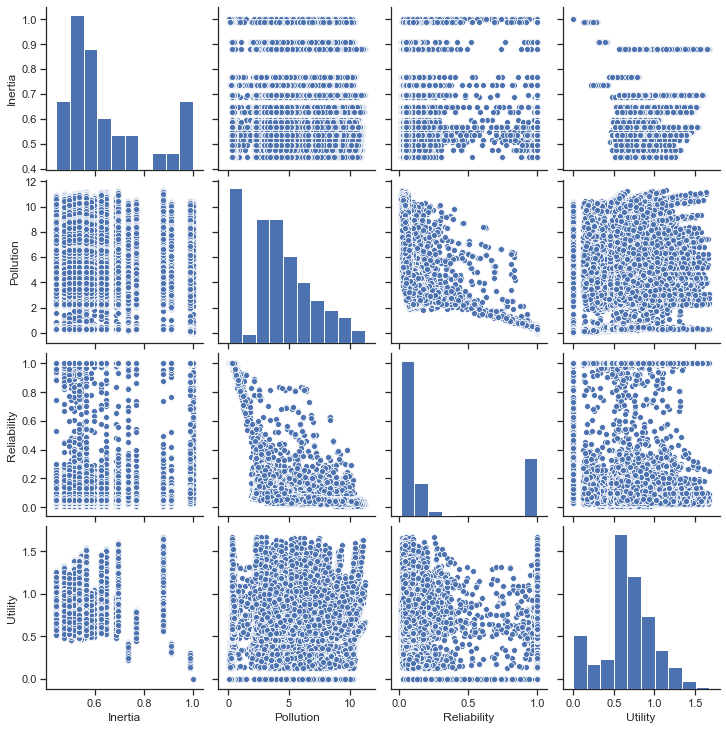

In [31]:
sns.set(style="ticks")
sns.pairplot(df[['Inertia','Pollution', 'Reliability','Utility']]) 

In [31]:
uutt = np.zeros((1,25))
for j in range(25):
    uutt[0,j] = df.loc[j*1000+4,'Utility']
uutt.max()

1.58482202376567

In [32]:
ppoo = np.zeros((1,25))
for j in range(25):
    ppoo[0,j] = df.loc[j*1000+4,'Pollution']
ppoo.min()

0.055466391568326084

## Robustness

### A) Robustness comparison 

#### A.1) Mean/standard deviation (signal-to-noise ratio)

  \begin{equation}
             R_{ij} = \{\begin{array}{ll}
             \frac{\mu(f_{ijs}^* + 1}{\sigma(f_{ijs}^* + 1} ; & \text{if } f_i \text{ is to be maximized}; s=1..N \\
             (\mu(f_{ijs}^* + 1) \times (\sigma(f_{ijs}^* + 1) ; & \text{if } f_i \text{ is to be minimized}; s=1..N\\
             \end{array}
          \end{equation}
          where $\mu(f_{ijs}^*$ is the mean over the set of scenarios for outcome indicator $f_i$ in the case of implementing            the candidate solution $j$, and $\sigma$ is the standard deviation.
    
#### A.2) Max regret
The maximum regret of a candidate solution is the maximal difference across the scenarios between this candidate solution's performance and the zero-regret option's performance in each scenario. The following equation shows the formulation of maximum regret for candidate solution $j$ and outcome indicator $i$. In this formulation, $Z_{is}$ is the zero-regret value of outcome indicator $i$ in scenario $s$, which is assumed to be the best value obtained in this scenario with the optimal policy.

  \begin{equation}
         R_{ij} = \max_{s=1..N} \{ |f_{ijs}^* - Z_{is}| \} 
   \end{equation}

   \begin{equation}
         Z_{is} = \{\begin{array}{ll}
          \max_{s=1..N} \{ f_{ijs}^* \} ; & \text{if } f_i \text{ is to be maximized} \\
          \min_{s=1..N} \{ f_{ijs}^* \} ; & \text{if } f_i \text{ is to be minimized}\\
         \end{array}
  \end{equation}
    



### B) Domain criterion: In how many (percentage of) scenarios (out of 1000 randomly generated) 

#### B.1) Re > 0.95 ? 
#### B.2) Utility > 0.2 ?
#### B.3) Both a and b.

## A) Robustness comparison

In [7]:
nn = int(np.shape(Lake45re_data)[0]/1000) #50 #non-dominated solutions
ss=1000 # scenarios

In [8]:
nn

39

In [9]:
# Mean/std deviation (signal Noise)
df = Lake45re_data
R_mean_std = [nn * [None] for i in range(4)]
Solution = []

for j in range(nn):
    R_mean_std[0][j] = (np.array(df.loc[(j*1000):(j*1000+999),'Utility']).mean()+1)/(np.array(df.loc[(j*1000):(j*1000+999),'Utility']).std()+1)
    #(np.array(nUtility[j]).mean()+1)/(np.array(nUtility[j]).std()+1)            # Max
    R_mean_std[1][j] = (np.array(df.loc[(j*1000):(j*1000+999),'Pollution']).mean()+1)*(np.array(df.loc[(j*1000):(j*1000+999),'Pollution']).std()+1)
    #(np.array(nPollution[j]).mean()+1)*(np.array(nPollution[j]).std()+1)        # Min
    R_mean_std[2][j] = (np.array(df.loc[(j*1000):(j*1000+999),'Inertia']).mean()+1)/(np.array(df.loc[(j*1000):(j*1000+999),'Inertia']).std()+1)
    #(np.array(nInertia[j]).mean()+1)/(np.array(nInertia[j]).std()+1)            # Max
    R_mean_std[3][j] = (np.array(df.loc[(j*1000):(j*1000+999),'Reliability']).mean()+1)/(np.array(df.loc[(j*1000):(j*1000+999),'Reliability']).std()+1)
    #(np.array(nReliability[j]).mean()+1)/(np.array(nReliability[j]).std()+1)    # Max
    Solution.append(j)

In [10]:
print(min(R_mean_std[2]), ',', max(R_mean_std[2]))

1.4444444444444444 , 2.0


In [10]:
# Trade-offs between Utility and Reliability
# Each line represents one solution
fig = go.Figure(data=
    go.Parcoords(
        line = dict(color = R_mean_std[0],
                   colorscale = [[0.2,'black'],[0.4,'purple'],[0.6,'red'],[.8,'gold']]),
        dimensions = list([
               dict(range = [1.25,2.1],
                label = 'Robustness of Inertia(↑)', values = R_mean_std[2]),
          
            dict(range = [20,9],
                label = 'Robustness of Pollution(↑)', values = R_mean_std[1]),
         
            dict(range = [.9,1.45],
                label = 'Robustness of Reliability(↑)', values = R_mean_std[3]),
              dict(range = [1,1.55],
                #constraintrange = [4,8],
                label = 'Robustness of Utility(↑)', values = R_mean_std[0]),

        ])
    )
)

fig.update_layout(
    plot_bgcolor = 'white',
    paper_bgcolor = 'white'
)

fig.show()

In [12]:
df = Lake45re_data
nnUtility = np.zeros((nn,ss))
nnPollution = np.zeros((nn,ss))
nnInertia = np.zeros((nn,ss))
nnReliability = np.zeros((nn,ss))

for p in range(ss):
    for i in range(nn):
        nnUtility[i][p] = df.loc[i*1000+p,'Utility']
        nnPollution[i][p] = df.loc[i*1000+p,'Pollution']
        nnInertia[i][p] = df.loc[i*1000+p,'Inertia']
        nnReliability[i][p] = df.loc[i*1000+p,'Reliability']
    

In [13]:
# Max Regret
z = [ss * [None] for i in range(4)]
Regret = [nn * [None] for i in range(4)]

for p in range(ss):
    z[0][p] = np.max(nnUtility, axis=0)[p] #nnUtility[solution(nn)][scenario(ss)]
    z[1][p] = np.min(nnPollution, axis=0)[p]
    z[2][p] = np.max(nnInertia, axis=0)[p]
    z[3][p] = np.max(nnReliability, axis=0)[p]

for j in range(nn):
    Regret[0][j] = np.max( abs(np.matrix(nnUtility[j]) - np.matrix(z[0]) ) )            # Max
    Regret[1][j] = np.max( abs(np.matrix(nnPollution[j]) - np.matrix(z[1]) ) )         # Min
    Regret[2][j] = np.max( abs(np.matrix(nnInertia[j]) - np.matrix(z[2]) ) )           # Max
    Regret[3][j] = np.max( abs(np.matrix(nnReliability[j]) - np.matrix(z[3]) ) )     # Max
 

In [37]:
print(min(Regret[1]), ',', max(Regret[1]))

0.48955184551650355 , 10.816846405827027


In [14]:
fig = go.Figure(data=
    go.Parcoords(
        line = dict(color = Regret[0],
                   colorscale = [[0.2,'black'],[0.4,'purple'],[0.6,'red'],[.8,'gold']]),
        dimensions = list([
              dict(range = [0,0.75],
                label = 'Robustness of Inertia(↓)', values = Regret[2]),
      
            dict(range = [0,11],
                label = 'Robustness of Pollution(↓)', values = Regret[1]),
          
            dict(range = [0,1],
                label = 'Robustness of Reliability(↓)', values = Regret[3]),
                  dict(range = [0,1.75],
                #constraintrange = [4,8],
                label = 'Robustness of Utility(↓)', values = Regret[0]),

        ])
    )
)

fig.update_layout(
    plot_bgcolor = 'white',
    paper_bgcolor = 'white'
)

fig.show()

In [39]:
# Max Regret from the ideals

Regret_ideal = [nn * [None] for i in range(4)]

for j in range(nn):
    Regret_ideal[0][j] = np.max( abs(np.matrix(nnUtility[j]) - np.matrix(dfi.ideal_Utility) ) )            # Max
    Regret_ideal[1][j] = np.max( abs(np.matrix(nnPollution[j]) - np.matrix(dfi.ideal_Pollution) ) )         # Min
    Regret_ideal[2][j] = np.max( abs(np.matrix(nnInertia[j]) - np.matrix(dfi.ideal_Inertia) ) )           # Max
    Regret_ideal[3][j] = np.max( abs(np.matrix(nnReliability[j]) - np.matrix(dfi.ideal_Reliability) ) )     # Max
 

NameError: name 'dfi' is not defined

In [40]:
fig = go.Figure(data=
    go.Parcoords(
        line = dict(color = Regret_ideal[0],
                   colorscale = [[0.2,'black'],[0.4,'purple'],[0.6,'red'],[.8,'gold']]),
        dimensions = list([
              dict(range = [0,0.7],
                label = 'Robustness of Inertia(↓)', values = Regret_ideal[2]),
      
            dict(range = [0,11],
                label = 'Robustness of Pollution(↓)', values = Regret_ideal[1]),
          
            dict(range = [0,1],
                label = 'Robustness of Reliability(↓)', values = Regret_ideal[3]),
                  dict(range = [0,1.75],
                #constraintrange = [4,8],
                label = 'Robustness of Utility(↓)', values = Regret_ideal[0]),

        ])
    )
)

fig.update_layout(
    plot_bgcolor = 'white',
    paper_bgcolor = 'white'
)

fig.show()

ValueError: 
    Invalid element(s) received for the 'color' property of parcoords.line
        Invalid elements include: [None, None, None, None, None, None, None, None, None, None]

    The 'color' property is a color and may be specified as:
      - A hex string (e.g. '#ff0000')
      - An rgb/rgba string (e.g. 'rgb(255,0,0)')
      - An hsl/hsla string (e.g. 'hsl(0,100%,50%)')
      - An hsv/hsva string (e.g. 'hsv(0,100%,100%)')
      - A named CSS color:
            aliceblue, antiquewhite, aqua, aquamarine, azure,
            beige, bisque, black, blanchedalmond, blue,
            blueviolet, brown, burlywood, cadetblue,
            chartreuse, chocolate, coral, cornflowerblue,
            cornsilk, crimson, cyan, darkblue, darkcyan,
            darkgoldenrod, darkgray, darkgrey, darkgreen,
            darkkhaki, darkmagenta, darkolivegreen, darkorange,
            darkorchid, darkred, darksalmon, darkseagreen,
            darkslateblue, darkslategray, darkslategrey,
            darkturquoise, darkviolet, deeppink, deepskyblue,
            dimgray, dimgrey, dodgerblue, firebrick,
            floralwhite, forestgreen, fuchsia, gainsboro,
            ghostwhite, gold, goldenrod, gray, grey, green,
            greenyellow, honeydew, hotpink, indianred, indigo,
            ivory, khaki, lavender, lavenderblush, lawngreen,
            lemonchiffon, lightblue, lightcoral, lightcyan,
            lightgoldenrodyellow, lightgray, lightgrey,
            lightgreen, lightpink, lightsalmon, lightseagreen,
            lightskyblue, lightslategray, lightslategrey,
            lightsteelblue, lightyellow, lime, limegreen,
            linen, magenta, maroon, mediumaquamarine,
            mediumblue, mediumorchid, mediumpurple,
            mediumseagreen, mediumslateblue, mediumspringgreen,
            mediumturquoise, mediumvioletred, midnightblue,
            mintcream, mistyrose, moccasin, navajowhite, navy,
            oldlace, olive, olivedrab, orange, orangered,
            orchid, palegoldenrod, palegreen, paleturquoise,
            palevioletred, papayawhip, peachpuff, peru, pink,
            plum, powderblue, purple, red, rosybrown,
            royalblue, rebeccapurple, saddlebrown, salmon,
            sandybrown, seagreen, seashell, sienna, silver,
            skyblue, slateblue, slategray, slategrey, snow,
            springgreen, steelblue, tan, teal, thistle, tomato,
            turquoise, violet, wheat, white, whitesmoke,
            yellow, yellowgreen
      - A number that will be interpreted as a color
        according to parcoords.line.colorscale
      - A list or array of any of the above

In [28]:
print(min(Regret_ideal[0]), ',', max(Regret_ideal[0]))

0.1005421827604287 , 1.7330261273222825


## B) Robustness analysis

In [41]:
# Calculating Pcrit
#b,q, and x
# for each solution in each scenario we may have different Pcrit
Pcrit = np.zeros((nn,ss))
for j in range(nn):
    for  p in range(ss):
        x = ait[j]
        bb = b[p]
        qq = q[p]
        Pcrit[j][p] = brentq(lambda x: x**qq/(1+x**qq) - bb*x, 0.01, 1.5)
        
#Pcrit

In [40]:
# Write objectives

with open('Pcrit(EkerBarth)_56solutions_random_rfps(15.10.2020)s1.csv', 'w', newline='') as f:
    objectives = ['Pcrit'
                 ]
    thewriter = csv.DictWriter(f, fieldnames=objectives)
    
    thewriter.writeheader()

    for j in range(nn):
        for p in range(ss):
            thewriter.writerow({'Pcrit' : Pcrit[j][p]
                               })

In [15]:
Pcritical = pd.read_csv('Pcrit(EkerBarth)_56solutions_random_rfps(15.10.2020)s1.csv')
#Pcritical.describe()

Pcriti = np.zeros((nn,ss))
ind = 0
for j in range(nn):
    for p in range(ss):
        Pcriti[j][p] = Pcritical['Pcrit'][ind]
        ind += 1
    
#Pcriti[49][999]

In [16]:
""" 
Robustness analysis --> B
Calculating how many scenarios has 
    B.1) reliability > 0.8 
    B.2) Utility > 0.2/0.1 ?
    B.3) Both a and b.

"""
n_reliabale_scen = np.zeros((nn,))
n_high_eco_scen = np.zeros((nn,))
n_both_scen = np.zeros((nn,))
n_high_inertia_scen = np.zeros((nn,))
n_low_pollution_scen = np.zeros((nn,))
#critical_scen = []


for i in range(nn): 
    nrs = 0
    nhes = 0
    nboth = 0
    nhi = 0
    nlp = 0
    for p in range(ss):
        if nnReliability[i][p]>.8: #A.1
            nrs += 1
        #else:
        #    critical_scen.append(np.array([p+1, b[p], q[p], mean[p], stdev[p], delta[p]]) )  
        if nnUtility[i][p]>0.2: #A.2
            nhes += 1
        if nnReliability[i][p]>0.8 and nnUtility[i][p]>0.2: #A.3
            nboth += 1
        if nnInertia[i][p]>0.99:
            nhi += 1   
        if nnPollution[i][p]<Pcriti[i][p]: #2.54
            nlp += 1
            
    n_reliabale_scen[i] = nrs   
    n_high_eco_scen[i] = nhes
    n_both_scen[i] = nboth
    n_high_inertia_scen[i] = nhi
    n_low_pollution_scen[i] = nlp
    

print('Number of scenarios with reliability of > 0.95 =', n_reliabale_scen)
print('Number of scenarios with utility of > 0.2 =',n_high_eco_scen)
print('Number of scenarios with reliability of > 0.95 and utility > 0.2 =',n_both_scen)
#print('Number of scenarios with inertia of > 0.99 =',n_high_inertia_scen)
print('Number of scenarios with pollution of < Critical point =',n_low_pollution_scen)
#print(critical_scen)

Number of scenarios with reliability of > 0.95 = [125. 768. 768. 763. 192. 112. 132. 129. 275. 201. 515. 520. 368. 153.
 410. 609. 608. 607. 609. 606. 612. 606. 616. 606. 610. 772. 766. 765.
 765. 767. 770. 772. 772. 777. 772. 767. 766. 762. 764.]
Number of scenarios with utility of > 0.2 = [1000.    0.    0.    0. 1000. 1000. 1000. 1000. 1000. 1000.  743.  727.
 1000. 1000. 1000.  334.  345.  335.  437.  350.  344.  331.  453.  336.
  379.    0.    0.    0.    0.    0.    0.    0.    0.    0.    0.    0.
    0.    0.    0.]
Number of scenarios with reliability of > 0.95 and utility > 0.2 = [125.   0.   0.   0. 192. 112. 132. 129. 275. 201. 380. 378. 368. 153.
 410. 205. 210. 204. 267. 210. 211. 202. 288. 204. 233.   0.   0.   0.
   0.   0.   0.   0.   0.   0.   0.   0.   0.   0.   0.]
Number of scenarios with pollution of < Critical point = [123. 756. 757. 755. 191. 111. 130. 127. 273. 199. 511. 512. 364. 153.
 406. 604. 602. 602. 605. 601. 607. 601. 610. 600. 605. 763. 757. 755.
 756

In [44]:
rdc_reliability = np.sort(n_reliabale_scen)[::-1]/1000
rdc_reliability

array([0.777, 0.777, 0.777, 0.602, 0.451, 0.3  , 0.209, 0.189, 0.177,
       0.171, 0.164, 0.161, 0.158, 0.158, 0.155, 0.154, 0.152, 0.151,
       0.141, 0.139, 0.138, 0.138, 0.136, 0.135, 0.134, 0.133, 0.13 ,
       0.127, 0.118, 0.117, 0.114, 0.111, 0.11 ])

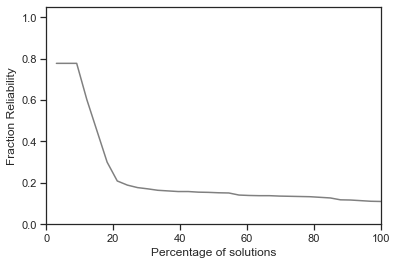

In [45]:
#Reliability robustness
axes = plt.gca()
axes.set_ylim([0,1.05])
axes.set_xlim([0,100])
plt.plot(np.arange(1,nn+1)*100/nn,rdc_reliability, color = "gray")
plt.xlabel("Percentage of solutions") 
plt.ylabel("Fraction Reliability") 
plt.show()

In [46]:
rdc_utility = np.sort(n_high_eco_scen)[::-1]/1000
rdc_utility

array([1.   , 1.   , 1.   , 1.   , 1.   , 1.   , 1.   , 1.   , 1.   ,
       1.   , 1.   , 1.   , 1.   , 1.   , 1.   , 1.   , 1.   , 1.   ,
       1.   , 1.   , 1.   , 1.   , 1.   , 1.   , 1.   , 1.   , 1.   ,
       1.   , 1.   , 0.374, 0.   , 0.   , 0.   ])

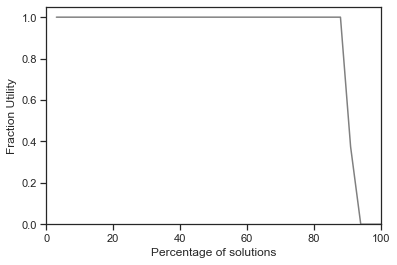

In [47]:
#Utility robustness
axes = plt.gca()
axes.set_ylim([0,1.05])
axes.set_xlim([0,100])
plt.plot(np.arange(1,nn+1)*100/nn,rdc_utility, color = "gray")
plt.xlabel("Percentage of solutions") 
plt.ylabel("Fraction Utility") 
plt.show()

In [48]:
rdc_both = np.sort(n_both_scen)[::-1]/1000
rdc_both

array([0.451, 0.3  , 0.225, 0.209, 0.189, 0.177, 0.171, 0.164, 0.161,
       0.158, 0.158, 0.155, 0.154, 0.152, 0.151, 0.141, 0.139, 0.138,
       0.138, 0.136, 0.135, 0.134, 0.133, 0.13 , 0.127, 0.118, 0.117,
       0.114, 0.111, 0.11 , 0.   , 0.   , 0.   ])

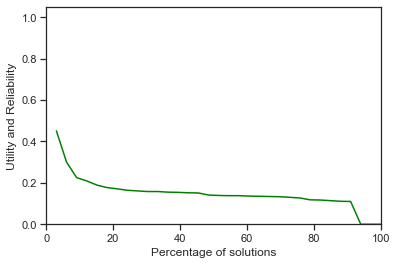

In [49]:
#Both
axes = plt.gca()
axes.set_ylim([0,1.05])
axes.set_xlim([0,100])
plt.plot(np.arange(1,nn+1)*100/nn,rdc_both, color = "green")
plt.xlabel("Percentage of solutions") 
plt.ylabel("Utility and Reliability") 
plt.show()

In [50]:
rdc_pollution = np.sort(n_low_pollution_scen)[::-1]/1000
rdc_pollution

array([0.765, 0.765, 0.765, 0.596, 0.448, 0.3  , 0.209, 0.186, 0.176,
       0.17 , 0.163, 0.16 , 0.158, 0.158, 0.155, 0.153, 0.151, 0.15 ,
       0.139, 0.138, 0.137, 0.137, 0.134, 0.133, 0.132, 0.13 , 0.129,
       0.127, 0.118, 0.115, 0.114, 0.111, 0.108])

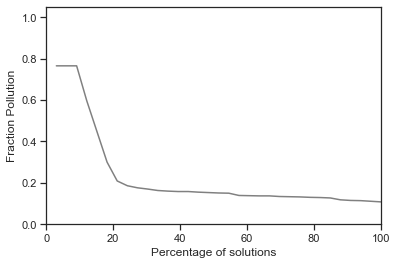

In [51]:
#Pollution
axes = plt.gca()
axes.set_ylim([0,1.05])
axes.set_xlim([0,100])
plt.plot(np.arange(1,nn+1)*100/nn,rdc_pollution, color = "gray")
plt.xlabel("Percentage of solutions") 
plt.ylabel("Fraction Pollution") 
plt.show()

In [52]:
rdc_inertia = np.sort(n_high_inertia_scen)[::-1]/1000
rdc_inertia

array([1., 1., 1., 0., 0., 0., 0., 0., 0., 0., 0., 0., 0., 0., 0., 0., 0.,
       0., 0., 0., 0., 0., 0., 0., 0., 0., 0., 0., 0., 0., 0., 0., 0.])

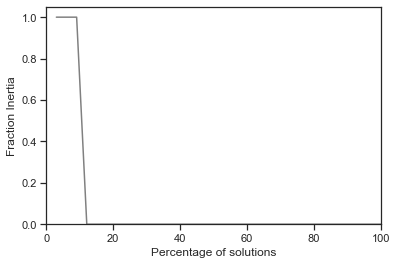

In [53]:
#Inertia
axes = plt.gca()
axes.set_ylim([0,1.05])
axes.set_xlim([0,100])
plt.plot(np.arange(1,nn+1)*100/nn,rdc_inertia, color = "gray")
plt.xlabel("Percentage of solutions") 
plt.ylabel("Fraction Inertia") 
plt.show()

In [17]:
fig = go.Figure(data=
    go.Parcoords(
        line = dict(color = n_high_eco_scen,
                   colorscale = [[0.1,'black'],[0.35,'purple'],[0.7,'red'],[.9,'gold']]),
        dimensions = list([
                    
            dict(range = [0,1],
                label = 'Fraction Pollution', values = n_low_pollution_scen/1000),
          
            dict(range = [0,1],
                label = 'Fraction Reliability', values = n_reliabale_scen/1000),
            
            dict(range = [0,1],
                #constraintrange = [4,8],
                label = 'Fraction Utility', values = n_high_eco_scen/1000),
            dict(range = [0,1],
                label = 'Fraction Inertia', values = n_high_inertia_scen/1000),

        ])
    )
)

fig.update_layout(
    plot_bgcolor = 'white',
    paper_bgcolor = 'white'
)

fig.show()

In [45]:
# Write objectives

with open('Domain_56solutions_(28.10.2020)s1.csv', 'w', newline='') as f:
    objectives = ['rdc_u', 'rdc_rel', 'rdc_pol', 'rdc_in'
                 ]
    thewriter = csv.DictWriter(f, fieldnames=objectives)
    
    thewriter.writeheader()

    for j in range(50):
        thewriter.writerow({'rdc_u' : rdc_utility[j], 'rdc_rel' : rdc_reliability[j], 'rdc_pol' : rdc_pollution[j], 'rdc_in' : rdc_inertia[j]   
                               })

## Select solutions which are more robust (e.g. n_both_scen > 103)

In [57]:
# Choose the solutions which has the reliability of > 0.8 and utility > 0.2
n_both_scen

array([125., 161.,   0.,   0.,   0.,   0.,   0., 246., 111.,   0., 194.,
         0.,   0.,   0.,   0., 166.,   0., 356.,   0., 381., 234.,   0.,
         0., 178., 379., 258.,   0., 114., 239., 220., 151.,   0.,   0.,
       254., 141.,   0.,   0.,   0., 168., 111., 344.,   0.,   0., 113.,
         0., 240., 157., 367., 297.,   0., 101., 117.,   0., 277., 233.,
       139.])

In [58]:
selected_ait = []
selected_U = []
selected_P = [] 
selected_I = []
selected_R = []

for i in range(nn):
    if n_both_scen[i] > 350:
        selected_ait.append(ait[i])
        selected_U.append(nnUtility[i])
        selected_P.append(nnPollution[i])
        selected_I.append(nnInertia[i])
        selected_R.append(nnReliability[i])
        #print(i, n_both_scen[i])

# The number of selected solutions
print('The number of selected solutions =', np.shape(selected_U)[0])       

The number of selected solutions = 4


In [59]:
# Write objectives

with open('obective_values_4obj_s1(EkerBart)_selected_solutions(15.10.2020)SLSQP.csv', 'w', newline='') as f:
    objectives = ['Utility', 'Pollution', 'Inertia', 'Reliability', 'group'
                 ]
    thewriter = csv.DictWriter(f, fieldnames=objectives)
    
    thewriter.writeheader()

    for j in range(np.shape(selected_ait)[0]):
        for i in range(ss):
            thewriter.writerow({'Utility' : selected_U[j][i], 'Pollution' : selected_P[j][i], 'Inertia' : selected_I[j][i], 'Reliability' : selected_R[j][i], 'group' : j
                               })

In [61]:
import pandas as pd
import seaborn as sns
import matplotlib.pyplot as plt
from mpl_toolkits.mplot3d import Axes3D # <--- This is important for 3d plotting 

Lake4550selected_data = pd.read_csv('obective_values_4obj_s1(EkerBart)_selected_solutions(15.10.2020)SLSQP.csv')
Lake4550selected_data.describe()

,Utility,Pollution,Inertia,Reliability,group
count,4000.000000,4000.000000,4000.000000,4000.000000,4000.000000
mean,0.391188,3.368433,0.712121,0.485036,1.500000
std,0.135329,3.101632,0.125468,0.437006,1.118174
min,0.155411,0.085877,0.636364,0.020000,0.000000
25%,0.299208,0.246741,0.636364,0.088225,0.750000
50%,0.368181,3.254189,0.641414,0.196150,1.500000
75%,0.477409,5.660793,0.717172,1.000000,2.250000
max,0.726552,10.716259,0.929293,1.000000,3.000000


In [63]:
# The performances of the 6 selected solutions in all 1000 scenarios
df = Lake4550selected_data

fig = go.Figure(data=
    go.Parcoords(
        line = dict(color = df['group'],
                   colorscale = [[0.2,'black'],[0.4,'purple'],[0.6,'red'],[.8,'gold']]),
        dimensions = list([
            dict(range = [0,1],
                #constraintrange = [4,8],
                label = 'Utility', values = df['Utility']),
            dict(range = [0,11],
                label = 'Pollution', values = df['Pollution']),
            dict(range = [0,1],
                label = 'Inertia', values = df['Inertia']),
            dict(range = [0,1],
                label = 'Reliability', values = df['Reliability']),
            dict(range = [0,3],
                label = 'Solution', values = df['group']),
            
        ])
    )
)

fig.update_layout(
    plot_bgcolor = 'white',
    paper_bgcolor = 'white'
)

fig.show()

## Calculating the ideal points for all 1000 generated scenarios 

In [22]:
Lake45_1000ideals = pd.read_csv(r'C:\Users\babshava\pyDMDU\robust_optimization_comparison\src\exp2(Eker2018_scenarios)\obective_values_4obj_5scen(EkerBart)_1000_ideal_points(12.10.2020).csv')
Lake45_1000ideals.describe()

,ideal_Utility,ideal_Pollution,ideal_Inertia,ideal_Reliability,Scenario
count,1000.000000,1000.000000,1000.0,1000.000000,1000.000000
mean,0.964190,1.602561,1.0,0.827922,499.500000
std,0.318529,2.899479,0.0,0.326612,288.819436
min,0.571224,0.016309,1.0,0.030000,0.000000
25%,0.693488,0.076118,1.0,1.000000,249.750000
50%,0.879524,0.123542,1.0,1.000000,499.500000
75%,1.183153,0.250321,1.0,1.000000,749.250000
max,1.734761,10.321020,1.0,1.000000,999.000000


In [23]:
dfi = Lake45_1000ideals

## As seen above, the ideal points for reliability in some scenarios are very close to 0 (min = 0.04).
## It means that, in those scenarios, there is no feasible solution with the reliability of higher than 0.8. 

## As seen above, in 208 scenarios (out of 1000), the ideal value for utility is > Critical pollution level. It means that there exists no feasible solution with a lower pollution in these 208 scenarios.

## Therefore, we can remove these scenarios and solve a model with all 4 objective functions in the remaining 802 scenarios. The solutions for that model would have less conservatism (similar reliability values but with equal or better performances in other objectives).